# Deriving multi-Gaussian approximations to Sersic profiles

This notebook demonstrates how to derive optimal parameters for Gaussian mixture model approximations to the Sersic (1963, 1968) function commonly used to model galaxy radial surface brightness profiles.

The main motivation behind doing this is that a Gaussian convolved with a Gaussian has an analytic solution - namely, another Gaussian - and so Gaussian mixture galaxy models convolved with Gaussian mixture PSF models are simple and fast to evaluate.
There are some other advantages that won't be detailed here. The only serious disadvantage is the introduction of 'wiggles' in the profile and therefore roughly sinusoidal variations in the second derivative.

The approach here is similar to Hogg & Lang (2013), but that paper did not publish weights for entire useful range of Sersic indices 0.5 <= n < 10. We will actually only go up to n=6.3 as this is the upper limit supported in GalSim.

For convenience, after this we'll refer to multi-Gaussian approximations (i.e. Gaussian mixture models) as MGAs for short.

In [1]:
# Setup

import matplotlib as mpl
import matplotlib.pyplot as plt
import multiprofit.objects as mpfobj
import numpy as np
import seaborn as sns
import scipy as sp

%matplotlib inline
sns.set_style("darkgrid")
mpl.rcParams['figure.dpi'] = 240

## Define useful functions

Here we'll define functions for a unit Sersic profile, and for optimizing the weights in an MGA for a chi-square like objective function.

The fitting functions allow for matching the profile over a limited range after re-normalization - the justification for this will be explained later.

Note that the size unit is always Re, and Re = FWHM/2 ~ 1.17741 sigma; the weight is just a fraction for convenience.

In [2]:
# Surface brightness of a unit flux Sersic profile
def sersic(r, n, re):
    bn = sp.stats.gamma.ppf(0.5, 2*n)
    g_factor = sp.special.gamma(2*n)
    flux = np.power(re, 2)*2*np.pi*n*g_factor*np.exp(bn)/np.power(bn, 2*n)
    ir = np.exp(-bn*(np.power(r/re, 1./n)-1.))
    return ir/flux


# Compute chisq as log difference in 2D binned flux
# i.e. not really chisq since it's a sum of squares but without any error
# Rangefit allows re-normalizing the model to match data normalization within the specified range
# Otherwise, the model and data are normalized from r=0 to infinity
def chisq_sersic(params, x, y, weightsbins, rangefit=None, rdivreslog=None,
                 plotdata=False, plotmodel=False, returnall=False):
    ymodel = np.zeros(len(x))
    weights, res = paramstoweightres(params, rdivreslog)
    for weight, re in zip(weights, res):
        ymodel += weight*sersic(x, 0.5, re)
    if plotdata:
        plt.plot(x, np.log10(y/(weightsbins if weightsbins is not None else 1.)))
    if plotmodel:
        plt.plot(x, np.log10(ymodel))
    if weightsbins is not None:
        ymodel *= weightsbins
        if plotmodel:
            print(np.sum(y), np.sum(ymodel))
    if weightsbins is not None:
        if rangefit is not None:
            ymodel = ymodel[rangefit]
            ymodel *= np.sum(y[rangefit])/np.sum(ymodel)
        chisq = np.log10(np.sum(((y if rangefit is None else y[rangefit])-ymodel)**2))
        if returnall:
            return chisq, ymodel
        return chisq


def paramstoweightres(params, rdivreslog=None):
    if rdivreslog is not None:
        paramsnew = np.concatenate([params, rdivreslog])
    else:
        paramsnew = params
    nsplit = (len(paramsnew)+1)//2
    weights = np.zeros(nsplit)
    res = np.zeros(nsplit)
    total = 1.0
    for i in range(nsplit):
        if i < (nsplit-1):
            weight = sp.special.expit(paramsnew[i])
            weights[i] = total*weight
            total *= (1.0-weight)
        res[i] = 10**paramsnew[i+nsplit-1]
    weights[nsplit-1] = 1-np.sum(weights)
    return weights, res


def weightrestoparams(weights, res, rdivreslog=None):
    paramweights = []
    paramres = []
    total = 1.0
    for weight, re in zip(weights, res):
        paramweights.append(sp.special.logit(weight/total))
        total -= weight
        if rdivreslog is None:
            paramres.append(np.log10(re))
    return paramweights[:-1] + paramres


def fitweights(nvals, radii, areasq, weightssigmas={}, methods=['BFGS'], plot=True, addthreshhold=None,
               weightinit=1e-3, refacinit=1.1, addbig = None, funcrangefit=None, funcrdivreslog=None):
    for nvalsi, weightsvars in nvals:
        params = weightrestoparams(weightsvars[0], weightsvars[1], funcrdivreslog) if weightsvars is not None else None
        for n in nvalsi:
            y = sersic(radii, n, 1)*areasq
            paramsbytype = {}
            rangefit = funcrangefit(radii, n) if funcrangefit is not None else None
            rdivreslog = funcrdivreslog(n) if funcrdivreslog is not None else None
            if params is not None:
                paramsbytype['prev.'] = params
            if n in weightssigmas:
                weightsvars = weightssigmas[n]
                paramsbytype['existing'] = weightrestoparams(
                    weightsvars[0][::-1], np.sqrt(weightsvars[1][::-1])*gaussian_sigma_to_re)
            plotteddata = not plot
            chisqmin = np.Inf
            for name, paramsi in paramsbytype.items():
                chisq = chisq_sersic(paramsi, radii, y, areasq, rangefit, rdivreslog,
                                     plotdata=not plotteddata, plotmodel=plot)
                print(name, ' chisq =', chisq)
                if chisq < chisqmin:
                    params = paramsi
                plotteddata = True
            print('ws, re:', paramstoweightres(params, rdivreslog))
            for method in methods:
                fit = sp.optimize.minimize(chisq_sersic, params, args=(radii, y, areasq, rangefit, rdivreslog),
                                           tol=1e-5, options={'disp': True, }, method=method)
                params = fit['x']
            print(fit['fun'], fit['x'])
            chisq = chisq_sersic(params, radii, y, areasq, rangefit, rdivreslog, plotmodel=plot)
            plt.xlabel('$r/r_{eff}$')
            plt.ylabel('log10(surface density)')
            plt.show()
            weights, res = paramstoweightres(params, rdivreslog)
            idxsort = np.argsort(res)[::-1]
            weights = np.array(weights)[idxsort]
            res = np.array(res)[idxsort]
            print('n={}: ('.format(n))
            for arr, prefix, postfix in [(weights, 'normalize(', ')'), (res, '', '')]:
                print('    ' + prefix + 'np.array([' + ', '.join(
                    ['{:.10e}'.format(x) for x in arr]) + '])' + postfix + ',')
            print('),')
            if addthreshhold is not None and chisq > addthreshhold:
                # Add a small component if n < 1.5; big if n > 1.5 by default
                cond = n > 1.5 if addbig is None else addbig 
                weights *= 1.0-weightinit
                weights = np.insert(weights, 0, weightinit) if cond else np.append(weights, weightinit)
                res = np.insert(res, 0, refacinit*res[0]) if cond else np.append(res, res[-1]/refacinit)
                params = weightrestoparams(weights, res)
                print('new w, r:', weights, res)
                

def normalize(array):
    array /= np.sum(array)
    return array

## Define the fit range and plot the Sersic profile for reference

We choose to fit out to R/Re = 12 rather than the more typical limit of R/Re=8 commonly used in SDSS. This allows the fits to better match the n>4 profiles at R/Re > 4. Massive elliptical galaxies often do have very extended outer profiles with large Sersic indices (see papers by Kormendy & co. on Virgo galaxies), so we do want to reproduce the shape at large radii. Eventually, the MGA profile will truncate more quickly than a Sersic profile as only the outer Gaussian contributes to the flux, but that's fine - we don't really trust the extrapolation at such large radii unless there's very deep data to constrain it.

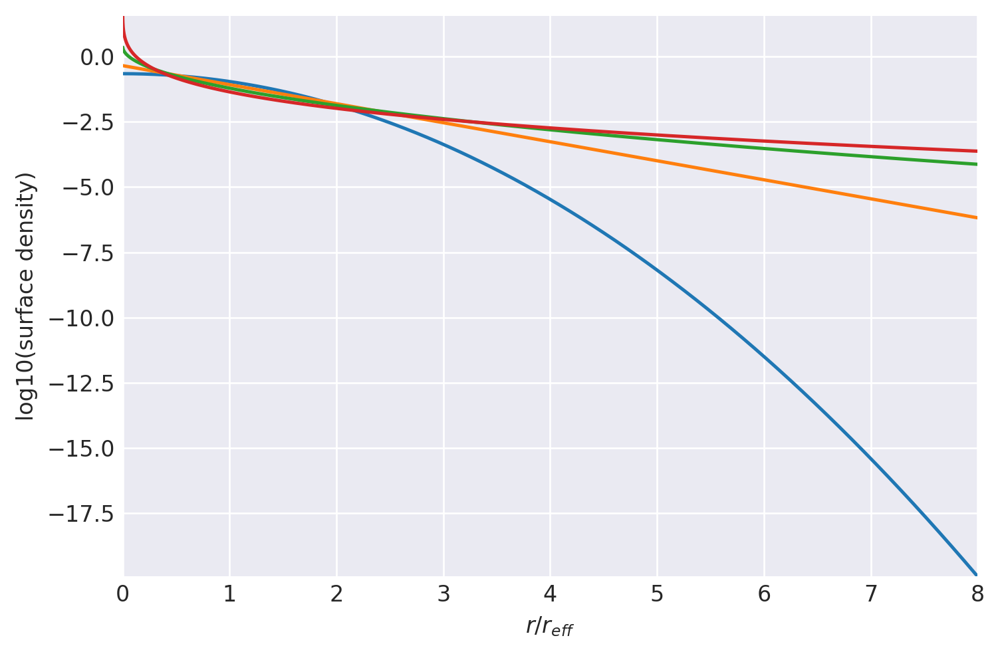

In [3]:
order = 8

nbinsperre = 2000
remax = 12
redge = np.linspace(0, remax, nbinsperre*remax+1)
rmid = (redge[1:] + redge[:-1])/2.
rsq = redge**2
areasq = np.pi*(rsq[1:] - rsq[:-1])

idxsplot = range(8*nbinsperre)

for n in [0.5, 1, 2, 4]:
    plt.plot(rmid[idxsplot], np.log10(sersic(rmid[idxsplot], n, 1)))
plt.tight_layout()
for axis in ['x', 'y']:
    plt.autoscale(enable=True, axis=axis, tight=True)
plt.xlabel('$r/r_{eff}$')
plt.ylabel('log10(surface density)')
plt.show()

## Carefully fit MGA weights/sizes for n < 1

This section begins fitting the optimal weights and sizes of the MGA.

The trickiest part of this problem is finding optimal weights for an MGA with N components as n -> 0.5. Of course, you only need a single component to reproduce n=0.5 exactly, and for n=0.5 + a small epsilon, you need only two Gaussians - one slightly smaller and one slightly larger - for a good approximation. As n grows, the minimal N for a good fit grows too. There are essentially two options, then - either grow N gradually with increasing n, or keep N fixed and hope that the weights change smoothly down to n=0.5. Unfortunately, the latter option is practically quite difficult as many of the best-fit weights asymptote to zero but are very noisy, which is a problem if we want to smoothly interpolate the weights for any value of N (see below). That leaves the first option of gradually adding components.

After some experimentation, two things are apparent. First, as n->0.5, the best-fit model tends to two components of (weight, size) = (1-delta, 1+eps), (delta, 0.716). Why that specifical value of 0.716, I'm not sure.

Secondly, adding components while maintaining a smooth variation in the weights and sizes becomes tricky, because the best-fit solutions for an MGA with N and N-1 components can be significantly different. The solution here is to ensure delta n is large enough when incrementing N such that the weights still change smoothly. However, it turns out that the weights derived here through a combination of working from n=0.5 up and from n=1 down (meeting in the middle) don't change smoothly enough to be useable for interpolation and fitting - see the plots further below.

Thirdly, there were only two things, but there's no legend in the plots so it should be mentioned that blue is true profile, orange is the initial guess, and green is the final best fit.

Note that it's impossible to fit n < 0.5 profiles with an MGA without spatially offsetting the components. Note that as n <= 0, the Sersic profile approaches a step function. This isn't a very useful approximation for most 'normal' galaxies, but it can be a useful approximation of parts of barred/ring galaxies, so we will revisit this issue later.

1.0000000144581254 1.000000014229467
prev.  chisq = -7.588745391812752
ws, re: (array([0.98, 0.02]), array([1.01, 0.9 ]))
         Current function value: -12.124435
         Iterations: 21
         Function evaluations: 612
         Gradient evaluations: 120
-12.1244350827063 [ 5.63857896e+00  5.35362016e-04 -1.45058260e-01]
1.0000000144581254 1.0000000144537895


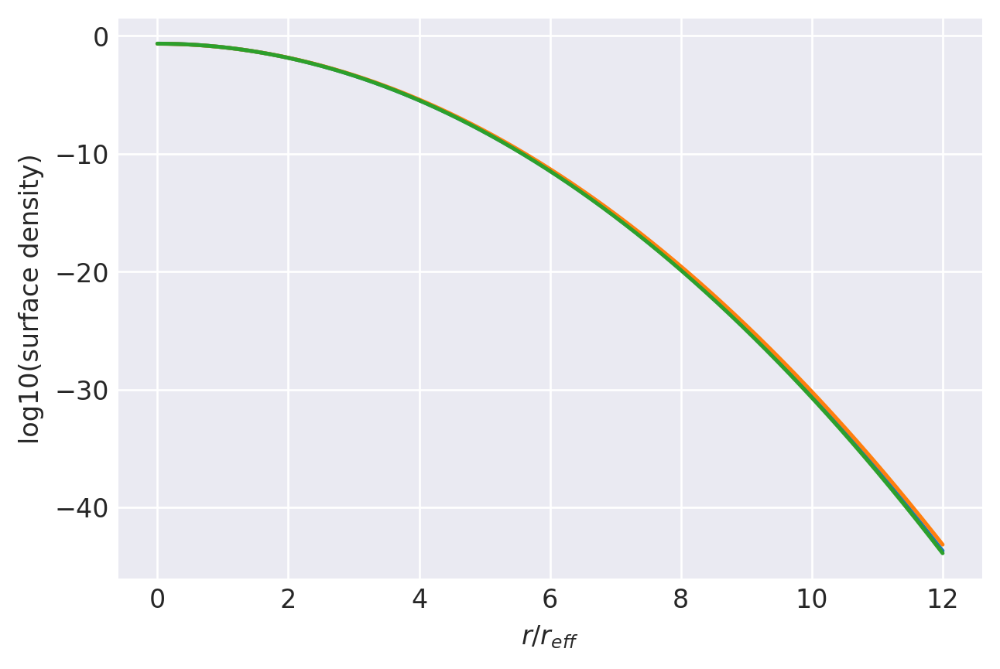

n=0.501: (
    normalize(np.array([9.9645469317e-01, 3.5453068336e-03])),
    np.array([1.0012334767e+00, 7.1604734662e-01]),
),
1.0000000145642924 1.0000000147654382
prev.  chisq = -7.7362581434074595
ws, re: (array([0.87013735, 0.12619086, 0.00367179]), array([1.03392488, 0.81955231, 0.42170644]))
         Current function value: -11.998273
         Iterations: 207
         Function evaluations: 2336
         Gradient evaluations: 332
-11.99827306304458 [-2.89964115e+00  6.66790914e+00 -8.51519166e-02  5.29272520e-03
 -3.75584400e-01]
1.0000000145642924 1.0000000145537353


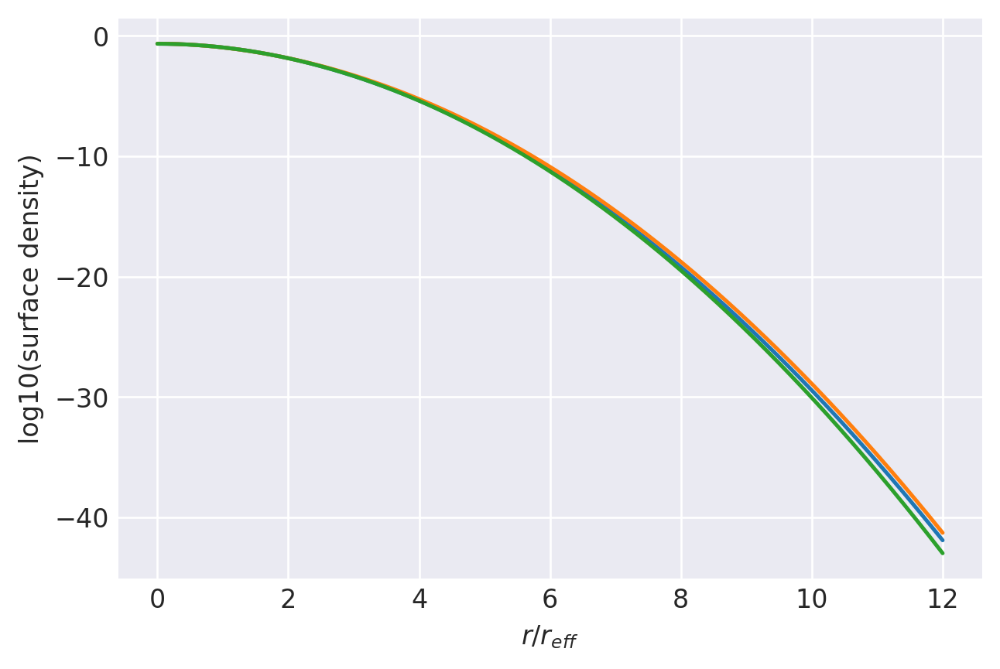

n=0.507: (
    normalize(np.array([9.4662548327e-01, 5.2171305034e-02, 1.2032116992e-03])),
    np.array([1.0122615136e+00, 8.2195507899e-01, 4.2112943705e-01]),
),
1.0000000199734806 1.0000000283694637
prev.  chisq = -7.117390029086779
ws, re: (array([0.07790019, 0.31264016, 0.33937179, 0.1839253 , 0.06541804,
       0.01709507, 0.00326612, 0.00038332]), array([2.17045661, 1.47679133, 0.99494464, 0.65054022, 0.40699848,
       0.23877605, 0.12631553, 0.05405815]))
         Current function value: -11.155304
         Iterations: 52
         Function evaluations: 2035
         Gradient evaluations: 119
-11.15530445544733 [-2.42262005 -0.59808414  0.30058746  0.82079262  1.1970379   1.5809865
  2.17308776  0.31341845  0.15498436 -0.01022075 -0.1900277  -0.38993527
 -0.6181705  -0.89132524 -1.2559645 ]
1.0000000199734806 1.0000000264952646


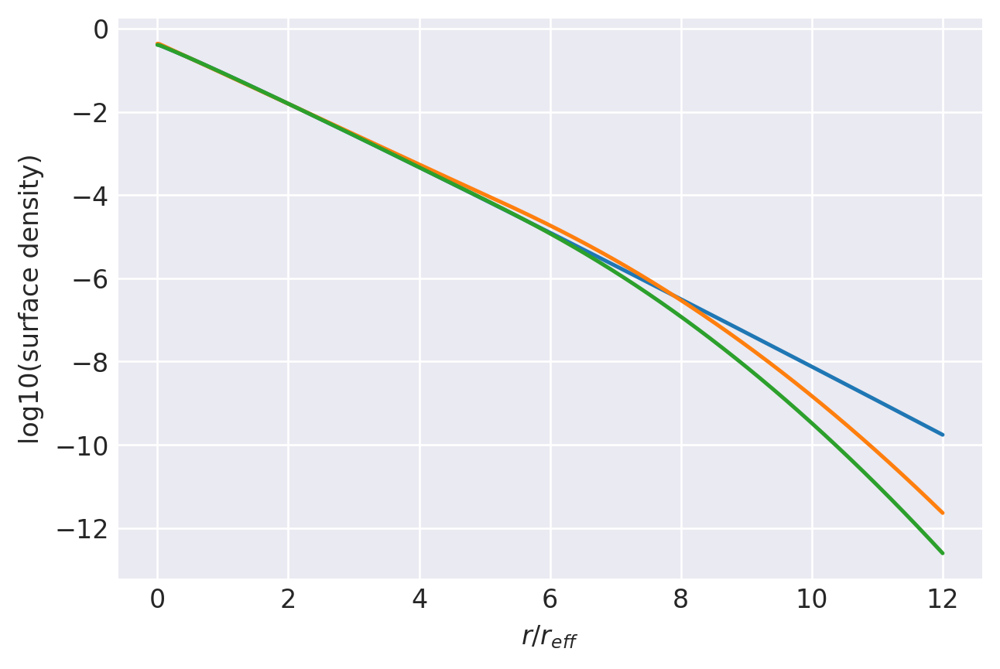

n=0.95: (
    normalize(np.array([8.1463988478e-02, 3.2588016643e-01, 3.4053182287e-01, 1.7507607194e-01, 5.9172627261e-02, 1.4824795210e-02, 2.7387840554e-03, 3.1174375934e-04])),
    np.array([2.0578724478e+00, 1.4288424938e+00, 9.7674061971e-01, 6.4561304442e-01, 4.0744100447e-01, 2.4089595025e-01, 1.2843244753e-01, 5.5467104900e-02]),
),
1.0000000242164144 1.0000000264952646
prev.  chisq = -7.072791108028902
ws, re: (array([8.14639885e-02, 3.25880166e-01, 3.40531823e-01, 1.75076072e-01,
       5.91726273e-02, 1.48247952e-02, 2.73878406e-03, 3.11743759e-04]), array([2.05787245, 1.42884249, 0.97674062, 0.64561304, 0.407441  ,
       0.24089595, 0.12843245, 0.0554671 ]))
         Current function value: -11.408747
         Iterations: 57
         Function evaluations: 2085
         Gradient evaluations: 122
-11.408746715665405 [-2.40299067 -0.54129696  0.37057696  0.8843964   1.24608973  1.61797575
  2.20281177  0.29085669  0.14240478 -0.01565202 -0.19029974 -0.38616401
 -0.61081962 -

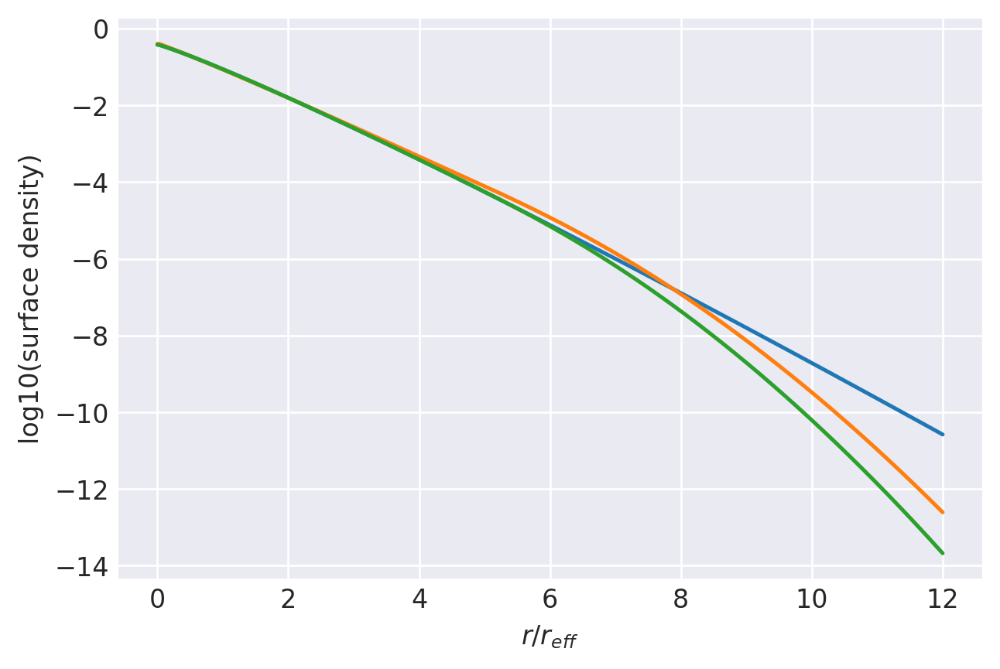

n=0.9: (
    normalize(np.array([8.2944927122e-02, 3.3737165742e-01, 3.4293977280e-01, 1.6755115426e-01, 5.3736425424e-02, 1.2898328320e-02, 2.3032444663e-03, 2.5449018740e-04])),
    np.array([1.9536946720e+00, 1.3880489560e+00, 9.6460161519e-01, 6.4520876215e-01, 4.1099448002e-01, 2.4500806439e-01, 1.3172635072e-01, 5.7478987848e-02]),
),
1.0000000232649449 1.0000000247023972
prev.  chisq = -7.02552013403142
ws, re: (array([8.29449271e-02, 3.37371657e-01, 3.42939773e-01, 1.67551154e-01,
       5.37364254e-02, 1.28983283e-02, 2.30324447e-03, 2.54490187e-04]), array([1.95369467, 1.38804896, 0.96460162, 0.64520876, 0.41099448,
       0.24500806, 0.13172635, 0.05747899]))
         Current function value: -11.694331
         Iterations: 90
         Function evaluations: 2833
         Gradient evaluations: 166
-11.69433132400764 [-2.32226401 -0.44187223  0.4681851   0.96304997  1.30273284  1.65849114
  2.23790881  0.26461024  0.12594596 -0.02514642 -0.19482256 -0.38686318
 -0.60809025 -0.8

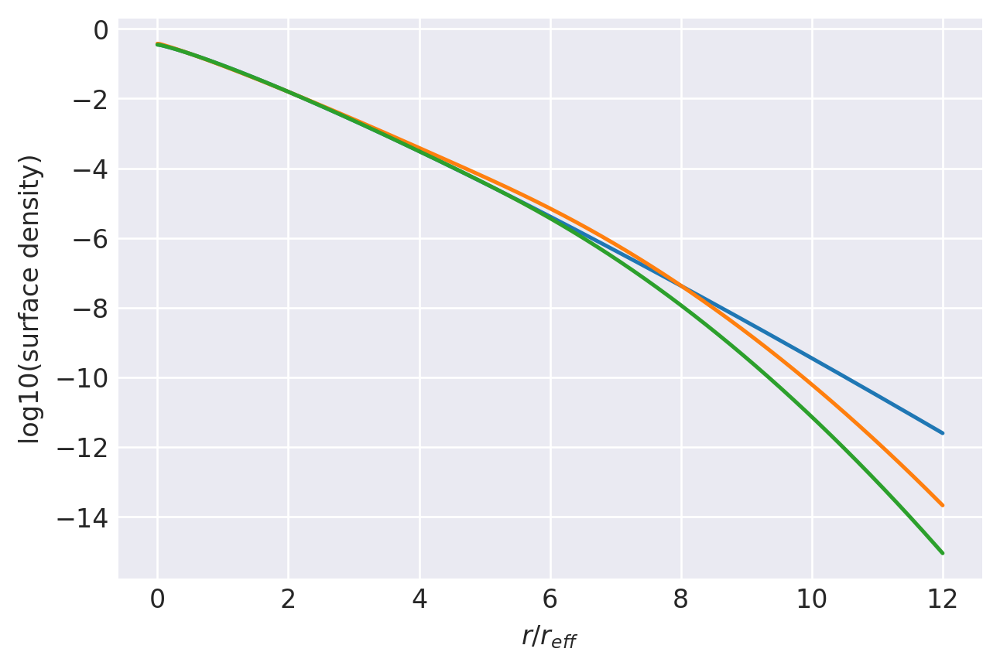

n=0.85: (
    normalize(np.array([8.9295774481e-02, 3.5635395908e-01, 3.4089997162e-01, 1.5448081819e-01, 4.6367378483e-02, 1.0586207953e-02, 1.8215633357e-03, 1.9432685769e-04])),
    np.array([1.8391207336e+00, 1.3364292193e+00, 9.4374264293e-01, 6.3852430856e-01, 4.1033335262e-01, 2.4655269337e-01, 1.3363367181e-01, 5.8855346344e-02]),
),
1.0000000216764655 1.0000000230356967
prev.  chisq = -6.975152837922648
ws, re: (array([8.92957745e-02, 3.56353959e-01, 3.40899972e-01, 1.54480818e-01,
       4.63673785e-02, 1.05862080e-02, 1.82156334e-03, 1.94326858e-04]), array([1.83912073, 1.33642922, 0.94374264, 0.63852431, 0.41033335,
       0.24655269, 0.13363367, 0.05885535]))
         Current function value: -12.020635
         Iterations: 135
         Function evaluations: 4789
         Gradient evaluations: 281
-12.020634508379356 [-2.22691509 -0.33544183  0.56914315  1.04340479  1.36082781  1.7005008
  2.27221272  0.2368236   0.10919222 -0.03368686 -0.19750214 -0.38528197
 -0.60294244 -

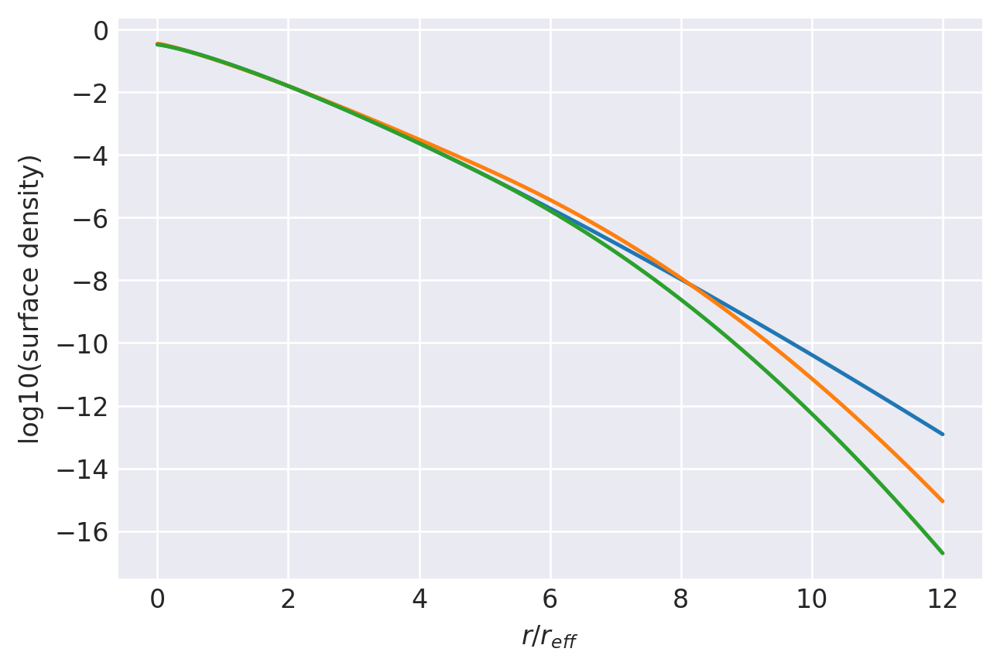

n=0.8: (
    normalize(np.array([9.7359408258e-02, 3.7632632840e-01, 3.3608609828e-01, 1.4067495078e-01, 3.9439116135e-02, 8.5524827161e-03, 1.4156815517e-03, 1.4593387948e-04])),
    np.array([1.7251370483e+00, 1.2858556604e+00, 9.2536514156e-01, 6.3459677644e-01, 4.1183004904e-01, 2.4949253563e-01, 1.3638471345e-01, 6.0728216887e-02]),
),
1.0000000201648103 1.0000000214837446
prev.  chisq = -6.921481313230024
ws, re: (array([9.73594083e-02, 3.76326328e-01, 3.36086098e-01, 1.40674951e-01,
       3.94391161e-02, 8.55248272e-03, 1.41568155e-03, 1.45933879e-04]), array([1.72513705, 1.28585566, 0.92536514, 0.63459678, 0.41183005,
       0.24949254, 0.13638471, 0.06072822]))
         Current function value: -12.377141
         Iterations: 114
         Function evaluations: 3038
         Gradient evaluations: 178
-12.377141103157182 [-2.25211141 -0.27404148  0.66694483  1.1294116   1.42115378  1.74346593
  2.30884375  0.21213991  0.09788909 -0.03532965 -0.19276266 -0.37599953
 -0.58974059 -

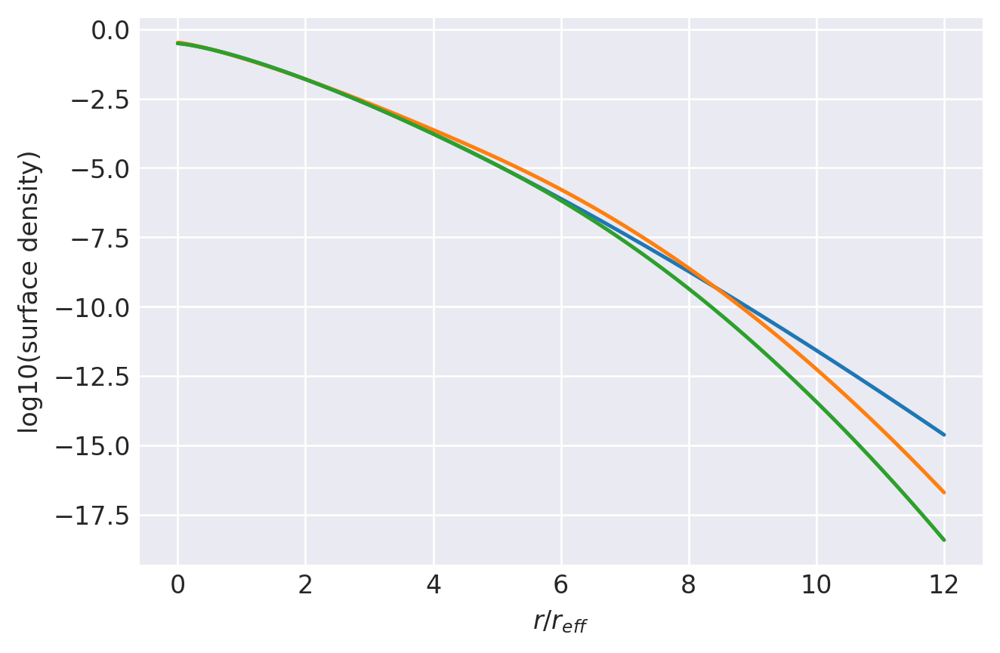

n=0.75: (
    normalize(np.array([9.5167494628e-02, 3.9081090139e-01, 3.3967509760e-01, 1.3175893673e-01, 3.4305106271e-02, 7.0494262755e-03, 1.1215789620e-03, 1.1145813102e-04])),
    np.array([1.6298210027e+00, 1.2528211963e+00, 9.2187141234e-01, 6.4156009607e-01, 4.2072708303e-01, 2.5719315745e-01, 1.4191484230e-01, 6.3952433382e-02]),
),
1.0000000187857572 1.0000000196964773
prev.  chisq = -6.869730899086066
ws, re: (array([0.10846654, 0.40298205, 0.32733137, 0.12247919, 0.03133709,
       0.00638995, 0.00101382]), array([1.6116988 , 1.23330695, 0.90359039, 0.62645431, 0.40957695,
       0.25288574, 0.13272692]))
         Current function value: -11.952262
         Iterations: 172
         Function evaluations: 4737
         Gradient evaluations: 315
-11.952261919082547 [-2.03235392  0.03249558  1.01553593  1.47810547  1.81702141  2.36920018
  0.17856951  0.07287697 -0.06037919 -0.22853268 -0.43365573 -0.68565805
 -1.02544528]
1.0000000187857572 1.0000000186707956


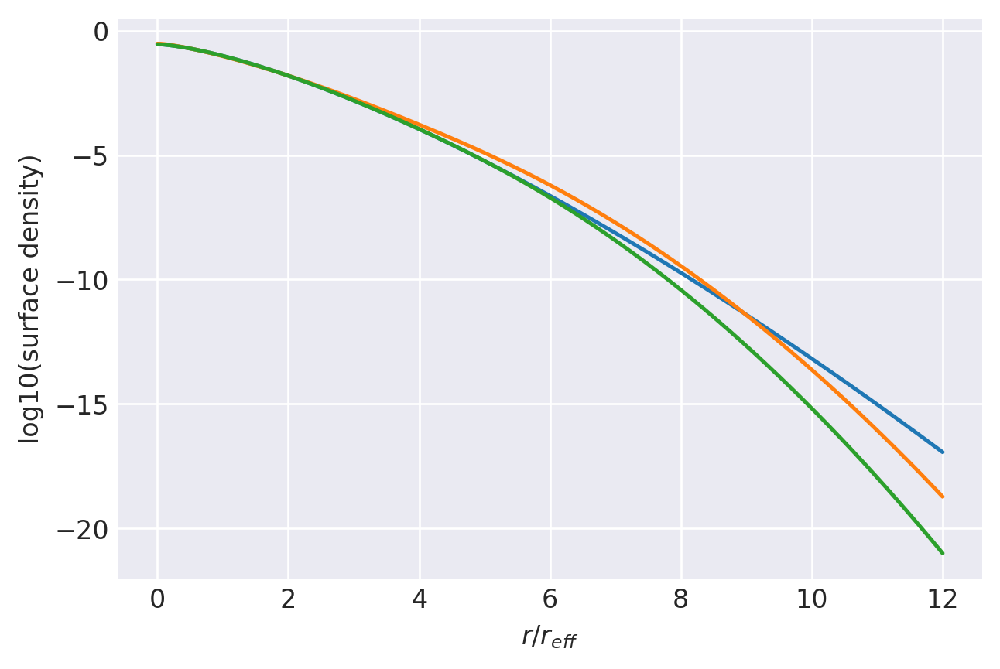

n=0.7: (
    normalize(np.array([1.1584759935e-01, 4.4925832966e-01, 3.1925666847e-01, 9.4161947089e-02, 1.8473365773e-02, 2.7452558180e-03, 2.5683384766e-04])),
    np.array([1.5085840400e+00, 1.1827064676e+00, 8.7020346704e-01, 5.9083650141e-01, 3.6842090584e-01, 2.0622530253e-01, 9.4309343285e-02]),
),
1.000000017532151 1.0000000182584923
prev.  chisq = -6.812053504566393
ws, re: (array([0.11587736, 0.44937374, 0.31933869, 0.09418614, 0.01847811,
       0.00274596]), array([1.50858404, 1.18270647, 0.87020347, 0.5908365 , 0.36842091,
       0.2062253 ]))
         Current function value: -11.749242
         Iterations: 143
         Function evaluations: 2612
         Gradient evaluations: 200
-11.749242425948415 [-1.03647729  0.8126692   1.57987729  1.93635539  2.45160893  0.12351295
  0.01643889 -0.13169752 -0.32689105 -0.57317194 -0.90712598]
1.000000017532151 1.0000000174458115


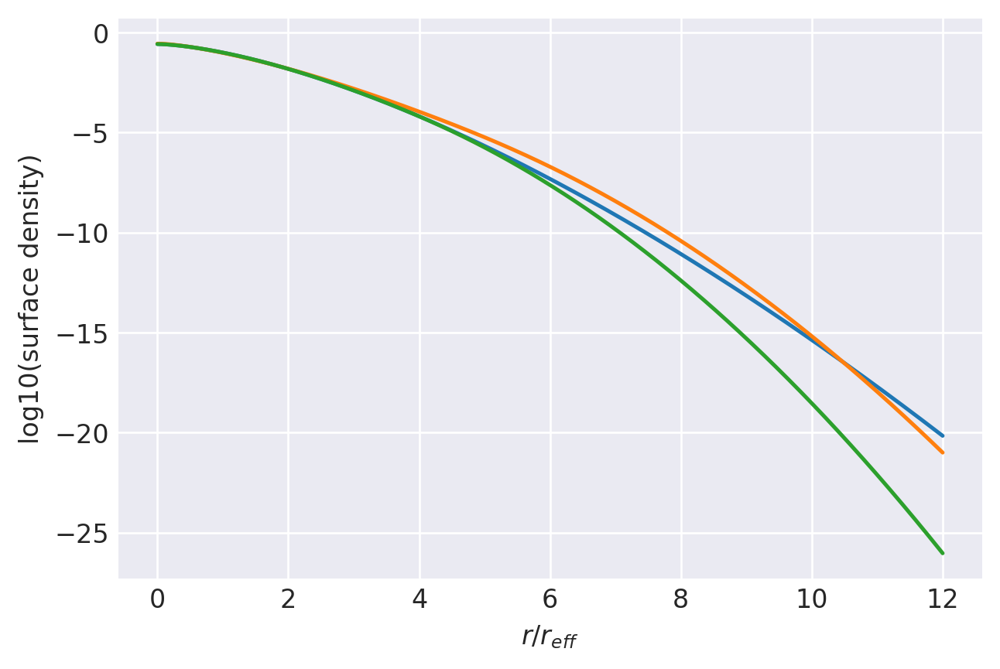

n=0.65: (
    normalize(np.array([2.6183027504e-01, 5.1131393105e-01, 1.8810590649e-01, 3.3865510527e-02, 4.4969433749e-03, 3.8743351832e-04])),
    np.array([1.3289631973e+00, 1.0385774455e+00, 7.3841834696e-01, 4.7109549871e-01, 2.6719483672e-01, 1.2384372936e-01]),
),
1.000000016395073 1.0000000156835687
prev.  chisq = -7.6095141772703165
ws, re: (array([0.40998043, 0.48679061, 0.09050881, 0.01203523, 0.00068493]), array([1.195 , 0.9656, 0.67  , 0.45  , 0.208 ]))
         Current function value: -11.443792
         Iterations: 47
         Function evaluations: 1211
         Gradient evaluations: 109
-11.443792062155998 [-0.34143151  1.51220842  2.13986148  2.59408027  0.08122373 -0.02055728
 -0.18595349 -0.42055999 -0.74691955]
1.000000016395073 1.00000001632613


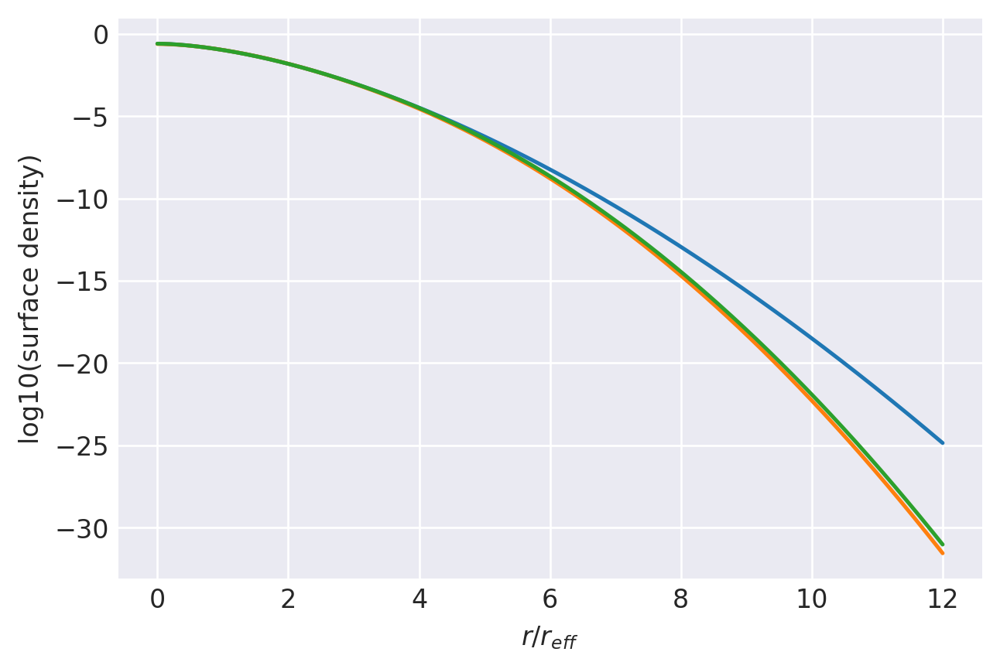

n=0.6: (
    normalize(np.array([4.1546178873e-01, 4.7896375027e-01, 9.4459324448e-02, 1.0342408068e-02, 7.7272848509e-04])),
    np.array([1.2056568803e+00, 9.5376794968e-01, 6.5169818599e-01, 3.7969948423e-01, 1.7909375620e-01]),
),
1.0000000159710858 1.00000001632613
prev.  chisq = -7.481980375282093
ws, re: (array([0.41546179, 0.47896375, 0.09445932, 0.01034241, 0.00077273]), array([1.20565688, 0.95376795, 0.65169819, 0.37969948, 0.17909376]))
         Current function value: -11.763399
         Iterations: 81
         Function evaluations: 1584
         Gradient evaluations: 143
-11.763399173885905 [-0.17535029  1.67591444  2.21457633  2.62391258  0.06757176 -0.02519721
 -0.18646514 -0.4192426  -0.74304606]
1.0000000159710858 1.0000000159238078


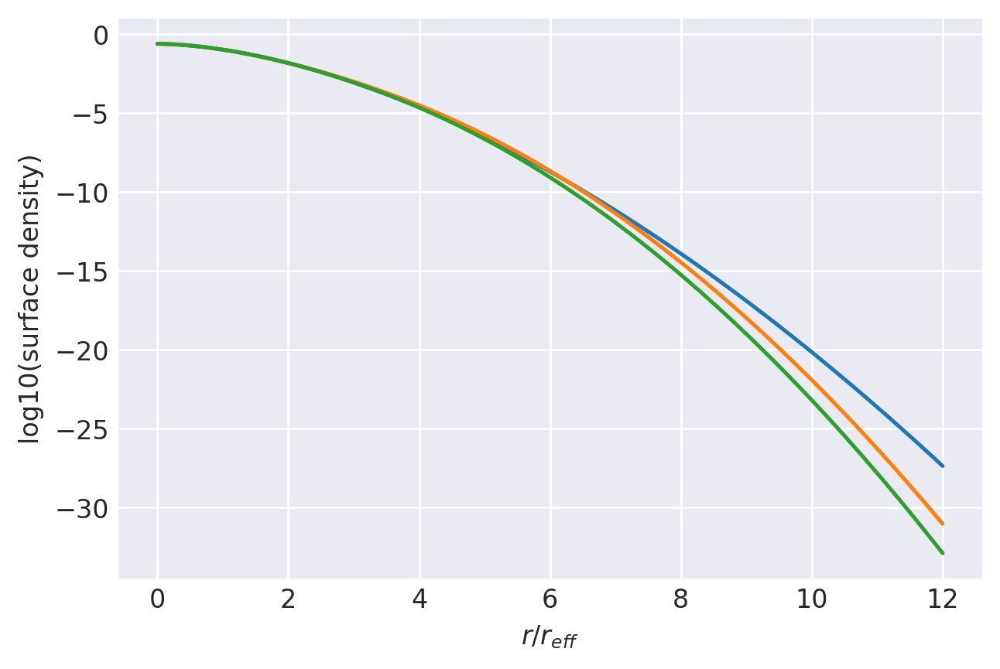

n=0.58: (
    normalize(np.array([4.5627440940e-01, 4.5801419853e-01, 7.7273178826e-02, 7.8676616590e-03, 5.7055159001e-04])),
    np.array([1.1683467566e+00, 9.4363227290e-01, 6.5093086112e-01, 3.8085301923e-01, 1.8069824796e-01]),
),
1.0000000155640396 1.0000000159238078
prev.  chisq = -7.452188946154672
ws, re: (array([0.45627441, 0.4580142 , 0.07727318, 0.00786766, 0.00057055]), array([1.16834676, 0.94363227, 0.65093086, 0.38085302, 0.18069825]))
         Current function value: -12.151353
         Iterations: 97
         Function evaluations: 2013
         Gradient evaluations: 182
-12.151352723716515 [ 0.05535496  1.89423432  2.30636739  2.66082724  0.05289775 -0.03031657
 -0.18894567 -0.42170119 -0.74379745]
1.0000000155640396 1.000000015534611


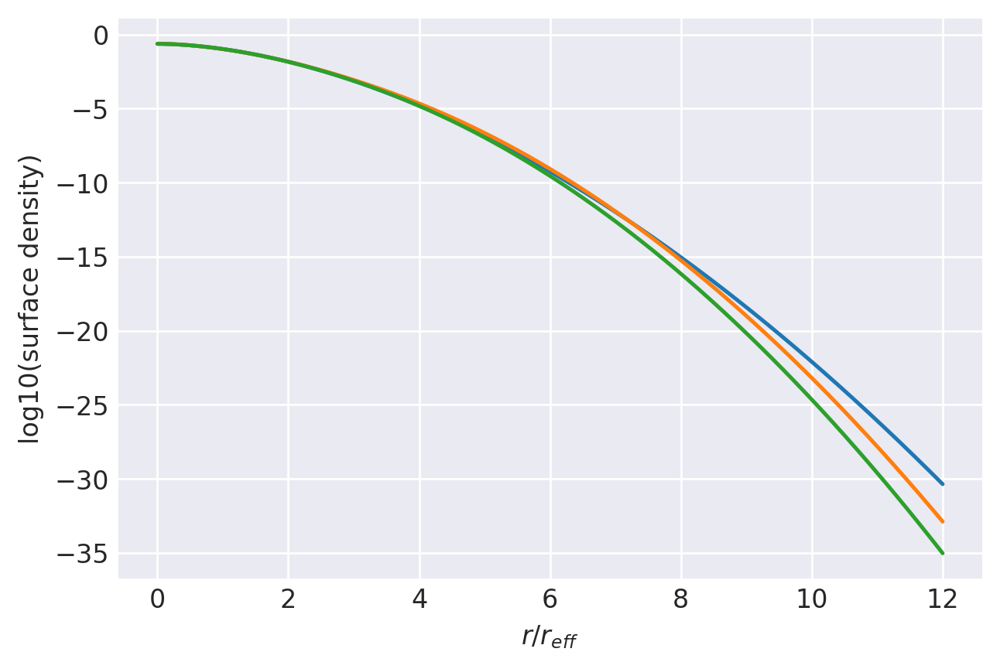

n=0.56: (
    normalize(np.array([5.1383520859e-01, 4.2259270295e-01, 5.7812648759e-02, 5.3832054183e-03, 3.7623428159e-04])),
    np.array([1.1295299365e+00, 9.3257427802e-01, 6.4722357532e-01, 3.7870305436e-01, 1.8038588490e-01]),
),
1.000000015366738 1.0000000165476184
prev.  chisq = -6.391817710965432
ws, re: (array([0.31176674, 0.50952197, 0.15184782, 0.02387212, 0.00299134]), array([1.26358302, 1.00696536, 0.72107801, 0.46050732, 0.26211134]))
         Current function value: -12.387044
         Iterations: 232
         Function evaluations: 3752
         Gradient evaluations: 340
-12.387044085516738 [ 0.20934238  2.01767192  2.33679531  2.67101874  0.04508889 -0.0328943
 -0.18963312 -0.42106138 -0.74157901]
1.000000015366738 1.00000001534422


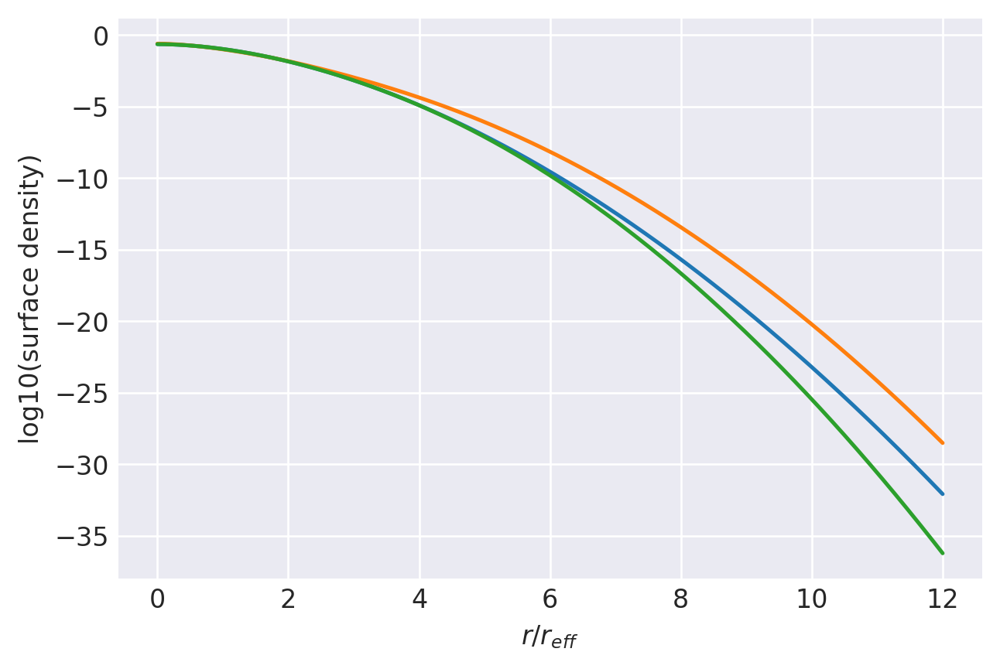

n=0.55: (
    normalize(np.array([5.5214529709e-01, 3.9529450455e-01, 4.7928536367e-02, 4.3319689703e-03, 2.9969302520e-04])),
    np.array([1.1094018518e+00, 9.2705543556e-01, 6.4619989426e-01, 3.7926137736e-01, 1.8130968040e-01]),
),
1.00000001517352 1.00000001534422
prev.  chisq = -8.015510024202827
ws, re: (array([5.52145297e-01, 3.95294505e-01, 4.79285364e-02, 4.33196897e-03,
       2.99693025e-04]), array([1.10940185, 0.92705544, 0.64619989, 0.37926138, 0.18130968]))
         Current function value: -12.661819
         Iterations: 115
         Function evaluations: 1914
         Gradient evaluations: 173
-12.661818637378941 [ 0.40212577  2.16348678  2.36676534  2.6774775   0.03696932 -0.0355063
 -0.19084643 -0.42103548 -0.73969155]
1.00000001517352 1.000000015157044


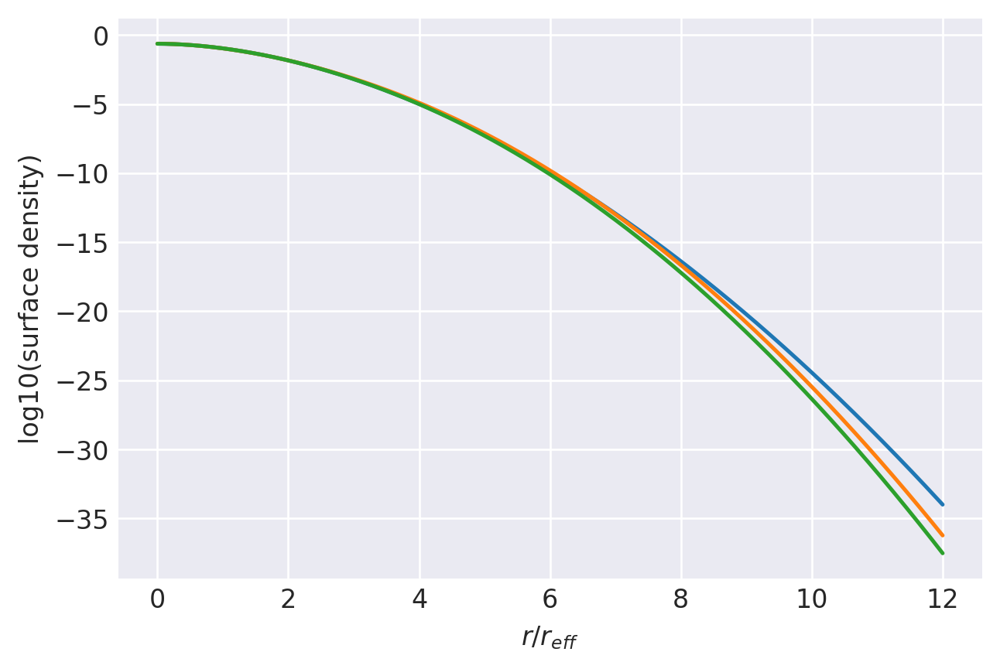

n=0.54: (
    normalize(np.array([5.9919829101e-01, 3.5948801370e-01, 3.7771361281e-02, 3.3145069862e-03, 2.2782702383e-04])),
    np.array([1.0888531764e+00, 9.2149653125e-01, 6.4439708848e-01, 3.7928399702e-01, 1.8209937478e-01]),
),
1.0000000150784267 1.000000015157044
prev.  chisq = -8.605663213534255
ws, re: (array([5.99198291e-01, 3.59488014e-01, 3.77713613e-02, 3.31450699e-03,
       2.27827024e-04]), array([1.08885318, 0.92149653, 0.64439709, 0.379284  , 0.18209937]))
         Current function value: -12.821095
         Iterations: 72
         Function evaluations: 2267
         Gradient evaluations: 205
-12.821095163184612 [ 0.53124641  2.25566855  2.3862771   2.68376608  0.03266247 -0.03731978
 -0.19304865 -0.42346368 -0.74166593]
1.0000000150784267 1.0000000150648582


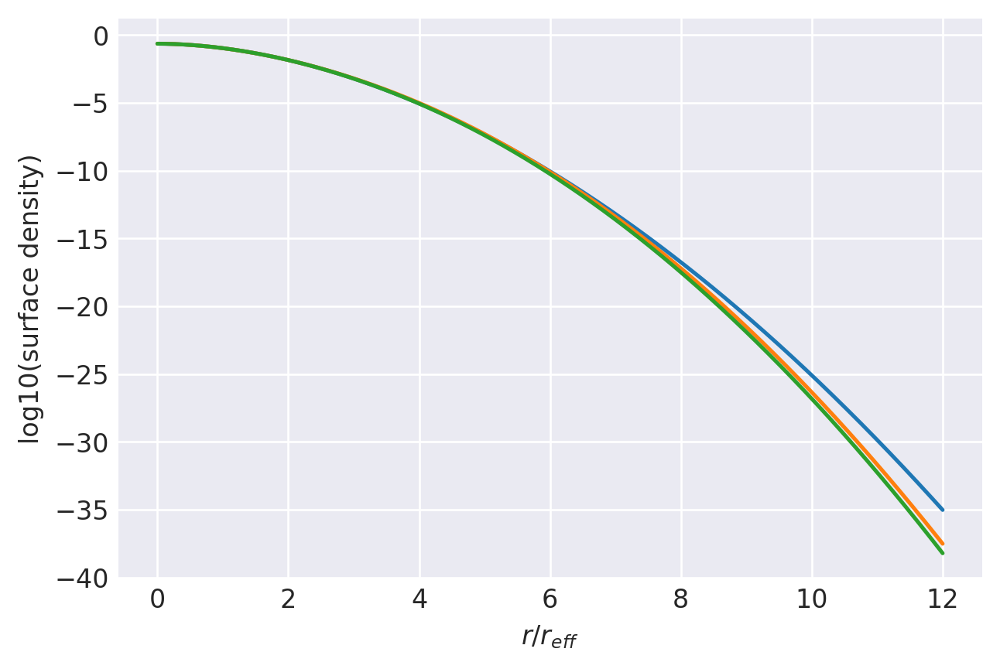

n=0.535: (
    normalize(np.array([6.2977376980e-01, 3.3510596744e-01, 3.2162253723e-02, 2.7688795476e-03, 1.8912949458e-04])),
    np.array([1.0781085002e+00, 9.1765666119e-01, 6.4113774567e-01, 3.7716928873e-01, 1.8127339665e-01]),
),
1.000000014984337 1.0000000150648582
prev.  chisq = -8.597601421155877
ws, re: (array([6.29773770e-01, 3.35105967e-01, 3.21622537e-02, 2.76887955e-03,
       1.89129495e-04]), array([1.0781085 , 0.91765666, 0.64113775, 0.37716929, 0.1812734 ]))
         Current function value: -12.997048
         Iterations: 67
         Function evaluations: 1627
         Gradient evaluations: 147
-12.997047583471003 [ 0.64823302  2.33648105  2.40353511  2.69128785  0.02856572 -0.03781058
 -0.19231823 -0.42219819 -0.73964424]
1.000000014984337 1.0000000149731647


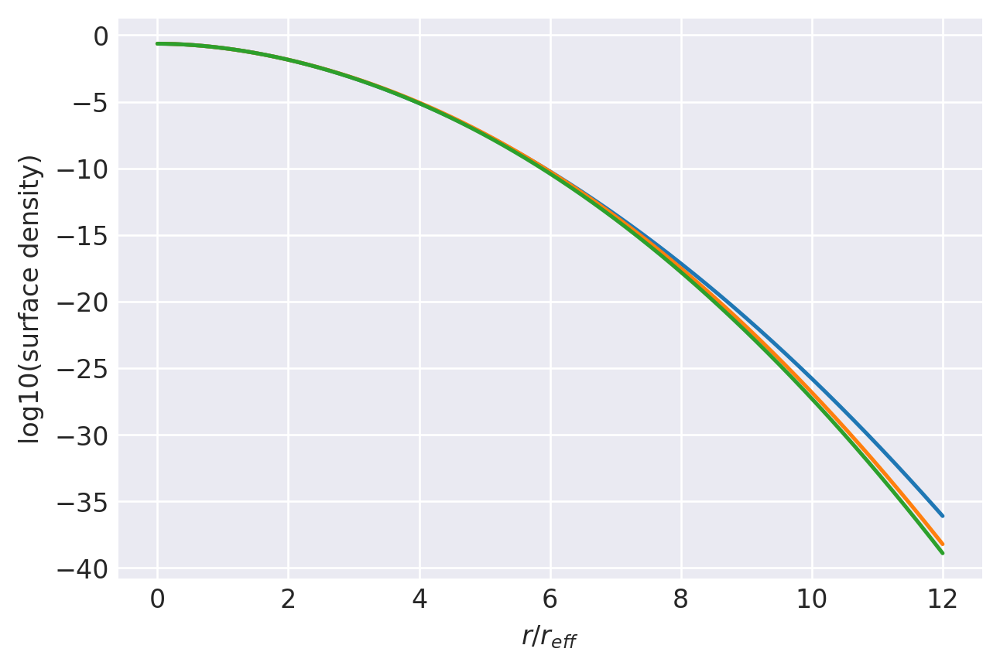

n=0.53: (
    normalize(np.array([6.5661216651e-01, 3.1311945054e-01, 2.7759027355e-02, 2.3500381066e-03, 1.5931748562e-04])),
    np.array([1.0679864031e+00, 9.1662020251e-01, 6.4221696590e-01, 3.7826992238e-01, 1.8211921019e-01]),
),
1.000000014984337 1.0000000150612618
prev.  chisq = -8.034436622248457
ws, re: (array([0.59933484, 0.35956993, 0.03777997, 0.00331526]), array([1.08885318, 0.92149653, 0.64439709, 0.379284  ]))
         Current function value: -11.866127
         Iterations: 73
         Function evaluations: 1191
         Gradient evaluations: 131
-11.86612675237935 [ 1.03949797  2.74177944  2.94245234  0.0252867  -0.05665531 -0.25646952
 -0.57025258]
1.000000014984337 1.0000000149610702


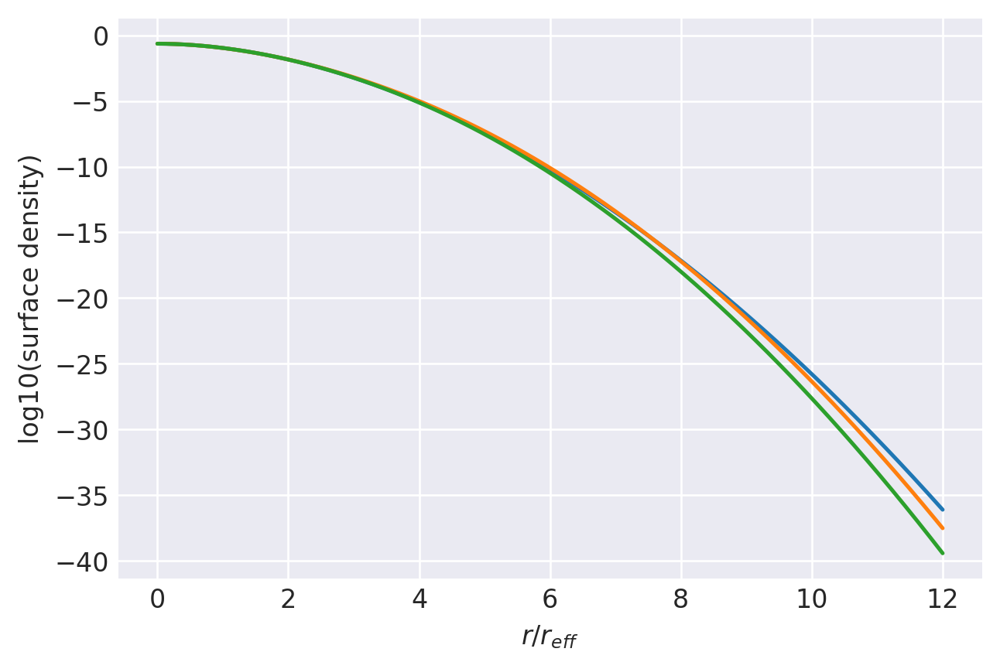

n=0.53: (
    normalize(np.array([7.3875312820e-01, 2.4542769471e-01, 1.5026724116e-02, 7.9245297099e-04])),
    np.array([1.0599532357e+00, 8.7769714840e-01, 5.5402642897e-01, 2.6899699021e-01]),
),
1.000000014891245 1.0000000149610702
prev.  chisq = -8.58937138783239
ws, re: (array([0.73875313, 0.24542769, 0.01502672, 0.00079245]), array([1.05995324, 0.87769715, 0.55402643, 0.26899699]))
         Current function value: -12.063909
         Iterations: 50
         Function evaluations: 1254
         Gradient evaluations: 138
-12.063908737481464 [ 1.20455043  2.8321562   2.95494346  0.02134281 -0.05747228 -0.25775645
 -0.57124271]
1.000000014891245 1.0000000148728263


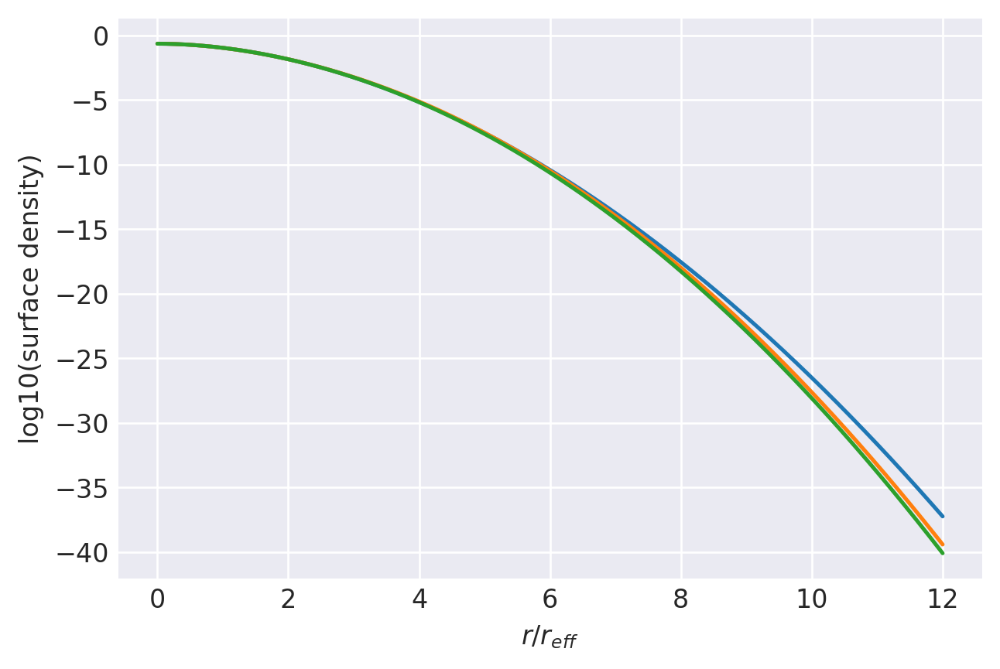

n=0.525: (
    normalize(np.array([7.6933329111e-01, 2.1783909121e-01, 1.2192607130e-02, 6.3501054964e-04])),
    np.array([1.0503712131e+00, 8.7604763161e-01, 5.5238713125e-01, 2.6838441626e-01]),
),
1.000000014799145 1.0000000148728263
prev.  chisq = -8.581147263182615
ws, re: (array([7.69333291e-01, 2.17839091e-01, 1.21926071e-02, 6.35010550e-04]), array([1.05037121, 0.87604763, 0.55238713, 0.26838442]))
         Current function value: -12.298731
         Iterations: 48
         Function evaluations: 992
         Gradient evaluations: 109
-12.29873135983647 [ 1.40175766  2.92573599  2.96500193  0.0173523  -0.05789957 -0.25827789
 -0.57114444]
1.000000014799145 1.0000000147850436


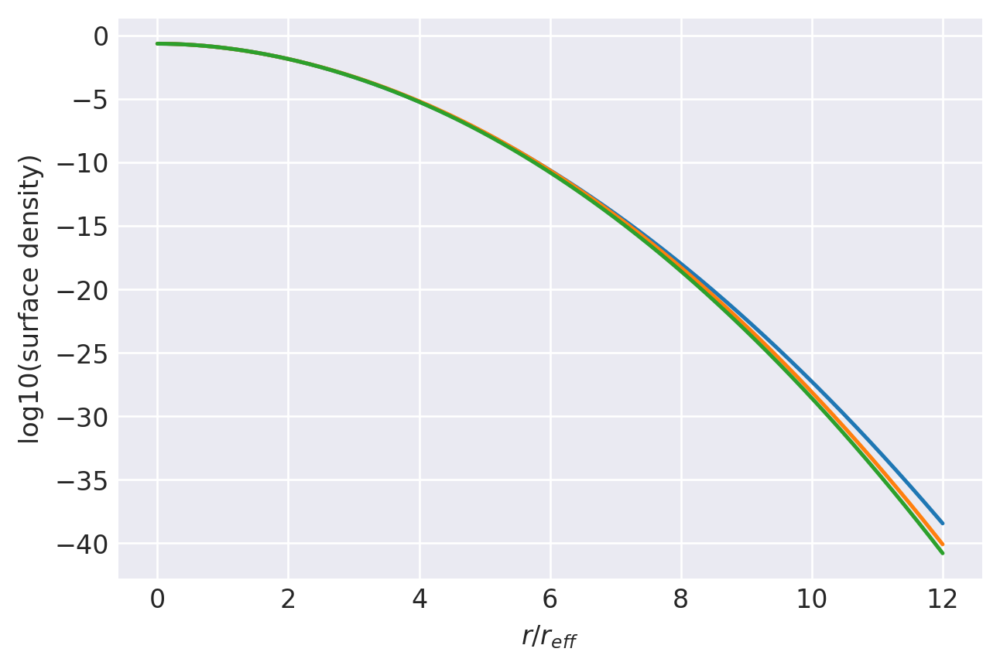

n=0.52: (
    normalize(np.array([8.0246265385e-01, 1.8748350391e-01, 9.5608797516e-03, 4.9296249415e-04])),
    np.array([1.0407640924e+00, 8.7518613346e-01, 5.5172430276e-01, 2.6844514757e-01]),
),
1.0000000147080328 1.0000000147850436
prev.  chisq = -8.572849964440458
ws, re: (array([8.02462654e-01, 1.87483504e-01, 9.56087975e-03, 4.92962494e-04]), array([1.04076409, 0.87518613, 0.5517243 , 0.26844515]))
         Current function value: -12.591653
         Iterations: 62
         Function evaluations: 1569
         Gradient evaluations: 173
-12.591653387057086 [ 1.66793065  3.03117732  2.97522019  0.0132094  -0.05855326 -0.25966254
 -0.57217685]
1.0000000147080328 1.0000000146980075


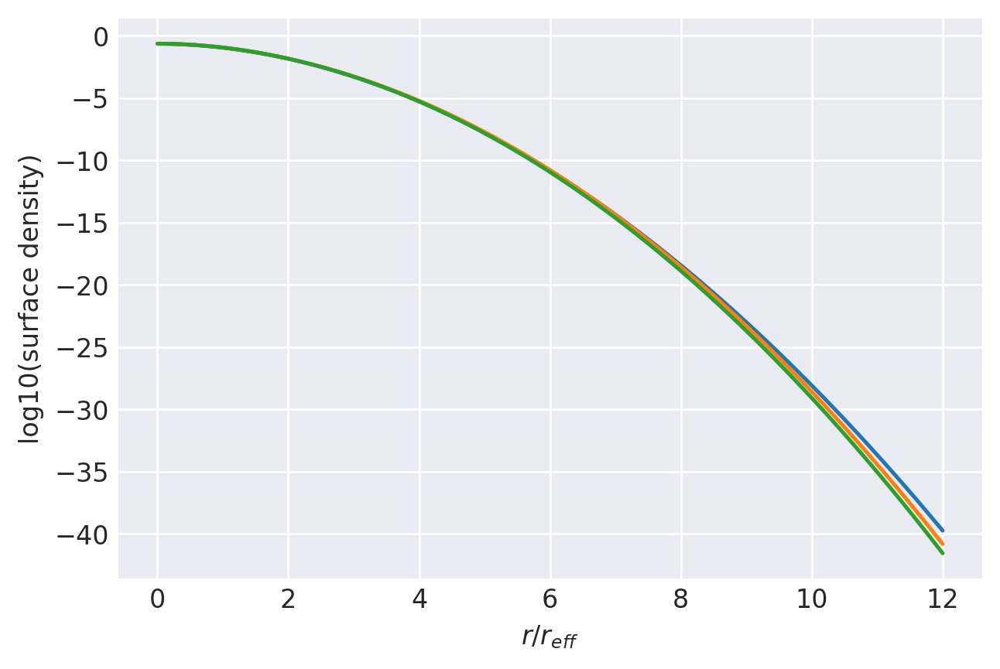

n=0.515: (
    normalize(np.array([8.4129972796e-01, 1.5139417263e-01, 6.9513299760e-03, 3.5476943250e-04])),
    np.array([1.0308830531e+00, 8.7386981676e-01, 5.4996804427e-01, 2.6780775396e-01]),
),


In [4]:
#np.round(10**np.linspace(np.log10(0.5005), np.log10(6.3), num=200), 4)

# First attempt to manually finagle a smooth spline with free weights and radii while gradually removing components
# It does not work very well

# These initial parameters are not terribly important
nvals = [
    (
        np.array([0.501]),
        (normalize(np.array([0.98, 0.02])), np.array([1.01, 0.9])),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.507]),
        (
    normalize(np.array([8.7013734755e-01, 1.2619085952e-01, 3.6717929279e-03])),
    np.array([1.0339248832e+00, 8.1955230658e-01, 4.2170643991e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
# The rest of these required working backwards and repeatedly re-starting guesses to produce a smooth spline
nvals = [
    (
        np.array([0.95, 0.9, 0.85, 0.8, 0.75]),
        (
	normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
	np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.70]),
        (
    normalize(np.array([1.0845562525e-01, 4.0294151495e-01, 3.2729844440e-01, 1.2246687144e-01, 3.1333936150e-02, 6.3893051250e-03, 1.0137209694e-03])),
    np.array([1.6116987996e+00, 1.2333069456e+00, 9.0359039048e-01, 6.2645430811e-01, 4.0957694795e-01, 2.5288574221e-01, 1.3272691536e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.65]),
        (
    normalize(np.array([1.1584759935e-01, 4.4925832966e-01, 3.1925666847e-01, 9.4161947089e-02, 1.8473365773e-02, 2.7452558180e-03])),
    np.array([1.5085840400e+00, 1.1827064676e+00, 8.7020346704e-01, 5.9083650141e-01, 3.6842090584e-01, 2.0622530253e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.6, 0.58, 0.56]),
        (
            normalize(np.array([4.19e-01        , 4.975e-01       , 9.25e-02        , 1.23e-02        , 7.0e-04])),
            np.array([1.195e+00       , 9.656e-01       , 6.7e-01       , 4.5e-01       , 2.08e-01        ]),
        )
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.55, 0.54, 0.535, 0.53]),
        (
    normalize(np.array([3.1168895061e-01, 5.0939483801e-01, 1.5180993252e-01, 2.3866167881e-02, 2.9905915132e-03])),
    np.array([1.2635830241e+00, 1.0069653570e+00, 7.2107800516e-01, 4.6050732036e-01, 2.6211133918e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])
nvals = [
    (
        np.array([0.53, 0.525, 0.52, 0.515]),
        (
    normalize(np.array([5.9919829101e-01, 3.5948801370e-01, 3.7771361281e-02, 3.3145069862e-03])),
    np.array([1.0888531764e+00, 9.2149653125e-01, 6.4439708848e-01, 3.7928399702e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, methods=['BFGS'])

## Why can't you just fit N components down to n=0.5?

You can try, but it doesn't work well below n=0.6 as the smallest component(s) gradually reduce their weights to near-zero values. Once this happens, it becomes very difficult to ensure smooth changes in the best-fit weight even given small changes in n - the best-fit weights are essentially 'noisy'.

0.9999999914677243 1.0000000283694637
prev.  chisq = -10.92882749800659
ws, re: (array([0.07790019, 0.31264016, 0.33937179, 0.1839253 , 0.06541804,
       0.01709507, 0.00326612, 0.00038332]), array([2.17045661, 1.47679133, 0.99494464, 0.65054022, 0.40699848,
       0.23877605, 0.12631553, 0.05405815]))
         Current function value: -10.928831
         Iterations: 11
         Function evaluations: 1185
         Gradient evaluations: 69
-10.928831306589267 [-2.47095375e+00 -6.67489981e-01  2.28175095e-01  7.58180742e-01
  1.14859215e+00  1.54422292e+00  2.14252775e+00  3.36535868e-01
  1.69305642e-01 -2.20048990e-03 -1.86707161e-01 -3.90387752e-01
 -6.21998233e-01 -8.98532198e-01 -1.26716661e+00]
0.9999999914677243 1.000000028369817


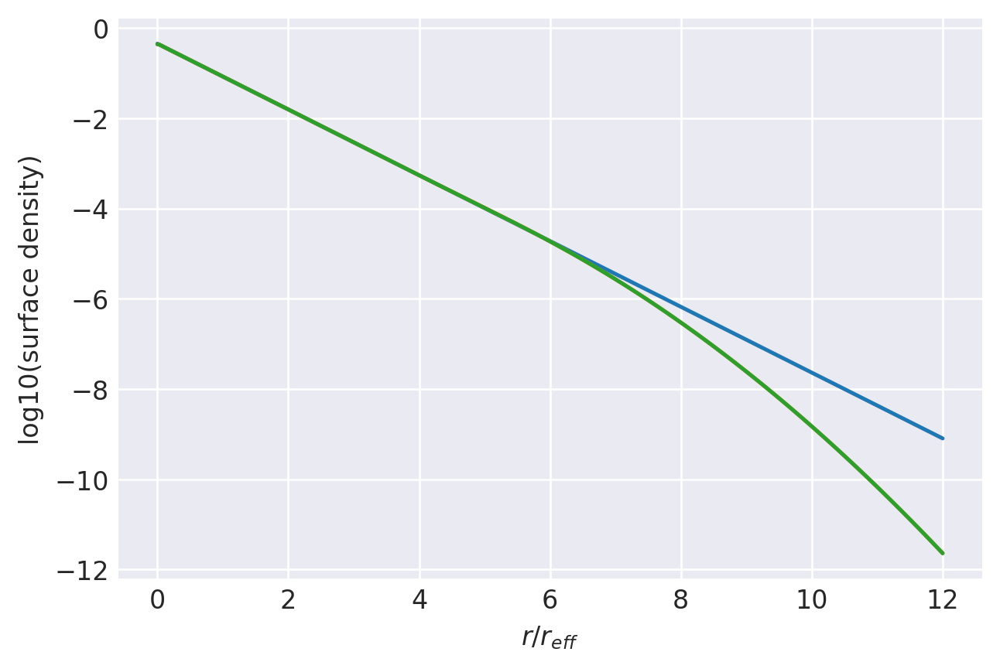

n=1.0: (
    normalize(np.array([7.7919682300e-02, 3.1263972612e-01, 3.3933503571e-01, 1.8393070736e-01, 6.5428570239e-02, 1.7096546835e-02, 3.2663945086e-03, 3.8333692824e-04])),
    np.array([2.1703804472e+00, 1.4767454532e+00, 9.9494599942e-01, 6.5056821172e-01, 4.0701671809e-01, 2.3878209990e-01, 1.2631874480e-01, 5.4054690629e-02]),
),
0.9999999965981404 1.000000028369817
prev.  chisq = -9.13019052985866
ws, re: (array([0.07791968, 0.31263973, 0.33933504, 0.18393071, 0.06542857,
       0.01709655, 0.00326639, 0.00038334]), array([2.17038045, 1.47674545, 0.994946  , 0.65056821, 0.40701672,
       0.2387821 , 0.12631874, 0.05405469]))
         Current function value: -10.950395
         Iterations: 47
         Function evaluations: 2391
         Gradient evaluations: 140
-10.950394823119355 [-2.46364834 -0.65973694  0.23535019  0.76423871  1.15332769  1.548043
  2.14595816  0.33411515  0.16772479 -0.0031534  -0.18717722 -0.39047364
 -0.62175276 -0.89798889 -1.26624936]
0.99999999659

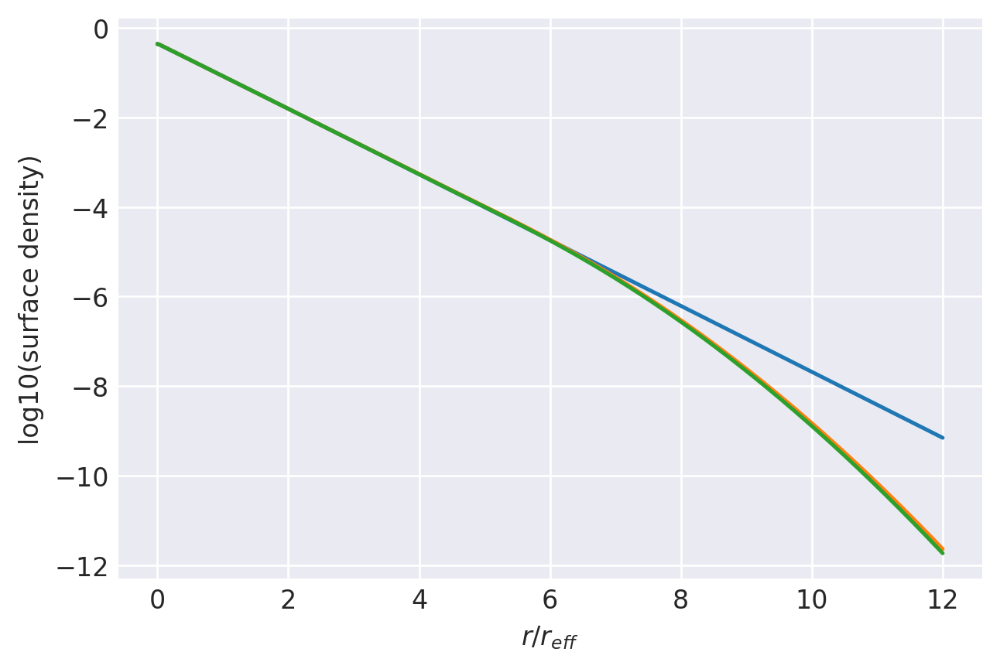

n=0.995: (
    normalize(np.array([7.8446183932e-02, 3.1406434947e-01, 3.3932384870e-01, 1.8296223981e-01, 6.4764639051e-02, 1.6854415782e-02, 3.2090104756e-03, 3.7531277364e-04])),
    np.array([2.1583165776e+00, 1.4713798133e+00, 9.9276532523e-01, 6.4986444561e-01, 4.0693622906e-01, 2.3891710322e-01, 1.2647686885e-01, 5.4168977602e-02]),
),
1.0000000010516281 1.0000000281824708
prev.  chisq = -9.126334939179626
ws, re: (array([0.07844618, 0.31406435, 0.33932385, 0.18296224, 0.06476464,
       0.01685442, 0.00320901, 0.00037531]), array([2.15831658, 1.47137981, 0.99276533, 0.64986445, 0.40693623,
       0.2389171 , 0.12647687, 0.05416898]))
         Current function value: -10.972226
         Iterations: 34
         Function evaluations: 2120
         Gradient evaluations: 124
-10.97222600646666 [-2.45946858 -0.65338749  0.24207346  0.77013119  1.15795415  1.55161545
  2.14885148  0.3318619   0.16634271 -0.00390661 -0.18745521 -0.39036681
 -0.62130452 -0.89719975 -1.26506099]
1.000000

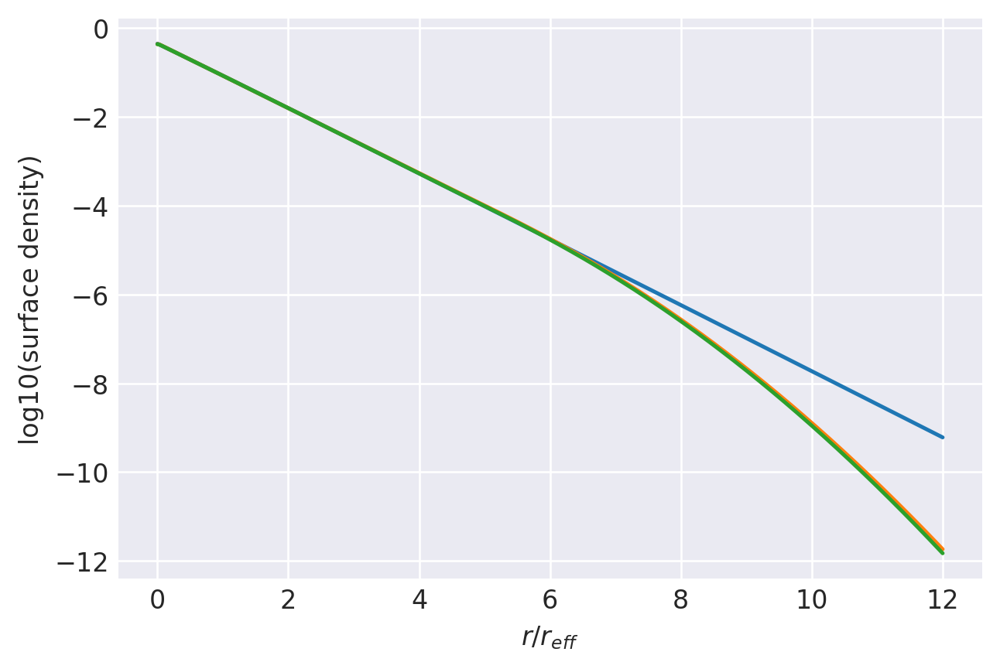

n=0.99: (
    normalize(np.array([7.8748882011e-02, 3.1527662000e-01, 3.3948179457e-01, 1.8216089349e-01, 6.4173199336e-02, 1.6633815653e-02, 3.1566703056e-03, 3.6812463680e-04])),
    np.array([2.1471476039e+00, 1.4667048040e+00, 9.9104503426e-01, 6.4944861490e-01, 4.0703634466e-01, 2.3916382111e-01, 1.2670689594e-01, 5.4317404722e-02]),
),
1.0000000049031 1.0000000279936356
prev.  chisq = -9.12244604015327
ws, re: (array([0.07874888, 0.31527662, 0.33948179, 0.18216089, 0.0641732 ,
       0.01663382, 0.00315667, 0.00036812]), array([2.1471476 , 1.4667048 , 0.99104503, 0.64944861, 0.40703634,
       0.23916382, 0.1267069 , 0.0543174 ]))
         Current function value: -10.994306
         Iterations: 31
         Function evaluations: 1882
         Gradient evaluations: 110
-10.994305676803238 [-2.45609209 -0.64749145  0.2486469   0.77589106  1.16230703  1.55489832
  2.15162808  0.32964481  0.16501613 -0.00459278 -0.18766145 -0.39016926
 -0.62073237 -0.89625056 -1.26370165]
1.0000000049

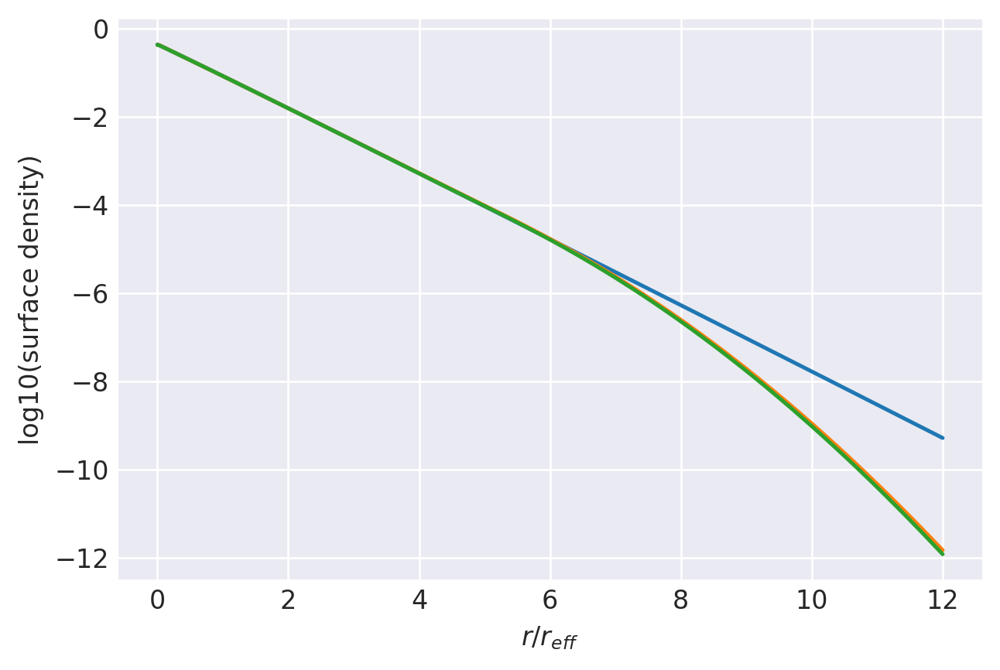

n=0.985: (
    normalize(np.array([7.8994186452e-02, 3.1641620349e-01, 3.3968469926e-01, 1.8140525885e-01, 6.3605998603e-02, 1.6424599579e-02, 3.1076505756e-03, 3.6140318626e-04])),
    np.array([2.1362142657e+00, 1.4622314919e+00, 9.8948045158e-01, 6.4914027013e-01, 4.0722153691e-01, 2.3947910549e-01, 1.2698412679e-01, 5.4487684484e-02]),
),
1.0000000082206035 1.0000000278041312
prev.  chisq = -9.118494536639165
ws, re: (array([0.07899419, 0.3164162 , 0.3396847 , 0.18140526, 0.063606  ,
       0.0164246 , 0.00310765, 0.0003614 ]), array([2.13621427, 1.46223149, 0.98948045, 0.64914027, 0.40722154,
       0.23947911, 0.12698413, 0.05448768]))
         Current function value: -11.016806
         Iterations: 35
         Function evaluations: 2154
         Gradient evaluations: 126
-11.016805939104628 [-2.46443821 -0.64862918  0.25129699  0.78000698  1.16658717  1.55891906
  2.15520979  0.32802838  0.16449591 -0.00431938 -0.18681868 -0.38891911
 -0.61917687 -0.89443358 -1.26154236]
1.00000

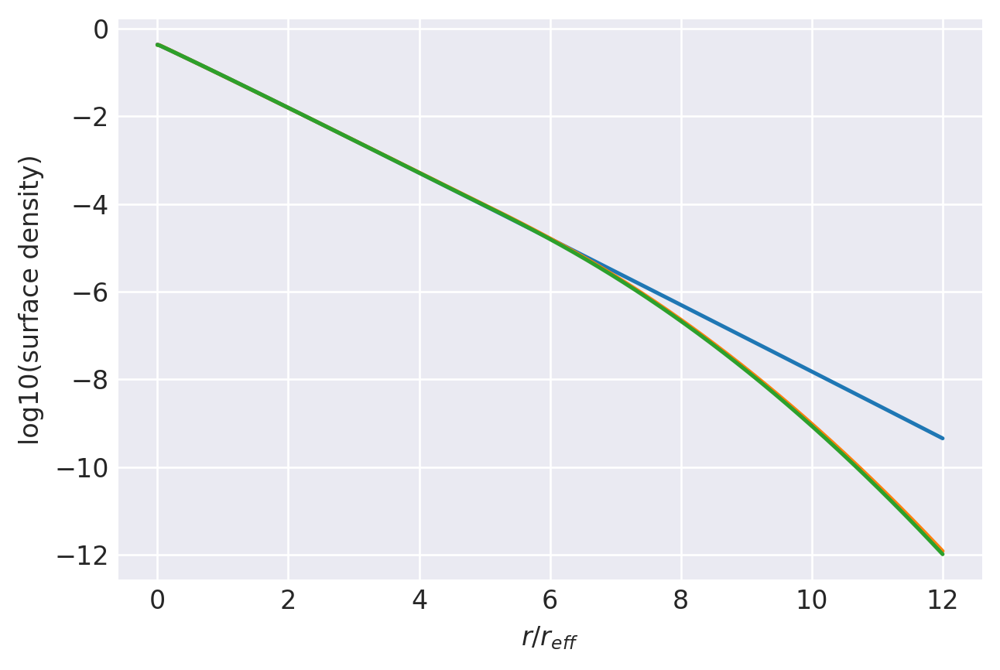

n=0.98: (
    normalize(np.array([7.8389101272e-02, 3.1638765311e-01, 3.4043547772e-01, 1.8156010509e-01, 6.3463387972e-02, 1.6329208096e-02, 3.0783508966e-03, 3.5671584639e-04])),
    np.array([2.1282781338e+00, 1.4604809912e+00, 9.9010354726e-01, 6.5040118063e-01, 4.0839544944e-01, 2.4033837843e-01, 1.2751651151e-01, 5.4759268657e-02]),
),
1.000000011065797 1.0000000276122119
prev.  chisq = -9.114498375078561
ws, re: (array([0.0783891 , 0.31638765, 0.34043548, 0.18156011, 0.06346339,
       0.01632921, 0.00307835, 0.00035672]), array([2.12827813, 1.46048099, 0.99010355, 0.65040118, 0.40839545,
       0.24033838, 0.12751651, 0.05475927]))
         Current function value: -11.039360
         Iterations: 27
         Function evaluations: 2001
         Gradient evaluations: 117
-11.03935978732177 [-2.46301116 -0.64387859  0.25669578  0.78476661  1.17078596  1.56251075
  2.15789807  0.32589236  0.16329458 -0.00481734 -0.18674047 -0.38838129
 -0.61827238 -0.89319519 -1.25985961]
1.00000001

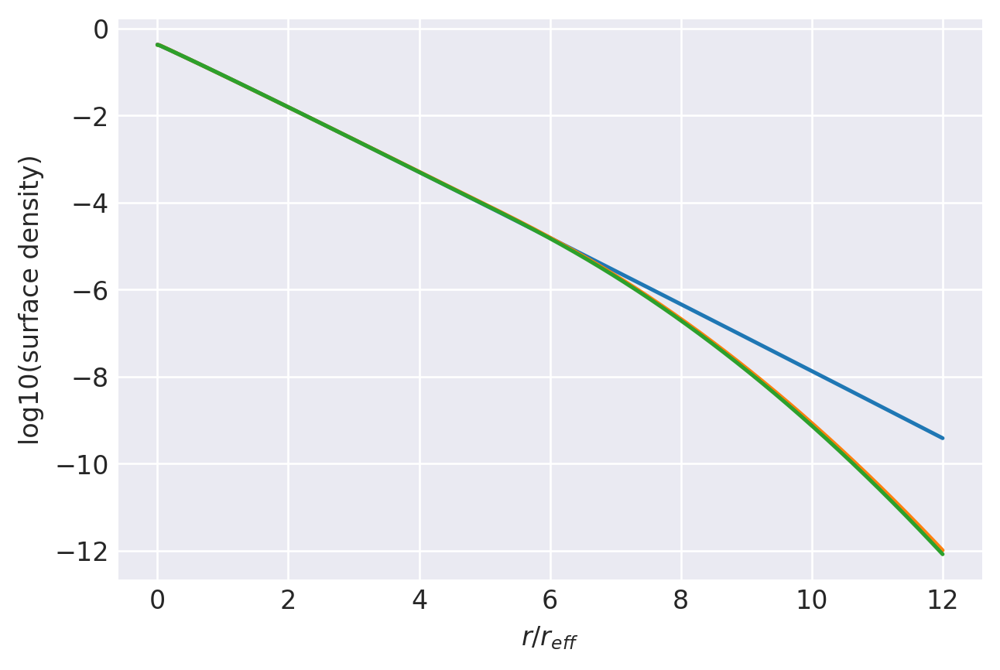

n=0.975: (
    normalize(np.array([7.8492259575e-02, 3.1733990238e-01, 3.4064424822e-01, 1.8096336632e-01, 6.3017149586e-02, 1.6156519811e-02, 3.0357224100e-03, 3.5083170430e-04])),
    np.array([2.1178361862e+00, 1.4564466460e+00, 9.8896894906e-01, 6.5051832346e-01, 4.0890150279e-01, 2.4083944712e-01, 1.2788064118e-01, 5.4971854773e-02]),
),
1.0000000134944007 1.000000027422825
prev.  chisq = -9.110646846051111
ws, re: (array([0.07849226, 0.3173399 , 0.34064425, 0.18096337, 0.06301715,
       0.01615652, 0.00303572, 0.00035083]), array([2.11783619, 1.45644665, 0.98896895, 0.65051832, 0.4089015 ,
       0.24083945, 0.12788064, 0.05497185]))
         Current function value: -11.062136
         Iterations: 28
         Function evaluations: 2528
         Gradient evaluations: 148
-11.062136040274215 [-2.45871564 -0.63739555  0.26400955  0.79154753  1.17567091  1.56535566
  2.16004191  0.32359416  0.16190237 -0.00557425 -0.18706514 -0.38836949
 -0.61788717 -0.89236142 -1.2585665 ]
1.000000

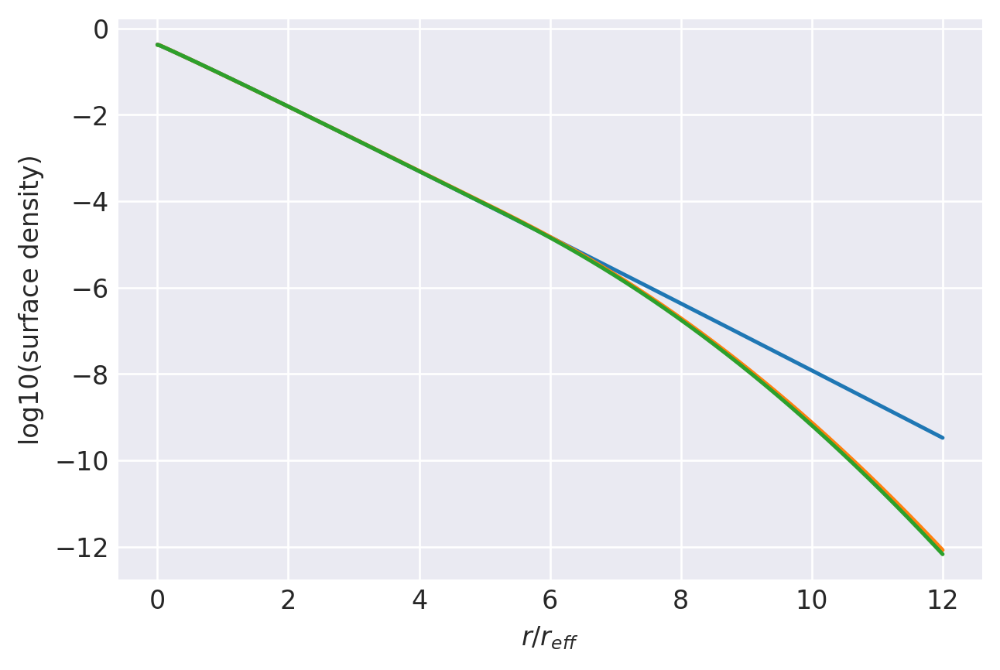

n=0.97: (
    normalize(np.array([7.8803523011e-02, 3.1858245887e-01, 3.4085154814e-01, 1.8013538246e-01, 6.2376851464e-02, 1.5922265126e-02, 2.9838701624e-03, 3.4410076591e-04])),
    np.array([2.1066586105e+00, 1.4517852082e+00, 9.8724682936e-01, 6.5003217856e-01, 4.0891261440e-01, 2.4105316221e-01, 1.2812638619e-01, 5.5135777007e-02]),
),
1.000000015556635 1.0000000272352878
prev.  chisq = -9.106441016085684
ws, re: (array([0.07880352, 0.31858246, 0.34085155, 0.18013538, 0.06237685,
       0.01592227, 0.00298387, 0.0003441 ]), array([2.10665861, 1.45178521, 0.98724683, 0.65003218, 0.40891261,
       0.24105316, 0.12812639, 0.05513578]))
         Current function value: -11.085086
         Iterations: 28
         Function evaluations: 2324
         Gradient evaluations: 136
-11.085085602363145 [-2.44707234 -0.62607741  0.27405557  0.79956012  1.18149979  1.56978169
  2.16302617  0.320923    0.15999254 -0.00695754 -0.18807437 -0.38907559
 -0.61832067 -0.89250103 -1.25824509]
1.0000000

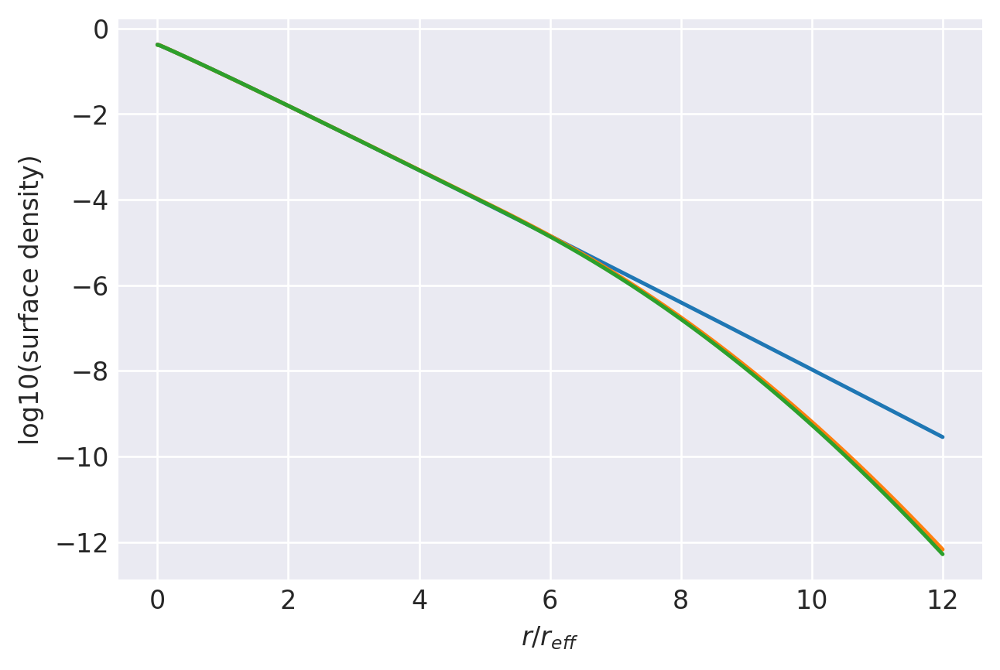

n=0.965: (
    normalize(np.array([7.9652906813e-02, 3.2064939074e-01, 3.4068122966e-01, 1.7869038231e-01, 6.1466919163e-02, 1.5610725907e-02, 2.9134649523e-03, 3.3498045458e-04])),
    np.array([2.0937412212e+00, 1.4454149529e+00, 9.8410731982e-01, 6.4852336195e-01, 4.0824832753e-01, 2.4081266904e-01, 1.2808520606e-01, 5.5176596936e-02]),
),
1.0000000172976387 1.0000000270498608
prev.  chisq = -9.102282006539676
ws, re: (array([7.96529068e-02, 3.20649391e-01, 3.40681230e-01, 1.78690382e-01,
       6.14669192e-02, 1.56107259e-02, 2.91346495e-03, 3.34980455e-04]), array([2.09374122, 1.44541495, 0.98410732, 0.64852336, 0.40824833,
       0.24081267, 0.12808521, 0.0551766 ]))
         Current function value: -11.108129
         Iterations: 31
         Function evaluations: 2154
         Gradient evaluations: 126
-11.108129091164827 [-2.43454043 -0.61376267  0.28474401  0.80742294  1.18696884  1.57348645
  2.16692768  0.31820997  0.15800816 -0.00845507 -0.18919264 -0.38984782
 -0.61876171 

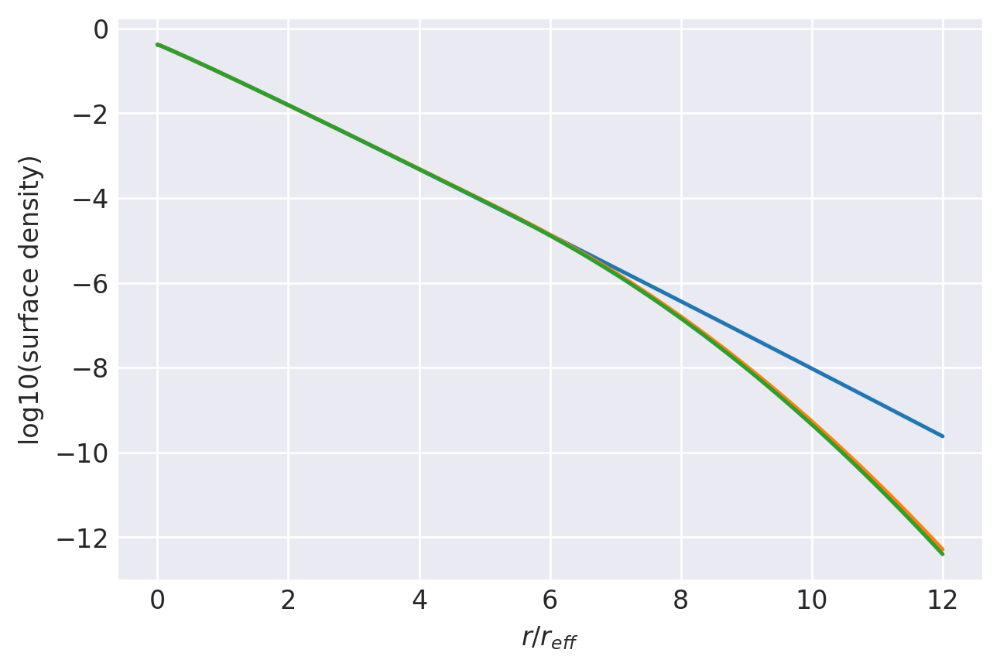

n=0.96: (
    normalize(np.array([8.0576453325e-02, 3.2290280030e-01, 3.4043969613e-01, 1.7709543098e-01, 6.0518663358e-02, 1.5295811356e-02, 2.8452778659e-03, 3.2586667691e-04])),
    np.array([2.0807024304e+00, 1.4388256059e+00, 9.8071976898e-01, 6.4685562505e-01, 4.0752304916e-01, 2.4056824190e-01, 1.2805531444e-01, 5.5198631668e-02]),
),
1.0000000187578688 1.0000000268654716
prev.  chisq = -9.098197918508665
ws, re: (array([8.05764533e-02, 3.22902800e-01, 3.40439696e-01, 1.77095431e-01,
       6.05186634e-02, 1.52958114e-02, 2.84527787e-03, 3.25866677e-04]), array([2.08070243, 1.43882561, 0.98071977, 0.64685563, 0.40752305,
       0.24056824, 0.12805531, 0.05519863]))
         Current function value: -11.131580
         Iterations: 33
         Function evaluations: 2170
         Gradient evaluations: 127
-11.131580038586463 [-2.42828675 -0.60579192  0.29268838  0.81409483  1.19195552  1.57717286
  2.16985861  0.31580255  0.15647728 -0.00936014 -0.18963252 -0.38991212
 -0.61848089 -

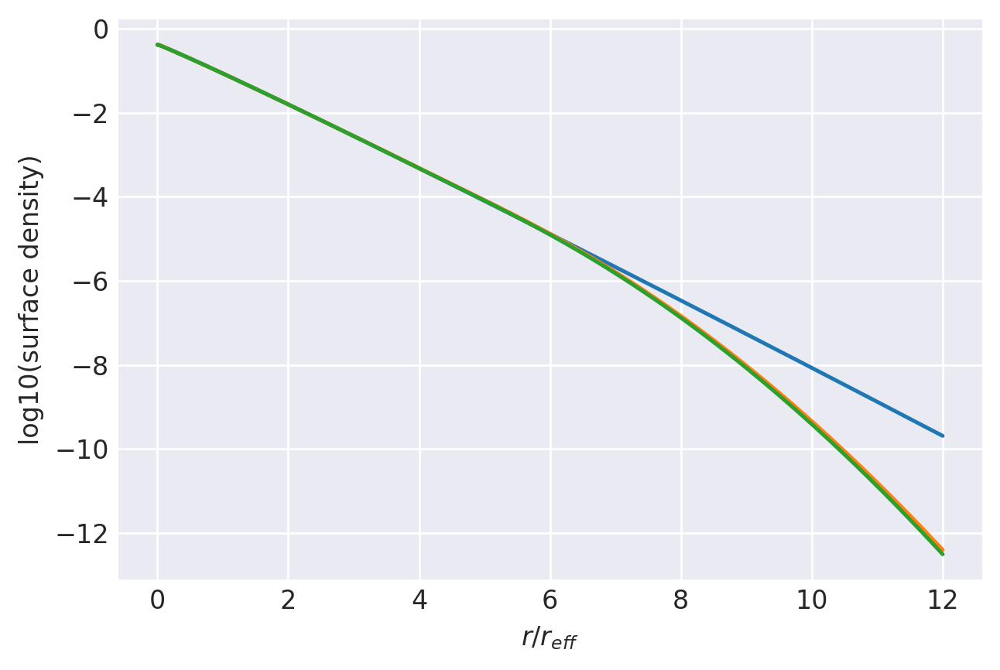

n=0.955: (
    normalize(np.array([8.1040966768e-02, 3.2441065469e-01, 3.4047060583e-01, 1.7607117085e-01, 5.9838132967e-02, 1.5058095207e-02, 2.7915913744e-03, 3.1878231861e-04])),
    np.array([2.0692003931e+00, 1.4337627137e+00, 9.7867808047e-01, 6.4620077939e-01, 4.0746271722e-01, 2.4072384138e-01, 1.2824200177e-01, 5.5335703966e-02]),
),
1.0000000199734806 1.0000000266798026
prev.  chisq = -9.094011485824725
ws, re: (array([8.10409668e-02, 3.24410655e-01, 3.40470606e-01, 1.76071171e-01,
       5.98381330e-02, 1.50580952e-02, 2.79159137e-03, 3.18782319e-04]), array([2.06920039, 1.43376271, 0.97867808, 0.64620078, 0.40746272,
       0.24072384, 0.128242  , 0.0553357 ]))
         Current function value: -11.155314
         Iterations: 36
         Function evaluations: 2069
         Gradient evaluations: 121
-11.155313881284531 [-2.42280348 -0.5982304   0.30047885  0.82073382  1.19703641  1.58101362
  2.17312395  0.31342707  0.1549982  -0.01020124 -0.19000346 -0.3899095
 -0.61814701 -

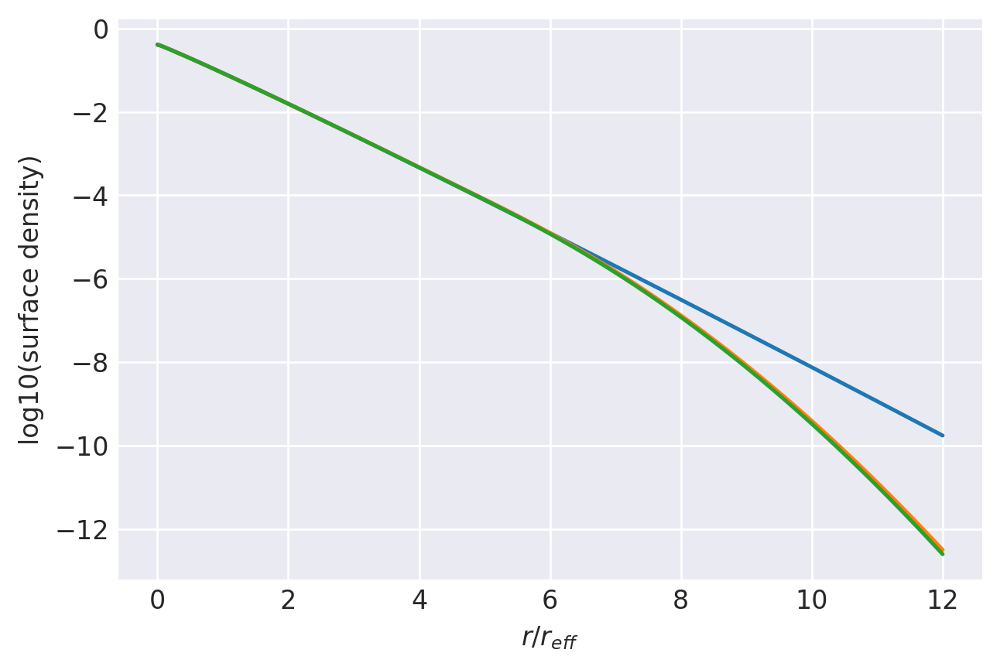

n=0.95: (
    normalize(np.array([8.1450263763e-02, 3.2585428363e-01, 3.4053884485e-01, 1.7509555332e-01, 5.9182670718e-02, 1.4827402200e-02, 2.7392015200e-03, 3.1177999432e-04])),
    np.array([2.0579132805e+00, 1.4288880244e+00, 9.7678450884e-01, 6.4564909129e-01, 4.0746517450e-01, 2.4090898319e-01, 1.2843833062e-01, 5.5469238331e-02]),
),
1.0000000209766844 1.0000000264952296
prev.  chisq = -9.089793455428488
ws, re: (array([8.14502638e-02, 3.25854284e-01, 3.40538845e-01, 1.75095553e-01,
       5.91826707e-02, 1.48274022e-02, 2.73920152e-03, 3.11779994e-04]), array([2.05791328, 1.42888802, 0.97678451, 0.64564909, 0.40746517,
       0.24090898, 0.12843833, 0.05546924]))
         Current function value: -11.179742
         Iterations: 32
         Function evaluations: 2358
         Gradient evaluations: 138
-11.179742296730915 [-2.43100911 -0.60013655  0.30207916  0.82398455  1.20061603  1.5839859
  2.17546421  0.31170443  0.15448175 -0.00978032 -0.18887797 -0.38826947
 -0.61609232 -0

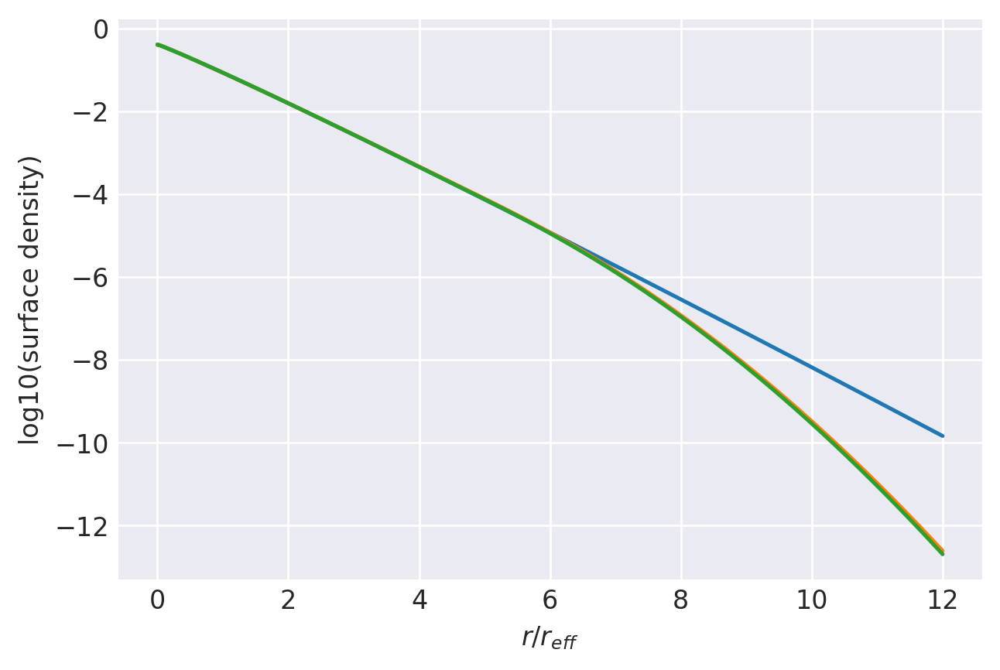

n=0.945: (
    normalize(np.array([8.0838455136e-02, 3.2567038291e-01, 3.4122816179e-01, 1.7534334294e-01, 5.9123091044e-02, 1.4767026054e-02, 2.7206010931e-03, 3.0893902196e-04])),
    np.array([2.0497666873e+00, 1.4271898496e+00, 9.7773166817e-01, 6.4732448277e-01, 4.0900680557e-01, 2.4205144694e-01, 1.2917105921e-01, 5.5858036130e-02]),
),
1.0000000217960912 1.0000000263078044
prev.  chisq = -9.085461823601229
ws, re: (array([8.08384551e-02, 3.25670383e-01, 3.41228162e-01, 1.75343343e-01,
       5.91230910e-02, 1.47670261e-02, 2.72060109e-03, 3.08939022e-04]), array([2.04976669, 1.42718985, 0.97773167, 0.64732448, 0.40900681,
       0.24205145, 0.12917106, 0.05585804]))
         Current function value: -11.204047
         Iterations: 32
         Function evaluations: 2426
         Gradient evaluations: 142
-11.204047092273555 [-2.42848133 -0.59320125  0.31036072  0.83113987  1.20583582  1.58821367
  2.17961914  0.30947034  0.15314306 -0.01052753 -0.18921251 -0.38825692
 -0.6157611  

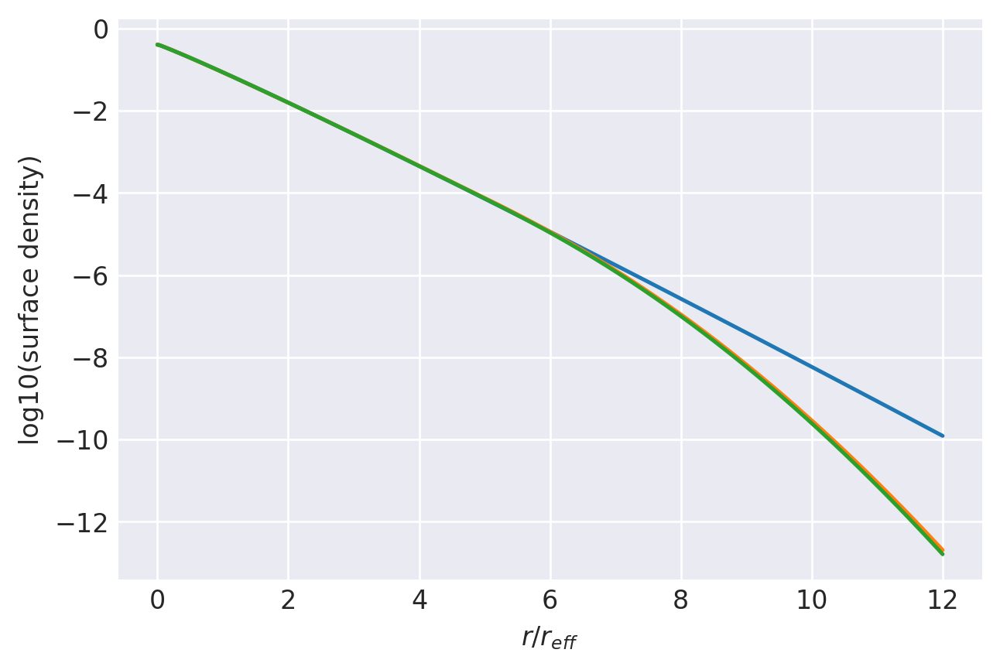

n=0.94: (
    normalize(np.array([8.1026477351e-02, 3.2706329786e-01, 3.4151639944e-01, 1.7442331104e-01, 5.8463968941e-02, 1.4536816076e-02, 2.6680176172e-03, 3.0171168430e-04])),
    np.array([2.0392493702e+00, 1.4227973744e+00, 9.7605089889e-01, 6.4682602711e-01, 4.0901861837e-01, 2.4223611781e-01, 1.2935204729e-01, 5.5949712693e-02]),
),
1.0000000224570316 1.000000026126705
prev.  chisq = -9.081245200170901
ws, re: (array([8.10264774e-02, 3.27063298e-01, 3.41516399e-01, 1.74423311e-01,
       5.84639689e-02, 1.45368161e-02, 2.66801762e-03, 3.01711684e-04]), array([2.03924937, 1.42279737, 0.9760509 , 0.64682603, 0.40901862,
       0.24223612, 0.12935205, 0.05594971]))
         Current function value: -11.228171
         Iterations: 33
         Function evaluations: 2171
         Gradient evaluations: 127
-11.228170731619887 [-2.40741786 -0.57582209  0.32399921  0.84081972  1.21223776  1.59229392
  2.18244532  0.30631122  0.15062726 -0.01262299 -0.19099766 -0.38976729
 -0.61698097 -0

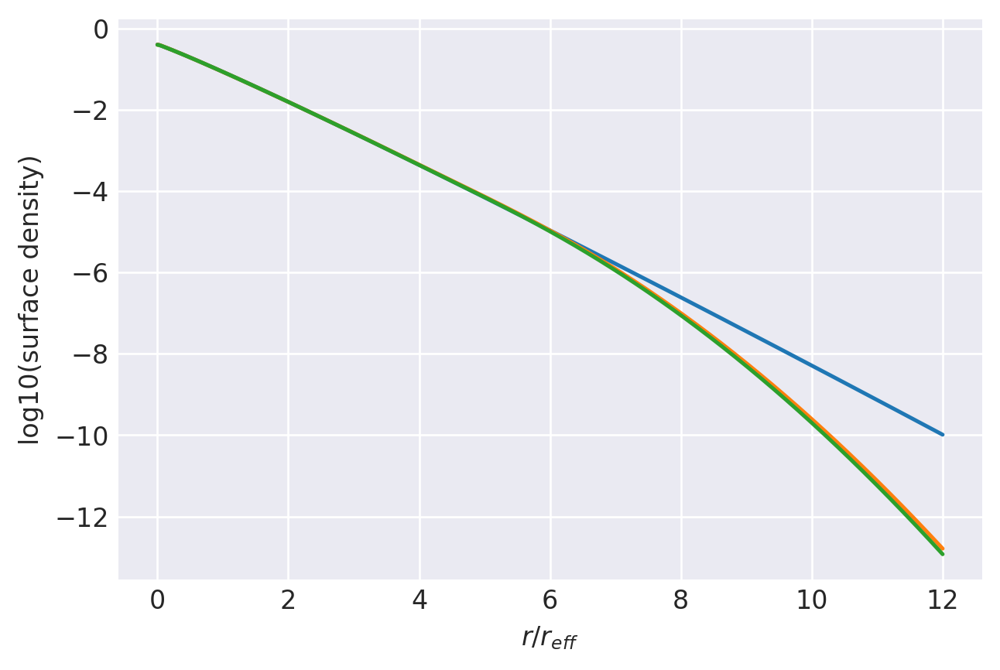

n=0.935: (
    normalize(np.array([8.2608793996e-02, 3.3016404617e-01, 3.4076708635e-01, 1.7218633093e-01, 5.7242376406e-02, 1.4152019485e-02, 2.5875593775e-03, 2.9178728688e-04])),
    np.array([2.0244694038e+00, 1.4145791883e+00, 9.7135282044e-01, 6.4417273119e-01, 4.0759862723e-01, 2.4155666697e-01, 1.2909300116e-01, 5.5910480934e-02]),
),
1.0000000229818575 1.0000000259470125
prev.  chisq = -9.076887863163773
ws, re: (array([8.26087940e-02, 3.30164046e-01, 3.40767086e-01, 1.72186331e-01,
       5.72423764e-02, 1.41520195e-02, 2.58755938e-03, 2.91787287e-04]), array([2.0244694 , 1.41457919, 0.97135282, 0.64417273, 0.40759863,
       0.24155667, 0.129093  , 0.05591048]))
         Current function value: -11.252904
         Iterations: 38
         Function evaluations: 2289
         Gradient evaluations: 134
-11.252904417945489 [-2.39970492 -0.56677533  0.33269043  0.8478998   1.2174525   1.59615292
  2.18561865  0.30379871  0.14900443 -0.01361057 -0.19151506 -0.38990663
 -0.61677975 

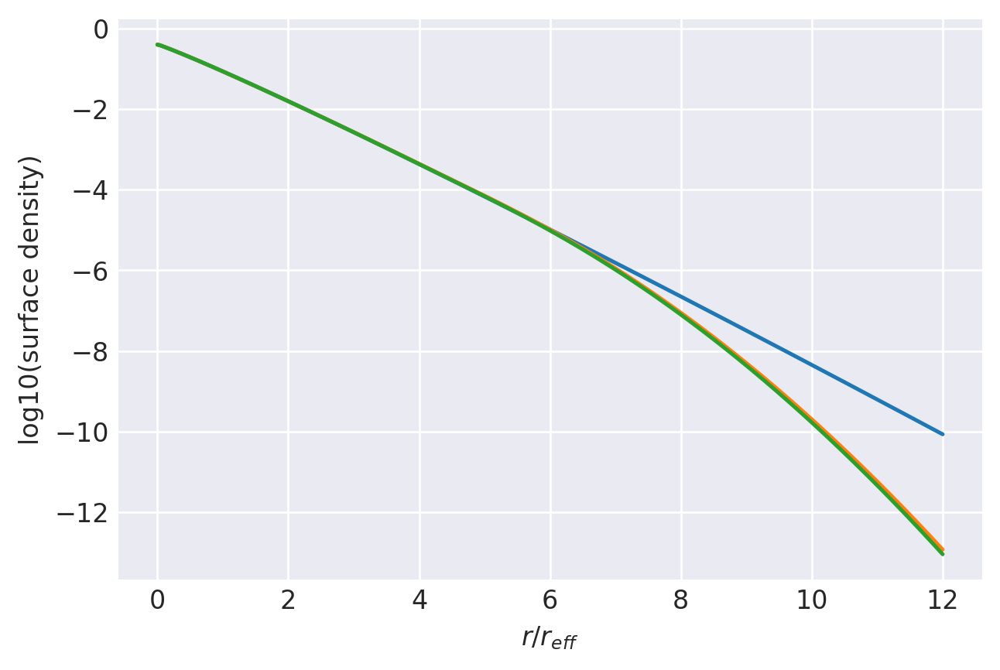

n=0.9299999999999999: (
    normalize(np.array([8.3195200740e-02, 3.3186613072e-01, 3.4067638530e-01, 1.7101447113e-01, 5.6519105162e-02, 1.3909585516e-02, 2.5342509203e-03, 2.8487050914e-04])),
    np.array([2.0127911244e+00, 1.4093031664e+00, 9.6914649332e-01, 6.4340574832e-01, 4.0746787463e-01, 2.4166861403e-01, 1.2925452558e-01, 5.6035845282e-02]),
),
1.0000000233902284 1.0000000257666501
prev.  chisq = -9.072501638033655
ws, re: (array([8.31952007e-02, 3.31866131e-01, 3.40676385e-01, 1.71014471e-01,
       5.65191052e-02, 1.39095855e-02, 2.53425092e-03, 2.84870509e-04]), array([2.01279112, 1.40930317, 0.96914649, 0.64340575, 0.40746787,
       0.24166861, 0.12925453, 0.05603585]))
         Current function value: -11.277990
         Iterations: 39
         Function evaluations: 2443
         Gradient evaluations: 143
-11.277989615273885 [-2.39343913 -0.55854869  0.34097379  0.85479083  1.22263274  1.59994879
  2.18870489  0.30134946  0.14747705 -0.01447943 -0.1918981  -0.38990451


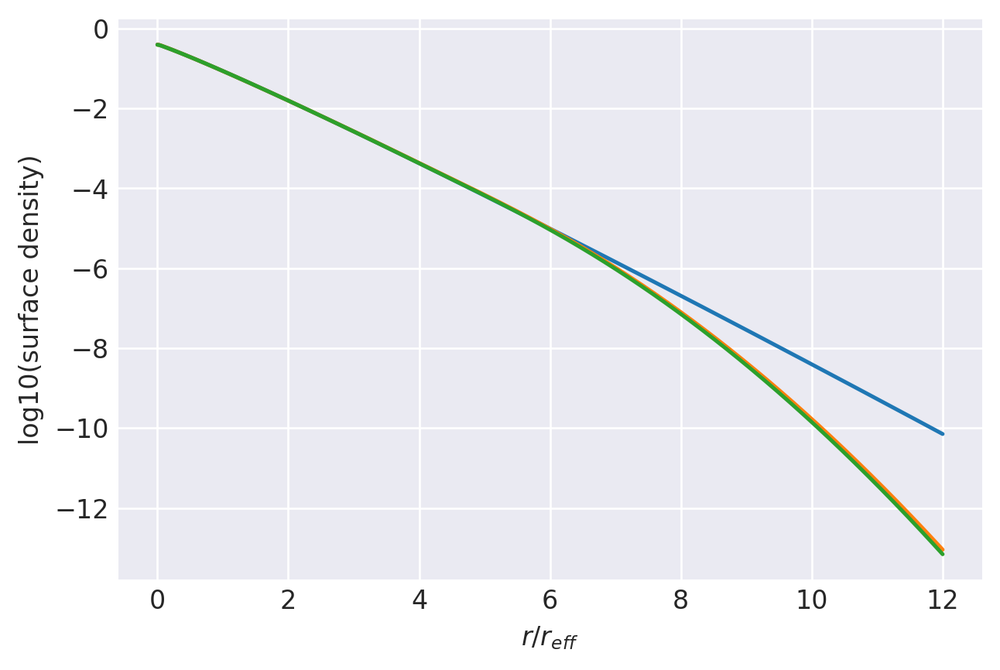

n=0.925: (
    normalize(np.array([8.3674366070e-02, 3.3343562431e-01, 3.4065668849e-01, 1.6994391231e-01, 5.5845486169e-02, 1.3681528262e-02, 2.4840295930e-03, 2.7836479423e-04])),
    np.array([2.0014717439e+00, 1.4043554573e+00, 9.6720954231e-01, 6.4283853473e-01, 4.0746985897e-01, 2.4185994865e-01, 1.2946278551e-01, 5.6177545404e-02]),
),
1.000000023699371 1.0000000255874248
prev.  chisq = -9.068083220417078
ws, re: (array([8.36743661e-02, 3.33435624e-01, 3.40656688e-01, 1.69943912e-01,
       5.58454862e-02, 1.36815283e-02, 2.48402959e-03, 2.78364794e-04]), array([2.00147174, 1.40435546, 0.96720954, 0.64283853, 0.40746986,
       0.24185995, 0.12946279, 0.05617755]))
         Current function value: -11.303340
         Iterations: 39
         Function evaluations: 2256
         Gradient evaluations: 132
-11.303339573754654 [-2.38705485 -0.54996568  0.34979771  0.86221404  1.22811167  1.60391298
  2.191907    0.29888992  0.14593298 -0.01538728 -0.19235717 -0.39001249
 -0.61622067 -

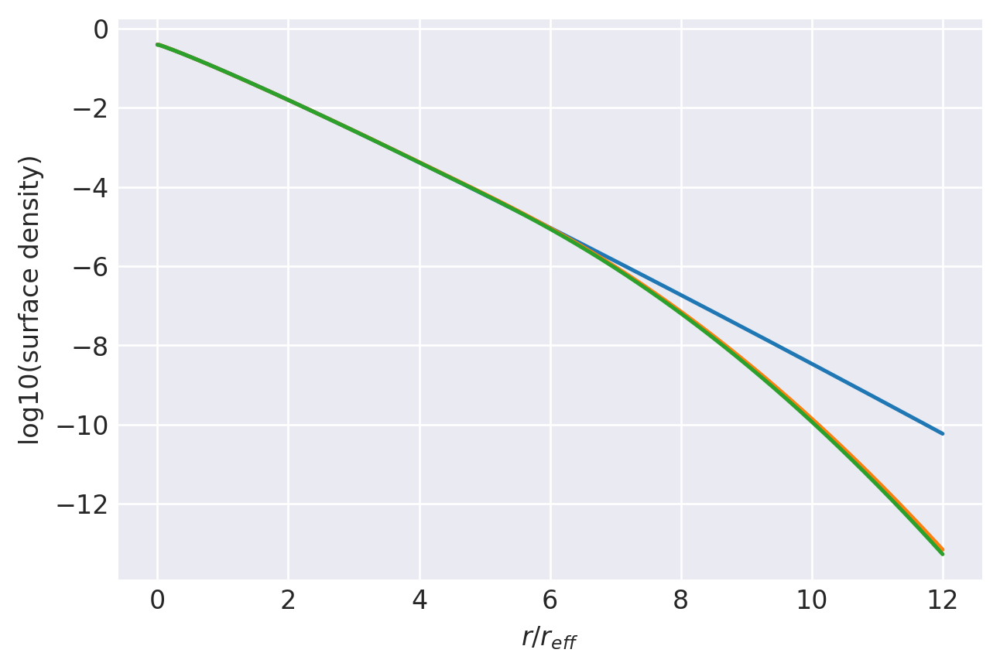

n=0.92: (
    normalize(np.array([8.4165170299e-02, 3.3507866152e-01, 3.4065328789e-01, 1.6882186325e-01, 5.5135004238e-02, 1.3442598166e-02, 2.4317766077e-03, 2.7163802453e-04])),
    np.array([1.9901688387e+00, 1.3993713671e+00, 9.6518979512e-01, 6.4215937706e-01, 4.0736856138e-01, 2.4197991939e-01, 1.2962814970e-01, 5.6303836333e-02]),
),
1.0000000239243276 1.0000000254093548
prev.  chisq = -9.063669543437847
ws, re: (array([8.41651703e-02, 3.35078662e-01, 3.40653288e-01, 1.68821863e-01,
       5.51350042e-02, 1.34425982e-02, 2.43177661e-03, 2.71638025e-04]), array([1.99016884, 1.39937137, 0.9651898 , 0.64215938, 0.40736856,
       0.24197992, 0.12962815, 0.05630384]))
         Current function value: -11.328988
         Iterations: 40
         Function evaluations: 2409
         Gradient evaluations: 141
-11.328988253308275 [-2.38032193 -0.54131072  0.35849173  0.86943661  1.23343276  1.60774911
  2.19499674  0.29640449  0.14437527 -0.01628803 -0.19278324 -0.3900648
 -0.61593238 -0

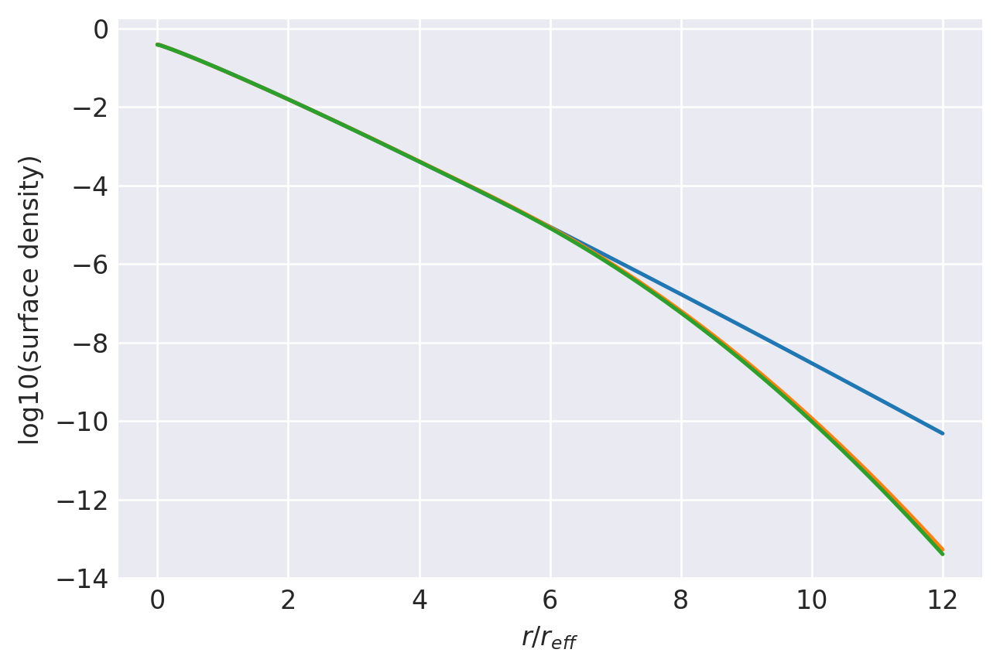

n=0.915: (
    normalize(np.array([8.4685608679e-02, 3.3672835499e-01, 3.4059929447e-01, 1.6769223015e-01, 5.4437392947e-02, 1.3210544167e-02, 2.3813860072e-03, 2.6518858475e-04])),
    np.array([1.9788118069e+00, 1.3943611333e+00, 9.6319000742e-01, 6.4152969589e-01, 4.0731950121e-01, 2.4214060131e-01, 1.2982060137e-01, 5.6443069751e-02]),
),
1.000000024078186 1.0000000252323553
prev.  chisq = -9.059181144811399
ws, re: (array([8.46856087e-02, 3.36728355e-01, 3.40599294e-01, 1.67692230e-01,
       5.44373929e-02, 1.32105442e-02, 2.38138601e-03, 2.65188585e-04]), array([1.97881181, 1.39436113, 0.96319001, 0.6415297 , 0.4073195 ,
       0.2421406 , 0.1298206 , 0.05644307]))
         Current function value: -11.355373
         Iterations: 35
         Function evaluations: 2188
         Gradient evaluations: 128
-11.355372996771438 [-2.3809131  -0.53767461  0.36408476  0.87524761  1.23877439  1.61182703
  2.19764446  0.29424459  0.14331286 -0.01653578 -0.19244547 -0.38932121
 -0.61489168 -

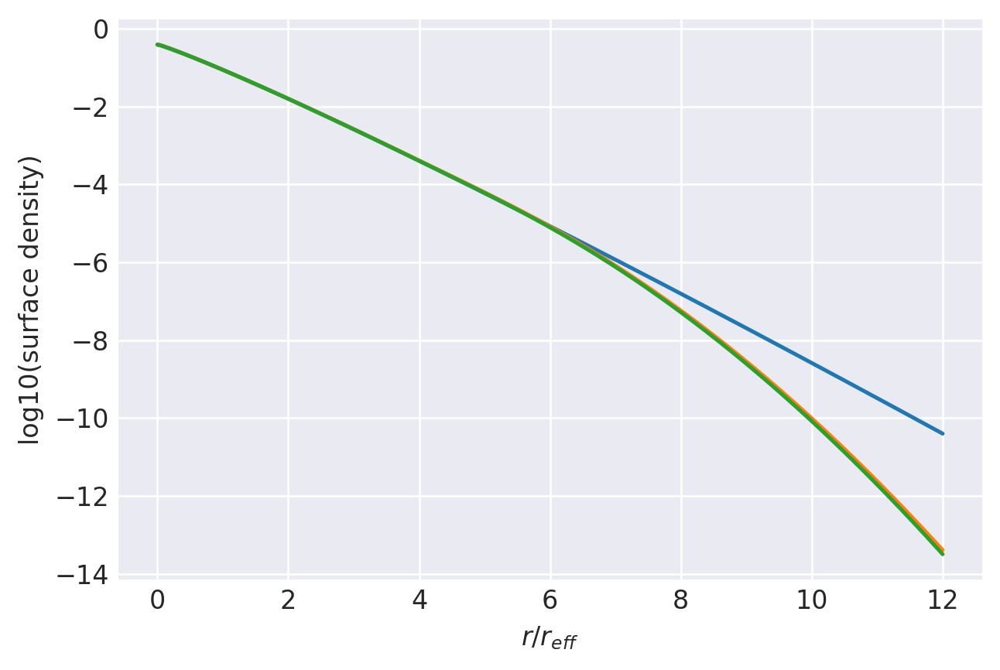

n=0.91: (
    normalize(np.array([8.4639795367e-02, 3.3751957246e-01, 3.4094265997e-01, 1.6721122181e-01, 5.4031664252e-02, 1.3051095694e-02, 2.3436897899e-03, 2.6030065902e-04])),
    np.array([1.9689949080e+00, 1.3909543026e+00, 9.6264069091e-01, 6.4202882897e-01, 4.0801749857e-01, 2.4272153789e-01, 1.3023886593e-01, 5.6700605787e-02]),
),
1.0000000241722848 1.0000000250549903
prev.  chisq = -9.05457269094394
ws, re: (array([8.46397954e-02, 3.37519572e-01, 3.40942660e-01, 1.67211222e-01,
       5.40316643e-02, 1.30510957e-02, 2.34368979e-03, 2.60300659e-04]), array([1.96899491, 1.3909543 , 0.96264069, 0.64202883, 0.4080175 ,
       0.24272154, 0.13023887, 0.05670061]))
         Current function value: -11.381844
         Iterations: 35
         Function evaluations: 2188
         Gradient evaluations: 128
-11.38184358650735 [-2.37778393 -0.5313307   0.37137654  0.88157335  1.24324029  1.61542112
  2.20122499  0.29190697  0.14199094 -0.0171169  -0.19248197 -0.38891091
 -0.61406577 -0.

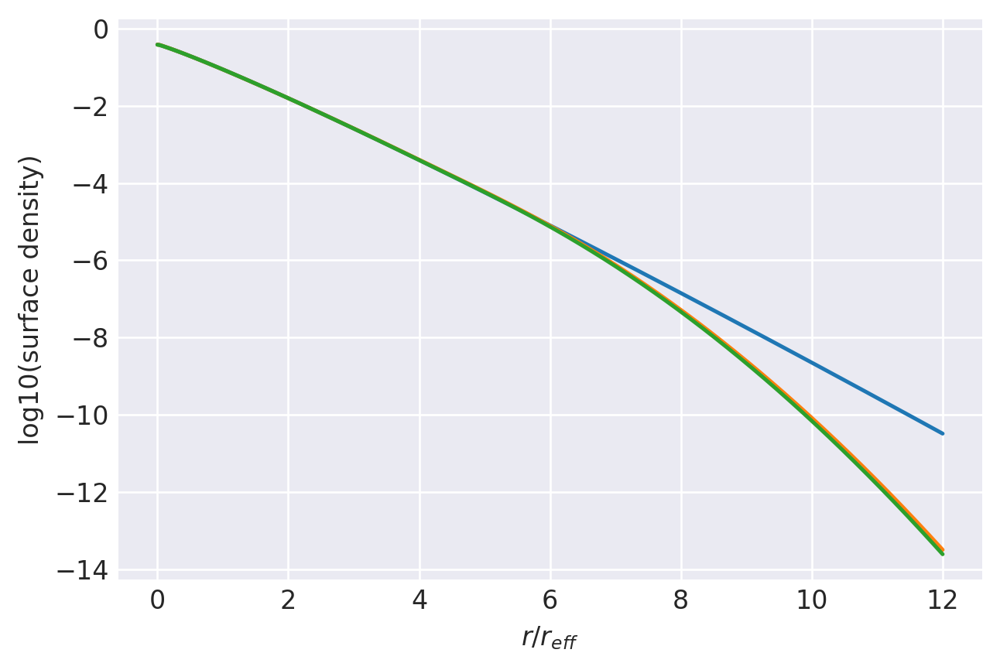

n=0.905: (
    normalize(np.array([8.4882545997e-02, 3.3878250060e-01, 3.4107015969e-01, 1.6636706402e-01, 5.3473424762e-02, 1.2866379497e-02, 2.3030523605e-03, 2.5487306717e-04])),
    np.array([1.9584251136e+00, 1.3867269131e+00, 9.6135347483e-01, 6.4197487051e-01, 4.0840315874e-01, 2.4318356990e-01, 1.3059144846e-01, 5.6891288900e-02]),
),
1.0000000242164144 1.0000000248803158
prev.  chisq = -9.050220838922645
ws, re: (array([8.48825460e-02, 3.38782501e-01, 3.41070160e-01, 1.66367064e-01,
       5.34734248e-02, 1.28663795e-02, 2.30305236e-03, 2.54873067e-04]), array([1.95842511, 1.38672691, 0.96135347, 0.64197487, 0.40840316,
       0.24318357, 0.13059145, 0.05689129]))
         Current function value: -11.408332
         Iterations: 34
         Function evaluations: 2358
         Gradient evaluations: 138
-11.408331965529769 [-2.36726083 -0.52114209  0.38029982  0.88888783  1.24906014  1.6189666
  2.20384114  0.28921237  0.14023105 -0.0181681  -0.19300413 -0.38906154
 -0.61390307 -

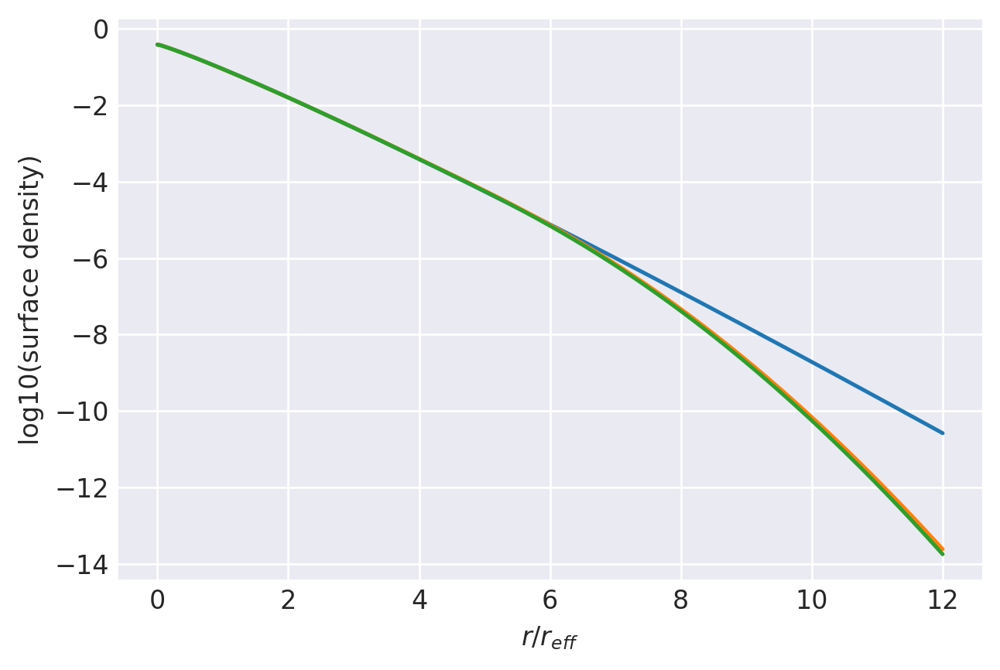

n=0.9: (
    normalize(np.array([8.5703533382e-02, 3.4065334348e-01, 3.4071270247e-01, 1.6506861300e-01, 5.2737930095e-02, 1.2623183173e-02, 2.2521101669e-03, 2.4858423528e-04])),
    np.array([1.9463115926e+00, 1.3811188552e+00, 9.5902935245e-01, 6.4120347915e-01, 4.0826152697e-01, 2.4327469001e-01, 1.3077386669e-01, 5.7023439004e-02]),
),
1.0000000242189875 1.0000000247072458
prev.  chisq = -9.045485728372672
ws, re: (array([8.57035334e-02, 3.40653343e-01, 3.40712702e-01, 1.65068613e-01,
       5.27379301e-02, 1.26231832e-02, 2.25211017e-03, 2.48584235e-04]), array([1.94631159, 1.38111886, 0.95902935, 0.64120348, 0.40826153,
       0.24327469, 0.13077387, 0.05702344]))
         Current function value: -11.435647
         Iterations: 34
         Function evaluations: 2035
         Gradient evaluations: 119
-11.435647487349963 [-2.37039639 -0.51743697  0.38691677  0.89511453  1.25344339  1.6228949
  2.2065627   0.28715371  0.13925434 -0.01839609 -0.1927003  -0.38831157
 -0.61273344 -0.

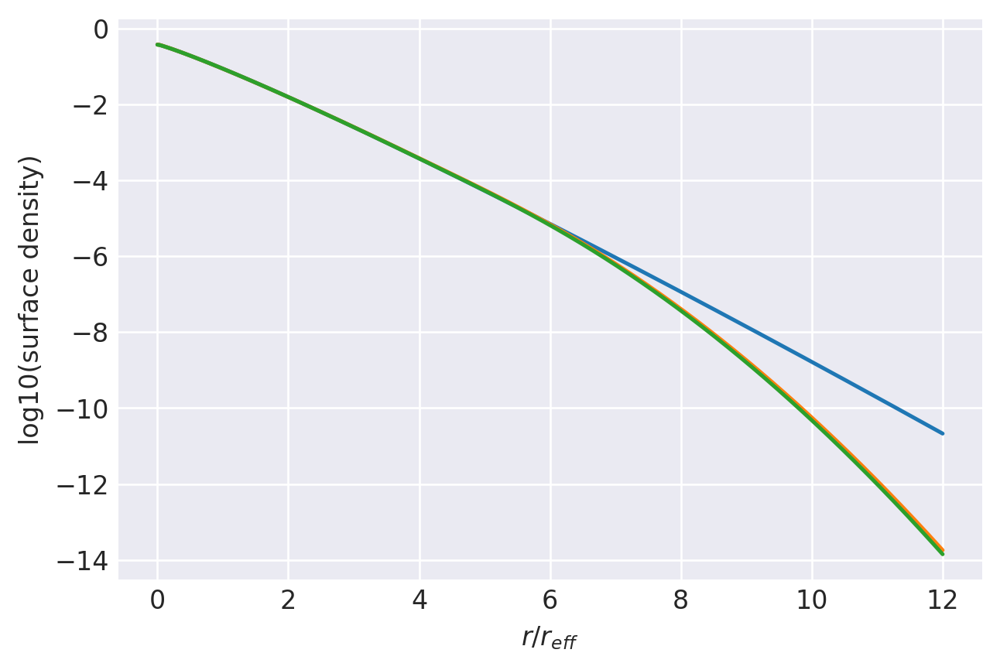

n=0.895: (
    normalize(np.array([8.5458154254e-02, 3.4153725291e-01, 3.4124730054e-01, 1.6453481556e-01, 5.2292052730e-02, 1.2469800331e-02, 2.2166215828e-03, 2.4400209405e-04])),
    np.array([1.9371074385e+00, 1.3780162566e+00, 9.5852602244e-01, 6.4165221702e-01, 4.0896715012e-01, 2.4393075545e-01, 1.3122716473e-01, 5.7305327980e-02]),
),
1.0000000241872056 1.0000000245331448
prev.  chisq = -9.041104743523542
ws, re: (array([8.54581543e-02, 3.41537253e-01, 3.41247301e-01, 1.64534816e-01,
       5.22920527e-02, 1.24698003e-02, 2.21662158e-03, 2.44002094e-04]), array([1.93710744, 1.37801626, 0.95852602, 0.64165222, 0.40896715,
       0.24393076, 0.13122716, 0.05730533]))
         Current function value: -11.462775
         Iterations: 33
         Function evaluations: 2222
         Gradient evaluations: 130
-11.462775266859705 [-2.35842056 -0.50640484  0.39660338  0.90284203  1.25828338  1.62594157
  2.20950386  0.2843715   0.13741611 -0.01953549 -0.19333943 -0.38854498
 -0.61252446 

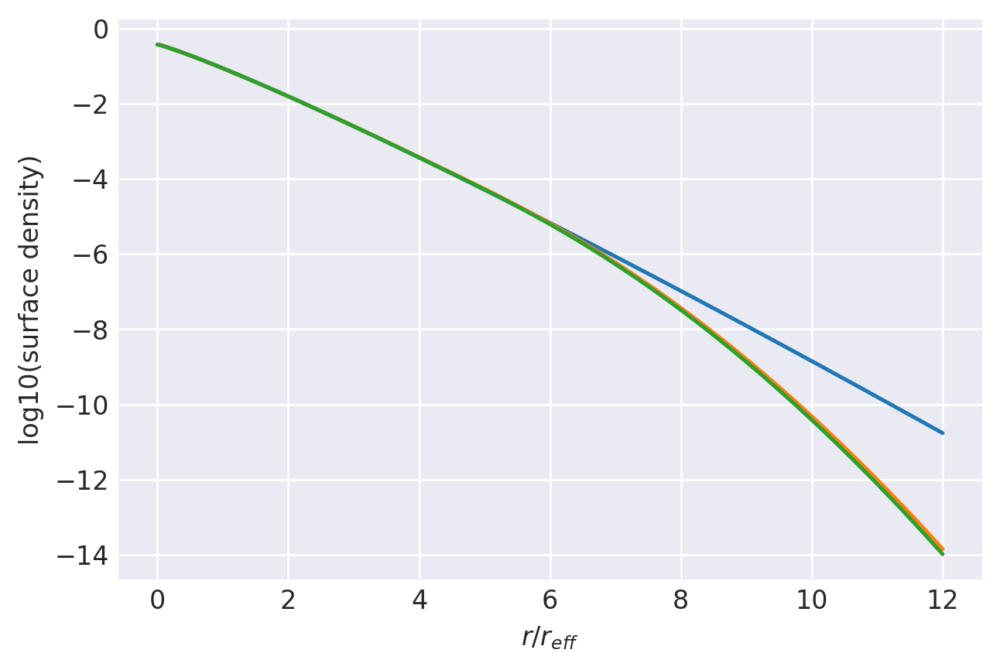

n=0.89: (
    normalize(np.array([8.6398784406e-02, 3.4354757875e-01, 3.4081871559e-01, 1.6310825490e-01, 5.1494849325e-02, 1.2226535299e-02, 2.1673987021e-03, 2.3788303682e-04])),
    np.array([1.9247374598e+00, 1.3721958904e+00, 9.5601456385e-01, 6.4070862543e-01, 4.0874741589e-01, 2.4404815862e-01, 1.3142123383e-01, 5.7439206885e-02]),
),
1.0000000241272065 1.0000000243625309
prev.  chisq = -9.036314566690912
ws, re: (array([8.63987844e-02, 3.43547579e-01, 3.40818716e-01, 1.63108255e-01,
       5.14948493e-02, 1.22265353e-02, 2.16739870e-03, 2.37883037e-04]), array([1.92473746, 1.37219589, 0.95601456, 0.64070863, 0.40874742,
       0.24404816, 0.13142123, 0.05743921]))
         Current function value: -11.489543
         Iterations: 32
         Function evaluations: 2273
         Gradient evaluations: 133
-11.48954269435497 [-2.33724484 -0.48792378  0.41077293  0.91190192  1.26489789  1.63142221
  2.21397136  0.28120375  0.13493342 -0.02156441 -0.19497645 -0.38982677
 -0.61359088 -0

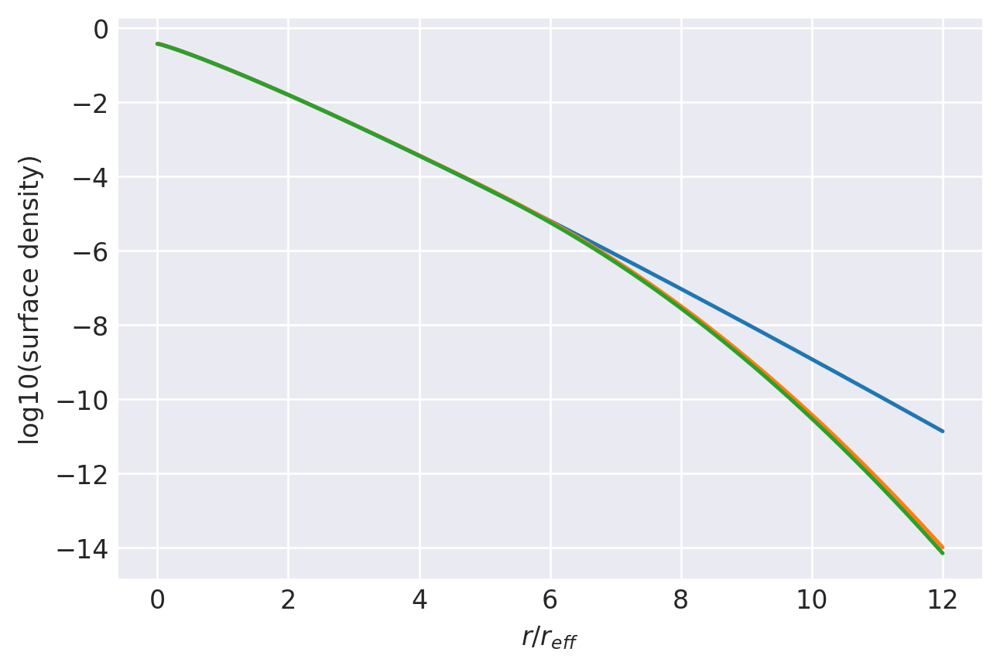

n=0.885: (
    normalize(np.array([8.8084974452e-02, 3.4687678583e-01, 3.3974234955e-01, 1.6072365430e-01, 5.0357826877e-02, 1.1888425292e-02, 2.0968676722e-03, 2.2911603232e-04])),
    np.array([1.9107495015e+00, 1.3643739615e+00, 9.5155870963e-01, 6.3829809118e-01, 4.0754280841e-01, 2.4344962793e-01, 1.3115645104e-01, 5.7368724912e-02]),
),
1.000000024044195 1.0000000241945246
prev.  chisq = -9.031645526468989
ws, re: (array([8.80849745e-02, 3.46876786e-01, 3.39742350e-01, 1.60723654e-01,
       5.03578269e-02, 1.18884253e-02, 2.09686767e-03, 2.29116032e-04]), array([1.9107495 , 1.36437396, 0.95155871, 0.63829809, 0.40754281,
       0.24344963, 0.13115645, 0.05736872]))
         Current function value: -11.517060
         Iterations: 37
         Function evaluations: 2119
         Gradient evaluations: 124
-11.517059948780505 [-2.32714168 -0.47517121  0.42404279  0.9229712   1.27228897  1.63580532
  2.21812961  0.27853236  0.13311163 -0.02291043 -0.19610856 -0.39082047
 -0.6143609  -

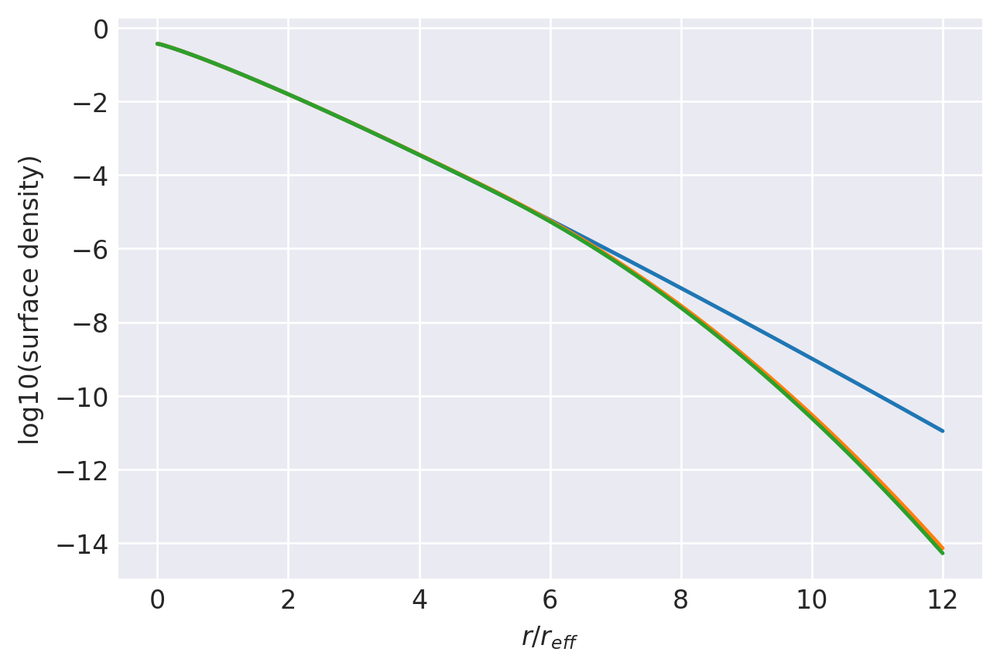

n=0.88: (
    normalize(np.array([8.8899905864e-02, 3.4930941617e-01, 3.3957451456e-01, 1.5902835784e-01, 4.9358164198e-02, 1.1574903093e-02, 2.0334713070e-03, 2.2126697580e-04])),
    np.array([1.8990323184e+00, 1.3586626362e+00, 9.4861408841e-01, 6.3663635565e-01, 4.0661138462e-01, 2.4301837033e-01, 1.3101853050e-01, 5.7351171024e-02]),
),
1.0000000239425677 1.0000000240271358
prev.  chisq = -9.026764957764563
ws, re: (array([8.88999059e-02, 3.49309416e-01, 3.39574515e-01, 1.59028358e-01,
       4.93581642e-02, 1.15749031e-02, 2.03347131e-03, 2.21266976e-04]), array([1.89903232, 1.35866264, 0.94861409, 0.63663636, 0.40661138,
       0.24301837, 0.13101853, 0.05735117]))
         Current function value: -11.545074
         Iterations: 43
         Function evaluations: 2273
         Gradient evaluations: 133
-11.545074438323276 [-2.31706433 -0.46387479  0.43463151  0.93117619  1.27793022  1.63957394
  2.22096297  0.27584217  0.13135281 -0.02402405 -0.19676509 -0.39111004
 -0.61429962 -

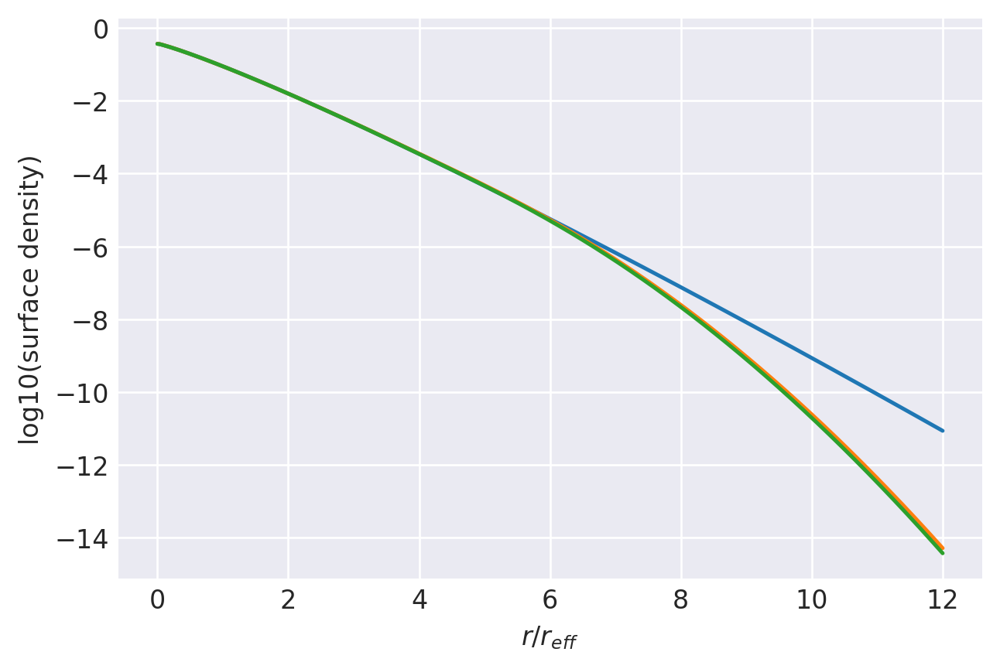

n=0.875: (
    normalize(np.array([8.9719526602e-02, 3.5142926885e-01, 3.3921099318e-01, 1.5755096538e-01, 4.8559828433e-02, 1.1330575413e-02, 1.9836112558e-03, 2.1523089106e-04])),
    np.array([1.8873053597e+00, 1.3531714076e+00, 9.4618475353e-01, 6.3567468065e-01, 4.0634035820e-01, 2.4305266056e-01, 1.3115573412e-01, 5.7474898327e-02]),
),
1.0000000238260154 1.000000023859784
prev.  chisq = -9.021975099497576
ws, re: (array([8.97195266e-02, 3.51429269e-01, 3.39210993e-01, 1.57550965e-01,
       4.85598284e-02, 1.13305754e-02, 1.98361126e-03, 2.15230891e-04]), array([1.88730536, 1.35317141, 0.94618475, 0.63567468, 0.40634036,
       0.24305266, 0.13115573, 0.0574749 ]))
         Current function value: -11.573895
         Iterations: 36
         Function evaluations: 2341
         Gradient evaluations: 137
-11.573895216595597 [-2.31151474 -0.45552468  0.44364175  0.93887921  1.28360708  1.64376136
  2.22457195  0.27333985  0.12988367 -0.02476045 -0.19699824 -0.39097092
 -0.61382844 -

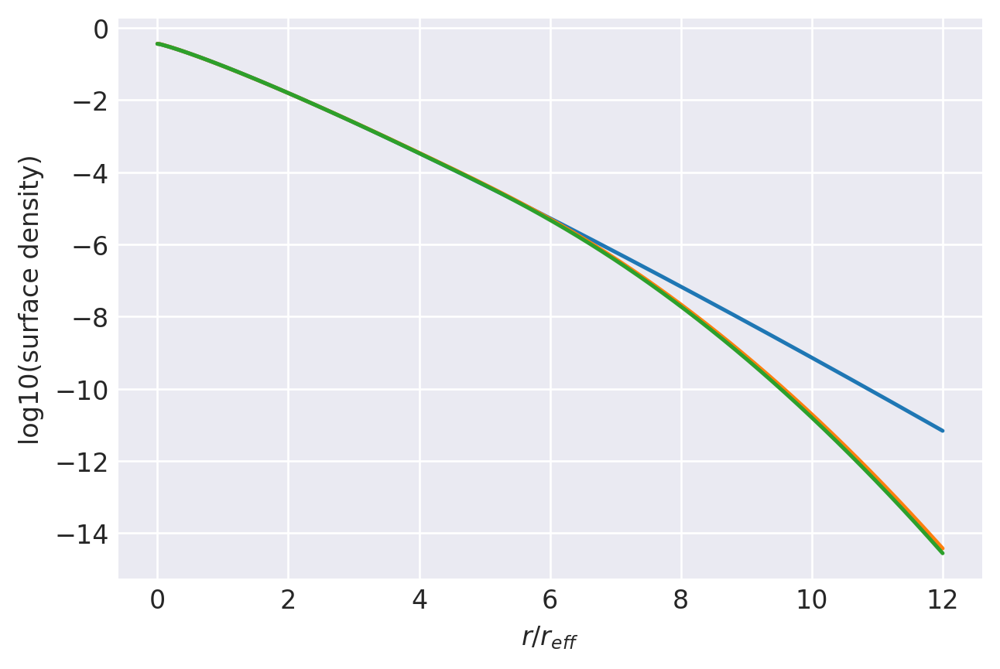

n=0.87: (
    normalize(np.array([9.0173794580e-02, 3.5305626695e-01, 3.3914329330e-01, 1.5644596456e-01, 4.7908336833e-02, 1.1122835888e-02, 1.9397900348e-03, 2.0971785200e-04])),
    np.array([1.8764623457e+00, 1.3486015892e+00, 9.4458175513e-01, 6.3533351247e-01, 4.0647054491e-01, 2.4331649981e-01, 1.3139635997e-01, 5.7635706855e-02]),
),
1.0000000236976265 1.0000000236933282
prev.  chisq = -9.017182172764546
ws, re: (array([9.01737946e-02, 3.53056267e-01, 3.39143293e-01, 1.56445965e-01,
       4.79083368e-02, 1.11228359e-02, 1.93979003e-03, 2.09717852e-04]), array([1.87646235, 1.34860159, 0.94458176, 0.63533351, 0.40647054,
       0.2433165 , 0.13139636, 0.05763571]))
         Current function value: -11.604645
         Iterations: 41
         Function evaluations: 1814
         Gradient evaluations: 106
-11.604645036518422 [-2.3617631  -0.48341813  0.4311664   0.93623731  1.28511502  1.64692367
  2.22928837  0.27319427  0.13184696 -0.02105534 -0.19202881 -0.38517495
 -0.60745183 -

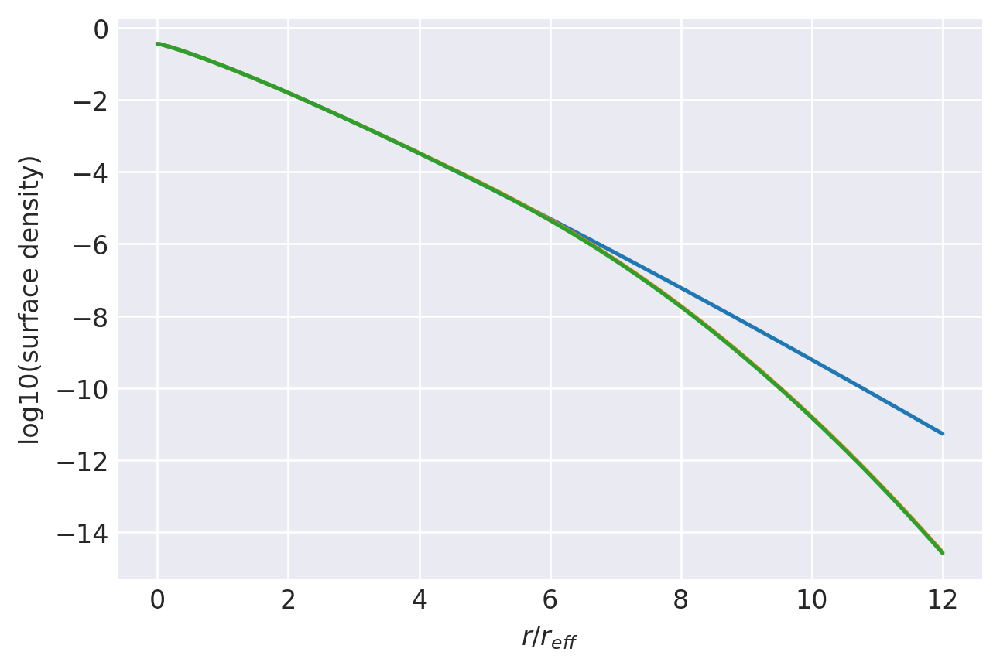

n=0.865: (
    normalize(np.array([8.6135308911e-02, 3.4858939943e-01, 3.4264283849e-01, 1.5992557051e-01, 4.9119505662e-02, 1.1392673784e-02, 1.9814855129e-03, 2.1321770362e-04])),
    np.array([1.8758334412e+00, 1.3547119339e+00, 9.5267476966e-01, 6.4264507752e-01, 4.1193154065e-01, 2.4691539506e-01, 1.3345768182e-01, 5.8584360956e-02]),
),
1.0000000235599669 1.0000000235221822
prev.  chisq = -9.012562942689286
ws, re: (array([8.61353089e-02, 3.48589399e-01, 3.42642838e-01, 1.59925571e-01,
       4.91195057e-02, 1.13926738e-02, 1.98148551e-03, 2.13217704e-04]), array([1.87583344, 1.35471193, 0.95267477, 0.64264508, 0.41193154,
       0.2469154 , 0.13345768, 0.05858436]))
         Current function value: -11.631710
         Iterations: 36
         Function evaluations: 2596
         Gradient evaluations: 152
-11.63171005411431 [-2.29072559 -0.4321667   0.46552082  0.9558258   1.29545723  1.65208373
  2.23098538  0.26789852  0.12634012 -0.02699432 -0.198317   -0.3915797
 -0.6137924  -0

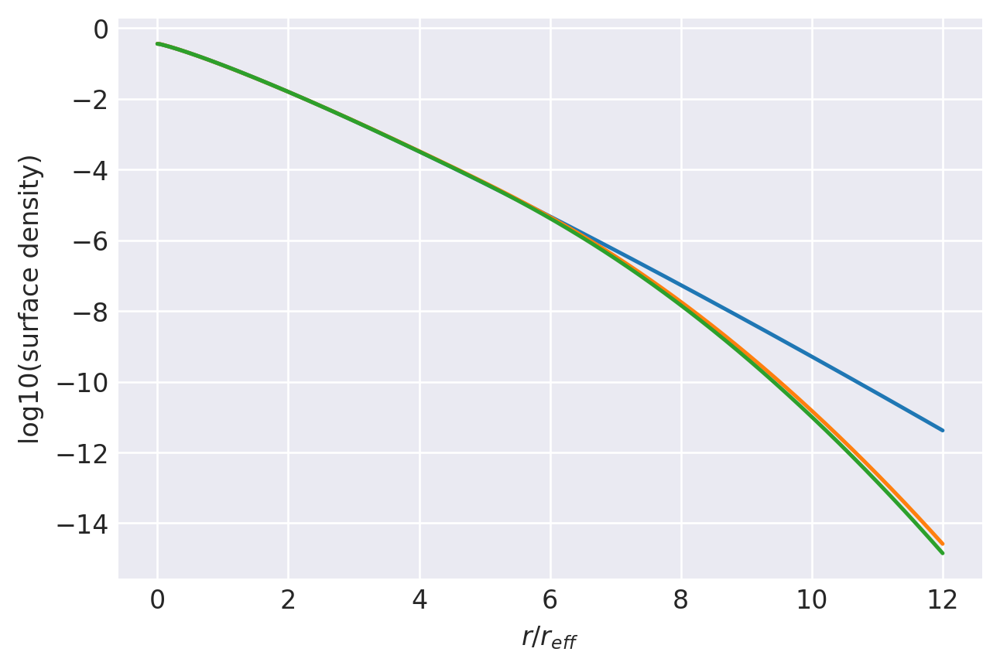

n=0.86: (
    normalize(np.array([9.1893982144e-02, 3.5743875849e-01, 3.3828758883e-01, 1.5339871037e-01, 4.6304149921e-02, 1.0638030221e-02, 1.8410136879e-03, 1.9776634136e-04])),
    np.array([1.8530985676e+00, 1.3376427022e+00, 9.3973559093e-01, 6.3340721094e-01, 4.0590116707e-01, 2.4333669448e-01, 1.3162266643e-01, 5.7855812756e-02]),
),
1.000000023415158 1.0000000233647142
prev.  chisq = -9.007458595963694
ws, re: (array([9.18939821e-02, 3.57438758e-01, 3.38287589e-01, 1.53398710e-01,
       4.63041499e-02, 1.06380302e-02, 1.84101369e-03, 1.97766341e-04]), array([1.85309857, 1.3376427 , 0.93973559, 0.63340721, 0.40590117,
       0.24333669, 0.13162267, 0.05785581]))
         Current function value: -11.660866
         Iterations: 49
         Function evaluations: 2256
         Gradient evaluations: 132
-11.660865645082955 [-2.27763451 -0.41877384  0.4775763   0.96488582  1.3013998   1.6559639
  2.23430052  0.26505252  0.1244152  -0.02829634 -0.19919686 -0.3921195
 -0.61399015 -0.8

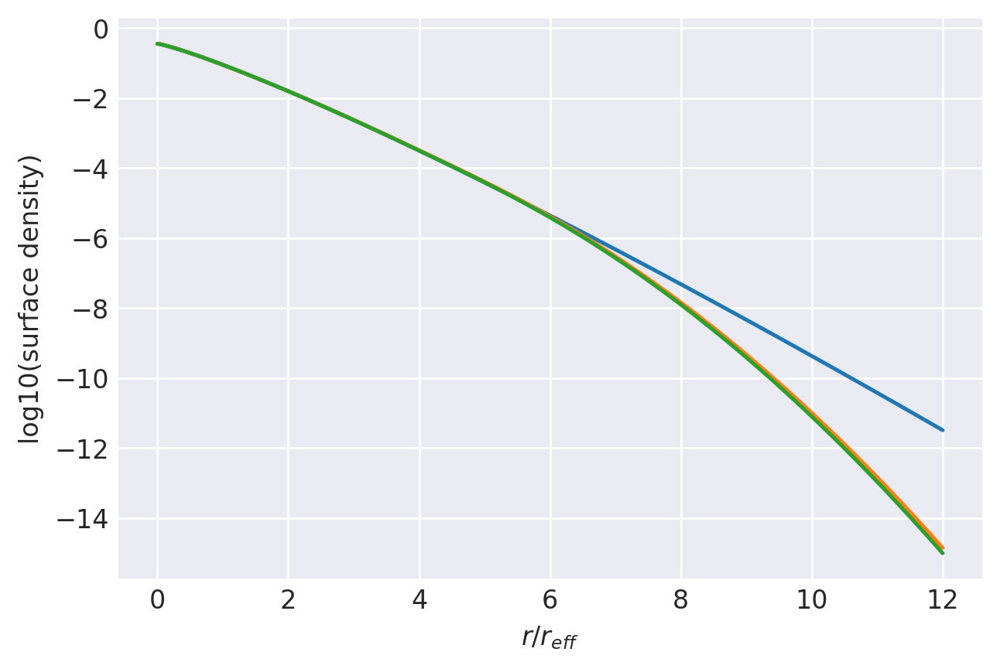

n=0.855: (
    normalize(np.array([9.2992277469e-02, 3.5990991331e-01, 3.3765530445e-01, 1.5165710017e-01, 4.5423400347e-02, 1.0380318861e-02, 1.7900320433e-03, 1.9165335213e-04])),
    np.array([1.8409946339e+00, 1.3317269709e+00, 9.3692247592e-01, 6.3212525545e-01, 4.0539697018e-01, 2.4322591877e-01, 1.3167801519e-01, 5.7938070264e-02]),
),
1.0000000232649449 1.0000000232023512
prev.  chisq = -9.002496180511976
ws, re: (array([9.29922775e-02, 3.59909913e-01, 3.37655304e-01, 1.51657100e-01,
       4.54234003e-02, 1.03803189e-02, 1.79003204e-03, 1.91653352e-04]), array([1.84099463, 1.33172697, 0.93692248, 0.63212526, 0.40539697,
       0.24322592, 0.13167802, 0.05793807]))
         Current function value: -11.691210
         Iterations: 35
         Function evaluations: 1865
         Gradient evaluations: 109
-11.691210330589094 [-2.27101818 -0.40943102  0.4873195   0.97291372  1.30711573  1.65997052
  2.23758479  0.26247311  0.1228866  -0.02908315 -0.19947444 -0.3920163
 -0.61354004 -

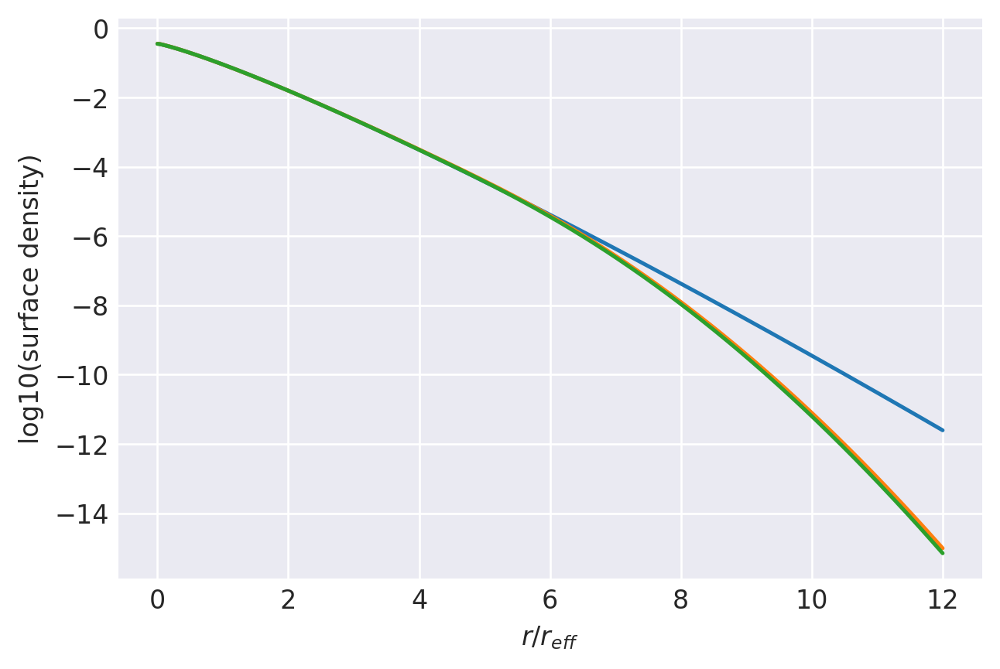

n=0.85: (
    normalize(np.array([9.3551835240e-02, 3.6171683549e-01, 3.3744731541e-01, 1.5042598438e-01, 4.4748981349e-02, 1.0174434506e-02, 1.7480670208e-03, 1.8654660696e-04])),
    np.array([1.8300927975e+00, 1.3270479040e+00, 9.3522659525e-01, 6.3172135114e-01, 4.0549331641e-01, 2.4347813221e-01, 1.3192705300e-01, 5.8109063390e-02]),
),
1.0000000231107542 1.0000000230405612
prev.  chisq = -8.997545347002598
ws, re: (array([9.35518352e-02, 3.61716835e-01, 3.37447315e-01, 1.50425984e-01,
       4.47489813e-02, 1.01744345e-02, 1.74806702e-03, 1.86546607e-04]), array([1.8300928 , 1.3270479 , 0.9352266 , 0.63172135, 0.40549332,
       0.24347813, 0.13192705, 0.05810906]))
         Current function value: -11.721029
         Iterations: 37
         Function evaluations: 1949
         Gradient evaluations: 114
-11.721028990821393 [-2.25718209 -0.39533717  0.49993642  0.98233485  1.3134138   1.66435932
  2.24114627  0.2595855   0.12092312 -0.03042971 -0.20041121 -0.39263352
 -0.61385398 -

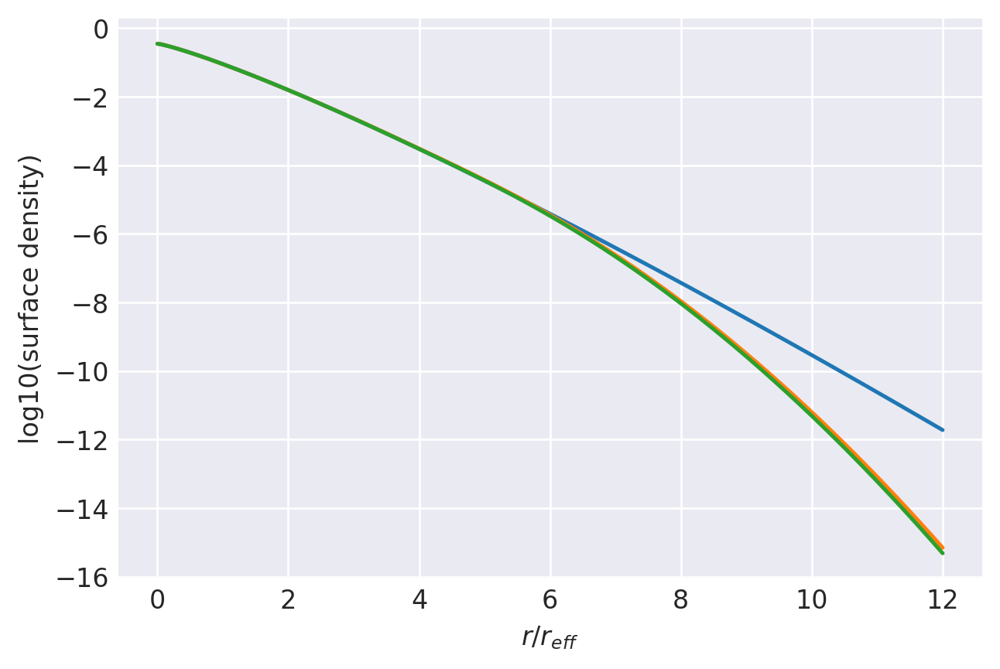

n=0.845: (
    normalize(np.array([9.4731750777e-02, 3.6430995164e-01, 3.3671645683e-01, 1.4860049245e-01, 4.3850047871e-02, 9.9143886126e-03, 1.6965107346e-03, 1.8040108880e-04])),
    np.array([1.8179649453e+00, 1.3210617641e+00, 9.3233135201e-01, 6.3036021469e-01, 4.0491744109e-01, 2.4330219140e-01, 1.3193142574e-01, 5.8170286599e-02]),
),
1.0000000229537436 1.00000002288061
prev.  chisq = -8.992558212258468
ws, re: (array([9.47317508e-02, 3.64309952e-01, 3.36716457e-01, 1.48600492e-01,
       4.38500479e-02, 9.91438861e-03, 1.69651073e-03, 1.80401089e-04]), array([1.81796495, 1.32106176, 0.93233135, 0.63036021, 0.40491744,
       0.24330219, 0.13193143, 0.05817029]))
         Current function value: -11.752948
         Iterations: 38
         Function evaluations: 1695
         Gradient evaluations: 99
-11.752948302448274 [-2.25263232 -0.38989835  0.50526567  0.98775548  1.31879278  1.668778
  2.24498408  0.25704239  0.11962525 -0.03068883 -0.19986833 -0.39157062
 -0.61245251 -0.87

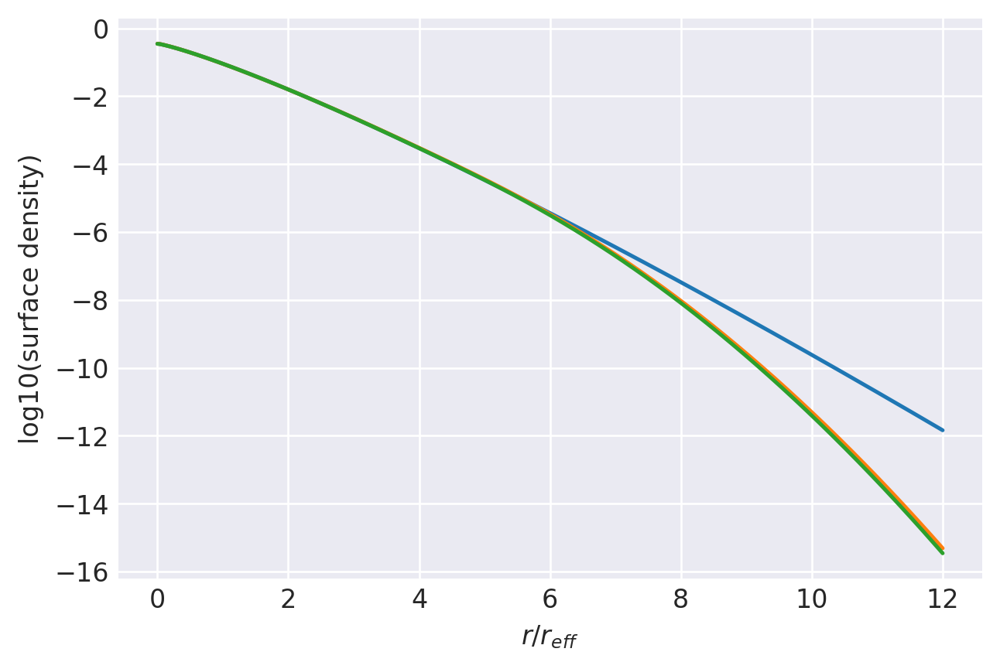

n=0.84: (
    normalize(np.array([9.5122647908e-02, 3.6533678581e-01, 3.3650928403e-01, 1.4793759852e-01, 4.3467857962e-02, 9.7821189569e-03, 1.6671110371e-03, 1.7659578290e-04])),
    np.array([1.8073505429e+00, 1.3171197157e+00, 9.3177524383e-01, 6.3114866788e-01, 4.0590965353e-01, 2.4408859743e-01, 1.3246051055e-01, 5.8456787024e-02]),
),
1.0000000227948467 1.000000022720553
prev.  chisq = -8.987544220428342
ws, re: (array([9.51226479e-02, 3.65336786e-01, 3.36509284e-01, 1.47937599e-01,
       4.34678580e-02, 9.78211896e-03, 1.66711104e-03, 1.76595783e-04]), array([1.80735054, 1.31711972, 0.93177524, 0.63114867, 0.40590965,
       0.2440886 , 0.13246051, 0.05845679]))
         Current function value: -11.784124
         Iterations: 39
         Function evaluations: 2409
         Gradient evaluations: 141
-11.784123605186874 [-2.24438641 -0.37706293  0.51859774  0.99688484  1.32361702  1.67247193
  2.24867058  0.25439692  0.11791905 -0.0318454  -0.20066465 -0.39195641
 -0.61238788 -0

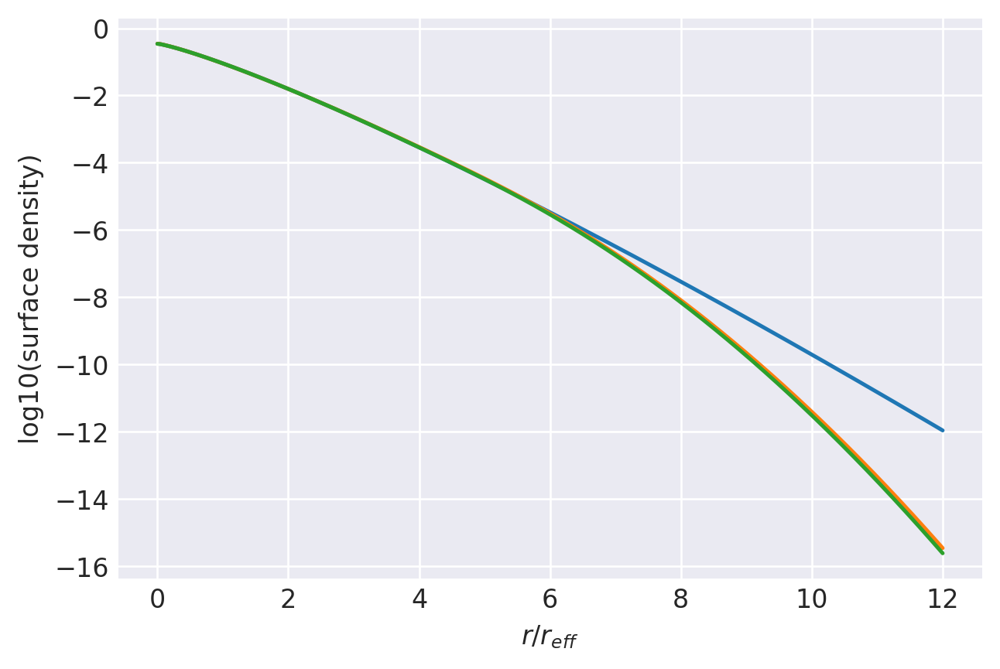

n=0.835: (
    normalize(np.array([9.5834782385e-02, 3.6784648875e-01, 3.3617520517e-01, 1.4619396832e-01, 4.2608433822e-02, 9.5481482517e-03, 1.6218085387e-03, 1.7116476116e-04])),
    np.array([1.7963746527e+00, 1.3119553355e+00, 9.2929714792e-01, 6.2999245689e-01, 4.0554924245e-01, 2.4412492521e-01, 1.3258996701e-01, 5.8571667602e-02]),
),
1.0000000226348125 1.0000000225627497
prev.  chisq = -8.982389666413484
ws, re: (array([9.58347824e-02, 3.67846489e-01, 3.36175205e-01, 1.46193968e-01,
       4.26084338e-02, 9.54814825e-03, 1.62180854e-03, 1.71164761e-04]), array([1.79637465, 1.31195534, 0.92929715, 0.62999246, 0.40554924,
       0.24412493, 0.13258997, 0.05857167]))
         Current function value: -11.818895
         Iterations: 35
         Function evaluations: 1473
         Gradient evaluations: 86
-11.81889544515155 [-2.2691982  -0.38776472  0.51791791  1.00213834  1.32992952  1.67817953
  2.25216702  0.25303168  0.11824386 -0.03020753 -0.19821201 -0.38910319
 -0.60929395 -0

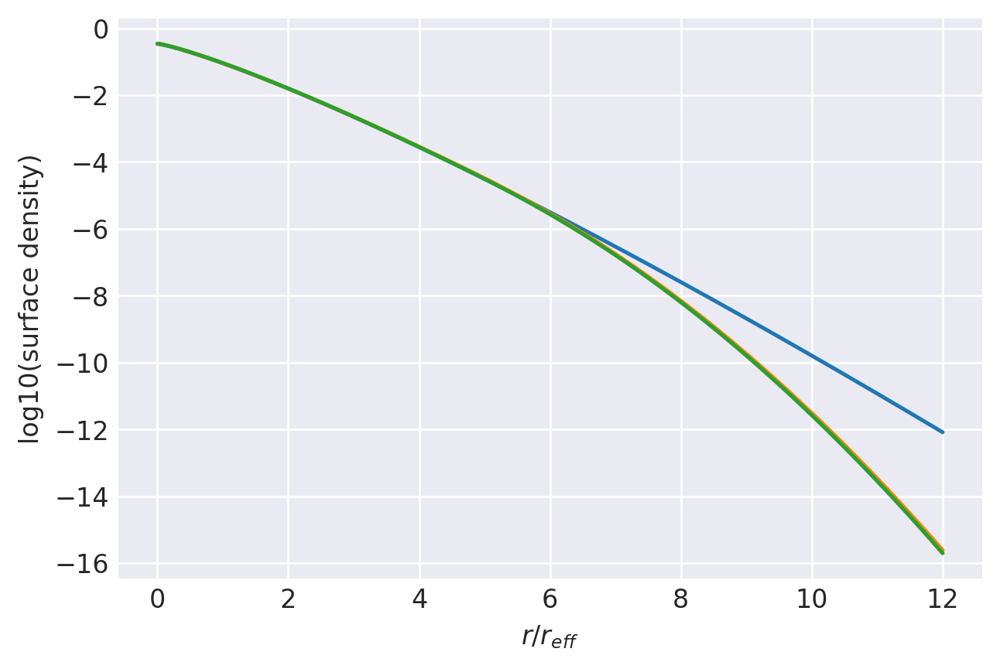

n=0.83: (
    normalize(np.array([9.3706282998e-02, 3.6637423180e-01, 3.3834636264e-01, 1.4744646464e-01, 4.2804929506e-02, 9.5404052669e-03, 1.6118076187e-03, 1.6951553096e-04])),
    np.array([1.7907364945e+00, 1.3129369052e+00, 9.3280845738e-01, 6.3356034322e-01, 4.0822237963e-01, 2.4587028939e-01, 1.3362304702e-01, 5.9102911016e-02]),
),
1.000000022474237 1.000000022403328
prev.  chisq = -8.97751672826841
ws, re: (array([9.37062830e-02, 3.66374232e-01, 3.38346363e-01, 1.47446465e-01,
       4.28049295e-02, 9.54040527e-03, 1.61180762e-03, 1.69515531e-04]), array([1.79073649, 1.31293691, 0.93280846, 0.63356034, 0.40822238,
       0.24587029, 0.13362305, 0.05910291]))
         Current function value: -11.851676
         Iterations: 38
         Function evaluations: 2324
         Gradient evaluations: 136
-11.851675858050752 [-2.28590558 -0.39207265  0.51944911  1.00422716  1.33240494  1.67997714
  2.25408963  0.25131904  0.11801085 -0.02928373 -0.19632698 -0.38639942
 -0.60595079 -0.8

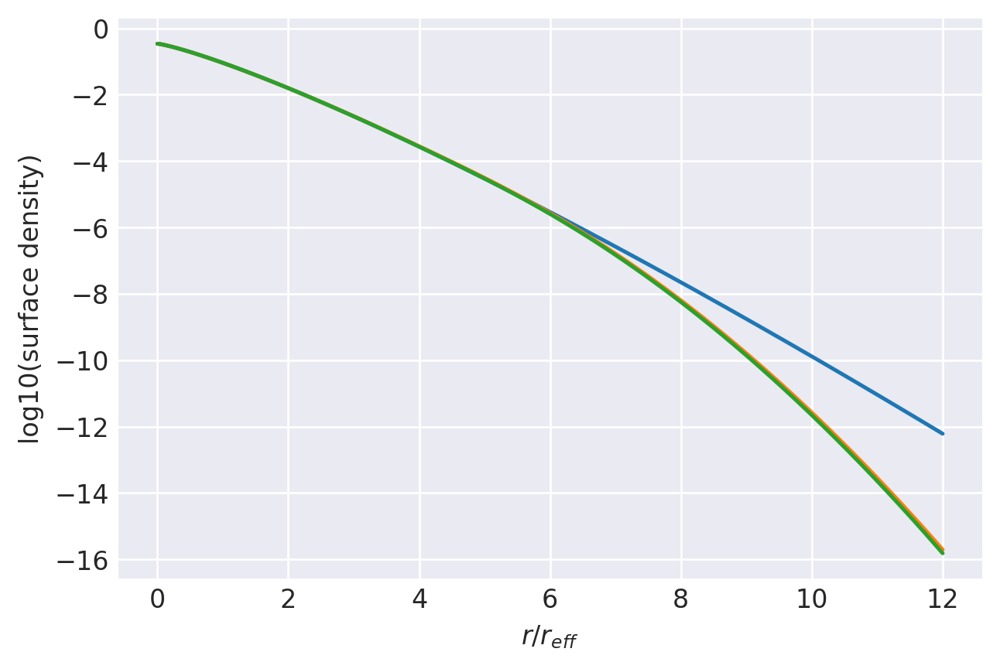

n=0.825: (
    normalize(np.array([9.2297001446e-02, 3.6600259905e-01, 3.3965641123e-01, 1.4787374741e-01, 4.2861561834e-02, 9.5321025595e-03, 1.6078065254e-03, 1.6876994152e-04])),
    np.array([1.7836886015e+00, 1.3122326759e+00, 9.3479476154e-01, 6.3631626251e-01, 4.1077176020e-01, 2.4777027641e-01, 1.3485972685e-01, 5.9731274619e-02]),
),
1.0000000223135879 1.000000022245172
prev.  chisq = -8.972158619865581
ws, re: (array([9.22970014e-02, 3.66002599e-01, 3.39656411e-01, 1.47873747e-01,
       4.28615618e-02, 9.53210256e-03, 1.60780653e-03, 1.68769942e-04]), array([1.7836886 , 1.31223268, 0.93479476, 0.63631626, 0.41077176,
       0.24777028, 0.13485973, 0.05973127]))
         Current function value: -11.884388
         Iterations: 44
         Function evaluations: 2698
         Gradient evaluations: 158
-11.88438805604518 [-2.27540752 -0.38076014  0.53187019  1.01698462  1.34232127  1.68615085
  2.2615812   0.24848927  0.11628424 -0.03026152 -0.19700302 -0.38709793
 -0.60663257 -0

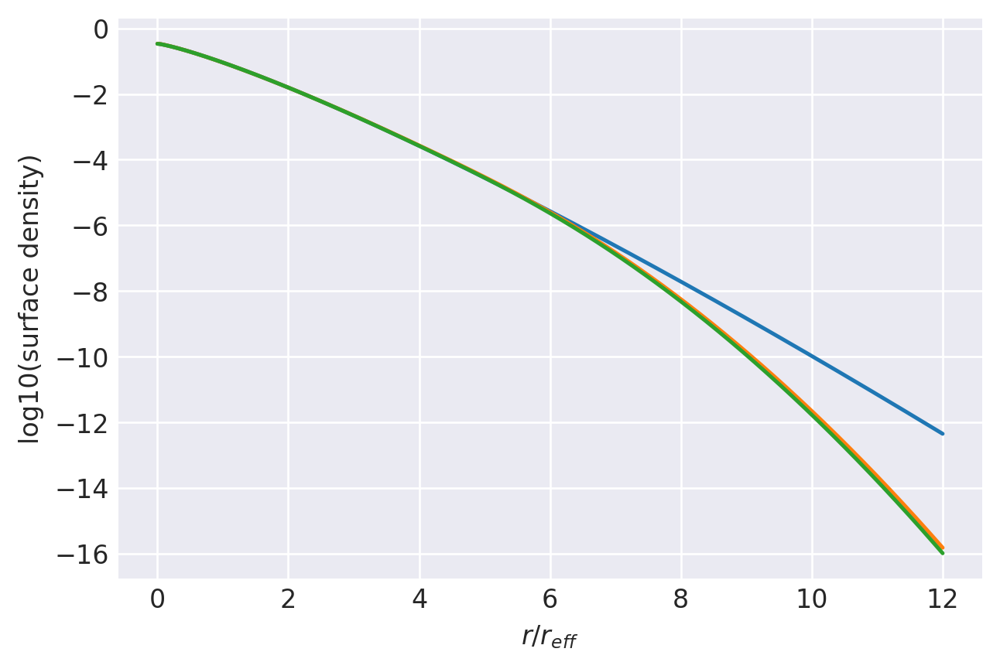

n=0.8200000000000001: (
    normalize(np.array([9.3180282626e-02, 3.6811763616e-01, 3.3933878373e-01, 1.4640937999e-01, 4.1985647417e-02, 9.2541190957e-03, 1.5524119878e-03, 1.6173899923e-04])),
    np.array([1.7721042746e+00, 1.3070260264e+00, 9.3269249807e-01, 6.3532651585e-01, 4.1011161742e-01, 2.4738161812e-01, 1.3467701941e-01, 5.9650583683e-02]),
),
1.0000000221532341 1.000000022091974
prev.  chisq = -8.967021222743258
ws, re: (array([9.31802826e-02, 3.68117636e-01, 3.39338784e-01, 1.46409380e-01,
       4.19856474e-02, 9.25411910e-03, 1.55241199e-03, 1.61738999e-04]), array([1.77210427, 1.30702603, 0.9326925 , 0.63532652, 0.41011162,
       0.24738162, 0.13467702, 0.05965058]))
         Current function value: -11.917539
         Iterations: 47
         Function evaluations: 2715
         Gradient evaluations: 159
-11.917538544778058 [-2.27770804 -0.37619254  0.53819229  1.02105493  1.34442294  1.6873425
  2.26011086  0.24616987  0.11522008 -0.03035195 -0.19626222 -0.38556927
 -

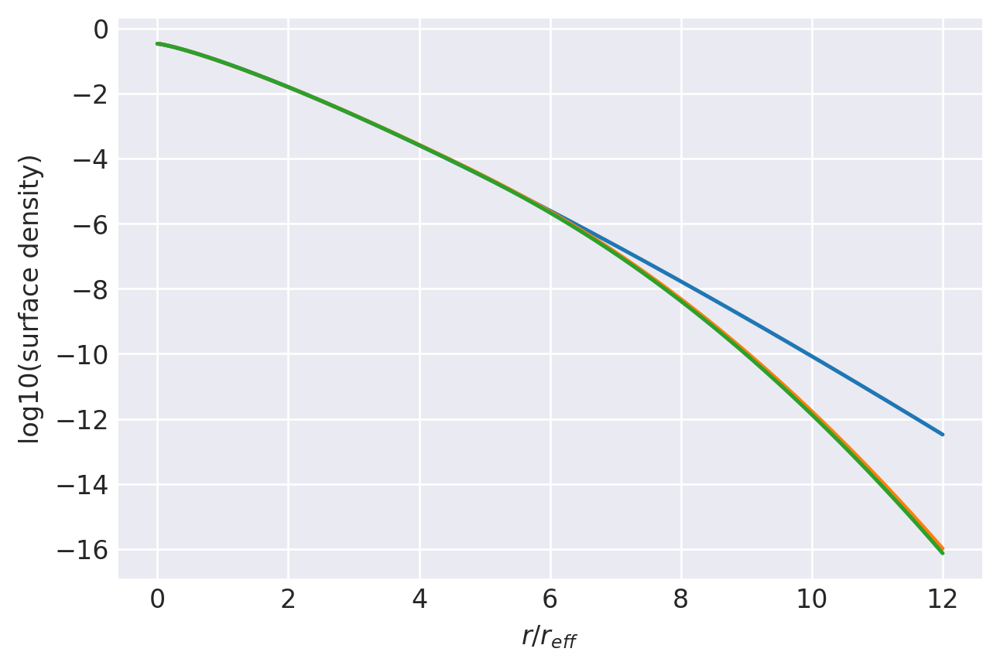

n=0.815: (
    normalize(np.array([9.2986075986e-02, 3.6919597096e-01, 3.3957384478e-01, 1.4574471404e-01, 4.1643377952e-02, 9.1611137100e-03, 1.5347666747e-03, 1.6013589318e-04])),
    np.array([1.7626653685e+00, 1.3038273322e+00, 9.3249831233e-01, 6.3641114918e-01, 4.1155769995e-01, 2.4866489868e-01, 1.3561269169e-01, 6.0234252436e-02]),
),
1.0000000219934586 1.0000000219362726
prev.  chisq = -8.961889848403356
ws, re: (array([9.29860760e-02, 3.69195971e-01, 3.39573845e-01, 1.45744714e-01,
       4.16433780e-02, 9.16111371e-03, 1.53476667e-03, 1.60135893e-04]), array([1.76266537, 1.30382733, 0.93249831, 0.63641115, 0.4115577 ,
       0.2486649 , 0.13561269, 0.06023425]))
         Current function value: -11.951039
         Iterations: 56
         Function evaluations: 2851
         Gradient evaluations: 167
-11.951039086868507 [-2.27166644 -0.36794953  0.54890236  1.03222718  1.3532923   1.69446433
  2.26613687  0.24347969  0.11376002 -0.0309467  -0.19644045 -0.38562144
 -0.60438076 

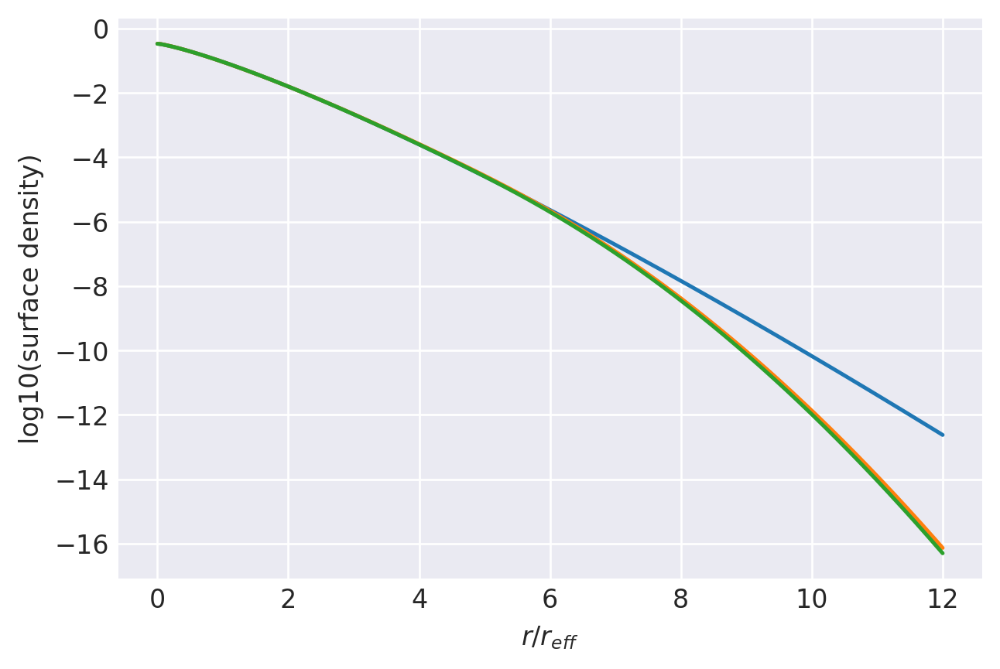

n=0.81: (
    normalize(np.array([9.3496877139e-02, 3.7079293837e-01, 3.3957644974e-01, 1.4461870966e-01, 4.0937308901e-02, 8.9361642321e-03, 1.4873009162e-03, 1.5425104311e-04])),
    np.array([1.7517805029e+00, 1.2994513277e+00, 9.3122215357e-01, 6.3615002551e-01, 4.1150826647e-01, 2.4866762093e-01, 1.3563143012e-01, 6.0257185067e-02]),
),
1.000000021834481 1.0000000217850566
prev.  chisq = -8.956537516071345
ws, re: (array([9.34968771e-02, 3.70792938e-01, 3.39576450e-01, 1.44618710e-01,
       4.09373089e-02, 8.93616423e-03, 1.48730092e-03, 1.54251043e-04]), array([1.7517805 , 1.29945133, 0.93122215, 0.63615003, 0.41150827,
       0.24866762, 0.13563143, 0.06025719]))
         Current function value: -11.985570
         Iterations: 58
         Function evaluations: 2222
         Gradient evaluations: 130
-11.985569833595475 [-2.25424212 -0.35134649  0.56267872  1.04185158  1.35942983  1.69814573
  2.26863914  0.24037123  0.11162207 -0.03240674 -0.1974156  -0.38622194
 -0.60460948 -0

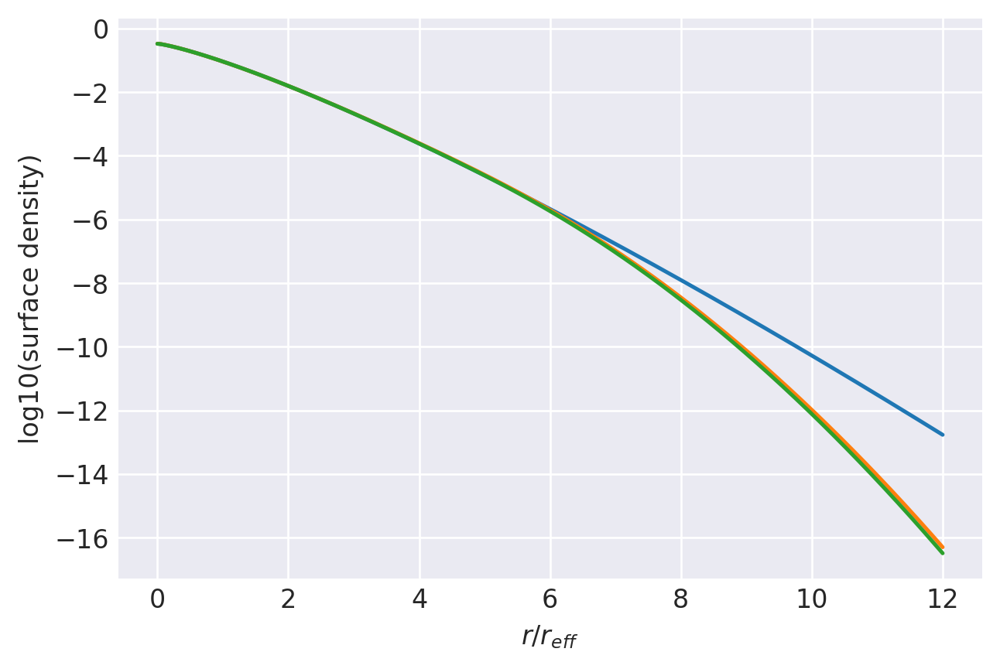

n=0.8049999999999999: (
    normalize(np.array([9.4984175915e-02, 3.7382216017e-01, 3.3840867268e-01, 1.4250803643e-01, 4.0003714523e-02, 8.6838919522e-03, 1.4403409377e-03, 1.4900740270e-04])),
    np.array([1.7392869304e+00, 1.2930701017e+00, 9.2809677491e-01, 6.3472324524e-01, 4.1093966321e-01, 2.4853669358e-01, 1.3569676159e-01, 6.0362472446e-02]),
),
1.0000000216764655 1.000000021634365
prev.  chisq = -8.95132660663413
ws, re: (array([9.49841759e-02, 3.73822160e-01, 3.38408673e-01, 1.42508036e-01,
       4.00037145e-02, 8.68389195e-03, 1.44034094e-03, 1.49007403e-04]), array([1.73928693, 1.2930701 , 0.92809677, 0.63472325, 0.41093966,
       0.24853669, 0.13569676, 0.06036247]))
         Current function value: -12.020693
         Iterations: 50
         Function evaluations: 2732
         Gradient evaluations: 160
-12.020693366756822 [-2.23288269 -0.3321071   0.57748593  1.05039779  1.36361735  1.70110129
  2.27181277  0.2371165   0.10927256 -0.03412604 -0.19861661 -0.38687714
 -

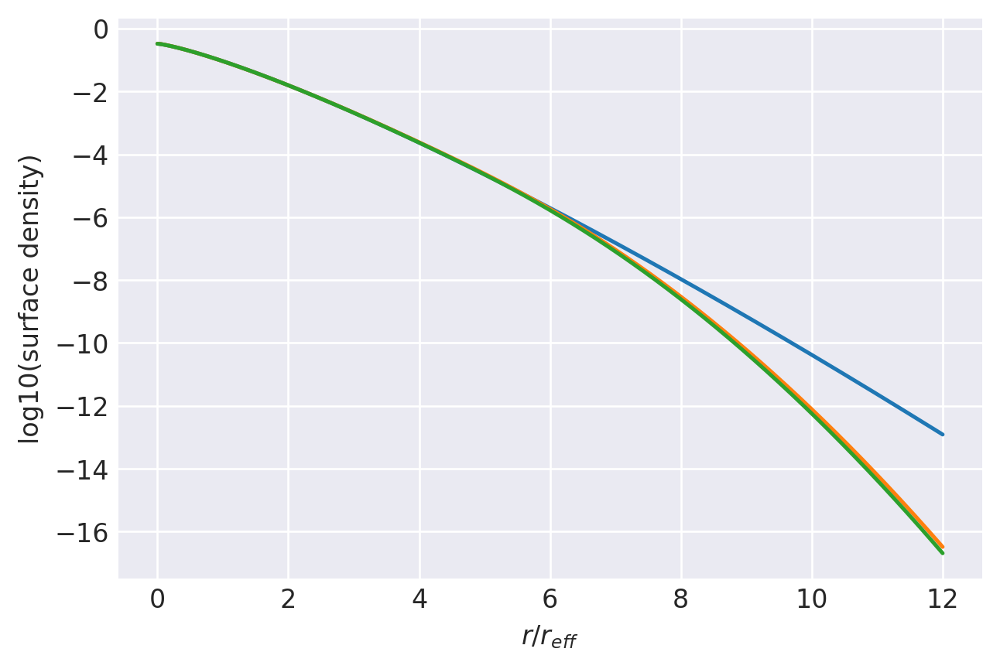

n=0.8: (
    normalize(np.array([9.6836231121e-02, 3.7727681530e-01, 3.3682465858e-01, 1.4006704302e-01, 3.9017221139e-02, 8.4382063067e-03, 1.3958748554e-03, 1.4394968957e-04])),
    np.array([1.7263009193e+00, 1.2860935640e+00, 9.2442985663e-01, 6.3297037972e-01, 4.1032016071e-01, 2.4846492746e-01, 1.3580925809e-01, 6.0469131878e-02]),
),
1.000000021519536 1.0000000214848397
prev.  chisq = -8.94611302341279
ws, re: (array([9.68362311e-02, 3.77276815e-01, 3.36824659e-01, 1.40067043e-01,
       3.90172211e-02, 8.43820631e-03, 1.39587486e-03, 1.43949690e-04]), array([1.72630092, 1.28609356, 0.92442986, 0.63297038, 0.41032016,
       0.24846493, 0.13580926, 0.06046913]))
         Current function value: -12.055630
         Iterations: 49
         Function evaluations: 2068
         Gradient evaluations: 121
-12.055630069796225 [-2.23442012 -0.33018221  0.58255702  1.05716838  1.36951169  1.70519544
  2.27743397  0.23466166  0.10829373 -0.03390255 -0.19758153 -0.38536413
 -0.60283939 -0.8

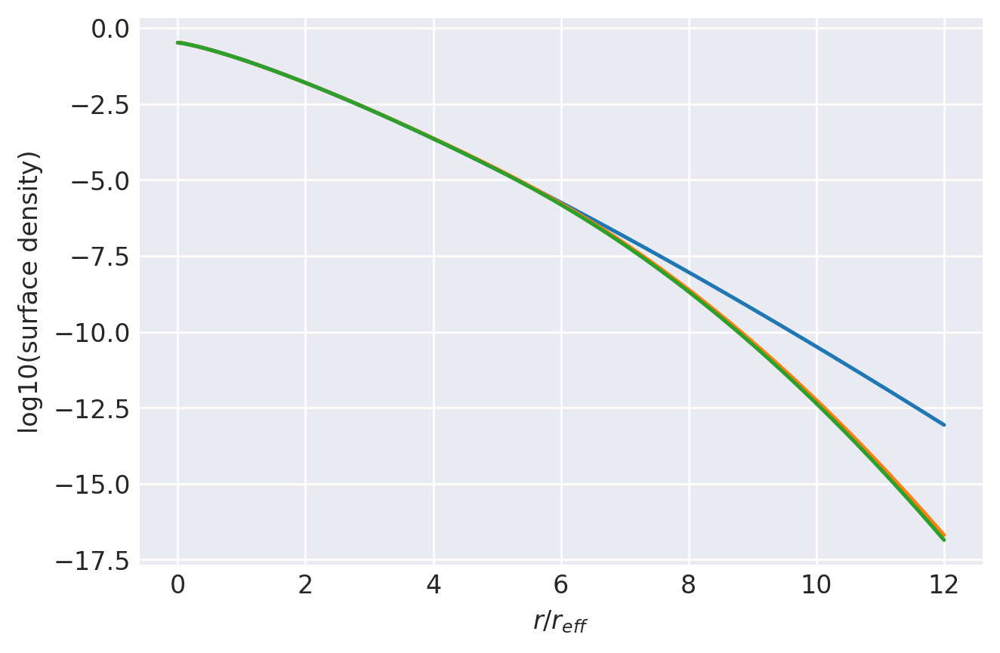

n=0.7949999999999999: (
    normalize(np.array([9.6701851660e-02, 3.7775593288e-01, 3.3721708716e-01, 1.3976531441e-01, 3.8716800257e-02, 8.3292769666e-03, 1.3729452437e-03, 1.4079142677e-04])),
    np.array([1.7165705709e+00, 1.2831981659e+00, 9.2490568253e-01, 6.3448077191e-01, 4.1175214370e-01, 2.4955174559e-01, 1.3652280891e-01, 6.0815609139e-02]),
),
1.0000000213637832 1.00000002133535
prev.  chisq = -8.940628740315452
ws, re: (array([9.67018517e-02, 3.77755933e-01, 3.37217087e-01, 1.39765314e-01,
       3.87168003e-02, 8.32927697e-03, 1.37294524e-03, 1.40791427e-04]), array([1.71657057, 1.28319817, 0.92490568, 0.63448077, 0.41175214,
       0.24955175, 0.13652281, 0.06081561]))
         Current function value: -12.090780
         Iterations: 53
         Function evaluations: 2613
         Gradient evaluations: 153
-12.090779783484422 [-2.2317454  -0.3174598   0.59836685  1.07005614  1.37770007  1.71066776
  2.27658536  0.23212819  0.10678925 -0.03486899 -0.19834278 -0.38601281
 -

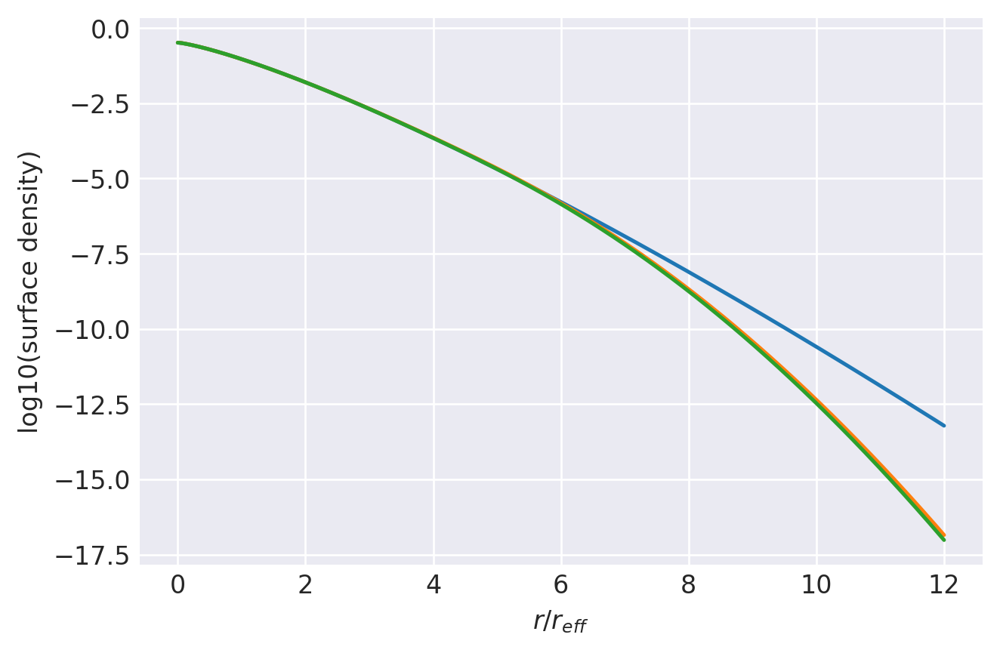

n=0.79: (
    normalize(np.array([9.6935742693e-02, 3.8045640176e-01, 3.3722974477e-01, 1.3803394867e-01, 3.7810059483e-02, 8.0746496081e-03, 1.3236059537e-03, 1.3584706299e-04])),
    np.array([1.7065860305e+00, 1.2787605978e+00, 9.2284976810e-01, 6.3336961499e-01, 4.1113759178e-01, 2.4928138733e-01, 1.3650620880e-01, 6.0972080268e-02]),
),
1.0000000212092717 1.0000000211872624
prev.  chisq = -8.935150653604762
ws, re: (array([9.69357427e-02, 3.80456402e-01, 3.37229745e-01, 1.38033949e-01,
       3.78100595e-02, 8.07464961e-03, 1.32360595e-03, 1.35847063e-04]), array([1.70658603, 1.2787606 , 0.92284977, 0.63336961, 0.41113759,
       0.24928139, 0.13650621, 0.06097208]))
         Current function value: -12.126989
         Iterations: 66
         Function evaluations: 2731
         Gradient evaluations: 160
-12.126988652618126 [-2.21401761 -0.2984619   0.61566916  1.08186178  1.384858    1.71479569
  2.28300777  0.22899529  0.10460249 -0.03651509 -0.19969802 -0.38712061
 -0.60412507 -

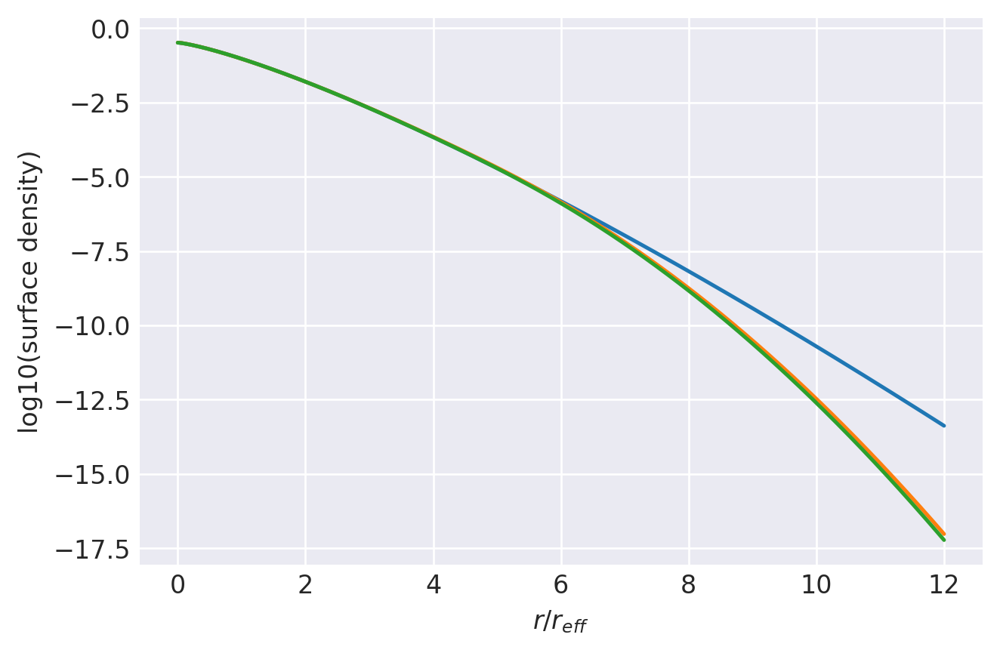

n=0.785: (
    normalize(np.array([9.8498746886e-02, 3.8397960921e-01, 3.3599209206e-01, 1.3557464608e-01, 3.6753358837e-02, 7.7979178628e-03, 1.2737371447e-03, 1.2989192005e-04])),
    np.array([1.6943194094e+00, 1.2723379825e+00, 9.1935853572e-01, 6.3139622447e-01, 4.1009020341e-01, 2.4881406498e-01, 1.3633519253e-01, 6.0914160065e-02]),
),
1.000000021056048 1.0000000210418836
prev.  chisq = -8.929737106446826
ws, re: (array([9.84987469e-02, 3.83979609e-01, 3.35992092e-01, 1.35574646e-01,
       3.67533588e-02, 7.79791786e-03, 1.27373714e-03, 1.29891920e-04]), array([1.69431941, 1.27233798, 0.91935854, 0.63139622, 0.4100902 ,
       0.24881406, 0.13633519, 0.06091416]))
         Current function value: -12.163325
         Iterations: 51
         Function evaluations: 2119
         Gradient evaluations: 124
-12.16332533500502 [-2.22166372 -0.30061056  0.61771229  1.08663361  1.39052306  1.71958461
  2.28834057  0.2267036   0.10394409 -0.03577032 -0.19791733 -0.38471409
 -0.60133624 -0

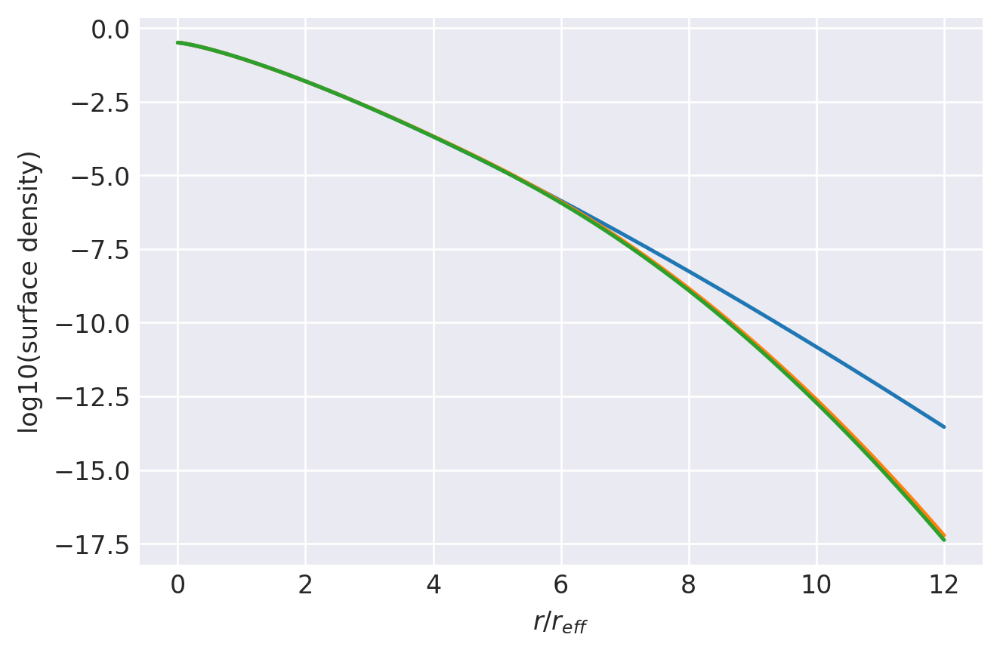

n=0.78: (
    normalize(np.array([9.7821878405e-02, 3.8379400176e-01, 3.3679316026e-01, 1.3578414590e-01, 3.6676404160e-02, 7.7432750138e-03, 1.2593888443e-03, 1.2774566208e-04])),
    np.array([1.6854023618e+00, 1.2704105395e+00, 9.2093649291e-01, 6.3399037683e-01, 4.1236890687e-01, 2.5041696980e-01, 1.3732200474e-01, 6.1389492454e-02]),
),
1.0000000209041424 1.0000000208955528
prev.  chisq = -8.92427102937741
ws, re: (array([9.78218784e-02, 3.83794002e-01, 3.36793160e-01, 1.35784146e-01,
       3.66764042e-02, 7.74327501e-03, 1.25938884e-03, 1.27745662e-04]), array([1.68540236, 1.27041054, 0.92093649, 0.63399038, 0.41236891,
       0.25041697, 0.137322  , 0.06138949]))
         Current function value: -12.201302
         Iterations: 66
         Function evaluations: 2510
         Gradient evaluations: 147
-12.201302072428476 [-2.18774805 -0.26941014  0.64219091  1.10051124  1.39675952  1.72425219
  2.29142795  0.22300687  0.10085635 -0.03868248 -0.20078232 -0.38735033
 -0.60363409 -0

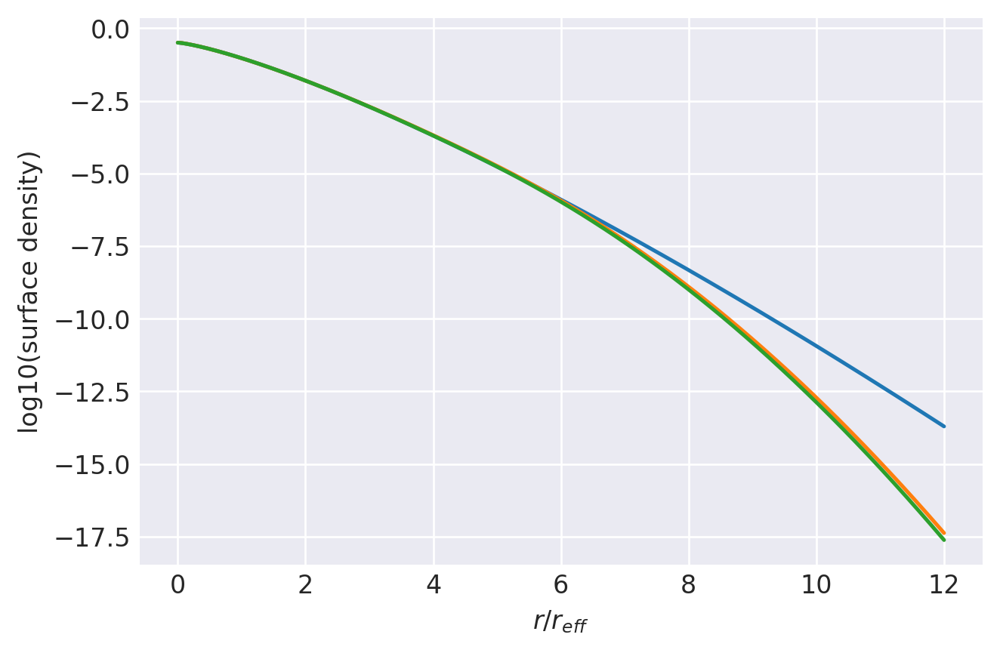

n=0.775: (
    normalize(np.array([1.0085612617e-01, 3.8937597206e-01, 3.3402467920e-01, 1.3186996130e-01, 3.5171840923e-02, 7.3846843034e-03, 1.1958130782e-03, 1.2092296433e-04])),
    np.array([1.6711170558e+00, 1.2614102360e+00, 9.1478180751e-01, 6.2982178360e-01, 4.0987334369e-01, 2.4909551333e-01, 1.3668994631e-01, 6.1202392107e-02]),
),
1.0000000207535735 1.0000000207522899
prev.  chisq = -8.918713255526736
ws, re: (array([1.00856126e-01, 3.89375972e-01, 3.34024679e-01, 1.31869961e-01,
       3.51718409e-02, 7.38468430e-03, 1.19581308e-03, 1.20922964e-04]), array([1.67111706, 1.26141024, 0.91478181, 0.62982178, 0.40987334,
       0.24909551, 0.13668995, 0.06120239]))
         Current function value: -12.240445
         Iterations: 50
         Function evaluations: 2733
         Gradient evaluations: 160
-12.240445105232004 [-2.13637143 -0.23757459  0.6584678   1.10862815  1.40363621  1.72893323
  2.29055107  0.21860535  0.09721899 -0.04158179 -0.20293395 -0.38899587
 -0.60505629 

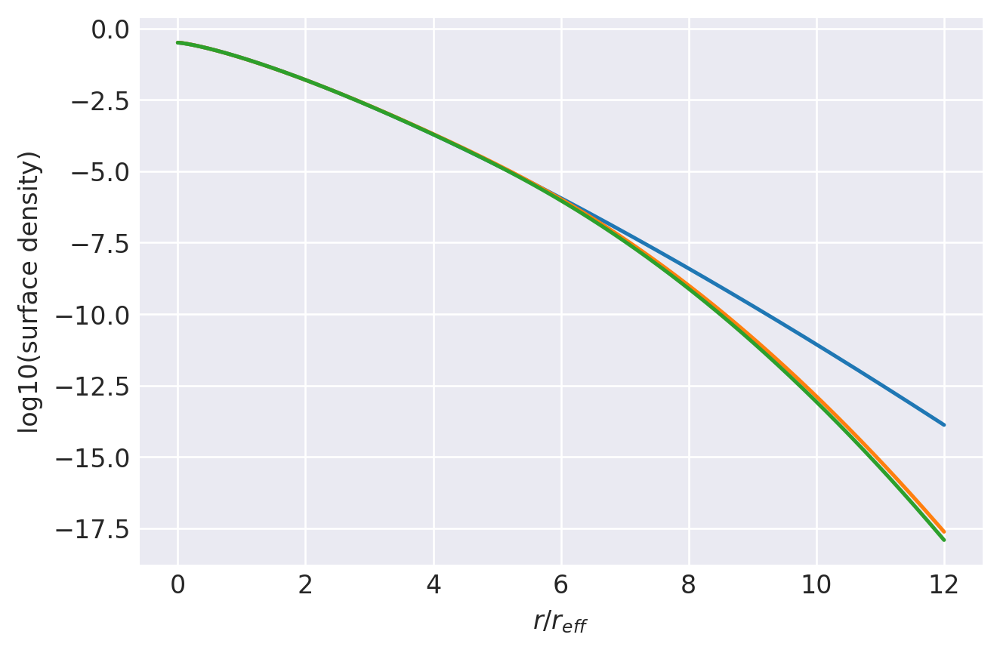

n=0.77: (
    normalize(np.array([1.0561164616e-01, 3.9432164079e-01, 3.2950201626e-01, 1.2824303600e-01, 3.3974147657e-02, 7.0893418712e-03, 1.1425345644e-03, 1.1563669175e-04])),
    np.array([1.6542660376e+00, 1.2508896293e+00, 9.0869515378e-01, 6.2670916526e-01, 4.0832326551e-01, 2.4828112562e-01, 1.3638748080e-01, 6.1174564404e-02]),
),
1.0000000206043538 1.0000000206103739
prev.  chisq = -8.913333049061022
ws, re: (array([1.05611646e-01, 3.94321641e-01, 3.29502016e-01, 1.28243036e-01,
       3.39741477e-02, 7.08934187e-03, 1.14253456e-03, 1.15636692e-04]), array([1.65426604, 1.25088963, 0.90869515, 0.62670917, 0.40832327,
       0.24828113, 0.13638748, 0.06117456]))
         Current function value: -12.279202
         Iterations: 54
         Function evaluations: 2237
         Gradient evaluations: 131
-12.279201736981975 [-2.15822873 -0.24432085  0.66282132  1.11742504  1.40993037  1.73279886
  2.29719232  0.21680774  0.09718109 -0.04030088 -0.2009279  -0.38661392
 -0.60222822 -

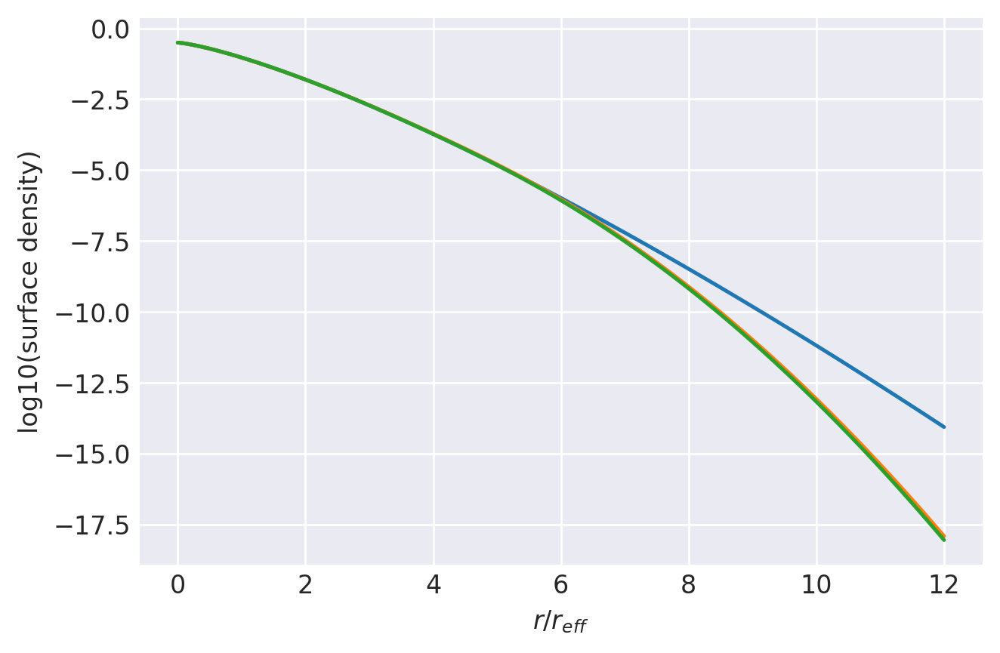

n=0.765: (
    normalize(np.array([1.0356477902e-01, 3.9373390958e-01, 3.3172951533e-01, 1.2882909079e-01, 3.3872408453e-02, 7.0278507492e-03, 1.1289414713e-03, 1.1350460368e-04])),
    np.array([1.6474329143e+00, 1.2507804749e+00, 9.1137921434e-01, 6.2961070542e-01, 4.1056892504e-01, 2.4990318044e-01, 1.3739842554e-01, 6.1686401767e-02]),
),
1.000000020456487 1.0000000204667594
prev.  chisq = -8.907724331468206
ws, re: (array([1.03564779e-01, 3.93733910e-01, 3.31729515e-01, 1.28829091e-01,
       3.38724085e-02, 7.02785075e-03, 1.12894147e-03, 1.13504604e-04]), array([1.64743291, 1.25078047, 0.91137921, 0.62961071, 0.41056893,
       0.24990318, 0.13739843, 0.0616864 ]))
         Current function value: -12.318817
         Iterations: 54
         Function evaluations: 1915
         Gradient evaluations: 112
-12.31881722485979 [-2.12743313 -0.21962662  0.67843606  1.1235789   1.4113273   1.73296171
  2.29893098  0.21318176  0.09445779 -0.04232644 -0.20222665 -0.38708284
 -0.60187284 -0

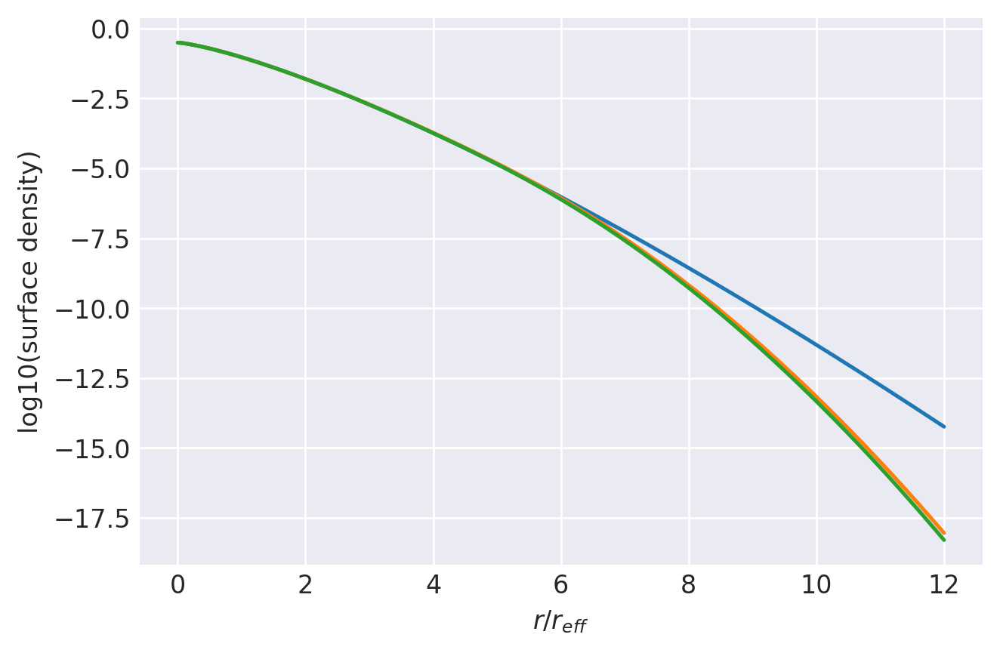

n=0.76: (
    normalize(np.array([1.0645891953e-01, 3.9790545178e-01, 3.2879949786e-01, 1.2590321348e-01, 3.2909050804e-02, 6.8186084872e-03, 1.0953246246e-03, 1.0993343910e-04])),
    np.array([1.6337355608e+00, 1.2429618207e+00, 9.0713841819e-01, 6.2773067633e-01, 4.1012586135e-01, 2.5010775541e-01, 1.3775887552e-01, 6.1986363244e-02]),
),
1.0000000203099735 1.0000000203250463
prev.  chisq = -8.902219532033492
ws, re: (array([1.06458920e-01, 3.97905452e-01, 3.28799498e-01, 1.25903213e-01,
       3.29090508e-02, 6.81860849e-03, 1.09532462e-03, 1.09933439e-04]), array([1.63373556, 1.24296182, 0.90713842, 0.62773068, 0.41012586,
       0.25010776, 0.13775888, 0.06198636]))
         Current function value: -12.356716
         Iterations: 49
         Function evaluations: 2375
         Gradient evaluations: 139
-12.356716261428712 [-2.0739111  -0.17971341  0.70477952  1.13799075  1.42075149  1.73893211
  2.3011116   0.20878444  0.09056905 -0.04603863 -0.20584669 -0.39062355
 -0.60543283 -

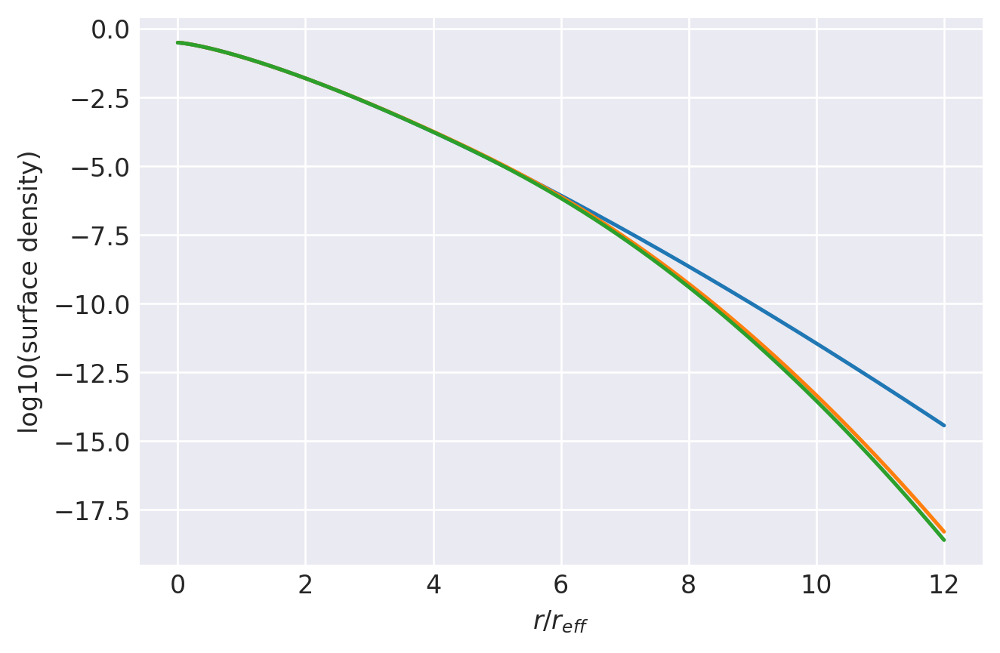

n=0.755: (
    normalize(np.array([1.1165850374e-01, 4.0436610200e-01, 3.2389888747e-01, 1.2122762703e-01, 3.1291071025e-02, 6.4283046031e-03, 1.0266843152e-03, 1.0281982391e-04])),
    np.array([1.6172771202e+00, 1.2318818288e+00, 8.9941757207e-01, 6.2251999495e-01, 4.0679578857e-01, 2.4806595746e-01, 1.3670966135e-01, 6.1560345274e-02]),
),
1.0000000201648103 1.000000020187683
prev.  chisq = -8.896438028194853
ws, re: (array([1.11658504e-01, 4.04366102e-01, 3.23898887e-01, 1.21227627e-01,
       3.12910710e-02, 6.42830460e-03, 1.02668432e-03, 1.02819824e-04]), array([1.61727712, 1.23188183, 0.89941757, 0.62251999, 0.40679579,
       0.24806596, 0.13670966, 0.06156035]))
         Current function value: -12.387657
         Iterations: 55
         Function evaluations: 2460
         Gradient evaluations: 144
-12.387656716441676 [-2.01010529 -0.12911216  0.74217964  1.16147795  1.43269608  1.7468172
  2.30969177  0.20408124  0.08604556 -0.05096599 -0.21148494 -0.39684264
 -0.6118431  -0

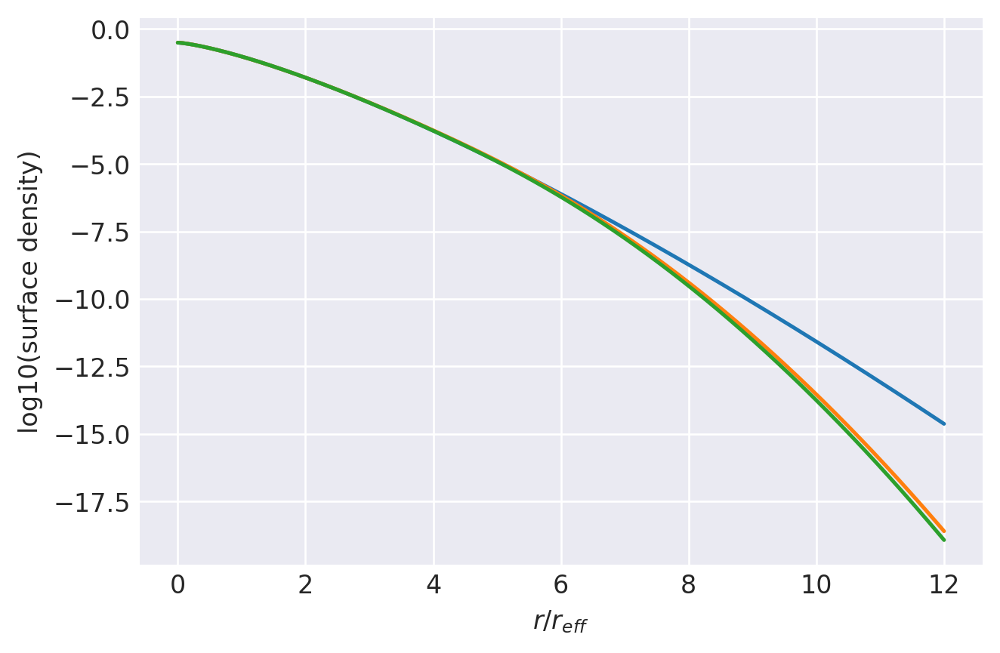

n=0.75: (
    normalize(np.array([1.1814600743e-01, 4.1250195292e-01, 3.1797300530e-01, 1.1529044862e-01, 2.9135074884e-02, 5.9212684740e-03, 9.3900666303e-04, 9.3235710220e-05])),
    np.array([1.5998572704e+00, 1.2191174793e+00, 8.8927075077e-01, 6.1449033889e-01, 4.0101199477e-01, 2.4443134582e-01, 1.3465365850e-01, 6.0605648890e-02]),
),
1.0000000200209913 1.0000000200518053
prev.  chisq = -8.890646002907143
ws, re: (array([1.18146007e-01, 4.12501953e-01, 3.17973005e-01, 1.15290449e-01,
       2.91350749e-02, 5.92126847e-03, 9.39006663e-04, 9.32357102e-05]), array([1.59985727, 1.21911748, 0.88927075, 0.61449034, 0.40101199,
       0.24443135, 0.13465366, 0.06060565]))
         Current function value: -12.439826
         Iterations: 44
         Function evaluations: 2766
         Gradient evaluations: 162
-12.439826239366885 [-2.06842534 -0.15849838  0.73629801  1.16533005  1.43382329  1.74414179
  2.3081071   0.20342666  0.08789955 -0.04710063 -0.20641316 -0.39088285
 -0.60480496 -

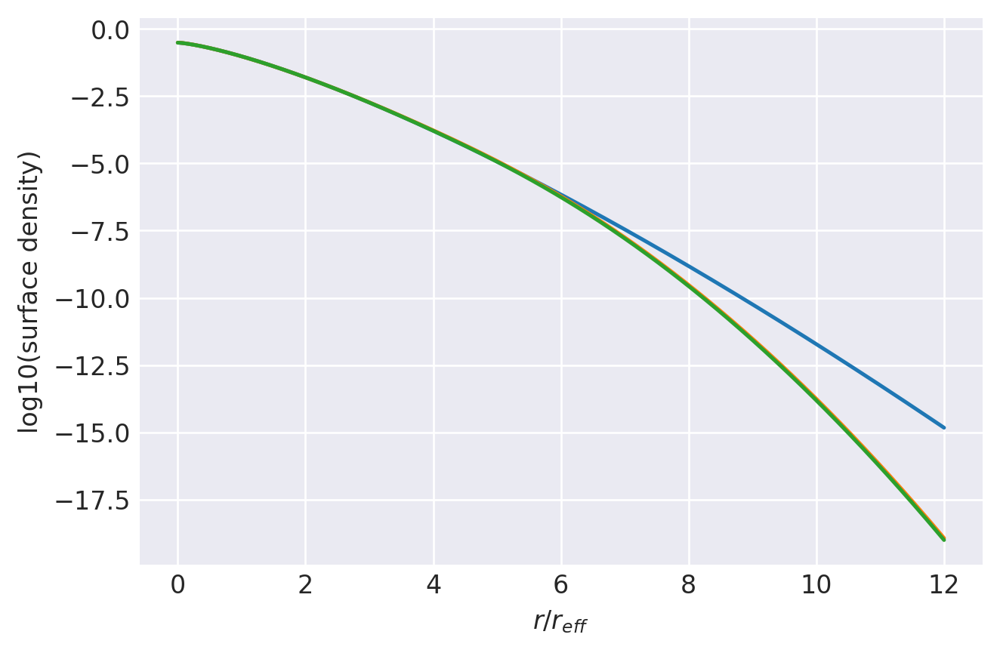

n=0.745: (
    normalize(np.array([1.1220380065e-01, 4.0879299668e-01, 3.2389516490e-01, 1.1823883585e-01, 2.9771745251e-02, 6.0414430167e-03, 9.6049324377e-04, 9.5520400903e-05])),
    np.array([1.5974477477e+00, 1.2243329845e+00, 8.9722086673e-01, 6.2170854804e-01, 4.0655297986e-01, 2.4842485027e-01, 1.3726235224e-01, 6.1955367300e-02]),
),
1.0000000198785108 1.000000019910926
prev.  chisq = -8.884797209762512
ws, re: (array([1.12203801e-01, 4.08792997e-01, 3.23895165e-01, 1.18238836e-01,
       2.97717453e-02, 6.04144302e-03, 9.60493244e-04, 9.55204009e-05]), array([1.59744775, 1.22433298, 0.89722087, 0.62170855, 0.40655298,
       0.24842485, 0.13726235, 0.06195537]))
         Current function value: -12.481755
         Iterations: 45
         Function evaluations: 2698
         Gradient evaluations: 158
-12.481755230151634 [-2.1020966  -0.1742678   0.73168424  1.16595924  1.43817599  1.74930902
  2.31309118  0.2018717   0.08845368 -0.04466925 -0.20247059 -0.38591597
 -0.59927397 -

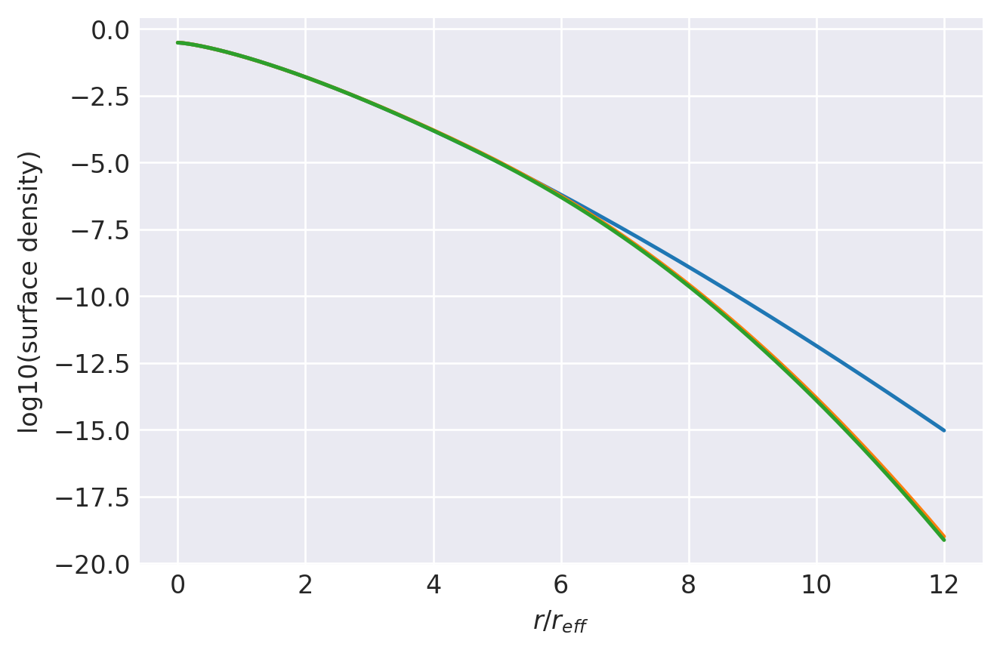

n=0.74: (
    normalize(np.array([1.0889321001e-01, 4.0682854520e-01, 3.2697244650e-01, 1.1993211972e-01, 3.0204361829e-02, 6.1072944966e-03, 9.6639292841e-04, 9.5629307263e-05])),
    np.array([1.5917384390e+00, 1.2258961440e+00, 9.0225800890e-01, 6.2737817919e-01, 4.1122927710e-01, 2.5160891993e-01, 1.3914638347e-01, 6.2855471404e-02]),
),
1.00000001973736 1.0000000197726142
prev.  chisq = -8.879040677348925
ws, re: (array([1.08893210e-01, 4.06828545e-01, 3.26972447e-01, 1.19932120e-01,
       3.02043618e-02, 6.10729450e-03, 9.66392928e-04, 9.56293073e-05]), array([1.59173844, 1.22589614, 0.90225801, 0.62737818, 0.41122928,
       0.25160892, 0.13914638, 0.06285547]))
         Current function value: -12.522101
         Iterations: 68
         Function evaluations: 2766
         Gradient evaluations: 162
-12.522101030822645 [-2.08464608 -0.1485336   0.7595957   1.1893814   1.45369831  1.75966023
  2.32044584  0.19871517  0.08619442 -0.04673721 -0.20500234 -0.38915939
 -0.60302312 -0.

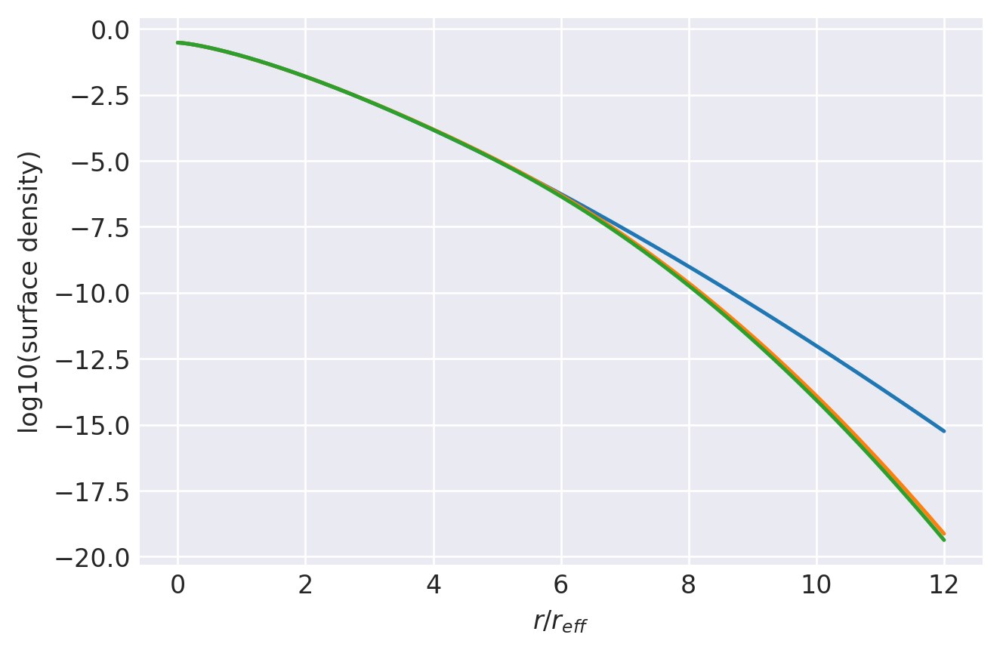

n=0.735: (
    normalize(np.array([1.1059812198e-01, 4.1173500978e-01, 3.2541817231e-01, 1.1671848026e-01, 2.8799618698e-02, 5.7423239070e-03, 8.9987822051e-04, 8.8394840593e-05])),
    np.array([1.5802113148e+00, 1.2195354207e+00, 8.9797199025e-01, 6.2373147834e-01, 4.0816955796e-01, 2.4944619049e-01, 1.3786899064e-01, 6.2318660498e-02]),
),
1.0000000195975296 1.000000019638715
prev.  chisq = -8.873054373839588
ws, re: (array([1.10598122e-01, 4.11735010e-01, 3.25418172e-01, 1.16718480e-01,
       2.87996187e-02, 5.74232391e-03, 8.99878221e-04, 8.83948406e-05]), array([1.58021131, 1.21953542, 0.89797199, 0.62373148, 0.40816956,
       0.24944619, 0.13786899, 0.06231866]))
         Current function value: -12.561139
         Iterations: 57
         Function evaluations: 2238
         Gradient evaluations: 131
-12.561139365919896 [-2.11622384 -0.16297392  0.75654474  1.19227983  1.45853221  1.76392434
  2.32396516  0.19699048  0.08657545 -0.04447676 -0.20131722 -0.38456888
 -0.59786283 -

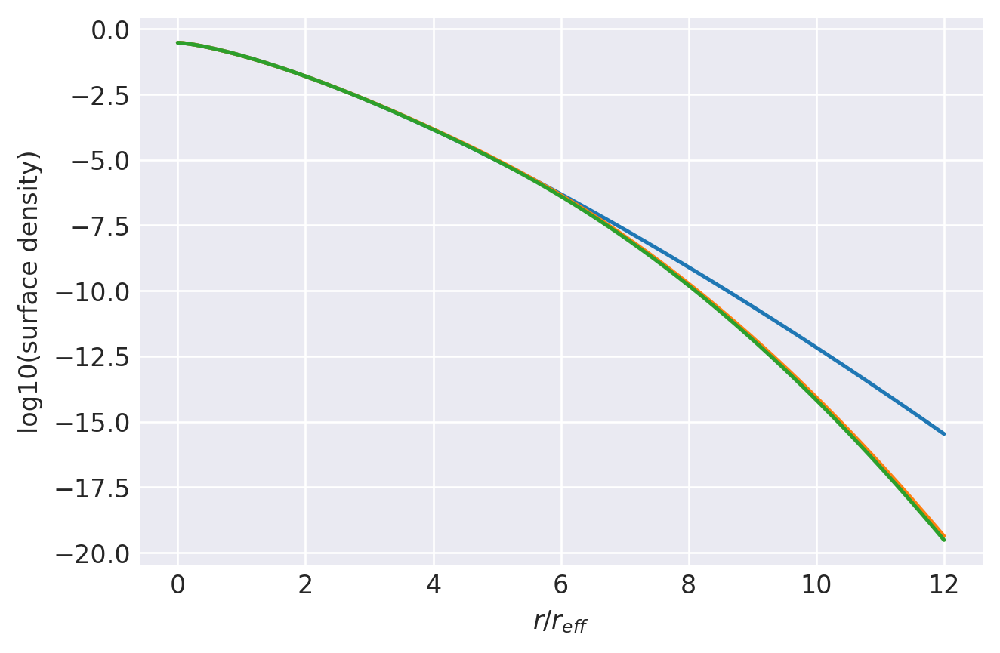

n=0.73: (
    normalize(np.array([1.0752992118e-01, 4.0995297373e-01, 3.2840263257e-01, 1.1822869594e-01, 2.9114420408e-02, 5.7807099738e-03, 9.0232262678e-04, 8.8323567377e-05])),
    np.array([1.5739483568e+00, 1.2206058678e+00, 9.0265800120e-01, 6.2904653840e-01, 4.1250680451e-01, 2.5242779324e-01, 1.3969035455e-01, 6.3226806799e-02]),
),
1.0000000194590108 1.0000000195027694
prev.  chisq = -8.867245410336178
ws, re: (array([1.07529921e-01, 4.09952974e-01, 3.28402633e-01, 1.18228696e-01,
       2.91144204e-02, 5.78070997e-03, 9.02322627e-04, 8.83235674e-05]), array([1.57394836, 1.22060587, 0.902658  , 0.62904654, 0.4125068 ,
       0.25242779, 0.13969035, 0.06322681]))
         Current function value: -12.612270
         Iterations: 73
         Function evaluations: 3072
         Gradient evaluations: 180
-12.612269853542962 [-2.01876116 -0.11041118  0.77922166  1.20225608  1.46570739  1.77009437
  2.32818642  0.19112618  0.08123091 -0.04919536 -0.20537535 -0.38824155
 -0.60140152 -

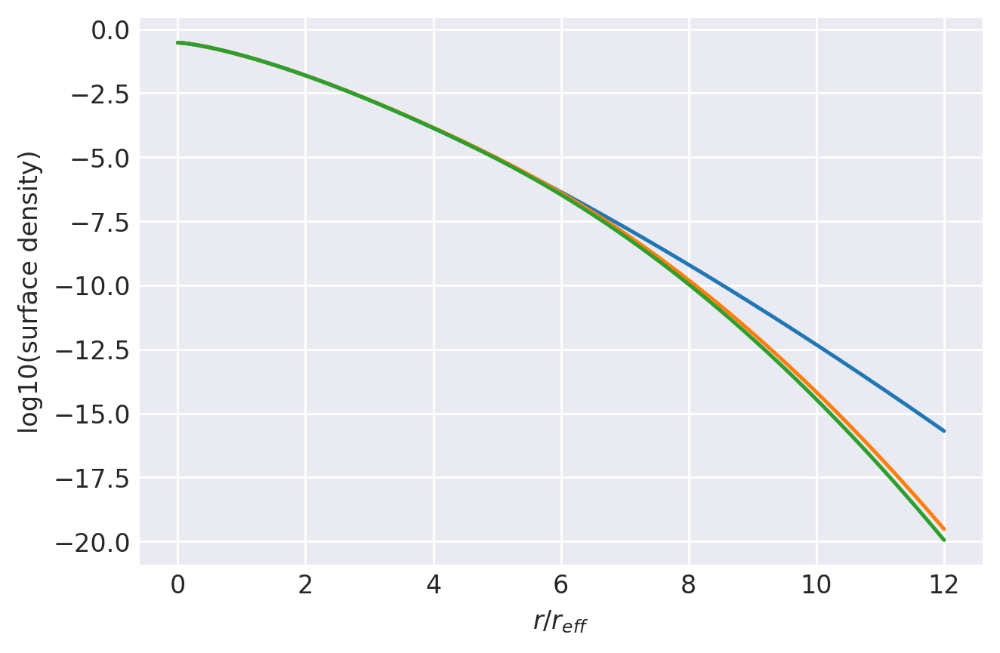

n=0.725: (
    normalize(np.array([1.1724715070e-01, 4.1703470264e-01, 3.1925553681e-01, 1.1261889175e-01, 2.7494773760e-02, 5.4249787086e-03, 8.4190333184e-04, 8.2062305080e-05])),
    np.array([1.5528381162e+00, 1.2056768135e+00, 8.9290373420e-01, 6.2319598472e-01, 4.0903309515e-01, 2.5037933312e-01, 1.3859794849e-01, 6.2788228313e-02]),
),
1.0000000193217948 1.000000019371088
prev.  chisq = -8.861317051572206
ws, re: (array([1.17247151e-01, 4.17034703e-01, 3.19255537e-01, 1.12618892e-01,
       2.74947738e-02, 5.42497871e-03, 8.41903332e-04, 8.20623051e-05]), array([1.55283812, 1.20567681, 0.89290373, 0.62319598, 0.4090331 ,
       0.25037933, 0.13859795, 0.06278823]))
         Current function value: -12.656711
         Iterations: 51
         Function evaluations: 2069
         Gradient evaluations: 121
-12.65671126844615 [-2.04257235 -0.1062494   0.79464447  1.21100307  1.46536812  1.76878046
  2.33267809  0.18924837  0.08085148 -0.04877433 -0.20448994 -0.38655881
 -0.59859774 -0

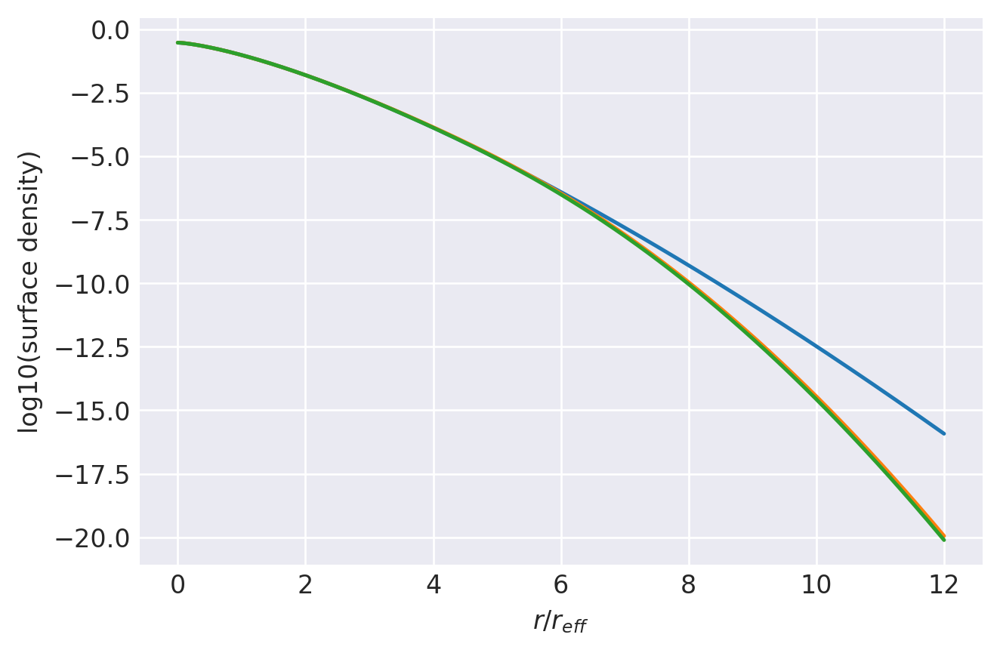

n=0.72: (
    normalize(np.array([1.1480505853e-01, 4.1910670741e-01, 3.2105449407e-01, 1.1174507134e-01, 2.7042127952e-02, 5.3364568378e-03, 8.2958466412e-04, 8.0499187063e-05])),
    np.array([1.5461383952e+00, 1.2046239181e+00, 8.9376979342e-01, 6.2446781488e-01, 4.1062102819e-01, 2.5200099947e-01, 1.3977738002e-01, 6.3400552105e-02]),
),
1.0000000191858711 1.0000000192378395
prev.  chisq = -8.855214329639509
ws, re: (array([1.14805059e-01, 4.19106707e-01, 3.21054494e-01, 1.11745071e-01,
       2.70421280e-02, 5.33645684e-03, 8.29584664e-04, 8.04991871e-05]), array([1.5461384 , 1.20462392, 0.89376979, 0.62446781, 0.41062103,
       0.252001  , 0.13977738, 0.06340055]))
         Current function value: -12.704654
         Iterations: 57
         Function evaluations: 1966
         Gradient evaluations: 115
-12.704653912223211 [-2.00062234 -0.08377015  0.80260889  1.21460004  1.47104542  1.77585204
  2.33892712  0.18515899  0.07804782 -0.05021073 -0.20460138 -0.38581985
 -0.5975498  -

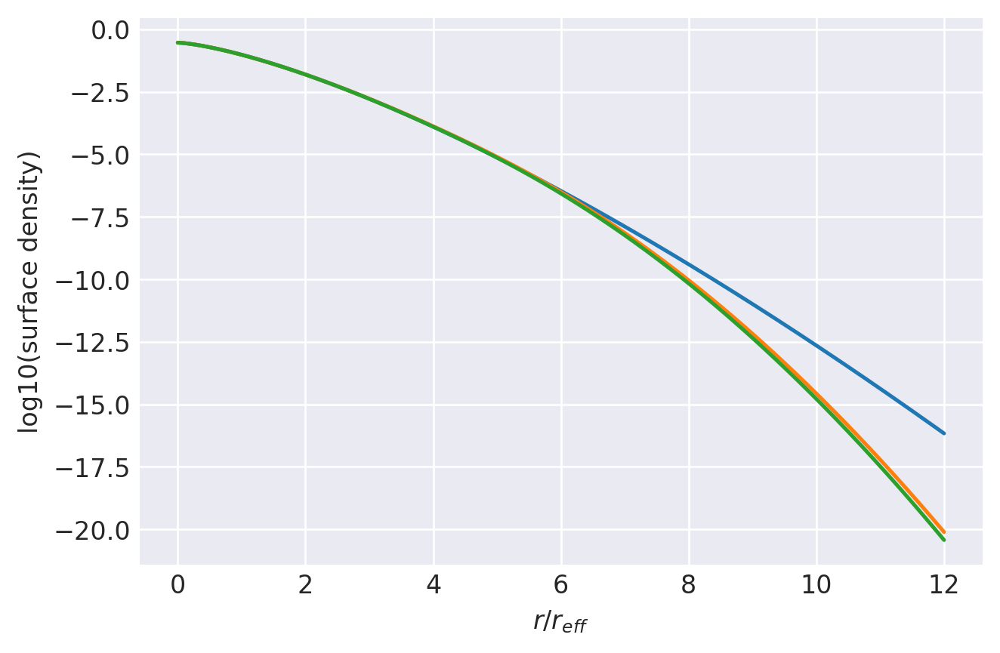

n=0.715: (
    normalize(np.array([1.1913759597e-01, 4.2199448941e-01, 3.1686310296e-01, 1.0950159467e-01, 2.6432143660e-02, 5.1918842924e-03, 8.0186441486e-04, 7.7324621190e-05])),
    np.array([1.5316480903e+00, 1.1968723096e+00, 8.9081859415e-01, 6.2430759694e-01, 4.1132030866e-01, 2.5260980269e-01, 1.4014972277e-01, 6.3635264754e-02]),
),
1.0000000190512297 1.0000000191066767
prev.  chisq = -8.849414238392173
ws, re: (array([1.19137596e-01, 4.21994489e-01, 3.16863103e-01, 1.09501595e-01,
       2.64321437e-02, 5.19188429e-03, 8.01864415e-04, 7.73246212e-05]), array([1.53164809, 1.19687231, 0.89081859, 0.6243076 , 0.41132031,
       0.2526098 , 0.14014972, 0.06363526]))
         Current function value: -12.752434
         Iterations: 49
         Function evaluations: 1745
         Gradient evaluations: 102
-12.752433509694324 [-1.96415885 -0.0469067   0.833851    1.23509372  1.48604074  1.78171178
  2.32919937  0.18137319  0.07502223 -0.05315671 -0.20789073 -0.38959465
 -0.60177919 

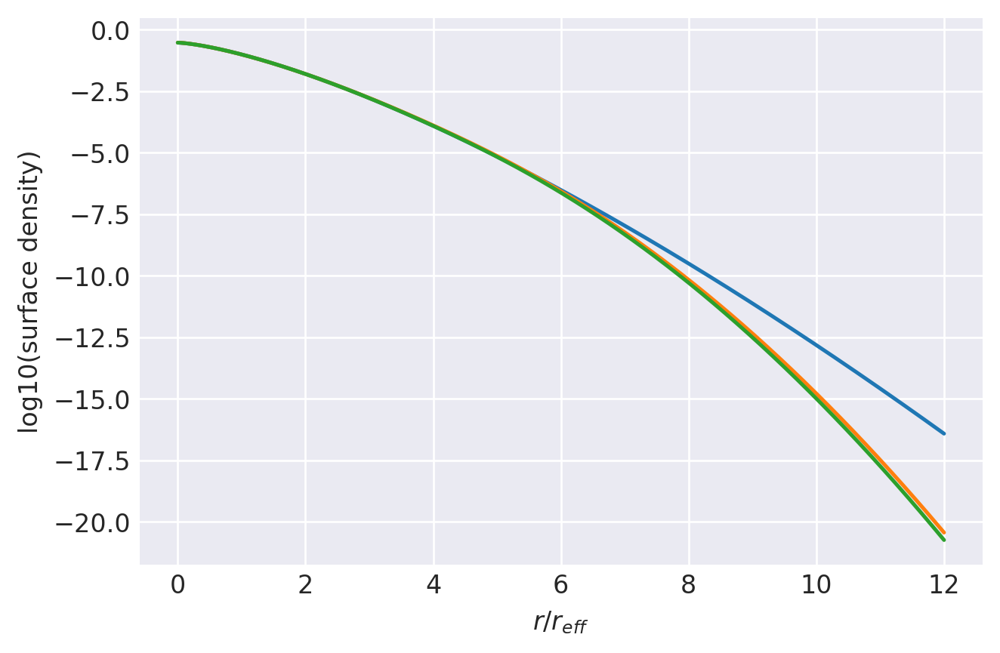

n=0.71: (
    normalize(np.array([1.2301766942e-01, 4.2820896393e-01, 3.1287069411e-01, 1.0528500320e-01, 2.4968196974e-02, 4.8354291996e-03, 7.4181036586e-04, 7.2232802591e-05])),
    np.array([1.5183545428e+00, 1.1885630512e+00, 8.8479628683e-01, 6.1959695114e-01, 4.0776068481e-01, 2.5016169561e-01, 1.3900549496e-01, 6.3386651622e-02]),
),
1.000000018917862 1.0000000189775258
prev.  chisq = -8.84334234993595
ws, re: (array([1.23017669e-01, 4.28208964e-01, 3.12870694e-01, 1.05285003e-01,
       2.49681970e-02, 4.83542920e-03, 7.41810366e-04, 7.22328026e-05]), array([1.51835454, 1.18856305, 0.88479629, 0.61959695, 0.40776068,
       0.2501617 , 0.13900549, 0.06338665]))
         Current function value: -12.793444
         Iterations: 49
         Function evaluations: 1933
         Gradient evaluations: 113
-12.79344365774878 [-2.00326953 -0.07074573  0.82435248  1.22988238  1.47585762  1.777229
  2.34346926  0.17967243  0.07588383 -0.04984814 -0.20254448 -0.38222424
 -0.59222849 -0.846

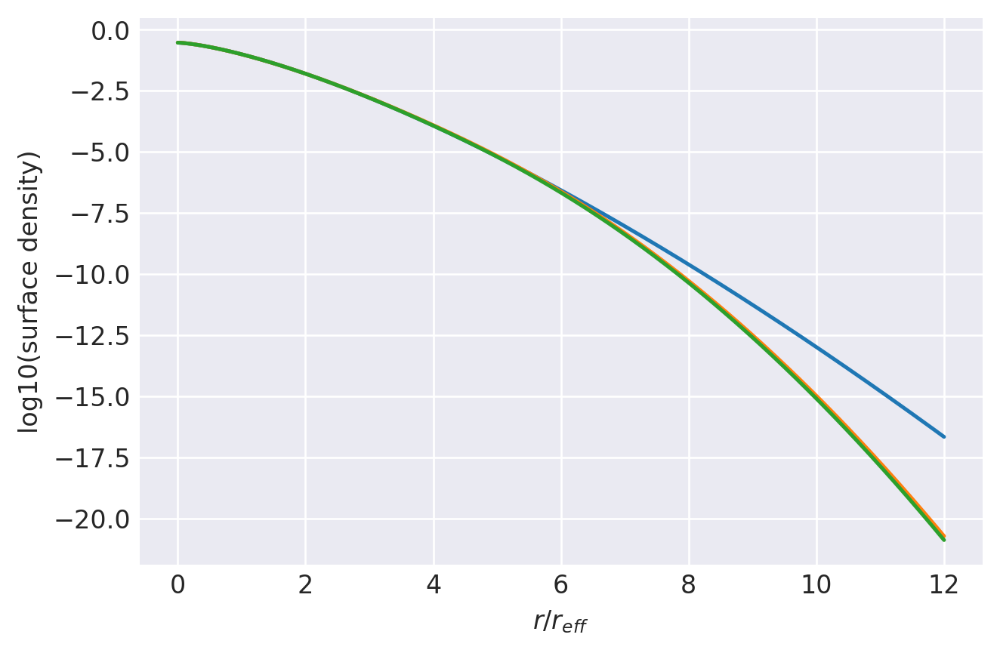

n=0.7050000000000001: (
    normalize(np.array([1.1886006954e-01, 4.2499223904e-01, 3.1709538718e-01, 1.0759839326e-01, 2.5601787660e-02, 5.0056392285e-03, 7.7234369868e-04, 7.4140385326e-05])),
    np.array([1.5124200602e+00, 1.1909233935e+00, 8.9156263955e-01, 6.2727144441e-01, 4.1473984317e-01, 2.5572401186e-01, 1.4235320956e-01, 6.4805197004e-02]),
),
1.0000000187857572 1.0000000188470302
prev.  chisq = -8.837035796514835
ws, re: (array([1.18860070e-01, 4.24992239e-01, 3.17095387e-01, 1.07598393e-01,
       2.56017877e-02, 5.00563923e-03, 7.72343699e-04, 7.41403853e-05]), array([1.51242006, 1.19092339, 0.89156264, 0.62727144, 0.41473984,
       0.25572401, 0.14235321, 0.0648052 ]))
         Current function value: -12.836196
         Iterations: 55
         Function evaluations: 2885
         Gradient evaluations: 169
-12.836195926284544 [-2.02634642 -0.06510956  0.84653004  1.25470345  1.4953514   1.78959463
  2.34956749  0.1776053   0.07539544 -0.04957865 -0.20252672 -0.38304653


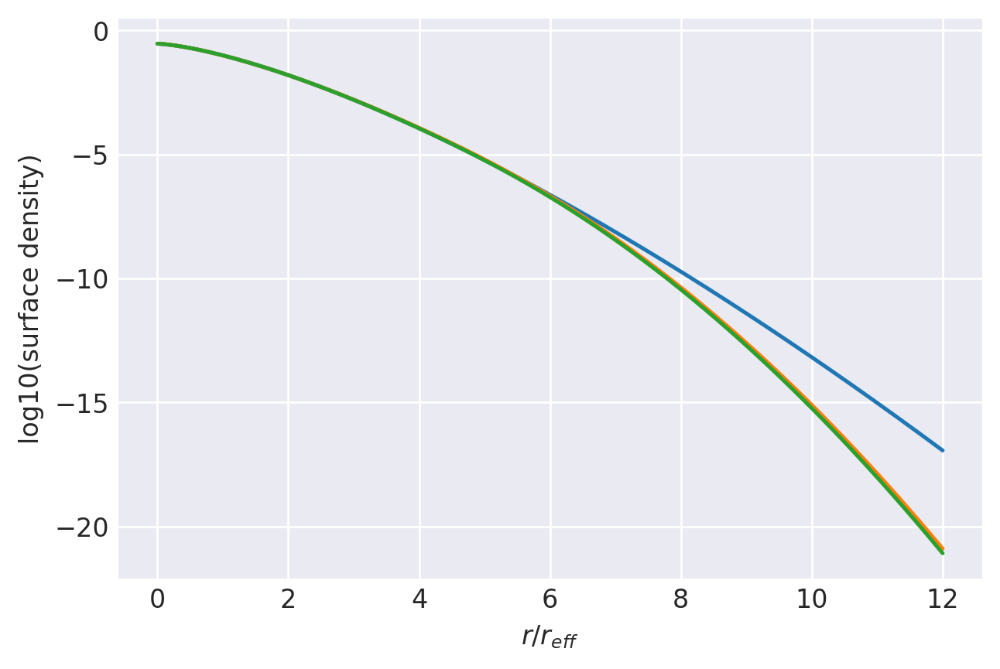

n=0.7: (
    normalize(np.array([1.1646435020e-01, 4.2739124945e-01, 3.1922751878e-01, 1.0653680383e-01, 2.4816881868e-02, 4.7669777519e-03, 7.2686739303e-04, 6.9350722705e-05])),
    np.array([1.5052384522e+00, 1.1895849021e+00, 8.9211604870e-01, 6.2729710480e-01, 4.1395531956e-01, 2.5476146085e-01, 1.4180217436e-01, 6.4647551382e-02]),
),
1.0000000186549063 1.000000018719022
prev.  chisq = -8.830988772973056
ws, re: (array([1.16464350e-01, 4.27391249e-01, 3.19227519e-01, 1.06536804e-01,
       2.48168819e-02, 4.76697775e-03, 7.26867393e-04, 6.93507227e-05]), array([1.50523845, 1.1895849 , 0.89211605, 0.6272971 , 0.41395532,
       0.25476146, 0.14180217, 0.06464755]))
         Current function value: -12.888752
         Iterations: 54
         Function evaluations: 1796
         Gradient evaluations: 105
-12.88875176507495 [-1.98520698 -0.0426835   0.85037311  1.24717305  1.48966051  1.79066706
  2.35032777  0.17353484  0.07268964 -0.05073346 -0.20172611 -0.380253
 -0.58969788 -0.843

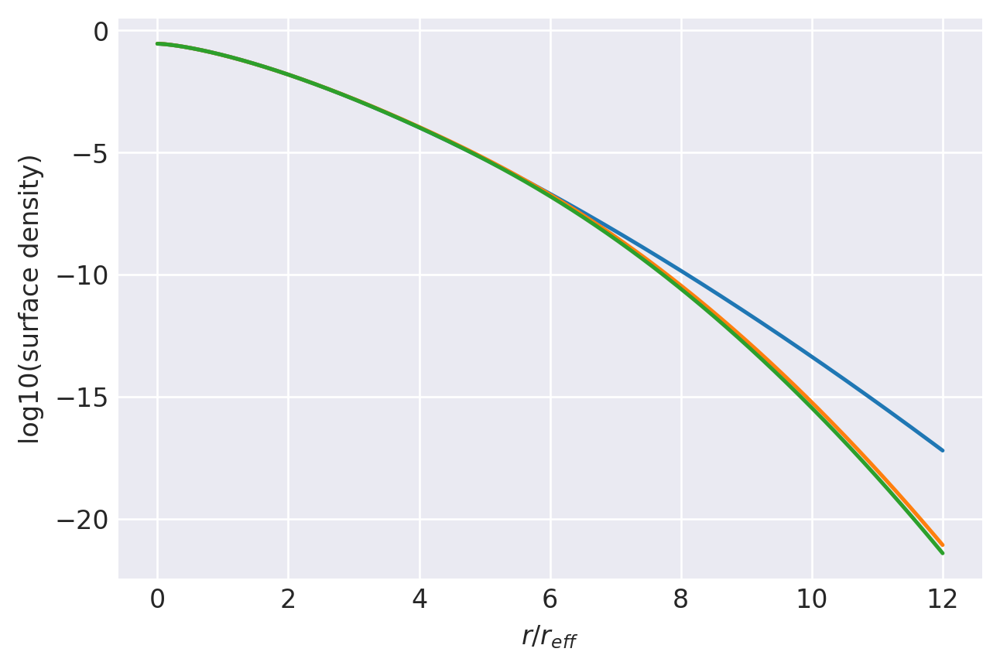

n=0.6950000000000001: (
    normalize(np.array([1.2076486484e-01, 4.3023678247e-01, 3.1458863276e-01, 1.0441083045e-01, 2.4479913142e-02, 4.7298126230e-03, 7.2047513089e-04, 6.8688591910e-05])),
    np.array([1.4911963653e+00, 1.1821964262e+00, 8.8974702402e-01, 6.2845456631e-01, 4.1662660699e-01, 2.5721844957e-01, 1.4339831189e-01, 6.5541865144e-02]),
),
1.0000000185253002 1.000000018591421
prev.  chisq = -8.82479611693309
ws, re: (array([1.20764865e-01, 4.30236782e-01, 3.14588633e-01, 1.04410830e-01,
       2.44799131e-02, 4.72981262e-03, 7.20475131e-04, 6.86885919e-05]), array([1.49119637, 1.18219643, 0.88974702, 0.62845457, 0.41662661,
       0.25721845, 0.14339831, 0.06554187]))
         Current function value: -12.949850
         Iterations: 60
         Function evaluations: 2340
         Gradient evaluations: 137
-12.949850481022173 [-1.86860899  0.04705702  0.91062778  1.27934634  1.50286528  1.79100389
  2.3517394   0.16750764  0.06614099 -0.05876187 -0.21155672 -0.39140447
 -

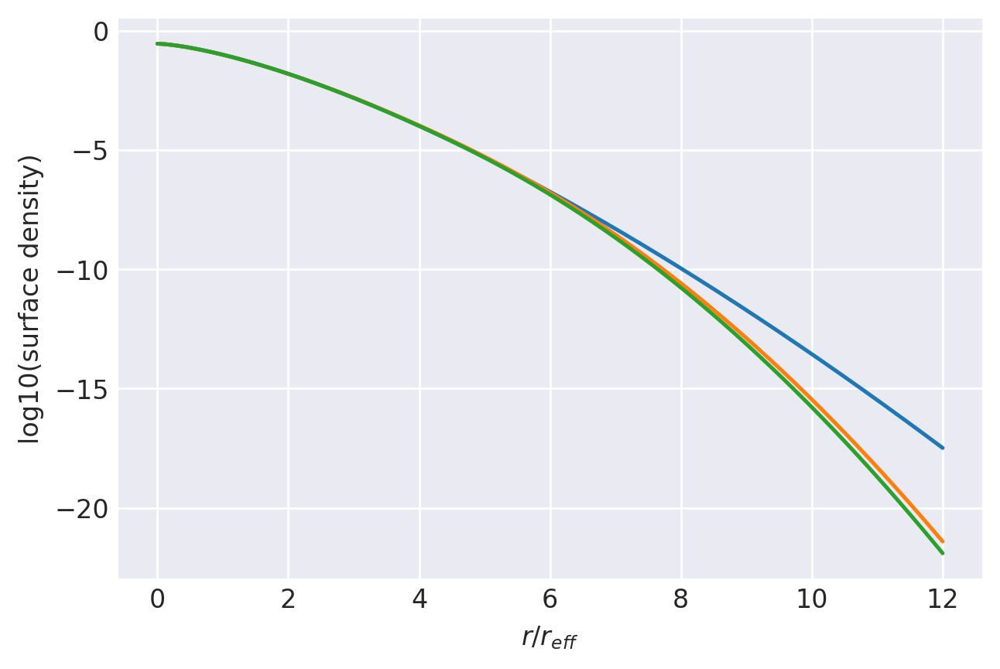

n=0.69: (
    normalize(np.array([1.3370275577e-01, 4.4333808357e-01, 3.0162427747e-01, 9.4924949088e-02, 2.1603363948e-02, 4.1194724570e-03, 6.2736993586e-04, 5.9727764463e-05])),
    np.array([1.4706442737e+00, 1.1645040148e+00, 8.7345015979e-01, 6.1438878319e-01, 4.0606497740e-01, 2.5050182785e-01, 1.3987649033e-01, 6.3973681257e-02]),
),
1.0000000183969289 1.0000000184681144
prev.  chisq = -8.818557554738762
ws, re: (array([1.33702756e-01, 4.43338084e-01, 3.01624277e-01, 9.49249491e-02,
       2.16033639e-02, 4.11947246e-03, 6.27369936e-04, 5.97277645e-05]), array([1.47064427, 1.16450401, 0.87345016, 0.61438878, 0.40606498,
       0.25050183, 0.13987649, 0.06397368]))
         Current function value: -12.985932
         Iterations: 73
         Function evaluations: 2323
         Gradient evaluations: 136
-12.985932451499313 [-1.77633165  0.10467945  0.93160332  1.27728086  1.50009819  1.79543918
  2.35581736  0.16207712  0.06111537 -0.06335686 -0.2150466  -0.39346138
 -0.60240778 -

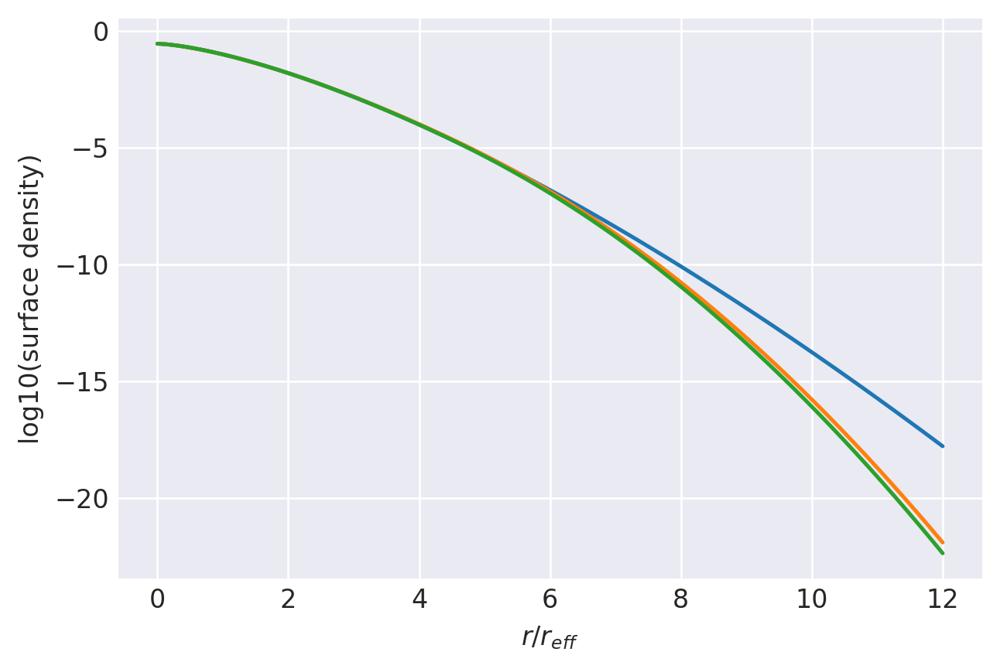

n=0.685: (
    normalize(np.array([1.4475669191e-01, 4.4998283778e-01, 2.9073404439e-01, 8.9558126281e-02, 2.0413810149e-02, 3.9058975922e-03, 5.9242093508e-04, 5.6170968999e-05])),
    np.array([1.4523694996e+00, 1.1511061295e+00, 8.6425746374e-01, 6.0947149707e-01, 4.0414630986e-01, 2.4979987587e-01, 1.3955541299e-01, 6.3889998948e-02]),
),
1.0000000182697837 1.000000018344037
prev.  chisq = -8.812297788280258
ws, re: (array([1.44756692e-01, 4.49982838e-01, 2.90734044e-01, 8.95581263e-02,
       2.04138101e-02, 3.90589759e-03, 5.92420935e-04, 5.61709690e-05]), array([1.4523695 , 1.15110613, 0.86425746, 0.6094715 , 0.40414631,
       0.24979988, 0.13955541, 0.06389   ]))
         Current function value: -13.028391
         Iterations: 76
         Function evaluations: 2408
         Gradient evaluations: 141
-13.028390752531925 [-1.7240286   0.14773927  0.96135522  1.29431818  1.50998891  1.80207147
  2.36264995  0.15783907  0.0576803  -0.06655713 -0.21836214 -0.39695935
 -0.60597132 -

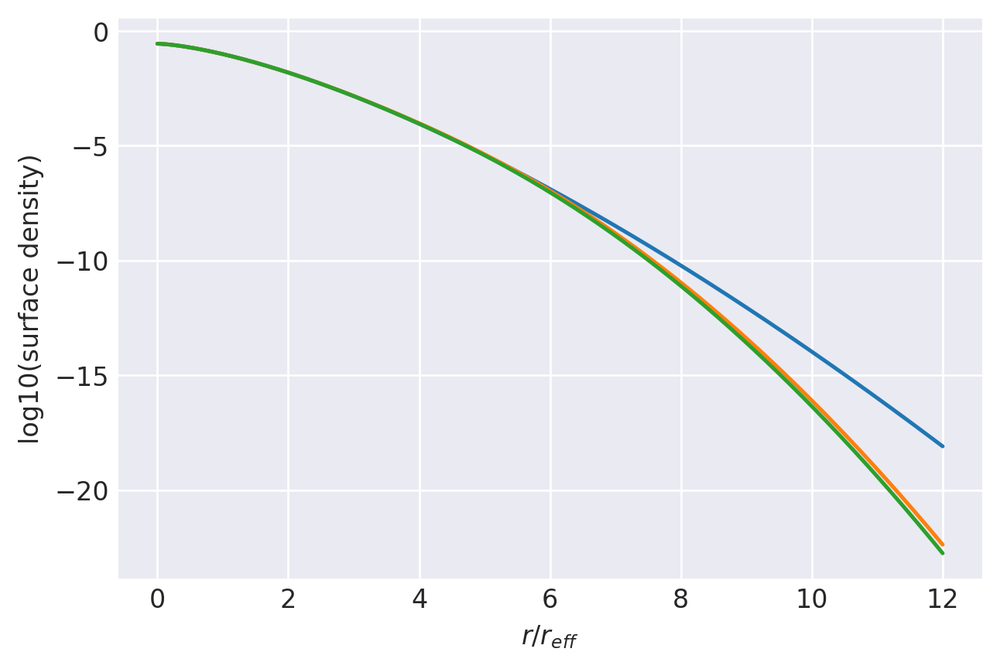

n=0.6799999999999999: (
    normalize(np.array([1.5135298180e-01, 4.5561124322e-01, 2.8431935229e-01, 8.5329040228e-02, 1.9155659270e-02, 3.6325150210e-03, 5.4763699943e-04, 5.1571165466e-05])),
    np.array([1.4382655084e+00, 1.1420373387e+00, 8.5791225496e-01, 6.0483631462e-01, 4.0090423760e-01, 2.4775856520e-01, 1.3843647123e-01, 6.3410095798e-02]),
),
1.000000018143855 1.000000018221145
prev.  chisq = -8.805933772178921
ws, re: (array([1.51352982e-01, 4.55611243e-01, 2.84319352e-01, 8.53290402e-02,
       1.91556593e-02, 3.63251502e-03, 5.47636999e-04, 5.15711655e-05]), array([1.43826551, 1.14203734, 0.85791225, 0.60483631, 0.40090424,
       0.24775857, 0.13843647, 0.0634101 ]))
         Current function value: -13.070890
         Iterations: 83
         Function evaluations: 3548
         Gradient evaluations: 208
-13.07089014112325 [-1.67200274  0.19699351  1.00559505  1.3278011   1.52961503  1.81070347
  2.36660837  0.15364736  0.05415821 -0.07045487 -0.22368394 -0.4038765
 -0.

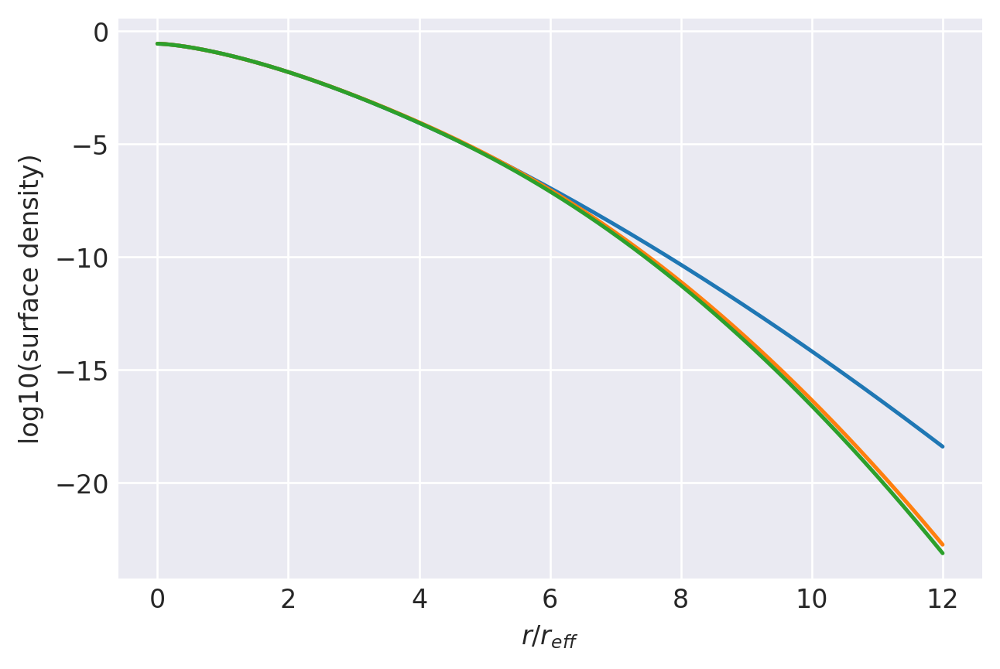

n=0.675: (
    normalize(np.array([1.5815734405e-01, 4.6224715644e-01, 2.7792358163e-01, 8.0369279922e-02, 1.7509702882e-02, 3.2598261942e-03, 4.8739230734e-04, 4.5716577938e-05])),
    np.array([1.4244504780e+00, 1.1328129503e+00, 8.5024704865e-01, 5.9746993907e-01, 3.9456949250e-01, 2.4334081839e-01, 1.3595208520e-01, 6.2371587062e-02]),
),
1.0000000180191344 1.0000000180996294
prev.  chisq = -8.799550400557374
ws, re: (array([1.58157344e-01, 4.62247156e-01, 2.77923582e-01, 8.03692799e-02,
       1.75097029e-02, 3.25982619e-03, 4.87392307e-04, 4.57165779e-05]), array([1.42445048, 1.13281295, 0.85024705, 0.59746994, 0.39456949,
       0.24334082, 0.13595209, 0.06237159]))
         Current function value: -13.138898
         Iterations: 73
         Function evaluations: 2324
         Gradient evaluations: 136
-13.138898283468947 [-1.68305592  0.1915424   0.99549805  1.31064164  1.51655838  1.80802754
  2.36952699  0.15109525  0.05385313 -0.06831945 -0.21865542 -0.39585826
 -0.60358767 

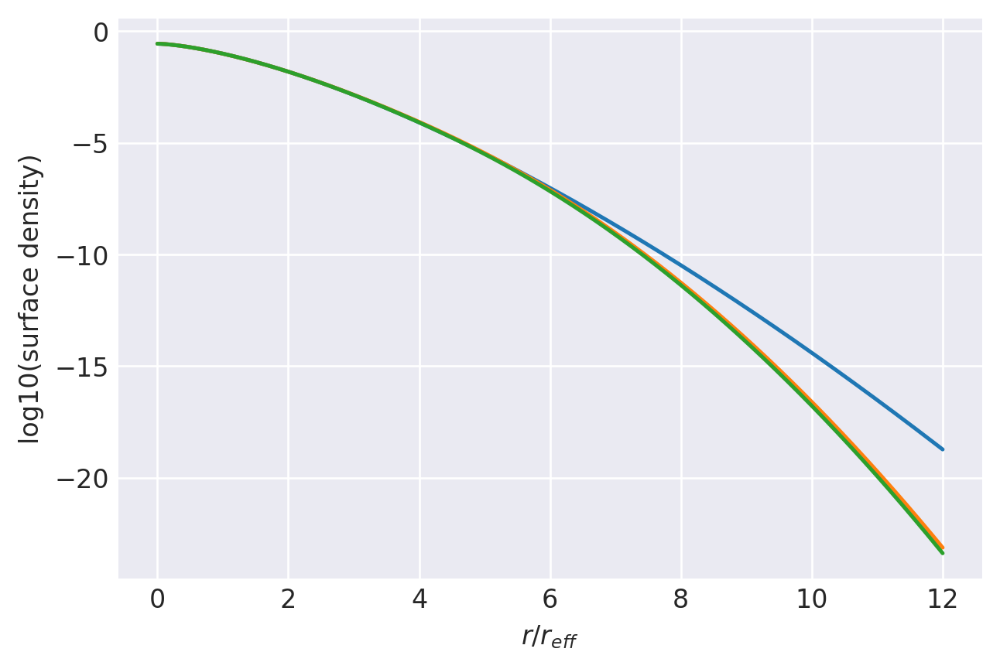

n=0.6699999999999999: (
    normalize(np.array([1.5669123798e-01, 4.6191371491e-01, 2.7848418315e-01, 8.1054706650e-02, 1.7922729259e-02, 3.3792997502e-03, 5.0673585309e-04, 4.7392447440e-05])),
    np.array([1.4161043348e+00, 1.1320174713e+00, 8.5443799944e-01, 6.0442800413e-01, 4.0192196089e-01, 2.4912214160e-01, 1.3955315128e-01, 6.4113201571e-02]),
),
1.000000017895612 1.0000000179764772
prev.  chisq = -8.79312328824948
ws, re: (array([1.56691238e-01, 4.61913715e-01, 2.78484183e-01, 8.10547067e-02,
       1.79227293e-02, 3.37929975e-03, 5.06735853e-04, 4.73924474e-05]), array([1.41610433, 1.13201747, 0.854438  , 0.604428  , 0.40192196,
       0.24912214, 0.13955315, 0.0641132 ]))
         Current function value: -13.194896
         Iterations: 64
         Function evaluations: 2205
         Gradient evaluations: 129
-13.194896460247325 [-1.65604261  0.21880749  1.01792387  1.32638457  1.53200923  1.81969191
  2.37949596  0.14753402  0.05166527 -0.06967981 -0.21972478 -0.39711585
 -

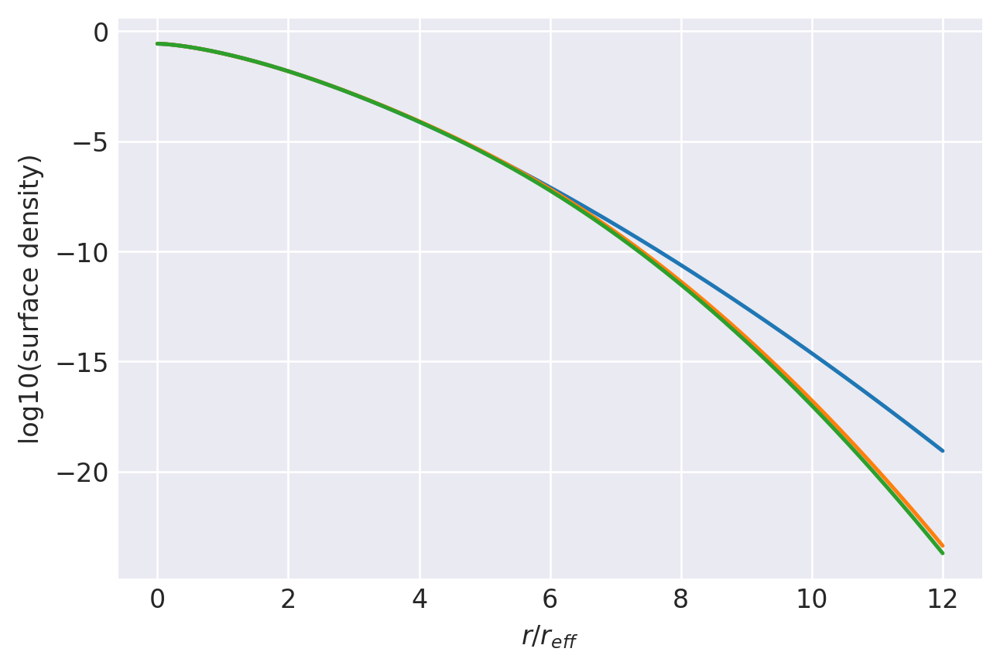

n=0.665: (
    normalize(np.array([1.6029394514e-01, 4.6560413158e-01, 2.7480330078e-01, 7.8469939247e-02, 1.7127428265e-02, 3.1850378132e-03, 4.7246793586e-04, 4.3749225933e-05])),
    np.array([1.4045397100e+00, 1.1263290047e+00, 8.5176579080e-01, 6.0294156609e-01, 4.0075980161e-01, 2.4806856288e-01, 1.3888896103e-01, 6.3778967964e-02]),
),
1.0000000177732802 1.0000000178563915
prev.  chisq = -8.786577595208845
ws, re: (array([1.60293945e-01, 4.65604132e-01, 2.74803301e-01, 7.84699392e-02,
       1.71274283e-02, 3.18503781e-03, 4.72467936e-04, 4.37492259e-05]), array([1.40453971, 1.126329  , 0.85176579, 0.60294157, 0.4007598 ,
       0.24806856, 0.13888896, 0.06377897]))
         Current function value: -13.206225
         Iterations: 89
         Function evaluations: 2766
         Gradient evaluations: 162
-13.20622459115982 [-1.5508858   0.30695544  1.07955717  1.35601181  1.53598182  1.81541249
  2.3779018   0.1420052   0.0458011  -0.07722513 -0.22942512 -0.40791523
 -0.61580383 -

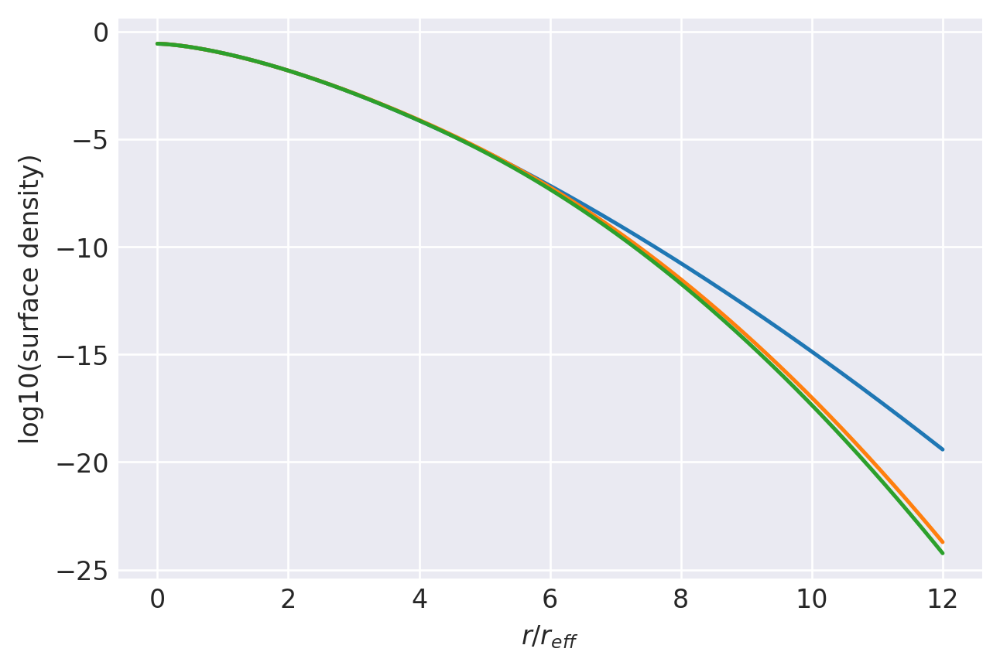

n=0.6599999999999999: (
    normalize(np.array([1.7495836805e-01, 4.7534109054e-01, 2.6102004180e-01, 7.0510818366e-02, 1.4951464412e-02, 2.7677139481e-03, 4.1226717645e-04, 3.8235707351e-05])),
    np.array([1.3867724247e+00, 1.1112226979e+00, 8.3709524056e-01, 5.8962362730e-01, 3.9091719053e-01, 2.4221228746e-01, 1.3588840170e-01, 6.2558069060e-02]),
),
1.000000017652129 1.0000000177381159
prev.  chisq = -8.779955891631069
ws, re: (array([1.74958368e-01, 4.75341091e-01, 2.61020042e-01, 7.05108184e-02,
       1.49514644e-02, 2.76771395e-03, 4.12267176e-04, 3.82357074e-05]), array([1.38677242, 1.1112227 , 0.83709524, 0.58962363, 0.39091719,
       0.24221229, 0.1358884 , 0.06255807]))
         Current function value: -13.192276
         Iterations: 65
         Function evaluations: 2664
         Gradient evaluations: 156
-13.192275549358776 [-1.46523388  0.37457205  1.11235144  1.35524201  1.52612598  1.81210289
  2.37904966  0.13698863  0.04101667 -0.08241367 -0.23435877 -0.41143298
 

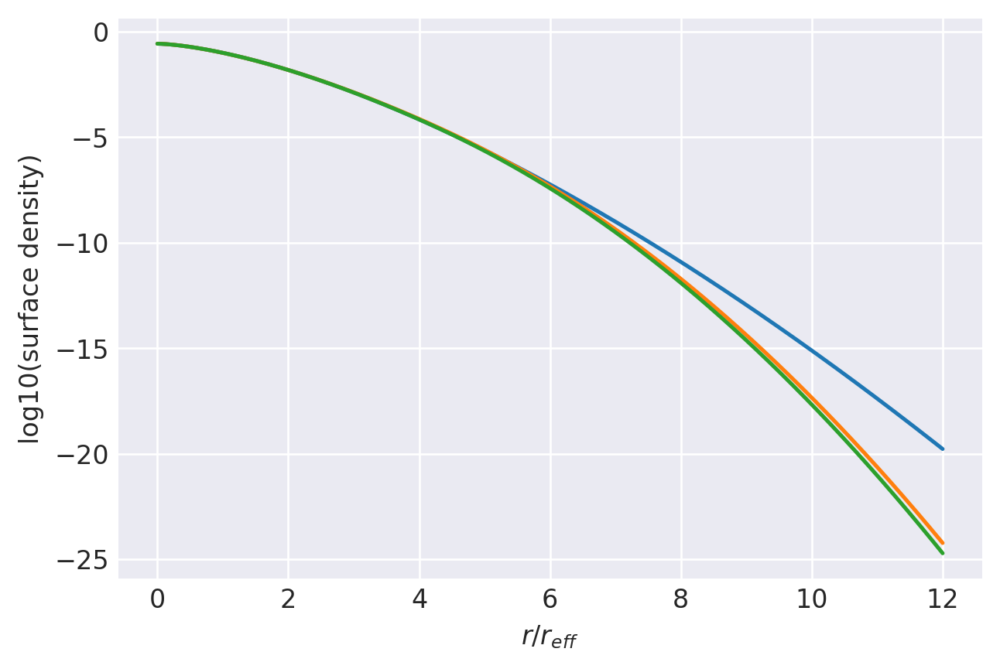

n=0.655: (
    normalize(np.array([1.8766812192e-01, 4.8135804450e-01, 2.4908006190e-01, 6.5104345546e-02, 1.3791485910e-02, 2.5770768931e-03, 3.8518073847e-04, 3.5682594341e-05])),
    np.array([1.3708458689e+00, 1.0990480345e+00, 8.2715391196e-01, 5.8296331500e-01, 3.8776358262e-01, 2.4108486299e-01, 1.3554294495e-01, 6.2495947057e-02]),
),
1.0000000175321508 1.0000000176197903
prev.  chisq = -8.773501785470717
ws, re: (array([1.87668122e-01, 4.81358044e-01, 2.49080062e-01, 6.51043455e-02,
       1.37914859e-02, 2.57707689e-03, 3.85180738e-04, 3.56825943e-05]), array([1.37084587, 1.09904803, 0.82715391, 0.58296331, 0.38776358,
       0.24108486, 0.13554294, 0.06249595]))
         Current function value: -13.272247
         Iterations: 81
         Function evaluations: 3072
         Gradient evaluations: 180
-13.272247126782096 [-1.45624527  0.38719533  1.12524614  1.37724392  1.57349117  1.86166418
  2.40406768  0.13390675  0.03988754 -0.08194931 -0.23318908 -0.41174118
 -0.62228299 

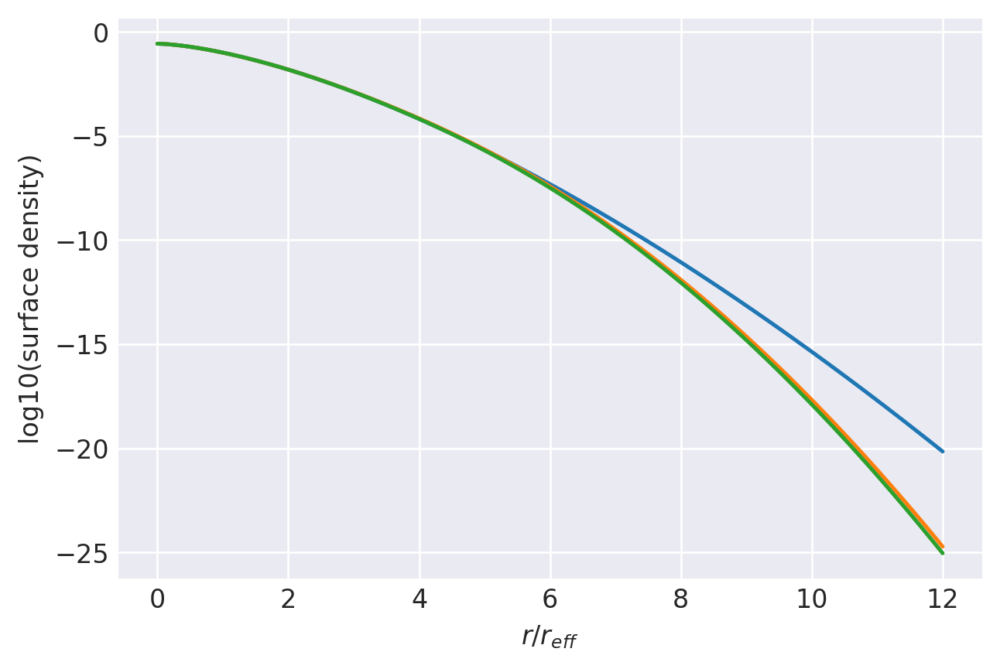

n=0.6499999999999999: (
    normalize(np.array([1.8904227379e-01, 4.8301238206e-01, 2.4758578905e-01, 6.4170961711e-02, 1.3408699996e-02, 2.4059721654e-03, 3.4293697420e-04, 3.0984249648e-05])),
    np.array([1.3611523811e+00, 1.0961942930e+00, 8.2803881014e-01, 5.8453553420e-01, 3.8748850016e-01, 2.3862558896e-01, 1.3304789179e-01, 6.1208927233e-02]),
),
1.000000017413337 1.0000000175034225
prev.  chisq = -8.766783674362541
ws, re: (array([1.89042274e-01, 4.83012382e-01, 2.47585789e-01, 6.41709617e-02,
       1.34087000e-02, 2.40597217e-03, 3.42936974e-04, 3.09842496e-05]), array([1.36115238, 1.09619429, 0.82803881, 0.58453553, 0.3874885 ,
       0.23862559, 0.13304789, 0.06120893]))
         Current function value: -13.441168
         Iterations: 51
         Function evaluations: 2511
         Gradient evaluations: 147
-13.441167719356537 [-1.54627025  0.33905279  1.13275655  1.41302751  1.57585777  1.84011668
  2.3918811   0.13317953  0.04299054 -0.07561718 -0.22649431 -0.40575153
 

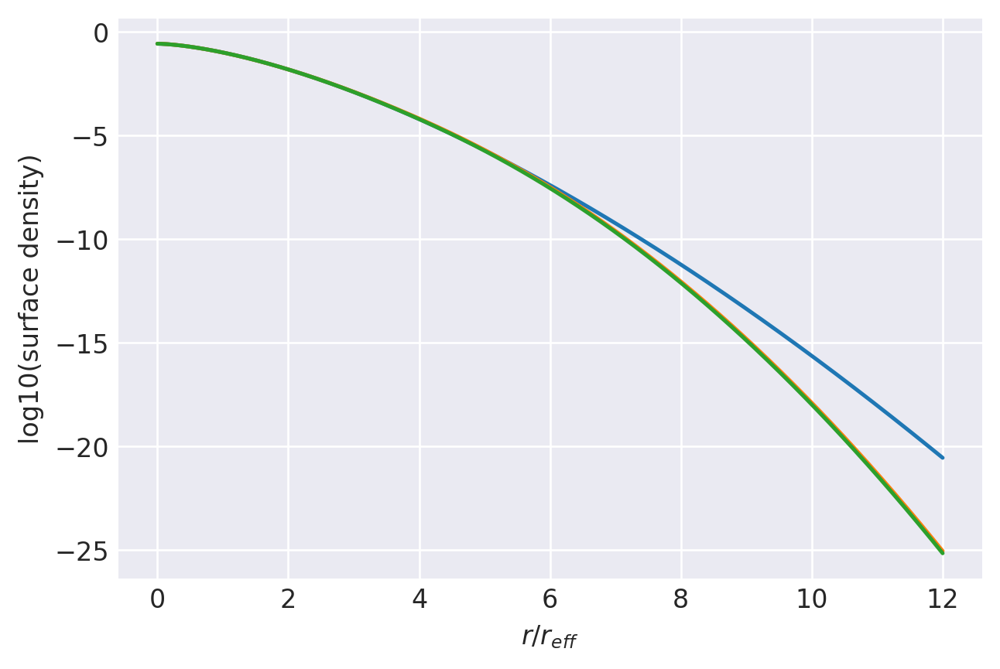

n=0.645: (
    normalize(np.array([1.7562561222e-01, 4.8140200997e-01, 2.5940621535e-01, 6.7207503046e-02, 1.3555064535e-02, 2.4193972614e-03, 3.5200419818e-04, 3.2193417439e-05])),
    np.array([1.3588750576e+00, 1.1040545756e+00, 8.4020028233e-01, 5.9361612695e-01, 3.9286963910e-01, 2.4317688974e-01, 1.3659170400e-01, 6.3163704103e-02]),
),
1.0000000172956791 1.0000000173850943
prev.  chisq = -8.760028650991488
ws, re: (array([1.75625612e-01, 4.81402010e-01, 2.59406215e-01, 6.72075030e-02,
       1.35550645e-02, 2.41939726e-03, 3.52004198e-04, 3.21934174e-05]), array([1.35887506, 1.10405458, 0.84020028, 0.59361613, 0.39286964,
       0.24317689, 0.1365917 , 0.0631637 ]))
         Current function value: -13.414210
         Iterations: 76
         Function evaluations: 2290
         Gradient evaluations: 134
-13.414209881883473 [-1.49202604  0.34359524  1.06806062  1.31905577  1.50954755  1.79082684
  2.36253147  0.12877274  0.04064275 -0.07365805 -0.21615462 -0.38581566
 -0.58666552 

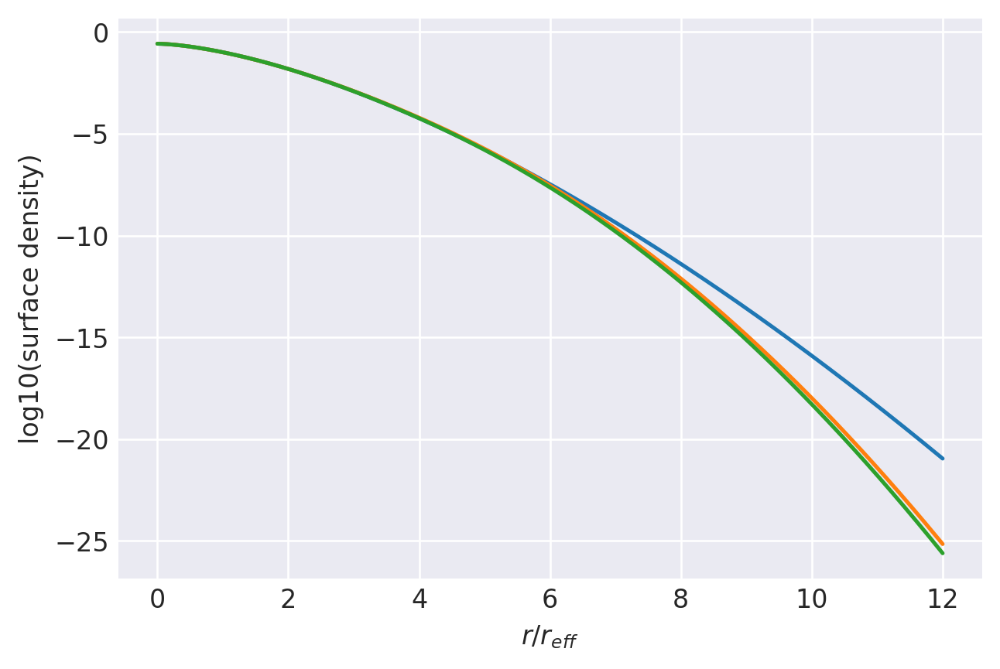

n=0.64: (
    normalize(np.array([1.8361782533e-01, 4.7763548067e-01, 2.5210474898e-01, 6.8362623268e-02, 1.4970657458e-02, 2.8356199883e-03, 4.3232708650e-04, 4.0717214946e-05])),
    np.array([1.3451562707e+00, 1.0981021589e+00, 8.4399903395e-01, 6.0791852711e-01, 4.1132427036e-01, 2.5902070436e-01, 1.4762918606e-01, 6.8897509695e-02]),
),
1.0000000171791692 1.0000000172657588
prev.  chisq = -8.753338663966725
ws, re: (array([1.83617825e-01, 4.77635481e-01, 2.52104749e-01, 6.83626233e-02,
       1.49706575e-02, 2.83561999e-03, 4.32327087e-04, 4.07172149e-05]), array([1.34515627, 1.09810216, 0.84399903, 0.60791853, 0.41132427,
       0.2590207 , 0.14762919, 0.06889751]))
         Current function value: -13.473942
         Iterations: 79
         Function evaluations: 3871
         Gradient evaluations: 227
-13.473941815011523 [-1.38593448  0.45442138  1.16196202  1.36742135  1.52861973  1.81887792
  2.39537123  0.12346971  0.03469069 -0.08287565 -0.22989493 -0.40244522
 -0.60524549 -

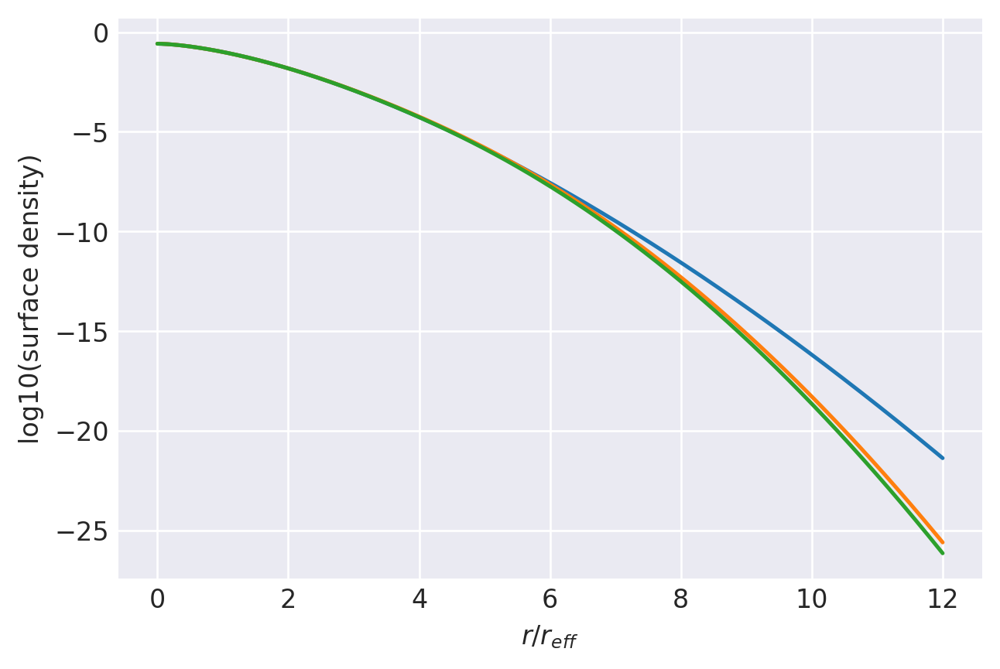

n=0.635: (
    normalize(np.array([2.0005758689e-01, 4.8931672805e-01, 2.3660018029e-01, 5.8995604244e-02, 1.2351636499e-02, 2.3044625462e-03, 3.4257920264e-04, 3.1222270929e-05])),
    np.array([1.3288308689e+00, 1.0831551962e+00, 8.2627450627e-01, 5.8898613059e-01, 3.9587199430e-01, 2.4817298783e-01, 1.4047300986e-01, 6.5180692745e-02]),
),
1.0000000170637993 1.0000000171542633
prev.  chisq = -8.746542212093937
ws, re: (array([2.00057587e-01, 4.89316728e-01, 2.36600180e-01, 5.89956042e-02,
       1.23516365e-02, 2.30446255e-03, 3.42579203e-04, 3.12222709e-05]), array([1.32883087, 1.0831552 , 0.82627451, 0.58898613, 0.39587199,
       0.24817299, 0.14047301, 0.06518069]))
         Current function value: -13.504208
         Iterations: 62
         Function evaluations: 2936
         Gradient evaluations: 172
-13.504208221644305 [-1.32824675  0.50213724  1.19243749  1.38997276  1.5669685   1.87732701
  2.42054971  0.11917983  0.0315275  -0.08563815 -0.23289762 -0.40684435
 -0.61342385 

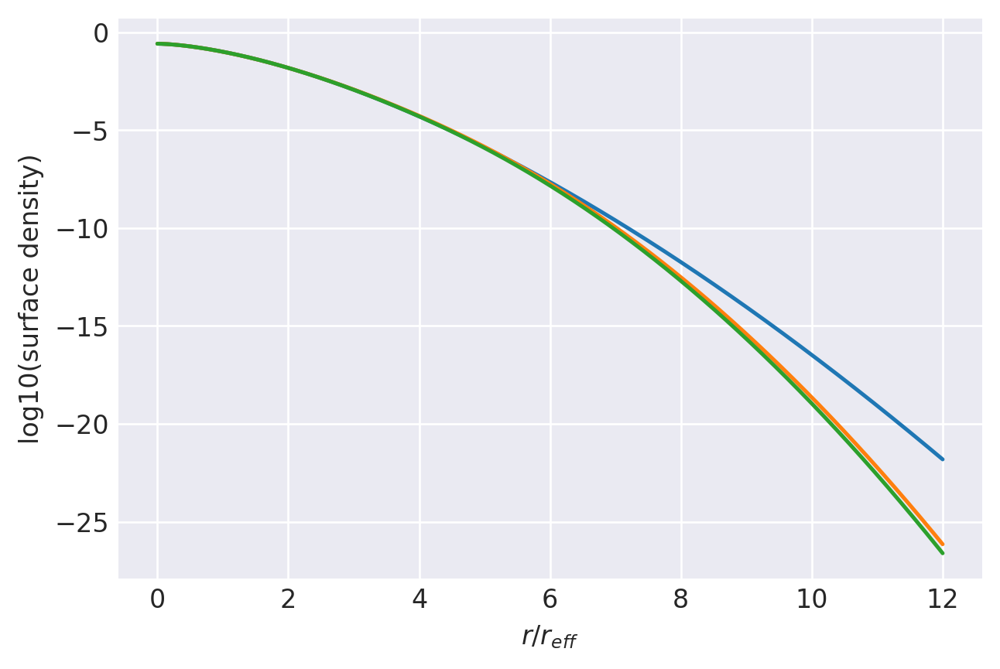

n=0.63: (
    normalize(np.array([2.0944952182e-01, 4.9248247874e-01, 2.2867083136e-01, 5.5558532653e-02, 1.1449409063e-02, 2.0721851062e-03, 2.9116465766e-04, 2.5876603852e-05])),
    np.array([1.3157695420e+00, 1.0752946874e+00, 8.2103533120e-01, 5.8492796113e-01, 3.9188230429e-01, 2.4354327968e-01, 1.3627403340e-01, 6.2798080276e-02]),
),
1.0000000169495604 1.0000000170434744
prev.  chisq = -8.739678723372382
ws, re: (array([2.09449522e-01, 4.92482479e-01, 2.28670831e-01, 5.55585327e-02,
       1.14494091e-02, 2.07218511e-03, 2.91164658e-04, 2.58766039e-05]), array([1.31576954, 1.07529469, 0.82103533, 0.58492796, 0.3918823 ,
       0.24354328, 0.13627403, 0.06279808]))
         Current function value: -13.304630
         Iterations: 57
         Function evaluations: 1762
         Gradient evaluations: 103
-13.30462987705841 [-1.22294888  0.55040281  1.1047411   1.20401858  1.47639167  1.85578365
  2.43628629  0.11377631  0.02688389 -0.08701316 -0.22184191 -0.38008667
 -0.57868637 -0

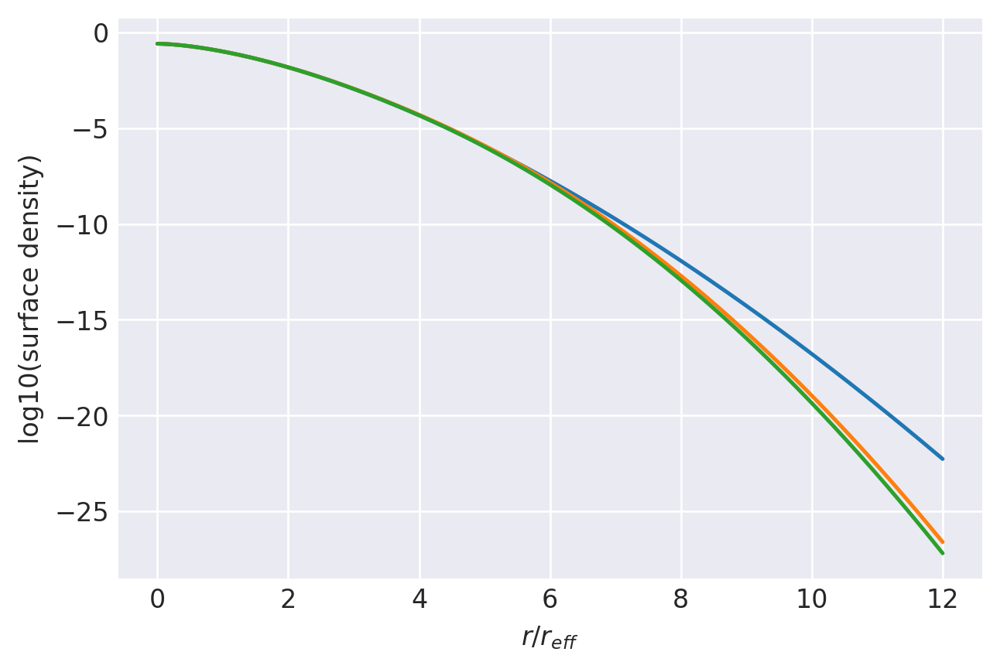

n=0.625: (
    normalize(np.array([2.2741791941e-01, 4.8999399115e-01, 2.1226530573e-01, 5.4095020415e-02, 1.3209836568e-02, 2.6099173419e-03, 3.7518616918e-04, 3.2823215881e-05])),
    np.array([1.2995000814e+00, 1.0638585462e+00, 8.1843999086e-01, 6.0000944516e-01, 4.1678619575e-01, 2.6382359156e-01, 1.4864247125e-01, 6.8737843402e-02]),
),
1.0000000168364453 1.00000001692756
prev.  chisq = -8.732481693835187
ws, re: (array([2.27417919e-01, 4.89993991e-01, 2.12265306e-01, 5.40950204e-02,
       1.32098366e-02, 2.60991734e-03, 3.75186169e-04, 3.28232159e-05]), array([1.29950008, 1.06385855, 0.81843999, 0.60000945, 0.4167862 ,
       0.26382359, 0.14864247, 0.06873784]))
         Current function value: -13.371058
         Iterations: 57
         Function evaluations: 2698
         Gradient evaluations: 158
-13.371058362458598 [-1.24120452  0.51376654  1.02770804  1.19765644  1.52592627  1.87904948
  2.43216036  0.11112834  0.02766038 -0.08044325 -0.20834566 -0.36639035
 -0.56697646 -0

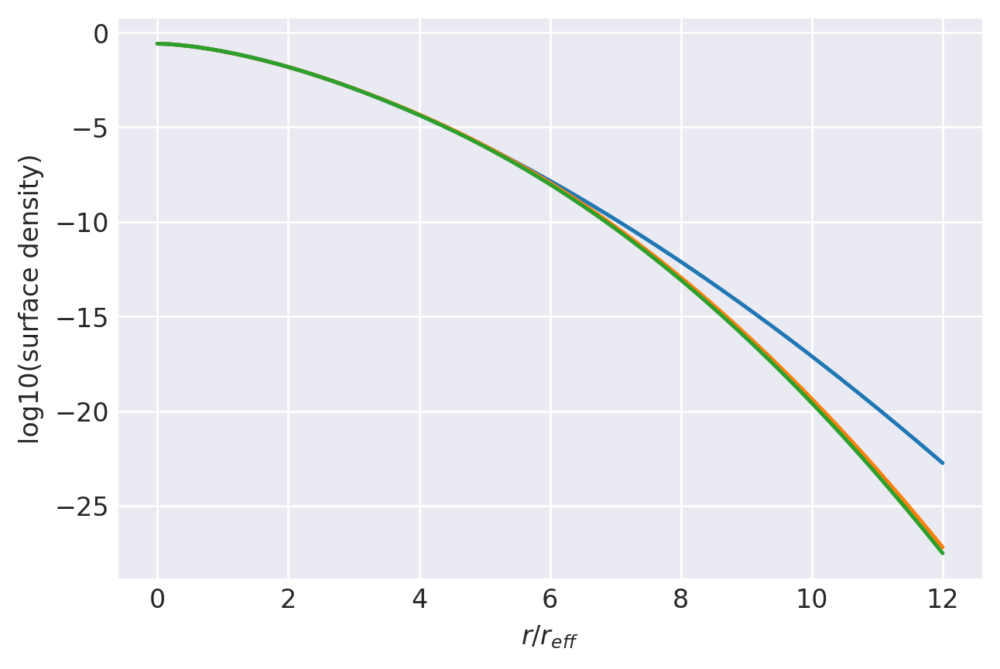

n=0.62: (
    normalize(np.array([2.2422639120e-01, 4.8539303256e-01, 2.1385696357e-01, 5.8778369625e-02, 1.4576111163e-02, 2.7492279588e-03, 3.8599544195e-04, 3.3908482469e-05])),
    np.array([1.2916009028e+00, 1.0657623621e+00, 8.3091529303e-01, 6.1894825069e-01, 4.3013981845e-01, 2.7103385323e-01, 1.5263101984e-01, 7.1099389623e-02]),
),
1.0000000167244474 1.0000000168147465
prev.  chisq = -8.725847573354057
ws, re: (array([2.24226391e-01, 4.85393033e-01, 2.13856964e-01, 5.87783696e-02,
       1.45761112e-02, 2.74922796e-03, 3.85995442e-04, 3.39084825e-05]), array([1.2916009 , 1.06576236, 0.83091529, 0.61894825, 0.43013982,
       0.27103385, 0.15263102, 0.07109939]))
         Current function value: -13.352050
         Iterations: 67
         Function evaluations: 2885
         Gradient evaluations: 169
-13.352050171310534 [-1.20221771  0.49714876  0.95641589  1.24158736  1.57699473  1.87579343
  2.42478782  0.10715225  0.02631868 -0.07618365 -0.19949713 -0.36036005
 -0.56253729 -

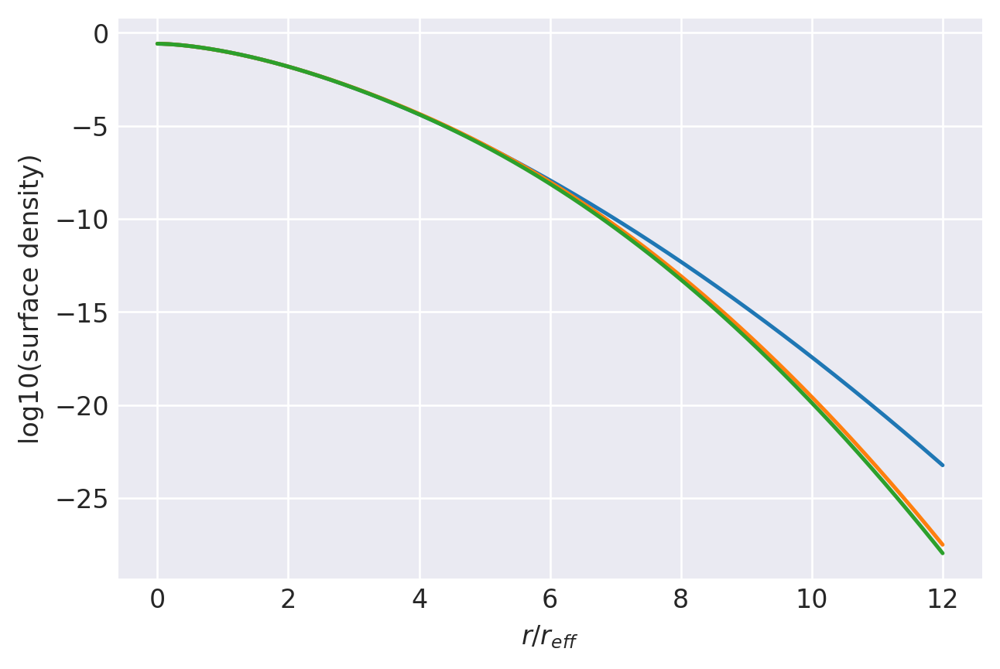

n=0.615: (
    normalize(np.array([2.3108093338e-01, 4.7810545177e-01, 2.1008481168e-01, 6.2632650496e-02, 1.4997701850e-02, 2.6867509909e-03, 3.7822783638e-04, 3.3471988915e-05])),
    np.array([1.2798298794e+00, 1.0624749020e+00, 8.3910507419e-01, 6.3168835071e-01, 4.3615409083e-01, 2.7381844881e-01, 1.5505013054e-01, 7.2322125174e-02]),
),
1.0000000166135572 1.0000000167041792
prev.  chisq = -8.718600036659035
ws, re: (array([2.31080933e-01, 4.78105452e-01, 2.10084812e-01, 6.26326505e-02,
       1.49977019e-02, 2.68675099e-03, 3.78227836e-04, 3.34719889e-05]), array([1.27982988, 1.0624749 , 0.83910507, 0.63168835, 0.43615409,
       0.27381845, 0.15505013, 0.07232213]))
         Current function value: -13.323834
         Iterations: 65
         Function evaluations: 3106
         Gradient evaluations: 182
-13.32383416346454 [-1.11980227  0.55026678  0.88409934  1.15352843  1.56766214  1.89580424
  2.41776162  0.10241459  0.02246999 -0.07756041 -0.19233005 -0.34670447
 -0.54742993 -

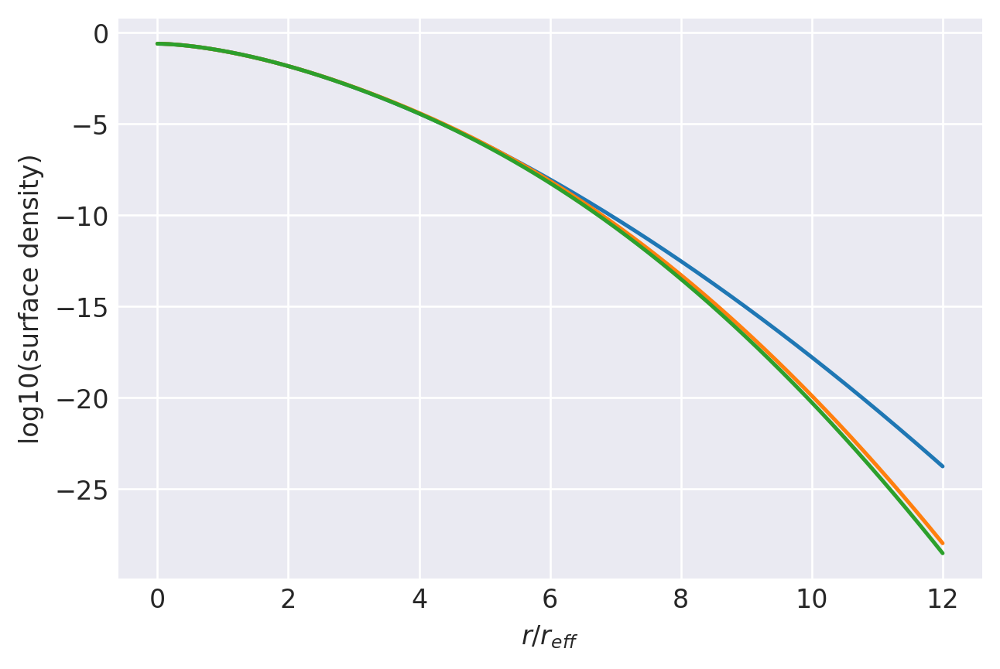

n=0.61: (
    normalize(np.array([2.4604796254e-01, 4.7815448567e-01, 1.9517392496e-01, 6.1286437591e-02, 1.6000558642e-02, 2.9009197390e-03, 4.0005739938e-04, 3.5653467776e-05])),
    np.array([1.2659442814e+00, 1.0531009082e+00, 8.3644923299e-01, 6.4219947336e-01, 4.5008602954e-01, 2.8351110386e-01, 1.6059943274e-01, 7.5235853648e-02]),
),
1.0000000165037684 1.0000000165940384
prev.  chisq = -8.711412399367008
ws, re: (array([2.46047963e-01, 4.78154486e-01, 1.95173925e-01, 6.12864376e-02,
       1.60005586e-02, 2.90091974e-03, 4.00057399e-04, 3.56534678e-05]), array([1.26594428, 1.05310091, 0.83644923, 0.64219947, 0.45008603,
       0.2835111 , 0.16059943, 0.07523585]))
         Current function value: -13.358758
         Iterations: 83
         Function evaluations: 2561
         Gradient evaluations: 150
-13.358757627821321 [-1.0314021   0.69230512  0.92916229  0.92742444  1.52906288  1.89153739
  2.42358249  0.09778716  0.01714694 -0.0878054  -0.19494748 -0.33655272
 -0.53386895 -

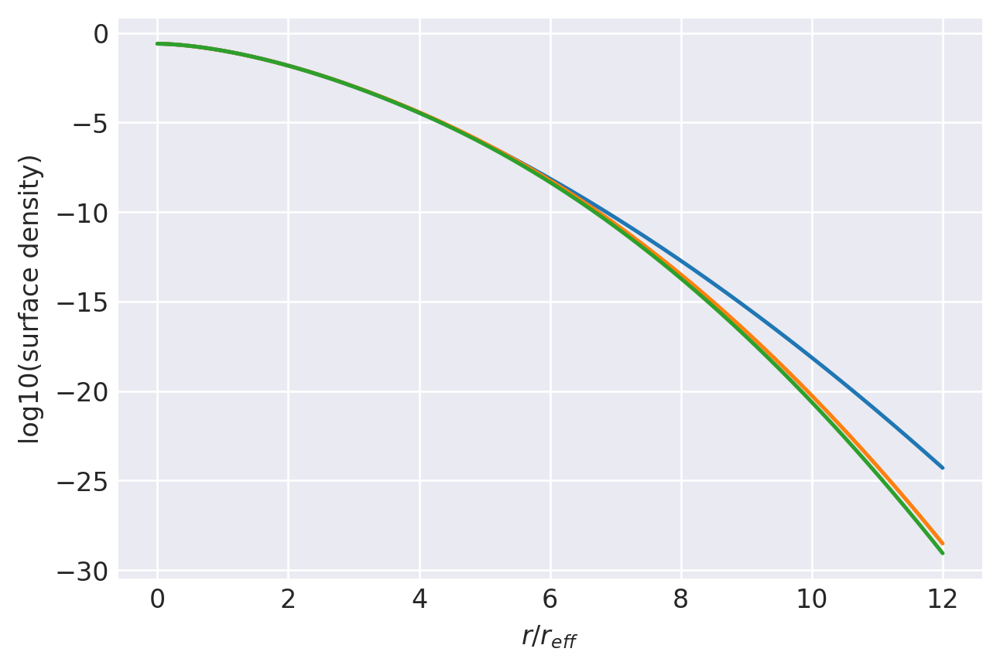

n=0.605: (
    normalize(np.array([2.6281236766e-01, 4.9132045688e-01, 1.7626348173e-01, 4.9874698510e-02, 1.6214652743e-02, 3.0537201464e-03, 4.2313135345e-04, 3.7490972470e-05])),
    np.array([1.2525271923e+00, 1.0402720620e+00, 8.1694834458e-01, 6.3834068326e-01, 4.6073083728e-01, 2.9250348756e-01, 1.6634022849e-01, 7.8052916563e-02]),
),
1.000000016395073 1.0000000164848153
prev.  chisq = -8.704602440324418
ws, re: (array([2.62812368e-01, 4.91320457e-01, 1.76263482e-01, 4.98746985e-02,
       1.62146527e-02, 3.05372015e-03, 4.23131353e-04, 3.74909725e-05]), array([1.25252719, 1.04027206, 0.81694834, 0.63834068, 0.46073084,
       0.29250349, 0.16634023, 0.07805292]))
         Current function value: -13.314514
         Iterations: 68
         Function evaluations: 2119
         Gradient evaluations: 124
-13.3145143851152 [-0.92503462  0.76017994  0.80060602  0.96055294  1.60326537  1.93526038
  2.46775205  0.09265747  0.01251231 -0.08953194 -0.1878924  -0.33373598
 -0.53527382 -0.

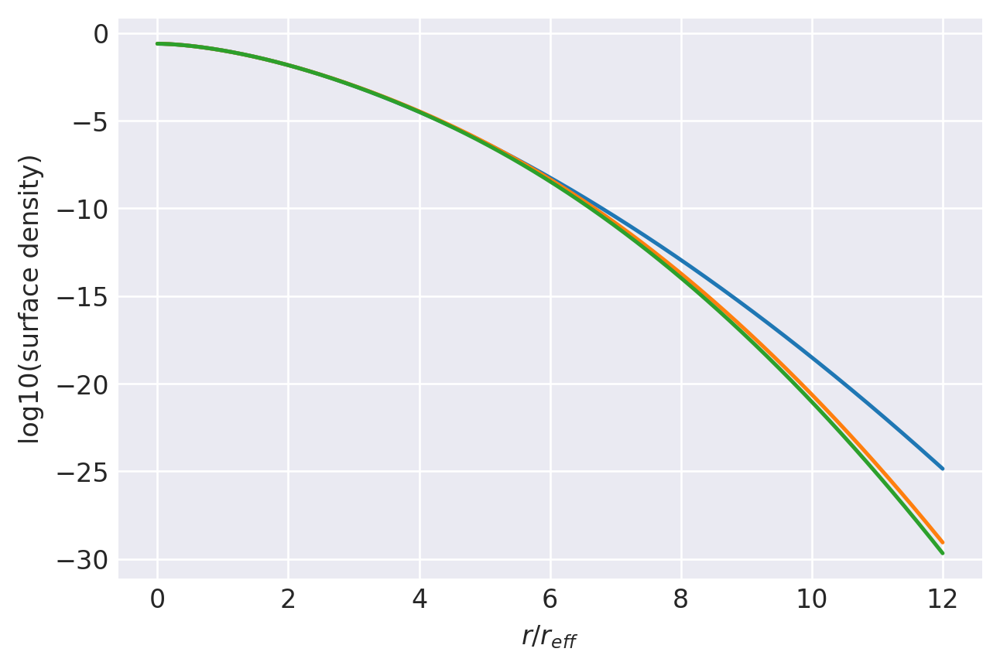

n=0.6: (
    normalize(np.array([2.8393316813e-01, 4.8792278362e-01, 1.5744314284e-01, 5.1133192474e-02, 1.6289617552e-02, 2.8644997963e-03, 3.8127307631e-04, 3.2322507218e-05])),
    np.array([1.2378199346e+00, 1.0292297064e+00, 8.1370700944e-01, 6.4879515676e-01, 4.6372874806e-01, 2.9155881505e-01, 1.6443448874e-01, 7.6673924623e-02]),
),
1.0000000162874645 1.0000000163788119
prev.  chisq = -8.697123221503201
ws, re: (array([2.83933168e-01, 4.87922784e-01, 1.57443143e-01, 5.11331925e-02,
       1.62896176e-02, 2.86449980e-03, 3.81273076e-04, 3.23225072e-05]), array([1.23781993, 1.02922971, 0.81370701, 0.64879516, 0.46372875,
       0.29155882, 0.16443449, 0.07667392]))
         Current function value: -13.279310
         Iterations: 56
         Function evaluations: 2035
         Gradient evaluations: 119
-13.279310318269882 [-0.83781758  0.79849093  0.78792338  1.03874823  1.58974305  1.90596662
  2.45784193  0.08789311  0.0091142  -0.09023505 -0.18952842 -0.337234
 -0.5359148  -0.7

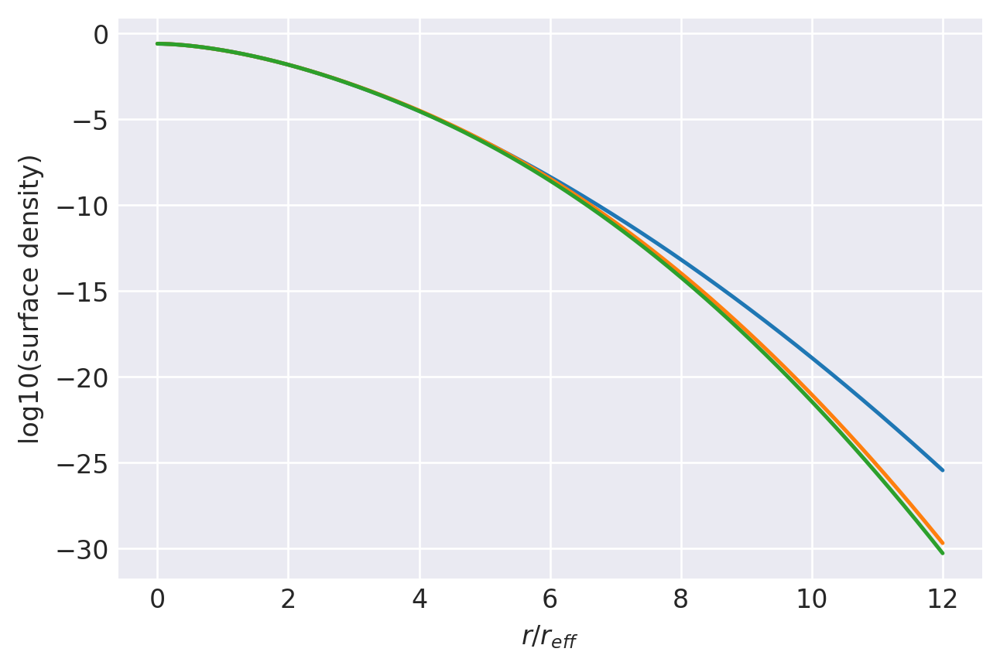

n=0.595: (
    normalize(np.array([3.0199462531e-01, 4.8138051293e-01, 1.4890473808e-01, 5.0018652463e-02, 1.4702487053e-02, 2.6108116737e-03, 3.5755850769e-04, 3.0613989431e-05])),
    np.array([1.2243148198e+00, 1.0212079714e+00, 8.1239070462e-01, 6.4635569363e-01, 4.6000865059e-01, 2.9112882266e-01, 1.6538067515e-01, 7.6923900568e-02]),
),
1.000000016180935 1.0000000162736853
prev.  chisq = -8.689676908919658
ws, re: (array([3.01994625e-01, 4.81380513e-01, 1.48904738e-01, 5.00186525e-02,
       1.47024871e-02, 2.61081167e-03, 3.57558508e-04, 3.06139894e-05]), array([1.22431482, 1.02120797, 0.8123907 , 0.64635569, 0.46000865,
       0.29112882, 0.16538068, 0.0769239 ]))
         Current function value: -13.265697
         Iterations: 117
         Function evaluations: 3514
         Gradient evaluations: 206
-13.265697393029333 [-7.13989563e-01  9.98047688e-01  9.40995384e-01  9.10786920e-01
  1.65909217e+00  1.93502999e+00 -2.46801650e+00  8.27872401e-02
  2.31010166e-03 -1.07230471e

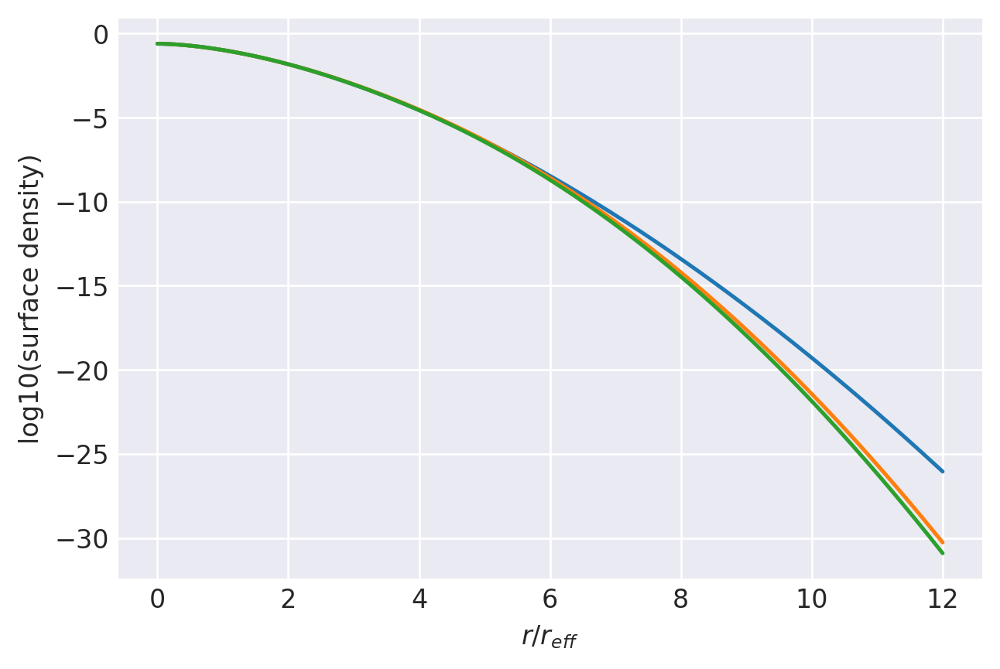

n=0.59: (
    normalize(np.array([3.2871789270e-01, 4.9048875688e-01, 1.3004477925e-01, 3.6191910085e-02, 1.2229285345e-02, 2.0336728328e-03, 2.7075560802e-04, 2.2947295738e-05])),
    np.array([1.2100052095e+00, 1.0053333777e+00, 7.8121312037e-01, 6.2301326025e-01, 4.4449148841e-01, 2.7753546360e-01, 1.5710520808e-01, 7.3640656307e-02]),
),
1.0000000160754776 1.0000000161683118
prev.  chisq = -8.682502584276785
ws, re: (array([3.28717893e-01, 4.90488757e-01, 1.30044779e-01, 3.61919101e-02,
       1.22292853e-02, 2.03367283e-03, 2.29472957e-05, 2.70755608e-04]), array([1.21000521, 1.00533338, 0.78121312, 0.62301326, 0.44449149,
       0.27753546, 0.07364066, 0.15710521]))
         Current function value: -13.380827
         Iterations: 54
         Function evaluations: 3157
         Gradient evaluations: 185
-13.38082709846608 [-6.62689044e-01  1.05761094e+00  1.10570914e+00  8.51725252e-01
  1.59867039e+00  1.94331032e+00 -2.47912936e+00  7.88629329e-02
  1.73886685e-04 -1.11482855e-0

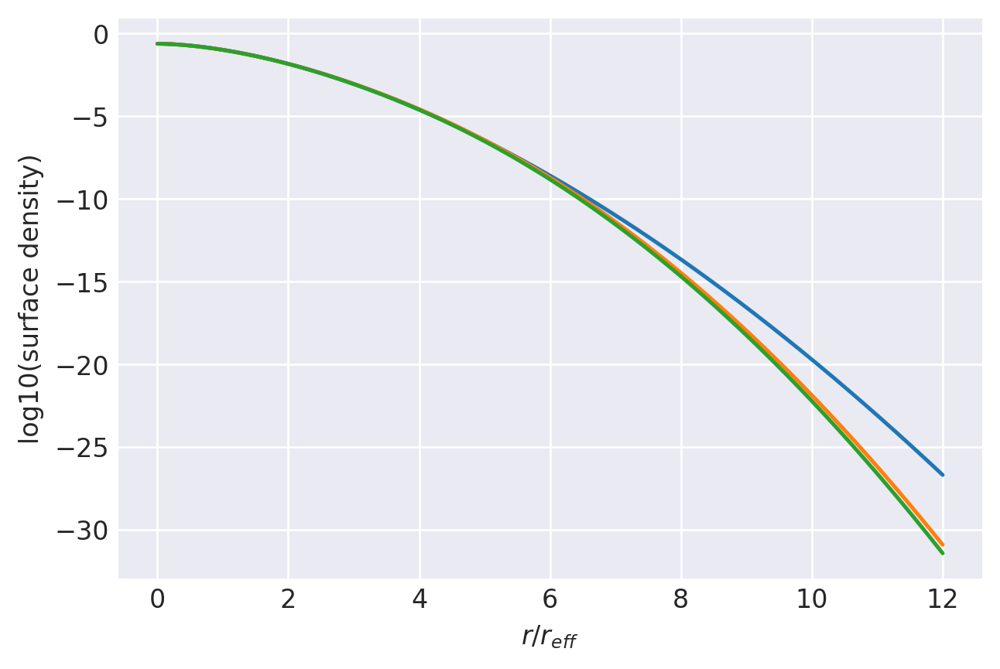

n=0.585: (
    normalize(np.array([3.4013581408e-01, 4.8977345468e-01, 1.2779397935e-01, 2.9647016961e-02, 1.0522460269e-02, 1.8607598317e-03, 2.4590408702e-04, 2.0610738068e-05])),
    np.array([1.1991207906e+00, 1.0004004691e+00, 7.7360121855e-01, 6.0678805355e-01, 4.4003326059e-01, 2.7696320140e-01, 1.5664925173e-01, 7.3249625392e-02]),
),
1.0000000159710858 1.000000016064489
prev.  chisq = -8.67506844518343
ws, re: (array([3.40135814e-01, 4.89773455e-01, 1.27793979e-01, 2.96470170e-02,
       1.05224603e-02, 1.86075983e-03, 2.06107381e-05, 2.45904087e-04]), array([1.19912079, 1.00040047, 0.77360122, 0.60678805, 0.44003326,
       0.2769632 , 0.07324963, 0.15664925]))
         Current function value: -13.621082
         Iterations: 45
         Function evaluations: 2324
         Gradient evaluations: 136
-13.62108186093218 [-6.90808963e-01  1.01052471e+00  1.11536035e+00  1.10903383e+00
  1.61180106e+00  1.92703886e+00 -2.48075667e+00  7.62441793e-02
  2.06533991e-03 -1.03061747e-01

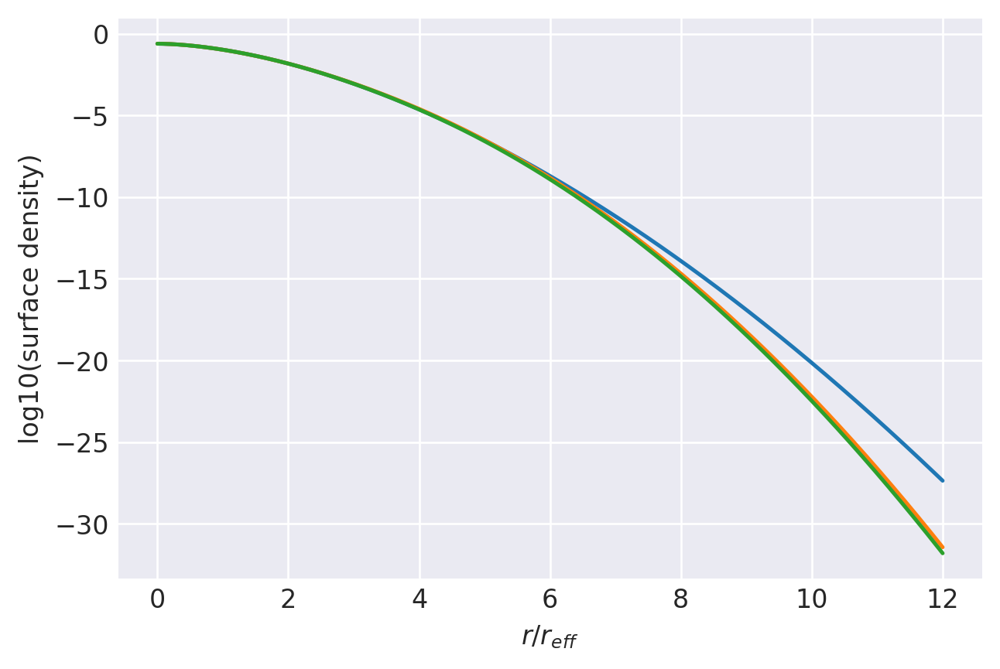

n=0.5800000000000001: (
    normalize(np.array([3.3385313948e-01, 4.8836746715e-01, 1.3389047802e-01, 3.3002223537e-02, 9.0758135360e-03, 1.5807542299e-03, 2.1235426889e-04, 1.7769780516e-05])),
    np.array([1.1919119646e+00, 1.0047669468e+00, 7.8874796642e-01, 6.0897784130e-01, 4.3155184414e-01, 2.7206498486e-01, 1.5441399214e-01, 7.2117212556e-02]),
),
1.0000000158677531 1.0000000159620337
prev.  chisq = -8.667457684368344
ws, re: (array([3.33853139e-01, 4.88367467e-01, 1.33890478e-01, 3.30022235e-02,
       9.07581354e-03, 1.58075423e-03, 1.77697805e-05, 2.12354269e-04]), array([1.19191196, 1.00476695, 0.78874797, 0.60897784, 0.43155184,
       0.27206498, 0.07211721, 0.15441399]))
         Current function value: -14.052486
         Iterations: 50
         Function evaluations: 2545
         Gradient evaluations: 149
-14.052486012920138 [-0.72622503  1.0238385   1.38738793  1.34450529  1.5075549   1.80853839
 -2.40460414  0.0736629   0.00341299 -0.10327993 -0.23696635 -0.39421093


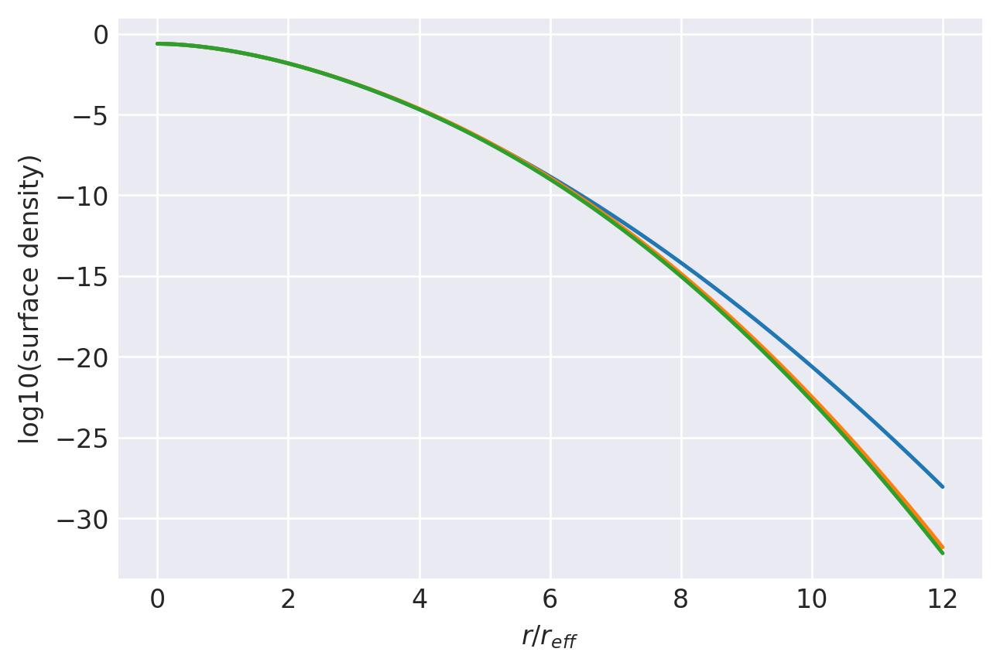

n=0.575: (
    normalize(np.array([3.2602366368e-01, 4.9585761227e-01, 1.4252613452e-01, 2.8233104752e-02, 6.0251995917e-03, 1.1463979887e-03, 1.7232594512e-04, 1.5561245690e-05])),
    np.array([1.1848487123e+00, 1.0078896616e+00, 7.8835181902e-01, 5.7947359997e-01, 4.0344939331e-01, 2.6013780070e-01, 1.5121460789e-01, 7.2423723616e-02]),
),
1.0000000157654718 1.0000000158589775
prev.  chisq = -8.660150788062593
ws, re: (array([3.26023664e-01, 4.95857612e-01, 1.42526135e-01, 2.82331048e-02,
       6.02519959e-03, 1.14639799e-03, 1.55612457e-05, 1.72325945e-04]), array([1.18484871, 1.00788966, 0.78835182, 0.5794736 , 0.40344939,
       0.2601378 , 0.07242372, 0.15121461]))
         Current function value: -14.515077
         Iterations: 65
         Function evaluations: 2970
         Gradient evaluations: 174
-14.51507698073922 [-0.80687868  1.03181265  1.54927014  1.5658597   1.66868568  2.00608283
 -2.64654889  0.07170971  0.00580594 -0.10046139 -0.24631284 -0.42017281
 -0.62689132 -

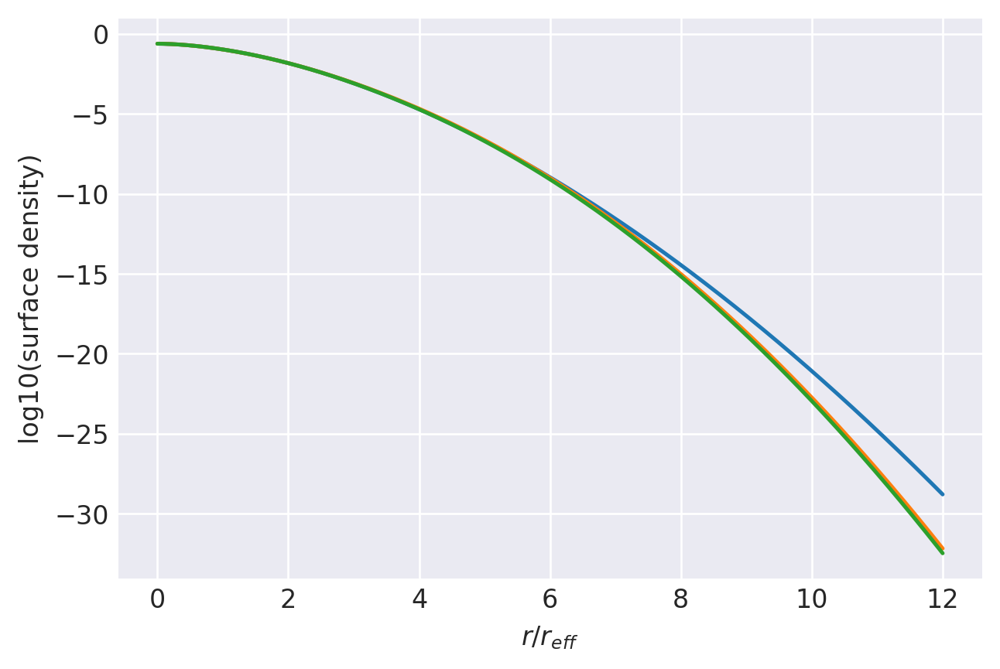

n=0.5700000000000001: (
    normalize(np.array([3.0855602769e-01, 5.0977893694e-01, 1.4983882748e-01, 2.6326402831e-02, 4.6275387777e-03, 7.6884538229e-04, 9.6574225018e-05, 6.8466740416e-06])),
    np.array([1.1795319553e+00, 1.0134584355e+00, 7.9348478801e-01, 5.6713593082e-01, 3.8003814616e-01, 2.3610690140e-01, 1.3063611458e-01, 5.9726480610e-02]),
),
1.0000000156642361 1.0000000157597004
prev.  chisq = -8.652616495568621
ws, re: (array([3.08556028e-01, 5.09778937e-01, 1.49838827e-01, 2.63264028e-02,
       4.62753878e-03, 7.68845382e-04, 6.84667404e-06, 9.65742250e-05]), array([1.17953196, 1.01345844, 0.79348479, 0.56713593, 0.38003815,
       0.2361069 , 0.05972648, 0.13063611]))
         Current function value: -13.914995
         Iterations: 90
         Function evaluations: 3786
         Gradient evaluations: 222
-13.914995435331909 [-7.08924687e-01  1.14798008e+00  1.69559110e+00  1.77772522e+00
  1.26889866e+00  4.41576423e-02 -2.37820925e+00  6.69223050e-02
  2.06927106e-03

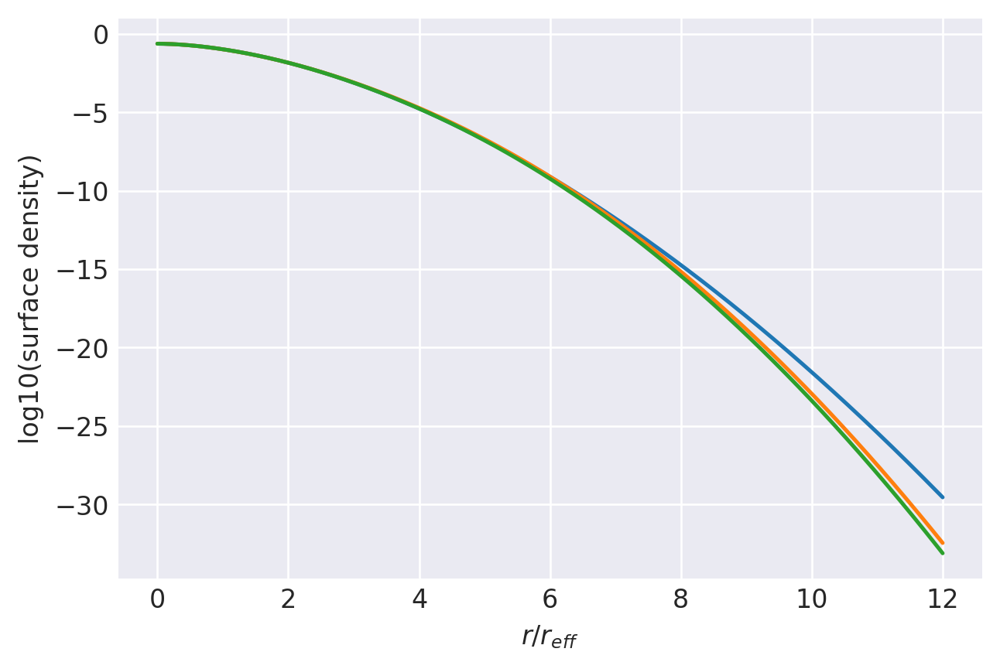

n=0.565: (
    normalize(np.array([3.2983648855e-01, 5.0874911883e-01, 1.3638838720e-01, 2.1407639185e-02, 3.5531033708e-04, 2.8243308132e-03, 4.0578197212e-04, 3.2943117025e-05])),
    np.array([1.1666008941e+00, 1.0047760418e+00, 7.8049162863e-01, 5.4205819960e-01, 3.6014812541e-01, 3.4288927925e-01, 1.9728679278e-01, 9.3252446339e-02]),
),
1.0000000155640396 1.0000000156536681
prev.  chisq = -8.644948894993185
ws, re: (array([3.29836489e-01, 5.08749119e-01, 1.36388387e-01, 2.14076392e-02,
       2.82433081e-03, 4.05781972e-04, 3.29431170e-05, 3.55310337e-04]), array([1.16660089, 1.00477604, 0.78049163, 0.5420582 , 0.34288928,
       0.19728679, 0.09325245, 0.36014813]))
         Current function value: -13.997654
         Iterations: 128
         Function evaluations: 3871
         Gradient evaluations: 227
-13.997653728033303 [-0.41982671  1.37865184  1.77611357  1.79943311 -3.34945534  2.23873814
 -2.52492168  0.05951307 -0.00816775 -0.12591887 -0.29080416 -0.65221898
 -0.49082896

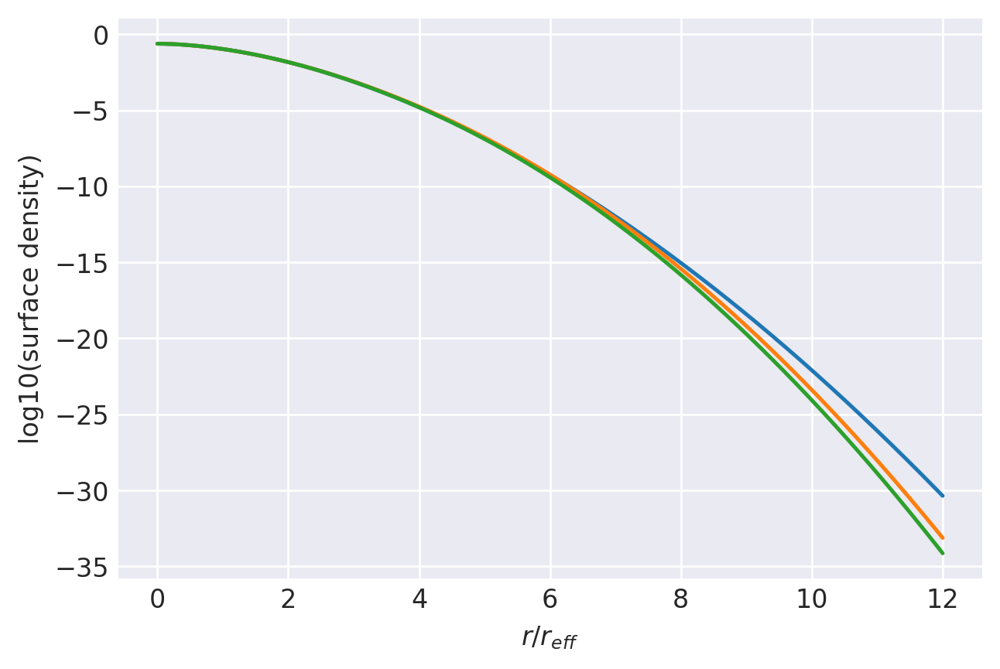

n=0.56: (
    normalize(np.array([3.9655821838e-01, 4.8201384245e-01, 1.0384715374e-01, 1.5085718848e-02, 2.1782638592e-03, 8.4615203855e-05, 2.1497558451e-04, 1.7211930637e-05])),
    np.array([1.1468670458e+00, 9.8136880184e-01, 7.4830927350e-01, 5.1191262993e-01, 3.2297658600e-01, 2.2273117852e-01, 1.7424212510e-01, 7.9693945263e-02]),
),
1.0000000154648756 1.0000000155580189
prev.  chisq = -8.637113099620908
ws, re: (array([3.96558218e-01, 4.82013842e-01, 1.03847154e-01, 1.50857188e-02,
       8.46152039e-05, 2.17826386e-03, 1.72119306e-05, 2.14975585e-04]), array([1.14686705, 0.9813688 , 0.74830927, 0.51191263, 0.22273118,
       0.32297659, 0.07969395, 0.17424213]))
         Current function value: -14.142693
         Iterations: 110
         Function evaluations: 2936
         Gradient evaluations: 172
-14.142693483327474 [-0.35582849  1.43401478  1.77771988  1.15096453 -5.37917868 -0.28730214
 -2.184343    0.05535719 -0.00965928 -0.12553393 -0.2814281  -1.07328793
 -0.50462074 

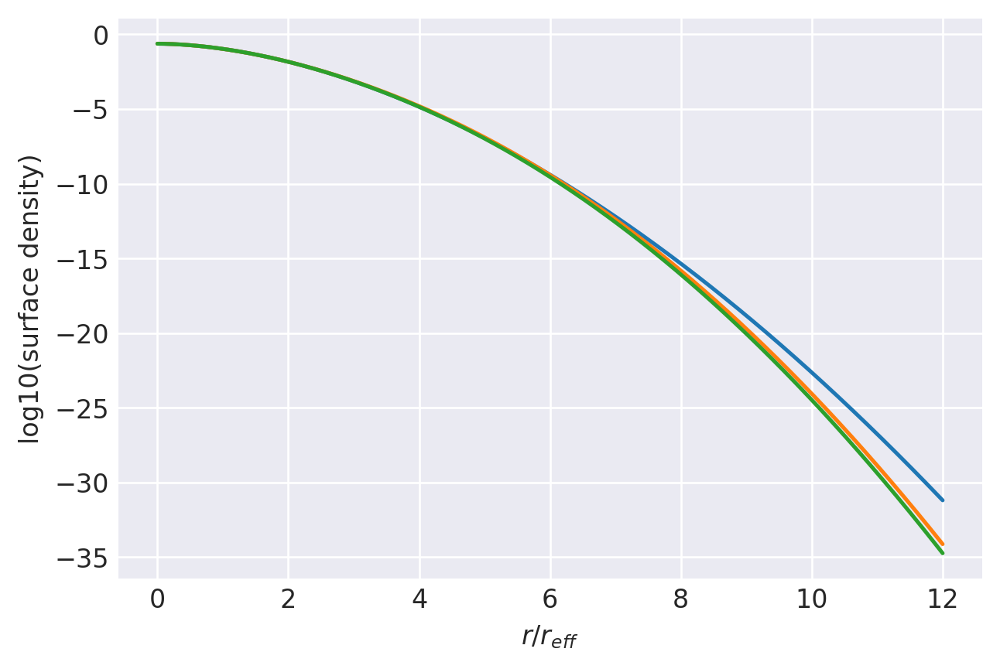

n=0.5549999999999999: (
    normalize(np.array([4.1196974546e-01, 4.7484977471e-01, 9.6816290168e-02, 1.2431662955e-02, 2.0102243670e-03, 1.6779962389e-03, 2.2625408069e-04, 1.8052022619e-05])),
    np.array([1.1359446966e+00, 9.7800420829e-01, 7.4897283425e-01, 5.2308456314e-01, 4.4528922686e-01, 3.1288105225e-01, 1.8058600005e-01, 8.4471863141e-02]),
),
1.000000015366738 1.000000015458417
prev.  chisq = -8.62940280686461
ws, re: (array([4.11969745e-01, 4.74849775e-01, 9.68162902e-02, 1.24316630e-02,
       1.80520226e-05, 1.67799624e-03, 2.26254081e-04, 2.01022437e-03]), array([1.1359447 , 0.97800421, 0.74897283, 0.52308456, 0.08447186,
       0.31288105, 0.180586  , 0.44528923]))
         Current function value: -14.078702
         Iterations: 61
         Function evaluations: 2035
         Gradient evaluations: 119
-14.078702313254603 [-0.35893284  1.37451379  1.6687159   0.73051983 -5.41876431 -0.35522989
 -2.33997386  0.05190344 -0.00783394 -0.11326747 -0.26421209 -1.0030933
 -0.

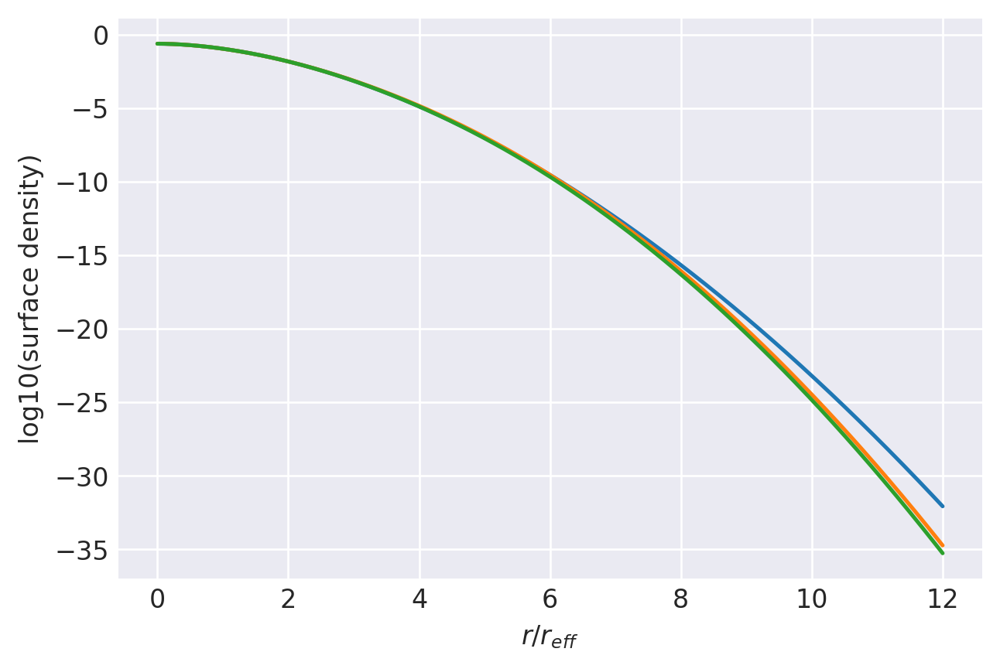

n=0.55: (
    normalize(np.array([4.1121792013e-01, 4.6991195001e-01, 1.0001786726e-01, 3.2717868717e-03, 1.2723756532e-02, 2.5145020013e-03, 3.1517174128e-04, 2.7045460025e-05])),
    np.array([1.1269468595e+00, 9.8212341020e-01, 7.7042883854e-01, 5.5694720876e-01, 5.4423680890e-01, 3.5276591319e-01, 2.0293403978e-01, 9.9290272210e-02]),
),
1.000000015269622 1.0000000153586706
prev.  chisq = -8.62153343691116
ws, re: (array([4.11217920e-01, 4.69911950e-01, 1.00017867e-01, 1.27237565e-02,
       2.70454600e-05, 2.51450200e-03, 3.15171741e-04, 3.27178687e-03]), array([1.12694686, 0.98212341, 0.77042884, 0.54423681, 0.09929027,
       0.35276591, 0.20293404, 0.55694721]))
         Current function value: -13.860551
         Iterations: 63
         Function evaluations: 2953
         Gradient evaluations: 173
-13.860550579647835 [-0.32265689  1.32720711  1.35379651  0.50597274 -5.38955722 -0.37787112
 -2.30515879  0.04794369 -0.00741618 -0.09973907 -0.22281662 -0.93942385
 -0.39544761 -0.

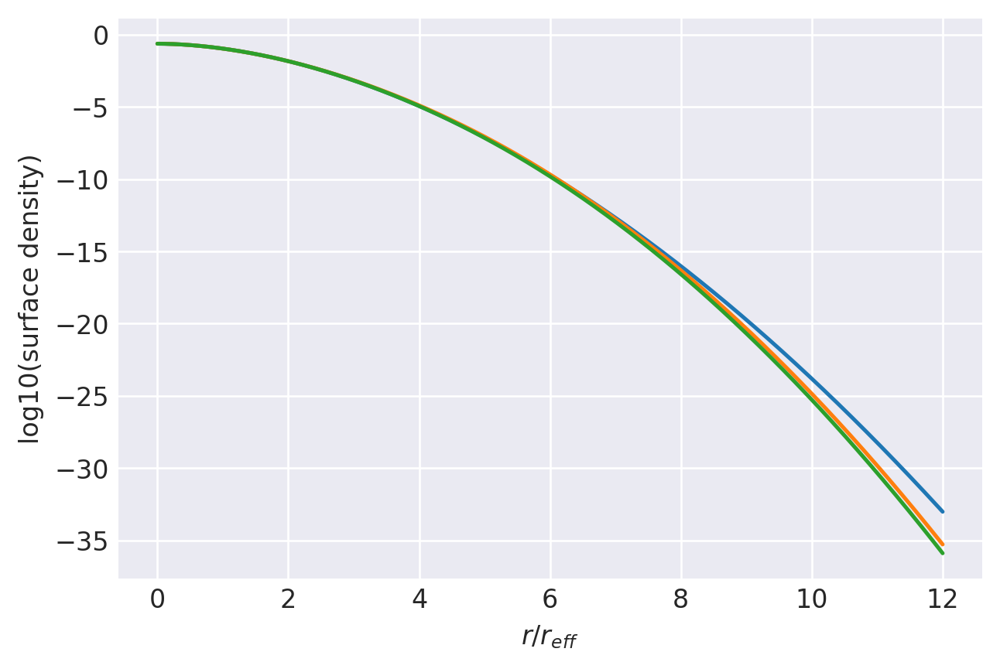

n=0.5449999999999999: (
    normalize(np.array([4.2002838114e-01, 4.5839697243e-01, 9.6621403879e-02, 5.0410780842e-03, 1.5567377745e-02, 3.7993322579e-03, 5.0281205634e-04, 4.2642408650e-05])),
    np.array([1.1167184521e+00, 9.8306858569e-01, 7.9480562565e-01, 6.0818352078e-01, 5.9866433030e-01, 4.0230218210e-01, 2.3683070211e-01, 1.1496778060e-01]),
),
1.00000001517352 1.0000000152610604
prev.  chisq = -8.613482122460692
ws, re: (array([4.20028381e-01, 4.58396972e-01, 9.66214039e-02, 1.55673777e-02,
       4.26424086e-05, 3.79933226e-03, 5.02812056e-04, 5.04107808e-03]), array([1.11671845, 0.98306859, 0.79480563, 0.59866433, 0.11496778,
       0.40230218, 0.2368307 , 0.60818352]))
         Current function value: -13.459005
         Iterations: 59
         Function evaluations: 2682
         Gradient evaluations: 157
-13.45900477207084 [-3.87100494e-01  1.25520087e+00  1.56487722e+00 -9.64120700e-02
 -4.93592513e+00 -5.63401187e-01 -1.90697643e+00  4.47285145e-02
 -3.73360853e-03 -9

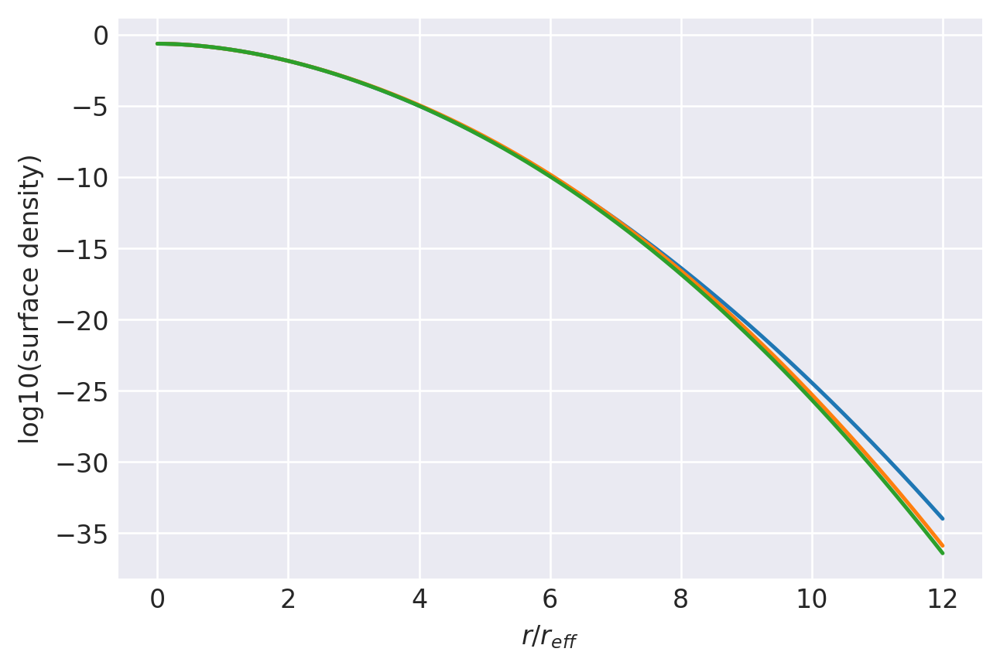

n=0.54: (
    normalize(np.array([4.0441549209e-01, 4.6348318374e-01, 1.0925467614e-01, 1.0873077018e-02, 6.5959220509e-03, 4.3125622395e-03, 9.7968435501e-04, 8.5402367630e-05])),
    np.array([1.1084816664e+00, 9.9143989678e-01, 8.1112330368e-01, 6.1387506641e-01, 6.0445738286e-01, 4.5693552120e-01, 2.9130795523e-01, 1.4260301829e-01]),
),
1.000000015078427 1.0000000151628745
prev.  chisq = -8.605751844515263
ws, re: (array([4.04415492e-01, 4.63483184e-01, 1.09254676e-01, 1.08730770e-02,
       8.54023676e-05, 4.31256224e-03, 9.79684355e-04, 6.59592205e-03]), array([1.10848167, 0.9914399 , 0.8111233 , 0.61387507, 0.14260302,
       0.45693552, 0.29130796, 0.60445738]))
         Current function value: -13.577430
         Iterations: 101
         Function evaluations: 3106
         Gradient evaluations: 182
-13.577430302248183 [-0.29103579  1.70972671  1.96031739 -2.18273426 -4.95083629 -2.28149057
 -2.82756344  0.0405982  -0.00897759 -0.12010398 -0.10944008 -0.85106755
 -0.53492329 -

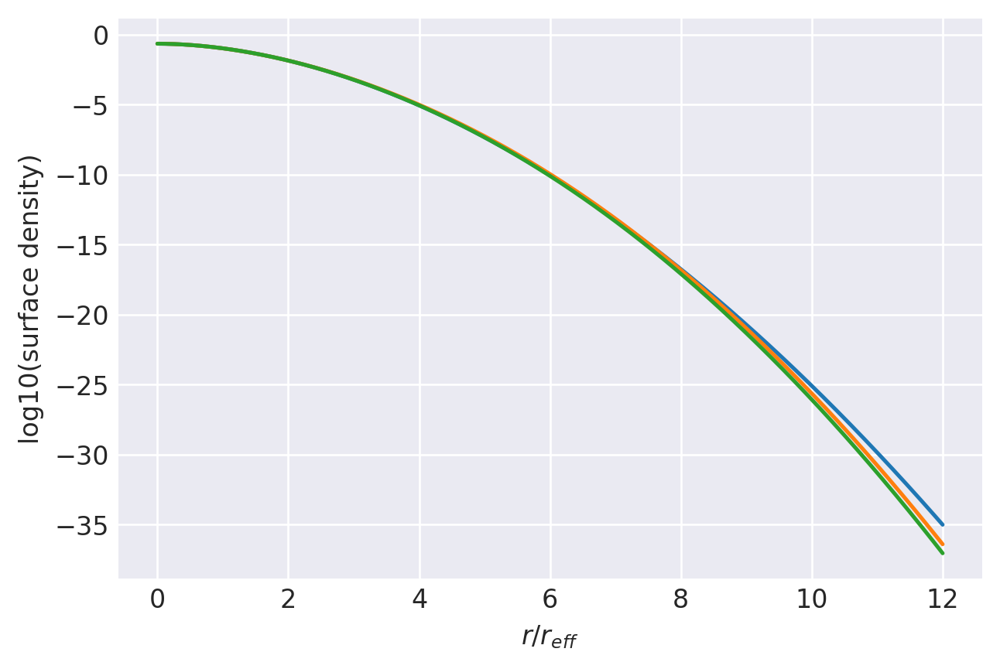

n=0.5349999999999999: (
    normalize(np.array([4.2775030688e-01, 4.8458151722e-01, 1.0963061420e-03, 7.6847055994e-02, 4.8936103335e-04, 8.2722677487e-03, 8.9484143450e-04, 6.8343548463e-05])),
    np.array([1.0979895357e+00, 9.7954053649e-01, 7.7724854439e-01, 7.5839596795e-01, 6.5937117150e-01, 4.9907625936e-01, 2.9179423421e-01, 1.4090696154e-01]),
),
1.000000014984337 1.0000000150695516
prev.  chisq = -8.597699406652023
ws, re: (array([4.27750307e-01, 4.84581517e-01, 7.68470560e-02, 1.09630614e-03,
       6.83435485e-05, 8.94841435e-04, 4.89361033e-04, 8.27226775e-03]), array([1.09798954, 0.97954054, 0.75839597, 0.77724854, 0.14090696,
       0.29179423, 0.65937117, 0.49907626]))
         Current function value: -13.853135
         Iterations: 92
         Function evaluations: 2918
         Gradient evaluations: 171
-13.853135371555364 [-0.15602864  1.77601161  2.01218363 -1.24878178 -3.5067509  -2.29313979
 -4.81343297  0.03538871 -0.01075831 -0.11680225 -0.35268525 -0.27250316
 

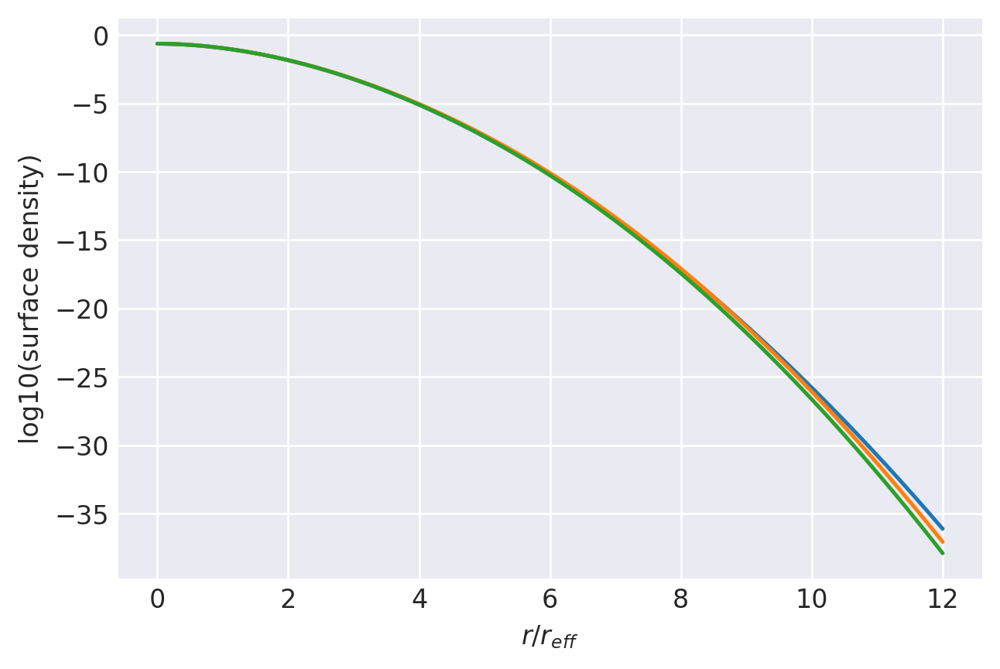

n=0.53: (
    normalize(np.array([4.6107178342e-01, 4.6089339478e-01, 6.8832203189e-02, 6.2555852186e-03, 2.0824989186e-04, 2.0513657397e-03, 6.3662280643e-04, 5.0794953729e-05])),
    np.array([1.0848974972e+00, 9.7553237685e-01, 7.6418366421e-01, 5.3961631242e-01, 5.3394538568e-01, 4.4393026459e-01, 2.8290944854e-01, 1.3693210857e-01]),
),
1.000000014891245 1.0000000149776205
prev.  chisq = -8.58950650289808
ws, re: (array([4.61071783e-01, 4.60893395e-01, 6.88322032e-02, 2.05136574e-03,
       2.08249892e-04, 6.36622806e-04, 5.07949537e-05, 6.25558522e-03]), array([1.0848975 , 0.97553238, 0.76418366, 0.44393026, 0.53394539,
       0.28290945, 0.13693211, 0.53961631]))
         Current function value: -13.528888
         Iterations: 49
         Function evaluations: 2001
         Gradient evaluations: 117
-13.528887851078002 [-4.29214372e-01  1.35056066e+00  2.03834223e+00 -1.15354928e+00
 -3.23473977e+00 -2.06760118e+00 -4.66097615e+00  3.23214318e-02
 -2.98256282e-04 -7.75817843e-02

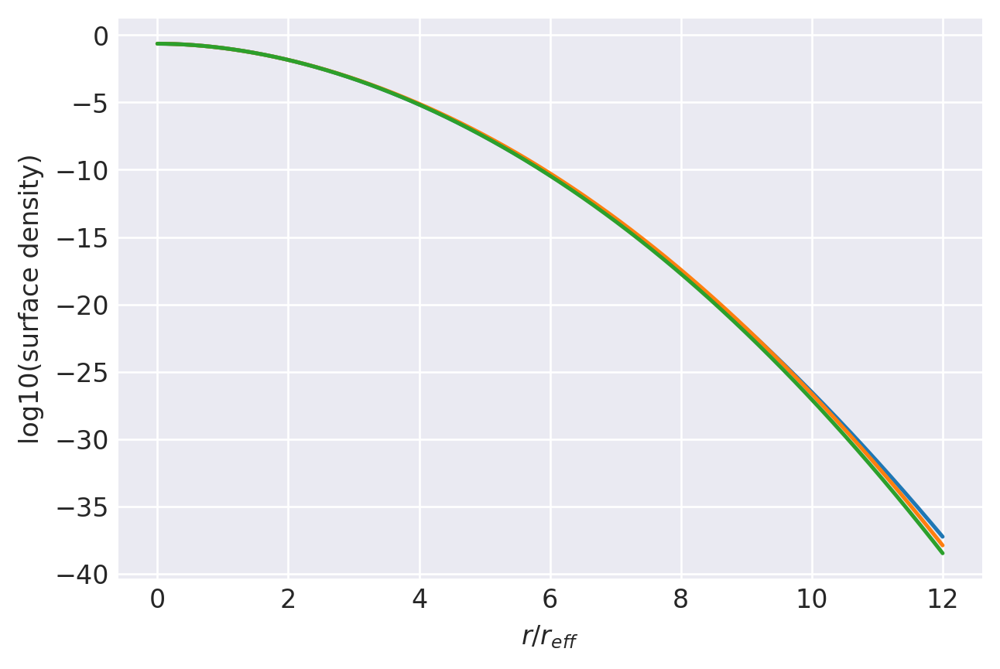

n=0.5249999999999999: (
    normalize(np.array([3.9431394793e-01, 4.8104874804e-01, 1.1027464394e-01, 4.1356054835e-04, 9.2374887254e-03, 3.4447603456e-03, 1.1794894490e-03, 8.7361020486e-05])),
    np.array([1.0772622264e+00, 9.9931347530e-01, 8.3640807252e-01, 7.2761377902e-01, 5.9644494405e-01, 5.4673552091e-01, 3.4124605778e-01, 1.6583790204e-01]),
),
1.000000014799145 1.0000000148838666
prev.  chisq = -8.581090760869582
ws, re: (array([3.94313948e-01, 4.81048748e-01, 1.10274644e-01, 3.44476035e-03,
       4.13560548e-04, 1.17948945e-03, 8.73610205e-05, 9.23748873e-03]), array([1.07726223, 0.99931348, 0.83640807, 0.54673552, 0.72761378,
       0.34124606, 0.1658379 , 0.59644494]))
         Current function value: -13.639734
         Iterations: 71
         Function evaluations: 3123
         Gradient evaluations: 183
-13.639733582866715 [-4.65226368e-01  1.07191520e+00  1.81504200e+00 -3.94338005e-01
 -2.88623544e+00 -2.49574310e+00 -5.18913146e+00  1.50477694e-03
  2.50689083e-02 

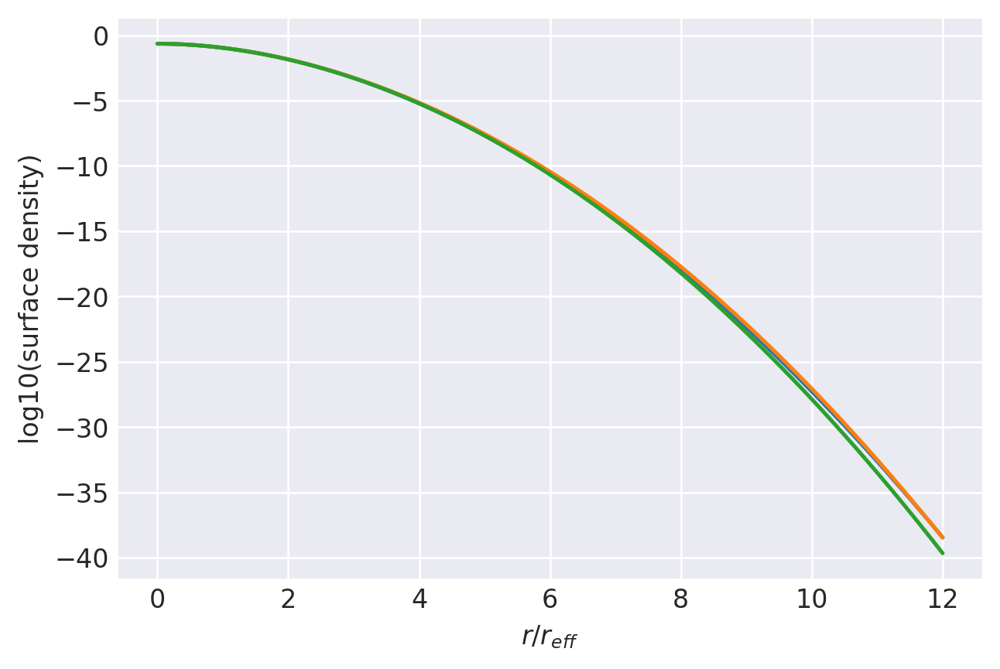

n=0.52: (
    normalize(np.array([4.5759471564e-01, 3.8574671880e-01, 1.3472168895e-01, 1.1402330390e-02, 6.9236428750e-04, 8.8333978234e-03, 9.4519503110e-04, 6.3589068518e-05])),
    np.array([1.0594218074e+00, 1.0034708866e+00, 8.7938407336e-01, 7.3975830049e-01, 6.8581740463e-01, 5.7592255948e-01, 3.4101979773e-01, 1.6310855531e-01]),
),
1.0000000147080328 1.0000000147937194
prev.  chisq = -8.572791983808065
ws, re: (array([3.85746719e-01, 4.57594716e-01, 1.34721689e-01, 8.83339782e-03,
       6.92364287e-04, 9.45195031e-04, 6.35890685e-05, 1.14023304e-02]), array([1.00347089, 1.05942181, 0.87938407, 0.57592256, 0.6858174 ,
       0.3410198 , 0.16310856, 0.7397583 ]))
         Current function value: -13.947168
         Iterations: 91
         Function evaluations: 3667
         Gradient evaluations: 215
-13.94716845495469 [-4.82588191e-01  1.07152889e+00  2.26138419e+00 -1.11608712e+00
 -2.66195875e+00 -5.28663870e+00 -4.15810341e+00  2.10737461e-02
  5.11955544e-03 -4.96001786e-0

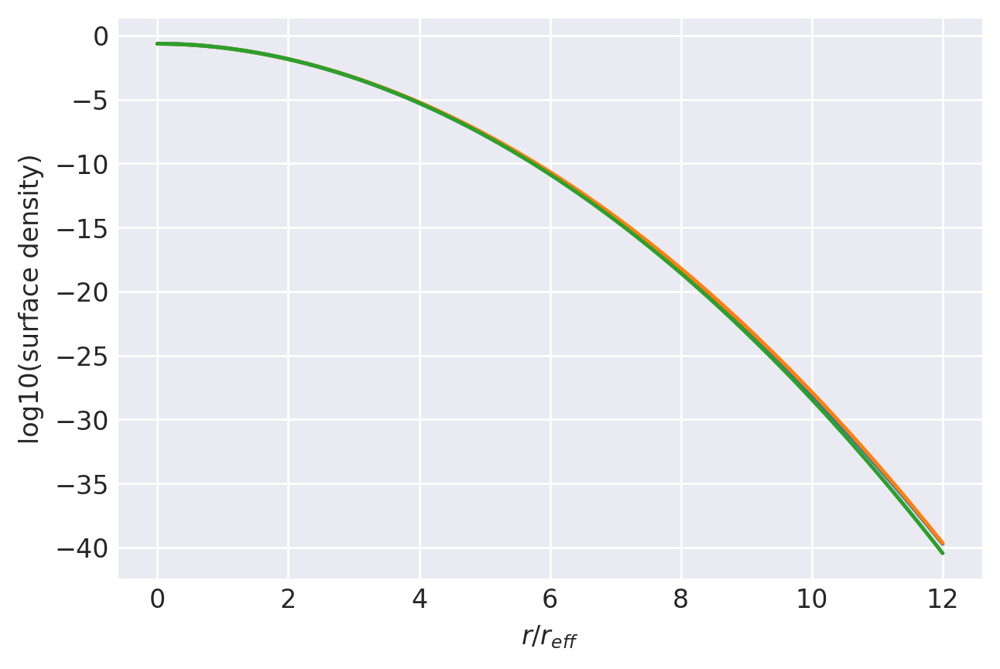

n=0.515: (
    normalize(np.array([3.8164114824e-01, 4.6060781616e-01, 1.4286375466e-01, 1.0268909355e-02, 1.6057685658e-04, 3.6732550151e-03, 7.3177970279e-04, 5.2760013845e-05])),
    np.array([1.0497206631e+00, 1.0118579668e+00, 8.9207182177e-01, 6.7907487156e-01, 6.2254971298e-01, 5.5480724208e-01, 3.4831360398e-01, 1.6880476680e-01]),
),
1.000000014617902 1.0000000147040027
prev.  chisq = -8.564439226415692
ws, re: (array([3.81641148e-01, 4.60607816e-01, 1.42863755e-01, 3.67325502e-03,
       7.31779703e-04, 5.27600138e-05, 1.60576857e-04, 1.02689094e-02]), array([1.04972066, 1.01185797, 0.89207182, 0.55480724, 0.3483136 ,
       0.16880477, 0.62254971, 0.67907487]))
         Current function value: -13.682105
         Iterations: 58
         Function evaluations: 2035
         Gradient evaluations: 119
-13.682104906917216 [-0.56033082  0.88334653  1.42234514 -0.93790762 -2.86201348 -5.59471499
 -4.01868516 -0.0072435   0.01782421 -0.00609208 -0.15659886 -0.35660381
 -0.66612952  

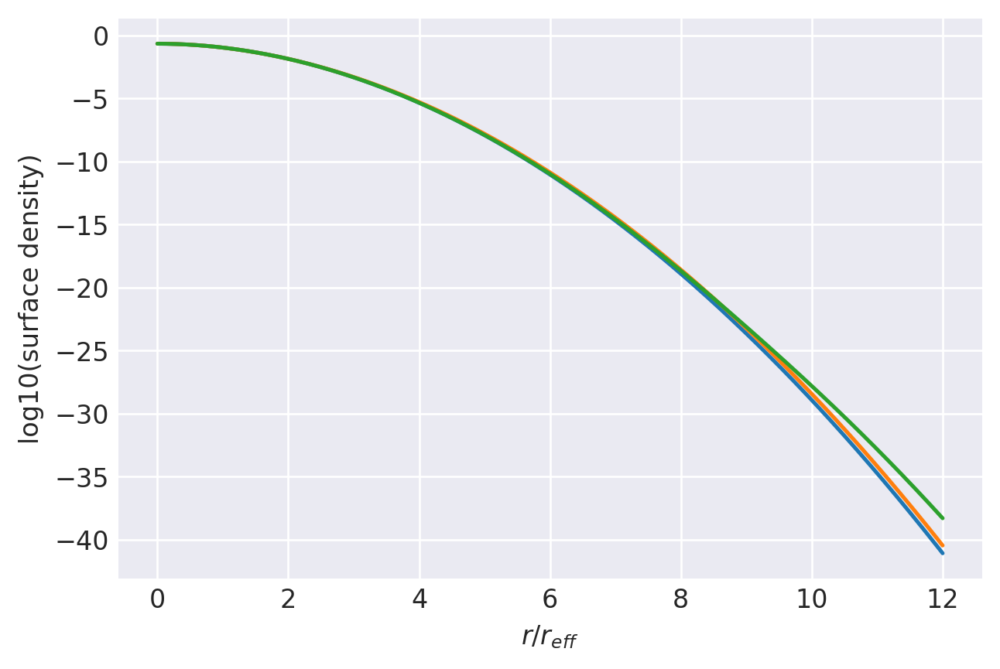

n=0.51: (
    normalize(np.array([4.3264815660e-04, 4.5035401475e-01, 1.5000233020e-01, 3.6347091893e-01, 2.4067315231e-02, 1.0176229430e-02, 1.4054656989e-03, 9.1077601888e-05])),
    np.array([1.1262811428e+00, 1.0418956199e+00, 9.8607040420e-01, 9.8345954249e-01, 8.1138123326e-01, 6.9727025294e-01, 4.3994277657e-01, 2.1571009938e-01]),
),
1.0000000145287486 1.0000000146135983
prev.  chisq = -8.555900959888467
ws, re: (array([3.63470919e-01, 4.50354015e-01, 1.50002330e-01, 1.01762294e-02,
       1.40546570e-03, 9.10776019e-05, 4.32648157e-04, 2.40673152e-02]), array([0.98345954, 1.04189562, 0.9860704 , 0.69727025, 0.43994278,
       0.2157101 , 1.12628114, 0.81138123]))
         Current function value: -13.947703
         Iterations: 63
         Function evaluations: 3344
         Gradient evaluations: 196
-13.947702788010856 [-7.96993500e-02  5.96816468e-01  2.13525162e+00 -1.07135429e-01
 -3.08496277e+00 -5.98103830e+00 -3.94532261e+00  9.44852315e-03
 -1.31422934e-02  9.27238886e-

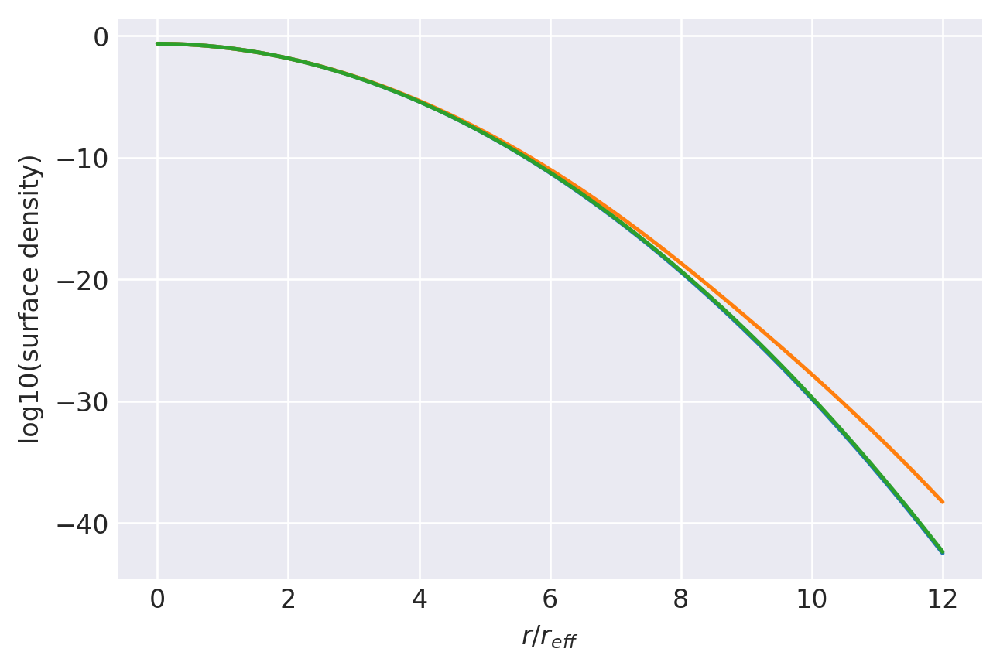

n=0.505: (
    normalize(np.array([4.8008570267e-01, 1.6509099731e-01, 9.6198776306e-03, 3.3530709402e-01, 9.2358831290e-03, 1.8609628767e-04, 4.4957707680e-04, 2.4771870771e-05])),
    np.array([1.0219944166e+00, 1.0215800163e+00, 1.0107068690e+00, 9.7019203892e-01, 7.0999950053e-01, 5.3672238445e-01, 3.9844360267e-01, 1.8944260866e-01]),
),


In [5]:
# Now try to work backwards in finely-spaced bins from n=1 with eight components and see where it breaks down
nspaced = np.linspace(1, 0.5, num=100, endpoint=False)
nvals = [
    (
        nspaced,
        (
	normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
	np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
        ),
    )
]
fitweights(nvals, rmid, areasq)

## Fitting weights with fixed, linearly-extrapolated sizes for n < 1

In plots below, one can see that the best-fit *sizes* change nearly linearly from about n=1 to n=0.7. It's tempting to try to extrapolate the sizes to n=0.5 and fit only the weights. This approach works a little better down to n=0.6 but suffers the same issues of weights tending to noisy, near-zero values as n->0.5.

[ 1.02610583  0.60634281  0.30585517  0.10200563 -0.0475183  -0.18168242
 -0.32424482 -0.50154897]
[ 1.11799858  0.60634281  0.30585517  0.10200563  0.         -0.18168242
 -0.32424482 -0.50154897]
1 [2.17045661 1.47679133 0.99494464 0.65054022 0.40699848 0.23877605
 0.12631553 0.05405815]
0.75 [1.57351098 1.24040477 0.91114136 0.63172738 0.40699848 0.25158801
 0.1386652  0.06244879]
0.5 [1.         0.97004473 0.80487296 0.60613226 0.40699848 0.27082118
 0.15814816 0.07653189]
0.9999999914677243 1.0000000283694637
prev.  chisq = -10.92882749800659
ws, re: (array([0.07790019, 0.31264016, 0.33937179, 0.1839253 , 0.06541804,
       0.01709507, 0.00326612, 0.00038332]), array([2.17045661, 1.47679133, 0.99494464, 0.65054022, 0.40699848,
       0.23877605, 0.12631553, 0.05405815]))
Optimization terminated successfully.
         Current function value: -10.928828
         Iterations: 10
         Function evaluations: 144
         Gradient evaluations: 16
-10.92882763671094 [-2.47122091 -0.667

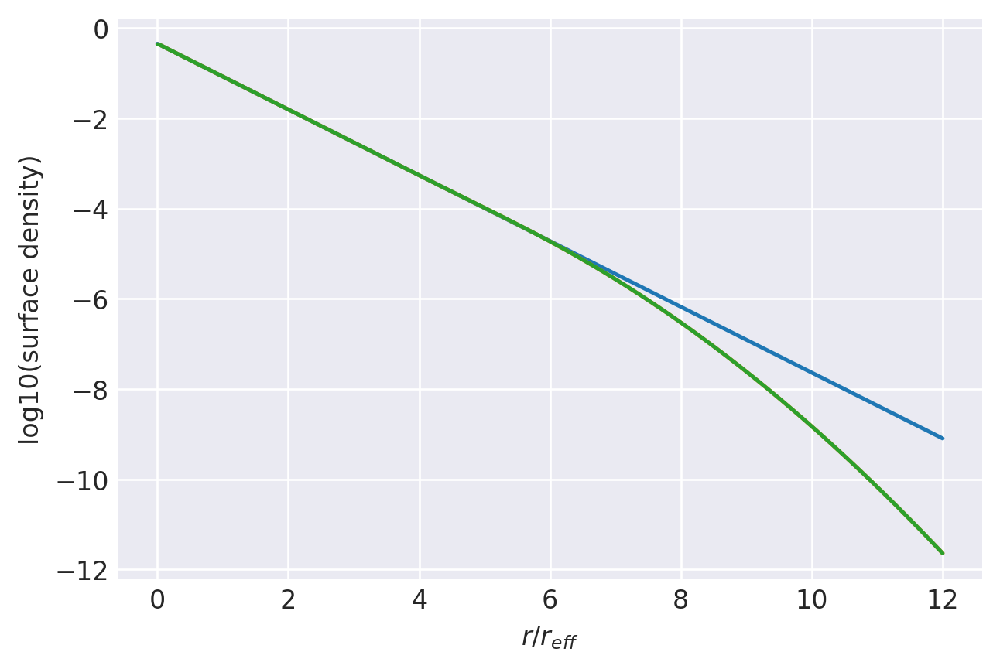

n=1.0: (
    normalize(np.array([7.7900489670e-02, 3.1263985956e-01, 3.3937166369e-01, 1.8392552231e-01, 6.5417944499e-02, 1.7095056297e-02, 3.2661568475e-03, 3.8330712707e-04])),
    np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02]),
),
1.0000000199734806 1.0000000285286965
prev.  chisq = -7.007177624012978
ws, re: (array([0.07790049, 0.31263986, 0.33937166, 0.18392552, 0.06541794,
       0.01709506, 0.00326616, 0.00038331]), array([2.04949155, 1.43156806, 0.97945743, 0.64714535, 0.40699848,
       0.24101163, 0.12843392, 0.0554669 ]))
         Current function value: -11.035838
         Iterations: 30
         Function evaluations: 984
         Gradient evaluations: 108
-11.035837942593982 [-2.41268844 -0.61532205  0.29821809  0.82736336  1.20645068  1.56476226
  2.19304008]
1.0000000199734806 1.0000000264927937


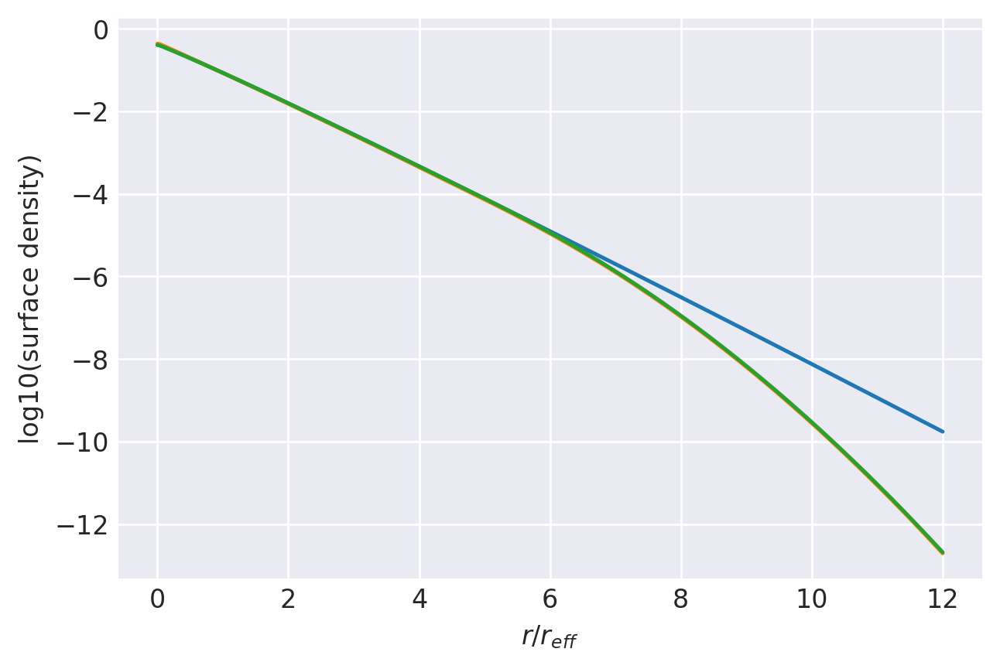

n=0.95: (
    normalize(np.array([8.2210242979e-02, 3.2200297925e-01, 3.4198569568e-01, 1.7659406647e-01, 5.9423949568e-02, 1.4707229494e-02, 2.7670925902e-03, 3.0874397257e-04])),
    np.array([2.0494915452e+00, 1.4315680624e+00, 9.7945743495e-01, 6.4714535391e-01, 4.0699848261e-01, 2.4101162873e-01, 1.2843392006e-01, 5.5466896117e-02]),
),
1.0000000242164144 1.0000000266961557
prev.  chisq = -6.923543225290946
ws, re: (array([8.22102430e-02, 3.22002979e-01, 3.41985696e-01, 1.76594066e-01,
       5.94239496e-02, 1.47072295e-02, 2.76709259e-03, 3.08743973e-04]), array([1.92927572, 1.38539752, 0.96339359, 0.64358607, 0.40699848,
       0.24339077, 0.13070535, 0.05699159]))
         Current function value: -10.923821
         Iterations: 30
         Function evaluations: 1307
         Gradient evaluations: 144
-10.923820540409794 [-2.33939391 -0.55537862  0.37898498  0.90164608  1.26954572  1.58080206
  2.25146194]
1.0000000242164144 1.0000000247019842


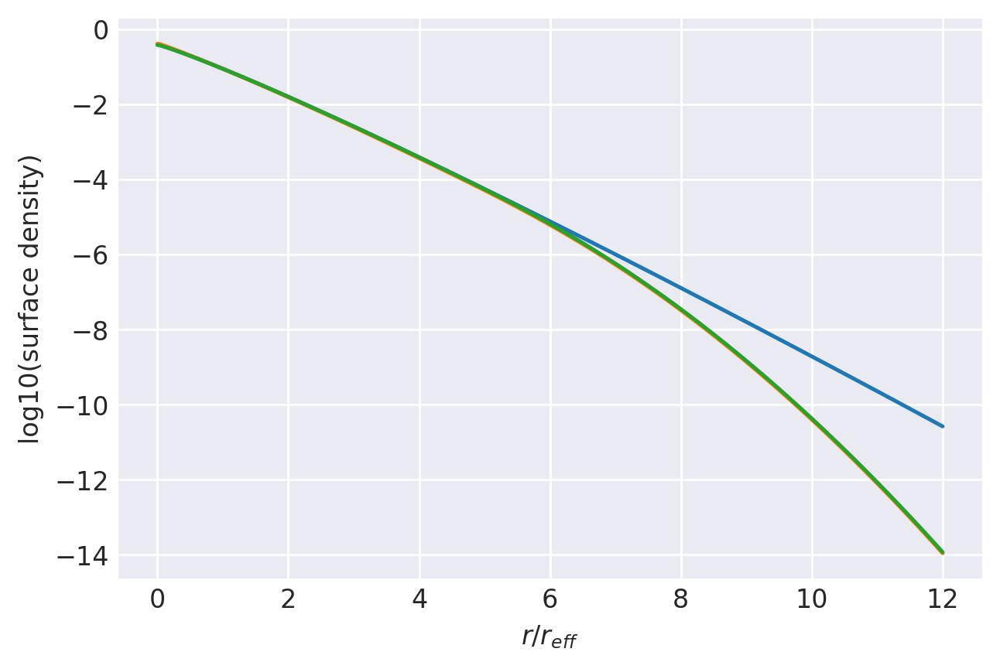

n=0.9: (
    normalize(np.array([8.7912500959e-02, 3.3256300095e-01, 3.4402212500e-01, 1.6750993074e-01, 5.3079318197e-02, 1.2367723481e-02, 2.3030188843e-03, 2.4238179772e-04])),
    np.array([1.9292757222e+00, 1.3853975245e+00, 9.6339359071e-01, 6.4358606716e-01, 4.0699848261e-01, 2.4339076737e-01, 1.3070534928e-01, 5.6991591281e-02]),
),
1.0000000232649449 1.000000024994367
prev.  chisq = -6.83131376634761
ws, re: (array([8.79125010e-02, 3.32563001e-01, 3.44022125e-01, 1.67509931e-01,
       5.30793182e-02, 1.23677235e-02, 2.30301888e-03, 2.42381798e-04]), array([1.80984577, 1.33820549, 0.94669772, 0.63984457, 0.40699848,
       0.24593147, 0.13315034, 0.05864906]))
         Current function value: -10.744539
         Iterations: 28
         Function evaluations: 1263
         Gradient evaluations: 139
-10.74453871501948 [-2.24693838 -0.48571899  0.47386053  0.98120311  1.33914231  1.58974056
  2.321351  ]
1.0000000232649449 1.0000000230307136


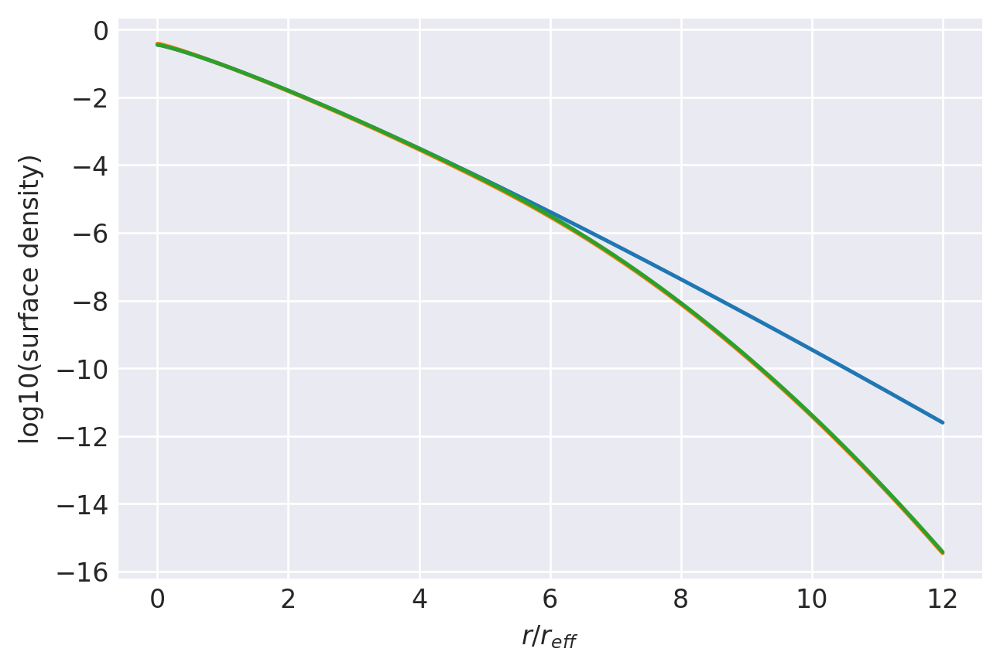

n=0.85: (
    normalize(np.array([9.5613880921e-02, 3.4448300732e-01, 3.4506665471e-01, 1.5626062552e-01, 4.6412493305e-02, 1.0102620577e-02, 1.8765512077e-03, 1.8416643867e-04])),
    np.array([1.8098457733e+00, 1.3382054855e+00, 9.4669772023e-01, 6.3984456942e-01, 4.0699848261e-01, 2.4593147172e-01, 1.3315034021e-01, 5.8649055981e-02]),
),
1.0000000216764655 1.0000000234253819
prev.  chisq = -6.728938654928989
ws, re: (array([9.56138809e-02, 3.44483007e-01, 3.45066655e-01, 1.56260626e-01,
       4.64124933e-02, 1.01026206e-02, 1.87655121e-03, 1.84166439e-04]), array([1.69124238, 1.28990713, 0.92930546, 0.63589995, 0.40699848,
       0.24865524, 0.1357936 , 0.06045974]))
         Current function value: -10.592996
         Iterations: 25
         Function evaluations: 1154
         Gradient evaluations: 127
-10.5929958451561 [-2.12904257 -0.40355779  0.58755766  1.06543423  1.41751764  1.58720247
  2.40887645]
1.0000000216764655 1.000000021478233


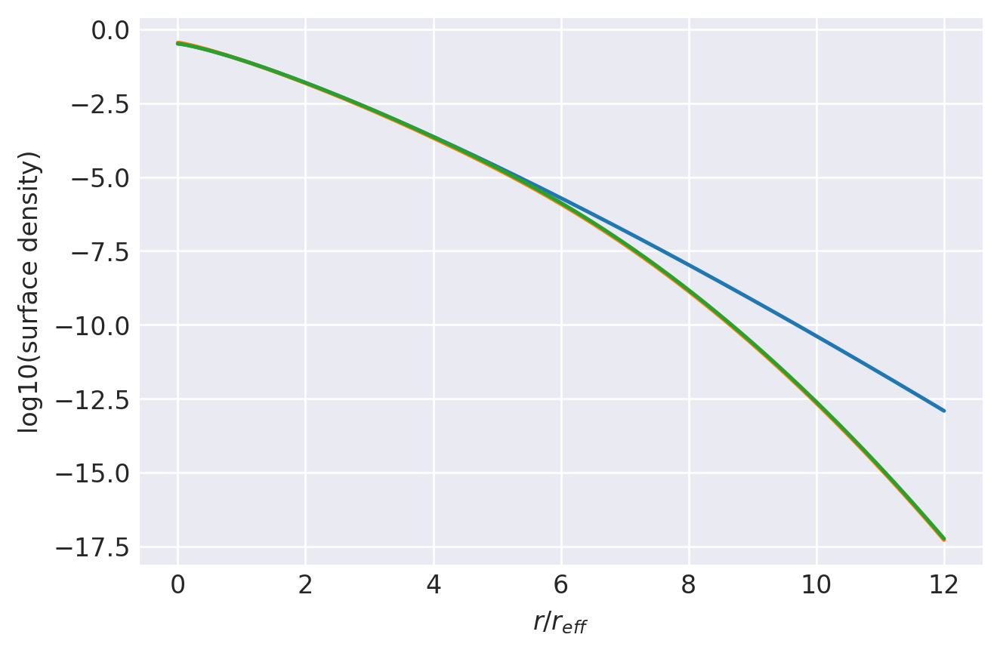

n=0.8: (
    normalize(np.array([1.0630591798e-01, 3.5788680408e-01, 3.4441936291e-01, 1.4234048678e-01, 3.9480676666e-02, 7.9425290289e-03, 1.4902269164e-03, 1.3399563559e-04])),
    np.array([1.6912423757e+00, 1.2899071293e+00, 9.2930546099e-01, 6.3589994631e-01, 4.0699848261e-01, 2.4865523904e-01, 1.3579360014e-01, 6.0459740412e-02]),
),
1.0000000201648103 1.00000002198968
prev.  chisq = -6.614352368932637
ws, re: (array([1.06305918e-01, 3.57886804e-01, 3.44419363e-01, 1.42340487e-01,
       3.94806767e-02, 7.94252903e-03, 1.49022692e-03, 1.33995636e-04]), array([1.57351098, 1.24040477, 0.91114136, 0.63172738, 0.40699848,
       0.25158801, 0.1386652 , 0.06244879]))
         Current function value: -10.489210
         Iterations: 29
         Function evaluations: 1083
         Gradient evaluations: 119
-10.489209775632482 [-1.97633028 -0.30475914  0.72733947  1.15214971  1.50897225  1.56524642
  2.52571425]
1.0000000201648103 1.0000000200405772


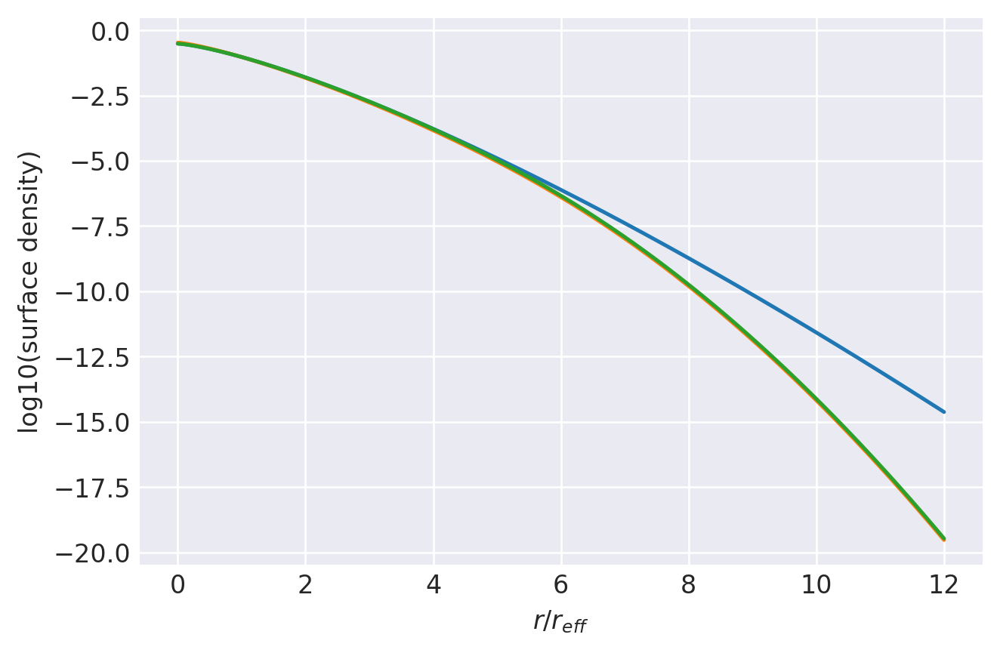

n=0.75: (
    normalize(np.array([1.2171057651e-01, 3.7274118798e-01, 3.4085132120e-01, 1.2515373710e-01, 3.2382257539e-02, 5.9228317009e-03, 1.1463765424e-03, 9.1711443625e-05])),
    np.array([1.5735109829e+00, 1.2404047712e+00, 9.1114135570e-01, 6.3172738063e-01, 4.0699848261e-01, 2.5158801022e-01, 1.3866519632e-01, 6.2448793978e-02]),
),
1.0000000187857572 1.0000000206902129
prev.  chisq = -6.484670028710574
ws, re: (array([1.21710577e-01, 3.72741188e-01, 3.40851321e-01, 1.25153737e-01,
       3.23822575e-02, 5.92283170e-03, 1.14637654e-03, 9.17114436e-05]), array([1.45670274, 1.1895849 , 0.89211605, 0.6272971 , 0.40699848,
       0.25476146, 0.14180217, 0.06464755]))
         Current function value: -10.438046
         Iterations: 26
         Function evaluations: 829
         Gradient evaluations: 91
-10.438046351868053 [-1.77386471 -0.18274096  0.90515011  1.23525533  1.6225875   1.50812391
  2.69654172]
1.0000000187857572 1.0000000187136115


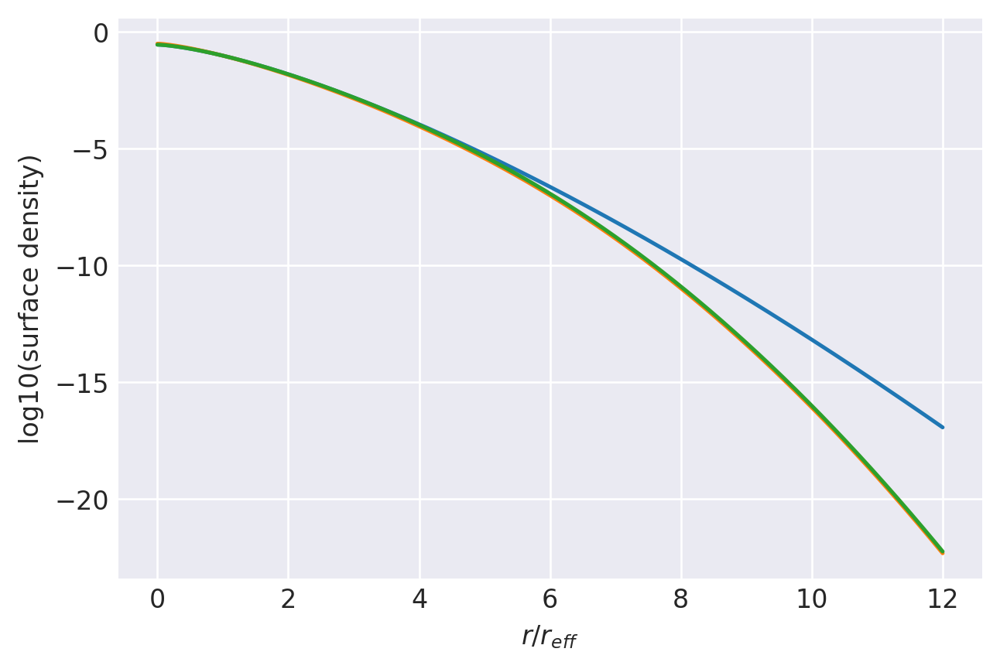

n=0.7: (
    normalize(np.array([1.4506237306e-01, 3.8851911422e-01, 3.3209310629e-01, 1.0406686999e-01, 2.5270467213e-02, 4.0841463033e-03, 8.4681512148e-04, 5.7107798106e-05])),
    np.array([1.4567027409e+00, 1.1895849005e+00, 8.9211604928e-01, 6.2729710496e-01, 4.0699848261e-01, 2.5476146129e-01, 1.4180217454e-01, 6.4647551298e-02]),
),
1.000000018143855 1.0000000191068241
prev.  chisq = -6.9702642346946435
ws, re: (array([1.45062373e-01, 3.88519114e-01, 3.32093106e-01, 1.04066870e-01,
       2.52704672e-02, 4.08414630e-03, 8.46815121e-04, 5.71077981e-05]), array([1.39866262, 1.16364016, 0.88224782, 0.62497433, 0.40699848,
       0.25645034, 0.14348421, 0.06583755]))
         Current function value: -10.435246
         Iterations: 23
         Function evaluations: 965
         Gradient evaluations: 106
-10.435245581242553 [-1.64650821 -0.10973408  1.01441379  1.27111493  1.69351707  1.45683955
  2.8183384 ]
1.000000018143855 1.000000018090374


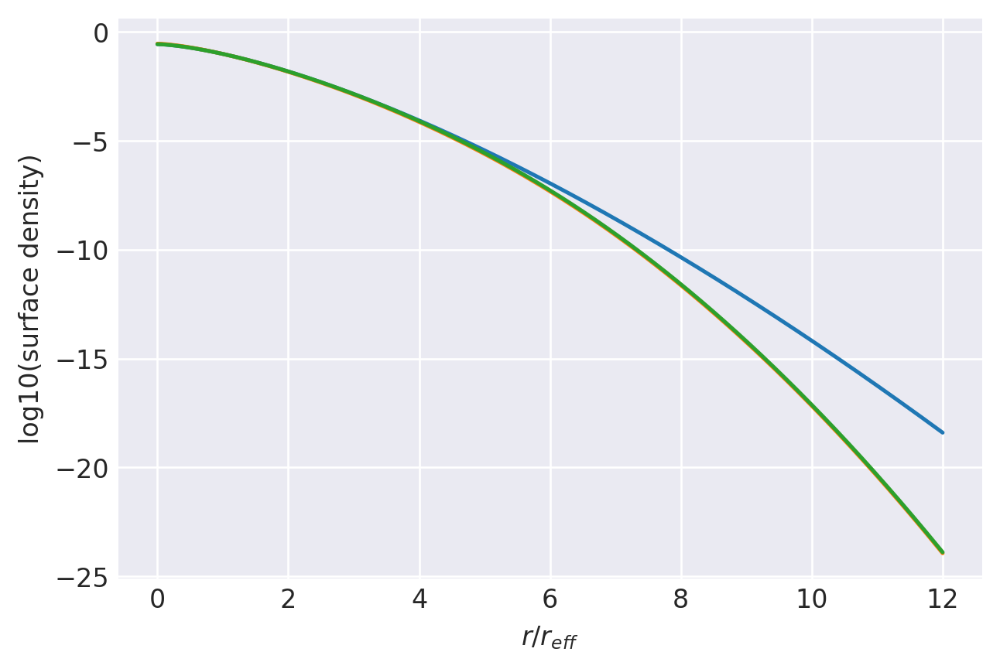

n=0.675: (
    normalize(np.array([1.6158143373e-01, 3.9623156376e-01, 3.2451354464e-01, 9.1895150739e-02, 2.1774578466e-02, 3.2472193970e-03, 7.1388662155e-04, 4.2622648253e-05])),
    np.array([1.3986626227e+00, 1.1636401634e+00, 8.8224782055e-01, 6.2497432916e-01, 4.0699848261e-01, 2.5645033574e-01, 1.4348420644e-01, 6.5837552531e-02]),
),
1.000000017532151 1.0000000185330615
prev.  chisq = -6.888109950113553
ws, re: (array([1.61581434e-01, 3.96231564e-01, 3.24513545e-01, 9.18951507e-02,
       2.17745785e-02, 3.24721940e-03, 7.13886622e-04, 4.26226483e-05]), array([1.34087566, 1.13731428, 0.87212252, 0.62257297, 0.40699848,
       0.25821479, 0.14525082, 0.06709564]))
         Current function value: -10.451373
         Iterations: 24
         Function evaluations: 1488
         Gradient evaluations: 164
-10.451373266523778 [-1.49532996 -0.02591537  1.14251507  1.29844572  1.77995661  1.38075534
  2.98261686]
1.000000017532151 1.0000000174933161


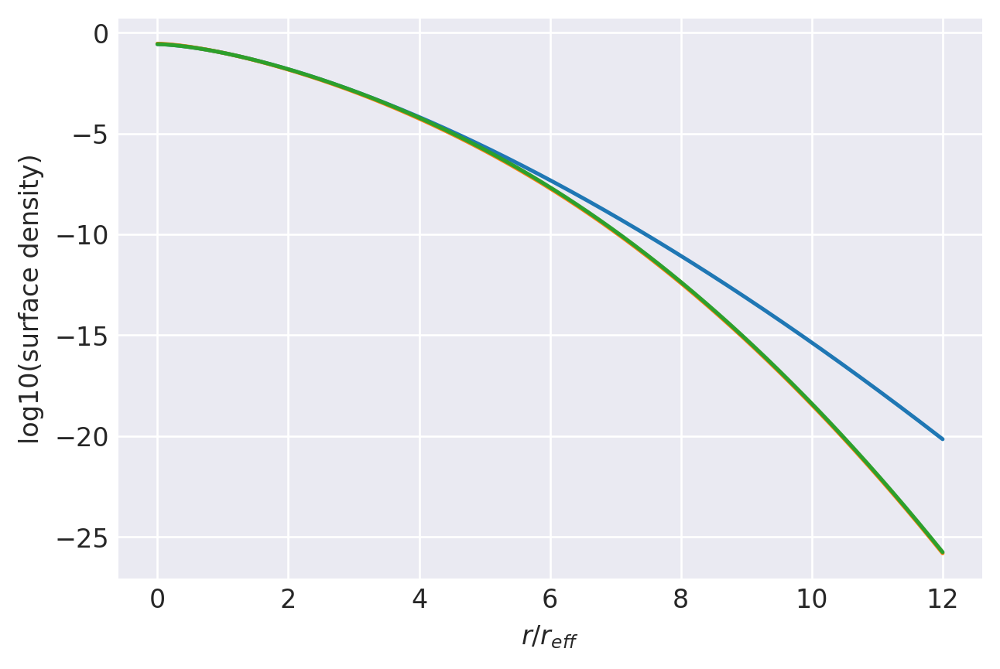

n=0.65: (
    normalize(np.array([1.8312307677e-01, 4.0314634073e-01, 3.1366616322e-01, 7.8607934512e-02, 1.8360131813e-02, 2.4743336827e-03, 5.9202712728e-04, 2.9992147618e-05])),
    np.array([1.3408756591e+00, 1.1373142787e+00, 8.7212251927e-01, 6.2257297452e-01, 4.0699848261e-01, 2.5821479496e-01, 1.4525082497e-01, 6.7095636048e-02]),
),
1.0000000169495604 1.0000000179940245
prev.  chisq = -6.7981908437152425
ws, re: (array([1.83123077e-01, 4.03146341e-01, 3.13666163e-01, 7.86079345e-02,
       1.83601318e-02, 2.47433368e-03, 5.92027127e-04, 2.99921476e-05]), array([1.28335042, 1.11058665, 0.86172316, 0.6200872 , 0.40699848,
       0.26006133, 0.14710979, 0.06842855]))
         Current function value: -10.491913
         Iterations: 25
         Function evaluations: 775
         Gradient evaluations: 85
-10.491913446755415 [-1.31255334  0.07208409  1.29577203  1.31051813  1.89049473  1.26640298
  3.21904912]
1.0000000169495604 1.0000000169219876


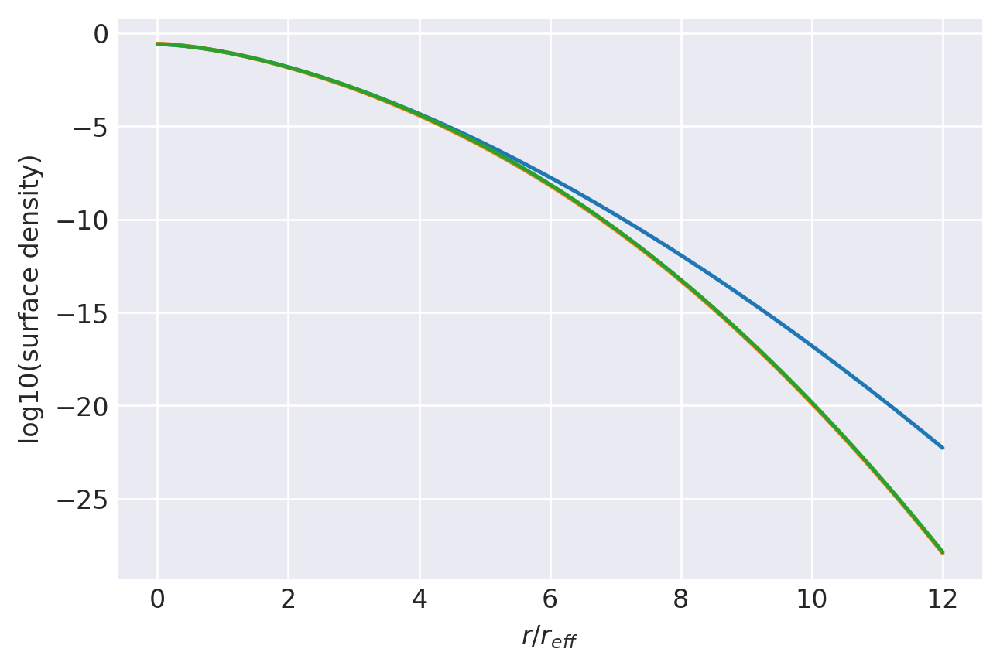

n=0.625: (
    normalize(np.array([2.1205989120e-01, 4.0816339559e-01, 2.9817126605e-01, 6.4272437465e-02, 1.5059125604e-02, 1.7739169622e-03, 4.8074083507e-04, 1.9226301341e-05])),
    np.array([1.2833504226e+00, 1.1105866505e+00, 8.6172316078e-01, 6.2008720171e-01, 4.0699848261e-01, 2.6006133089e-01, 1.4710979142e-01, 6.8428548522e-02]),
),
1.0000000166135572 1.0000000172576806
prev.  chisq = -7.157057287898724
ws, re: (array([2.12059891e-01, 4.08163396e-01, 2.98171266e-01, 6.42724375e-02,
       1.50591256e-02, 1.77391696e-03, 4.80740835e-04, 1.92263013e-05]), array([1.24896471, 1.09434793, 0.85534425, 0.61855253, 0.40699848,
       0.26121166, 0.14827312, 0.06926738]))
         Current function value: -10.531777
         Iterations: 25
         Function evaluations: 894
         Gradient evaluations: 98
-10.531776533110571 [-1.18279103  0.13977769  1.4037011   1.30580572  1.9743262   1.16994497
  3.42019189]
1.0000000166135572 1.0000000165913894


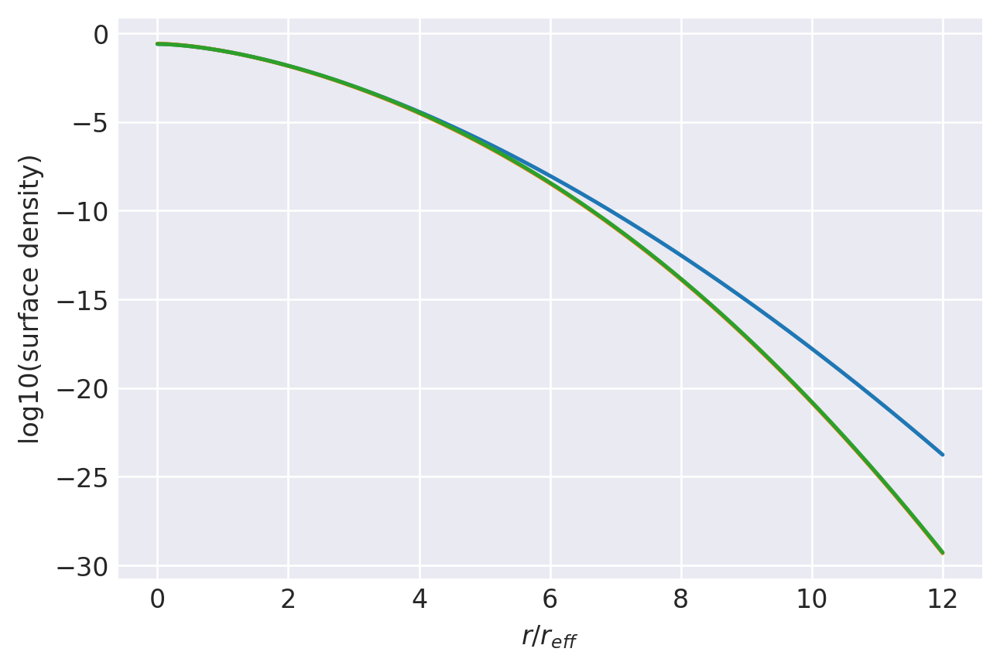

n=0.61: (
    normalize(np.array([2.3455073326e-01, 4.0942935137e-01, 2.8580229988e-01, 5.5247954001e-02, 1.3144485969e-02, 1.3928554440e-03, 4.1862834918e-04, 1.3691725032e-05])),
    np.array([1.2489647149e+00, 1.0943479322e+00, 8.5534424555e-01, 6.1855253318e-01, 4.0699848261e-01, 2.6121166258e-01, 1.4827311847e-01, 6.9267380016e-02]),
),
1.000000016395073 1.0000000168320957
prev.  chisq = -7.451619353266672
ws, re: (array([2.34550733e-01, 4.09429351e-01, 2.85802300e-01, 5.52479540e-02,
       1.31444860e-02, 1.39285544e-03, 4.18628349e-04, 1.36917250e-05]), array([1.22609613, 1.08343469, 0.8510309 , 0.61751048, 0.40699848,
       0.26199728, 0.14906993, 0.06984401]))
         Current function value: -10.566767
         Iterations: 28
         Function evaluations: 837
         Gradient evaluations: 92
-10.566767339783535 [-1.08554376  0.18957918  1.48411558  1.2953585   2.04055433  1.08892782
  3.5966694 ]
1.000000016395073 1.000000016376002


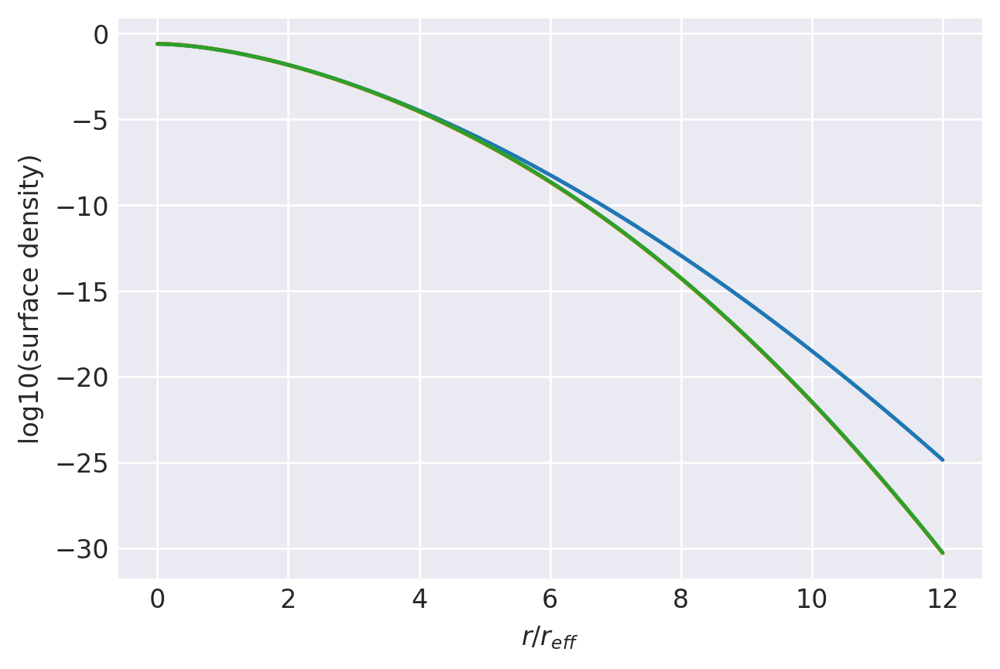

n=0.6: (
    normalize(np.array([2.5245834662e-01, 4.0909467761e-01, 2.7589974443e-01, 4.9102878429e-02, 1.1898113870e-02, 1.1568647668e-03, 3.7898445807e-04, 1.0389812892e-05])),
    np.array([1.2260961300e+00, 1.0834346938e+00, 8.5103090314e-01, 6.1751048171e-01, 4.0699848261e-01, 2.6199728208e-01, 1.4906992761e-01, 6.9844011123e-02]),
),
1.000000016395073 1.000000016375708
prev.  chisq = -10.566766720357453
ws, re: (array([2.52458372e-01, 4.09094719e-01, 2.75899772e-01, 4.91028833e-02,
       1.18981151e-02, 1.15686488e-03, 3.78984496e-04, 1.02898139e-05]), array([1.22609613, 1.08343469, 0.8510309 , 0.61751048, 0.40699848,
       0.26199728, 0.14906993, 0.06984401]))
         Current function value: -10.566767
         Iterations: 20
         Function evaluations: 524
         Gradient evaluations: 57
-10.566767339761409 [-1.08554365  0.18957907  1.4841157   1.29535826  2.04055515  1.08892374
  3.59676274]
1.000000016395073 1.0000000163760003


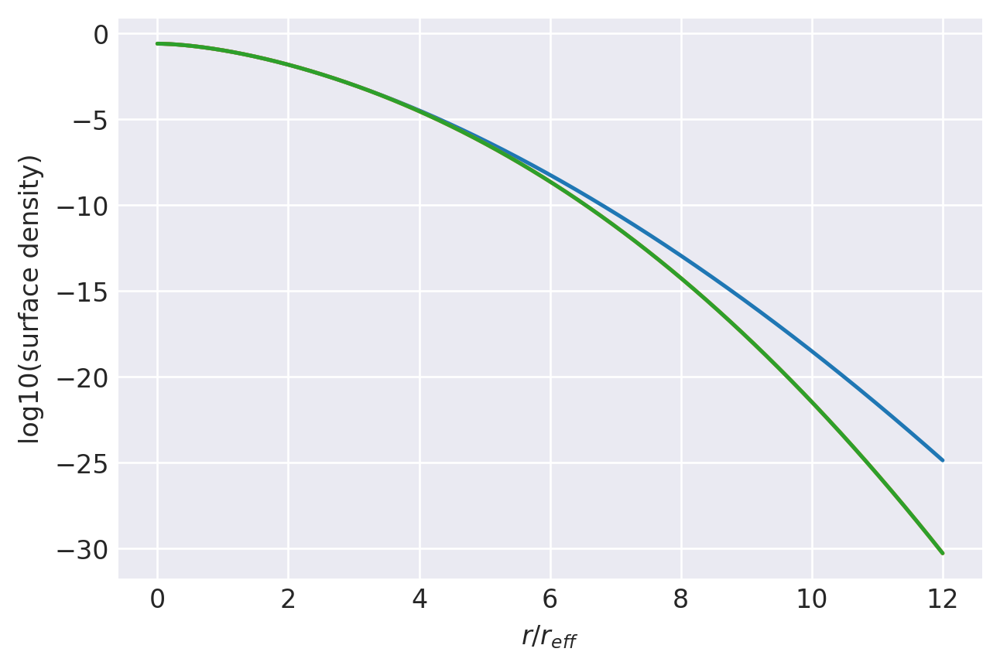

n=0.6: (
    normalize(np.array([2.5245836572e-01, 4.0909464664e-01, 2.7589976008e-01, 4.9102872964e-02, 1.1898116477e-02, 1.1568628929e-03, 3.7898633506e-04, 1.0388894620e-05])),
    np.array([1.2260961300e+00, 1.0834346938e+00, 8.5103090314e-01, 6.1751048171e-01, 4.0699848261e-01, 2.6199728208e-01, 1.4906992761e-01, 6.9844011123e-02]),
),


In [6]:
# Let's try one more approach. From n=0.7 to n=1, log(n) vs log(rdivre) for the sigmaspline is nearly linear, so just fix those and only fit the weights
x100 = np.log10(np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01,
                          4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02]))
x70 = np.log10(np.array([1.5052384522e+00, 1.1895849021e+00, 8.9211604870e-01, 6.2729710480e-01,
                         4.1395531956e-01, 2.5476146085e-01, 1.4180217436e-01, 6.4647551382e-02]))
w70 =     normalize(np.array([1.1646435020e-01, 4.2739124945e-01, 3.1922751878e-01, 1.0653680383e-01,
                              2.4816881868e-02, 4.7669777519e-03, 7.2686739303e-04, 6.9350722705e-05])),
slopes = (x100-x70)/-np.log10(0.7)
print(slopes)
# That did not actually work well below n<0.7, which was the whole point, so let's try again
x50 = np.array([0])
slopes[:len(x50)] = (x100[:len(x50)]-x50)/-np.log10(0.5/1.0)
slopes[4] = 0
print(slopes)

class RadiusExtrapolator:
    # Straight n=0.7 slopes
    # delta = np.array([1.11799858, 0.89465879, 0.49097738,  0.21019219, 0.19796296, -0.07311309, -0.49345005, -0.88741601])
    # Adjusted slopes
    # delta = np.array([1.21540882, 1.20028606, 0.68721482, 0.66704026, 0.45818359, 0.19252795, -0.67281483, -1.29645156])
    delta = np.array([1.11799858, 0.60634281, 0.30585517, 0.10200563, 0., -0.18168242, -0.32424482, -0.50154897])
    #xref = np.log10(np.array([1.5052384522e+00, 1.1895849021e+00, 8.9211604870e-01, 6.2729710480e-01, 4.1395531956e-01, 2.5476146085e-01, 1.4180217436e-01, 6.4647551382e-02]))
    xref = np.log10(np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02]))
    nref = 1.0
    @staticmethod
    def r(nsersic):
        return(RadiusExtrapolator.xref + RadiusExtrapolator.delta*np.log10(nsersic/RadiusExtrapolator.nref))

for n in [1, 0.75, 0.5]:
    print(n, 10**RadiusExtrapolator.r(n))

nvals = [
    (
        np.array([1.0, 0.95, 0.9, 0.85, 0.8, 0.75, 0.7, 0.675, 0.65, 0.625, 0.61, 0.6]),
        (
	normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
	np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
        ),
    )
]
fitweights(nvals, rmid, areasq, funcrdivreslog=RadiusExtrapolator.r)
# This point is very slightly off so redo it?
nvals = [
    (
        np.array([0.6]),
        (
    normalize(np.array([2.5245834662e-01, 4.0909467761e-01, 2.7589974443e-01, 4.9102878429e-02, 1.1898113870e-02, 1.1568647668e-03, 3.7898445807e-04, 1.0289812892e-05])),
    np.array([1.2260961300e+00, 1.0834346938e+00, 8.5103090314e-01, 6.1751048171e-01, 4.0699848261e-01, 2.6199728208e-01, 1.4906992761e-01, 6.9844011123e-02]),
        )
    )
]
fitweights(nvals, rmid, areasq, funcrdivreslog=RadiusExtrapolator.r)

## Drop components after a weight threshold is reached

Continuing with fits with a fixed size but free weights, we drop one component at n=0.6 and a second at n=0.52 - values where the smallest weights drop rapidly below 1e-6. Waiting until this point keeps weights of the remaining components changing smoothly as they adapt to dropping what turns out to be the smallest component the first time and the second-smallest component the second time. Sticking to N=6 works well enough down to n=0.50025, surprisingly, after which the size of the largest components asymptotes to one and all of the other weights drop to zero.

1.000000016180935 1.0000000166010006
prev.  chisq = -7.405727767254611
ws, re: (array([2.52460957e-01, 4.09098957e-01, 2.75902583e-01, 4.91034046e-02,
       1.18982316e-02, 1.15687862e-03, 3.78988386e-04]), array([1.20327248, 1.07244961, 0.84666737, 0.61645272, 0.40699848,
       0.26279853, 0.14988452]))
         Current function value: -10.608733
         Iterations: 21
         Function evaluations: 1311
         Gradient evaluations: 162
-10.608732738048971 [-0.97732383  0.24321833  1.574118    1.27323781  2.1377313   0.93167024]
1.000000016180935 1.0000000161500542


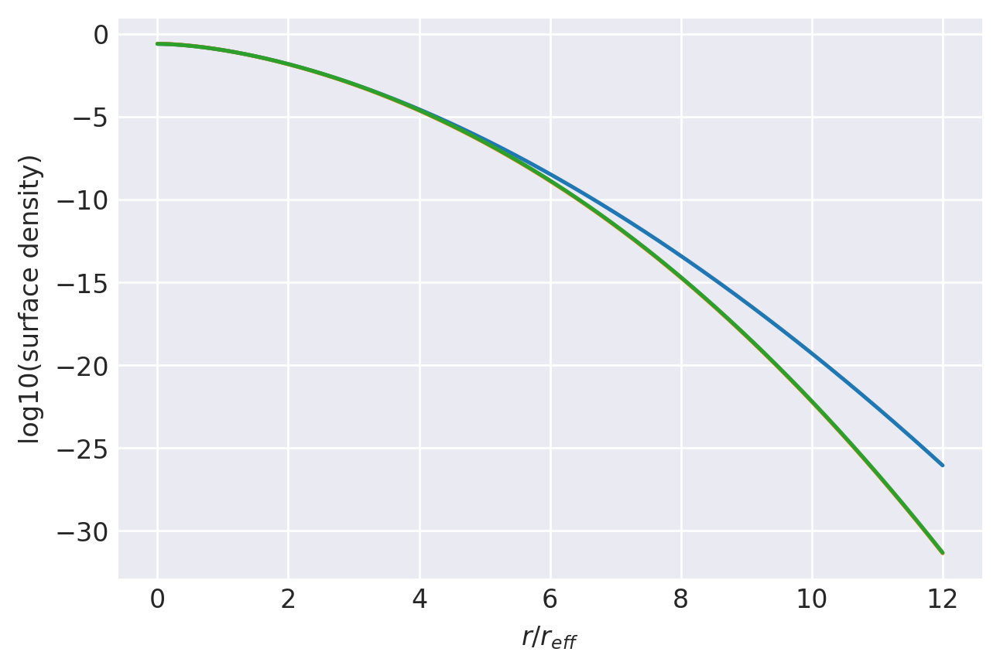

n=0.59: (
    normalize(np.array([2.7342311737e-01, 4.0725114082e-01, 2.6451982308e-01, 4.2819672717e-02, 1.0721897659e-02, 9.0706123730e-04, 3.5728712119e-04])),
    np.array([1.2032724773e+00, 1.0724496147e+00, 8.4666736639e-01, 6.1645271595e-01, 4.0699848261e-01, 2.6279852866e-01, 1.4988451982e-01]),
),
1.0000000159710858 1.0000000164214031
prev.  chisq = -7.356826251053931
ws, re: (array([2.73423117e-01, 4.07251141e-01, 2.64519823e-01, 4.28196727e-02,
       1.07218977e-02, 9.07061237e-04, 3.57287121e-04]), array([1.18049443, 1.06139099, 0.84225219, 0.61537873, 0.40699848,
       0.26361599, 0.1507176 ]))
         Current function value: -10.663192
         Iterations: 20
         Function evaluations: 547
         Gradient evaluations: 67
-10.663191854780276 [-0.85688927  0.30302665  1.67215007  1.24588477  2.22466679  0.82079802]
1.0000000159710858 1.0000000159480174


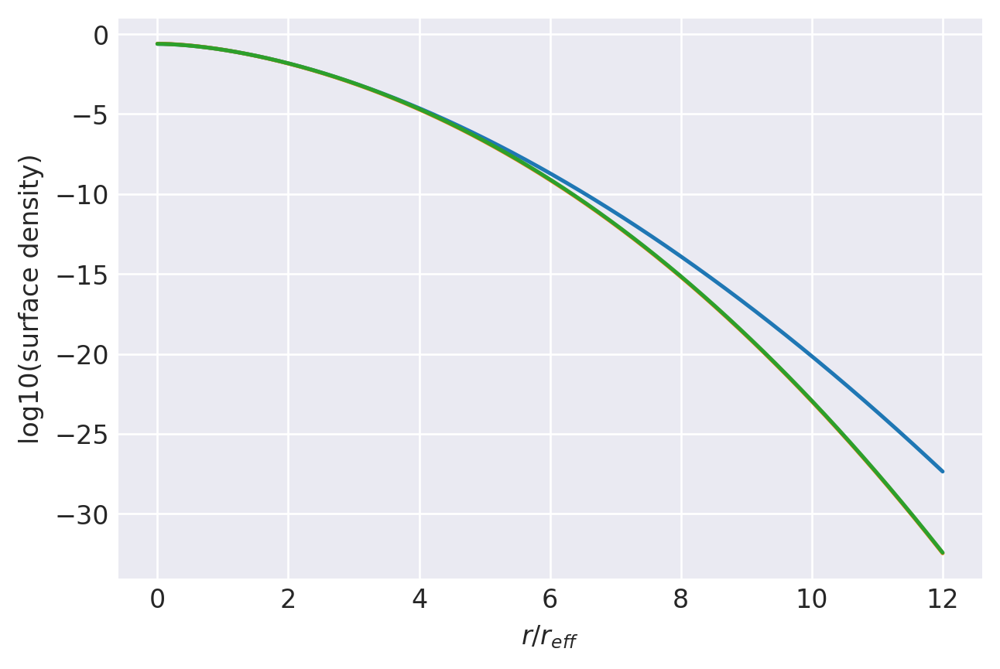

n=0.58: (
    normalize(np.array([2.9798967625e-01, 4.0378386983e-01, 2.5106559963e-01, 3.6624491405e-02, 9.5084651482e-03, 7.1377805658e-04, 3.1411967561e-04])),
    np.array([1.1804944278e+00, 1.0613909922e+00, 8.4225218538e-01, 6.1537872646e-01, 4.0699848261e-01, 2.6361598606e-01, 1.5071760363e-01]),
),
1.0000000157654723 1.0000000162372373
prev.  chisq = -7.305007361034506
ws, re: (array([2.97989676e-01, 4.03783870e-01, 2.51065600e-01, 3.66244914e-02,
       9.50846515e-03, 7.13778057e-04, 3.14119676e-04]), array([1.15776267, 1.05025705, 0.83778384, 0.61428798, 0.40699848,
       0.26445027, 0.15156993]))
         Current function value: -10.730509
         Iterations: 20
         Function evaluations: 748
         Gradient evaluations: 92
-10.730509459939451 [-0.72045784  0.36932833  1.78197256  1.20561246  2.32857491  0.68016211]
1.0000000157654723 1.000000015749041


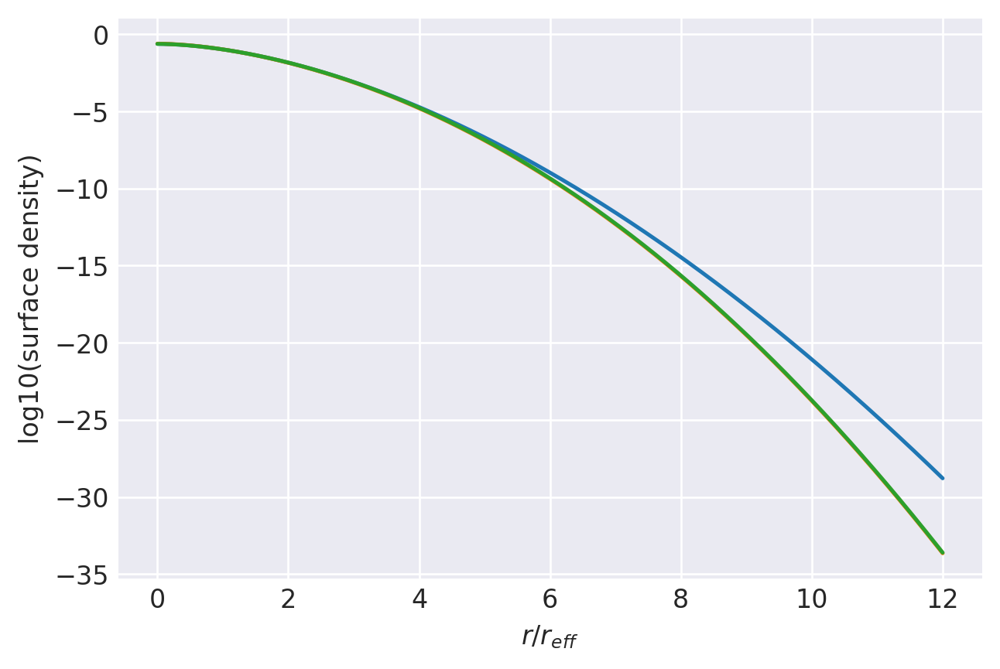

n=0.57: (
    normalize(np.array([3.2729217229e-01, 3.9776989744e-01, 2.3533044530e-01, 3.0478819346e-02, 8.3181872063e-03, 5.3797521451e-04, 2.7250320482e-04])),
    np.array([1.1577626743e+00, 1.0502570529e+00, 8.3778384238e-01, 6.1428797815e-01, 4.0699848261e-01, 2.6445027035e-01, 1.5156992865e-01]),
),
1.0000000155640396 1.0000000160586235
prev.  chisq = -7.249559186861768
ws, re: (array([3.27292172e-01, 3.97769897e-01, 2.35330445e-01, 3.04788193e-02,
       8.31818721e-03, 5.37975215e-04, 2.72503205e-04]), array([1.13507793, 1.03904595, 0.83326075, 0.61317991, 0.40699848,
       0.26530203, 0.15244229]))
         Current function value: -10.814895
         Iterations: 22
         Function evaluations: 1043
         Gradient evaluations: 129
-10.814895181801258 [-0.56335435  0.44364259  1.90641315  1.14807258  2.45531574  0.49584485]
1.0000000155640396 1.0000000155531175


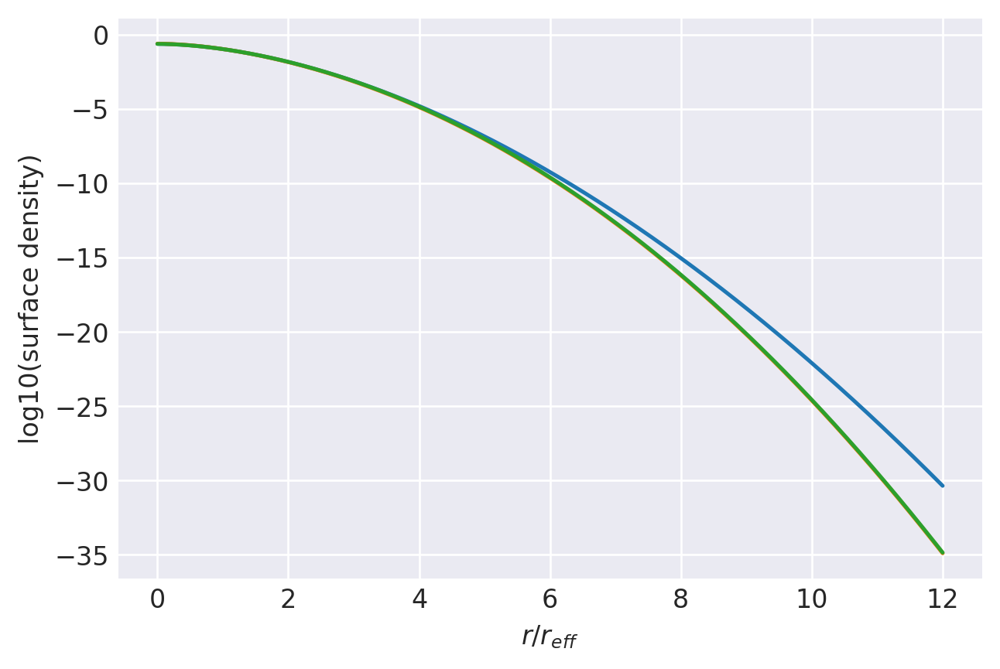

n=0.56: (
    normalize(np.array([3.6277168471e-01, 3.8815274536e-01, 2.1684908855e-01, 2.4465013395e-02, 7.1479186018e-03, 3.8131011683e-04, 2.3223926263e-04])),
    np.array([1.1350779325e+00, 1.0390459488e+00, 8.3326074749e-01, 6.1317990851e-01, 4.0699848261e-01, 2.6530203239e-01, 1.5244228873e-01]),
),
1.000000015366738 1.0000000158862299
prev.  chisq = -7.189783050663808
ws, re: (array([3.62771685e-01, 3.88152745e-01, 2.16849089e-01, 2.44650134e-02,
       7.14791860e-03, 3.81310117e-04, 2.32239263e-04]), array([1.11244094, 1.02775575, 0.82868123, 0.61205393, 0.40699848,
       0.26617196, 0.15333553]))
         Current function value: -10.922875
         Iterations: 20
         Function evaluations: 1655
         Gradient evaluations: 204
-10.92287471936028 [-0.37832355  0.52808214  2.04945017  1.06682952  2.61395763  0.24151325]
1.000000015366738 1.0000000153602346


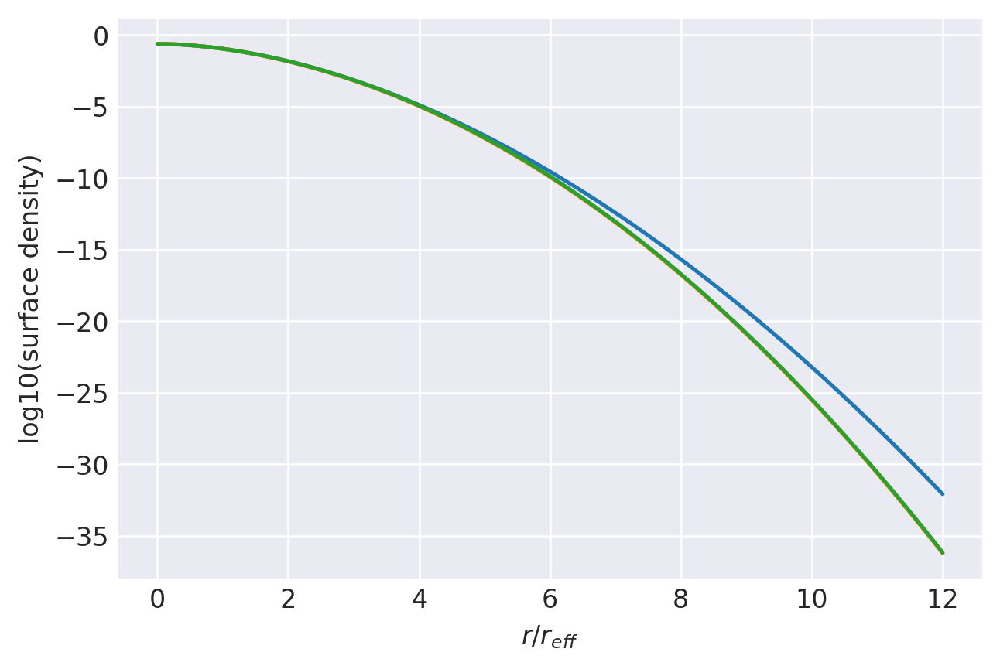

n=0.55: (
    normalize(np.array([4.0653129980e-01, 3.7331299348e-01, 1.9503419029e-01, 1.8690245197e-02, 5.9923658145e-03, 2.4582501349e-04, 1.9308040378e-04])),
    np.array([1.1124409422e+00, 1.0277557525e+00, 8.2868123386e-01, 6.1205392567e-01, 4.0699848261e-01, 2.6617196038e-01, 1.5333552543e-01]),
),
1.0000000152696222 1.0000000155383884
prev.  chisq = -7.735021527355214
ws, re: (array([4.06531300e-01, 3.73312993e-01, 1.95034190e-01, 1.86902452e-02,
       5.99236581e-03, 2.45825013e-04, 1.93080404e-04]), array([1.10114059, 1.02208037, 0.82636978, 0.61148402, 0.40699848,
       0.26661396, 0.15379025]))
         Current function value: -10.988857
         Iterations: 19
         Function evaluations: 556
         Gradient evaluations: 68
-10.988856594353893 [-0.27183276  0.57500176  2.12966592  1.01438394  2.70956238  0.07212288]
1.0000000152696222 1.0000000152649275


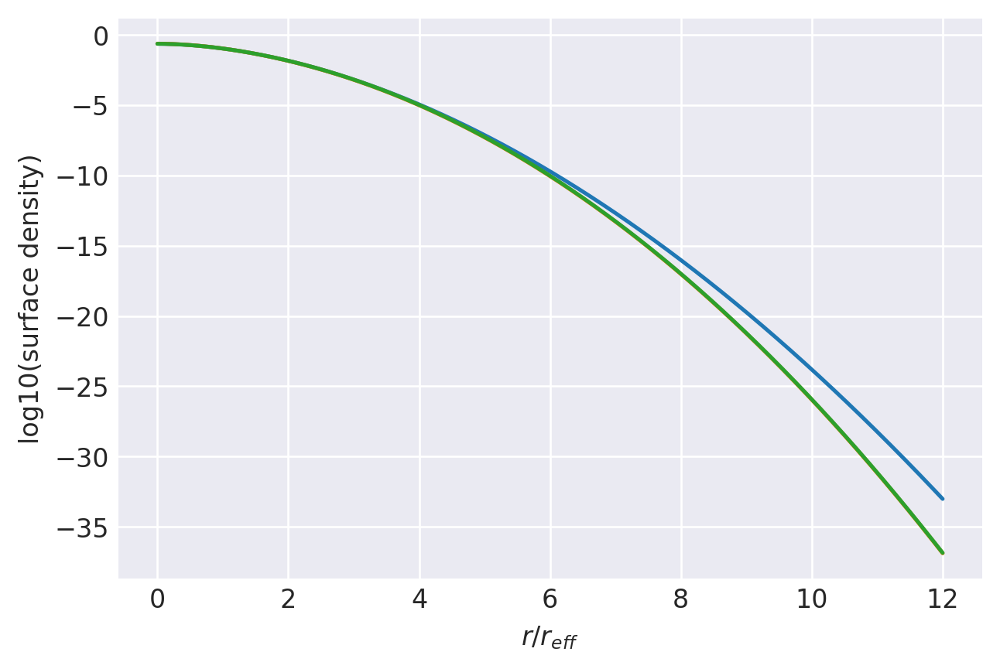

n=0.545: (
    normalize(np.array([4.3245721135e-01, 3.6317999558e-01, 1.8264991837e-01, 1.5934584072e-02, 5.4176591161e-03, 1.8681538912e-04, 1.7381613173e-04])),
    np.array([1.1011405919e+00, 1.0220803696e+00, 8.2636977680e-01, 6.1148402330e-01, 4.0699848261e-01, 2.6661396260e-01, 1.5379024945e-01]),
),
1.00000001517352 1.000000015450834
prev.  chisq = -7.700226035752861
ws, re: (array([4.32457211e-01, 3.63179996e-01, 1.82649918e-01, 1.59345841e-02,
       5.41765912e-03, 1.86815389e-04, 1.73816132e-04]), array([1.08985247, 1.01638445, 0.82404355, 0.61090941, 0.40699848,
       0.26706078, 0.15425053]))
         Current function value: -11.065392
         Iterations: 21
         Function evaluations: 835
         Gradient evaluations: 103
-11.0653923744143 [-0.15316369  0.62569422  2.21694677  0.95176274  2.8196582  -0.14305552]
1.00000001517352 1.0000000151703734


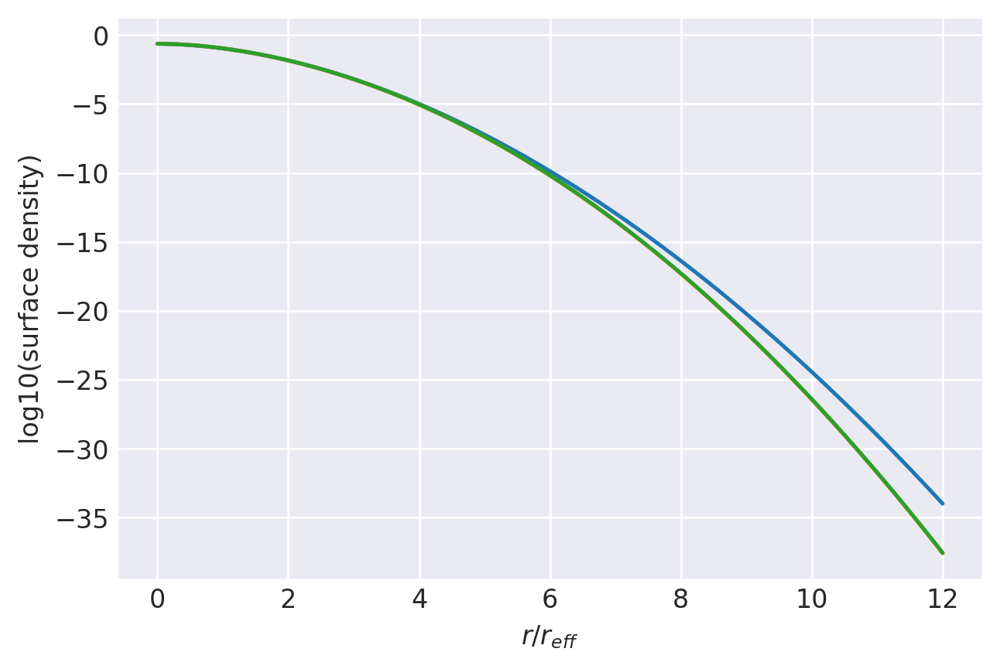

n=0.54: (
    normalize(np.array([4.6178375897e-01, 3.5065460886e-01, 1.6913577387e-01, 1.3293695525e-02, 4.8433704286e-03, 1.3408542013e-04, 1.5470693357e-04])),
    np.array([1.0898524684e+00, 1.0163844524e+00, 8.2404355242e-01, 6.1090940632e-01, 4.0699848261e-01, 2.6706078280e-01, 1.5425053175e-01]),
),
1.0000000150784267 1.0000000153648274
prev.  chisq = -7.663553217528976
ws, re: (array([4.61783759e-01, 3.50654609e-01, 1.69135774e-01, 1.32936955e-02,
       4.84337043e-03, 1.34085420e-04, 1.54706934e-04]), array([1.07857667, 1.01066774, 0.82170233, 0.61032999, 0.40699848,
       0.26751252, 0.15471649]))
         Current function value: -11.155364
         Iterations: 19
         Function evaluations: 611
         Gradient evaluations: 75
-11.155363850448166 [-0.01908535  0.68078768  2.31255311  0.8765464   2.94830882 -0.43248489]
1.0000000150784267 1.000000015076569


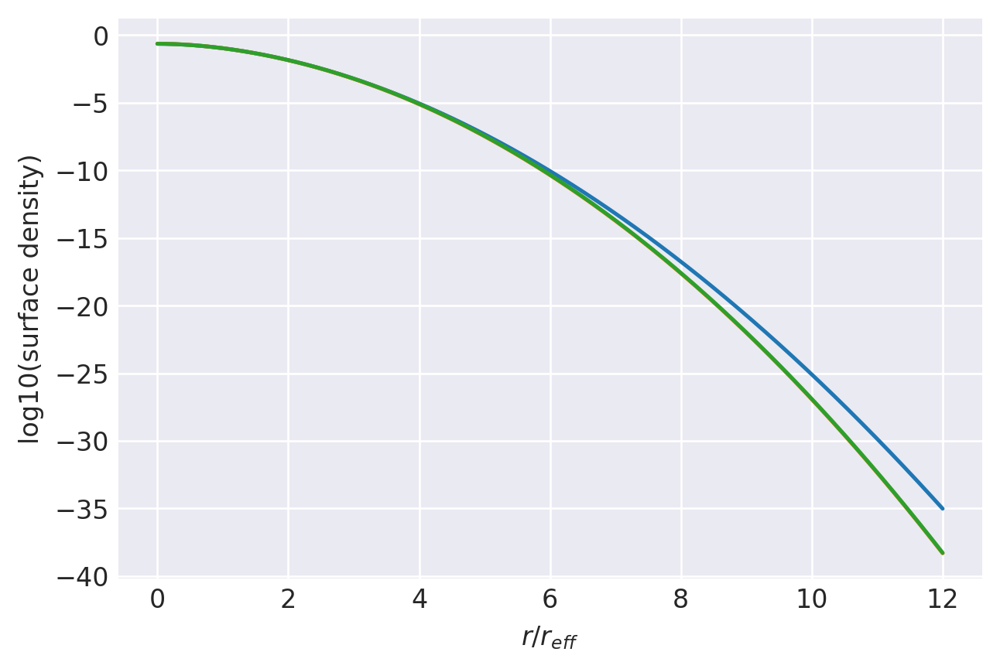

n=0.535: (
    normalize(np.array([4.9522880846e-01, 3.3512490107e-01, 1.5436308688e-01, 1.0791562352e-02, 4.2678833803e-03, 8.8056127394e-05, 1.3570172893e-04])),
    np.array([1.0785766716e+00, 1.0106677356e+00, 8.2170232835e-01, 6.1032999152e-01, 4.0699848261e-01, 2.6751251884e-01, 1.5471649270e-01]),
),
1.0000000150218527 1.0000000151982913
prev.  chisq = -8.071654949911041
ws, re: (array([4.95228808e-01, 3.35124901e-01, 1.54363087e-01, 1.07915624e-02,
       4.26788338e-03, 8.80561274e-05, 1.35701729e-04]), array([1.07181715, 1.00722761, 0.8202903 , 0.60998   , 0.40699848,
       0.26778596, 0.15499885]))
         Current function value: -11.217473
         Iterations: 22
         Function evaluations: 891
         Gradient evaluations: 110
-11.217472717934832 [ 0.07064687  0.71627153  2.37459088  0.82398492  3.03700572 -0.66713883]
1.0000000150218527 1.0000000150206467


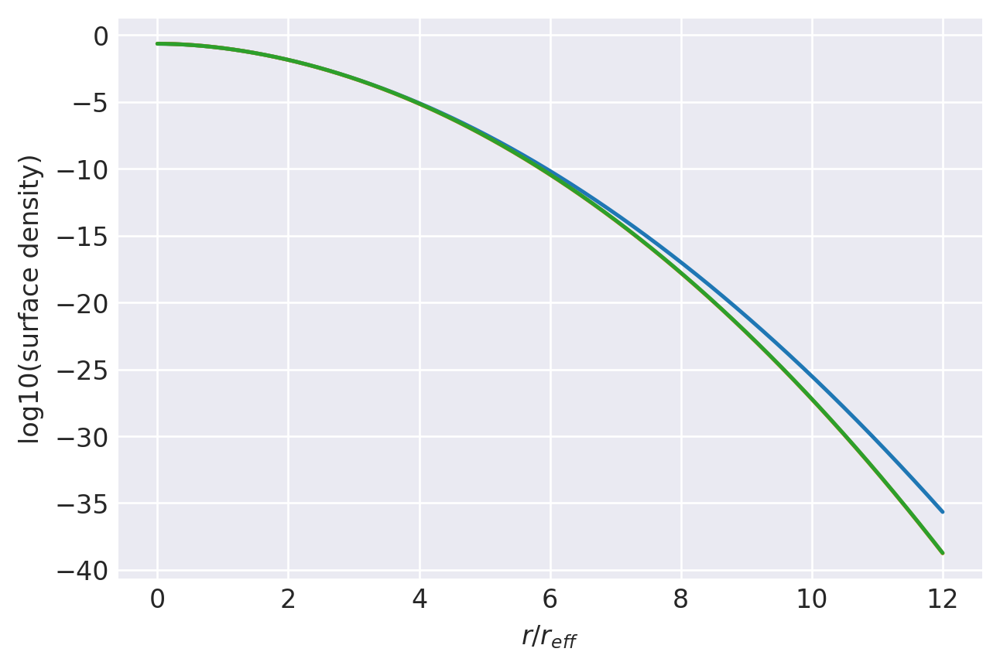

n=0.532: (
    normalize(np.array([5.1765437436e-01, 3.2403277496e-01, 1.4483553471e-01, 9.3678339714e-03, 3.9213425170e-03, 6.3805211044e-05, 1.2433427376e-04])),
    np.array([1.0718171524e+00, 1.0072276089e+00, 8.2029029517e-01, 6.0998000422e-01, 4.0699848261e-01, 2.6778596187e-01, 1.5499884649e-01]),
),
1.000000014984337 1.0000000151040438
prev.  chisq = -8.40080079914215
ws, re: (array([5.17654374e-01, 3.24032775e-01, 1.44835535e-01, 9.36783397e-03,
       3.92134252e-03, 6.38052110e-05, 1.24334274e-04]), array([1.0673133 , 1.00492995, 0.81934587, 0.60974569, 0.40699848,
       0.26796927, 0.15518826]))
         Current function value: -11.262994
         Iterations: 17
         Function evaluations: 764
         Gradient evaluations: 94
-11.262994360368507 [ 0.13515595  0.74107146  2.41812557  0.78537615  3.10153897 -0.86406757]
1.000000014984337 1.0000000149835115


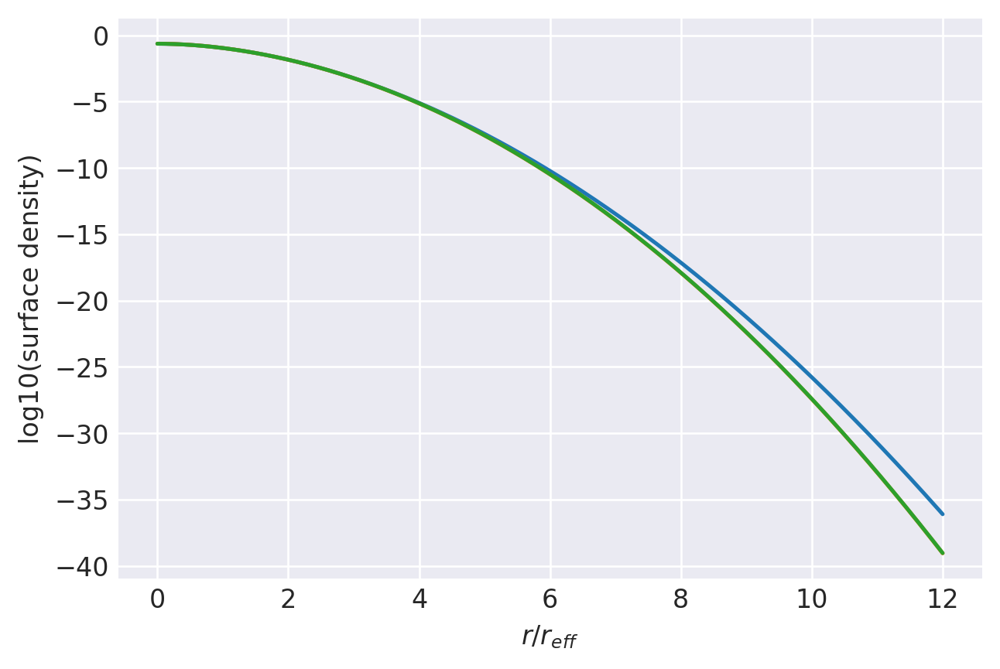

n=0.53: (
    normalize(np.array([5.3373764497e-01, 3.1576690589e-01, 1.3818478104e-01, 8.4554302195e-03, 3.6892937230e-03, 4.9200819606e-05, 1.1674334056e-04])),
    np.array([1.0673133028e+00, 1.0049299476e+00, 8.1934586630e-01, 6.0974569342e-01, 4.0699848261e-01, 2.6796927151e-01, 1.5518825641e-01]),
),
1.000000014946981 1.000000015068651
prev.  chisq = -8.384029395117597
ws, re: (array([5.33737645e-01, 3.15766906e-01, 1.38184781e-01, 8.45543022e-03,
       3.68929372e-03, 4.92008196e-05, 1.16743341e-04]), array([1.06281146, 1.00262887, 0.81839896, 0.60951059, 0.40699848,
       0.2681534 , 0.15537862]))
         Current function value: -11.312344
         Iterations: 23
         Function evaluations: 956
         Gradient evaluations: 118
-11.312343629819111 [ 0.20402732  0.766852    2.46362295  0.74339272  3.17182113 -1.11584688]
1.000000014946981 1.0000000149464954


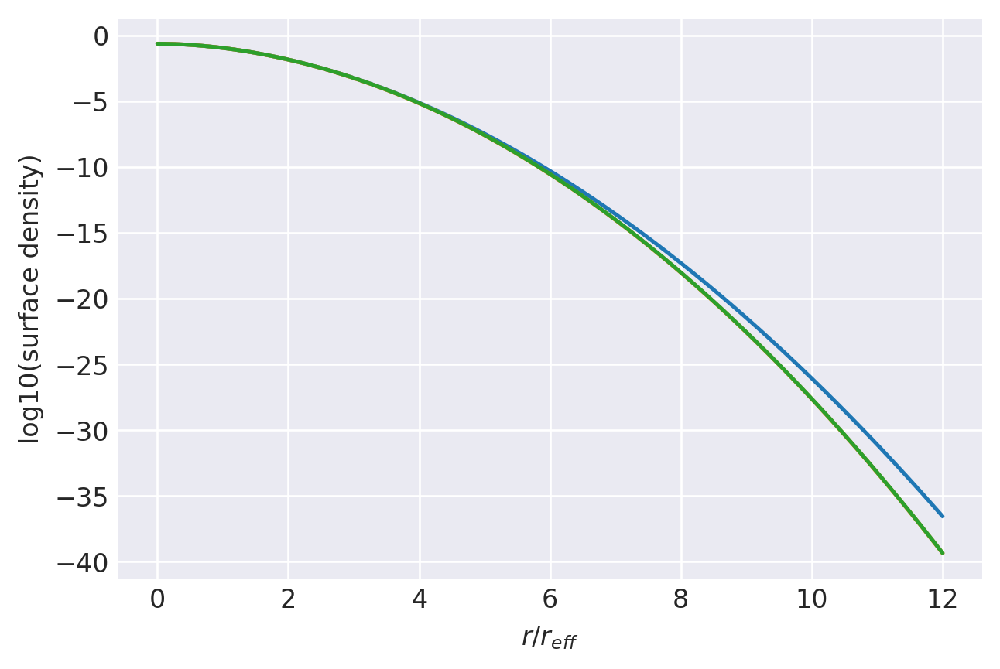

n=0.528: (
    normalize(np.array([5.5083062326e-01, 3.0671060379e-01, 1.3128316436e-01, 7.5741268531e-03, 3.4565580298e-03, 3.5764628819e-05, 1.0915907943e-04])),
    np.array([1.0628114583e+00, 1.0026288705e+00, 8.1839896032e-01, 6.0951058728e-01, 4.0699848261e-01, 2.6815340039e-01, 1.5537861521e-01]),
),
1.0000000149097839 1.0000000150334654
prev.  chisq = -8.366780739762037
ws, re: (array([5.50830623e-01, 3.06710604e-01, 1.31283164e-01, 7.57412685e-03,
       3.45655803e-03, 3.57646288e-05, 1.09159079e-04]), array([1.05831163, 1.00032436, 0.81744956, 0.60927468, 0.40699848,
       0.26833836, 0.15556993]))
         Current function value: -11.366094
         Iterations: 18
         Function evaluations: 427
         Gradient evaluations: 52
-11.366093916691273 [ 0.2779069   0.79369747  2.51123634  0.69767159  3.24853276 -1.46070787]
1.0000000149097839 1.0000000149095998


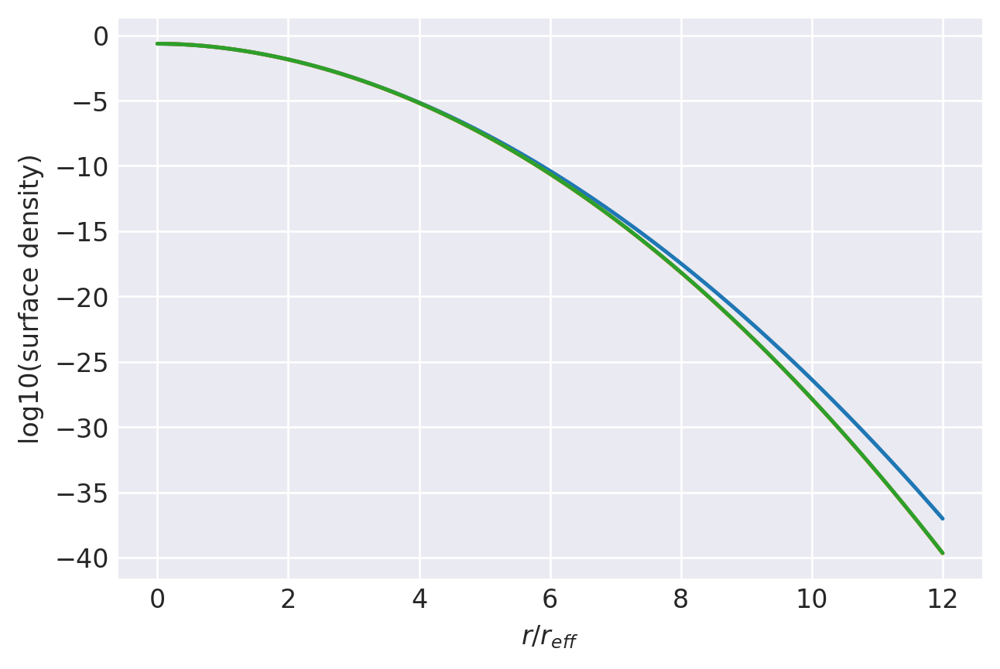

n=0.526: (
    normalize(np.array([5.6903299697e-01, 2.9677452229e-01, 1.2411808553e-01, 6.7263848761e-03, 3.2228628908e-03, 2.3572657295e-05, 1.0157478454e-04])),
    np.array([1.0583116255e+00, 1.0003243597e+00, 8.1744956132e-01, 6.0927468005e-01, 4.0699848261e-01, 2.6833835529e-01, 1.5556993127e-01]),
),
1.0000000148727461 1.000000014998497
prev.  chisq = -8.349019941930218
ws, re: (array([5.69032997e-01, 2.96774522e-01, 1.24118086e-01, 6.72638488e-03,
       3.22286289e-03, 2.35726573e-05, 1.01574785e-04]), array([1.05381381, 0.9980164 , 0.81649765, 0.60903797, 0.40699848,
       0.26852414, 0.15576221]))
         Current function value: -11.424957
         Iterations: 41
         Function evaluations: 1318
         Gradient evaluations: 163
-11.424956606635947 [ 0.35760264  0.82169352  2.56115815  0.64774773  3.33265995 -2.00258072]
1.0000000148727461 1.000000014872822


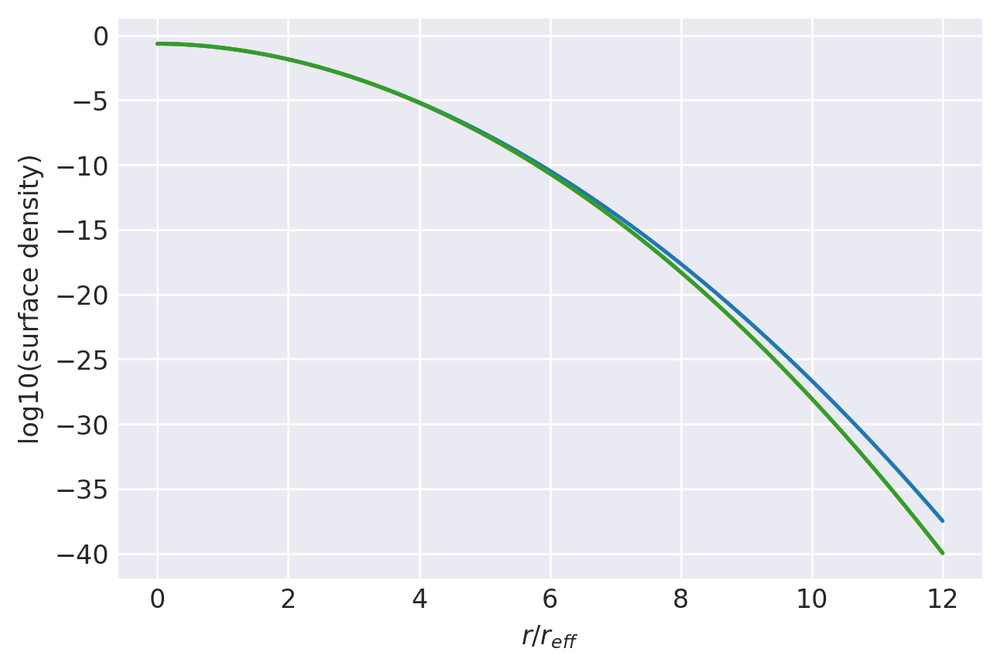

n=0.524: (
    normalize(np.array([5.8845997598e-01, 2.8585393500e-01, 1.1667685508e-01, 5.9145867582e-03, 2.9879821157e-03, 1.2685912871e-05, 9.3979143424e-05])),
    np.array([1.0538138112e+00, 9.9801639686e-01, 8.1649765322e-01, 6.0903796596e-01, 4.0699848261e-01, 2.6852414309e-01, 1.5576221307e-01]),
),
1.0000000148358668 1.0000000149637522
prev.  chisq = -8.330707458943587
ws, re: (array([5.88459976e-01, 2.85853935e-01, 1.16676855e-01, 5.91458676e-03,
       2.98798212e-03, 1.26859129e-05, 9.39791434e-05]), array([1.04931802, 0.99570496, 0.81554322, 0.60880044, 0.40699848,
       0.26871077, 0.15595547]))
         Current function value: -11.489829
         Iterations: 38
         Function evaluations: 1275
         Gradient evaluations: 158
-11.489829190459446 [ 0.44414032  0.85092452  2.61366502  0.5928913   3.4263657  -3.33657267]
1.0000000148358668 1.000000014836164


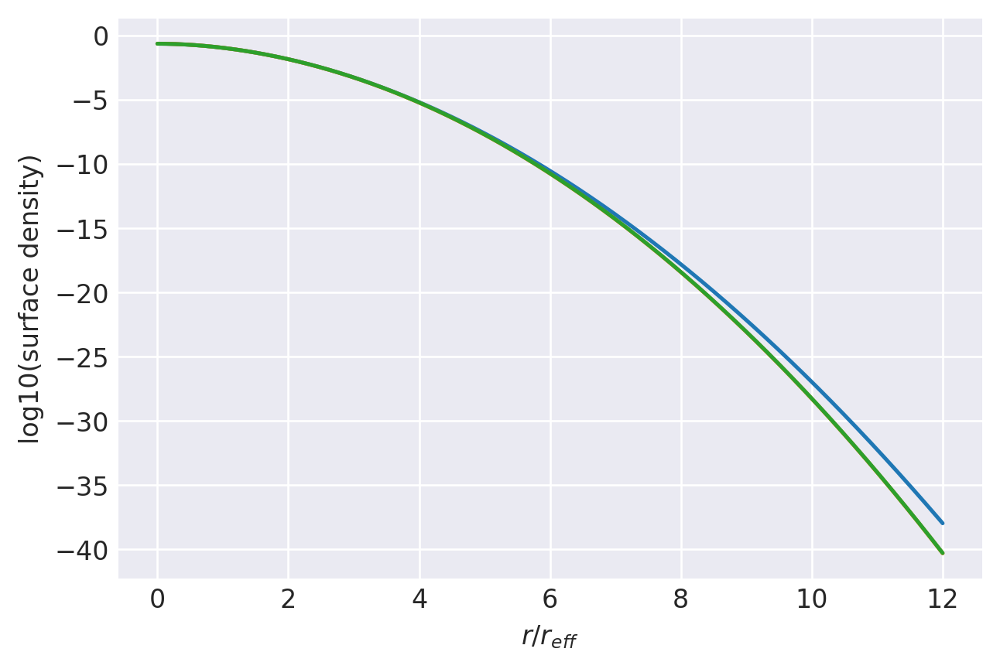

n=0.522: (
    normalize(np.array([6.0924514356e-01, 2.7382578144e-01, 1.0894701414e-01, 5.1406728389e-03, 2.7519367087e-03, 3.0715453848e-06, 8.6379768585e-05])),
    np.array([1.0493180221e+00, 9.9570496370e-01, 8.1554321978e-01, 6.0880043915e-01, 4.0699848261e-01, 2.6871077072e-01, 1.5595546920e-01]),
),
1.000000014799145 1.0000000149292436
prev.  chisq = -8.3117994189464
ws, re: (array([6.09245144e-01, 2.73825781e-01, 1.08947014e-01, 5.14067284e-03,
       2.75193671e-03, 3.07154538e-06, 8.63797686e-05]), array([1.04482427, 0.99339004, 0.81458624, 0.60856209, 0.40699848,
       0.26889825, 0.15614971]))
         Current function value: -11.561803
         Iterations: 33
         Function evaluations: 931
         Gradient evaluations: 115
-11.561802930608557 [ 0.5384367   0.8824124   2.66540046  0.54242162  3.47027513 -6.00365964]
1.000000014799145 1.0000000147994272


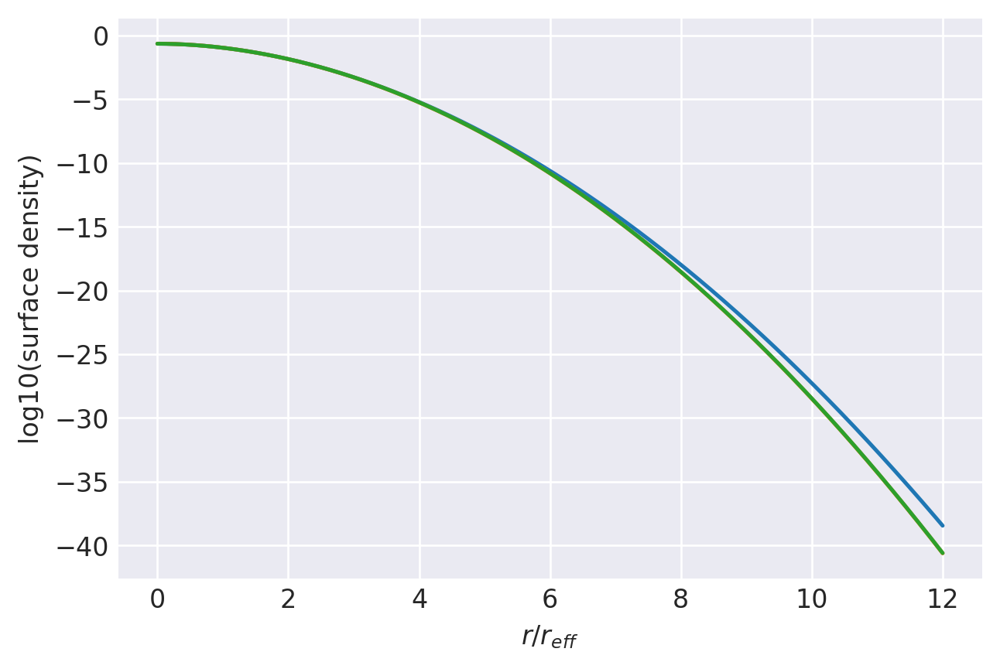

n=0.52: (
    normalize(np.array([6.3144867900e-01, 2.6068441343e-01, 1.0085058256e-01, 4.4369525187e-03, 2.5015530020e-03, 1.9171710587e-07, 7.7627771250e-05])),
    np.array([1.0448242651e+00, 9.9339004164e-01, 8.1458624458e-01, 6.0856209369e-01, 4.0699848261e-01, 2.6889824524e-01, 1.5614970835e-01]),
),
1.0000000148358668 1.0000000148355956
prev.  chisq = -11.488732783950082
ws, re: (array([6.09247015e-01, 2.73826623e-01, 1.08947349e-01, 5.14068863e-03,
       2.75194516e-03, 8.63800339e-05]), array([1.04931802, 0.99570496, 0.81554322, 0.60880044, 0.40699848,
       0.15595547]))
         Current function value: -11.489808
         Iterations: 13
         Function evaluations: 753
         Gradient evaluations: 106
-11.489808334278356 [0.44434784 0.85045699 2.61545949 0.58793051 3.4564358 ]
1.0000000148358668 1.000000014836278


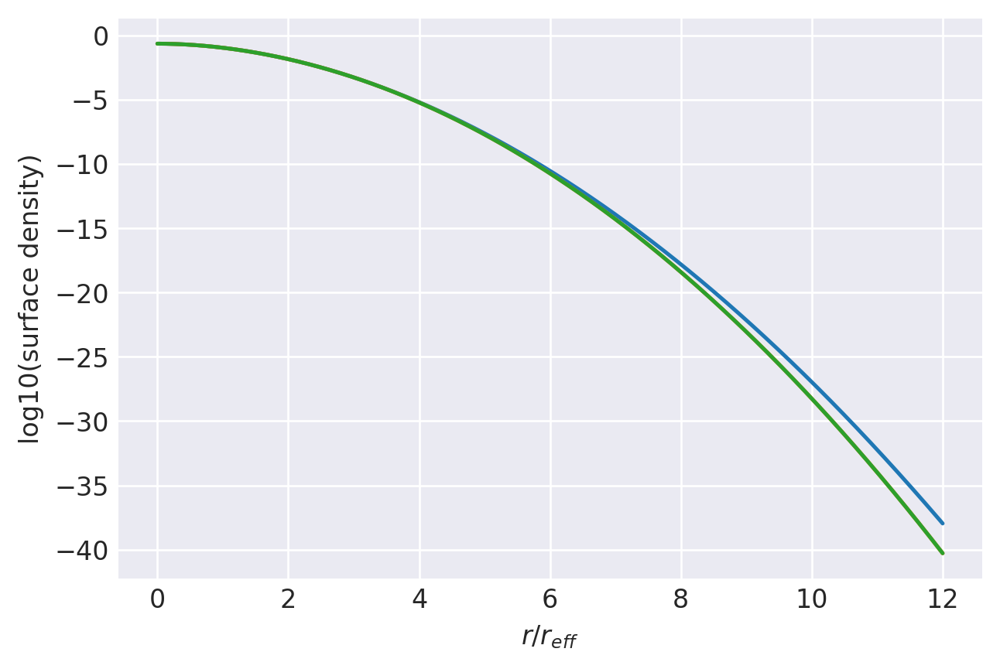

n=0.522: (
    normalize(np.array([6.0929454610e-01, 2.7375285462e-01, 1.0898227068e-01, 5.1240458981e-03, 2.7592504655e-03, 8.7032233832e-05])),
    np.array([1.0493180221e+00, 9.9570496370e-01, 8.1554321978e-01, 6.0880043915e-01, 4.0699848261e-01, 1.5595546920e-01]),
),
1.000000014799145 1.0000000149293593
prev.  chisq = -8.31178143816607
ws, re: (array([6.09294546e-01, 2.73752855e-01, 1.08982271e-01, 5.12404590e-03,
       2.75925047e-03, 8.70322338e-05]), array([1.04482427, 0.99339004, 0.81458624, 0.60856209, 0.40699848,
       0.15614971]))
         Current function value: -11.561808
         Iterations: 13
         Function evaluations: 691
         Gradient evaluations: 97
-11.561807575595408 [0.53845106 0.8823795  2.66553047 0.54206176 3.47241118]
1.000000014799145 1.0000000147994341


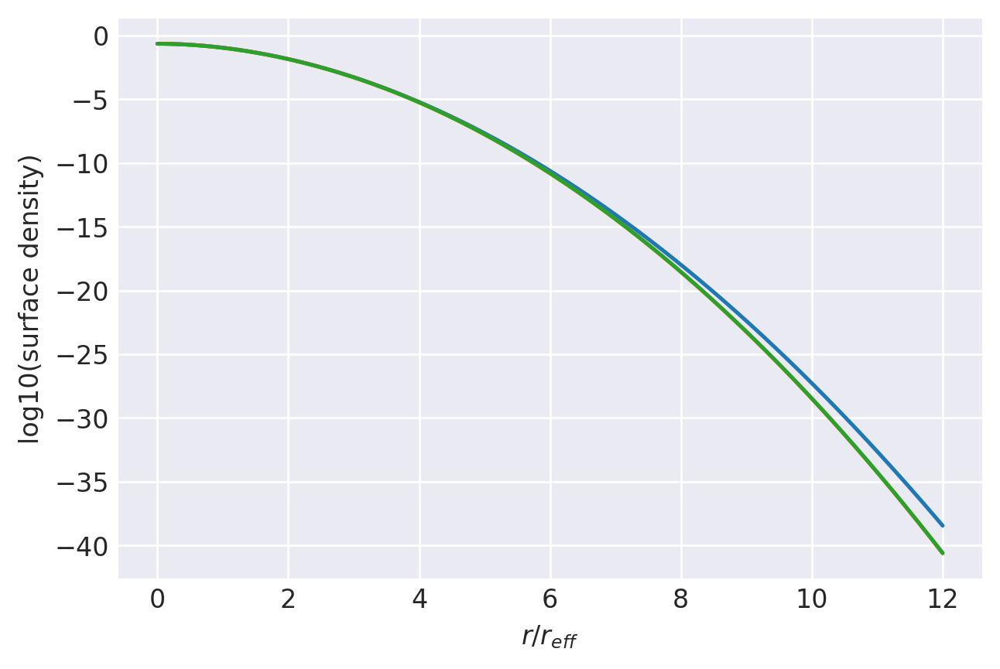

n=0.52: (
    normalize(np.array([6.3145202196e-01, 2.6067953885e-01, 1.0085286736e-01, 4.4358892704e-03, 2.5020147771e-03, 7.7667773694e-05])),
    np.array([1.0448242651e+00, 9.9339004164e-01, 8.1458624458e-01, 6.0856209369e-01, 4.0699848261e-01, 1.5614970835e-01]),
),
1.0000000147625825 1.0000000148947878
prev.  chisq = -8.29227857000693
ws, re: (array([6.31452022e-01, 2.60679539e-01, 1.00852867e-01, 4.43588927e-03,
       2.50201478e-03, 7.76677737e-05]), array([1.04033255, 0.99107161, 0.81362671, 0.60832292, 0.40699848,
       0.15634494]))
         Current function value: -11.642200
         Iterations: 21
         Function evaluations: 746
         Gradient evaluations: 105
-11.642200420596042 [0.64244828 0.91581434 2.71817962 0.49144691 3.48894832]
1.0000000147625825 1.000000014762764


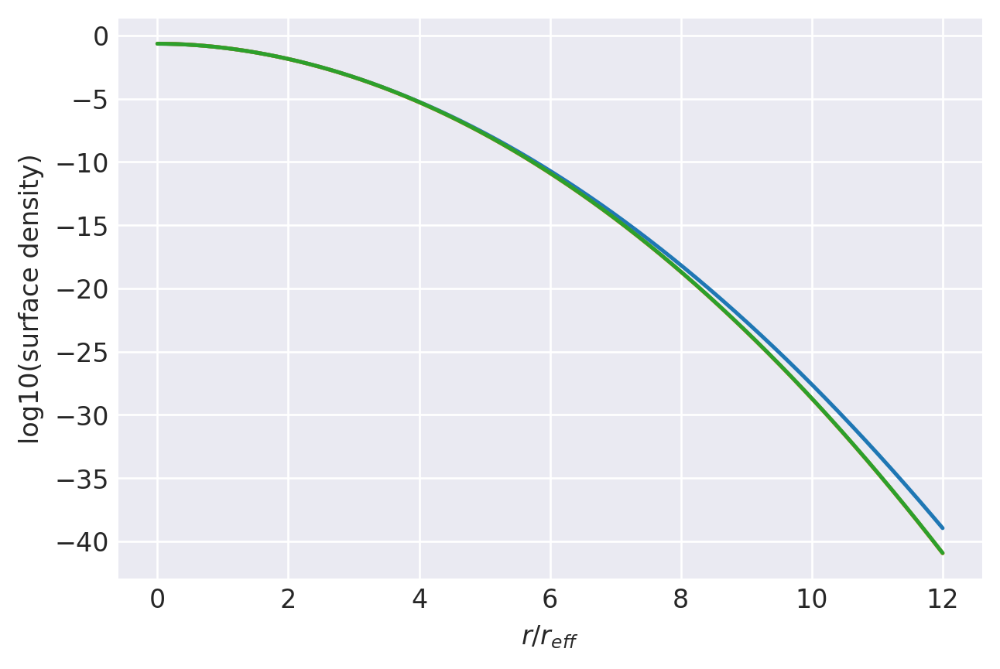

n=0.518: (
    normalize(np.array([6.5530668666e-01, 2.4617599374e-01, 9.2418200701e-02, 3.7841814100e-03, 2.2463497669e-03, 6.8587721196e-05])),
    np.array([1.0403325471e+00, 9.9107161197e-01, 8.1362671103e-01, 6.0832292360e-01, 4.0699848261e-01, 1.5634493934e-01]),
),
1.0000000147261765 1.0000000148605324
prev.  chisq = -8.272069914388112
ws, re: (array([6.55306687e-01, 2.46175994e-01, 9.24182007e-02, 3.78418141e-03,
       2.24634977e-03, 6.85877212e-05]), array([1.03584288, 0.98874966, 0.8126646 , 0.60808292, 0.40699848,
       0.15654117]))
         Current function value: -11.733062
         Iterations: 19
         Function evaluations: 1041
         Gradient evaluations: 147
-11.733061699906605 [0.75869497 0.95090188 2.77367799 0.43534378 3.50608917]
1.0000000147261765 1.0000000147262673


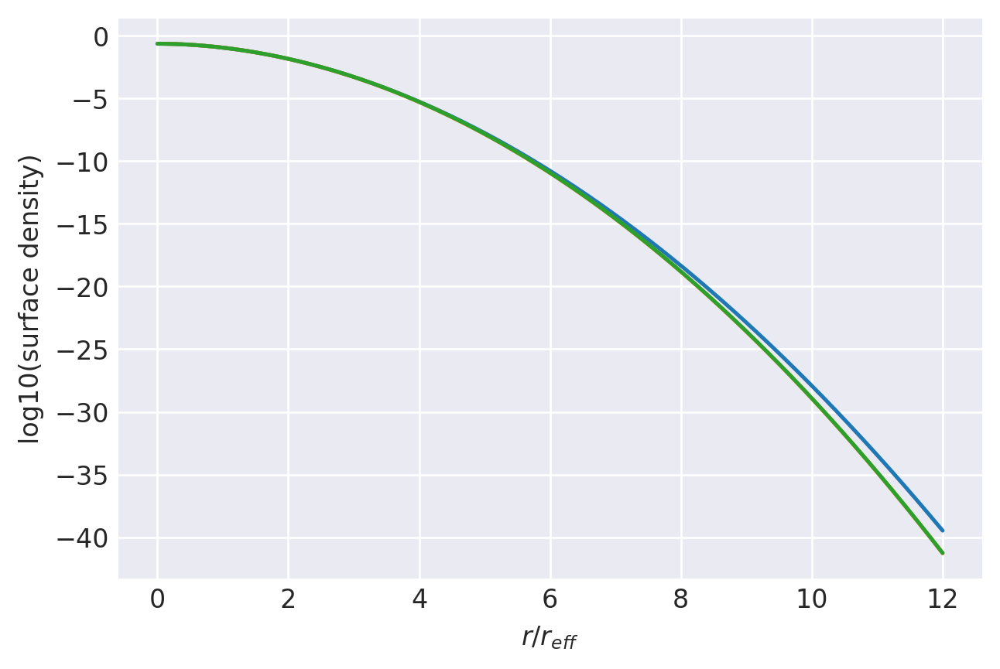

n=0.516: (
    normalize(np.array([6.8107033079e-01, 2.3004285983e-01, 8.3663531331e-02, 3.1713079895e-03, 1.9921767319e-03, 5.9793322102e-05])),
    np.array([1.0358428751e+00, 9.8874965581e-01, 8.1266460239e-01, 6.0808292284e-01, 4.0699848261e-01, 1.5654117109e-01]),
),
1.0000000146899282 1.0000000148266093
prev.  chisq = -8.251088811772357
ws, re: (array([6.81070331e-01, 2.30042860e-01, 8.36635313e-02, 3.17130799e-03,
       1.99217673e-03, 5.97933221e-05]), array([1.03135526, 0.98642415, 0.8116999 , 0.60784209, 0.40699848,
       0.15673841]))
         Current function value: -11.837294
         Iterations: 18
         Function evaluations: 878
         Gradient evaluations: 124
-11.837294470166244 [0.89049961 0.98780002 2.83234703 0.37281964 3.52388204]
1.0000000146899282 1.0000000146899446


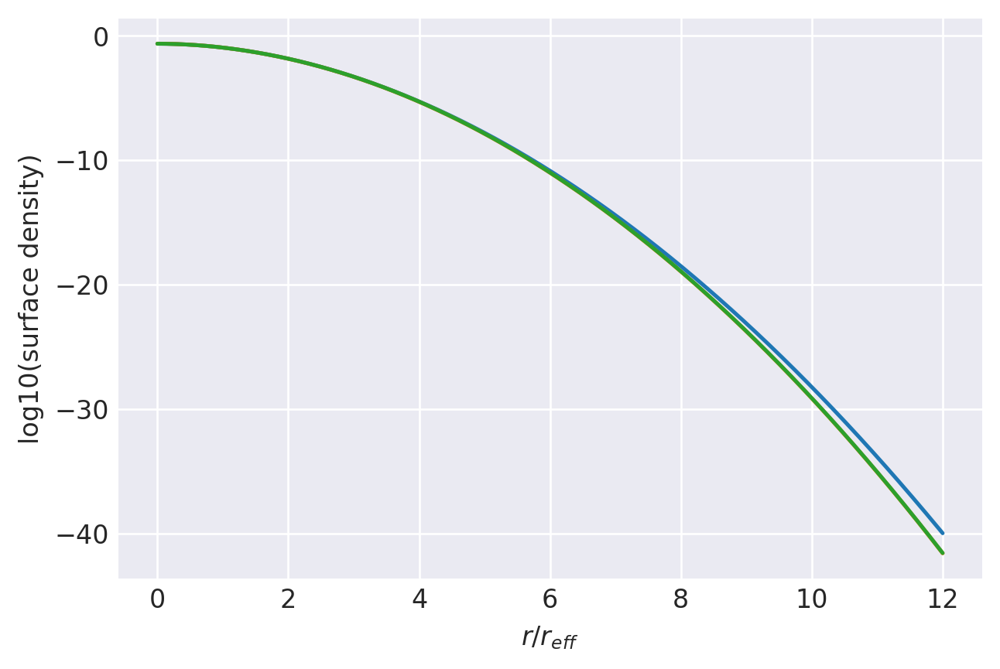

n=0.514: (
    normalize(np.array([7.0899326326e-01, 2.1204298031e-01, 7.4573290394e-02, 2.5997711160e-03, 1.7394088808e-03, 5.1286039046e-05])),
    np.array([1.0313552560e+00, 9.8642415408e-01, 8.1169990172e-01, 6.0784208526e-01, 4.0699848261e-01, 1.5673841264e-01]),
),
1.0000000146538368 1.0000000147930381
prev.  chisq = -8.229258012809044
ws, re: (array([7.08993263e-01, 2.12042980e-01, 7.45732904e-02, 2.59977112e-03,
       1.73940888e-03, 5.12860390e-05]), array([1.0268697 , 0.98409509, 0.81073259, 0.6076004 , 0.40699848,
       0.15693667]))
         Current function value: -11.959144
         Iterations: 15
         Function evaluations: 712
         Gradient evaluations: 100
-11.959143661691913 [1.04270972 1.02669892 2.89453927 0.30274135 3.54233379]
1.0000000146538368 1.000000014653796


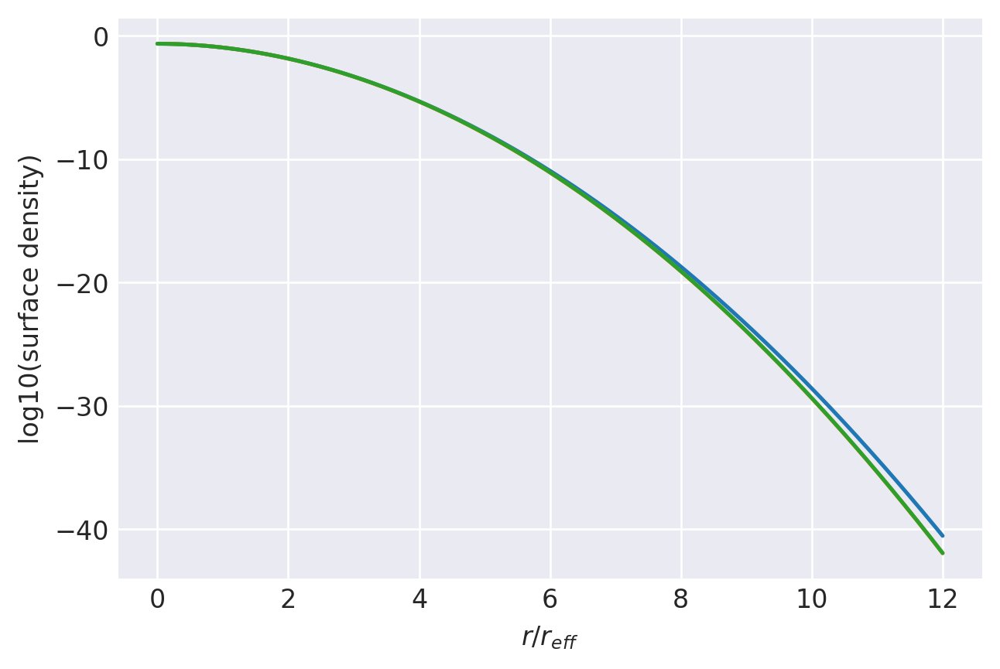

n=0.512: (
    normalize(np.array([7.3937251076e-01, 1.9189361212e-01, 6.5130560820e-02, 2.0723123381e-03, 1.4879346589e-03, 4.3069303048e-05])),
    np.array([1.0268696968e+00, 9.8409508755e-01, 8.1073259190e-01, 6.0760040469e-01, 4.0699848261e-01, 1.5693667314e-01]),
),
1.000000014617902 1.0000000147598418
prev.  chisq = -8.206487823326908
ws, re: (array([7.39372511e-01, 1.91893612e-01, 6.51305608e-02, 2.07231234e-03,
       1.48793466e-03, 4.30693030e-05]), array([1.0223862 , 0.98176244, 0.80976266, 0.60735787, 0.40699848,
       0.15713596]))
         Current function value: -12.105182
         Iterations: 19
         Function evaluations: 309
         Gradient evaluations: 44
-12.105182358047898 [1.22285736 1.0678035  2.9607191  0.22354238 3.56151638]
1.000000014617902 1.0000000146178212


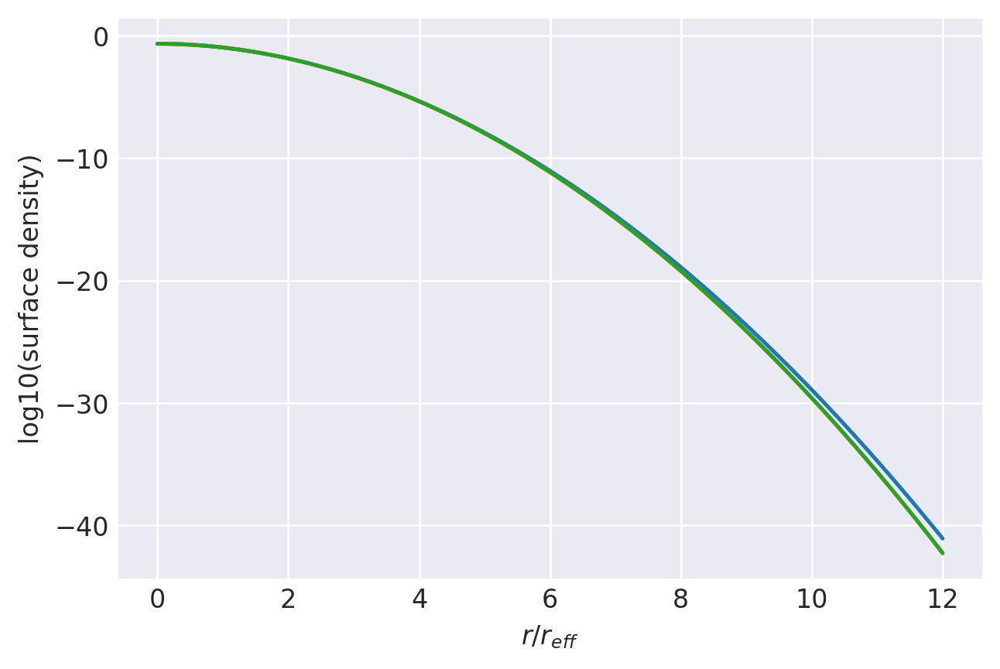

n=0.51: (
    normalize(np.array([7.7256600098e-01, 1.6925160100e-01, 5.5317942711e-02, 1.5916461383e-03, 1.2376647787e-03, 3.5144399178e-05])),
    np.array([1.0223862047e+00, 9.8176243679e-01, 8.0976265565e-01, 6.0735787486e-01, 4.0699848261e-01, 1.5713596187e-01]),
),
1.0000000145821235 1.0000000147270474
prev.  chisq = -8.182672527296415
ws, re: (array([7.72566001e-01, 1.69251601e-01, 5.53179427e-02, 1.59164614e-03,
       1.23766478e-03, 3.51443992e-05]), array([1.01790479, 0.97942618, 0.80879008, 0.60711449, 0.40699848,
       0.15733629]))
         Current function value: -12.286413
         Iterations: 18
         Function evaluations: 725
         Gradient evaluations: 102
-12.286412742588718 [1.44356728 1.11136231 3.03141247 0.13321025 3.58143942]
1.0000000145821235 1.000000014582021


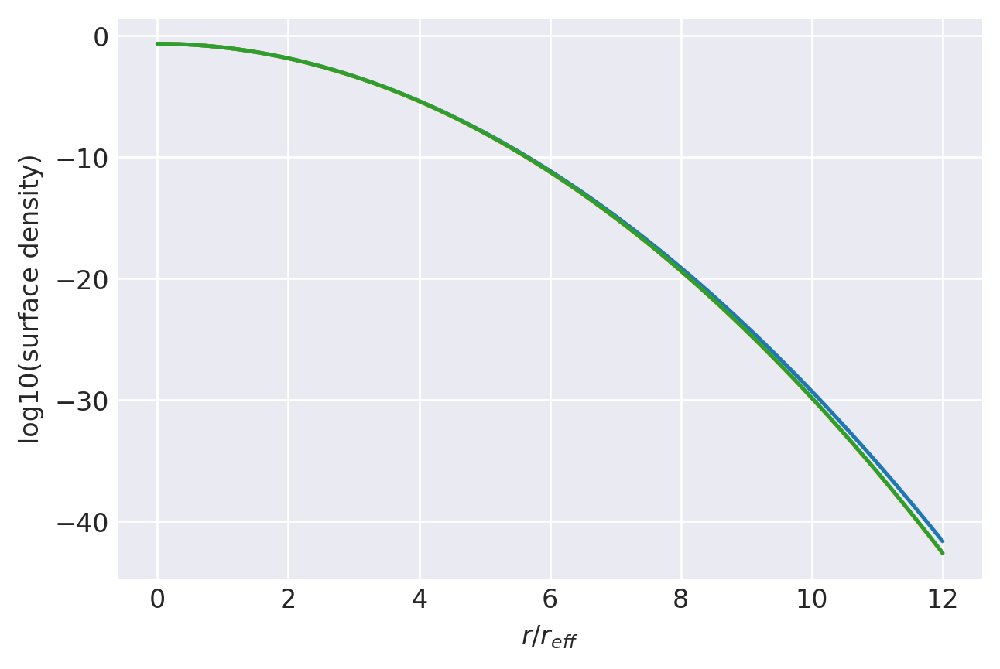

n=0.508: (
    normalize(np.array([8.0900645764e-01, 1.4370029461e-01, 4.5116492400e-02, 1.1607621959e-03, 9.8847826132e-04, 2.7514887767e-05])),
    np.array([1.0179047869e+00, 9.7942618220e-01, 8.0879007550e-01, 6.0711448945e-01, 4.0699848261e-01, 1.5733628822e-01]),
),
1.000000014546501 1.0000000146946884
prev.  chisq = -8.157687285214115
ws, re: (array([8.09006458e-01, 1.43700295e-01, 4.51164924e-02, 1.16076220e-03,
       9.88478261e-04, 2.75148878e-05]), array([1.01342545, 0.9770863 , 0.80781483, 0.60687024, 0.40699848,
       0.15753766]))
         Current function value: -12.523448
         Iterations: 14
         Function evaluations: 879
         Gradient evaluations: 124
-12.523447952643474 [1.72852468 1.15767134 3.10724109 0.02902061 3.60213193]
1.000000014546501 1.0000000145463956


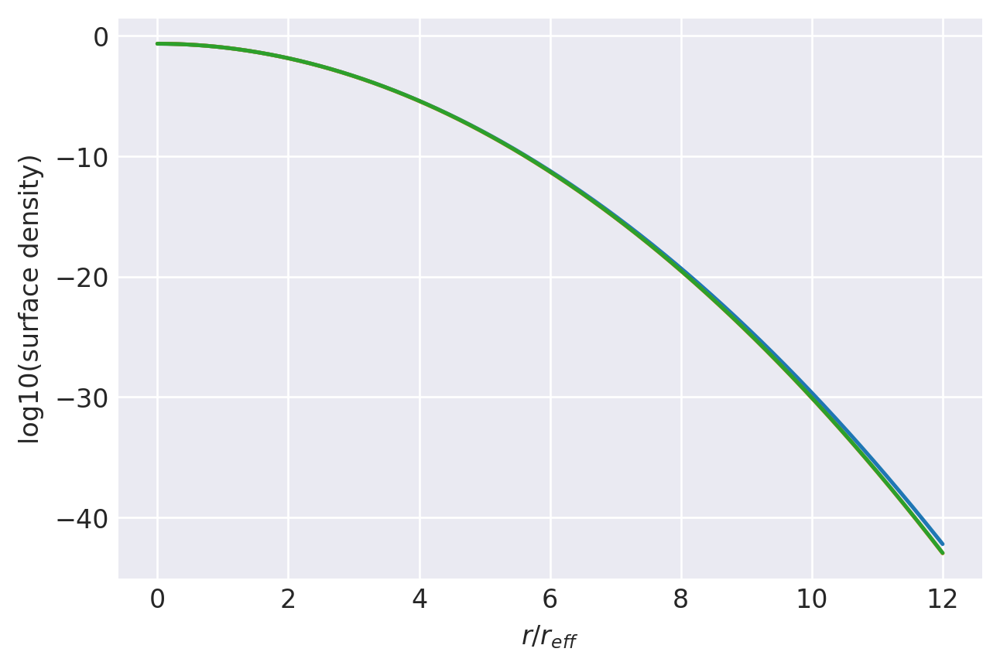

n=0.506: (
    normalize(np.array([8.4922361300e-01, 1.1472715920e-01, 3.4505976467e-02, 7.8282140475e-04, 7.4024670887e-04, 2.0183220452e-05])),
    np.array([1.0134254504e+00, 9.7708630399e-01, 8.0781483378e-01, 6.0687024204e-01, 4.0699848261e-01, 1.5753766173e-01]),
),
1.0000000145287486 1.0000000146044192
prev.  chisq = -8.735186414590766
ws, re: (array([8.49223613e-01, 1.14727159e-01, 3.45059765e-02, 7.82821405e-04,
       7.40246709e-04, 2.01832205e-05]), array([1.01118656, 0.975915  , 0.80732621, 0.60674779, 0.40699848,
       0.15763874]))
         Current function value: -12.675299
         Iterations: 13
         Function evaluations: 606
         Gradient evaluations: 85
-12.675298612907314 [ 1.90936844  1.18195261  3.14735974 -0.02953501  3.61286084]
1.0000000145287486 1.0000000145286474


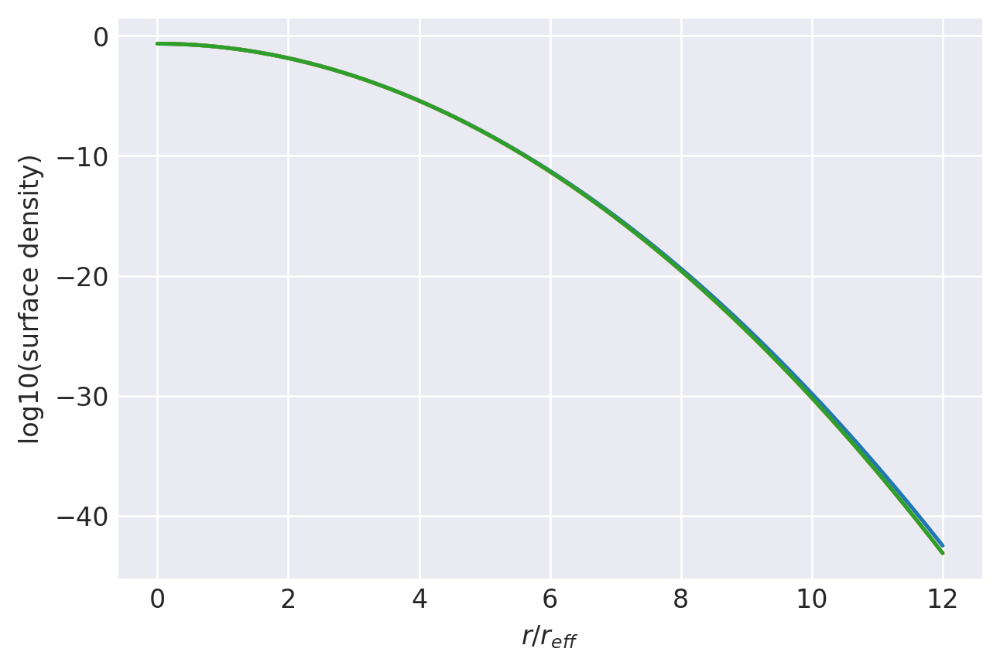

n=0.505: (
    normalize(np.array([8.7094817921e-01, 9.8763191556e-02, 2.9040875888e-02, 6.1466424085e-04, 6.1646035192e-04, 1.6628750699e-05])),
    np.array([1.0111865650e+00, 9.7591499980e-01, 8.0732620927e-01, 6.0674779307e-01, 4.0699848261e-01, 1.5763874417e-01]),
),
1.0000000145110344 1.0000000145876664
prev.  chisq = -8.721501720349888
ws, re: (array([8.70948179e-01, 9.87631916e-02, 2.90408759e-02, 6.14664241e-04,
       6.16460352e-04, 1.66287507e-05]), array([1.0089482 , 0.97474278, 0.80683691, 0.60662513, 0.40699848,
       0.15774009]))
         Current function value: -12.862548
         Iterations: 15
         Function evaluations: 773
         Gradient evaluations: 109
-12.862548446496131 [ 2.13094713  1.2070593   3.18905326 -0.09311177  3.62367757]
1.0000000145110344 1.0000000145109442


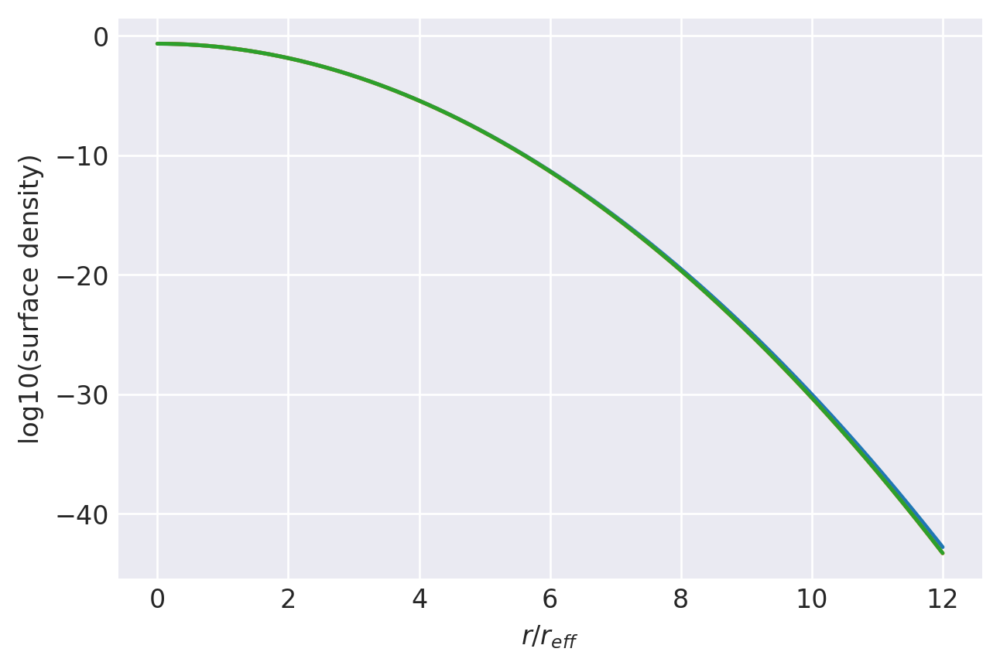

n=0.504: (
    normalize(np.array([8.9387488929e-01, 8.1692798042e-02, 2.3465287782e-02, 4.6101834118e-04, 4.9285502011e-04, 1.3151521938e-05])),
    np.array([1.0089482026e+00, 9.7474278219e-01, 8.0683691265e-01, 6.0662512616e-01, 4.0699848261e-01, 1.5774009202e-01]),
),
1.000000014493359 1.0000000145710053
prev.  chisq = -8.707413702518757
ws, re: (array([8.93874889e-01, 8.16927980e-02, 2.34652878e-02, 4.61018341e-04,
       4.92855020e-04, 1.31515219e-05]), array([1.00671036, 0.97356965, 0.80634694, 0.60650224, 0.40699848,
       0.15784171]))
         Current function value: -13.105799
         Iterations: 17
         Function evaluations: 698
         Gradient evaluations: 98
-13.10579892343218 [ 2.41697693  1.23303378  3.23249833 -0.16263955  3.63483397]
1.000000014493359 1.0000000144932841


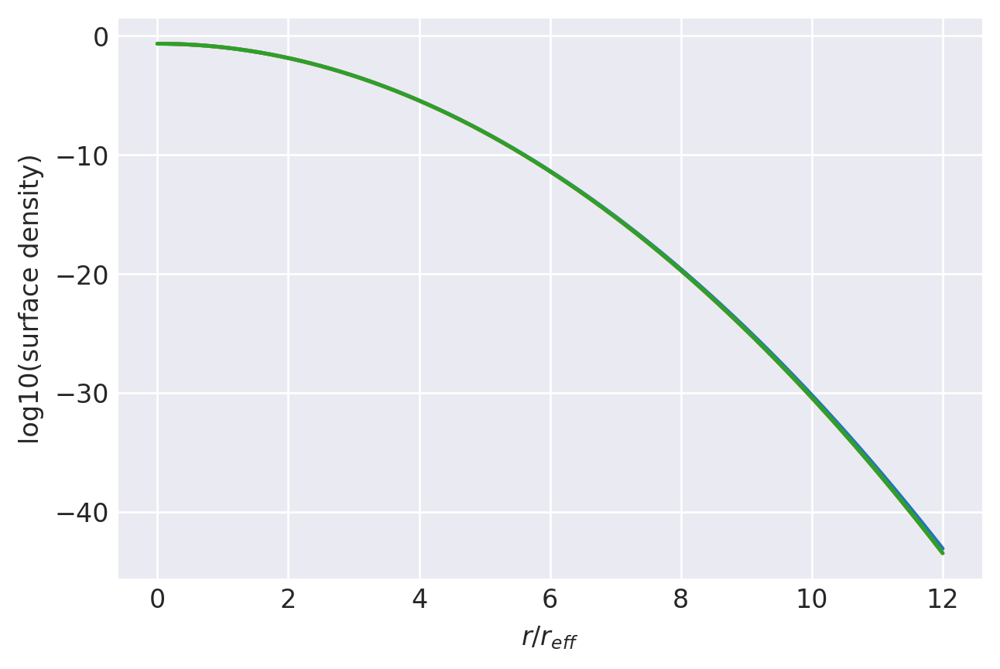

n=0.503: (
    normalize(np.array([9.1811275183e-01, 6.3409318231e-02, 1.7776491037e-02, 3.2226172817e-04, 3.6942857960e-04, 9.7485978260e-06])),
    np.array([1.0067103642e+00, 9.7356964864e-01, 8.0634694168e-01, 6.0650224050e-01, 4.0699848261e-01, 1.5784170651e-01]),
),
1.0000000144845362 1.0000000145238124
prev.  chisq = -9.295809022891858
ws, re: (array([9.18112752e-01, 6.34093182e-02, 1.77764910e-02, 3.22261728e-04,
       3.69428580e-04, 9.74859783e-06]), array([1.00559164, 0.97298274, 0.8061017 , 0.60644072, 0.40699848,
       0.15789261]))
         Current function value: -13.260827
         Iterations: 15
         Function evaluations: 873
         Gradient evaluations: 123
-13.260827099576984 [ 2.59843284  1.24637816  3.25486049 -0.19977061  3.64037072]
1.0000000144845362 1.0000000144844705


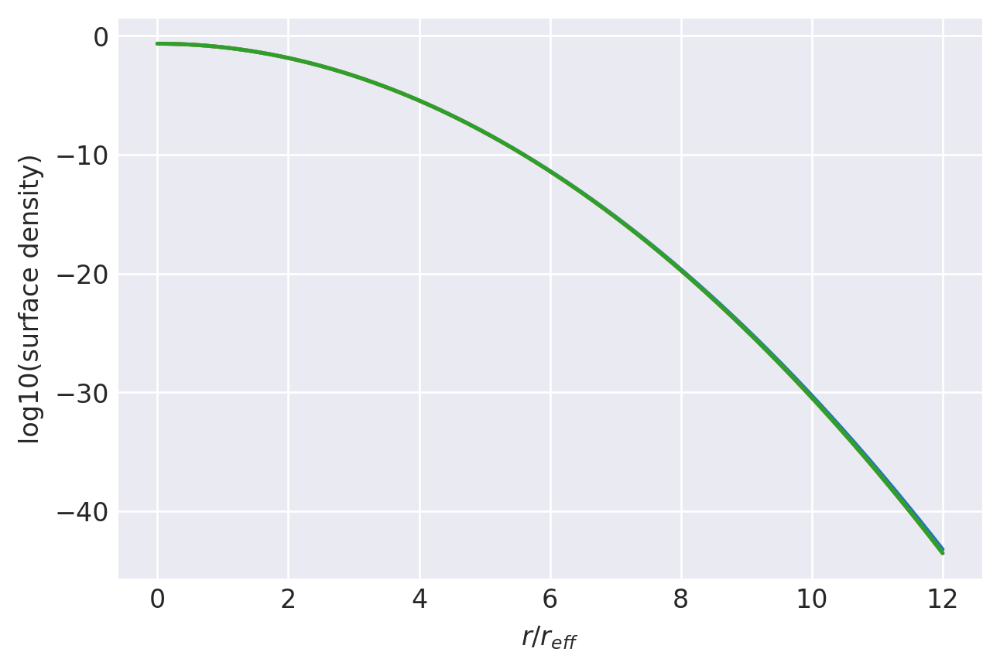

n=0.5025: (
    normalize(np.array([9.3076065151e-01, 5.3776282189e-02, 1.4888572800e-02, 2.5865006268e-04, 3.0776683297e-04, 8.0766060164e-06])),
    np.array([1.0055916418e+00, 9.7298273760e-01, 8.0610170260e-01, 6.0644071538e-01, 4.0699848261e-01, 1.5789261413e-01]),
),
1.0000000144757226 1.0000000145152819
prev.  chisq = -9.288391827216962
ws, re: (array([9.30760652e-01, 5.37762822e-02, 1.48885728e-02, 2.58650063e-04,
       3.07766833e-04, 8.07660602e-06]), array([1.00447305, 0.9723956 , 0.80585629, 0.60637914, 0.40699848,
       0.15794359]))
         Current function value: -13.451299
         Iterations: 15
         Function evaluations: 760
         Gradient evaluations: 107
-13.451299205334472 [ 2.82069029  1.25995233  3.27776951 -0.23893448  3.64605335]
1.0000000144757226 1.000000014475668


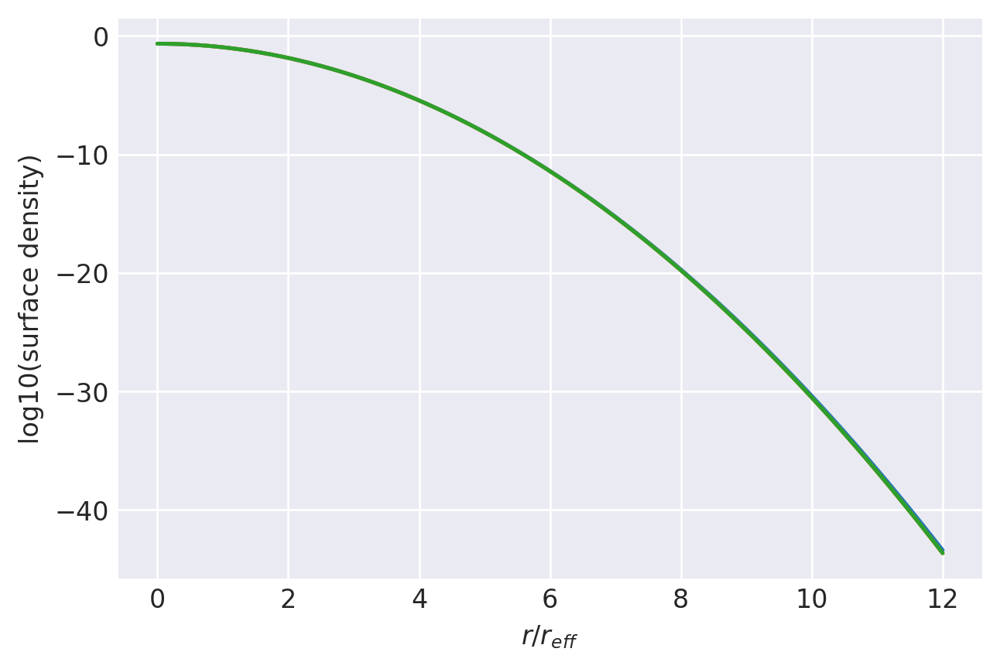

n=0.502: (
    normalize(np.array([9.4378370192e-01, 4.3793502536e-02, 1.1971329414e-02, 1.9889292684e-04, 2.4615017830e-04, 6.4230204461e-06])),
    np.array([1.0044730508e+00, 9.7239559662e-01, 8.0585629408e-01, 6.0637913526e-01, 4.0699848261e-01, 1.5794358888e-01]),
),
1.0000000144713201 1.0000000144912065
prev.  chisq = -9.883285333162709
ws, re: (array([9.43783702e-01, 4.37935025e-02, 1.19713294e-02, 1.98892927e-04,
       2.46150178e-04, 6.42302045e-06]), array([1.0039138 , 0.97210194, 0.80573353, 0.60634832, 0.40699848,
       0.1579691 ]))
         Current function value: -13.565604
         Iterations: 15
         Function evaluations: 654
         Gradient evaluations: 92
-13.565604107194142 [ 2.9537765   1.26681277  3.28950588 -0.25952739  3.64907982]
1.0000000144713201 1.0000000144712706


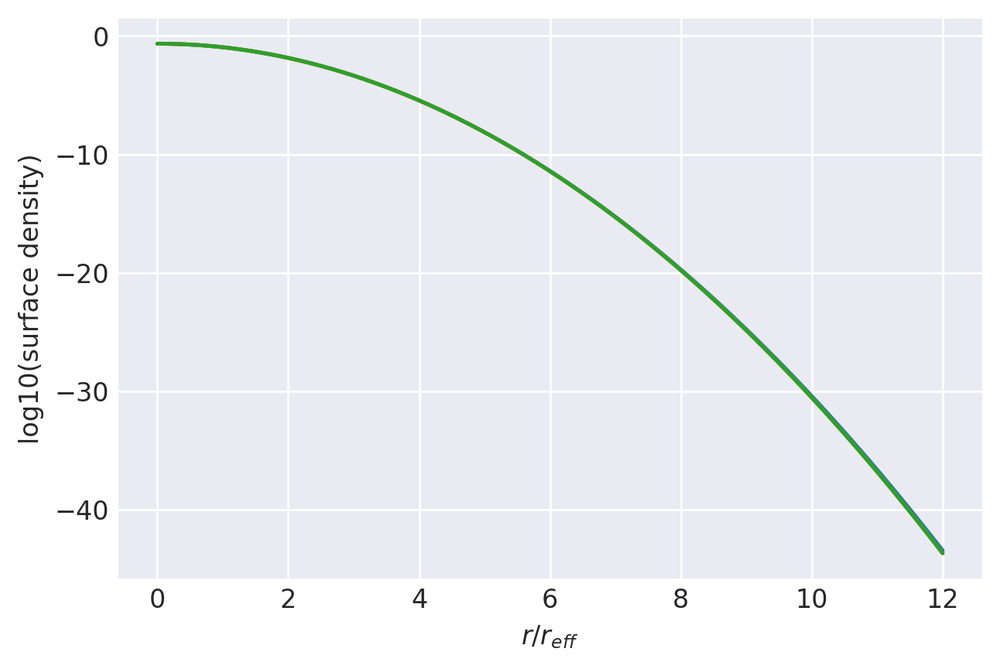

n=0.50175: (
    normalize(np.array([9.5044167315e-01, 3.8665241033e-02, 1.0501665007e-02, 1.7045589058e-04, 2.1536225616e-04, 5.6026612152e-06])),
    np.array([1.0039138046e+00, 9.7210193981e-01, 8.0573352619e-01, 6.0634832454e-01, 4.0699848261e-01, 1.5796910147e-01]),
),
1.0000000144669192 1.000000014486883
prev.  chisq = -9.879486644850989
ws, re: (array([9.50441673e-01, 3.86652410e-02, 1.05016650e-02, 1.70455891e-04,
       2.15362256e-04, 5.60266122e-06]), array([1.00335459, 0.97180823, 0.80561072, 0.6063175 , 0.40699848,
       0.15799463]))
         Current function value: -13.697815
         Iterations: 33
         Function evaluations: 1146
         Gradient evaluations: 162
-13.697815371626172 [ 3.10746251  1.27377246  3.30119345 -0.28014682  3.6517598 ]
1.0000000144669192 1.0000000144668764


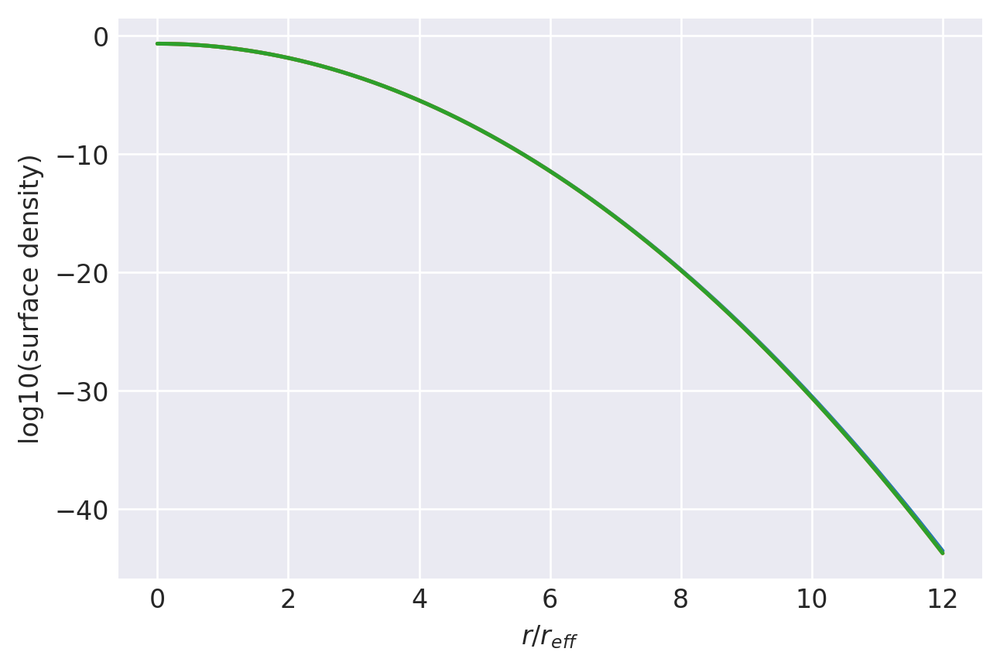

n=0.5015: (
    normalize(np.array([9.5719951901e-01, 3.3443775703e-02, 9.0242590301e-03, 1.4309078183e-04, 1.8456681397e-04, 4.7886653030e-06])),
    np.array([1.0033545912e+00, 9.7180822539e-01, 8.0561071582e-01, 6.0631750003e-01, 4.0699848261e-01, 1.5799463090e-01]),
),
1.0000000144625212 1.0000000144825634
prev.  chisq = -9.875652717828702
ws, re: (array([9.57199519e-01, 3.34437757e-02, 9.02425903e-03, 1.43090782e-04,
       1.84566814e-04, 4.78866530e-06]), array([1.00279541, 0.97151445, 0.80548786, 0.60628666, 0.40699848,
       0.15802018]))
         Current function value: -13.854492
         Iterations: 31
         Function evaluations: 1290
         Gradient evaluations: 182
-13.854492284519088 [ 3.28932296  1.28076887  3.31315775 -0.30174122  3.65479775]
1.0000000144625212 1.000000014462484


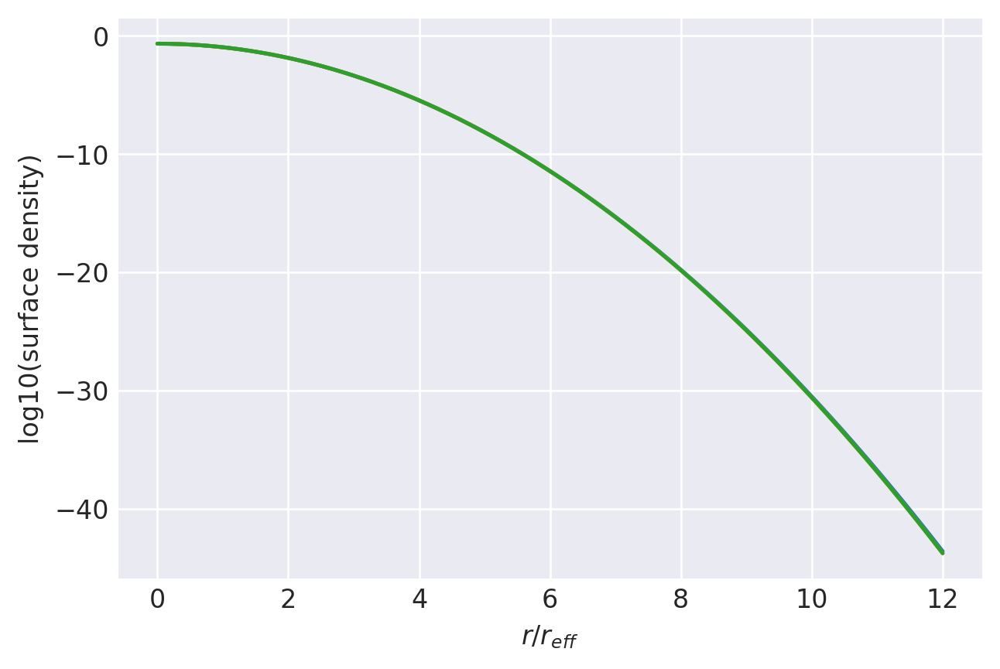

n=0.50125: (
    normalize(np.array([9.6406070359e-01, 2.8125397132e-02, 7.5394552197e-03, 1.1667491985e-04, 1.5379106885e-04, 3.9780718085e-06])),
    np.array([1.0027954107e+00, 9.7151445332e-01, 8.0548786296e-01, 6.0628666172e-01, 4.0699848261e-01, 1.5802017719e-01]),
),
1.0000000144581254 1.000000014478247
prev.  chisq = -9.871782772494013
ws, re: (array([9.64060704e-01, 2.81253971e-02, 7.53945522e-03, 1.16674920e-04,
       1.53791069e-04, 3.97807181e-06]), array([1.00223626, 0.97122062, 0.80536497, 0.60625581, 0.40699848,
       0.15804574]))
         Current function value: -14.046623
         Iterations: 25
         Function evaluations: 1727
         Gradient evaluations: 244
-14.046623490669225 [ 3.51198772  1.28786136  3.32511026 -0.32350521  3.65768121]
1.0000000144581254 1.0000000144580952


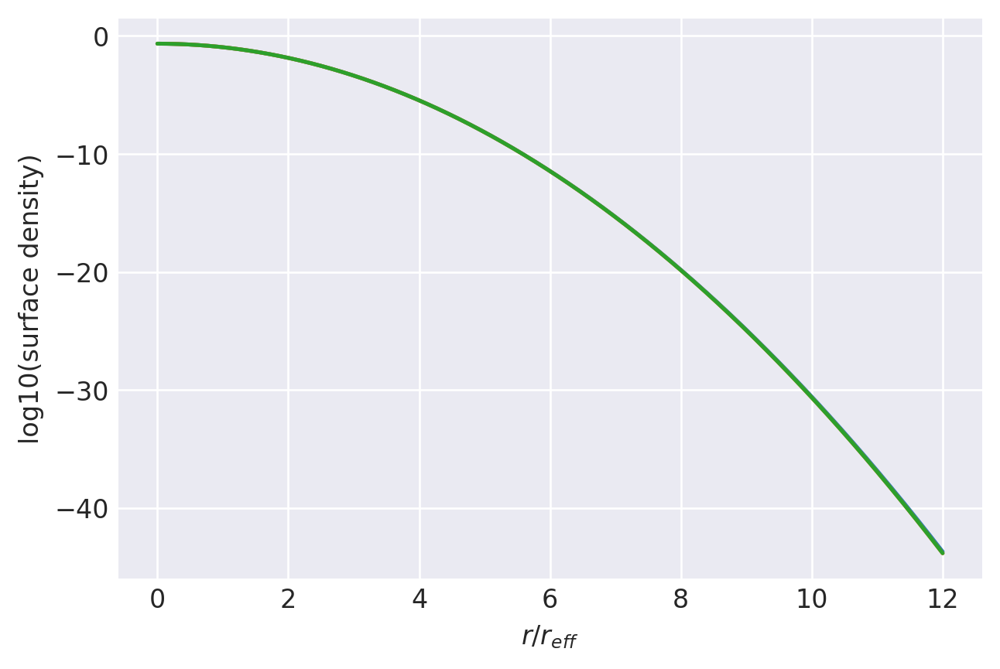

n=0.501: (
    normalize(np.array([9.7102693825e-01, 2.2708650700e-02, 6.0469123650e-03, 9.1310676658e-05, 1.2301517115e-04, 3.1728380741e-06])),
    np.array([1.0022362632e+00, 9.7122062358e-01, 8.0536496756e-01, 6.0625580960e-01, 4.0699848261e-01, 1.5804574035e-01]),
),
1.000000014453732 1.0000000144739347
prev.  chisq = -9.867876391212075
ws, re: (array([9.71026938e-01, 2.27086507e-02, 6.04691237e-03, 9.13106767e-05,
       1.23015171e-04, 3.17283807e-06]), array([1.00167715, 0.97092674, 0.80524203, 0.60622494, 0.40699848,
       0.15807132]))
         Current function value: -14.294809
         Iterations: 15
         Function evaluations: 949
         Gradient evaluations: 134
-14.29480903327958 [ 3.79919557  1.29498893  3.33735285 -0.34629653  3.66040203]
1.000000014453732 1.0000000144537093


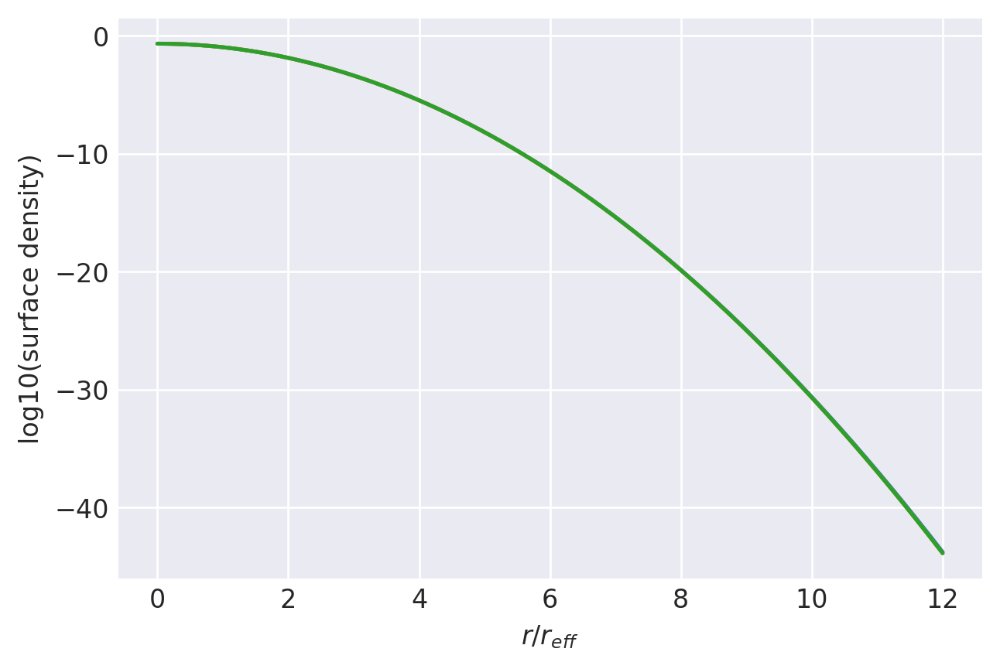

n=0.50075: (
    normalize(np.array([9.7810150557e-01, 1.7190108332e-02, 4.5468330732e-03, 6.6928312775e-05, 9.2251791448e-05, 2.3729162228e-06])),
    np.array([1.0016771485e+00, 9.7092673610e-01, 8.0524202958e-01, 6.0622494365e-01, 4.0699848261e-01, 1.5807132042e-01]),
),
1.000000014449341 1.0000000144696268
prev.  chisq = -9.863932752654174
ws, re: (array([9.78101506e-01, 1.71901083e-02, 4.54683307e-03, 6.69283128e-05,
       9.22517914e-05, 2.37291622e-06]), array([1.00111807, 0.97063279, 0.80511905, 0.60619406, 0.40699848,
       0.15809692]))
         Current function value: -14.645297
         Iterations: 20
         Function evaluations: 1048
         Gradient evaluations: 148
-14.645296750845441 [ 4.20418485  1.30216919  3.34981584 -0.36995693  3.66344111]
1.000000014449341 1.0000000144493253


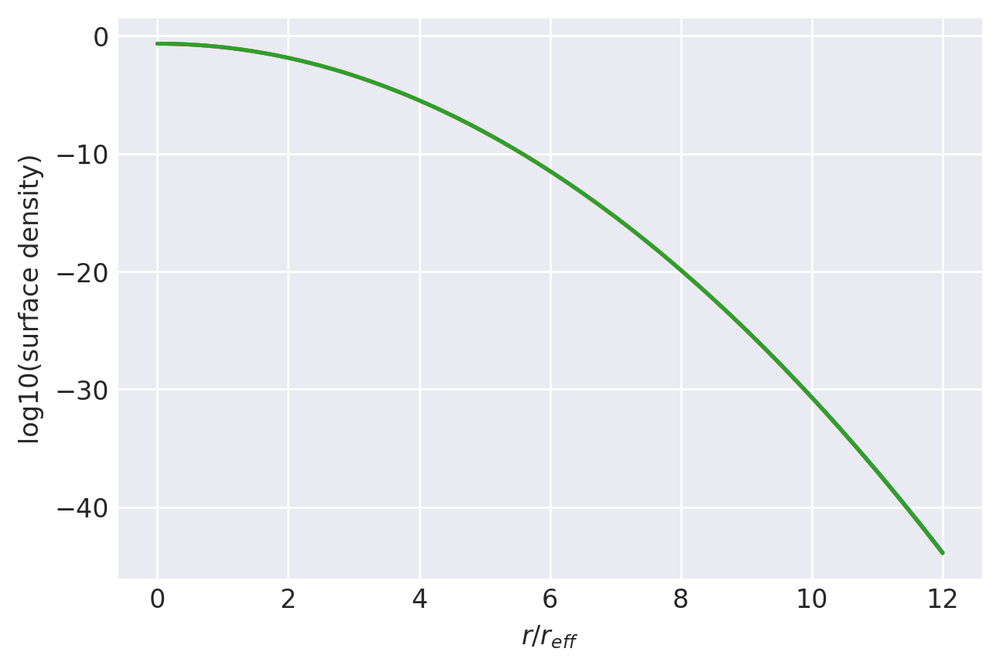

n=0.5005: (
    normalize(np.array([9.8528675848e-01, 1.1567547958e-02, 3.0390507910e-03, 4.3569056476e-05, 6.1496686636e-05, 1.5770281935e-06])),
    np.array([1.0011180669e+00, 9.7063279087e-01, 8.0511904898e-01, 6.0619406386e-01, 4.0699848261e-01, 1.5809691740e-01]),
),
1.000000014444953 1.000000014465322
prev.  chisq = -9.85995138161944
ws, re: (array([9.85286758e-01, 1.15675480e-02, 3.03905079e-03, 4.35690565e-05,
       6.14966866e-05, 1.57702819e-06]), array([1.00055902, 0.97033879, 0.80499603, 0.60616317, 0.40699848,
       0.15812253]))
         Current function value: -15.245660
         Iterations: 14
         Function evaluations: 922
         Gradient evaluations: 130
-15.245660258058944 [ 4.89684157  1.30943649  3.36234426 -0.3940667   3.66664769]
1.000000014444953 1.0000000144449448


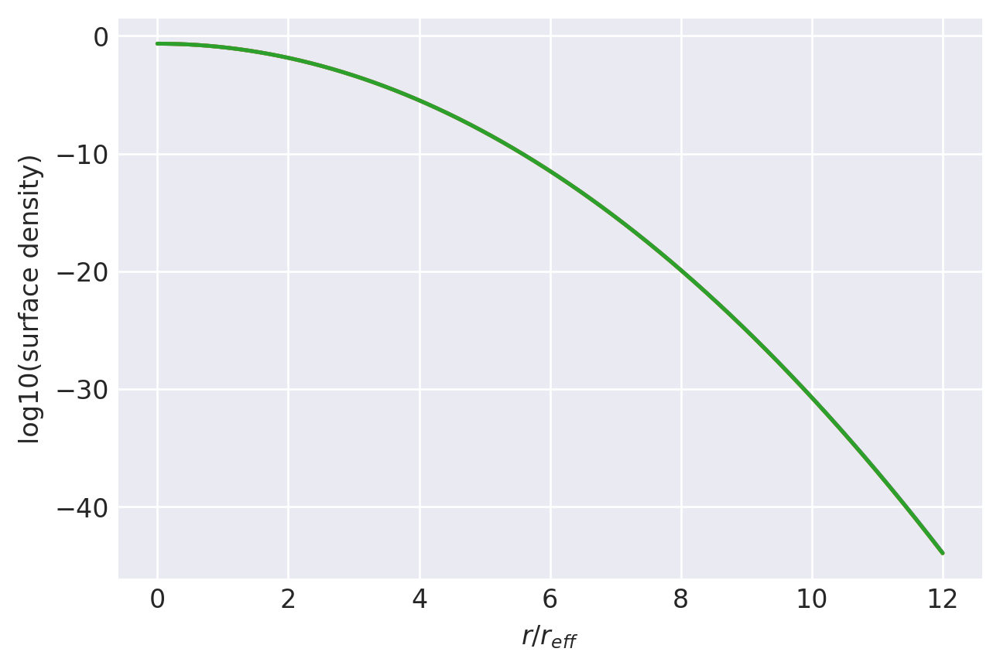

n=0.50025: (
    normalize(np.array([9.9258524947e-01, 5.8385143016e-03, 1.5234429522e-03, 2.1261896999e-05, 3.0745465695e-05, 7.8591615771e-07])),
    np.array([1.0005590181e+00, 9.7033878782e-01, 8.0499602574e-01, 6.0616317021e-01, 4.0699848261e-01, 1.5812253132e-01]),
),
1.000000014440567 1.0000000144610213
prev.  chisq = -9.85593178465109
ws, re: (array([9.92585249e-01, 5.83851430e-03, 1.52344295e-03, 2.12618970e-05,
       3.07454657e-05, 7.85916158e-07]), array([1.        , 0.97004473, 0.80487296, 0.60613226, 0.40699848,
       0.15814816]))
         Current function value: -23.404781
         Iterations: 3
         Function evaluations: 500
         Gradient evaluations: 70
-23.404780717374845 [16.4039308   6.37358718  3.72897068 -0.35289817  3.66180958]
1.000000014440567 1.0000000144405667


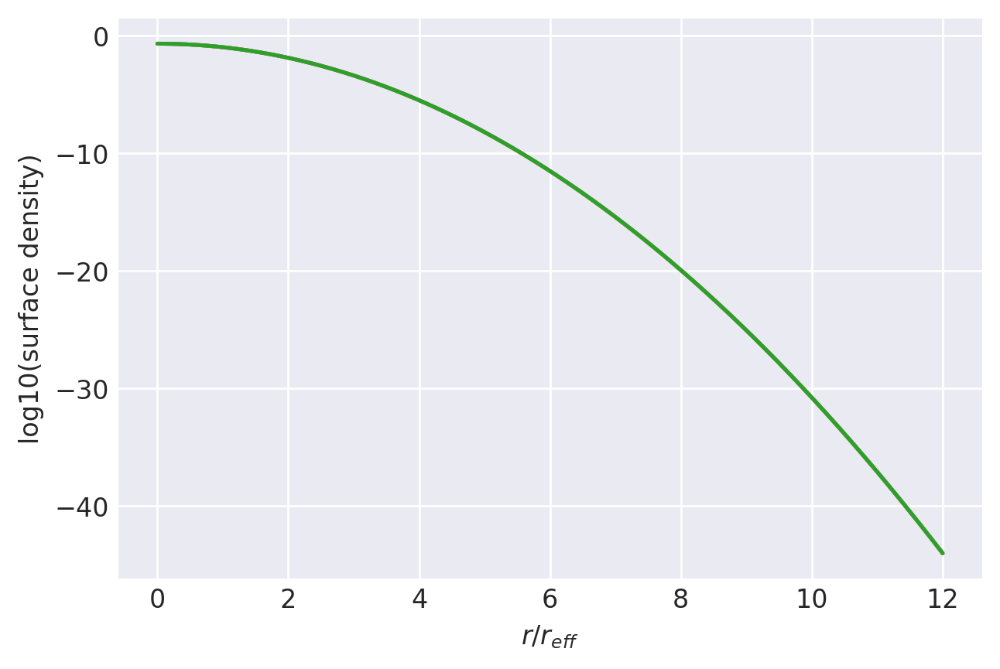

n=0.5: (
    normalize(np.array([9.9999992486e-01, 7.5010671307e-08, 1.2496888952e-10, 1.2386360979e-12, 1.7186642211e-12, 4.4075854078e-14])),
    np.array([1.0000000023e+00, 9.7004472694e-01, 8.0487295982e-01, 6.0613226270e-01, 4.0699848261e-01, 1.5814816220e-01]),
),


In [7]:
# Remove components that appear to drop to zero weight prior to reaching n=0.5
nvals = [
    (
        np.array([0.59, 0.58, 0.57, 0.56, 0.55, 0.545, 0.54, 0.535, 0.532, 0.53, 0.528, 0.526, 0.524, 0.522, 0.52]),
        (
    normalize(np.array([2.5245833365e-01, 4.0909470655e-01, 2.7589971662e-01, 4.9102894414e-02, 1.1898107959e-02, 1.1568666009e-03, 3.7898444800e-04])),
    np.array([1.2260961300e+00, 1.0834346938e+00, 8.5103090314e-01, 6.1751048171e-01, 4.0699848261e-01, 2.6199728208e-01, 1.4906992761e-01]),
        ),
    )
]
fitweights(nvals, rmid, areasq, funcrdivreslog=RadiusExtrapolator.r)
def funcrvdivreslog2(n):
    return RadiusExtrapolator.r(n)[[0, 1, 2, 3, 4, 6]]

nvals = (
    [0.522, 0.52, 0.518, 0.516, 0.514, 0.512, 0.51, 0.508, 0.506, 0.505, 0.504, 0.503, 0.5025, 0.502, 0.50175, 0.5015, 0.50125, 0.501, 0.50075, 0.5005, 0.50025, 0.5], (
    normalize(np.array([6.0924514356e-01, 2.7382578144e-01, 1.0894701414e-01, 5.1406728389e-03, 2.7519367087e-03, 8.6379768585e-05])),
    np.array([1.0493180221e+00, 9.9570496370e-01, 8.1554321978e-01, 6.0880043915e-01, 4.0699848261e-01, 1.5595546920e-01]),
    )
),
fitweights(nvals, rmid, areasq, funcrdivreslog=funcrvdivreslog2)

## Fitting large n profiles

Up to n=2.5, we continue from the exponential solution. Beyond n=2.5, it becomes very difficult to fit the outer profile because more of the Gaussian components trend to tiny sizes. By masking the inner bins, we can limit this issue and ensure a nearly constant central surface brightness. In the real universe, most massive nearby ellipticals don't have the steep cusp of an n>4 profile - only the outer part is well-approximated by an n>4 profile. Kormendy & co. discuss this at length in a number of papers, hypothesizing that the shallow inner cores are due to massive black holes scattering stars and scouring the inner regions of stars. It could be possible that higher-redshift ellipticals and/or recent merger remnants do have very cuspy centers, but these are probably merger-induced and distinct enough from the rest of the galaxy that they should be considered a separate component.

[0, 24000]
0.9999999609060398 1.0000000283694637
prev.  chisq = -7.908912714088798
ws, re: (array([0.07790019, 0.31264016, 0.33937179, 0.1839253 , 0.06541804,
       0.01709507, 0.00326612, 0.00038332]), array([2.17045661, 1.47679133, 0.99494464, 0.65054022, 0.40699848,
       0.23877605, 0.12631553, 0.05405815]))
         Current function value: -10.841181
         Iterations: 48
         Function evaluations: 2324
         Gradient evaluations: 136
-10.841181350927233 [-2.48187701e+00 -6.90394184e-01  2.01872944e-01  7.34443390e-01
  1.12970776e+00  1.52991407e+00  2.13096504e+00  3.45445860e-01
  1.74627989e-01  5.81353233e-04 -1.85826972e-01 -3.91057410e-01
 -6.24074441e-01 -9.02059800e-01 -1.27234972e+00]
0.9999999609060398 1.0000000291429856


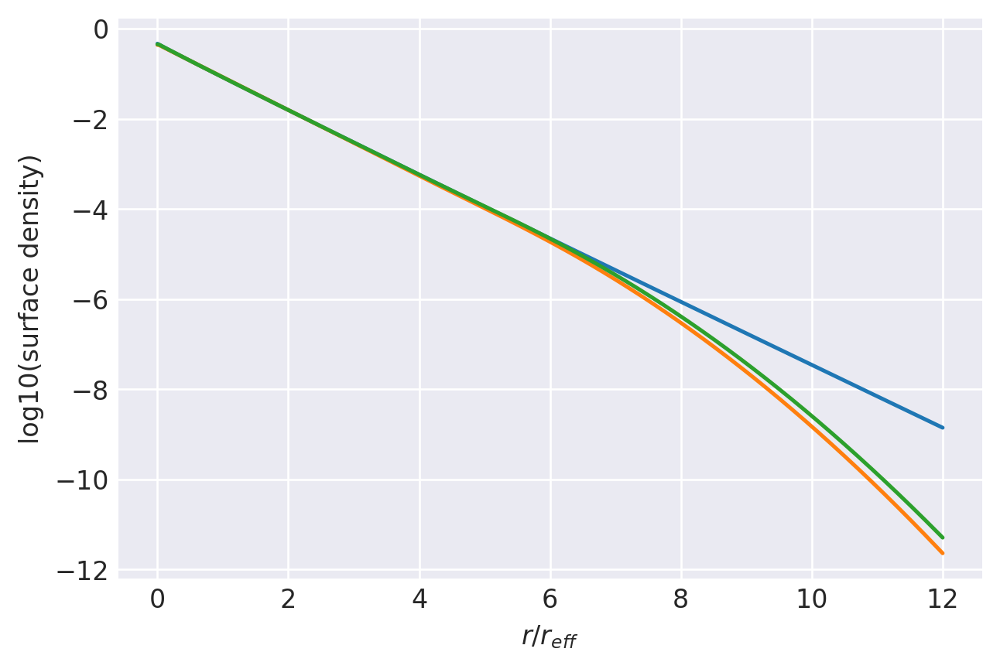

n=1.0208: (
    normalize(np.array([7.7138475282e-02, 3.0818535260e-01, 3.3825478461e-01, 1.8679993070e-01, 6.7734549427e-02, 1.7990900883e-02, 3.4825489934e-03, 4.1345750103e-04])),
    np.array([2.2153679082e+00, 1.4949545487e+00, 1.0013395116e+00, 6.5188806266e-01, 4.0638960450e-01, 2.3764329136e-01, 1.2529686354e-01, 5.3413407127e-02]),
),
[0, 24000]
0.9999999315465994 1.0000000291429856
prev.  chisq = -8.32351693971251
ws, re: (array([0.07713848, 0.30818535, 0.33825478, 0.18679993, 0.06773455,
       0.0179909 , 0.00348255, 0.00041346]), array([2.21536791, 1.49495455, 1.00133951, 0.65188806, 0.4063896 ,
       0.23764329, 0.12529686, 0.05341341]))
         Current function value: -10.787812
         Iterations: 40
         Function evaluations: 2086
         Gradient evaluations: 122
-10.787812136522367 [-2.48984007e+00 -7.04915666e-01  1.85793259e-01  7.20047870e-01
  1.11815704e+00  1.52089983e+00  2.12344188e+00  3.51055606e-01
  1.78032530e-01  2.40698121e-03 -1.85204564e-01 -

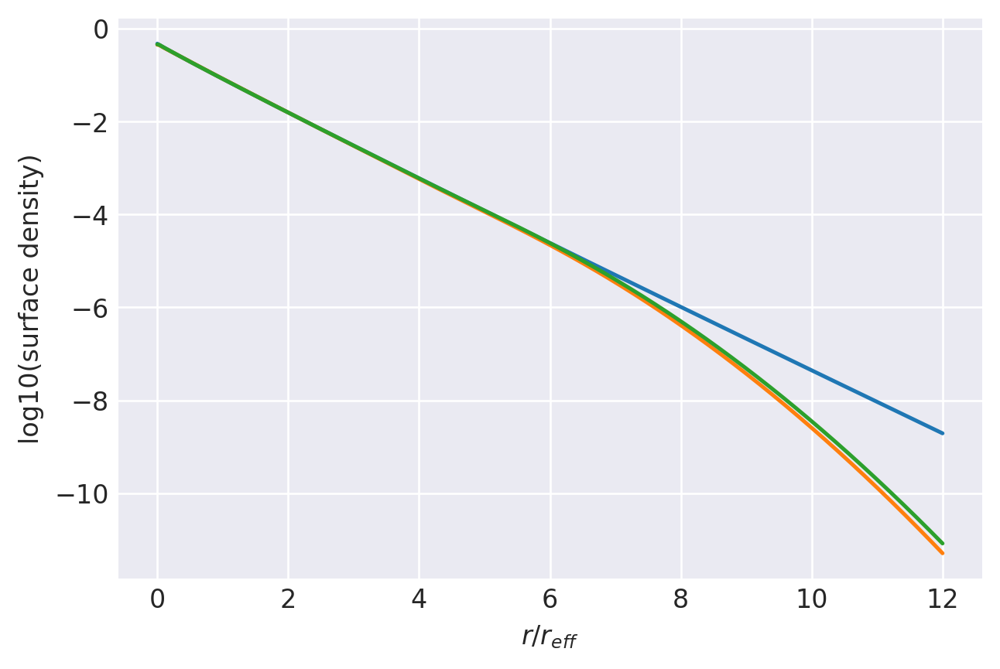

n=1.0339: (
    normalize(np.array([7.6573505491e-02, 3.0539862416e-01, 3.3763799570e-01, 1.8859515284e-01, 6.9180789806e-02, 1.8558596987e-02, 3.6220663318e-03, 4.3326869433e-04])),
    np.array([2.2441692454e+00, 1.5067199213e+00, 1.0055576659e+00, 6.5282298307e-01, 4.0604890765e-01, 2.3696146653e-01, 1.2468573455e-01, 5.3029660147e-02]),
),
[0, 24000]
0.9999998911427255 1.0000000296065321
prev.  chisq = -8.327386842132562
ws, re: (array([0.07657351, 0.30539862, 0.337638  , 0.18859515, 0.06918079,
       0.0185586 , 0.00362207, 0.00043327]), array([2.24416925, 1.50671992, 1.00555767, 0.65282298, 0.40604891,
       0.23696147, 0.12468573, 0.05302966]))
         Current function value: -10.735380
         Iterations: 42
         Function evaluations: 1882
         Gradient evaluations: 110
-10.735379587833815 [-2.49722193 -0.71887351  0.17018417  0.70593101  1.10674903  1.51196437
  2.11598029  0.35662538  0.18140301  0.00420061 -0.18461424 -0.39181934
 -0.62660733 -0.90634993 -1.27865

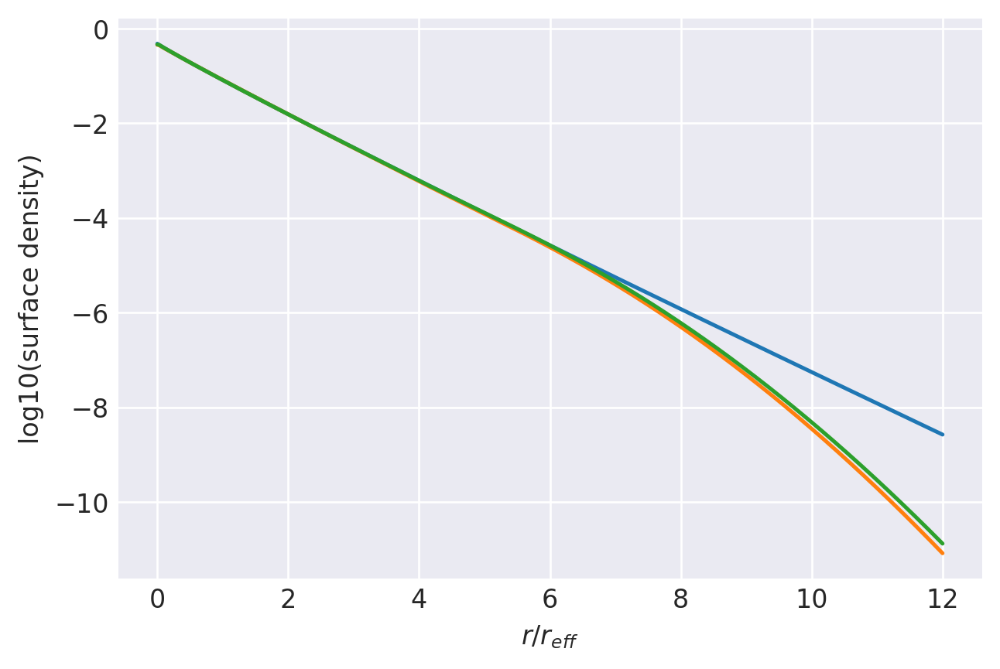

n=1.0471: (
    normalize(np.array([7.6053162516e-02, 3.0272295147e-01, 3.3697895323e-01, 1.9030239132e-01, 7.0599936741e-02, 1.9125813218e-02, 3.7632616835e-03, 4.5352982803e-04])),
    np.array([2.2731357730e+00, 1.5184587908e+00, 1.0097191952e+00, 6.5371094966e-01, 4.0567725975e-01, 2.3626134318e-01, 1.2406522435e-01, 5.2643040860e-02]),
),
[0, 24000]
0.9999998358377702 1.0000000300382692
prev.  chisq = -8.324766017597566
ws, re: (array([0.07605316, 0.30272295, 0.33697895, 0.19030239, 0.07059994,
       0.01912581, 0.00376326, 0.00045353]), array([2.27313577, 1.51845879, 1.0097192 , 0.65371095, 0.40567726,
       0.23626134, 0.12406522, 0.05264304]))
         Current function value: -10.683473
         Iterations: 38
         Function evaluations: 1882
         Gradient evaluations: 110
-10.683472715284317 [-2.50393742 -0.7323303   0.15492903  0.69198957  1.09534061  1.50296458
  2.10849959  0.36218706  0.18475448  0.0059672  -0.18405885 -0.39225758
 -0.62793438 -0.90856325 -1.28189

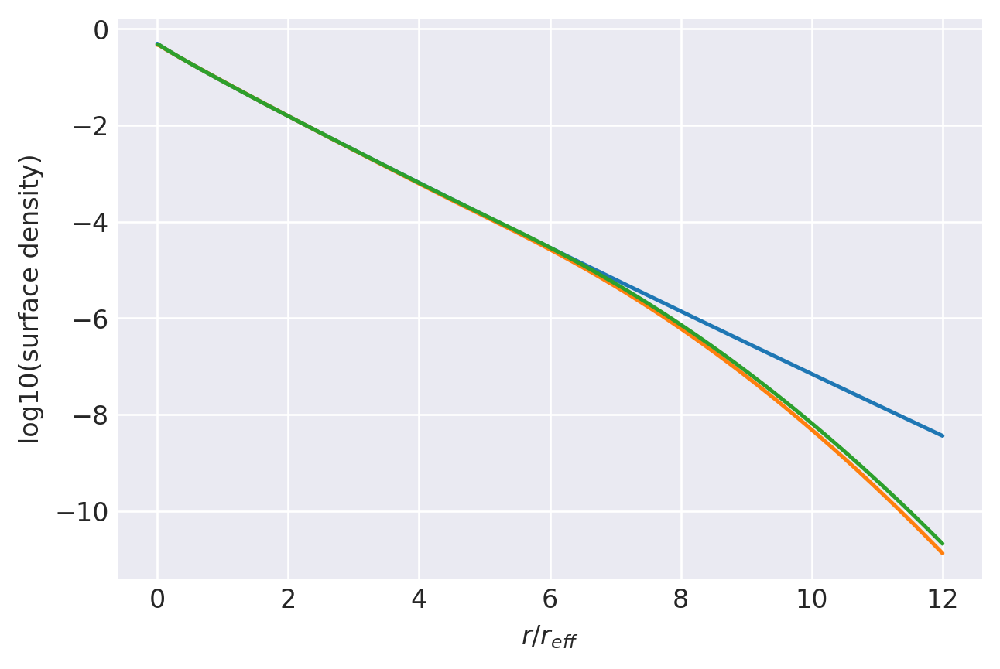

n=1.0605: (
    normalize(np.array([7.5582612820e-02, 3.0014313423e-01, 3.3626842842e-01, 1.9192978042e-01, 7.1998047963e-02, 1.9696191313e-02, 3.9073717259e-03, 4.7443311236e-04])),
    np.array([2.3024332888e+00, 1.5302221424e+00, 1.0138348185e+00, 6.5454747444e-01, 4.0526809835e-01, 2.3554051315e-01, 1.2343455219e-01, 5.2252462156e-02]),
),
[0, 24000]
0.9999997609742097 1.0000000304170895
prev.  chisq = -8.322328274463368
ws, re: (array([0.07558261, 0.30014313, 0.33626843, 0.19192978, 0.07199805,
       0.01969619, 0.00390737, 0.00047443]), array([2.30243329, 1.53022214, 1.01383482, 0.65454747, 0.4052681 ,
       0.23554051, 0.12343455, 0.05225246]))
         Current function value: -10.632133
         Iterations: 34
         Function evaluations: 2069
         Gradient evaluations: 121
-10.632132751767267 [-2.51344234 -0.74768392  0.13842046  0.67727934  1.08355819  1.49388862
  2.10095143  0.36793767  0.18836417  0.00805672 -0.18313262 -0.39230065
 -0.62886639 -0.91039792 -1.28473

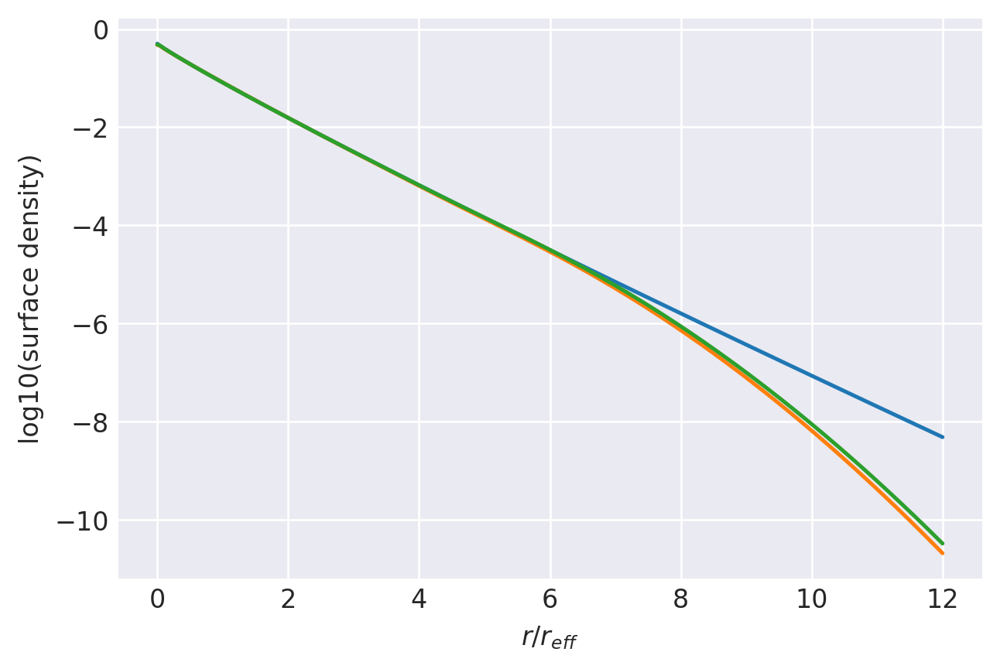

n=1.0741: (
    normalize(np.array([7.4921178156e-02, 2.9725203704e-01, 3.3560478671e-01, 1.9378152567e-01, 7.3551447516e-02, 2.0325901342e-02, 4.0657231095e-03, 4.9740046403e-04])),
    np.array([2.3331232030e+00, 1.5429937435e+00, 1.0187244356e+00, 6.5594492474e-01, 4.0522791042e-01, 2.3503558020e-01, 1.2291420595e-01, 5.1911250416e-02]),
),
[0, 24000]
0.9999996606965464 1.000000030693113
prev.  chisq = -8.320098767763337
ws, re: (array([0.07492118, 0.29725204, 0.33560479, 0.19378153, 0.07355145,
       0.0203259 , 0.00406572, 0.0004974 ]), array([2.3331232 , 1.54299374, 1.01872444, 0.65594492, 0.40522791,
       0.23503558, 0.12291421, 0.05191125]))
         Current function value: -10.581278
         Iterations: 32
         Function evaluations: 1831
         Gradient evaluations: 107
-10.581278146875961 [-2.51975291 -0.76046852  0.12394637  0.66397004  1.07261546  1.48511395
  2.09345039  0.3735367   0.19173531  0.0098098  -0.1826338  -0.39284729
 -0.63035311 -0.91280387 -1.288181

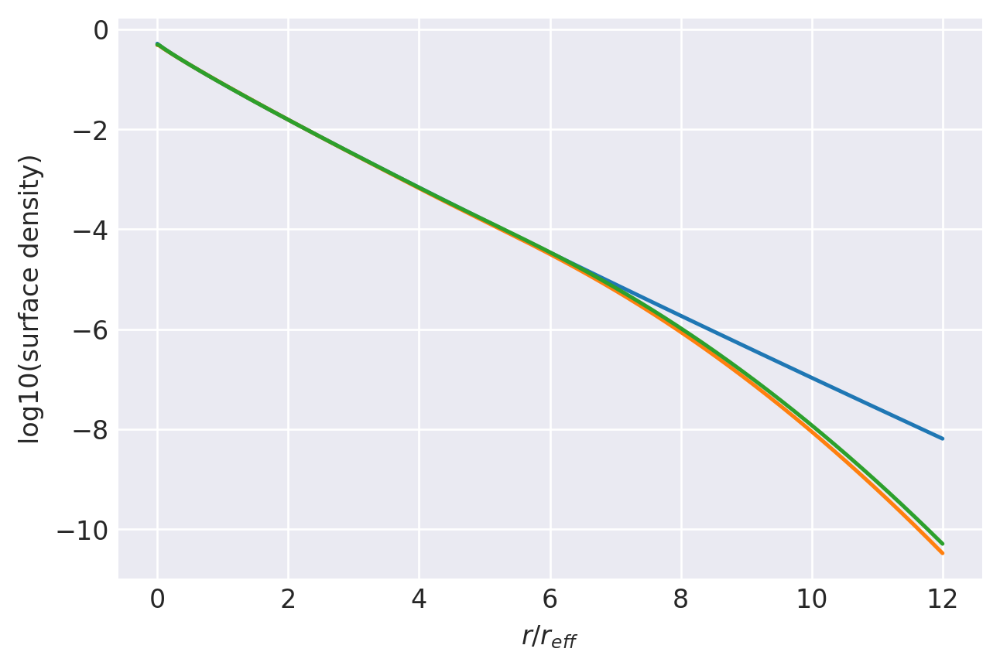

n=1.0879: (
    normalize(np.array([7.4484976679e-02, 2.9481776987e-01, 3.3486680427e-01, 1.9529295567e-01, 7.4909881827e-02, 2.0895313543e-02, 4.2129992098e-03, 5.1929892551e-04])),
    np.array([2.3633971132e+00, 1.5550176139e+00, 1.0228449349e+00, 6.5669876603e-01, 4.0471818070e-01, 2.3423235775e-01, 1.2223515431e-01, 5.1501372909e-02]),
),
[0, 24000]
0.9999995478677557 1.0000000308251829
prev.  chisq = -8.442982059164015
ws, re: (array([0.07448498, 0.29481777, 0.3348668 , 0.19529296, 0.07490988,
       0.02089531, 0.004213  , 0.0005193 ]), array([2.36339711, 1.55501761, 1.02284493, 0.65669877, 0.40471818,
       0.23423236, 0.12223515, 0.05150137]))
         Current function value: -10.537716
         Iterations: 31
         Function evaluations: 1575
         Gradient evaluations: 92
-10.537716334232236 [-2.52612467 -0.77218441  0.11120852  0.65232675  1.06304049  1.47745904
  2.08640049  0.37845286  0.1947555   0.01144883 -0.18208554 -0.39319729
 -0.63152631 -0.91475462 -1.290940

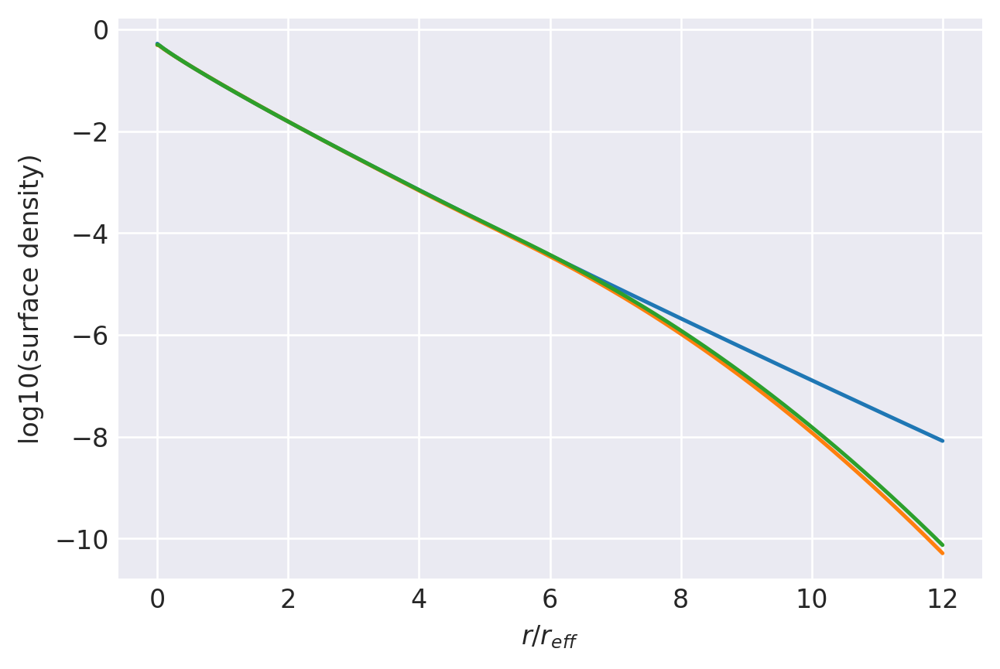

n=1.1: (
    normalize(np.array([7.4046916070e-02, 2.9260743724e-01, 3.3426305588e-01, 1.9665715131e-01, 7.6129875058e-02, 2.1409545549e-02, 4.3464770110e-03, 5.3954188880e-04])),
    np.array([2.3903024760e+00, 1.5658692516e+00, 1.0267124646e+00, 6.5752831963e-01, 4.0439214015e-01, 2.3360045717e-01, 1.2168733415e-01, 5.1175164452e-02]),
),
[0, 24000]
0.9999993558283597 1.0000000307430863
prev.  chisq = -8.217494352069403
ws, re: (array([0.07404692, 0.29260744, 0.33426306, 0.19665715, 0.07612988,
       0.02140955, 0.00434648, 0.00053954]), array([2.39030248, 1.56586925, 1.02671246, 0.65752832, 0.40439214,
       0.23360046, 0.12168733, 0.05117516]))
         Current function value: -10.481846
         Iterations: 41
         Function evaluations: 2239
         Gradient evaluations: 131
-10.481845654256444 [-2.52489091 -0.78174851  0.09744218  0.63859594  1.05105251  1.46755806
  2.0786661   0.3842664   0.19795736  0.01279527 -0.18215669 -0.39444428
 -0.63380603 -0.9180807  -1.29553363

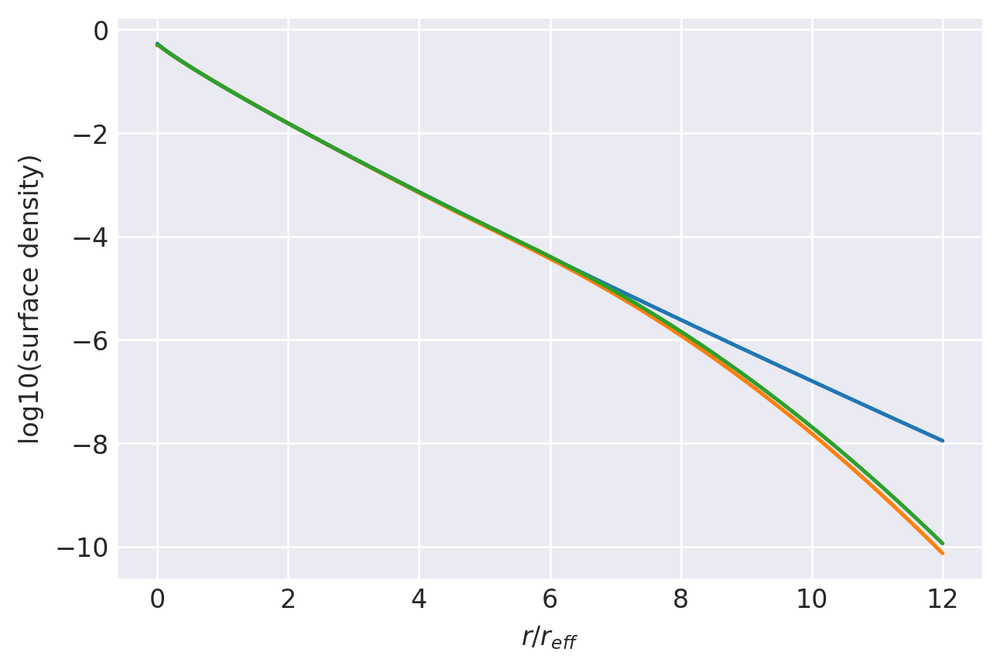

n=1.1159: (
    normalize(np.array([7.4131552030e-02, 2.9067006997e-01, 3.3306073569e-01, 1.9772975055e-01, 7.7363842150e-02, 2.1978318855e-02, 4.5024836875e-03, 5.6324705943e-04])),
    np.array([2.4225145769e+00, 1.5774563790e+00, 1.0299005083e+00, 6.5742060807e-01, 4.0323267430e-01, 2.3237744611e-01, 1.2075894169e-01, 5.0636813400e-02]),
),
[0, 24000]
0.9999991310481606 1.0000000303448628
prev.  chisq = -8.319948114450947
ws, re: (array([0.07413155, 0.29067007, 0.33306074, 0.19772975, 0.07736384,
       0.02197832, 0.00450248, 0.00056325]), array([2.42251458, 1.57745638, 1.02990051, 0.65742061, 0.40323267,
       0.23237745, 0.12075894, 0.05063681]))
         Current function value: -10.432939
         Iterations: 31
         Function evaluations: 2119
         Gradient evaluations: 124
-10.43293861944042 [-2.53244231 -0.79531524  0.08256708  0.62515134  1.04011356  1.45869141
  2.07099242  0.38997034  0.20150403  0.01478649 -0.18138606 -0.39472085
 -0.63503747 -0.92023552 -1.298727

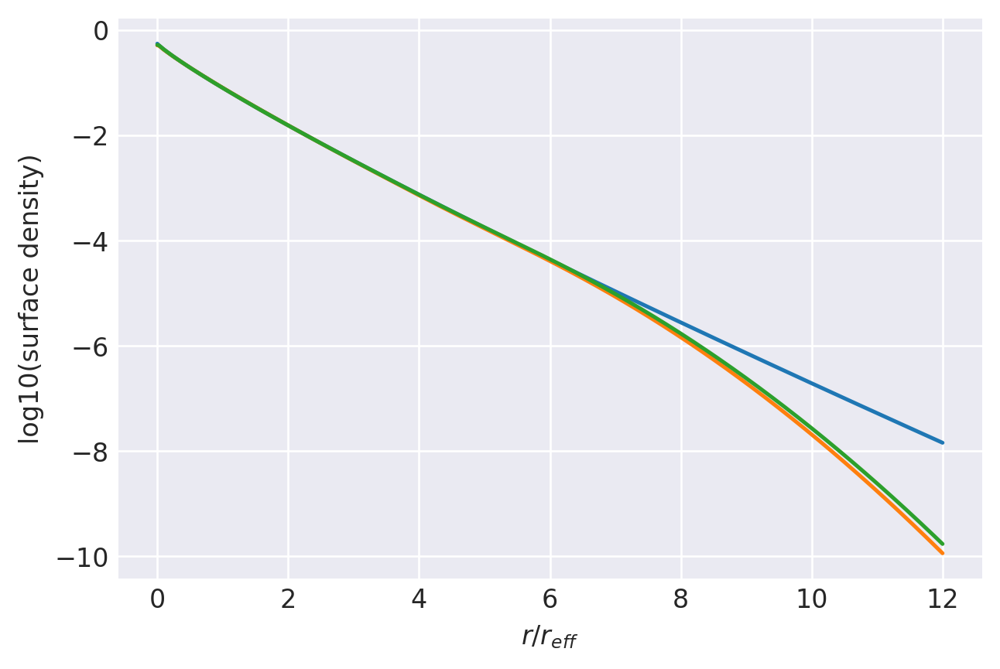

n=1.1302: (
    normalize(np.array([7.3614917710e-02, 2.8813218656e-01, 3.3229363767e-01, 1.9929856614e-01, 7.8808589987e-02, 2.2597314020e-02, 4.6665231363e-03, 5.8826477412e-04])),
    np.array([2.4545412961e+00, 1.5903914550e+00, 1.0346334018e+00, 6.5858818948e-01, 4.0297597154e-01, 2.3171947294e-01, 1.2016126220e-01, 5.0265767304e-02]),
),
[0, 24000]
0.9999988414536722 1.0000000293557019
prev.  chisq = -8.318111216104736
ws, re: (array([0.07361492, 0.28813219, 0.33229364, 0.19929857, 0.07880859,
       0.02259731, 0.00466652, 0.00058826]), array([2.4545413 , 1.59039145, 1.0346334 , 0.65858819, 0.40297597,
       0.23171947, 0.12016126, 0.05026577]))
         Current function value: -10.384526
         Iterations: 31
         Function evaluations: 1797
         Gradient evaluations: 105
-10.384526414806043 [-2.53568794 -0.80657134  0.06898951  0.61201226  1.02853519  1.4492382
  2.06388422  0.39542355  0.20475129  0.0164601  -0.1809355  -0.39525297
 -0.63643018 -0.92252011 -1.302199

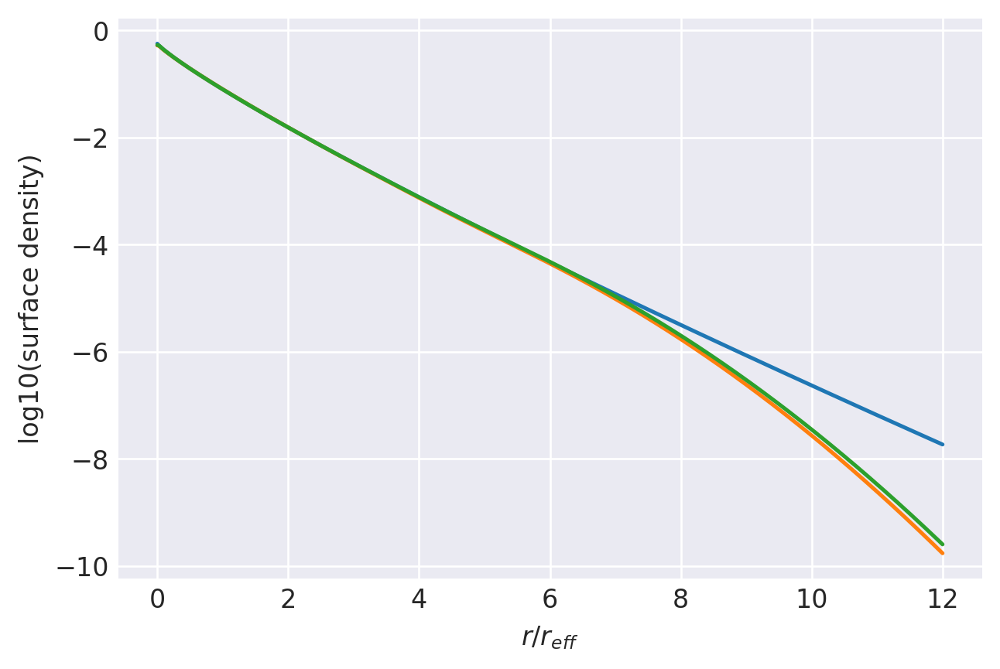

n=1.1447: (
    normalize(np.array([7.3393885410e-02, 2.8597066522e-01, 3.3136262579e-01, 2.0053240289e-01, 8.0101653196e-02, 2.3193998393e-02, 4.8313779830e-03, 6.1339112431e-04])),
    np.array([2.4855559637e+00, 1.6023275062e+00, 1.0386281721e+00, 6.5927180091e-01, 4.0248252469e-01, 2.3097757786e-01, 1.1953081764e-01, 4.9865555008e-02]),
),
[0, 24000]
0.999998474265734 1.000000027677633
prev.  chisq = -8.322217229983918
ws, re: (array([0.07339389, 0.28597067, 0.33136263, 0.2005324 , 0.08010165,
       0.023194  , 0.00483138, 0.00061339]), array([2.48555596, 1.60232751, 1.03862817, 0.6592718 , 0.40248252,
       0.23097758, 0.11953082, 0.04986556]))
         Current function value: -10.336944
         Iterations: 33
         Function evaluations: 2001
         Gradient evaluations: 117
-10.336944009942501 [-2.53515985 -0.81457997  0.05774412  0.60083538  1.01895795  1.4413443
  2.05638606  0.40062632  0.20763852  0.01767487 -0.18102971 -0.39646453
 -0.63867011 -0.92574725 -1.30634036

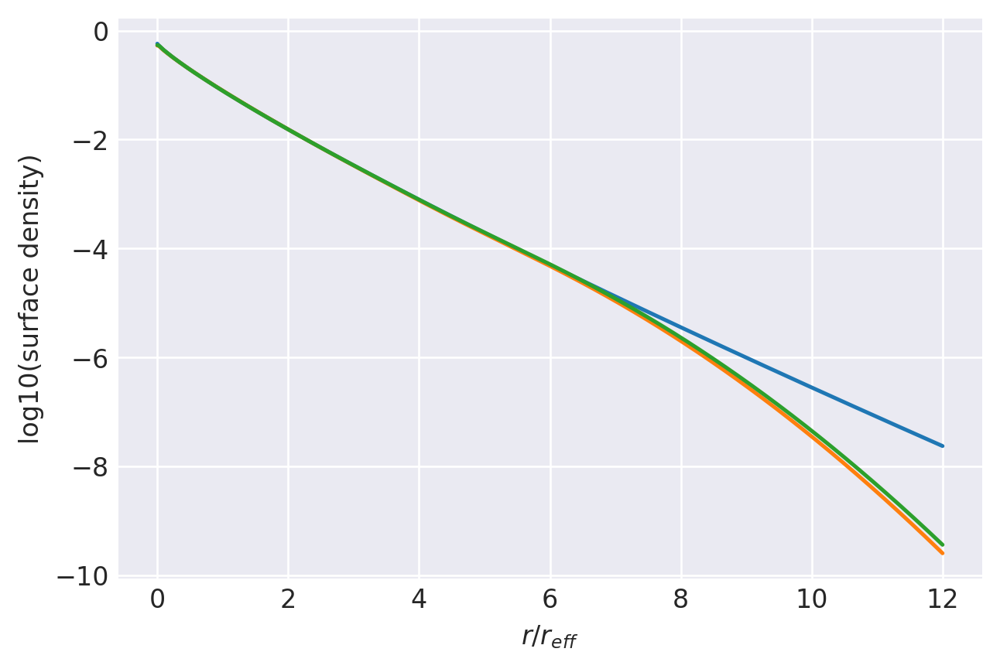

n=1.1593: (
    normalize(np.array([7.3429807614e-02, 2.8437865383e-01, 3.3036389065e-01, 2.0139307697e-01, 8.1143962376e-02, 2.3686223708e-02, 4.9687988928e-03, 6.3558597136e-04])),
    np.array([2.5155115733e+00, 1.6130154051e+00, 1.0415373913e+00, 6.5912879754e-01, 4.0136128152e-01, 2.2978934663e-01, 1.1864590392e-01, 4.9392343840e-02]),
),
[0, 24000]
0.999998006019254 1.0000000250874335
prev.  chisq = -8.314613577224833
ws, re: (array([0.07342981, 0.28437865, 0.33036389, 0.20139308, 0.08114396,
       0.02368622, 0.0049688 , 0.00063559]), array([2.51551157, 1.61301541, 1.04153739, 0.6591288 , 0.40136128,
       0.22978935, 0.1186459 , 0.04939234]))
         Current function value: -10.289565
         Iterations: 32
         Function evaluations: 2154
         Gradient evaluations: 126
-10.289565048961782 [-2.53764375 -0.82483702  0.0450618   0.58862282  1.00844404  1.43267704
  2.04896398  0.40606596  0.21083835  0.01926316 -0.18070968 -0.39721462
 -0.64038983 -0.92842302 -1.310075

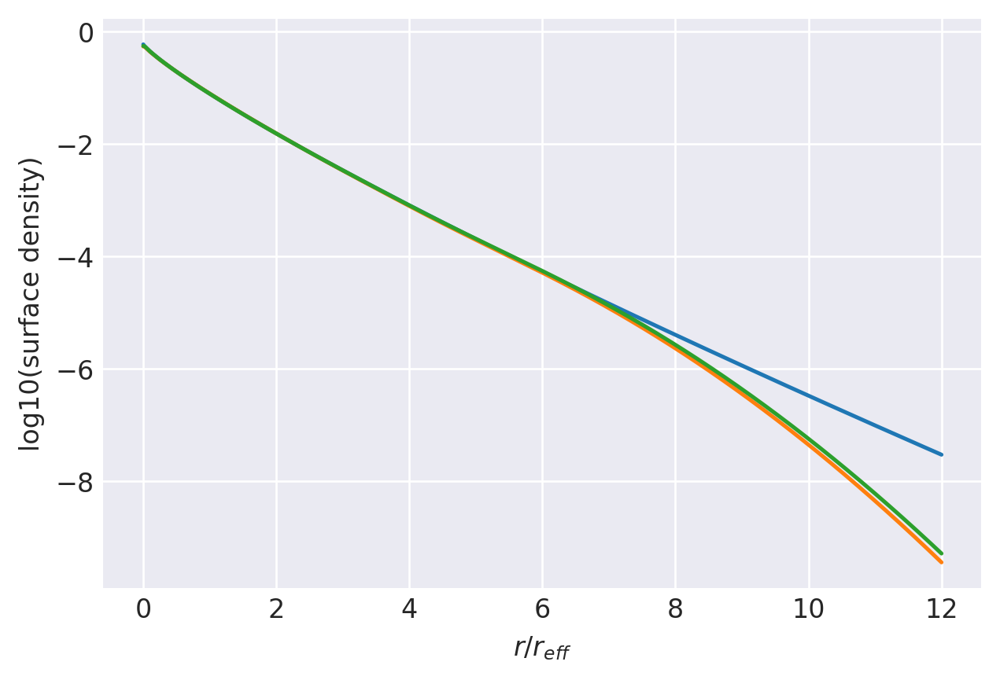

n=1.1742: (
    normalize(np.array([7.3260987795e-02, 2.8241246428e-01, 3.2942067519e-01, 2.0249993603e-01, 8.2361576148e-02, 2.4255355680e-02, 5.1281488322e-03, 6.6085605313e-04])),
    np.array([2.5472170790e+00, 1.6249438052e+00, 1.0453534562e+00, 6.5961468968e-01, 4.0066866998e-01, 2.2888122703e-01, 1.1791715127e-01, 4.8969319413e-02]),
),
[0, 24000]
0.9999974214267663 1.0000000209101756
prev.  chisq = -8.318738520072516
ws, re: (array([0.07326099, 0.28241246, 0.32942068, 0.20249994, 0.08236158,
       0.02425536, 0.00512815, 0.00066086]), array([2.54721708, 1.62494381, 1.04535346, 0.65961469, 0.40066867,
       0.22888123, 0.11791715, 0.04896932]))
         Current function value: -10.243017
         Iterations: 31
         Function evaluations: 2324
         Gradient evaluations: 136
-10.243016887346236 [-2.54074739 -0.83547806  0.03222776  0.57628551  0.99778816  1.4239619
  2.04147828  0.411524    0.21409978  0.02094294 -0.18027607 -0.39783002
 -0.64195754 -0.93094052 -1.313653

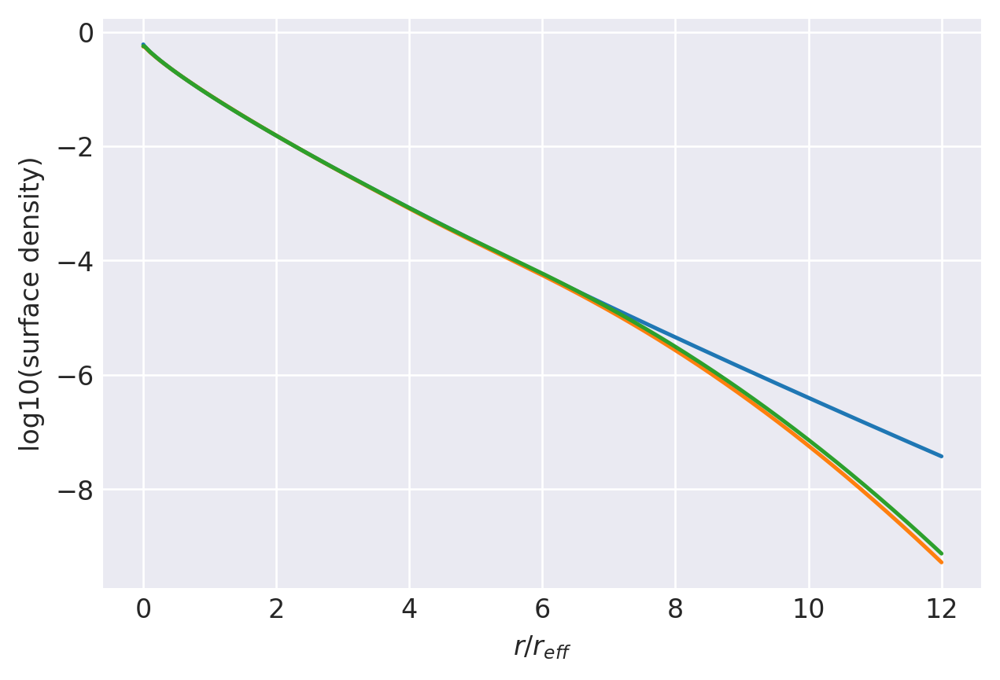

n=1.1892: (
    normalize(np.array([7.3050548682e-02, 2.8039109583e-01, 3.2848800806e-01, 2.0363253427e-01, 8.3610953492e-02, 2.4845177798e-02, 5.2942891845e-03, 6.8739268938e-04])),
    np.array([2.5794315001e+00, 1.6371926375e+00, 1.0494045526e+00, 6.6027360267e-01, 4.0010131738e-01, 2.2805650291e-01, 1.1723559144e-01, 4.8567537324e-02]),
),
[0, 24000]
0.9999969189841783 1.0000000146242878
prev.  chisq = -8.607293129437458
ws, re: (array([0.07305055, 0.2803911 , 0.32848801, 0.20363253, 0.08361095,
       0.02484518, 0.00529429, 0.00068739]), array([2.5794315 , 1.63719264, 1.04940455, 0.6602736 , 0.40010132,
       0.2280565 , 0.11723559, 0.04856754]))
         Current function value: -10.210177
         Iterations: 38
         Function evaluations: 2069
         Gradient evaluations: 121
-10.210177496842157 [-2.54077537 -0.84145803  0.02413849  0.56827561  0.99078218  1.41794896
  2.03629769  0.41527766  0.21623147  0.02190915 -0.18023176 -0.39857236
 -0.64341192 -0.93307743 -1.31654

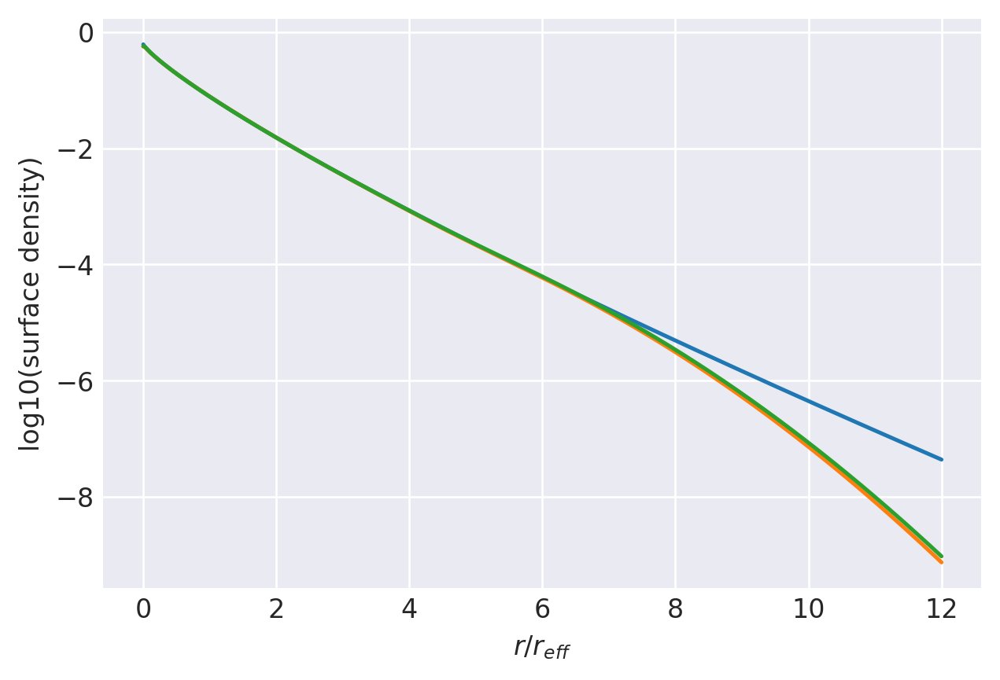

n=1.2: (
    normalize(np.array([7.3048653779e-02, 2.7922351062e-01, 3.2777252085e-01, 2.0424833408e-01, 8.4378435121e-02, 2.5220001607e-02, 5.4033475871e-03, 7.0519635232e-04])),
    np.array([2.6018224911e+00, 1.6452483650e+00, 1.0517418278e+00, 6.6034096444e-01, 3.9941800417e-01, 2.2729405861e-01, 1.1666016042e-01, 4.8245234139e-02]),
),
[0, 24000]
0.999995783775321 1.0000000086357028
prev.  chisq = -8.09404233892516
ws, re: (array([0.07304865, 0.27922351, 0.32777252, 0.20424833, 0.08437844,
       0.02522   , 0.00540335, 0.0007052 ]), array([2.60182249, 1.64524837, 1.05174183, 0.66034096, 0.399418  ,
       0.22729406, 0.11666016, 0.04824523]))
         Current function value: -10.151128
         Iterations: 32
         Function evaluations: 1899
         Gradient evaluations: 111
-10.151127902971336 [-2.54398971 -0.85461734  0.00782343  0.55265308  0.9772876   1.40670647
  2.02680275  0.42232821  0.22042983  0.02407593 -0.17967278 -0.3993972
 -0.6454988  -0.93640995 -1.32130682]
0

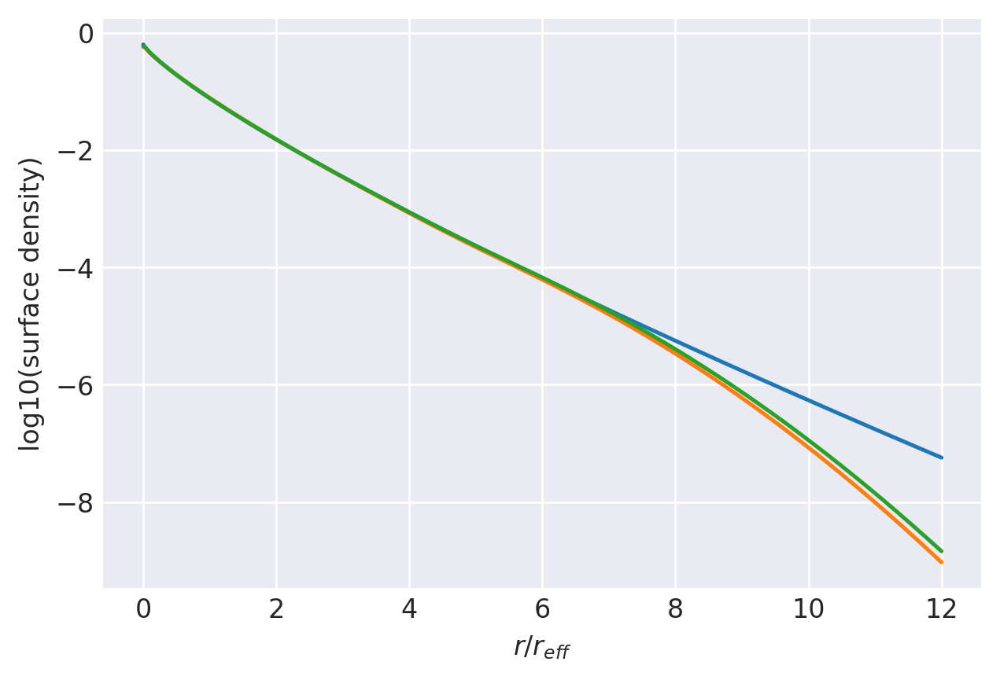

n=1.2199: (
    normalize(np.array([7.2831301211e-02, 2.7672755724e-01, 3.2649273438e-01, 2.0562654540e-01, 8.5969077874e-02, 2.5987242572e-02, 5.6244815294e-03, 7.4105978065e-04])),
    np.array([2.6444064733e+00, 1.6612302363e+00, 1.0570022912e+00, 6.6119143733e-01, 3.9866012666e-01, 2.2620448030e-01, 1.1576840595e-01, 4.7719203132e-02]),
),
[0, 24000]
0.9999946730028986 0.9999999924474381
prev.  chisq = -8.314243746503925
ws, re: (array([0.0728313 , 0.27672756, 0.32649273, 0.20562655, 0.08596908,
       0.02598724, 0.00562448, 0.00074106]), array([2.64440647, 1.66123024, 1.05700229, 0.66119144, 0.39866013,
       0.22620448, 0.11576841, 0.0477192 ]))
         Current function value: -10.106087
         Iterations: 32
         Function evaluations: 2052
         Gradient evaluations: 120
-10.10608651712693 [-2.54304    -0.86222108 -0.0026249   0.54191315  0.96762144  1.39844825
  2.01939023  0.42754941  0.22336972  0.02534889 -0.17972846 -0.40056707
 -0.64767841 -0.93957161 -1.325493

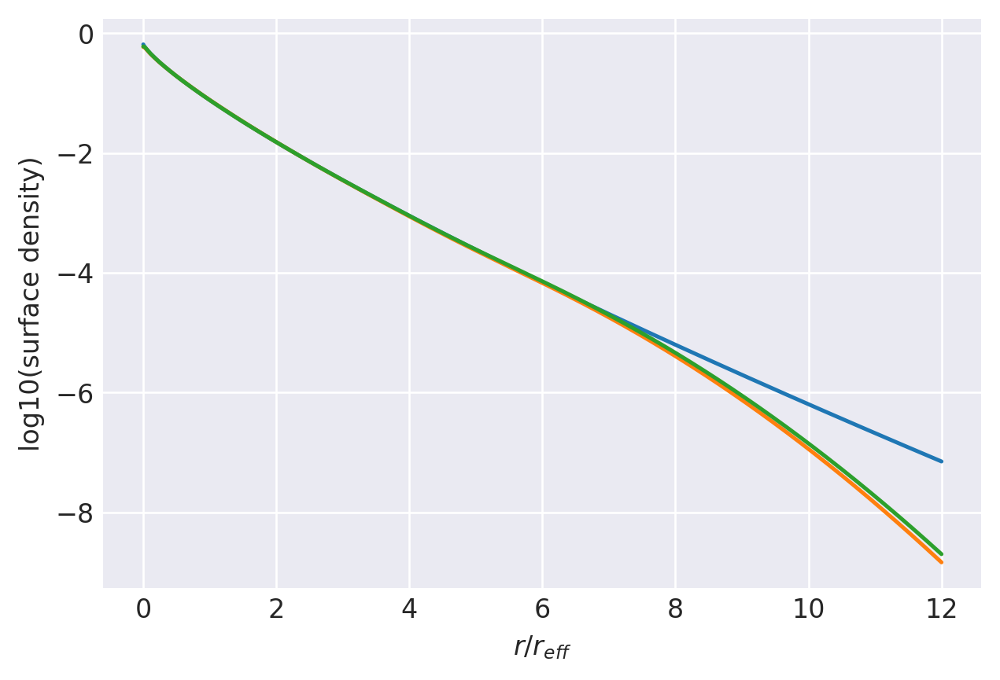

n=1.2355: (
    normalize(np.array([7.2895458412e-02, 2.7523463076e-01, 3.2550718192e-01, 2.0634523514e-01, 8.6970094347e-02, 2.6501949991e-02, 5.7784401913e-03, 7.6700923059e-04])),
    np.array([2.6763900903e+00, 1.6725138449e+00, 1.0601050262e+00, 6.6110667189e-01, 3.9758769431e-01, 2.2507206397e-01, 1.1492867297e-01, 4.7261356033e-02]),
),
[0, 24000]
0.9999933163968158 0.9999999746214016
prev.  chisq = -8.31281159951615
ws, re: (array([0.07289546, 0.27523463, 0.32550718, 0.20634524, 0.08697009,
       0.02650195, 0.00577844, 0.00076701]), array([2.67639009, 1.67251384, 1.06010503, 0.66110667, 0.39758769,
       0.22507206, 0.11492867, 0.04726136]))
         Current function value: -10.061554
         Iterations: 35
         Function evaluations: 1610
         Gradient evaluations: 94
-10.06155413901221 [-2.54327837 -0.87072616 -0.01387097  0.53072621  0.95768577  1.39001433
  2.01208744  0.43286076  0.22643996  0.02680621 -0.17955677 -0.40149444
 -0.64960566 -0.94248169 -1.32949084

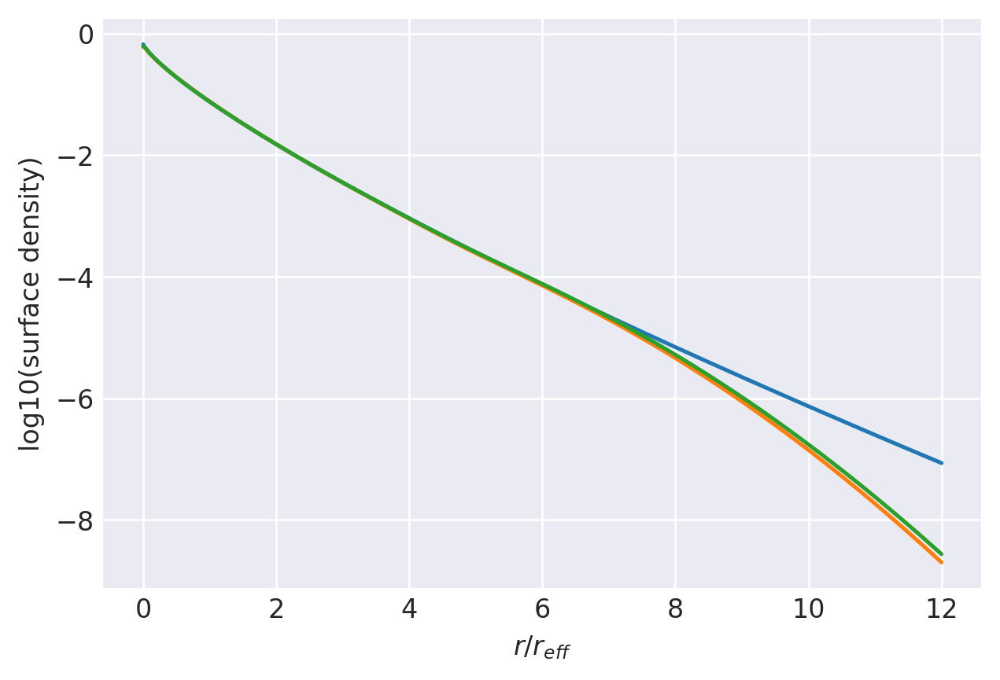

n=1.2513: (
    normalize(np.array([7.2879350158e-02, 2.7359629424e-01, 3.2449595986e-01, 2.0717354291e-01, 8.8059410777e-02, 2.7056446076e-02, 5.9442011693e-03, 7.9479481798e-04])),
    np.array([2.7093228335e+00, 1.6843795391e+00, 1.0636682728e+00, 6.6136808150e-01, 3.9673961076e-01, 2.2407548122e-01, 1.1416114391e-01, 4.6828383298e-02]),
),
[0, 24000]
0.9999916588921733 0.9999999495860501
prev.  chisq = -8.306183060429754
ws, re: (array([0.07287935, 0.27359629, 0.32449596, 0.20717354, 0.08805941,
       0.02705645, 0.0059442 , 0.00079479]), array([2.70932283, 1.68437954, 1.06366827, 0.66136808, 0.39673961,
       0.22407548, 0.11416114, 0.04682838]))
         Current function value: -10.017253
         Iterations: 37
         Function evaluations: 1746
         Gradient evaluations: 102
-10.01725326940245 [-2.54315762 -0.87900511 -0.02495602  0.51963285  0.94778795  1.38156187
  2.00468549  0.43818663  0.22951035  0.02825339 -0.17940619 -0.40245489
 -0.65157956 -0.94544778 -1.333542

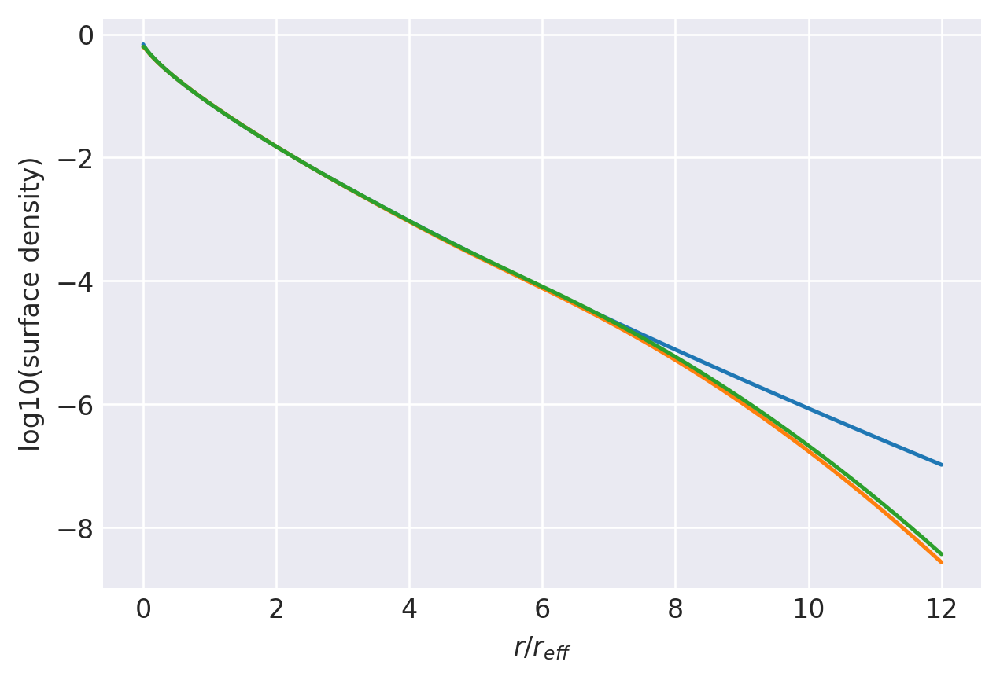

n=1.2674: (
    normalize(np.array([7.2887509582e-02, 2.7199995827e-01, 3.2346922742e-01, 2.0796088413e-01, 8.9134222255e-02, 2.7612361664e-02, 6.1124706563e-03, 8.2336602485e-04])),
    np.array([2.7427525833e+00, 1.6963300297e+00, 1.0672186188e+00, 6.6159742789e-01, 3.9586318524e-01, 2.2305935415e-01, 1.1338411751e-01, 4.6393580863e-02]),
),
[0, 24000]
0.9999896713083931 0.9999999151018234
prev.  chisq = -8.310212592082706
ws, re: (array([0.07288751, 0.27199996, 0.32346923, 0.20796088, 0.08913422,
       0.02761236, 0.00611247, 0.00082337]), array([2.74275258, 1.69633003, 1.06721862, 0.66159743, 0.39586319,
       0.22305935, 0.11338412, 0.04639358]))
         Current function value: -9.973733
         Iterations: 34
         Function evaluations: 2358
         Gradient evaluations: 138
-9.973733263362622 [-2.54255297 -0.88689623 -0.03568414  0.5087859   0.93804266  1.3732067
  1.99751047  0.44344852  0.23253111  0.02965905 -0.17929335 -0.40344944
 -0.6535852  -0.94845077 -1.33765682

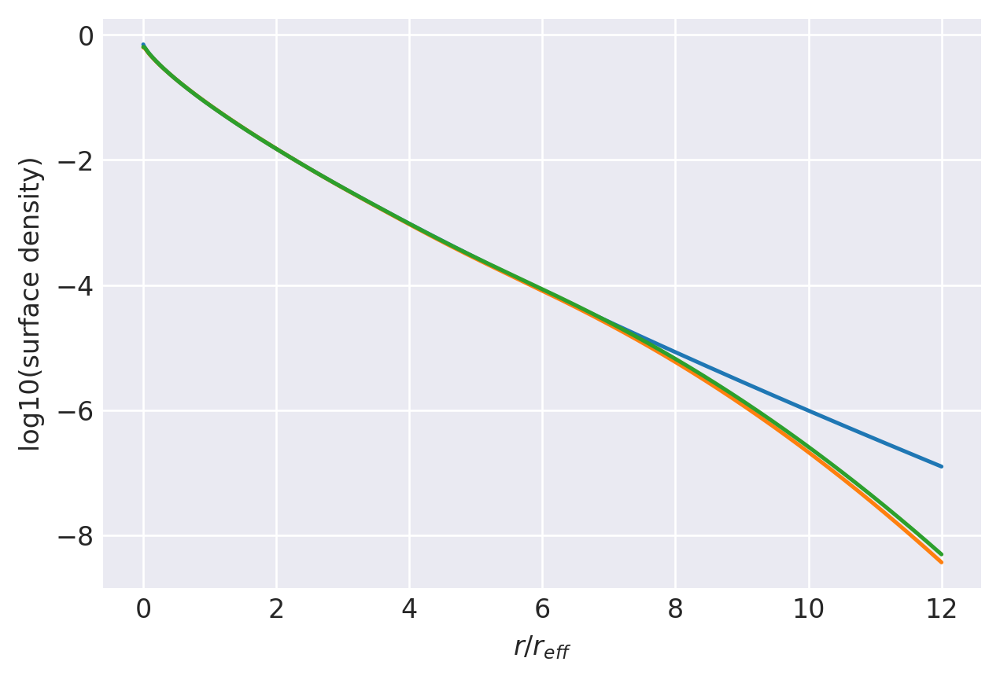

n=1.2836: (
    normalize(np.array([7.2928379510e-02, 2.7047384289e-01, 3.2244197816e-01, 2.0868758723e-01, 9.0174520341e-02, 2.8160757359e-02, 6.2808016702e-03, 8.5213284359e-04])),
    np.array([2.7761857285e+00, 1.7081700867e+00, 1.0706784315e+00, 6.6176934596e-01, 3.9495767619e-01, 2.2203160759e-01, 1.1260281166e-01, 4.5956101726e-02]),
),
[0, 24000]
0.9999872885935822 0.9999998688101817
prev.  chisq = -8.308924162018833
ws, re: (array([0.07292838, 0.27047384, 0.32244198, 0.20868759, 0.09017452,
       0.02816076, 0.0062808 , 0.00085213]), array([2.77618573, 1.70817009, 1.07067843, 0.66176935, 0.39495768,
       0.22203161, 0.11260281, 0.0459561 ]))
         Current function value: -9.930716
         Iterations: 34
         Function evaluations: 1882
         Gradient evaluations: 110
-9.93071563246086 [-2.54169045 -0.89448088 -0.04611928  0.49821883  0.92851513  1.36497856
  1.99015763  0.44869778  0.23553285  0.03103808 -0.17921907 -0.40449986
 -0.65566394 -0.95153239 -1.3418199 

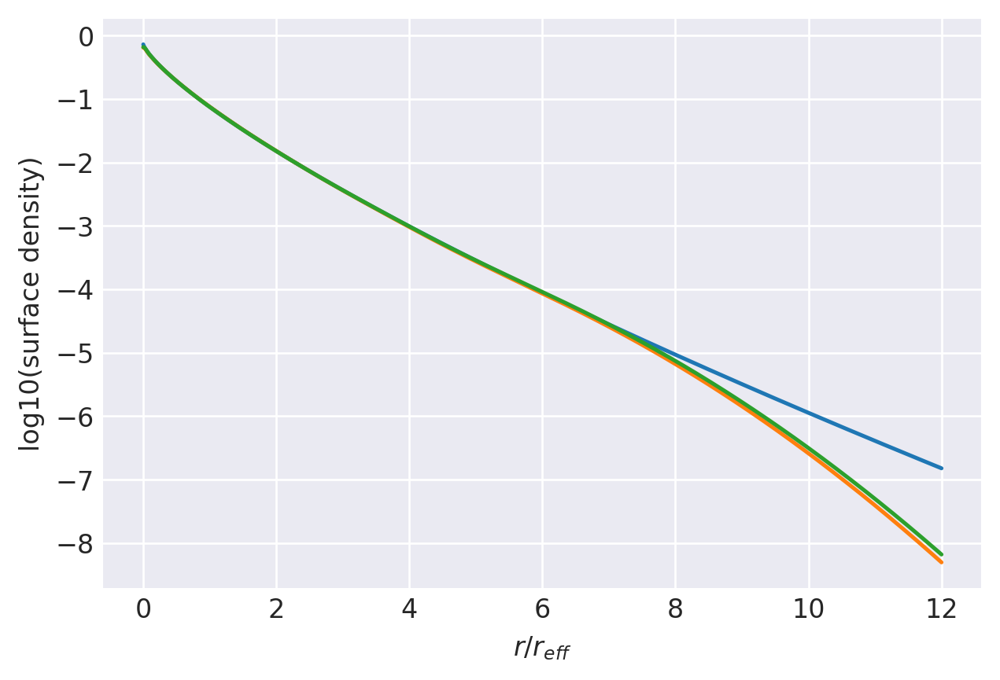

n=1.3: (
    normalize(np.array([7.2986715356e-02, 2.6900627516e-01, 3.2141814637e-01, 2.0937195771e-01, 9.1185762595e-02, 2.8701242855e-02, 6.4485514181e-03, 8.8134853811e-04])),
    np.array([2.8099447197e+00, 1.7200174479e+00, 1.0740835988e+00, 6.6188255446e-01, 3.9400355168e-01, 2.2097139885e-01, 1.1180664264e-01, 4.5517678092e-02]),
),
[0, 24000]
0.9999844301126902 0.9999998067835203
prev.  chisq = -8.302585567179149
ws, re: (array([0.07298672, 0.26900628, 0.32141815, 0.20937196, 0.09118576,
       0.02870124, 0.00644855, 0.00088135]), array([2.80994472, 1.72001745, 1.0740836 , 0.66188255, 0.39400355,
       0.2209714 , 0.11180664, 0.04551768]))
         Current function value: -9.887947
         Iterations: 33
         Function evaluations: 1831
         Gradient evaluations: 107
-9.887946721577656 [-2.54037367 -0.90182576 -0.05640537  0.48771418  0.91898072  1.35670971
  1.98286281  0.45394636  0.23852343  0.03239992 -0.17916831 -0.40557973
 -0.65777863 -0.95466102 -1.34605495]


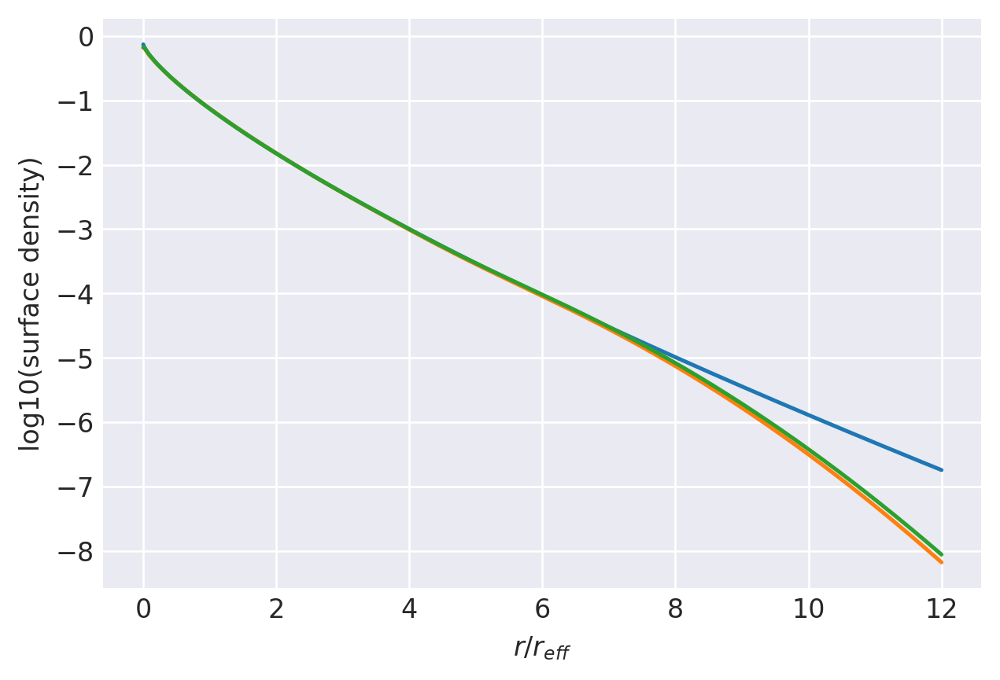

n=1.3167: (
    normalize(np.array([7.3075858396e-02, 2.6758024242e-01, 3.2037677954e-01, 2.1001311415e-01, 9.2180755945e-02, 2.9242986022e-02, 6.6189962865e-03, 9.1126724430e-04])),
    np.array([2.8441098053e+00, 1.7319024643e+00, 1.0774569217e+00, 6.6195991509e-01, 3.9302508080e-01, 2.1989804378e-01, 1.1100409044e-01, 4.5075966304e-02]),
),
[0, 24000]
0.9999810608573051 0.9999997241477735
prev.  chisq = -8.306425237772075
ws, re: (array([0.07307586, 0.26758024, 0.32037678, 0.21001311, 0.09218076,
       0.02924299, 0.006619  , 0.00091127]), array([2.84410981, 1.73190246, 1.07745692, 0.66195992, 0.39302508,
       0.21989804, 0.11100409, 0.04507597]))
         Current function value: -9.845938
         Iterations: 32
         Function evaluations: 1932
         Gradient evaluations: 113
-9.845938033592091 [-2.53866834 -0.90883137 -0.06638808  0.47745056  0.90961317  1.34854446
  1.97564288  0.45913392  0.24146711  0.03372478 -0.17914936 -0.40668939
 -0.65992266 -0.9578186  -1.3503178

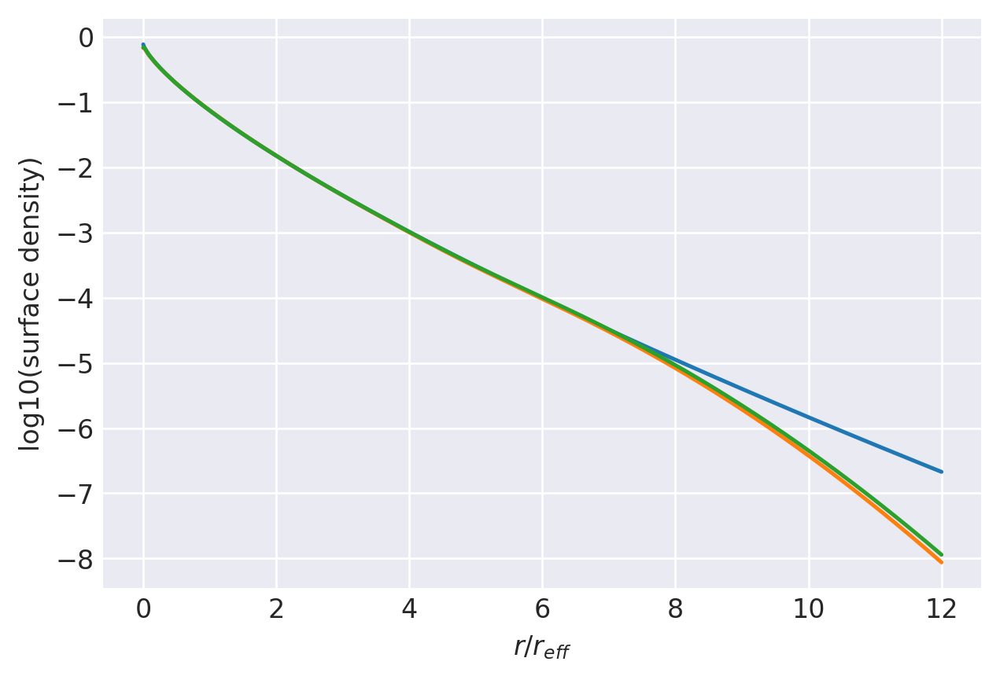

n=1.3335: (
    normalize(np.array([7.3191454494e-02, 2.6621559268e-01, 3.1933662629e-01, 2.1060486780e-01, 9.3144168483e-02, 2.9776721289e-02, 6.7891087671e-03, 9.4146020039e-04])),
    np.array([2.8782858443e+00, 1.7436812905e+00, 1.0807488458e+00, 6.6198880321e-01, 3.9202215361e-01, 2.1881512760e-01, 1.1019995016e-01, 4.4635682832e-02]),
),
[0, 24000]
0.9999770638096116 0.999999616342936
prev.  chisq = -8.300236908142452
ws, re: (array([0.07319145, 0.26621559, 0.31933663, 0.21060487, 0.09314417,
       0.02977672, 0.00678911, 0.00094146]), array([2.87828584, 1.74368129, 1.08074885, 0.6619888 , 0.39202215,
       0.21881513, 0.11019995, 0.04463568]))
         Current function value: -9.804189
         Iterations: 34
         Function evaluations: 1692
         Gradient evaluations: 99
-9.804188557996303 [-2.53666501 -0.91562012 -0.07619388  0.46732558  0.90033197  1.34036916
  1.96836973  0.46432975  0.24440594  0.03503412 -0.17915892 -0.40784246
 -0.66212428 -0.96104018 -1.3546586 ]

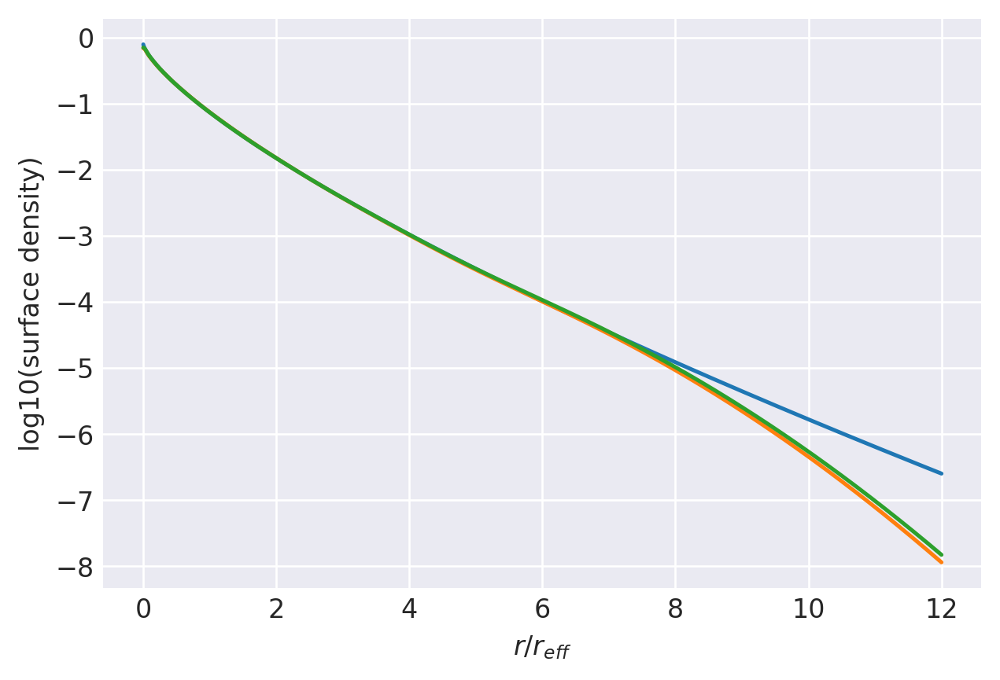

n=1.3506: (
    normalize(np.array([7.3327465336e-02, 2.6489042356e-01, 3.1829121363e-01, 2.1116122255e-01, 9.4088743401e-02, 3.0307874896e-02, 6.9607486725e-03, 9.7230795837e-04])),
    np.array([2.9129279815e+00, 1.7555206468e+00, 1.0840120846e+00, 6.6197422982e-01, 3.9098270102e-01, 2.1770866870e-01, 1.0938551647e-01, 4.4191769936e-02]),
),
[0, 24000]
0.9999723727377746 0.9999994750764832
prev.  chisq = -8.299047026030742
ws, re: (array([0.07332747, 0.26489042, 0.31829121, 0.21116122, 0.09408874,
       0.03030787, 0.00696075, 0.00097231]), array([2.91292798, 1.75552065, 1.08401208, 0.66197423, 0.3909827 ,
       0.21770867, 0.10938552, 0.04419177]))
         Current function value: -9.762950
         Iterations: 32
         Function evaluations: 1967
         Gradient evaluations: 115
-9.76295007445234 [-2.53414888 -0.92206302 -0.08573171  0.45736206  0.89113344  1.33232281
  1.96120465  0.46948125  0.24730233  0.03630146 -0.17921026 -0.40903714
 -0.6643708  -0.96432546 -1.35906225

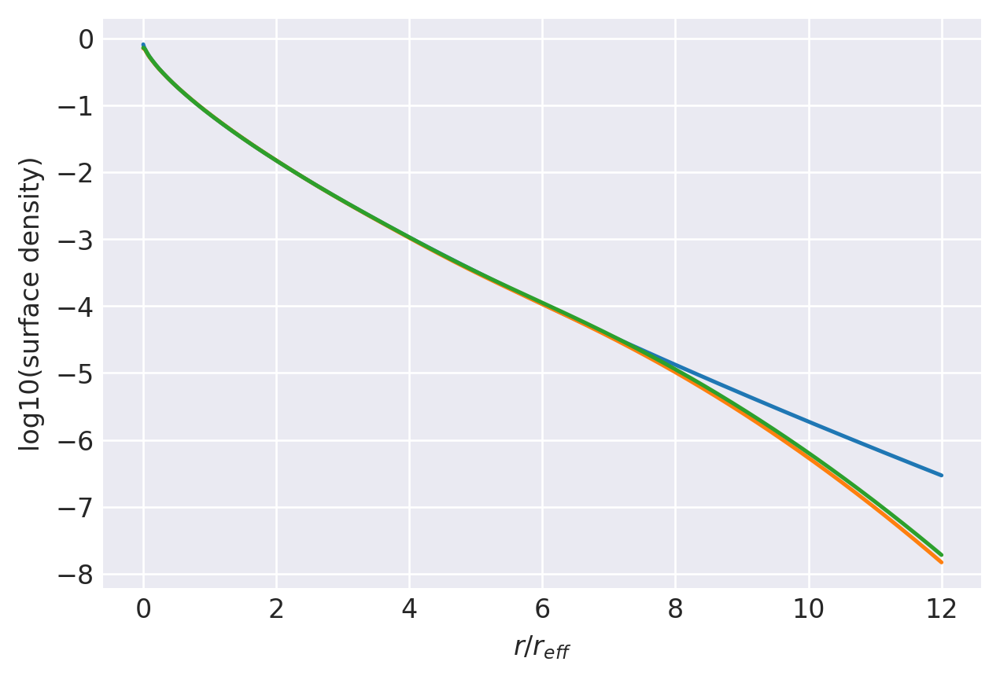

n=1.3679: (
    normalize(np.array([7.3498621743e-02, 2.6362459633e-01, 3.1723969626e-01, 2.1166407214e-01, 9.5003481711e-02, 3.0833652052e-02, 7.1324269046e-03, 1.0034528579e-03])),
    np.array([2.9476862090e+00, 1.7672676448e+00, 1.0871800058e+00, 6.6189597004e-01, 3.8990864383e-01, 2.1658541272e-01, 1.0856117716e-01, 4.3745939280e-02]),
),
[0, 24000]
0.9999668951195284 0.9999992931061924
prev.  chisq = -8.297856325134806
ws, re: (array([0.07349862, 0.2636246 , 0.3172397 , 0.21166407, 0.09500348,
       0.03083365, 0.00713243, 0.00100345]), array([2.94768621, 1.76726764, 1.08718001, 0.66189597, 0.38990864,
       0.21658541, 0.10856118, 0.04374594]))
         Current function value: -9.722221
         Iterations: 32
         Function evaluations: 1678
         Gradient evaluations: 98
-9.722221462021931 [-2.53132494 -0.92824259 -0.09503459  0.44759723  0.88207346  1.32431074
  1.95405399  0.47460406  0.25017133  0.03754127 -0.1792935  -0.41027075
 -0.66666283 -0.96765565 -1.3635193 

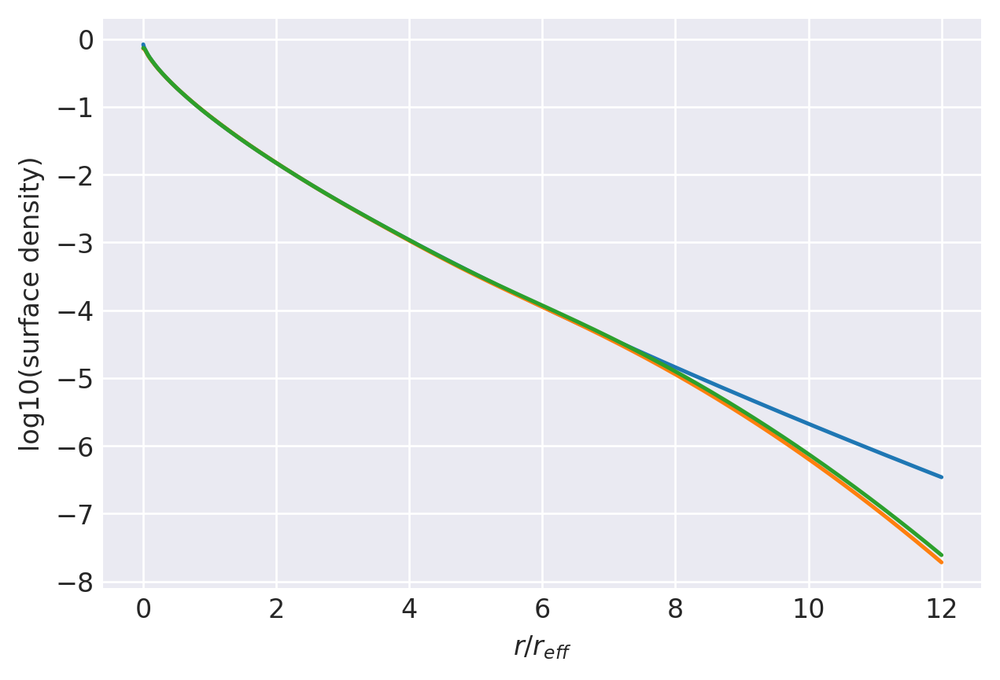

n=1.3854: (
    normalize(np.array([7.3691154093e-02, 2.6240605915e-01, 3.1618982170e-01, 2.1212848398e-01, 9.5892355892e-02, 3.1352730591e-02, 7.3043757775e-03, 1.0350188137e-03])),
    np.array([2.9826621081e+00, 1.7789810667e+00, 1.0902880854e+00, 6.6176912862e-01, 3.8880267888e-01, 2.1544537189e-01, 1.0773190876e-01, 4.3299282871e-02]),
),
[0, 24000]
0.9999617084933684 0.9999990600811766
prev.  chisq = -8.45509358306438
ws, re: (array([0.07369115, 0.26240606, 0.31618982, 0.21212848, 0.09589236,
       0.03135273, 0.00730438, 0.00103502]), array([2.98266211, 1.77898107, 1.09028809, 0.66176913, 0.38880268,
       0.21544537, 0.10773191, 0.04329928]))
         Current function value: -9.688976
         Iterations: 28
         Function evaluations: 1132
         Gradient evaluations: 66
-9.68897633474137 [-2.52870868 -0.93313296 -0.10254238  0.43966583  0.87467595  1.31774509
  1.94817179  0.47880603  0.2525144   0.03854037 -0.17938773 -0.4113174
 -0.6685867  -0.97044071 -1.36723799]
0

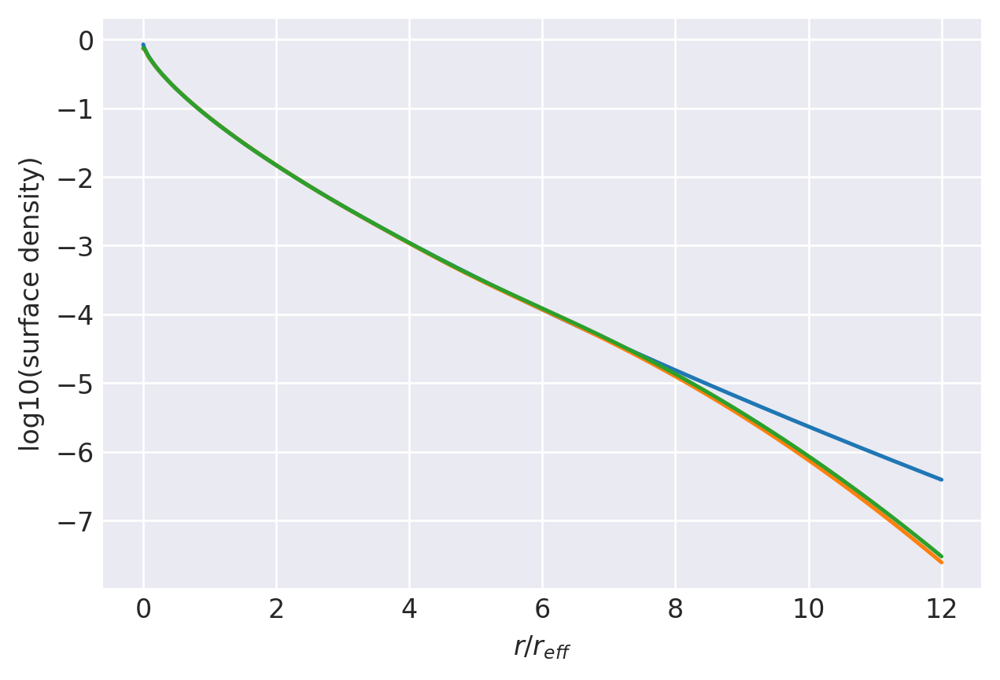

n=1.4: (
    normalize(np.array([7.3869941287e-02, 2.6143682530e-01, 3.1532172512e-01, 2.1248055482e-01, 9.6606373474e-02, 3.1776730628e-02, 7.4464709706e-03, 1.0613783964e-03])),
    np.array([3.0116606365e+00, 1.7886048170e+00, 1.0927992044e+00, 6.6162555245e-01, 3.8786679067e-01, 2.1449308962e-01, 1.0704325132e-01, 4.2930110489e-02]),
),
[0, 24000]
0.9999530823738664 0.9999988210273566
prev.  chisq = -8.153154801081463
ws, re: (array([0.07386994, 0.26143683, 0.31532173, 0.21248055, 0.09660637,
       0.03177673, 0.00744647, 0.00106138]), array([3.01166064, 1.78860482, 1.0927992 , 0.66162555, 0.38786679,
       0.21449309, 0.10704325, 0.04293011]))
         Current function value: -9.641850
         Iterations: 30
         Function evaluations: 1644
         Gradient evaluations: 96
-9.64185014939097 [-2.52468636 -0.93991579 -0.11307263  0.42847848  0.86421105  1.3084209
  1.93979901  0.48480884  0.25585365  0.03995058 -0.17955139 -0.41285497
 -0.6713936  -0.97449265 -1.37264229]
0.9

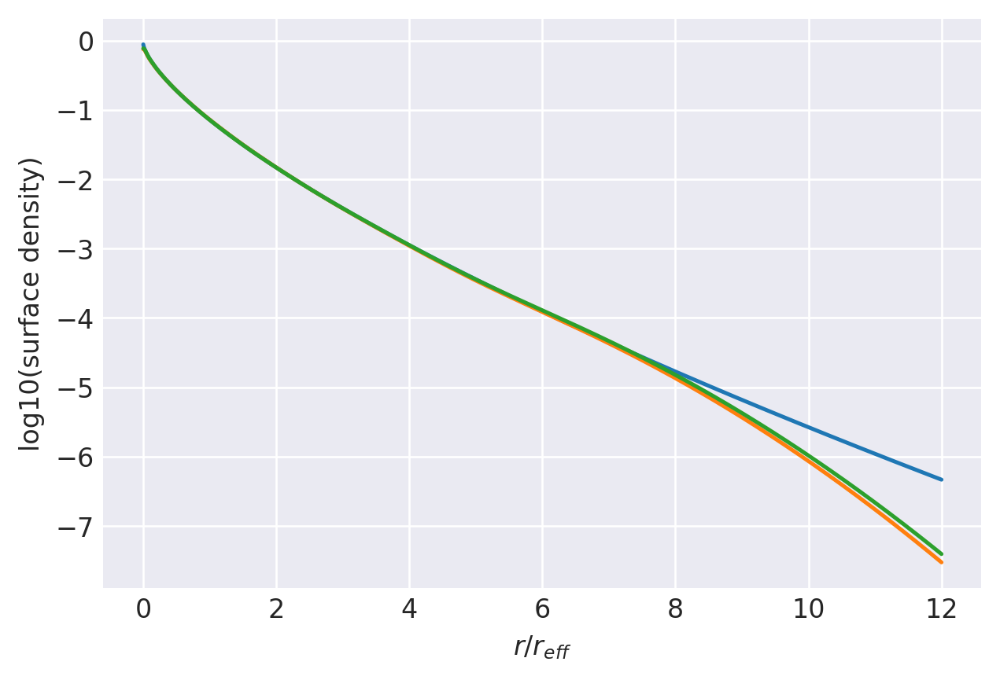

n=1.4212: (
    normalize(np.array([7.4145593206e-02, 2.6008856977e-01, 3.1408297172e-01, 2.1294759195e-01, 9.7605774324e-02, 3.2379148589e-02, 7.6506944367e-03, 1.0996560063e-03])),
    np.array([3.0535767618e+00, 1.8024102703e+00, 1.0963534202e+00, 6.6137626891e-01, 3.8649602558e-01, 2.1311126184e-01, 1.0604918867e-01, 4.2399204820e-02]),
),
[0, 24000]
0.9999445477829842 0.9999983865191808
prev.  chisq = -8.289445935988732
ws, re: (array([0.07414559, 0.26008857, 0.31408297, 0.21294759, 0.09760577,
       0.03237915, 0.00765069, 0.00109966]), array([3.05357676, 1.80241027, 1.09635342, 0.66137627, 0.38649603,
       0.21311126, 0.10604919, 0.0423992 ]))
         Current function value: -9.602439
         Iterations: 28
         Function evaluations: 1796
         Gradient evaluations: 105
-9.602438862647228 [-2.52060913 -0.94520769 -0.12168747  0.41921514  0.85543749  1.30055849
  1.93266999  0.48983226  0.2586182   0.04108058 -0.17975593 -0.41422505
 -0.67383804 -0.9779953  -1.3772756

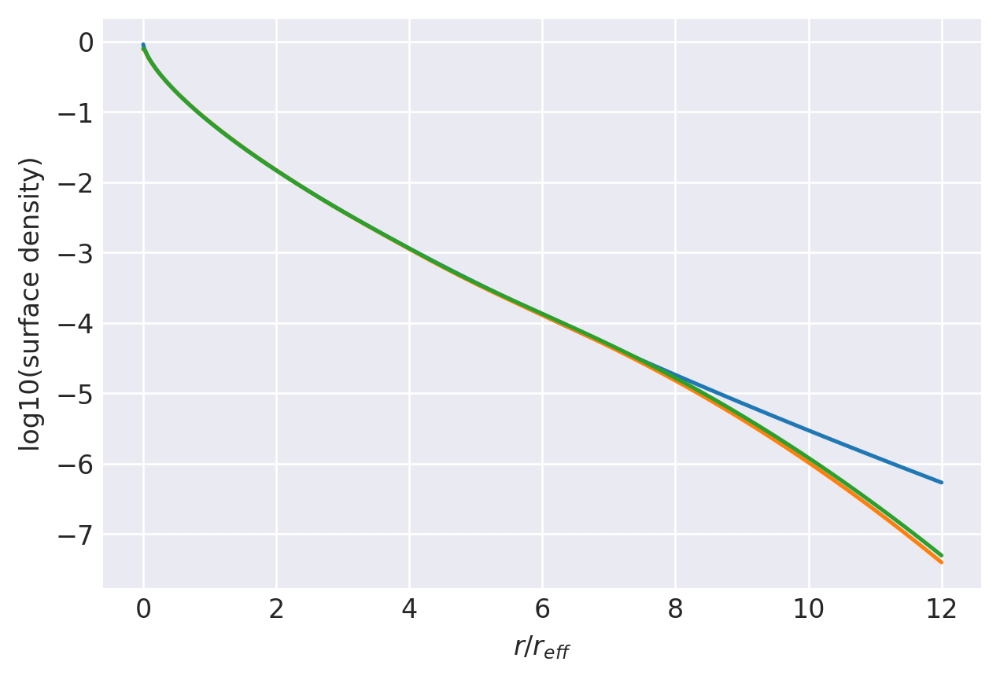

n=1.4394: (
    normalize(np.array([7.4425972967e-02, 2.5902153449e-01, 3.1302346020e-01, 2.1328244776e-01, 9.8411944954e-02, 3.2879054842e-02, 7.8231031996e-03, 1.1324815819e-03])),
    np.array([3.0891020609e+00, 1.8139202764e+00, 1.0992097673e+00, 6.6106485303e-01, 3.8527865411e-01, 2.1191512804e-01, 1.0519732699e-01, 4.1949264391e-02]),
),
[0, 24000]
0.9999347614339048 0.9999979181969721
prev.  chisq = -8.28811513837808
ws, re: (array([0.07442597, 0.25902153, 0.31302346, 0.21328245, 0.09841194,
       0.03287905, 0.0078231 , 0.00113248]), array([3.08910206, 1.81392028, 1.09920977, 0.66106485, 0.38527865,
       0.21191513, 0.10519733, 0.04194926]))
         Current function value: -9.563541
         Iterations: 26
         Function evaluations: 1983
         Gradient evaluations: 116
-9.563541312807901 [-2.5163406  -0.95031812 -0.13010748  0.41011004  0.84682708  1.29276076
  1.92563594  0.49482847  0.2613613   0.04219037 -0.17998234 -0.41562371
 -0.67632086 -0.98153816 -1.38197482

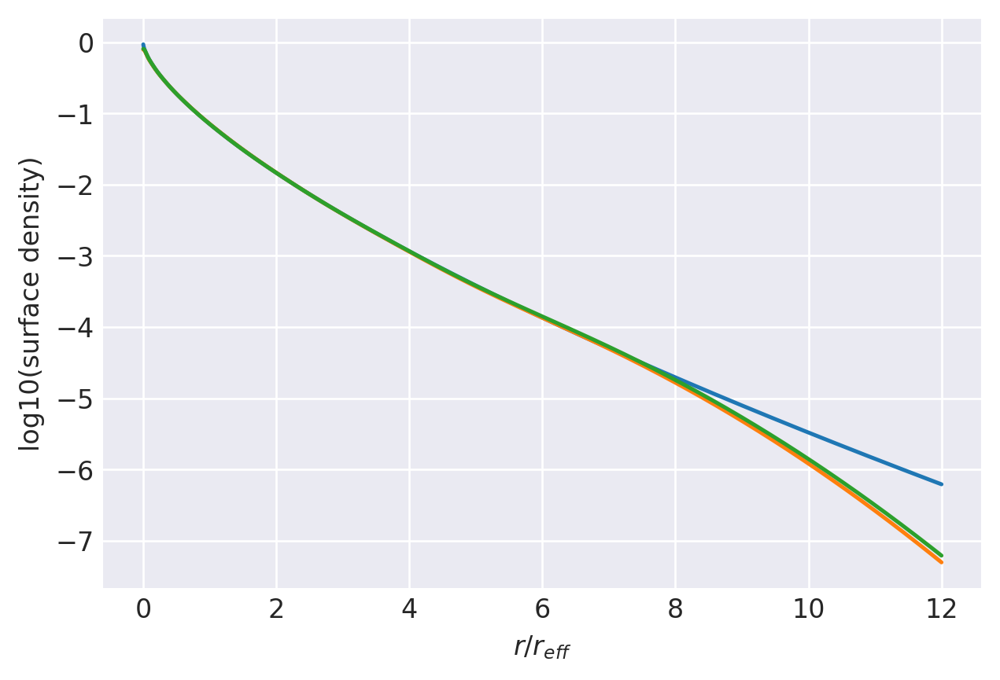

n=1.4578: (
    normalize(np.array([7.4720552906e-02, 2.5798720226e-01, 3.1197176034e-01, 2.1358821187e-01, 9.9198577432e-02, 3.3372537414e-02, 7.9955433391e-03, 1.1656144376e-03])),
    np.array([3.1248448991e+00, 1.8254136919e+00, 1.1020222605e+00, 6.6072030869e-01, 3.8403984670e-01, 2.1070708481e-01, 1.0434264401e-01, 4.1497809959e-02]),
),
[0, 24000]
0.9999235244787946 0.9999973356881425
prev.  chisq = -8.282295334757626
ws, re: (array([0.07472055, 0.2579872 , 0.31197176, 0.21358821, 0.09919858,
       0.03337254, 0.00799554, 0.00116561]), array([3.1248449 , 1.82541369, 1.10202226, 0.66072031, 0.38403985,
       0.21070708, 0.10434264, 0.04149781]))
         Current function value: -9.524951
         Iterations: 25
         Function evaluations: 1677
         Gradient evaluations: 98
-9.524951071351694 [-2.51166546 -0.95519108 -0.13835351  0.40114532  0.83827395  1.28503647
  1.91853311  0.49980427  0.26407773  0.04326977 -0.18024814 -0.4170705
 -0.67886174 -0.98515381 -1.38673933]

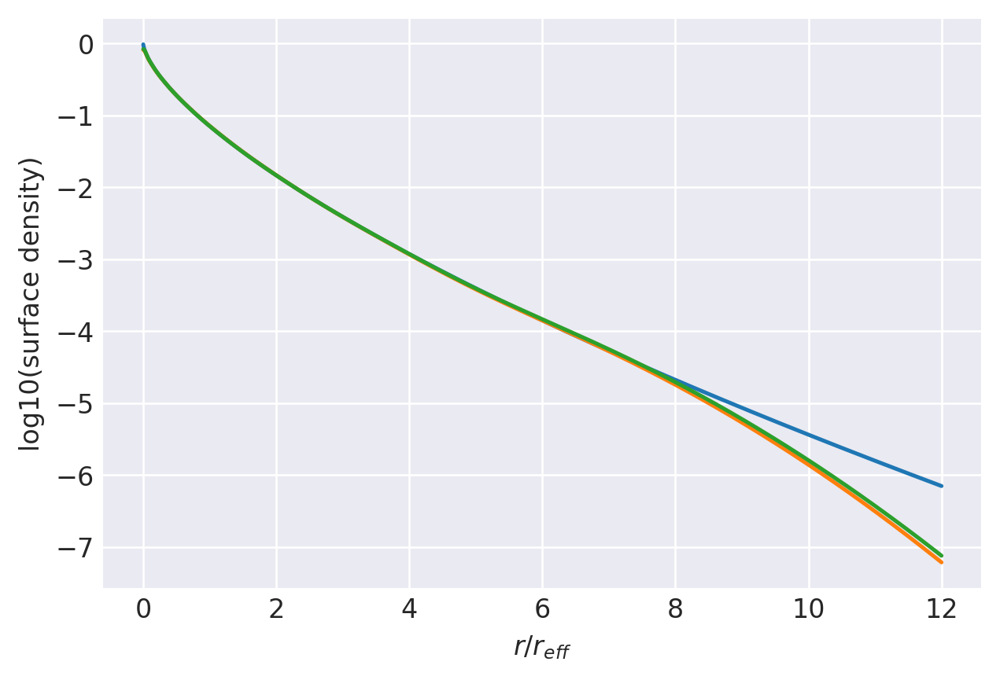

n=1.4765: (
    normalize(np.array([7.5044423796e-02, 2.5699155620e-01, 3.1091500224e-01, 2.1385908069e-01, 9.9961119154e-02, 3.3861387045e-02, 8.1681633580e-03, 1.1992675242e-03])),
    np.array([3.1608527765e+00, 1.8368670895e+00, 1.1047646433e+00, 6.6031605444e-01, 3.8276260633e-01, 2.0947792493e-01, 1.0347756236e-01, 4.1045038646e-02]),
),
[0, 24000]
0.9999074016233933 0.9999966141113916
prev.  chisq = -8.102081130631158
ws, re: (array([0.07504442, 0.25699156, 0.310915  , 0.21385908, 0.09996112,
       0.03386139, 0.00816816, 0.00119927]), array([3.16085278, 1.83686709, 1.10476464, 0.66031605, 0.38276261,
       0.20947792, 0.10347756, 0.04104504]))
         Current function value: -9.477751
         Iterations: 29
         Function evaluations: 1950
         Gradient evaluations: 114
-9.477750832926928 [-2.50537462 -0.96082755 -0.14823966  0.39027435  0.82784974  1.27552529
  1.90984117  0.50591907  0.26739077  0.04454888 -0.180641   -0.41893504
 -0.68209016 -0.98972074 -1.3927473

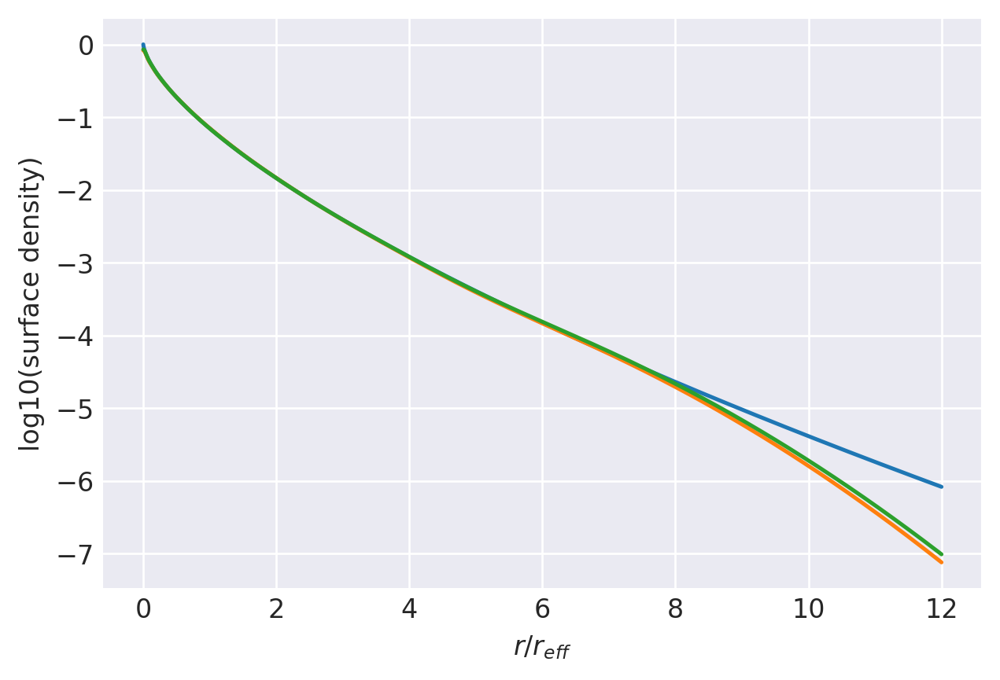

n=1.5: (
    normalize(np.array([7.5482256892e-02, 2.5582564909e-01, 3.0960965742e-01, 2.1413835957e-01, 1.0086659438e-01, 3.4454800427e-02, 8.3813687604e-03, 1.2413134719e-03])),
    np.array([3.2056719117e+00, 1.8509333167e+00, 1.1080232617e+00, 6.5971901713e-01, 3.8112282828e-01, 2.0792649738e-01, 1.0239511916e-01, 4.0481128013e-02]),
),
[0, 24000]
0.9998962594436899 0.9999954895139171
prev.  chisq = -8.498634563728233
ws, re: (array([0.07548226, 0.25582565, 0.30960966, 0.21413836, 0.10086659,
       0.0344548 , 0.00838137, 0.00124131]), array([3.20567191, 1.85093332, 1.10802326, 0.65971902, 0.38112283,
       0.2079265 , 0.10239512, 0.04048113]))
         Current function value: -9.449322
         Iterations: 24
         Function evaluations: 2137
         Gradient evaluations: 125
-9.449322446398643 [-2.50166921 -0.96430294 -0.15424473  0.38366832  0.82146761  1.26969022
  1.90466599  0.50965223  0.26942453  0.04534534 -0.18086303 -0.42005206
 -0.68403389 -0.99248117 -1.39640468]


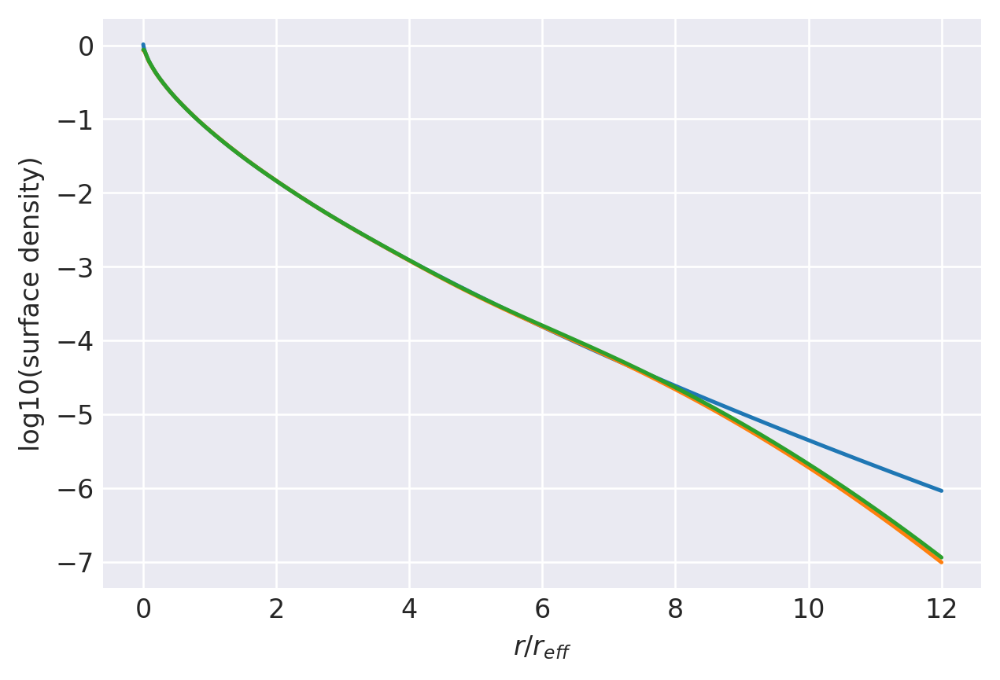

n=1.5145: (
    normalize(np.array([7.5741245215e-02, 2.5511159320e-01, 3.0882151080e-01, 2.1430640152e-01, 1.0141734598e-01, 3.4820247158e-02, 8.5141365353e-03, 1.2675195896e-03])),
    np.array([3.2333463291e+00, 1.8596213955e+00, 1.1100571555e+00, 6.5938182160e-01, 3.8014382271e-01, 2.0699798247e-01, 1.0174634768e-01, 4.0141659341e-02]),
),
[0, 24000]
0.9998798272363408 0.9999946499082376
prev.  chisq = -8.273479831472757
ws, re: (array([0.07574125, 0.25511159, 0.30882151, 0.2143064 , 0.10141735,
       0.03482025, 0.00851414, 0.00126752]), array([3.23334633, 1.8596214 , 1.11005716, 0.65938182, 0.38014382,
       0.20699798, 0.10174635, 0.04014166]))
         Current function value: -9.412087
         Iterations: 27
         Function evaluations: 1729
         Gradient evaluations: 101
-9.412087219484329 [-2.49552904 -0.96813936 -0.16169472  0.37529736  0.81334941  1.262217
  1.89766902  0.51447116  0.27198127  0.0462599  -0.18130437 -0.42169227
 -0.68679103 -0.99633225 -1.40142226]

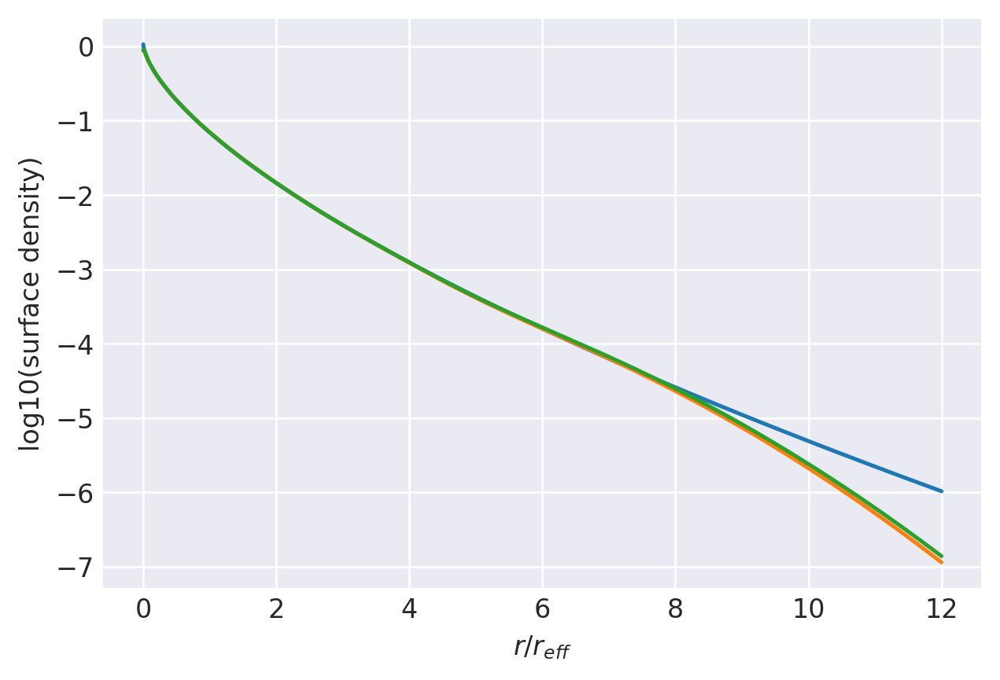

n=1.5339: (
    normalize(np.array([7.6172206144e-02, 2.5428500711e-01, 3.0776482521e-01, 2.1443968482e-01, 1.0207931506e-01, 3.5275174884e-02, 8.6821753007e-03, 1.3016114709e-03])),
    np.array([3.2694233239e+00, 1.8706014789e+00, 1.1123972403e+00, 6.5871207626e-01, 3.7871083379e-01, 2.0568800497e-01, 1.0084810673e-01, 3.9680554893e-02]),
),
[0, 24000]
0.9998612460917075 0.9999933529588133
prev.  chisq = -8.267647711794504
ws, re: (array([0.07617221, 0.25428501, 0.30776483, 0.21443968, 0.10207932,
       0.03527517, 0.00868218, 0.00130161]), array([3.26942332, 1.87060148, 1.11239724, 0.65871208, 0.37871083,
       0.205688  , 0.10084811, 0.03968055]))
         Current function value: -9.375184
         Iterations: 28
         Function evaluations: 2069
         Gradient evaluations: 121
-9.375183901257234 [-2.48941005 -0.97195945 -0.16908798  0.36696548  0.80522108  1.2547077
  1.8907416   0.51929797  0.27454733  0.04718044 -0.18174429 -0.4233348
 -0.689552   -1.00019293 -1.40646609]

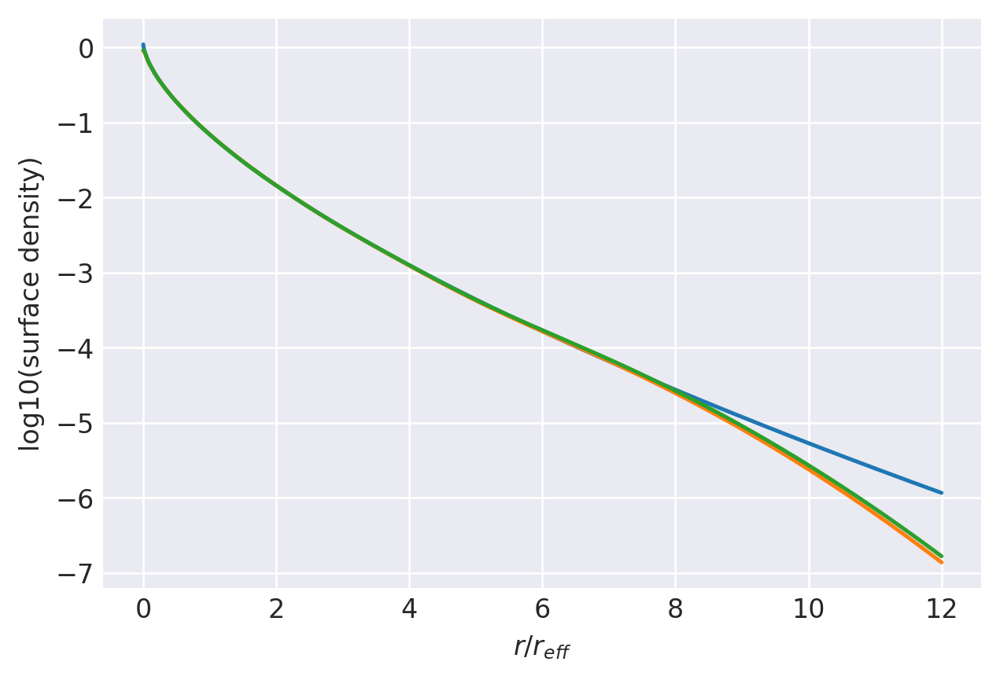

n=1.5536: (
    normalize(np.array([7.6603917282e-02, 2.5346309649e-01, 3.0671436945e-01, 2.1456250964e-01, 1.0273478057e-01, 3.5732014361e-02, 8.8528826742e-03, 1.3364295408e-03])),
    np.array([3.3059628211e+00, 1.8816867563e+00, 1.1147576024e+00, 6.5804517377e-01, 3.7728122693e-01, 2.0438452178e-01, 9.9955586473e-02, 3.9222376658e-02]),
),
[0, 24000]
0.999840415383441 0.9999917798762438
prev.  chisq = -8.265854301147531
ws, re: (array([0.07660392, 0.2534631 , 0.30671437, 0.21456251, 0.10273478,
       0.03573201, 0.00885288, 0.00133643]), array([3.30596282, 1.88168676, 1.1147576 , 0.65804517, 0.37728123,
       0.20438452, 0.09995559, 0.03922238]))
         Current function value: -9.338802
         Iterations: 35
         Function evaluations: 2018
         Gradient evaluations: 118
-9.338801636273674 [-2.48294373 -0.97552001 -0.17626217  0.35880693  0.7972216   1.24728762
  1.8838662   0.52406823  0.27706469  0.04805694 -0.18222712 -0.42502171
 -0.6923605  -1.00410553 -1.41156377

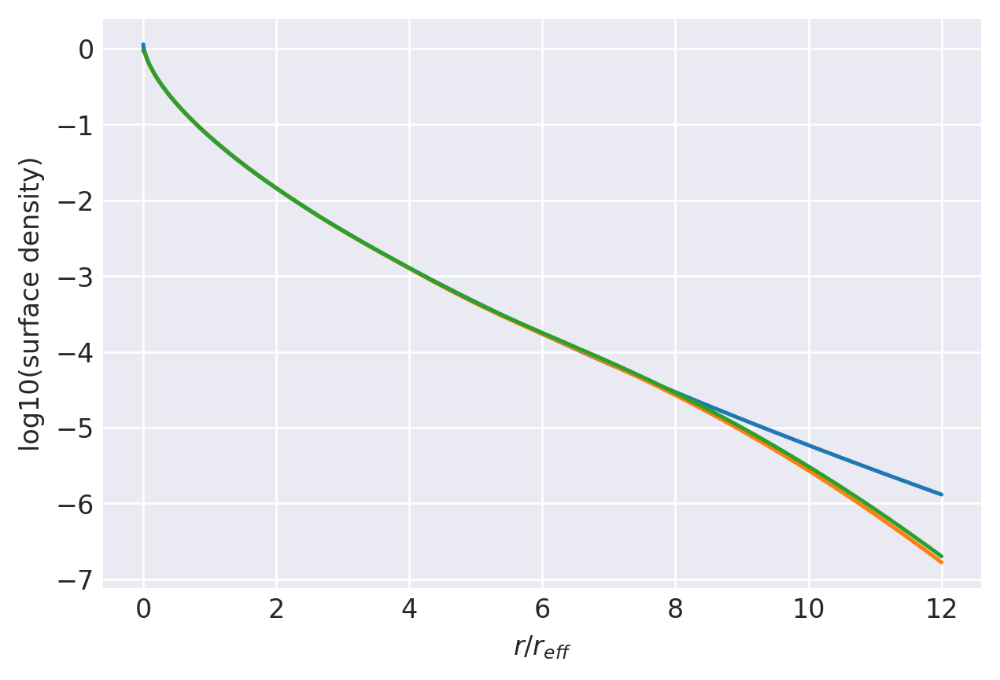

n=1.5735: (
    normalize(np.array([7.7062571863e-02, 2.5268329953e-01, 3.0566818281e-01, 2.1465055722e-01, 1.0336243436e-01, 3.6179267227e-02, 9.0222875573e-03, 1.3713994427e-03])),
    np.array([3.3424754976e+00, 1.8926255220e+00, 1.1170096937e+00, 6.5731399127e-01, 3.7581862020e-01, 2.0306707113e-01, 9.9059122039e-02, 3.8764682482e-02]),
),
[0, 24000]
0.999809248153844 0.9999899035501675
prev.  chisq = -8.041846049286928
ws, re: (array([0.07706257, 0.2526833 , 0.30566818, 0.21465056, 0.10336243,
       0.03617927, 0.00902229, 0.0013714 ]), array([3.3424755 , 1.89262552, 1.11700969, 0.65731399, 0.37581862,
       0.20306707, 0.09905912, 0.03876468]))
         Current function value: -9.291696
         Iterations: 29
         Function evaluations: 1967
         Gradient evaluations: 115
-9.291695767355868 [-2.47391852 -0.97980789 -0.18536714  0.34833769  0.78688556  1.23764638
  1.8749019   0.53025922  0.28030199  0.04914023 -0.18293201 -0.4273135
 -0.69613252 -1.00933546 -1.41835906]

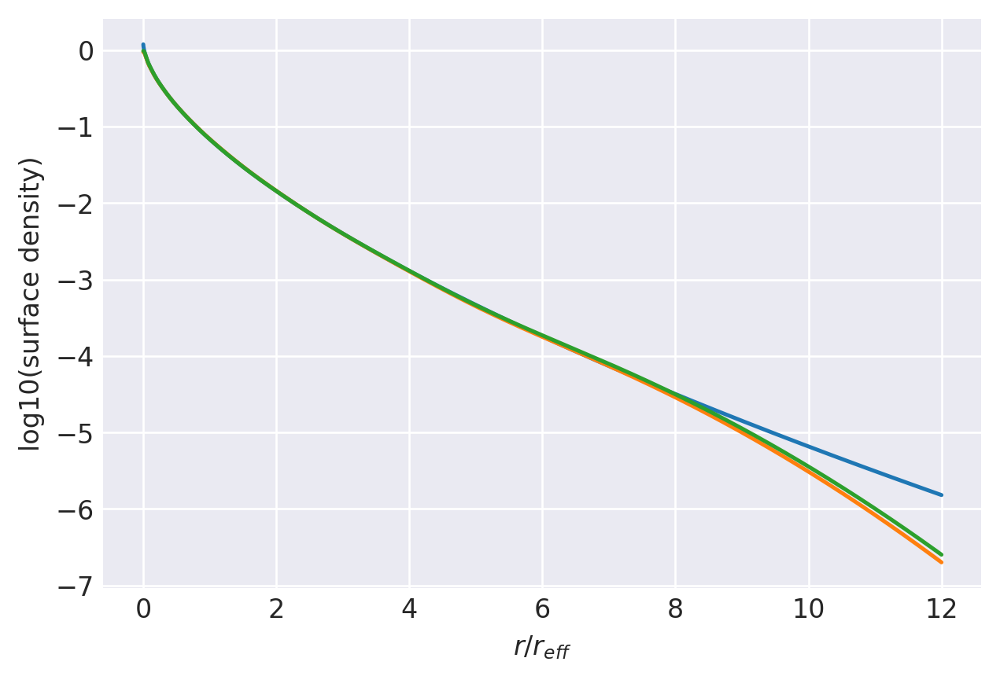

n=1.6: (
    normalize(np.array([7.7706935428e-02, 2.5172135794e-01, 3.0429904015e-01, 2.1471431704e-01, 1.0414517019e-01, 3.6752518705e-02, 9.2430533522e-03, 1.4176071993e-03])),
    np.array([3.3904646586e+00, 1.9067861555e+00, 1.1197994013e+00, 6.5624798889e-01, 3.7384063102e-01, 2.0131098853e-01, 9.7873370434e-02, 3.8162862052e-02]),
),
[0, 24000]
0.9997909796515941 0.9999868967546588
prev.  chisq = -8.53583271616976
ws, re: (array([0.07770694, 0.25172136, 0.30429904, 0.21471432, 0.10414517,
       0.03675252, 0.00924305, 0.00141761]), array([3.39046466, 1.90678616, 1.1197994 , 0.65624799, 0.37384063,
       0.20131099, 0.09787337, 0.03816286]))
         Current function value: -9.267235
         Iterations: 31
         Function evaluations: 1746
         Gradient evaluations: 102
-9.267234686142658 [-2.46893078 -0.98188678 -0.19000925  0.34294626  0.78152972  1.23262433
  1.87021416  0.53347908  0.28197146  0.04967777 -0.18333608 -0.42855444
 -0.69815484 -1.01212745 -1.42197717]
0

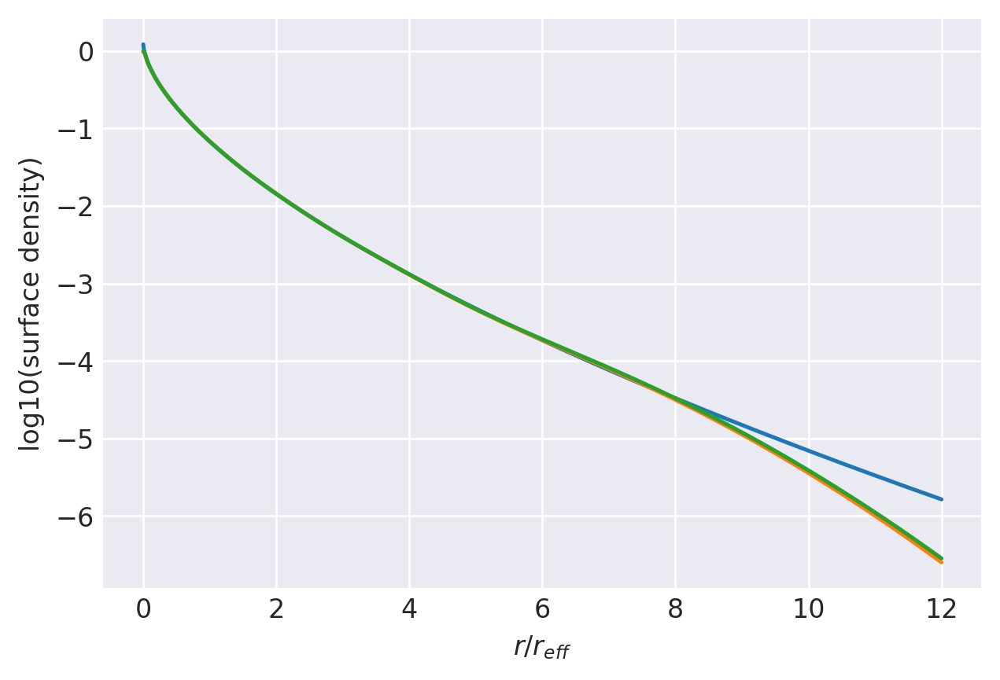

n=1.6141: (
    normalize(np.array([7.8065153137e-02, 2.5124344009e-01, 3.0358181824e-01, 2.1472461056e-01, 1.0453757447e-01, 3.7047170980e-02, 9.3582184746e-03, 1.4420140481e-03])),
    np.array([3.4156949924e+00, 1.9141301109e+00, 1.1211862670e+00, 6.5563770263e-01, 3.7277395059e-01, 2.0037574954e-01, 9.7246180262e-02, 3.7846247993e-02]),
),
[0, 24000]
0.9997620743087059 0.9999850339271817
prev.  chisq = -8.255650994376142
ws, re: (array([0.07806515, 0.25124344, 0.30358182, 0.21472461, 0.10453757,
       0.03704717, 0.00935822, 0.00144201]), array([3.41569499, 1.91413011, 1.12118627, 0.6556377 , 0.37277395,
       0.20037575, 0.09724618, 0.03784625]))
         Current function value: -9.232223
         Iterations: 30
         Function evaluations: 2068
         Gradient evaluations: 121
-9.23222271585896 [-2.46142147 -0.98468249 -0.19655336  0.33527991  0.77387725  1.22542242
  1.86347313  0.53809172  0.2843451   0.05041544 -0.18396132 -0.43039285
 -0.70112732 -1.01621797 -1.42726728

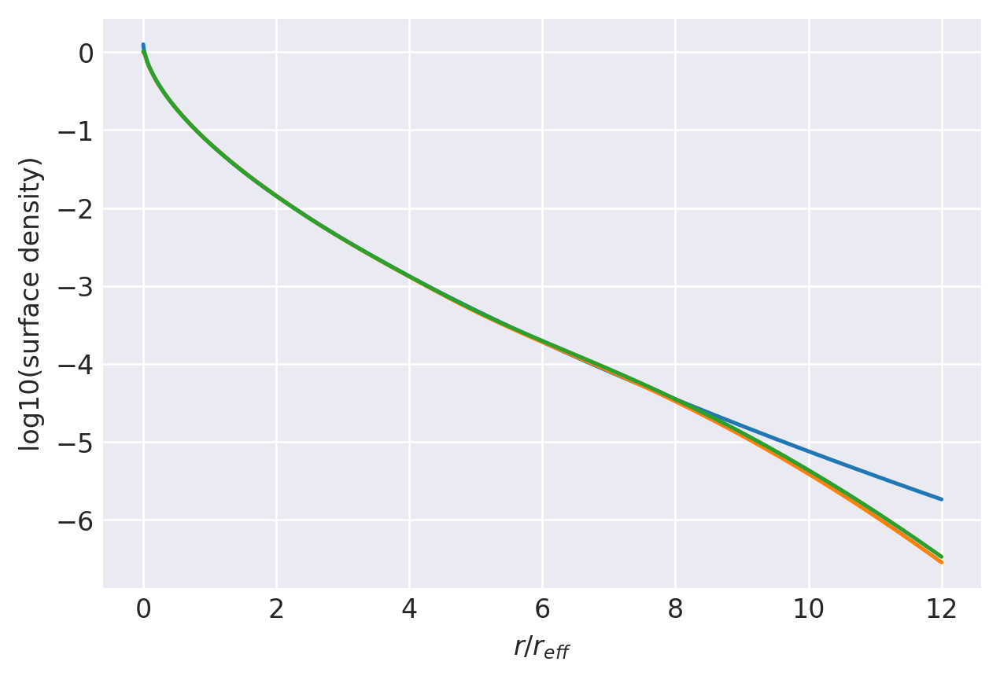

n=1.6347: (
    normalize(np.array([7.8607320963e-02, 2.5058532915e-01, 3.0254702770e-01, 2.1471178862e-01, 1.0508232443e-01, 3.7465173867e-02, 9.5236100540e-03, 1.4774252201e-03])),
    np.array([3.4521663968e+00, 1.9246204746e+00, 1.1230922729e+00, 6.5469447367e-01, 3.7119930435e-01, 1.9900898205e-01, 9.6334541331e-02, 3.7388041501e-02]),
),
[0, 24000]
0.9997297796397833 0.9999819497137747
prev.  chisq = -8.245812936279796
ws, re: (array([0.07860732, 0.25058533, 0.30254703, 0.21471179, 0.10508232,
       0.03746517, 0.00952361, 0.00147743]), array([3.4521664 , 1.92462047, 1.12309227, 0.65469447, 0.3711993 ,
       0.19900898, 0.09633454, 0.03738804]))
         Current function value: -9.197388
         Iterations: 30
         Function evaluations: 1406
         Gradient evaluations: 82
-9.197388432196645 [-2.45350488 -0.98724665 -0.20294117  0.32771633  0.76628178  1.21823996
  1.85672428  0.54268335  0.28668552  0.05110928 -0.18464179 -0.43229868
 -0.70418002 -1.020402   -1.43266451

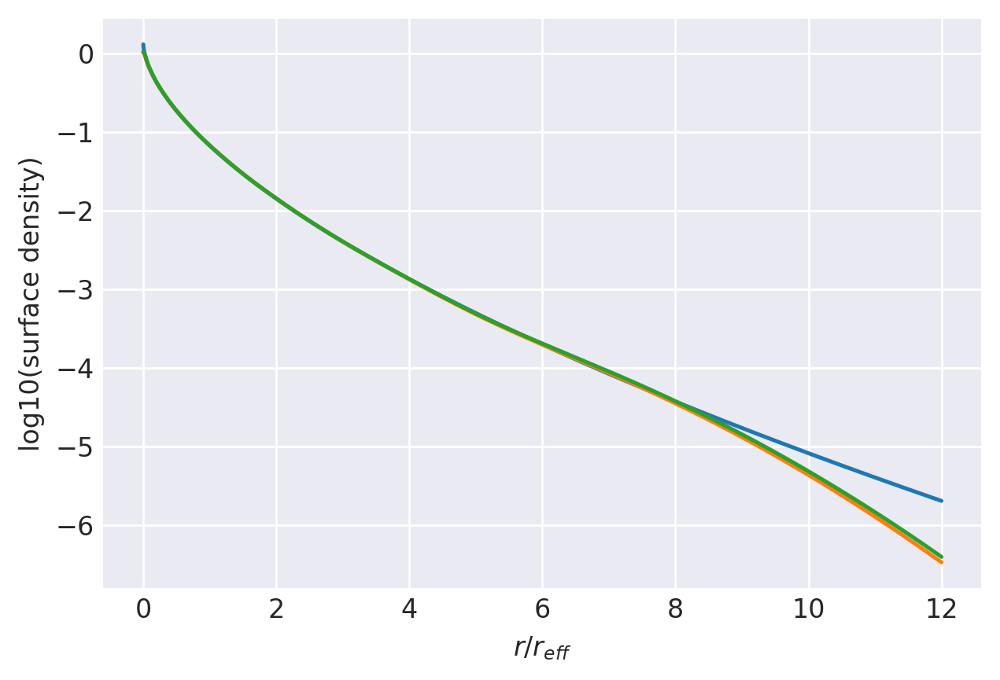

n=1.6557: (
    normalize(np.array([7.9182621648e-02, 2.4996164062e-01, 3.0150814193e-01, 2.1466615984e-01, 1.0560349431e-01, 3.7876081459e-02, 9.6886533181e-03, 1.5132068776e-03])),
    np.array([3.4888584808e+00, 1.9350202800e+00, 1.1248880002e+00, 6.5366948137e-01, 3.6957392590e-01, 1.9761503544e-01, 9.5410900580e-02, 3.6926274555e-02]),
),
[0, 24000]
0.9996941449955695 0.999978323565648
prev.  chisq = -8.243305901326984
ws, re: (array([0.07918262, 0.24996164, 0.30150814, 0.21466616, 0.10560349,
       0.03787608, 0.00968865, 0.00151321]), array([3.48885848, 1.93502028, 1.124888  , 0.65366948, 0.36957393,
       0.19761504, 0.0954109 , 0.03692627]))
         Current function value: -9.163068
         Iterations: 28
         Function evaluations: 1576
         Gradient evaluations: 92
-9.163068138747692 [-2.44526224 -0.98955726 -0.20911217  0.32032824  0.758817    1.21114725
  1.8500371   0.54720748  0.28896852  0.0517513  -0.18537202 -0.43425441
 -0.70728413 -1.02463975 -1.43811773]

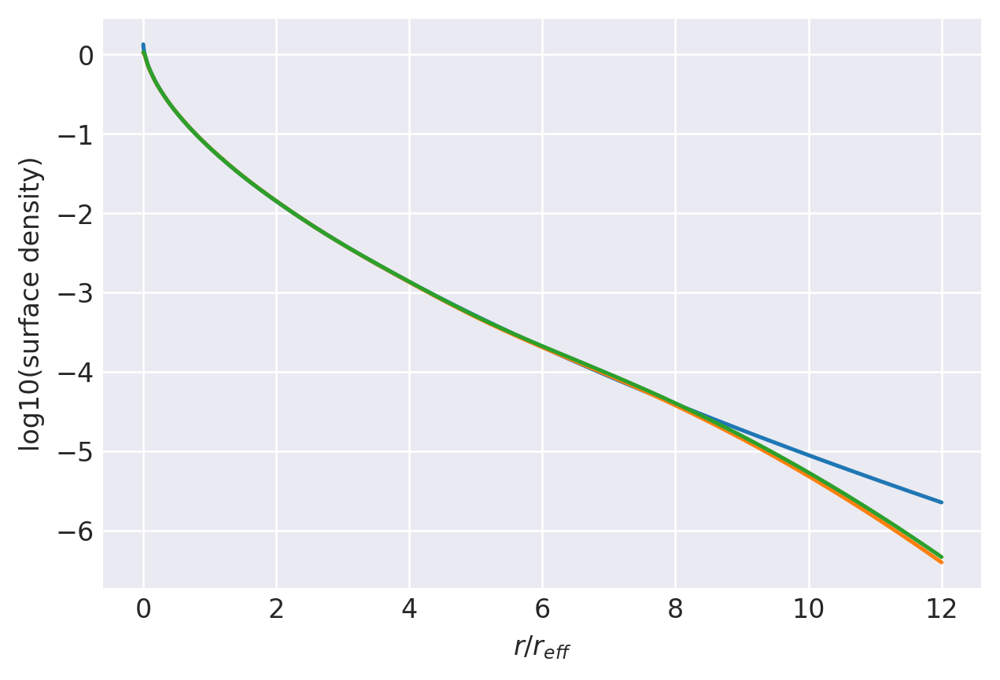

n=1.6769: (
    normalize(np.array([7.9785703666e-02, 2.4937764679e-01, 3.0047553642e-01, 2.1458880065e-01, 1.0609602933e-01, 3.8275669481e-02, 9.8516289244e-03, 1.5489847420e-03])),
    np.array([3.5253925152e+00, 1.9452190745e+00, 1.1265521379e+00, 6.5257132112e-01, 3.6791338986e-01, 1.9620761795e-01, 9.4484431556e-02, 3.6465508508e-02]),
),
[0, 24000]
0.9996516909135026 0.9999741236590277
prev.  chisq = -8.182240382949283
ws, re: (array([0.0797857 , 0.24937765, 0.30047554, 0.2145888 , 0.10609603,
       0.03827567, 0.00985163, 0.00154898]), array([3.52539252, 1.94521907, 1.12655214, 0.65257132, 0.36791339,
       0.19620762, 0.09448443, 0.03646551]))
         Current function value: -9.126602
         Iterations: 24
         Function evaluations: 1797
         Gradient evaluations: 105
-9.126602275181643 [-2.43601515 -0.99177251 -0.21554041  0.31254918  0.75091532  1.2036036
  1.84288524  0.55201155  0.29136672  0.05238567 -0.18621506 -0.43642047
 -0.71069251 -1.0292742  -1.44406603

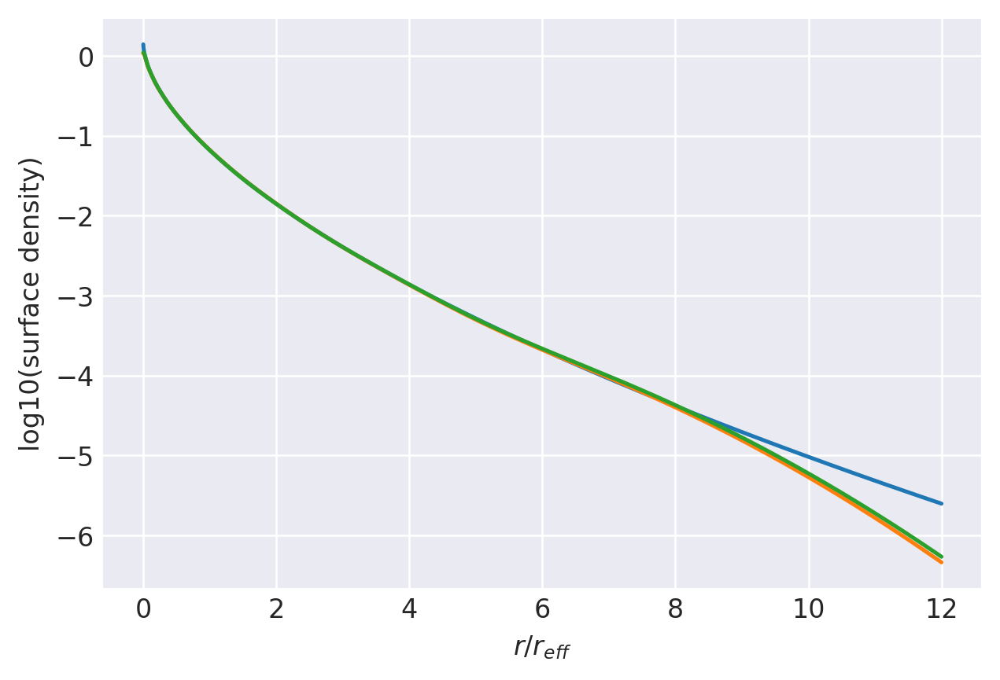

n=1.7: (
    normalize(np.array([8.0467267885e-02, 2.4879072214e-01, 2.9936728240e-01, 2.1447164047e-01, 1.0659652272e-01, 3.8694059860e-02, 1.0024954178e-02, 1.5875503489e-03])),
    np.array([3.5646061425e+00, 1.9559904053e+00, 1.1281989065e+00, 6.5130579302e-01, 3.6608297491e-01, 1.9467379108e-01, 9.3481526863e-02, 3.5969464252e-02]),
),
[0, 24000]
0.9996115467698597 0.9999688769180036
prev.  chisq = -8.291179257703925
ws, re: (array([0.08046727, 0.24879072, 0.29936728, 0.21447164, 0.10659652,
       0.03869406, 0.01002495, 0.00158755]), array([3.56460614, 1.95599041, 1.12819891, 0.65130579, 0.36608297,
       0.19467379, 0.09348153, 0.03596946]))
         Current function value: -9.095632
         Iterations: 23
         Function evaluations: 1591
         Gradient evaluations: 93
-9.095631762502242 [-2.42773174 -0.99344618 -0.22086803  0.30600665  0.74421182  1.19717068
  1.8367885   0.55608672  0.29337625  0.05287969 -0.18699361 -0.43833805
 -0.71367918 -1.03331893 -1.44924525]
0

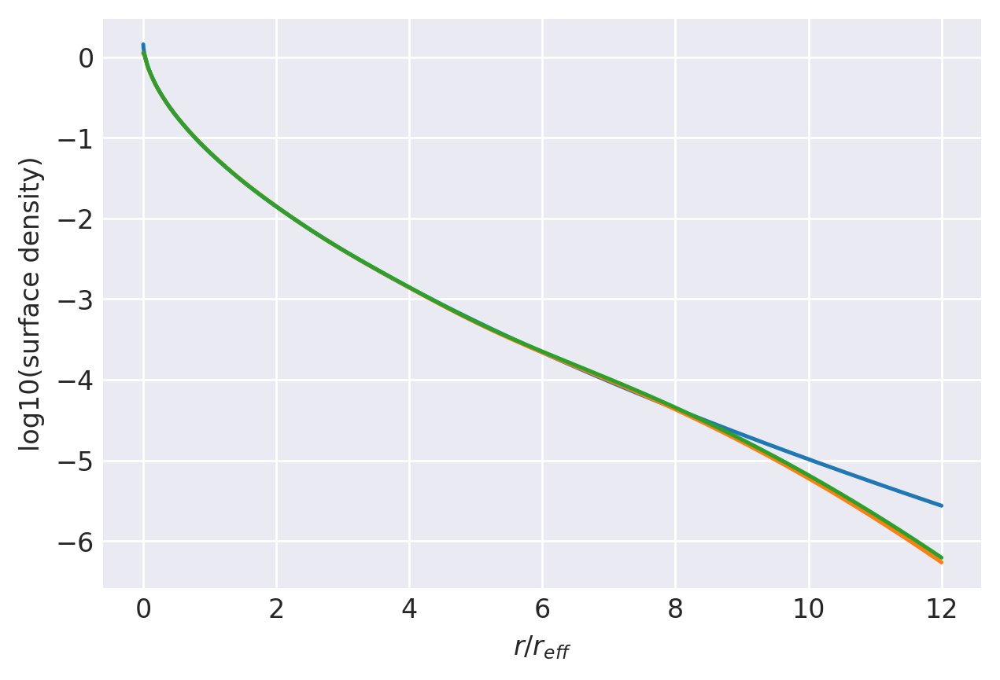

n=1.7201: (
    normalize(np.array([8.1082310353e-02, 2.4832090130e-01, 2.9841984480e-01, 2.1434051002e-01, 1.0699987191e-01, 3.9043550983e-02, 1.0172278860e-02, 1.6207317752e-03])),
    np.array([3.5982117574e+00, 1.9650619669e+00, 1.1294829861e+00, 6.5013925744e-01, 3.6447013497e-01, 1.9333960407e-01, 9.2614944609e-02, 3.5543054814e-02]),
),
[0, 24000]
0.9995640589252308 0.999963697412692
prev.  chisq = -8.227591663851266
ws, re: (array([0.08108231, 0.2483209 , 0.29841984, 0.21434051, 0.10699987,
       0.03904355, 0.01017228, 0.00162073]), array([3.59821176, 1.96506197, 1.12948299, 0.65013926, 0.36447013,
       0.1933396 , 0.09261494, 0.03554305]))
         Current function value: -9.062513
         Iterations: 26
         Function evaluations: 1814
         Gradient evaluations: 106
-9.062512846777322 [-2.4184549  -0.99503079 -0.22645722  0.29906968  0.73706978  1.19028582
  1.83022225  0.56043711  0.29549756  0.05336358 -0.18788659 -0.44046667
 -0.71696994 -1.03775907 -1.45491656

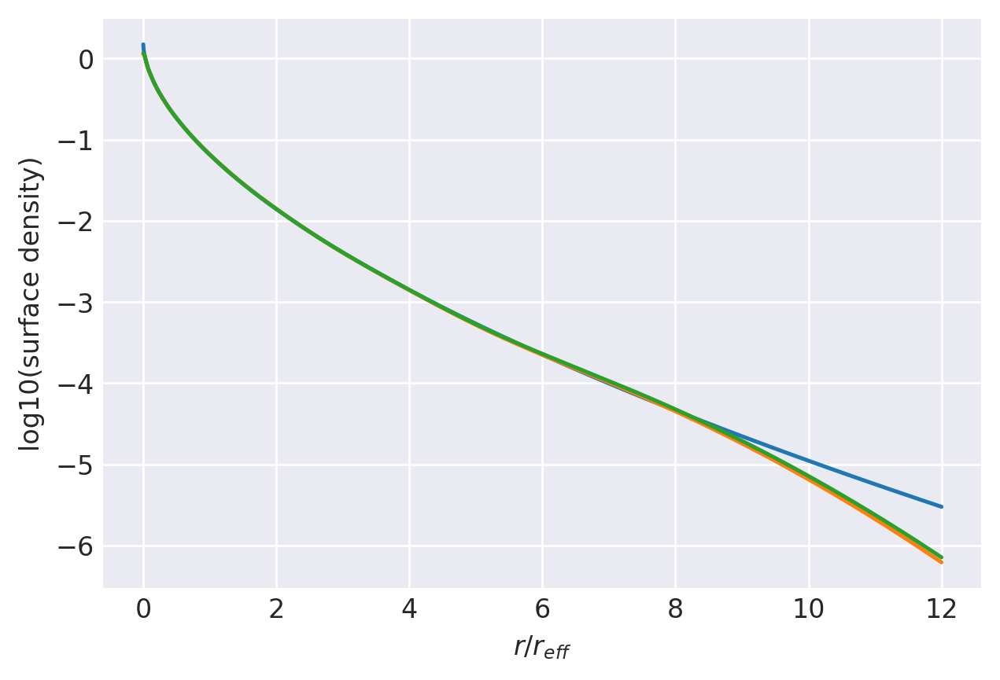

n=1.7421: (
    normalize(np.array([8.1776200016e-02, 2.4784655279e-01, 2.9739704873e-01, 2.1417085278e-01, 1.0741145765e-01, 3.9411498564e-02, 1.0329729017e-02, 1.6566604450e-03])),
    np.array([3.6344367100e+00, 1.9746837790e+00, 1.1307421523e+00, 6.4880383173e-01, 3.6268811591e-01, 1.9188015462e-01, 9.1672892445e-02, 3.5081926950e-02]),
),
[0, 24000]
0.9995120052985219 0.9999573264344408
prev.  chisq = -8.22094695992602
ws, re: (array([0.0817762 , 0.24784655, 0.29739705, 0.21417085, 0.10741146,
       0.0394115 , 0.01032973, 0.00165666]), array([3.63443671, 1.97468378, 1.13074215, 0.64880383, 0.36268812,
       0.19188015, 0.09167289, 0.03508193]))
         Current function value: -9.029742
         Iterations: 28
         Function evaluations: 953
         Gradient evaluations: 56
-9.029741982592714 [-2.40883063 -0.9963809  -0.23186297  0.2922736   0.73002744  1.18346538
  1.82369805  0.56473162  0.29756463  0.05379271 -0.18883745 -0.442658
 -0.72032939 -1.04227496 -1.46067168]
0.

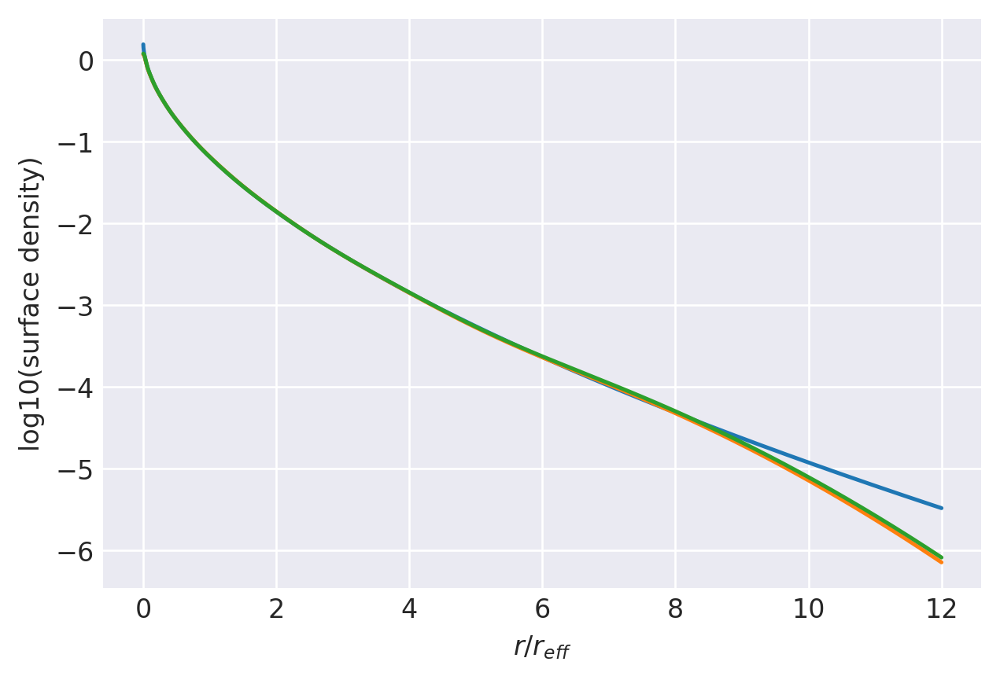

n=1.7644: (
    normalize(np.array([8.2501790747e-02, 2.4740667110e-01, 2.9637650087e-01, 2.1397153743e-01, 1.0779671776e-01, 3.9768914385e-02, 1.0485257019e-02, 1.6926106934e-03])),
    np.array([3.6705540589e+00, 1.9841048808e+00, 1.1318600005e+00, 6.4738487764e-01, 3.6086270706e-01, 1.9040160835e-01, 9.0724594588e-02, 3.4620100048e-02]),
),
[0, 24000]
0.9994550916891849 0.9999500709171724
prev.  chisq = -8.214184027109283
ws, re: (array([0.08250179, 0.24740667, 0.2963765 , 0.21397154, 0.10779672,
       0.03976891, 0.01048526, 0.00169261]), array([3.67055406, 1.98410488, 1.13186   , 0.64738488, 0.36086271,
       0.19040161, 0.09072459, 0.0346201 ]))
Optimization terminated successfully.
         Current function value: -8.997319
         Iterations: 30
         Function evaluations: 833
         Gradient evaluations: 49
-8.997319498076381 [-2.39886667 -0.99749987 -0.23708718  0.28561712  0.72308466  1.17670853
  1.81720975  0.56896777  0.29957574  0.05416586 -0.1898469  -0.44491229

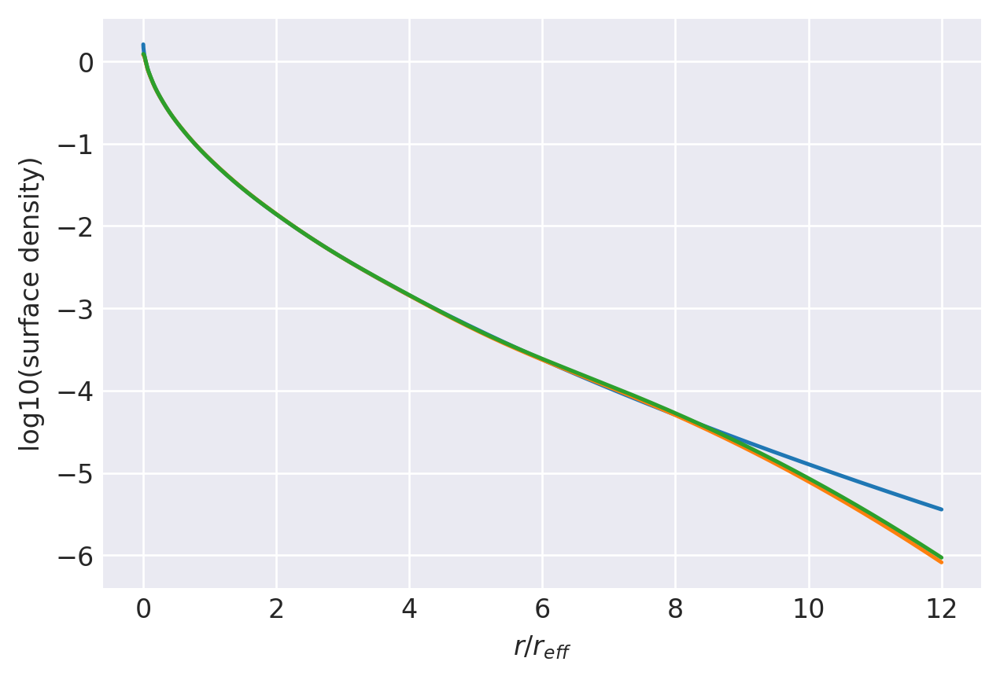

n=1.787: (
    normalize(np.array([8.3259159234e-02, 2.4700047456e-01, 2.9535837657e-01, 2.1374321207e-01, 1.0815582700e-01, 4.0115630494e-02, 1.0638751895e-02, 1.7285681735e-03])),
    np.array([3.7065321788e+00, 1.9933140954e+00, 1.1328329244e+00, 6.4588188172e-01, 3.5899443320e-01, 1.8890465210e-01, 8.9770642144e-02, 3.4157952552e-02]),
),
[0, 24000]
0.9994204058848846 0.9999418486553148
prev.  chisq = -8.567363304703582
ws, re: (array([0.08325916, 0.24700047, 0.29535838, 0.21374321, 0.10815583,
       0.04011563, 0.01063875, 0.00172857]), array([3.70653218, 1.9933141 , 1.13283292, 0.64588188, 0.35899443,
       0.18890465, 0.08977064, 0.03415795]))
         Current function value: -8.979017
         Iterations: 22
         Function evaluations: 1287
         Gradient evaluations: 75
-8.979017120519032 [-2.39304586 -0.99803508 -0.23998077  0.28189027  0.71917708  1.17289222
  1.81353557  0.57135246  0.30069506  0.05435285 -0.19044807 -0.44622401
 -0.72573964 -1.0495129  -1.46986784]

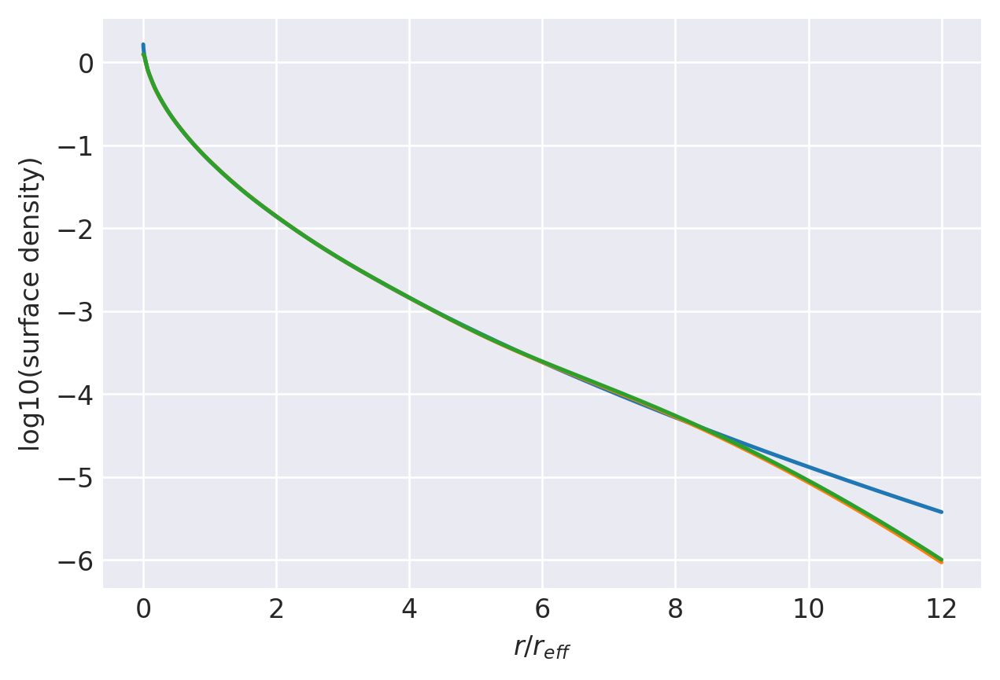

n=1.8: (
    normalize(np.array([8.3704523705e-02, 2.4678395802e-01, 2.9477995558e-01, 2.1360058371e-01, 1.0834862391e-01, 4.0308163899e-02, 1.0725167824e-02, 1.7490233375e-03])),
    np.array([3.7269405360e+00, 1.9984581432e+00, 1.1333207803e+00, 6.4498843734e-01, 3.5791177886e-01, 1.8804437955e-01, 8.9225111526e-02, 3.3894728868e-02]),
),
[0, 24000]
0.9993254812843457 0.9999367037702797
prev.  chisq = -7.932599065776686
ws, re: (array([0.08370452, 0.24678396, 0.29477996, 0.21360058, 0.10834862,
       0.04030816, 0.01072517, 0.00174902]), array([3.72694054, 1.99845814, 1.13332078, 0.64498844, 0.35791178,
       0.18804438, 0.08922511, 0.03389473]))
         Current function value: -8.933517
         Iterations: 27
         Function evaluations: 1235
         Gradient evaluations: 72
-8.933517096774409 [-2.37794994 -0.99905641 -0.24699883  0.27271955  0.70949528  1.16338711
  1.80435742  0.57725632  0.30342304  0.05473929 -0.19204486 -0.44961114
 -0.73081836 -1.05626981 -1.47842375]
0

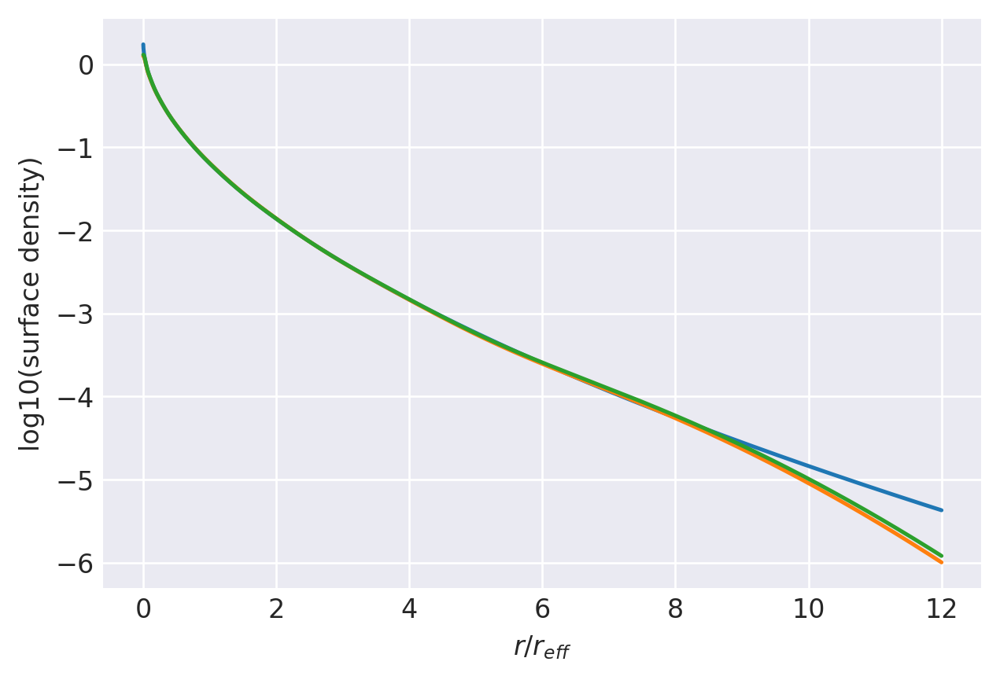

n=1.8331: (
    normalize(np.array([8.4869651673e-02, 2.4628626926e-01, 2.9332981476e-01, 2.1320213948e-01, 1.0879613330e-01, 4.0776382715e-02, 1.0939228622e-02, 1.8003801984e-03])),
    np.array([3.7779509919e+00, 2.0110507719e+00, 1.1343296607e+00, 6.4262133633e-01, 3.5513122753e-01, 1.8585816441e-01, 8.7847658593e-02, 3.3233513253e-02]),
),
[0, 24000]
0.999252172380334 0.9999221652671269
prev.  chisq = -8.193053597027705
ws, re: (array([0.08486965, 0.24628627, 0.29332981, 0.21320214, 0.10879613,
       0.04077638, 0.01093923, 0.00180038]), array([3.77795099, 2.01105077, 1.13432966, 0.64262134, 0.35513123,
       0.18585816, 0.08784766, 0.03323351]))
         Current function value: -8.902134
         Iterations: 22
         Function evaluations: 1593
         Gradient evaluations: 93
-8.902134120945325 [-2.36701323 -0.99950324 -0.25168514  0.26648291  0.70286043  1.15683505
  1.79798622  0.58130346  0.30525651  0.05493704 -0.19323568 -0.45205855
 -0.73445492 -1.06108695 -1.48450489]

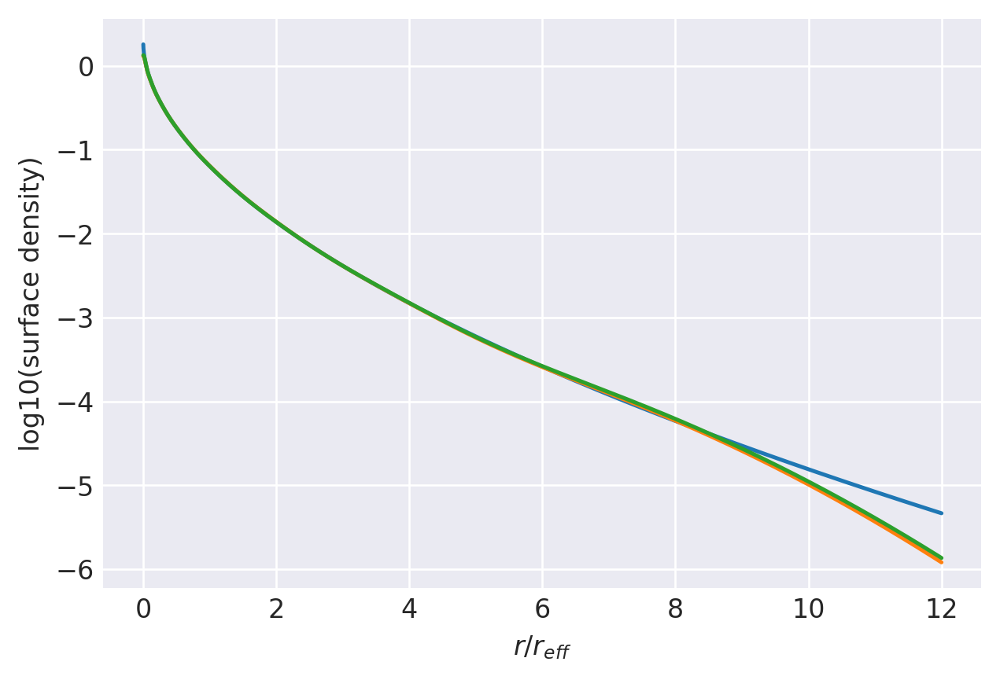

n=1.8566: (
    normalize(np.array([8.5722936267e-02, 2.4597627912e-01, 2.9232062610e-01, 2.1289096758e-01, 1.0907758347e-01, 4.1089716677e-02, 1.1085736914e-02, 1.8361538837e-03])),
    np.array([3.8133218117e+00, 2.0195588436e+00, 1.1348462759e+00, 6.4086170006e-01, 3.5313555772e-01, 1.8430838110e-01, 8.6878648164e-02, 3.2771408729e-02]),
),
[0, 24000]
0.9991727811638152 0.9999105360014722
prev.  chisq = -8.18568639582772
ws, re: (array([0.08572294, 0.24597628, 0.29232063, 0.21289097, 0.10907758,
       0.04108972, 0.01108574, 0.00183615]), array([3.81332181, 2.01955884, 1.13484628, 0.6408617 , 0.35313556,
       0.18430838, 0.08687865, 0.03277141]))
         Current function value: -8.871094
         Iterations: 20
         Function evaluations: 1167
         Gradient evaluations: 68
-8.871093527576788 [-2.3557808  -0.99973843 -0.25620221  0.26038124  0.69632136  1.15034763
  1.79166264  0.58528546  0.30702889  0.05507565 -0.19448679 -0.45456899
 -0.73815843 -1.0659763  -1.49066541]

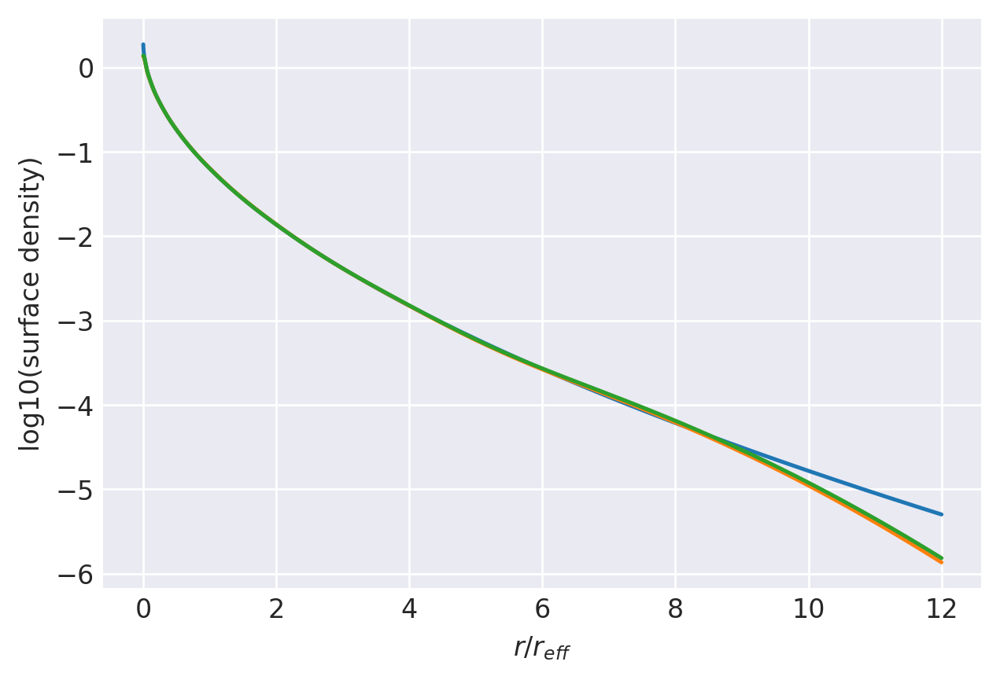

n=1.8804: (
    normalize(np.array([8.6607379131e-02, 2.4569608628e-01, 2.9131433977e-01, 2.1255431948e-01, 1.0933408209e-01, 4.1392090677e-02, 1.1229875425e-02, 1.8718271386e-03])),
    np.array([3.8484465167e+00, 2.0278175949e+00, 1.1352085374e+00, 6.3901817950e-01, 3.5110014209e-01, 1.8274334355e-01, 8.5906040452e-02, 3.2309823682e-02]),
),
[0, 24000]
0.9991034306546077 0.9998975961862735
prev.  chisq = -8.31283322207823
ws, re: (array([0.08660738, 0.24569609, 0.29131434, 0.21255432, 0.10933408,
       0.04139209, 0.01122988, 0.00187183]), array([3.84844652, 2.02781759, 1.13520854, 0.63901818, 0.35110014,
       0.18274334, 0.08590604, 0.03230982]))
         Current function value: -8.846070
         Iterations: 21
         Function evaluations: 2069
         Gradient evaluations: 121
-8.846070461531571 [-2.34641025 -0.99976914 -0.25975284  0.25550978  0.69106939  1.14511484
  1.78655214  0.58847657  0.3084242   0.05514242 -0.1955516  -0.45666076
 -0.74122407 -1.07001101 -1.4957383 

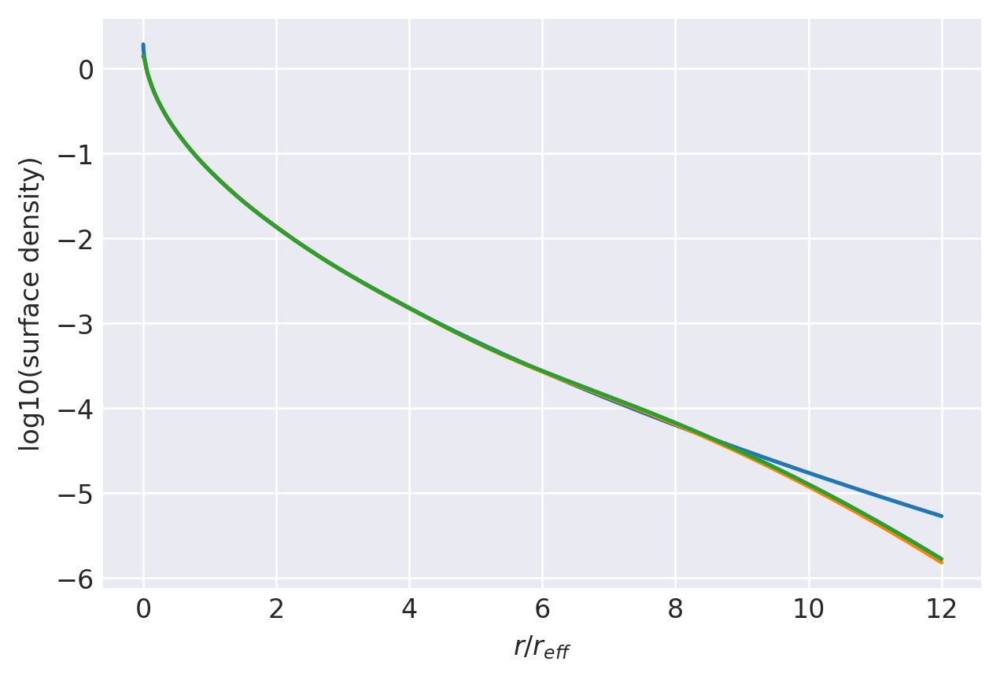

n=1.9: (
    normalize(np.array([8.7351528447e-02, 2.4549040479e-01, 2.9049694605e-01, 2.1226066140e-01, 1.0952437126e-01, 4.1629960305e-02, 1.1345361900e-02, 1.9007658418e-03])),
    np.array([3.8768283561e+00, 2.0343430928e+00, 1.1353830920e+00, 6.3745333151e-01, 3.4941314343e-01, 1.8145792055e-01, 8.5111645146e-02, 3.1934615802e-02]),
),
[0, 24000]
0.9989945020210451 0.9998860380741623
prev.  chisq = -8.052249489104915
ws, re: (array([0.08735153, 0.2454904 , 0.29049695, 0.21226066, 0.10952437,
       0.04162996, 0.01134536, 0.00190077]), array([3.87682836, 2.03434309, 1.13538309, 0.63745333, 0.34941314,
       0.18145792, 0.08511165, 0.03193462]))
         Current function value: -8.810027
         Iterations: 25
         Function evaluations: 1746
         Gradient evaluations: 102
-8.81002684751314 [-2.33243318 -0.99957338 -0.26471767  0.24858585  0.6835494   1.13758113
  1.77915617  0.59304169  0.31038101  0.05516655 -0.19717767 -0.45978643
 -0.74577386 -1.07597764 -1.50322391]
0

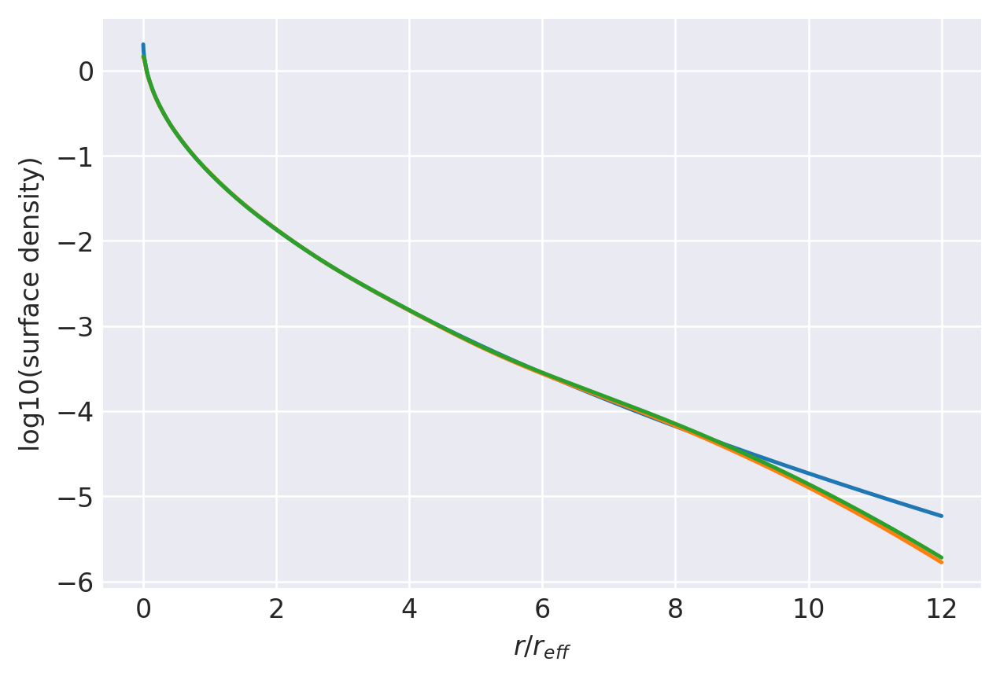

n=1.9289: (
    normalize(np.array([8.8472243328e-02, 2.4522403526e-01, 2.8931197797e-01, 2.1180466832e-01, 1.0977183731e-01, 4.1962371674e-02, 1.1510173230e-02, 1.9426929010e-03])),
    np.array([3.9177948688e+00, 2.0435299454e+00, 1.1354461805e+00, 6.3507106882e-01, 3.4690740789e-01, 1.7956683996e-01, 8.3950320081e-02, 3.1388899808e-02]),
),
[0, 24000]
0.9988949883809644 0.9998674633275316
prev.  chisq = -8.162468065948007
ws, re: (array([0.08847224, 0.24522404, 0.28931198, 0.21180467, 0.10977184,
       0.04196237, 0.01151017, 0.00194269]), array([3.91779487, 2.04352995, 1.13544618, 0.63507107, 0.34690741,
       0.17956684, 0.08395032, 0.0313889 ]))
         Current function value: -8.779993
         Iterations: 26
         Function evaluations: 817
         Gradient evaluations: 48
-8.779993277363989 [-2.32035735 -0.99919306 -0.26872693  0.2428895   0.67731525  1.13130445
  1.77297317  0.596815    0.311961    0.0551197  -0.19861627 -0.46249205
 -0.74968417 -1.08108808 -1.50962116]

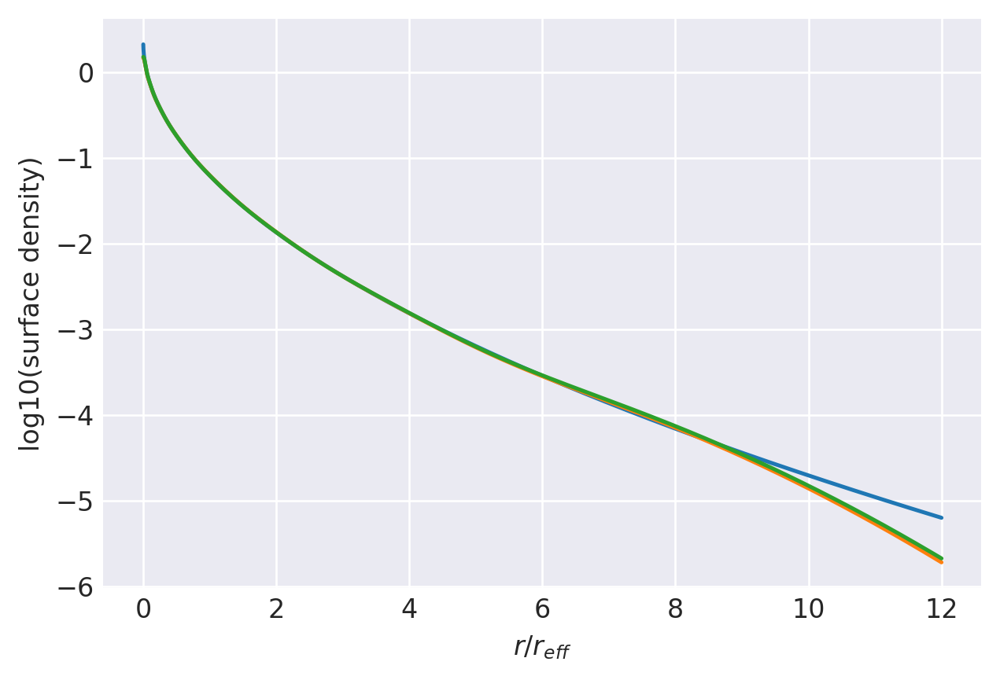

n=1.9536: (
    normalize(np.array([8.9450948728e-02, 2.4502884544e-01, 2.8831643666e-01, 2.1139464766e-01, 1.0995453260e-01, 4.2230512496e-02, 1.1646228698e-02, 1.9778477166e-03])),
    np.array([3.9519823449e+00, 2.0509780039e+00, 1.1353237020e+00, 6.3297087959e-01, 3.4475292067e-01, 1.7795730952e-01, 8.2968248665e-02, 3.0929923345e-02]),
),
[0, 24000]
0.9987881429660442 0.9998501031430034
prev.  chisq = -8.154322305692489
ws, re: (array([0.08945095, 0.24502885, 0.28831644, 0.21139465, 0.10995453,
       0.04223051, 0.01164623, 0.00197785]), array([3.95198234, 2.050978  , 1.1353237 , 0.63297088, 0.34475292,
       0.17795731, 0.08296825, 0.03092992]))
         Current function value: -8.750287
         Iterations: 25
         Function evaluations: 1593
         Gradient evaluations: 93
-8.750287232543423 [-2.30803016 -0.9986219  -0.27257456  0.23732496  0.67118178  1.12509925
  1.76683827  0.60051688  0.3134759   0.05501067 -0.20011725 -0.46526218
 -0.75366242 -1.08627087 -1.51609575

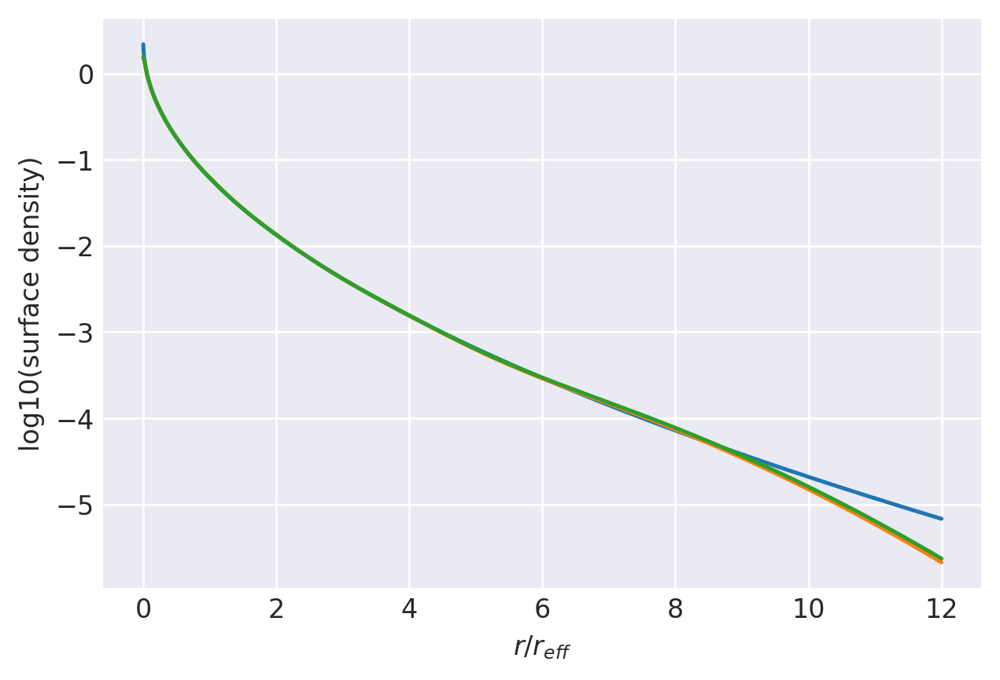

n=1.9786: (
    normalize(np.array([9.0460086982e-02, 2.4485947695e-01, 2.8732483816e-01, 2.1096227802e-01, 1.1011372944e-01, 4.2487339759e-02, 1.1779465326e-02, 2.0127853603e-03])),
    np.array([3.9858126691e+00, 2.0581446707e+00, 1.1350387025e+00, 6.3078702363e-01, 3.4256092258e-01, 1.7633461586e-01, 8.1984004033e-02, 3.0472230569e-02]),
),
[0, 24000]
0.998691724858366 0.9998311098668362
prev.  chisq = -8.248704078226776
ws, re: (array([0.09046009, 0.24485948, 0.28732484, 0.21096228, 0.11011373,
       0.04248734, 0.01177947, 0.00201279]), array([3.98581267, 2.05814467, 1.1350387 , 0.63078702, 0.34256092,
       0.17633462, 0.081984  , 0.03047223]))
         Current function value: -8.725390
         Iterations: 21
         Function evaluations: 1134
         Gradient evaluations: 66
-8.725390093075605 [-2.29742193 -0.99800214 -0.27571729  0.23270523  0.6660543   1.1198949
  1.76168947  0.60359596  0.31470931  0.05487189 -0.20143359 -0.46765355
 -0.75707793 -1.09070948 -1.52163339]


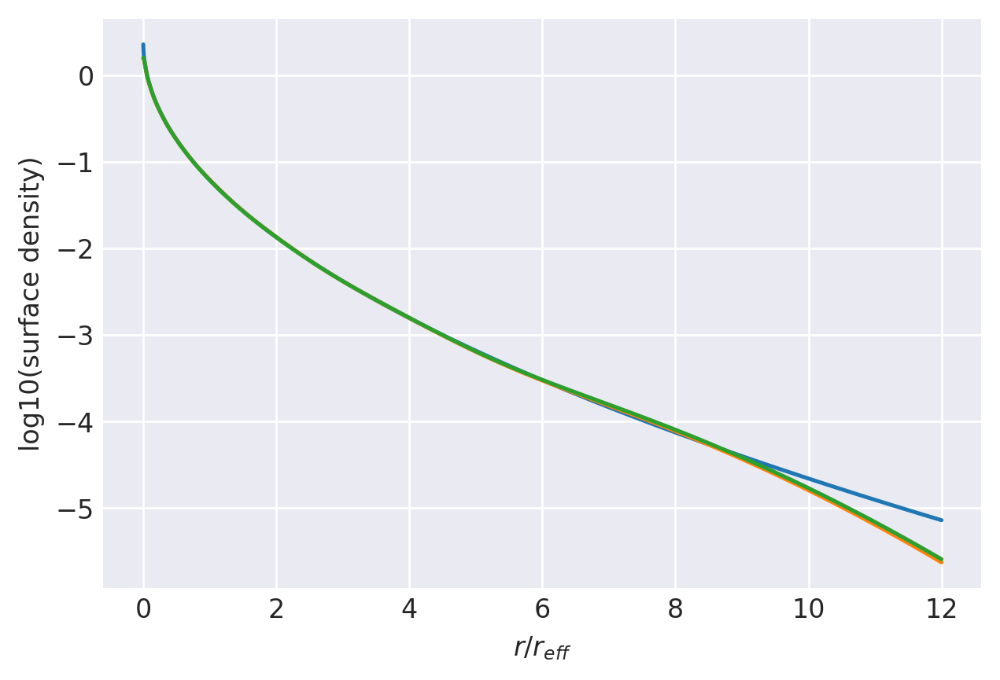

n=2.0: (
    normalize(np.array([9.1336700722e-02, 2.4473428959e-01, 2.8648805781e-01, 2.1058004155e-01, 1.1023150253e-01, 4.2696830476e-02, 1.1890355861e-02, 2.0422214609e-03])),
    np.array([4.0141718737e+00, 2.0639981833e+00, 1.1346760659e+00, 6.2887801648e-01, 3.4067984903e-01, 1.7495327288e-01, 8.1150372160e-02, 3.0086149755e-02]),
),
[0, 24000]
0.9985507315142692 0.9997607024887989
prev.  chisq = -8.058256274526654
ws, re: (array([0.08678677, 0.24176453, 0.28779187, 0.21343444, 0.11231135,
       0.04364064, 0.01217648, 0.00209393]), array([4.11550632, 2.1020886 , 1.15266425, 0.63789998, 0.34521695,
       0.1771442 , 0.08210875, 0.03041533]))
         Current function value: -8.691727
         Iterations: 21
         Function evaluations: 1847
         Gradient evaluations: 108
-8.69172659230308 [-2.28270862 -0.99698212 -0.27984629  0.22653794  0.65917781  1.11287511
  1.75468363  0.60772687  0.31632618  0.05461734 -0.20329864 -0.47099188
 -0.7618231  -1.09685761 -1.52928452]
0

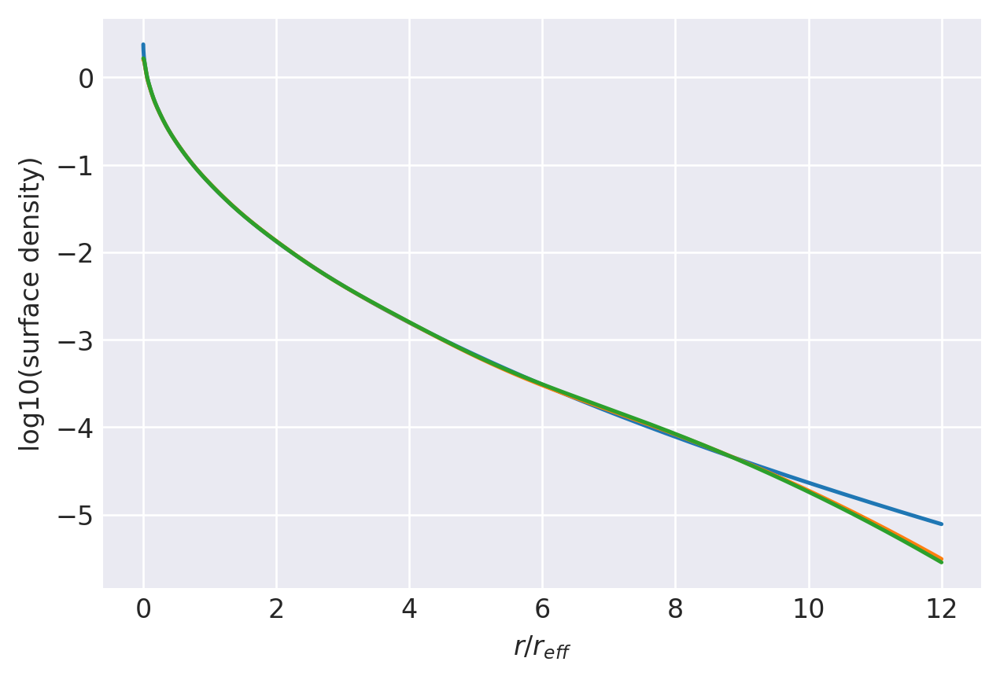

n=2.0296: (
    normalize(np.array([9.2565186299e-02, 2.4458561094e-01, 2.8535092134e-01, 2.1003759678e-01, 1.1036926302e-01, 4.2970699542e-02, 1.2038516715e-02, 2.0822053624e-03])),
    np.array([4.0525359146e+00, 2.0716967508e+00, 1.1340111904e+00, 6.2618313219e-01, 3.3807115880e-01, 1.7305210934e-01, 8.0009653611e-02, 2.9560752172e-02]),
),
[0, 24000]
0.9984195040579779 0.9997877998419525
prev.  chisq = -8.126150752648142
ws, re: (array([0.09256519, 0.24458561, 0.28535092, 0.2100376 , 0.11036926,
       0.0429707 , 0.01203852, 0.00208221]), array([4.05253591, 2.07169675, 1.13401119, 0.62618313, 0.33807116,
       0.17305211, 0.08000965, 0.02956075]))
         Current function value: -8.662867
         Iterations: 19
         Function evaluations: 1541
         Gradient evaluations: 90
-8.662866887688331 [-2.26959288 -0.99582936 -0.28321671  0.22136405  0.65333221  1.10686495
  1.74869257  0.61121461  0.31763738  0.05430853 -0.2050049  -0.47397801
 -0.76602996 -1.102286   -1.53602518

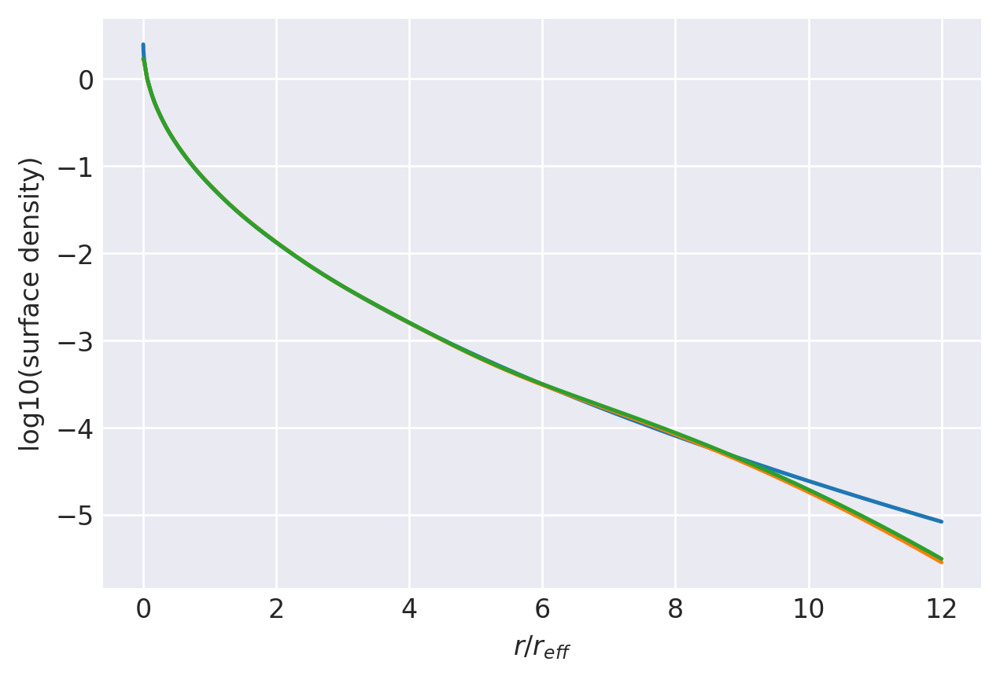

n=2.0556: (
    normalize(np.array([9.3672769936e-02, 2.4449283515e-01, 2.8436729697e-01, 2.0953807474e-01, 1.1045715793e-01, 4.3192645809e-02, 1.2162865231e-02, 2.1163542279e-03])),
    np.array([4.0852121366e+00, 2.0779609612e+00, 1.1332051178e+00, 6.2372779784e-01, 3.3575461389e-01, 1.7138390671e-01, 7.9015809792e-02, 2.9105483440e-02]),
),
[0, 24000]
0.9982796755448703 0.9997634169101333
prev.  chisq = -8.117157694299388
ws, re: (array([0.09367277, 0.24449284, 0.2843673 , 0.20953807, 0.11045716,
       0.04319265, 0.01216287, 0.00211635]), array([4.08521214, 2.07796096, 1.13320512, 0.6237278 , 0.33575461,
       0.17138391, 0.07901581, 0.02910548]))
         Current function value: -8.634319
         Iterations: 22
         Function evaluations: 1388
         Gradient evaluations: 81
-8.634319439213307 [-2.25636059 -0.99455411 -0.28646225  0.21628452  0.6475706   1.10092721
  1.74273358  0.61463721  0.31889298  0.0539473  -0.20676152 -0.47701423
 -0.77029043 -1.10777071 -1.54282465

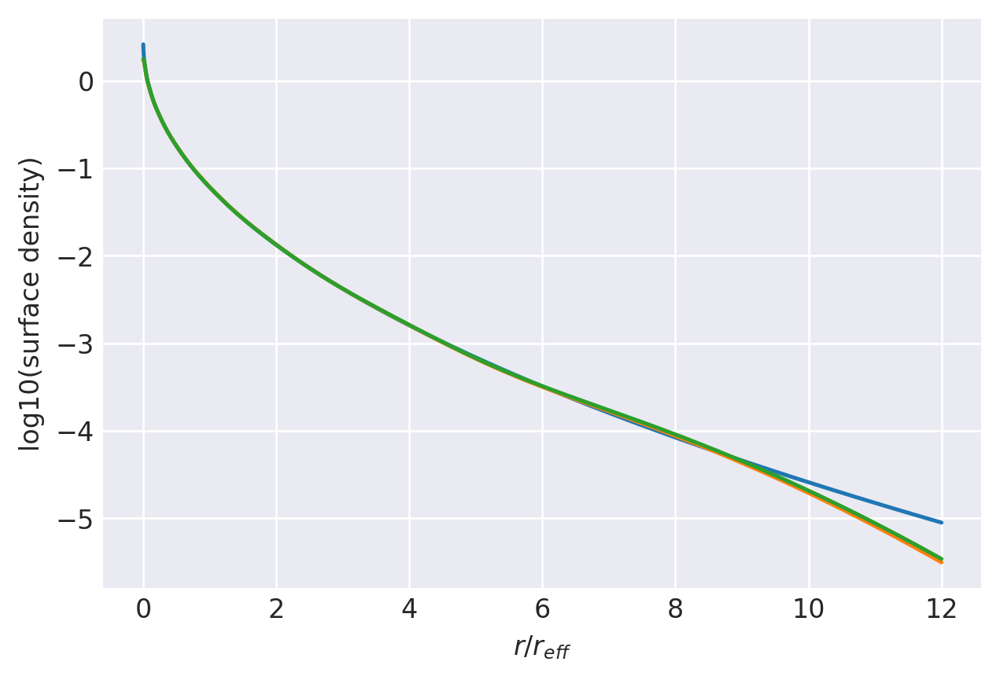

n=2.0819: (
    normalize(np.array([9.4802223896e-02, 2.4441561425e-01, 2.8338976962e-01, 2.0902305143e-01, 1.1052820782e-01, 4.3405940983e-02, 1.2284838446e-02, 2.1503535515e-03])),
    np.array([4.1175341978e+00, 2.0839773010e+00, 1.1322629697e+00, 6.2121005630e-01, 3.3341548458e-01, 1.6971083575e-01, 7.8024192925e-02, 2.8653346648e-02]),
),
[0, 24000]
0.9981792778675241 0.9997370807899807
prev.  chisq = -8.3098759701633
ws, re: (array([0.09480222, 0.24441561, 0.28338977, 0.20902305, 0.11052821,
       0.04340594, 0.01228484, 0.00215035]), array([4.1175342 , 2.0839773 , 1.13226297, 0.62121006, 0.33341548,
       0.16971084, 0.07802419, 0.02865335]))
Optimization terminated successfully.
         Current function value: -8.615035
         Iterations: 23
         Function evaluations: 629
         Gradient evaluations: 37
-8.615035435237951 [-2.24723248 -0.99359656 -0.28858981  0.2129026   0.64370868  1.09692558
  1.7387003   0.61692698  0.31971026  0.05366524 -0.20799537 -0.47912212
 

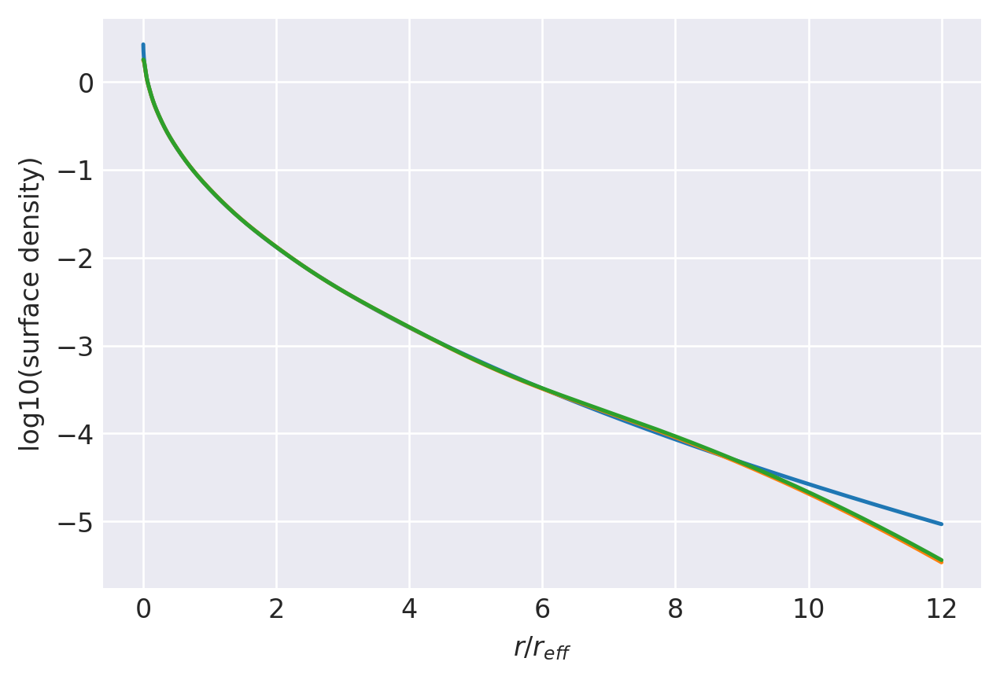

n=2.1: (
    normalize(np.array([9.5588452830e-02, 2.4437405817e-01, 2.8272649151e-01, 2.0866260615e-01, 1.1056442345e-01, 4.3544598673e-02, 1.2366051990e-02, 2.1733172275e-03])),
    np.array([4.1393007416e+00, 2.0879027160e+00, 1.1315278259e+00, 6.1944768322e-01, 3.3180114551e-01, 1.6856406909e-01, 7.7347766185e-02, 2.8346291183e-02]),
),
[0, 24000]
0.9979718495810719 0.9997180075255204
prev.  chisq = -7.9205110878062435
ws, re: (array([0.09558845, 0.24437406, 0.28272649, 0.20866261, 0.11056442,
       0.0435446 , 0.01236605, 0.00217332]), array([4.13930074, 2.08790272, 1.13152783, 0.61944768, 0.33180115,
       0.16856407, 0.07734777, 0.02834629]))
         Current function value: -8.577933
         Iterations: 21
         Function evaluations: 1712
         Gradient evaluations: 100
-8.577933057738834 [-2.22928235 -0.99154088 -0.29255177  0.20647403  0.63631558  1.08923479
  1.7309375   0.62128332  0.32121373  0.05303633 -0.21047269 -0.48329967
 -0.77904169 -1.11899113 -1.5566953 ]

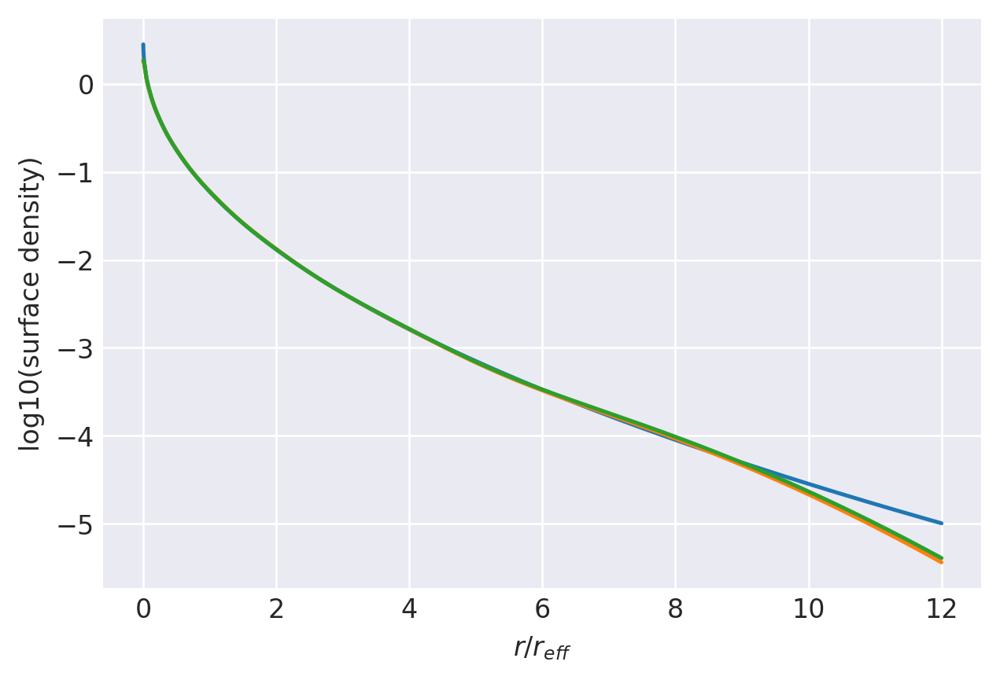

n=2.1356: (
    normalize(np.array([9.7151570386e-02, 2.4431785694e-01, 2.8144231305e-01, 2.0794000573e-01, 1.1060944604e-01, 4.3800937091e-02, 1.2520297208e-02, 2.2175735505e-03])),
    np.array([4.1810303432e+00, 2.0951433003e+00, 1.1298904291e+00, 6.1592426343e-01, 3.2862479625e-01, 1.6632529879e-01, 7.6034181460e-02, 2.7752665329e-02]),
),
[0, 24000]
0.997803803836596 0.9996782285165879
prev.  chisq = -8.086553574295488
ws, re: (array([0.09715157, 0.24431786, 0.28144231, 0.20794001, 0.11060945,
       0.04380094, 0.0125203 , 0.00221757]), array([4.18103034, 2.0951433 , 1.12989043, 0.61592426, 0.3286248 ,
       0.1663253 , 0.07603418, 0.02775267]))
         Current function value: -8.550192
         Iterations: 22
         Function evaluations: 1610
         Gradient evaluations: 94
-8.550191895687147 [-2.21552054 -0.9898182  -0.29539033  0.20174489  0.63082714  1.08349204
  1.72511677  0.62449419  0.32227457  0.05248785 -0.21241922 -0.48653374
 -0.78351087 -1.12469833 -1.56373319]

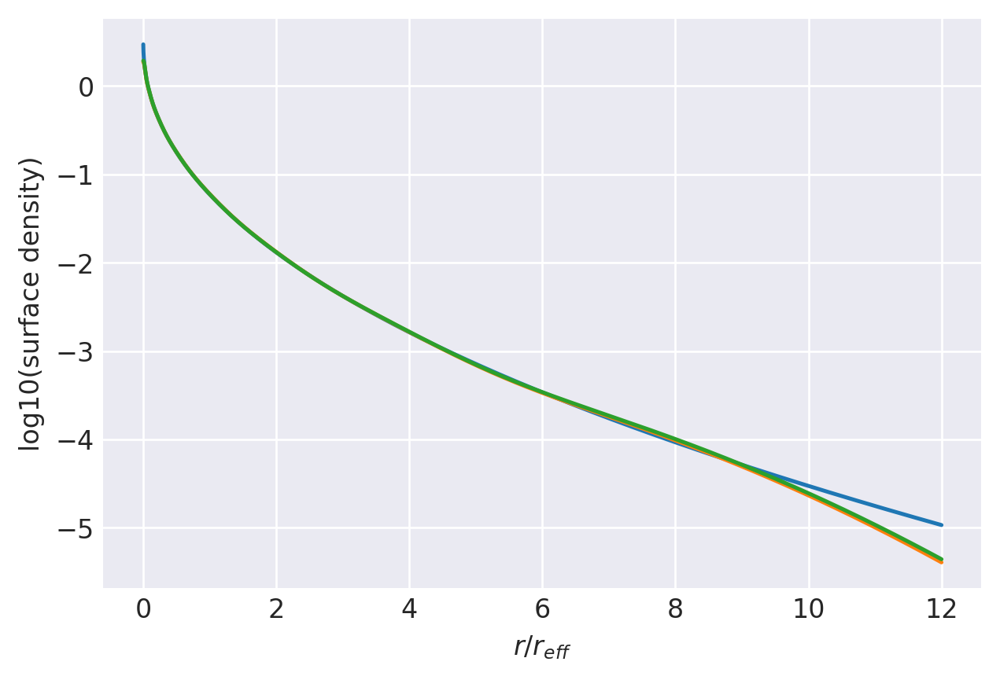

n=2.1629: (
    normalize(np.array([9.8365371503e-02, 2.4429608804e-01, 2.8047632480e-01, 2.0737440673e-01, 1.1062079312e-01, 4.3982741083e-02, 1.2633574947e-02, 2.2506997765e-03])),
    np.array([4.2120565571e+00, 2.1002672983e+00, 1.1284643591e+00, 6.1316982725e-01, 3.2618671166e-01, 1.6462247601e-01, 7.5041527574e-02, 2.7306548438e-02]),
),
[0, 24000]
0.9975629151475797 0.9996457193429311
prev.  chisq = -7.894304691747281
ws, re: (array([0.09836537, 0.24429609, 0.28047632, 0.20737441, 0.11062079,
       0.04398274, 0.01263357, 0.0022507 ]), array([4.21205656, 2.1002673 , 1.12846436, 0.61316983, 0.32618671,
       0.16462248, 0.07504153, 0.02730655]))
Optimization terminated successfully.
         Current function value: -8.513431
         Iterations: 23
         Function evaluations: 595
         Gradient evaluations: 35
-8.51343097126577 [-2.19686375 -0.9872998  -0.29899448  0.19558278  0.6236151   1.07590568
  1.71739727  0.62868608  0.32359527  0.05165644 -0.21512434 -0.49096758


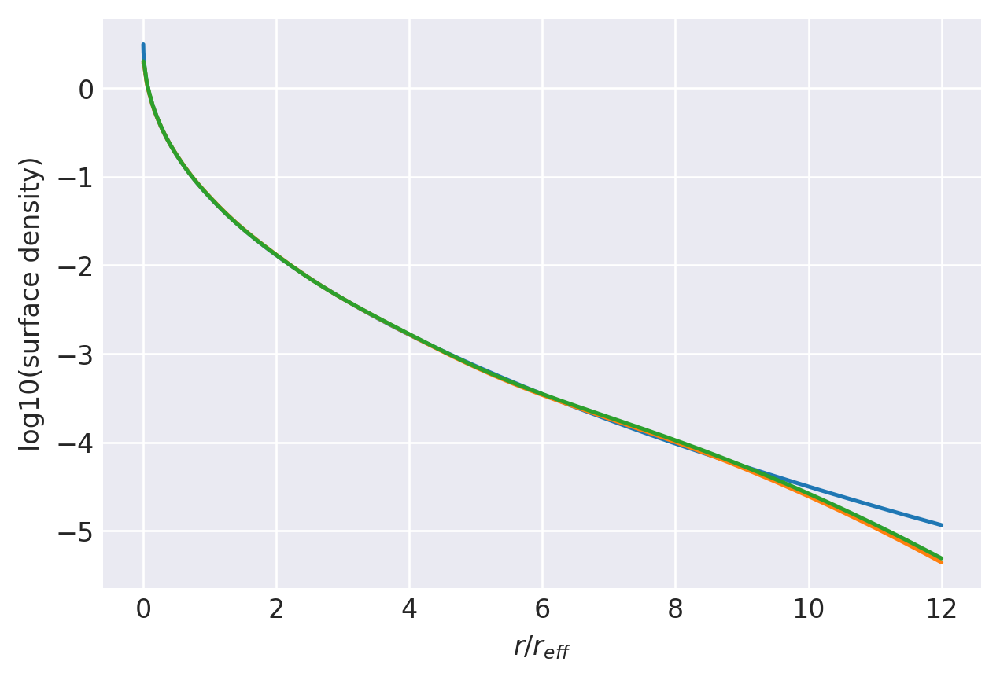

n=2.2: (
    normalize(np.array([1.0003247911e-01, 2.4429235562e-01, 2.7918865556e-01, 2.0659336650e-01, 1.1060728293e-01, 4.4210556221e-02, 1.2780741545e-02, 2.2945625138e-03])),
    np.array([4.2529089442e+00, 2.1066639971e+00, 1.1263061006e+00, 6.0936241079e-01, 3.2287351670e-01, 1.6232853922e-01, 7.3712510692e-02, 2.6712554345e-02]),
),
[0, 24000]
0.9974360294229346 0.9995987887420399
prev.  chisq = -8.251157372311479
ws, re: (array([0.10003248, 0.24429236, 0.27918866, 0.20659337, 0.11060728,
       0.04421056, 0.01278074, 0.00229456]), array([4.25290894, 2.106664  , 1.1263061 , 0.60936241, 0.32287352,
       0.16232854, 0.07371251, 0.02671255]))
         Current function value: -8.495295
         Iterations: 21
         Function evaluations: 1167
         Gradient evaluations: 68
-8.495294551489232 [-2.18748776 -0.98596012 -0.30070608  0.19258653  0.62008182  1.0721717
  1.71358497  0.63072656  0.32421005  0.05120122 -0.21651286 -0.49321829
 -0.79268482 -1.13637101 -1.57809191]
0.

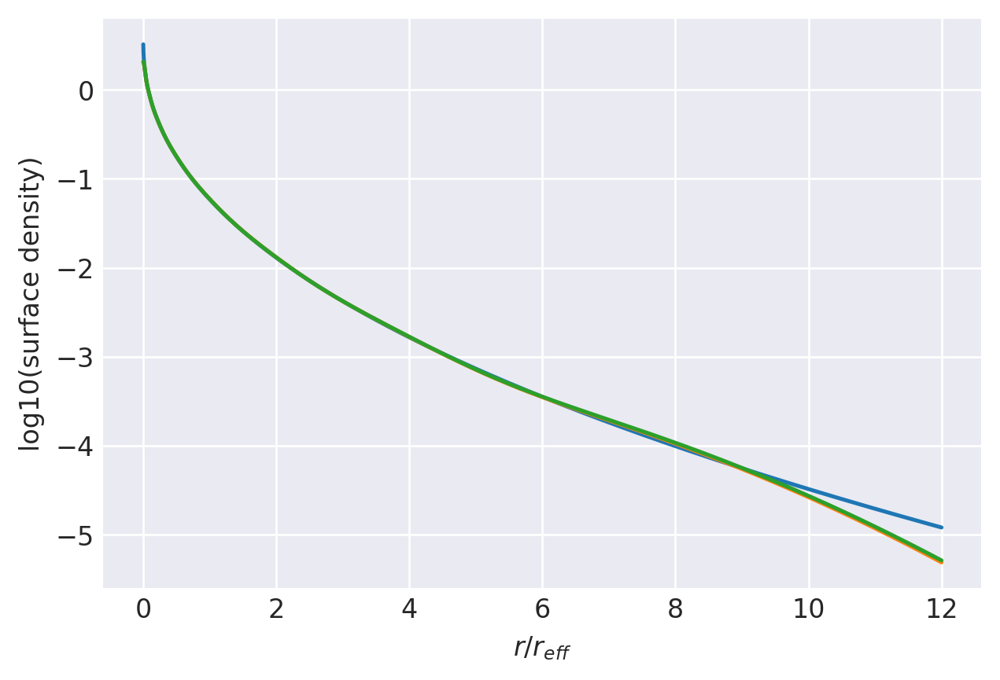

n=2.2187: (
    normalize(np.array([1.0087973267e-01, 2.4430065817e-01, 2.7855036370e-01, 2.0619493395e-01, 1.1058863682e-01, 4.4317404281e-02, 1.2852086038e-02, 2.3161843783e-03])),
    np.array([4.2729377144e+00, 2.1096482477e+00, 1.1251261564e+00, 6.0741728183e-01, 3.2120456395e-01, 1.6118149588e-01, 7.3051475112e-02, 2.6418496036e-02]),
),
[0, 24000]
0.9972363279198734 0.9995739541063279
prev.  chisq = -8.052061984399064
ws, re: (array([0.10087973, 0.24430066, 0.27855036, 0.20619493, 0.11058864,
       0.0443174 , 0.01285209, 0.00231618]), array([4.27293771, 2.10964825, 1.12512616, 0.60741728, 0.32120456,
       0.1611815 , 0.07305148, 0.0264185 ]))
         Current function value: -8.468233
         Iterations: 23
         Function evaluations: 1541
         Gradient evaluations: 90
-8.46823271358636 [-2.17329812 -0.98384566 -0.30317977  0.18816972  0.61484167  1.06661239
  1.70789565  0.6337364   0.32508147  0.05046595 -0.21865164 -0.49665525
 -0.79737092 -1.14231238 -1.58538354]

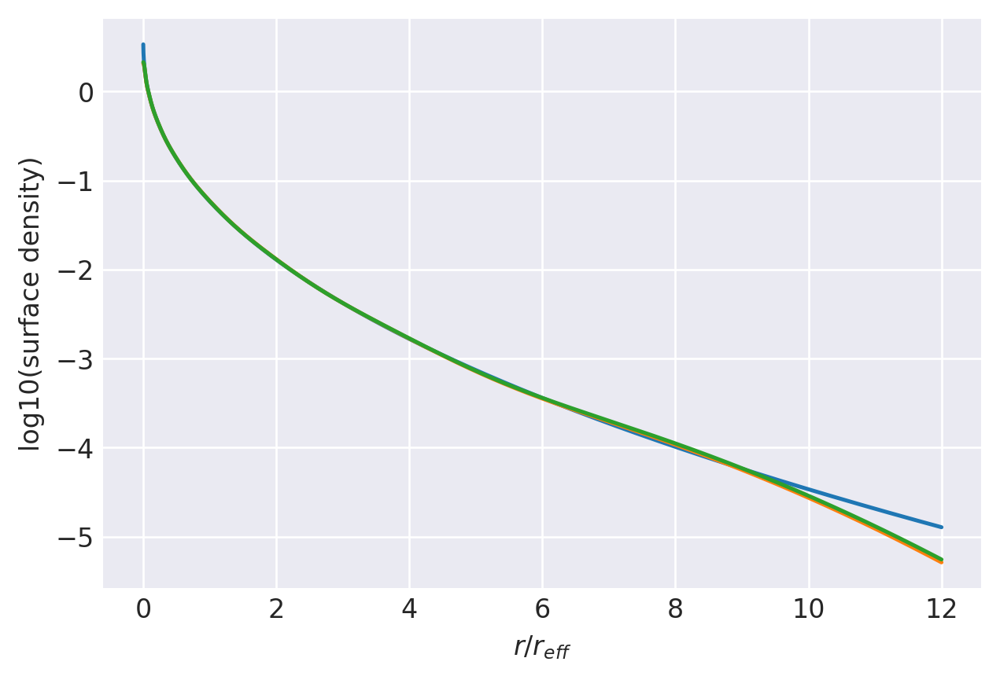

n=2.2471: (
    normalize(np.array([1.0217408449e-01, 2.4432481651e-01, 2.7759442395e-01, 2.0558490668e-01, 1.1054640012e-01, 4.4470013873e-02, 1.2956948890e-02, 2.3484054917e-03])),
    np.array([4.3026537669e+00, 2.1138855725e+00, 1.1232229030e+00, 6.0443327078e-01, 3.1867262224e-01, 1.5945167163e-01, 7.2058898644e-02, 2.5978642814e-02]),
),
[0, 24000]
0.9970252188192734 0.9995347546195666
prev.  chisq = -8.039578014572323
ws, re: (array([0.10217408, 0.24432482, 0.27759442, 0.20558491, 0.1105464 ,
       0.04447001, 0.01295695, 0.00234841]), array([4.30265377, 2.11388557, 1.1232229 , 0.60443327, 0.31867262,
       0.15945167, 0.0720589 , 0.02597864]))
Optimization terminated successfully.
         Current function value: -8.441362
         Iterations: 21
         Function evaluations: 629
         Gradient evaluations: 37
-8.441361503538797 [-2.15897728 -0.98160898 -0.30553936  0.1838505   0.60967753  1.06110792
  1.7022377   0.63668221  0.3258904   0.04966752 -0.22085685 -0.50016314

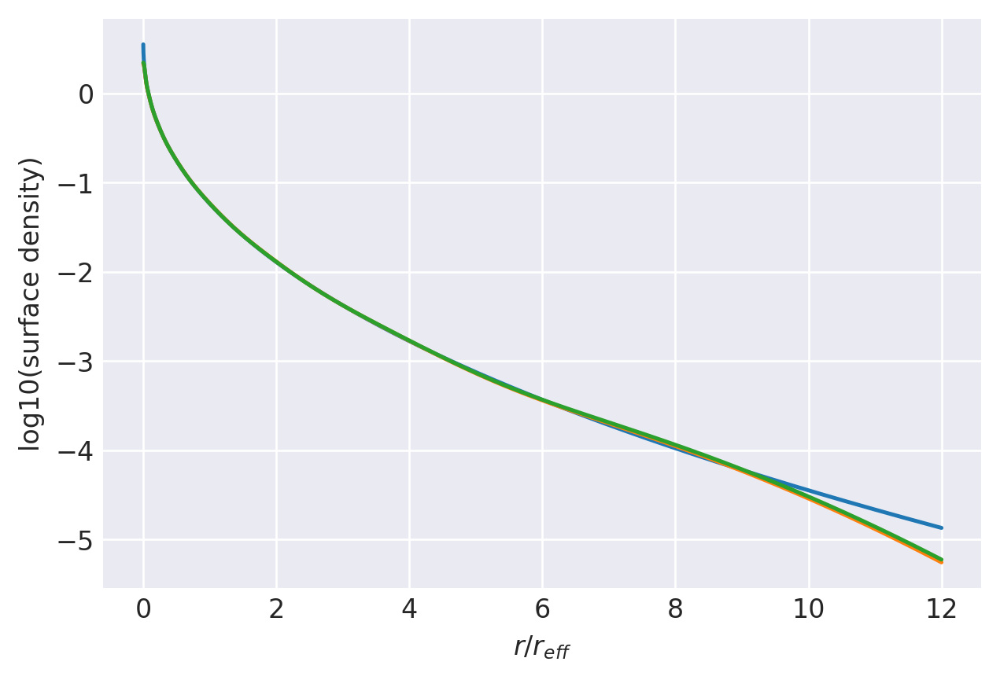

n=2.2759: (
    normalize(np.array([1.0349530500e-01, 2.4436265475e-01, 2.7664119865e-01, 2.0496097482e-01, 1.1048719266e-01, 4.4613264574e-02, 1.3059065845e-02, 2.3803437048e-03])),
    np.array([4.3319377437e+00, 2.1178266231e+00, 1.1211598141e+00, 6.0137193022e-01, 3.1610899875e-01, 1.5771261679e-01, 7.1066227928e-02, 2.5540837423e-02]),
),
[0, 24000]
0.9968419373495957 0.9994932203685327
prev.  chisq = -8.119444563295106
ws, re: (array([0.10349531, 0.24436265, 0.2766412 , 0.20496097, 0.11048719,
       0.04461326, 0.01305907, 0.00238034]), array([4.33193774, 2.11782662, 1.12115981, 0.60137193, 0.316109  ,
       0.15771262, 0.07106623, 0.02554084]))
         Current function value: -8.419301
         Iterations: 21
         Function evaluations: 1304
         Gradient evaluations: 76
-8.41930060920364 [-2.14705819 -0.97967577 -0.3074067   0.18035217  0.6054664   1.05660061
  1.69759309  0.63906807  0.32651236  0.04896095 -0.22272803 -0.50311405
 -0.80612534 -1.15337591 -1.59893108]

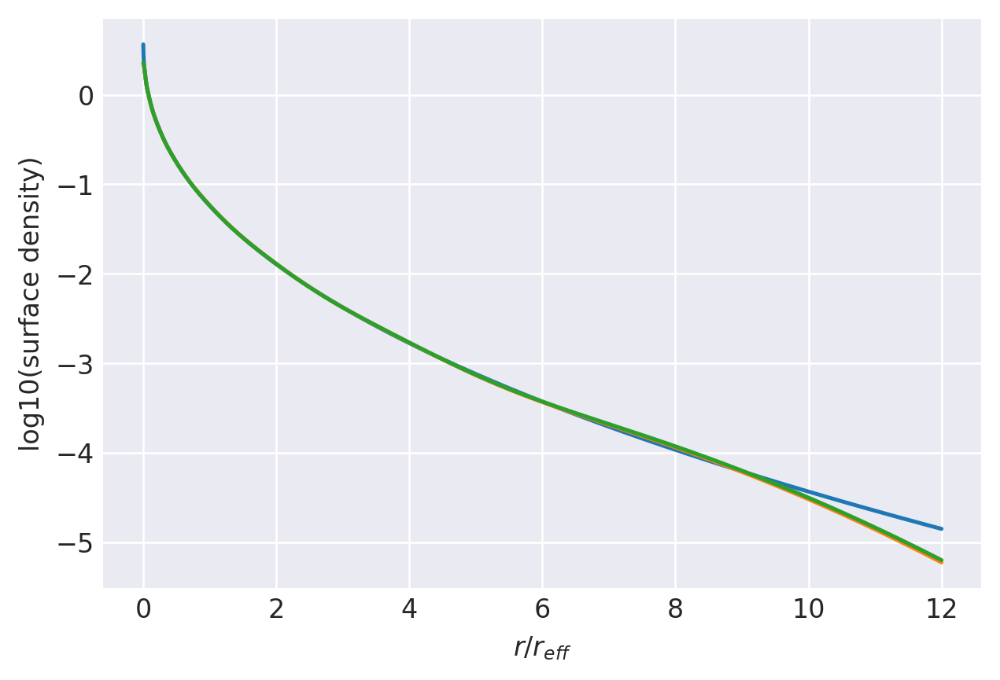

n=2.3: (
    normalize(np.array([1.0460644397e-01, 2.4440315342e-01, 2.7585578930e-01, 2.0443569395e-01, 1.1042614397e-01, 4.4724833236e-02, 1.3141433494e-02, 2.4065086584e-03])),
    np.array([4.3558014324e+00, 2.1208617431e+00, 1.1193372232e+00, 5.9878646050e-01, 3.1396840979e-01, 1.5626965686e-01, 7.0246403186e-02, 2.5180764735e-02]),
),
[0, 24000]
0.9965683116334005 0.9994571204575385
prev.  chisq = -7.930315476954652
ws, re: (array([0.10460644, 0.24440315, 0.27585579, 0.20443569, 0.11042614,
       0.04472483, 0.01314143, 0.00240651]), array([4.35580143, 2.12086174, 1.11933722, 0.59878646, 0.31396841,
       0.15626966, 0.0702464 , 0.02518076]))
         Current function value: -8.388277
         Iterations: 21
         Function evaluations: 1286
         Gradient evaluations: 75
-8.38827717507712 [-2.13006683 -0.9768142  -0.309927    0.17550547  0.59958962  1.05028185
  1.69106298  0.64237276  0.32732198  0.04788845 -0.22545311 -0.50737327
 -0.81186491 -1.16060596 -1.6077658 ]
0.

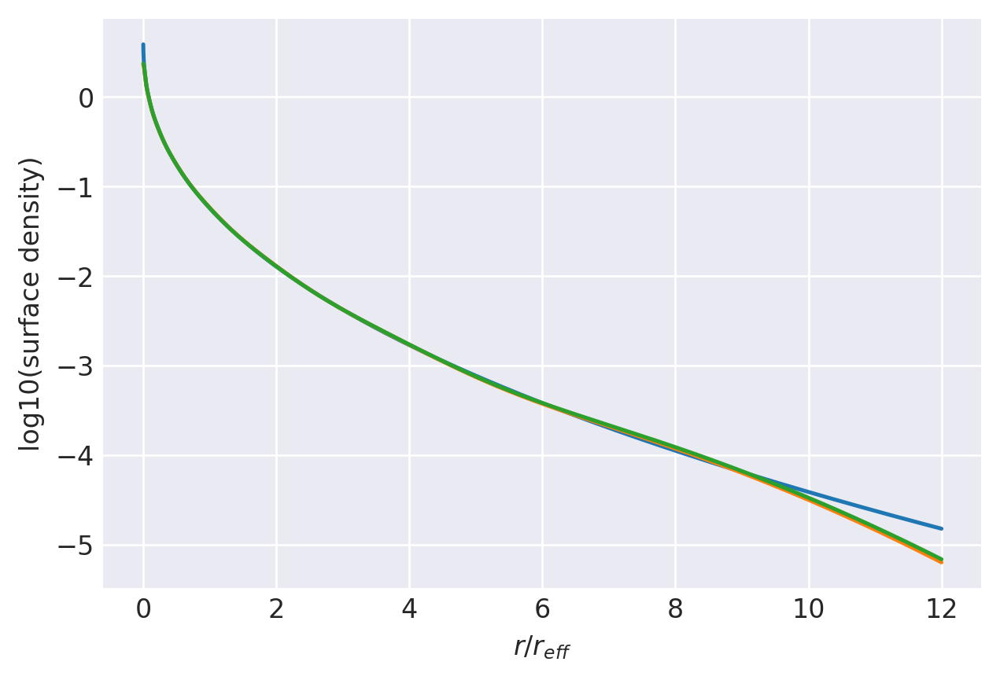

n=2.3346: (
    normalize(np.array([1.0620864747e-01, 2.4447372014e-01, 2.7474743020e-01, 2.0367782535e-01, 1.1032169514e-01, 4.4872518623e-02, 1.3254962216e-02, 2.4432008649e-03])),
    np.array([4.3890725911e+00, 2.1248191665e+00, 1.1165764102e+00, 5.9504099994e-01, 3.1090430056e-01, 1.5421800682e-01, 6.9086635255e-02, 2.4673695436e-02]),
),
[0, 24000]
0.9963219652745265 0.9994032139480992
prev.  chisq = -8.002818399170238
ws, re: (array([0.10620865, 0.24447372, 0.27474743, 0.20367783, 0.1103217 ,
       0.04487252, 0.01325496, 0.0024432 ]), array([4.38907259, 2.12481917, 1.11657641, 0.595041  , 0.3109043 ,
       0.15421801, 0.06908664, 0.0246737 ]))
         Current function value: -8.362059
         Iterations: 20
         Function evaluations: 1593
         Gradient evaluations: 93
-8.362058714263497 [-2.11549461 -0.974266   -0.31196247  0.17147897  0.59466628  1.04495998
  1.68553826  0.64511642  0.32794369  0.04690785 -0.22784374 -0.51107483
 -0.81683259 -1.16684921 -1.61538225

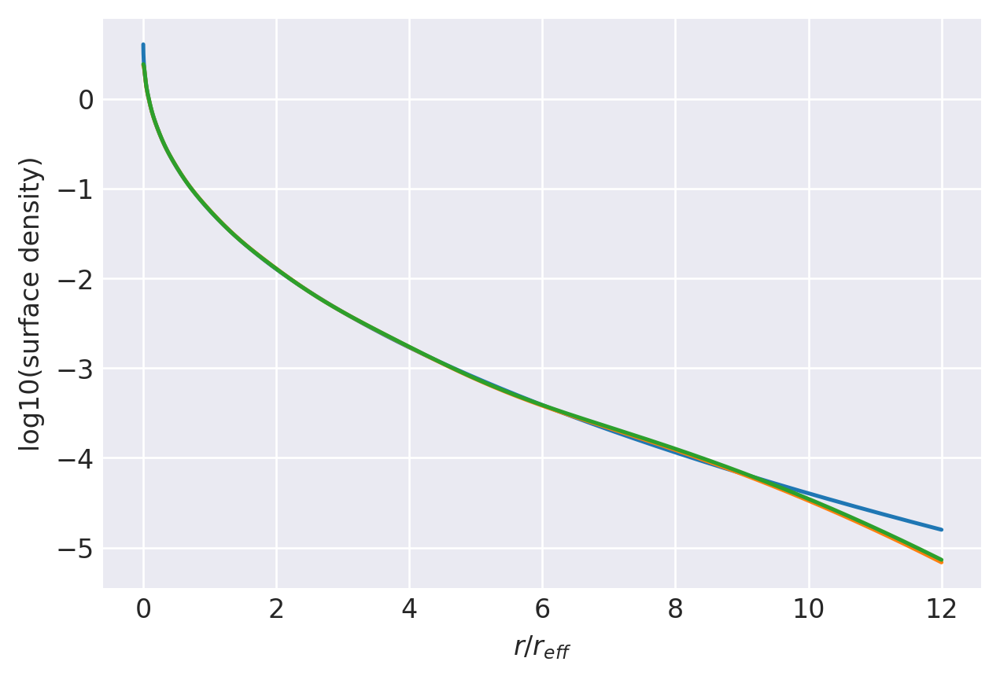

n=2.3645: (
    normalize(np.array([1.0759992325e-01, 2.4454529878e-01, 2.7380661881e-01, 2.0302024960e-01, 1.1021638635e-01, 4.4988723838e-02, 1.3348691007e-02, 2.4741083542e-03])),
    np.array([4.4168883655e+00, 2.1278631366e+00, 1.1140581221e+00, 5.9177451161e-01, 3.0826567740e-01, 1.5246403395e-01, 6.8100576249e-02, 2.4244752198e-02]),
),
[0, 24000]
0.9960176910998889 0.9993547494167796
prev.  chisq = -7.907511856984082
ws, re: (array([0.10759992, 0.2445453 , 0.27380662, 0.20302025, 0.11021639,
       0.04498872, 0.01334869, 0.00247411]), array([4.41688837, 2.12786314, 1.11405812, 0.59177451, 0.30826568,
       0.15246403, 0.06810058, 0.02424475]))
Optimization terminated successfully.
         Current function value: -8.331608
         Iterations: 22
         Function evaluations: 578
         Gradient evaluations: 34
-8.331608460731658 [-2.09836199 -0.97116203 -0.31421227  0.16688094  0.58899559  1.038804
  1.67912936  0.6482479   0.32859497  0.04568274 -0.23072269 -0.51549235
 

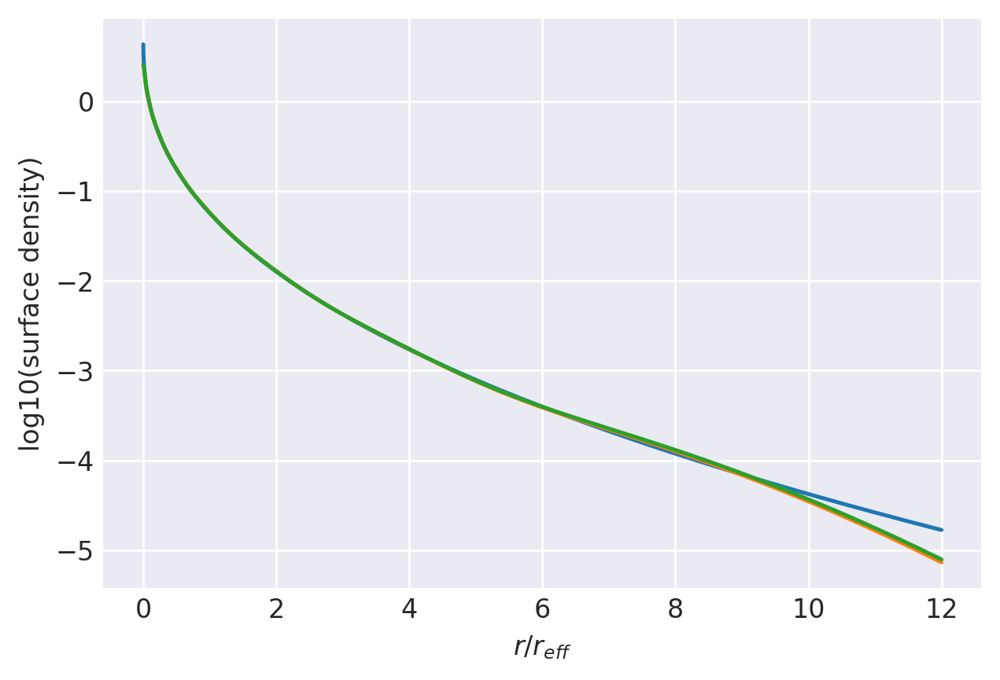

n=2.4: (
    normalize(np.array([1.0925612940e-01, 2.4464186553e-01, 2.7271119666e-01, 2.0223730420e-01, 1.1007474974e-01, 4.5113938960e-02, 1.3454974246e-02, 2.5098412598e-03])),
    np.array([4.4488513891e+00, 2.1310565450e+00, 1.1109198766e+00, 5.8786460143e-01, 3.0514597631e-01, 1.5040502925e-01, 6.6949175999e-02, 2.3746314503e-02]),
),
[0, 24000]
0.9957922103586433 0.9992950140585034
prev.  chisq = -8.05713025691435
ws, re: (array([0.10925613, 0.24464187, 0.2727112 , 0.2022373 , 0.11007475,
       0.04511394, 0.01345497, 0.00250984]), array([4.44885139, 2.13105655, 1.11091988, 0.5878646 , 0.30514598,
       0.15040503, 0.06694918, 0.02374631]))
Optimization terminated successfully.
         Current function value: -8.310255
         Iterations: 22
         Function evaluations: 646
         Gradient evaluations: 38
-8.310255193546066 [-2.08621744 -0.9688992  -0.31572311  0.16370609  0.58505166  1.03450213
  1.6746361   0.65040687  0.32900531  0.0447683  -0.2328068  -0.51866618
 -0

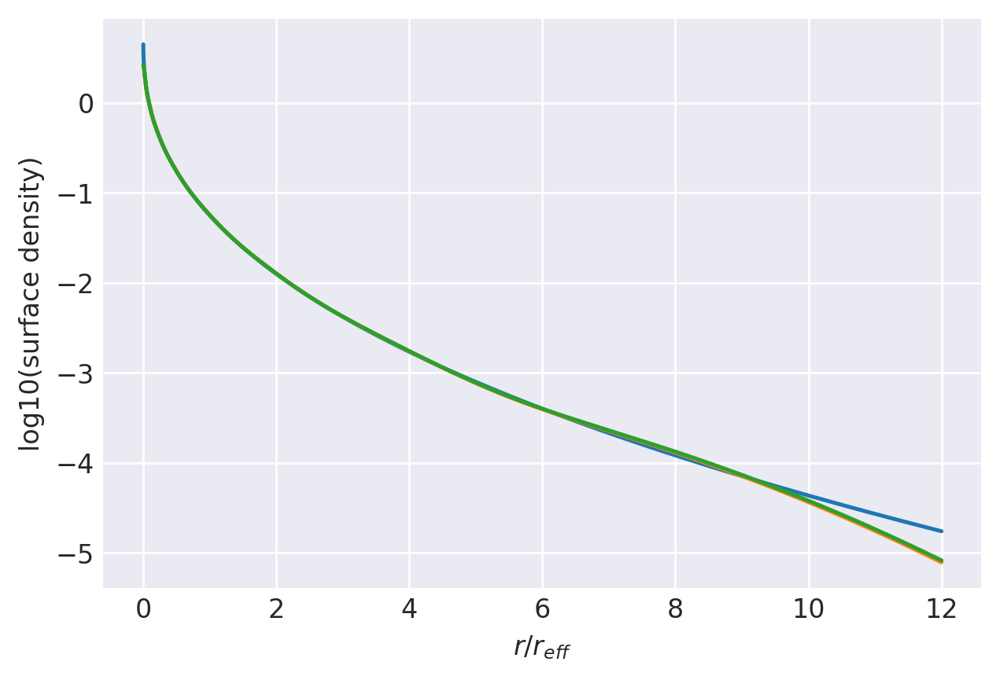

n=2.4254: (
    normalize(np.array([1.1044364813e-01, 2.4471692579e-01, 2.7194065750e-01, 2.0167684168e-01, 1.0996368075e-01, 4.5195586481e-02, 1.3527858812e-02, 2.5348008578e-03])),
    np.array([4.4710226759e+00, 2.1330709902e+00, 1.1085832111e+00, 5.8505029765e-01, 3.0292409597e-01, 1.4894780547e-01, 6.6138295302e-02, 2.3396865627e-02]),
),
[0, 24000]
0.9955074001464085 0.9992508887917313
prev.  chisq = -7.96274012601572
ws, re: (array([0.11044365, 0.24471693, 0.27194066, 0.20167684, 0.10996368,
       0.04519559, 0.01352786, 0.0025348 ]), array([4.47102268, 2.13307099, 1.10858321, 0.5850503 , 0.3029241 ,
       0.14894781, 0.0661383 , 0.02339687]))
         Current function value: -8.284583
         Iterations: 20
         Function evaluations: 1440
         Gradient evaluations: 84
-8.284582612965835 [-2.07148317 -0.9660861  -0.31746556  0.15994294  0.5803443   1.02934741
  1.66923754  0.65296134  0.329447    0.04360722 -0.23538506 -0.52256605
 -0.83214556 -1.18601894 -1.63870699]

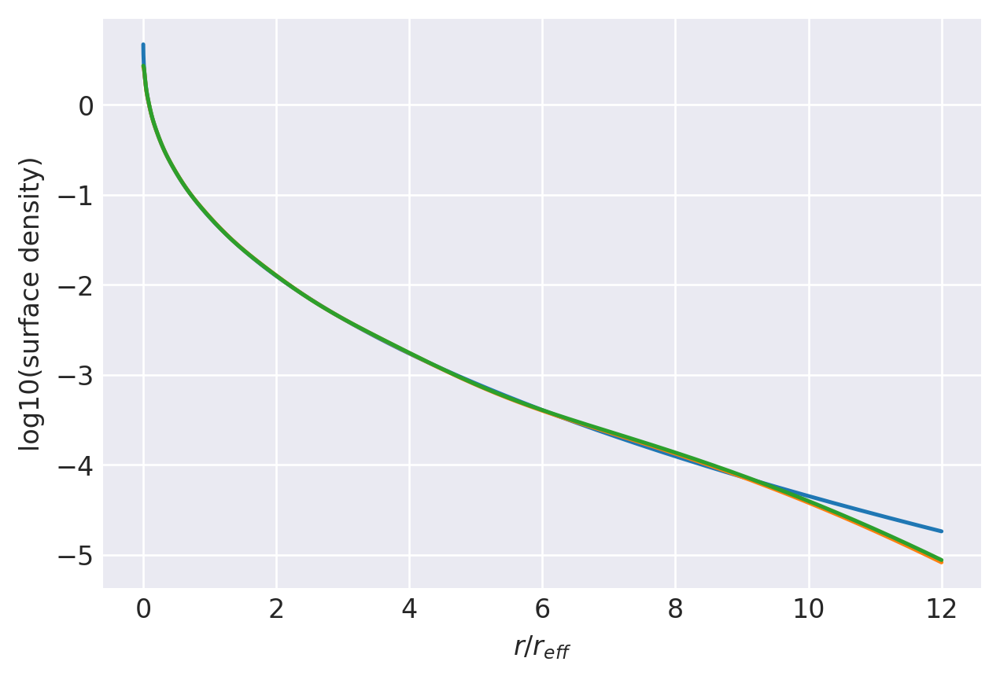

n=2.4565: (
    normalize(np.array([1.1189955951e-01, 2.4481493309e-01, 2.7101202438e-01, 2.0099071794e-01, 1.0981736694e-01, 4.5287051269e-02, 1.3613660499e-02, 2.5646863653e-03])),
    np.array([4.4973982336e+00, 2.1352414992e+00, 1.1056233903e+00, 5.8158733649e-01, 3.0021608330e-01, 1.4718191044e-01, 6.5159997375e-02, 2.2976983311e-02]),
),
[0, 24000]
0.9952092500128582 0.9991953672003178
prev.  chisq = -7.949024441617182
ws, re: (array([0.11189956, 0.24481493, 0.27101202, 0.20099072, 0.10981737,
       0.04528705, 0.01361366, 0.00256469]), array([4.49739823, 2.1352415 , 1.10562339, 0.58158734, 0.30021608,
       0.14718191, 0.06516   , 0.02297698]))
         Current function value: -8.259090
         Iterations: 20
         Function evaluations: 1235
         Gradient evaluations: 72
-8.259089859324012 [-2.05672574 -0.96319779 -0.31911705  0.15626591  0.57571173  1.02425161
  1.66388394  0.6554538   0.32983014  0.04238761 -0.23802409 -0.52653034
 -0.83739438 -1.19256551 -1.64665231

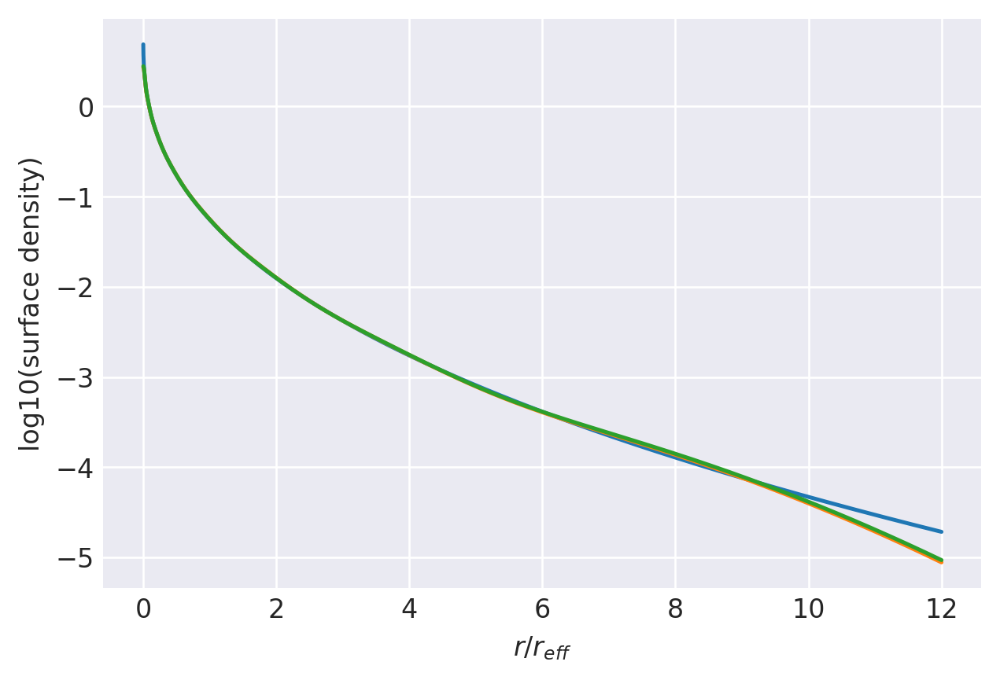

n=2.488: (
    normalize(np.array([1.1337454443e-01, 2.4491999742e-01, 2.7008801615e-01, 2.0029703500e-01, 1.0965877965e-01, 4.5370621290e-02, 1.3696804851e-02, 2.5942011953e-03])),
    np.array([4.5232833642e+00, 2.1371260436e+00, 1.1025228745e+00, 5.7806398460e-01, 2.9748814562e-01, 1.4541380014e-01, 6.4185140118e-02, 2.2560446535e-02]),
),
[0, 24000]
0.9950931358505836 0.9991375245807875
prev.  chisq = -8.19031949197714
ws, re: (array([0.11337454, 0.24492   , 0.27008802, 0.20029704, 0.10965878,
       0.04537062, 0.0136968 , 0.0025942 ]), array([4.52328336, 2.13712604, 1.10252287, 0.57806398, 0.29748815,
       0.1454138 , 0.06418514, 0.02256045]))
         Current function value: -8.249509
         Iterations: 17
         Function evaluations: 1219
         Gradient evaluations: 71
-8.249509004560384 [-2.05114413 -0.9620861  -0.31971695  0.15489979  0.57398028  1.02234038
  1.66187131  0.65637816  0.32995883  0.04191123 -0.23903701 -0.52804446
 -0.83939439 -1.19505666 -1.64967293]


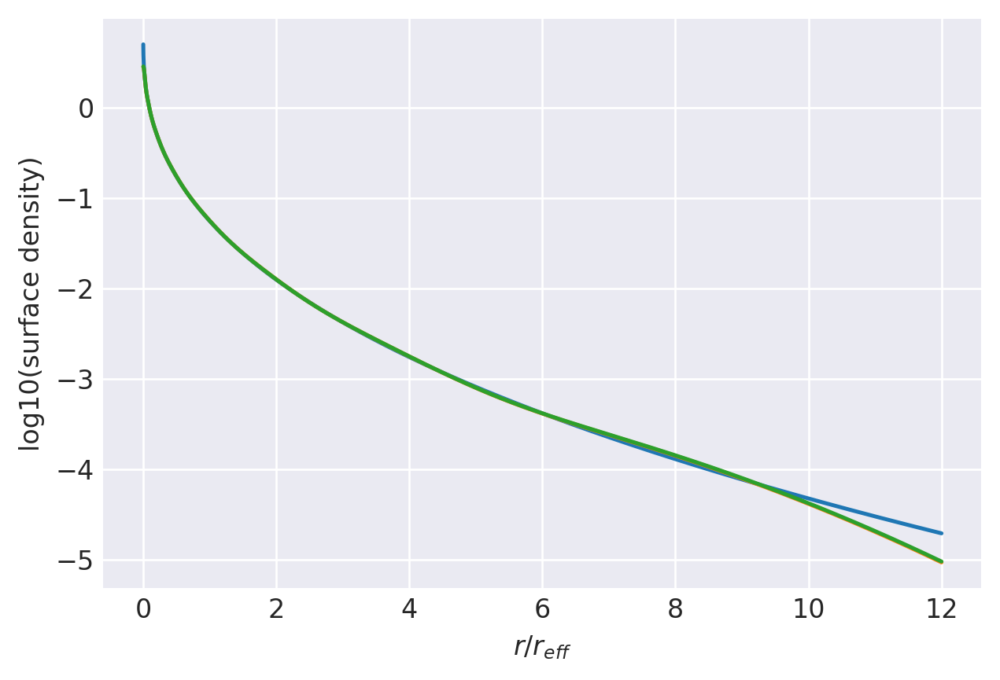

n=2.5: (
    normalize(np.array([1.1393682411e-01, 2.4496166070e-01, 2.6974008514e-01, 2.0003298105e-01, 1.0959556995e-01, 4.5400101797e-02, 1.3727520343e-02, 2.6052569129e-03])),
    np.array([4.5329210503e+00, 2.1377594258e+00, 1.1013141672e+00, 5.7671731571e-01, 2.9645278942e-01, 1.4474568021e-01, 6.3818022390e-02, 2.2404077615e-02]),
),
[0, 24000]
0.9950931358505836 0.9986510871551334
prev.  chisq = -8.102552675060563
ws, re: (array([0.10465548, 0.24008597, 0.27239209, 0.20519591, 0.11342203,
       0.04721774, 0.01431223, 0.00271855]), array([4.78946964, 2.22732986, 1.14192207, 0.59651386, 0.30620378,
       0.14938228, 0.0658251 , 0.02309402]))
         Current function value: -8.249509
         Iterations: 20
         Function evaluations: 998
         Gradient evaluations: 58
-8.249509005128534 [-2.05114909 -0.9620945  -0.31972087  0.15489902  0.57398064  1.02234179
  1.66186754  0.65637871  0.32996048  0.04191315 -0.23903522 -0.52804304
 -0.83939323 -1.19505569 -1.64967136]
0.

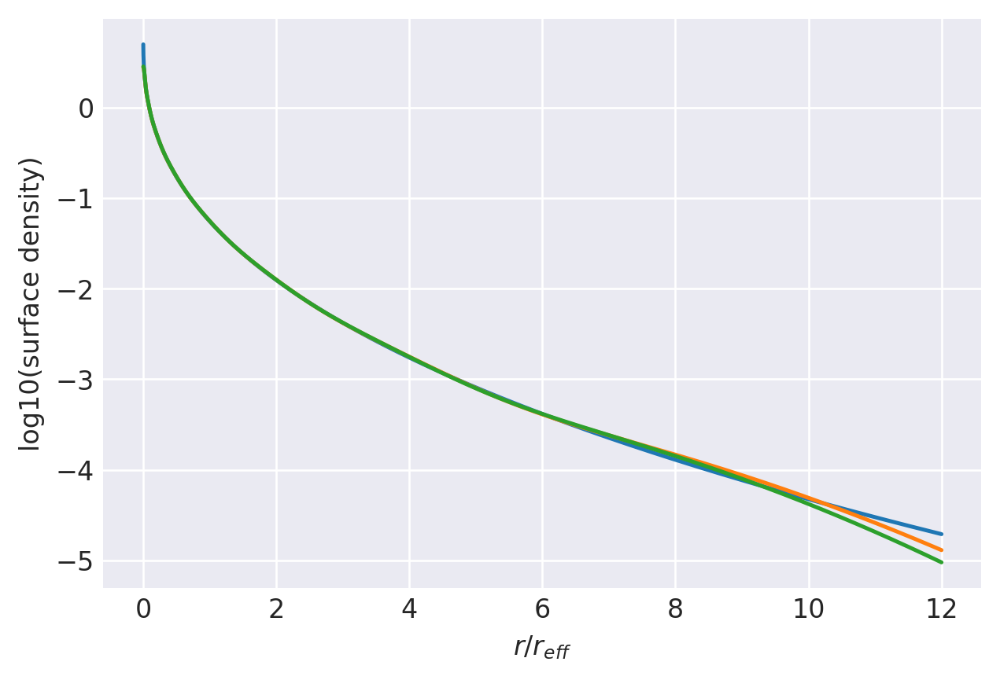

n=2.5: (
    normalize(np.array([1.1393632360e-01, 2.4496031065e-01, 2.6974025076e-01, 2.0003381734e-01, 1.0959612696e-01, 4.5400333120e-02, 1.3727562789e-02, 2.6052747770e-03])),
    np.array([4.5329268240e+00, 2.1377675357e+00, 1.1013190413e+00, 5.7671969489e-01, 2.9645375774e-01, 1.4474606762e-01, 6.3818164952e-02, 2.2404158611e-02]),
),
[2, 24000]
0.9948985225589164 0.9991150890645046
prev.  chisq = -8.095298831821044
ws, re: (array([0.11393632, 0.24496031, 0.26974025, 0.20003382, 0.10959613,
       0.04540033, 0.01372756, 0.00260527]), array([4.53292682, 2.13776754, 1.10131904, 0.57671969, 0.29645376,
       0.14474607, 0.06381816, 0.02240416]))
         Current function value: -8.235430
         Iterations: 20
         Function evaluations: 1372
         Gradient evaluations: 80
-8.23542979337055 [-2.04215898 -0.96043809 -0.32088339  0.1524511   0.57088309  1.01885667
  1.65802756  0.65788455  0.33018765  0.04116849 -0.24063769 -0.53043986
 -0.8425481  -1.19895065 -1.65427851]
0.

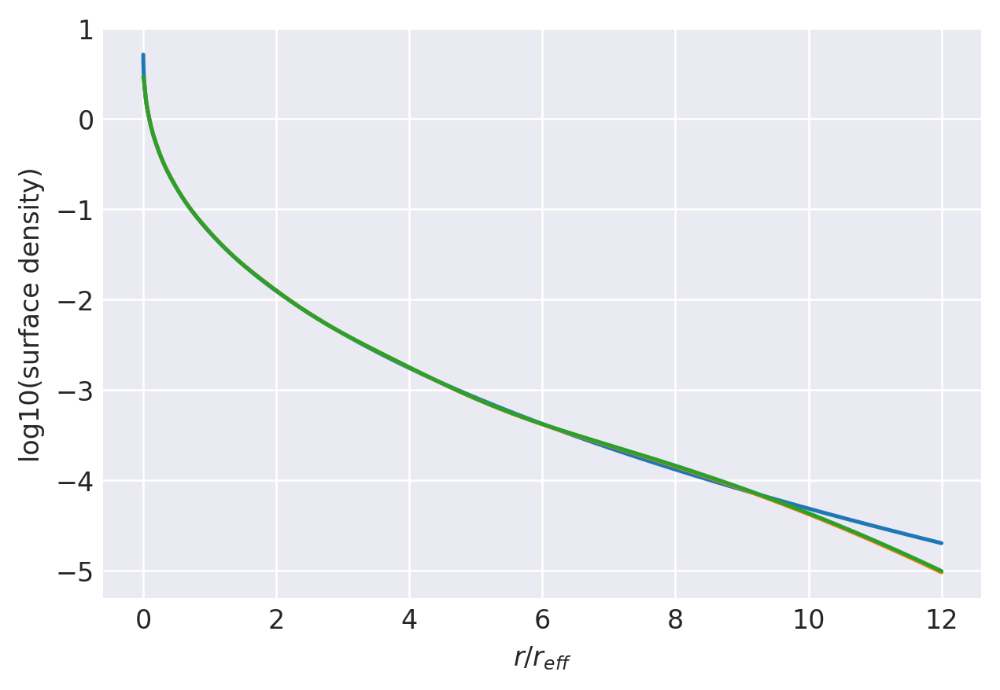

n=2.5198: (
    normalize(np.array([1.1484707355e-01, 2.4500191274e-01, 2.6915819817e-01, 1.9960865205e-01, 1.0950881068e-01, 4.5462905078e-02, 1.3786013768e-02, 2.6264339693e-03])),
    np.array([4.5486712843e+00, 2.1388860808e+00, 1.0994322855e+00, 5.7459561613e-01, 2.9482217096e-01, 1.4369839017e-01, 6.3248372364e-02, 2.2167743613e-02]),
),
[4, 24000]
0.9945730490859486 0.9990775595049063
prev.  chisq = -7.926125113429889
ws, re: (array([0.11484707, 0.24500191, 0.2691582 , 0.19960865, 0.10950881,
       0.04546291, 0.01378601, 0.00262643]), array([4.54867128, 2.13888608, 1.09943229, 0.57459562, 0.29482217,
       0.14369839, 0.06324837, 0.02216774]))
Optimization terminated successfully.
         Current function value: -8.217327
         Iterations: 23
         Function evaluations: 544
         Gradient evaluations: 32
-8.217327485207939 [-2.02858041 -0.95865378 -0.32364456  0.14754036  0.56474008  1.01171459
  1.64951974  0.66039881  0.33071923  0.04020952 -0.24289341 -0.53386587

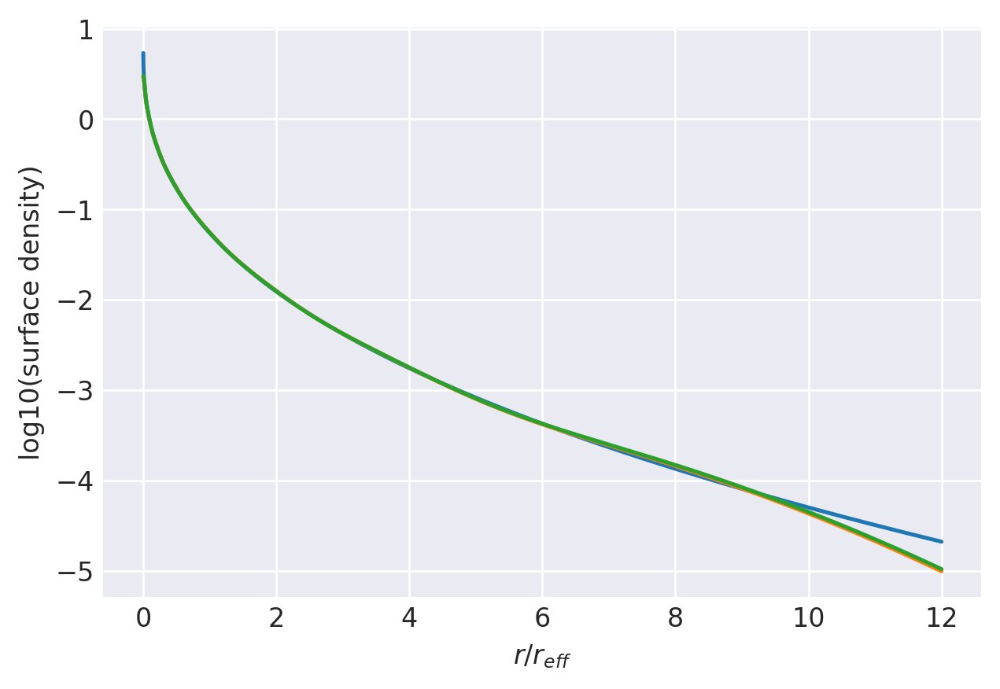

n=2.5521: (
    normalize(np.array([1.1623466931e-01, 2.4493362761e-01, 2.6817375455e-01, 1.9897597900e-01, 1.0945559811e-01, 4.5634055706e-02, 1.3918068008e-02, 2.6742477069e-03])),
    np.array([4.5750812669e+00, 2.1415056681e+00, 1.0970073050e+00, 5.7161891339e-01, 2.9250556401e-01, 1.4222095826e-01, 6.2465512771e-02, 2.1868729790e-02]),
),
[7, 24000]
0.994233592730199 0.9990130948050632
prev.  chisq = -7.923908055130107
ws, re: (array([0.11623467, 0.24493363, 0.26817375, 0.19897598, 0.1094556 ,
       0.04563406, 0.01391807, 0.00267425]), array([4.57508127, 2.14150567, 1.09700731, 0.57161891, 0.29250556,
       0.14222096, 0.06246551, 0.02186873]))
         Current function value: -8.212563
         Iterations: 20
         Function evaluations: 1627
         Gradient evaluations: 95
-8.21256346527295 [-2.01839611 -0.96021735 -0.32980346  0.13894506  0.55425419  0.9989008
  1.63255492  0.66333671  0.33196656  0.04025778 -0.24380877 -0.53552618
 -0.84915111 -1.20637456 -1.66026421]
0

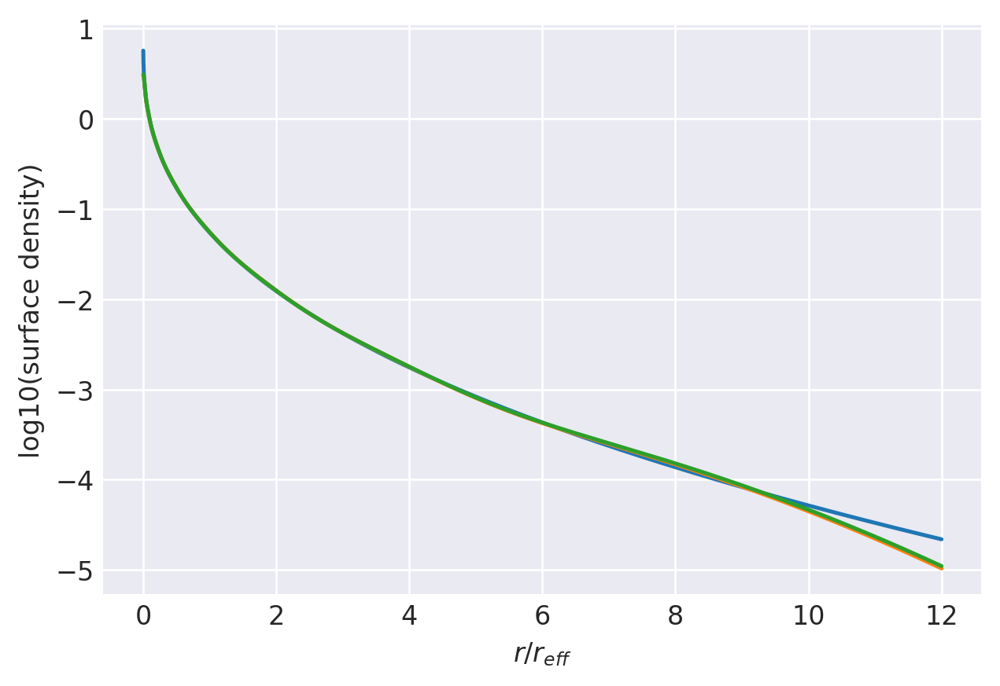

n=2.5848: (
    normalize(np.array([1.1728493851e-01, 2.4436614070e-01, 2.6701397780e-01, 1.9854554849e-01, 1.0974235121e-01, 4.6077452928e-02, 1.4195390464e-02, 2.7741998868e-03])),
    np.array([4.6061355571e+00, 2.1476651188e+00, 1.0971292049e+00, 5.7041538466e-01, 2.9138944580e-01, 1.4153012638e-01, 6.2176380706e-02, 2.1864310899e-02]),
),
[9, 24000]
0.9938799709903292 0.9989382640907457
prev.  chisq = -7.920082790377253
ws, re: (array([0.11728494, 0.24436614, 0.26701398, 0.19854555, 0.10974235,
       0.04607745, 0.01419539, 0.0027742 ]), array([4.60613556, 2.14766512, 1.0971292 , 0.57041538, 0.29138945,
       0.14153013, 0.06217638, 0.02186431]))
         Current function value: -8.206677
         Iterations: 20
         Function evaluations: 1797
         Gradient evaluations: 105
-8.206677071652605 [-2.00865142 -0.96216685 -0.33633751  0.12993997  0.54327876  0.98545999
  1.61475898  0.66630882  0.33328506  0.04041858 -0.24456622 -0.53697257
 -0.85097432 -1.20797396 -1.659683 

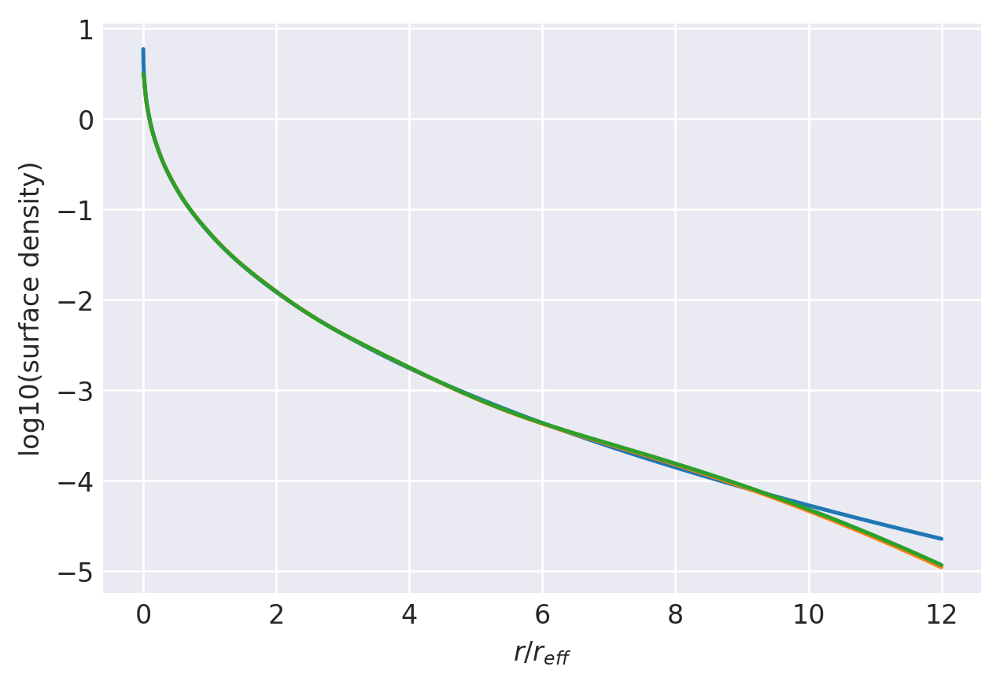

n=2.6179: (
    normalize(np.array([1.1829756677e-01, 2.4374184522e-01, 2.6583780249e-01, 1.9813281827e-01, 1.1006167074e-01, 4.6551962407e-02, 1.4493097404e-02, 2.8832366982e-03])),
    np.array([4.6377658208e+00, 2.1541952074e+00, 1.0975355006e+00, 5.6942138805e-01, 2.9042060755e-01, 1.4093721261e-01, 6.1947822376e-02, 2.1893590765e-02]),
),
[11, 24000]
0.993512017764062 0.9988583634596049
prev.  chisq = -7.918393311089895
ws, re: (array([0.11829757, 0.24374185, 0.2658378 , 0.19813282, 0.11006167,
       0.04655196, 0.0144931 , 0.00288324]), array([4.63776582, 2.15419521, 1.0975355 , 0.56942139, 0.29042061,
       0.14093721, 0.06194782, 0.02189359]))
         Current function value: -8.203978
         Iterations: 20
         Function evaluations: 1610
         Gradient evaluations: 94
-8.203978221502785 [-2.00022677 -0.96542206 -0.34419776  0.11949302  0.53061057  0.96985307
  1.59392232  0.6694346   0.33488132  0.04098254 -0.24478032 -0.53770004
 -0.85183274 -1.20820802 -1.65686037

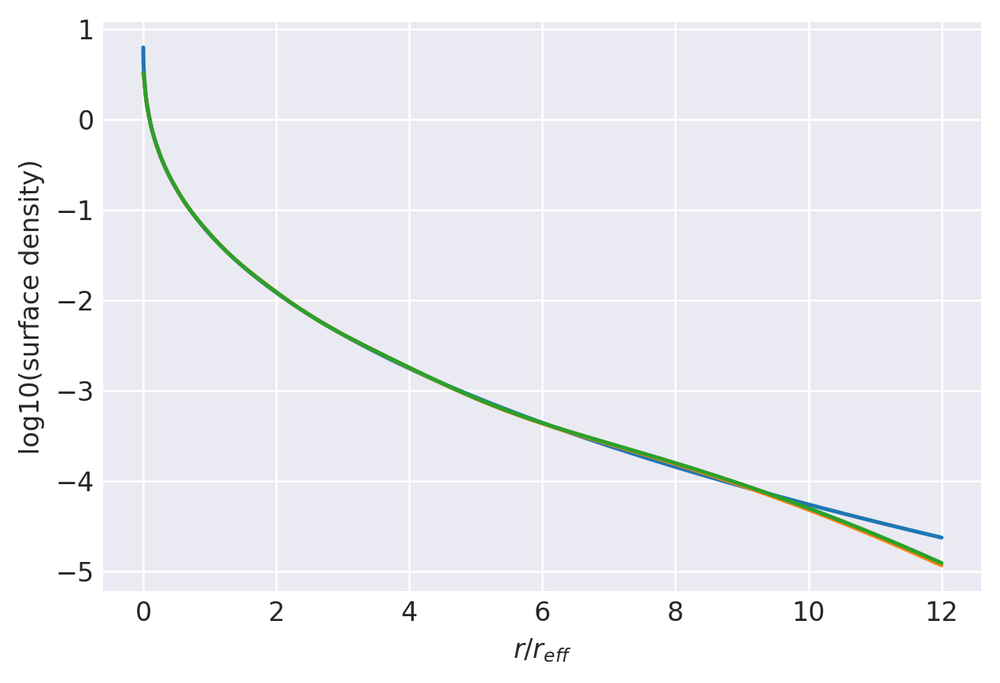

n=2.6514: (
    normalize(np.array([1.1917911455e-01, 2.4292504685e-01, 2.6459291236e-01, 1.9778998640e-01, 1.1050742372e-01, 4.7134863398e-02, 1.4853500931e-02, 3.0171517854e-03])),
    np.array([4.6712660658e+00, 2.1621275732e+00, 1.0989616491e+00, 5.6914074783e-01, 2.8993454233e-01, 1.4065891418e-01, 6.1914444941e-02, 2.2036348518e-02]),
),
[14, 24000]
0.9931284406244031 0.9987709796553988
prev.  chisq = -7.923630145528943
ws, re: (array([0.11917911, 0.24292505, 0.26459291, 0.19778999, 0.11050742,
       0.04713486, 0.0148535 , 0.00301715]), array([4.67126607, 2.16212757, 1.09896165, 0.56914075, 0.28993454,
       0.14065891, 0.06191444, 0.02203635]))
Optimization terminated successfully.
         Current function value: -8.214561
         Iterations: 21
         Function evaluations: 595
         Gradient evaluations: 35
-8.214561430939913 [-1.99633703 -0.97332589 -0.35682873  0.1038854   0.51193598  0.94662009
  1.56237663  0.67321274  0.33753688  0.04302189 -0.24304677 -0.5358836

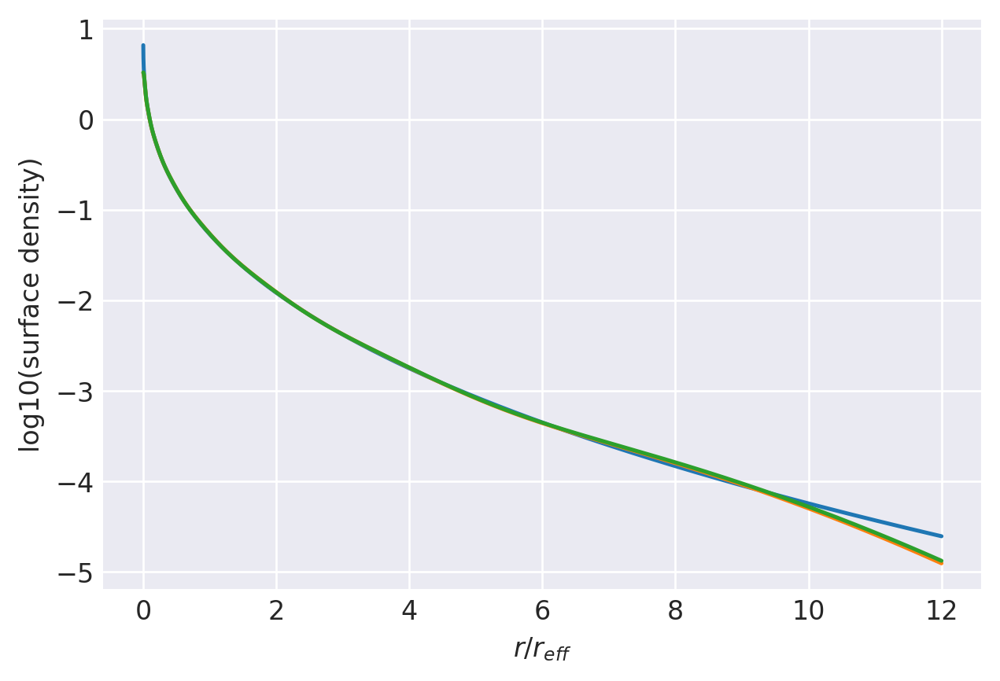

n=2.6854: (
    normalize(np.array([1.1958804712e-01, 2.4142487399e-01, 2.6308852505e-01, 1.9770309924e-01, 1.1141852633e-01, 4.8108432477e-02, 1.5433135698e-02, 3.2353600942e-03])),
    np.array([4.7120809579e+00, 2.1753887418e+00, 1.1041342828e+00, 5.7141710056e-01, 2.9114972925e-01, 1.4147879523e-01, 6.2561771253e-02, 2.2579776388e-02]),
),
[16, 24000]
0.9927301910522557 0.9986655052285798
prev.  chisq = -7.923583690581419
ws, re: (array([0.11958805, 0.24142487, 0.26308853, 0.1977031 , 0.11141853,
       0.04810843, 0.01543314, 0.00323536]), array([4.71208096, 2.17538874, 1.10413428, 0.5714171 , 0.29114973,
       0.1414788 , 0.06256177, 0.02257978]))
         Current function value: -8.216270
         Iterations: 22
         Function evaluations: 1457
         Gradient evaluations: 85
-8.2162700394202 [-1.98991672 -0.97867712 -0.36685732  0.09108108  0.49654013  0.92766439
  1.53730813  0.67658225  0.339592    0.04426284 -0.24234507 -0.53540252
 -0.84855915 -1.20169649 -1.6400448 ]

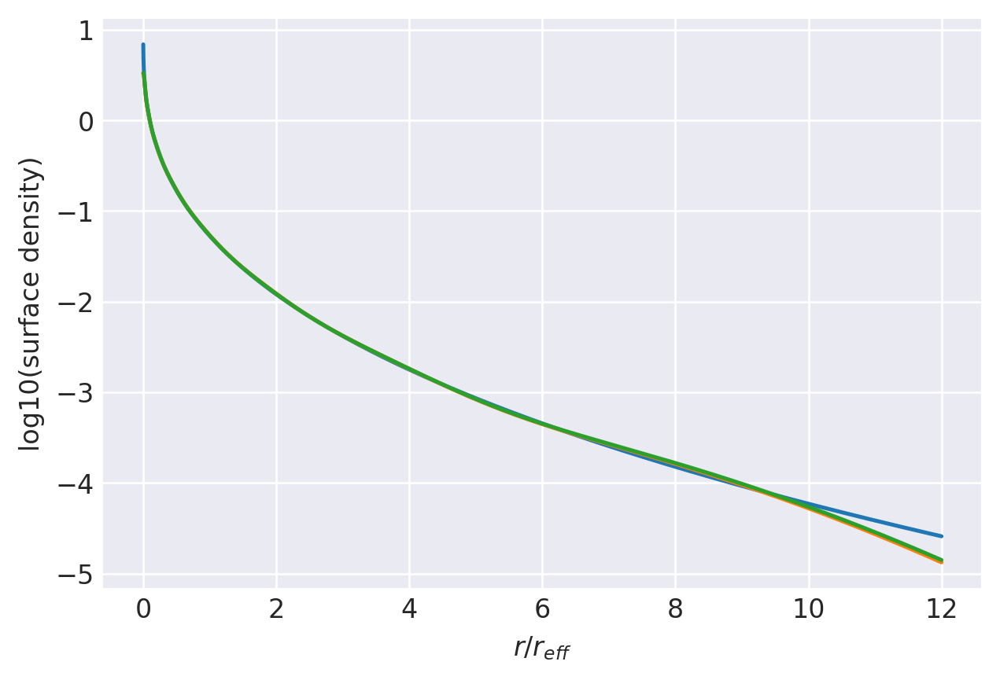

n=2.7198: (
    normalize(np.array([1.2026567343e-01, 2.4030325868e-01, 2.6171953322e-01, 1.9745041976e-01, 1.1205858374e-01, 4.8874015746e-02, 1.5908780439e-02, 3.4197349817e-03])),
    np.array([4.7487821653e+00, 2.1857072684e+00, 1.1072937168e+00, 5.7234109372e-01, 2.9147242893e-01, 1.4172316661e-01, 6.2849743063e-02, 2.2906313481e-02]),
),
[18, 24000]
0.9923171541447093 0.9985617482639788
prev.  chisq = -7.9251200394325
ws, re: (array([0.12026567, 0.24030326, 0.26171953, 0.19745042, 0.11205858,
       0.04887402, 0.01590878, 0.00341973]), array([4.74878217, 2.18570727, 1.10729372, 0.57234109, 0.29147243,
       0.14172317, 0.06284974, 0.02290631]))
         Current function value: -8.219147
         Iterations: 24
         Function evaluations: 630
         Gradient evaluations: 37
-8.219146667785655 [-1.98398552 -0.98454775 -0.37742532  0.07769079  0.48047974  0.90794699
  1.5114673   0.67998882  0.34175365  0.04567834 -0.24139805 -0.5345935
 -0.84737525 -1.1991165  -1.63300822]
0

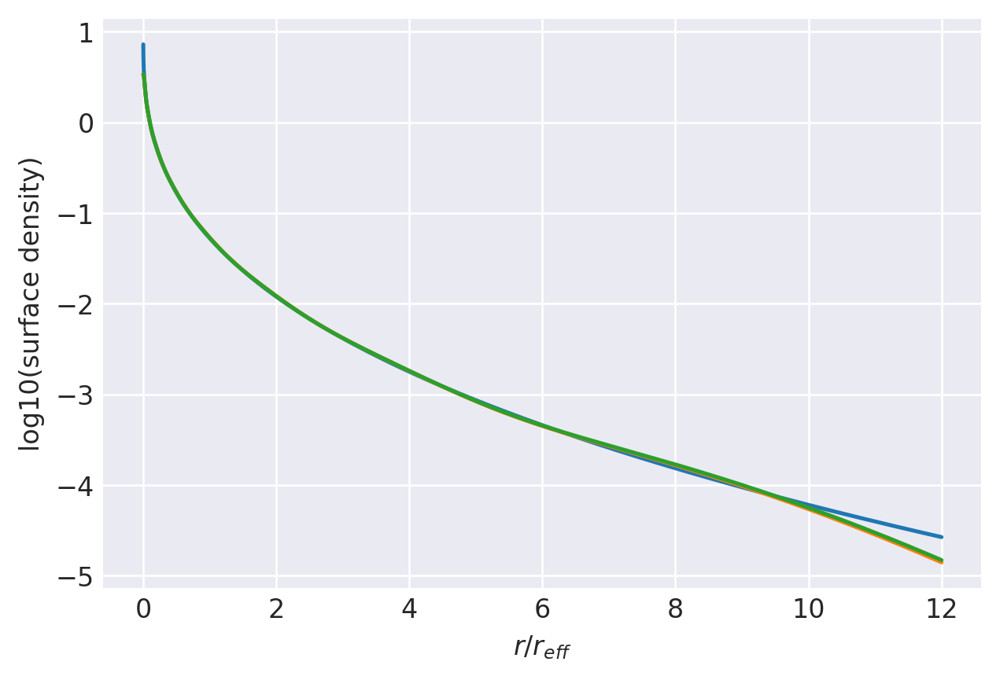

n=2.7546: (
    normalize(np.array([1.2089462012e-01, 2.3910817486e-01, 2.6031760058e-01, 1.9721049768e-01, 1.1274057241e-01, 4.9687149982e-02, 1.6419476508e-02, 3.6219078699e-03])),
    np.array([4.7861776818e+00, 2.1966135301e+00, 1.1109086248e+00, 5.7359050525e-01, 2.9201590278e-01, 1.4211003698e-01, 6.3224223602e-02, 2.3280472174e-02]),
),
[21, 24000]
0.9918880019686853 0.9984510966545362
prev.  chisq = -7.933342455629529
ws, re: (array([0.12089462, 0.23910817, 0.2603176 , 0.1972105 , 0.11274057,
       0.04968715, 0.01641948, 0.00362191]), array([4.78617768, 2.19661353, 1.11090862, 0.57359051, 0.2920159 ,
       0.14211004, 0.06322422, 0.02328047]))
Optimization terminated successfully.
         Current function value: -8.234399
         Iterations: 22
         Function evaluations: 629
         Gradient evaluations: 37
-8.23439948375086 [-1.98229421 -0.99489731 -0.39262408  0.05931271  0.45870441  0.88120711
  1.47642483  0.68402842  0.34495972  0.04855924 -0.23851548 -0.53126676

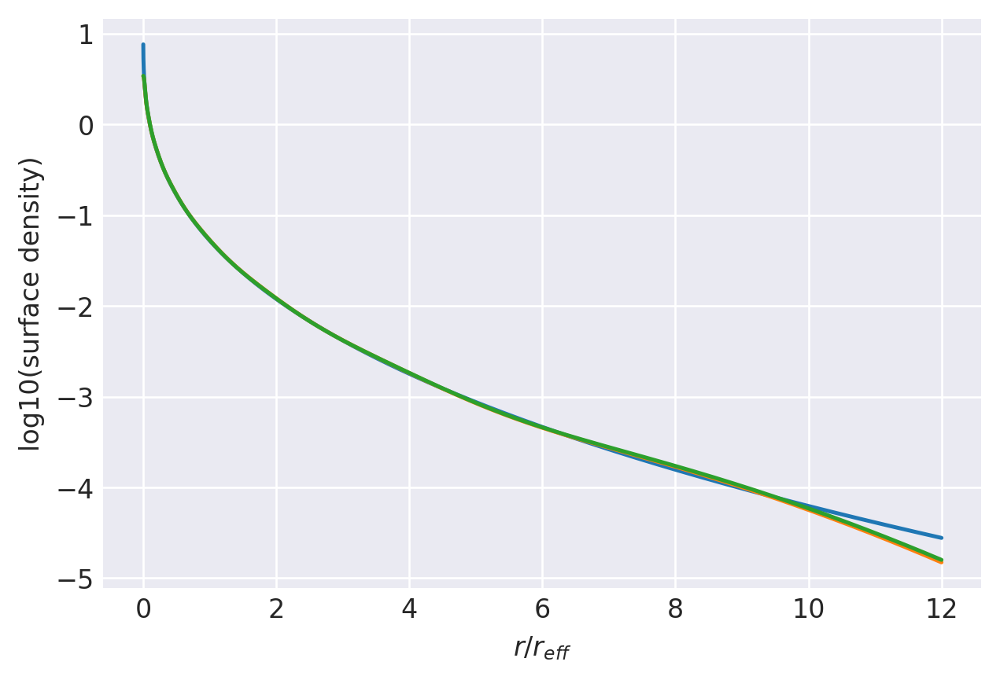

n=2.7899: (
    normalize(np.array([1.2107448641e-01, 2.3726229713e-01, 2.5864530963e-01, 1.9718674634e-01, 1.1386001225e-01, 5.0888805392e-02, 1.7161700977e-02, 3.9206418589e-03])),
    np.array([4.8309041552e+00, 2.2128894444e+00, 1.1183023643e+00, 5.7741029269e-01, 2.9426135985e-01, 1.4359047071e-01, 6.4274039056e-02, 2.4049969997e-02]),
),
[23, 24000]
0.9914425687146677 0.9983190609993365
prev.  chisq = -7.933685821095116
ws, re: (array([0.12107449, 0.2372623 , 0.25864531, 0.19718675, 0.11386001,
       0.05088881, 0.0171617 , 0.00392064]), array([4.83090416, 2.21288944, 1.11830236, 0.57741029, 0.29426136,
       0.14359047, 0.06427404, 0.02404997]))
         Current function value: -8.238787
         Iterations: 20
         Function evaluations: 1491
         Gradient evaluations: 87
-8.238787193478244 [-1.97687224 -1.00143699 -0.40392805  0.0451202   0.44177626  0.86063947
  1.45019098  0.68746876  0.34726161  0.05022023 -0.23721789 -0.52999032
 -0.84108263 -1.18860661 -1.6109945

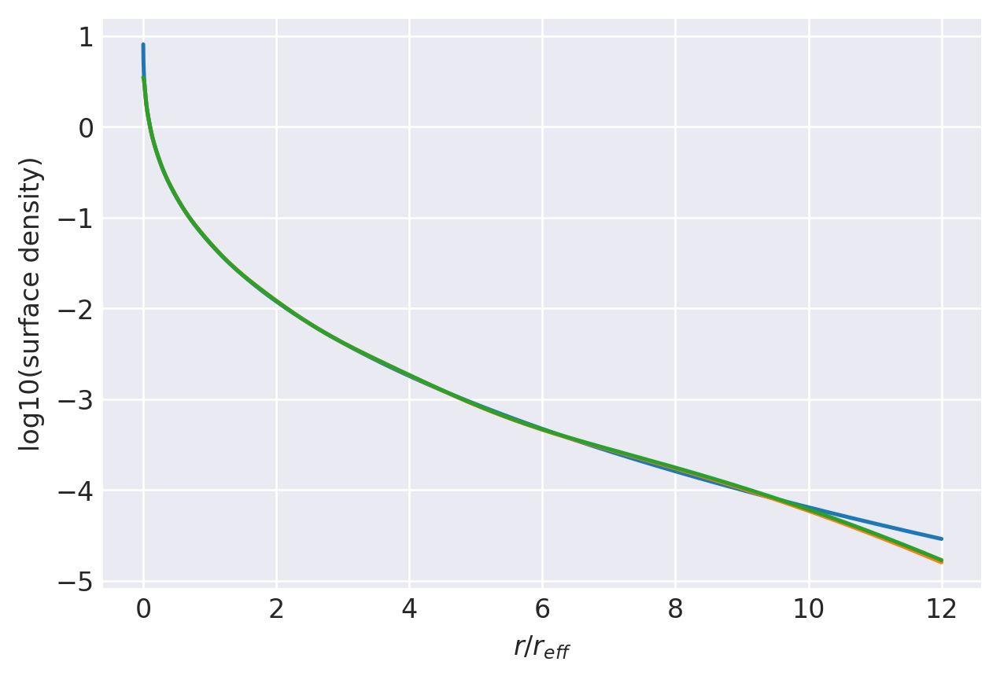

n=2.8257: (
    normalize(np.array([1.2165265454e-01, 2.3597590773e-01, 2.5718557839e-01, 1.9693710830e-01, 1.1458366307e-01, 5.1771399611e-02, 1.7734496765e-02, 4.1591915973e-03])),
    np.array([4.8693249818e+00, 2.2246495464e+00, 1.1225875694e+00, 5.7913806291e-01, 2.9512749870e-01, 1.4418409983e-01, 6.4772906624e-02, 2.4490941258e-02]),
),
[25, 24000]
0.9909832802502123 0.9981935733656521
prev.  chisq = -7.9380005664717155
ws, re: (array([0.12165265, 0.23597591, 0.25718558, 0.19693711, 0.11458366,
       0.0517714 , 0.0177345 , 0.00415919]), array([4.86932498, 2.22464955, 1.12258757, 0.57913806, 0.2951275 ,
       0.1441841 , 0.06477291, 0.02449094]))
         Current function value: -8.243764
         Iterations: 23
         Function evaluations: 1677
         Gradient evaluations: 98
-8.243763595557917 [-1.97161328 -1.00813452 -0.41538784  0.03076803  0.42469471  0.83998076
  1.42414446  0.69088413  0.34958571  0.05194662 -0.23581506 -0.52856843
 -0.83910329 -1.1850227  -1.602921

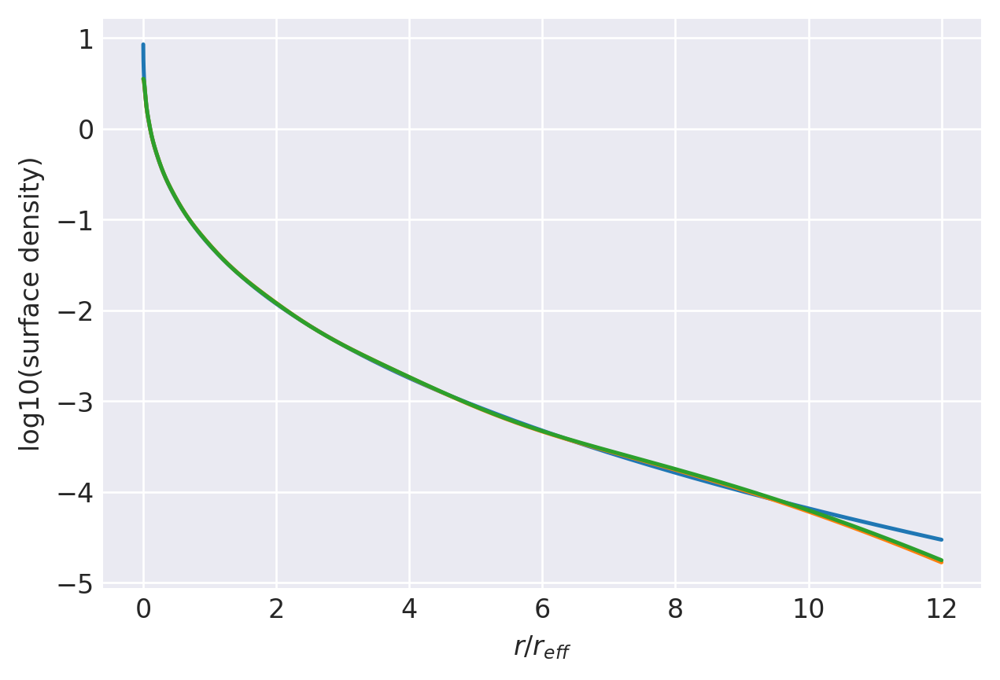

n=2.8618: (
    normalize(np.array([1.2221570977e-01, 2.3467131783e-01, 2.5571517510e-01, 1.9667853002e-01, 1.1531003327e-01, 5.2670421300e-02, 1.8327194606e-02, 4.4116180964e-03])),
    np.array([4.9077691980e+00, 2.2365865671e+00, 1.1270589128e+00, 5.8101178592e-01, 2.9609533924e-01, 1.4484273192e-01, 6.5309641434e-02, 2.4950466741e-02]),
),
[28, 24000]
0.9905062335037825 0.9980619761399555
prev.  chisq = -7.9464424955612545
ws, re: (array([0.12221571, 0.23467132, 0.25571518, 0.19667853, 0.11531003,
       0.05267042, 0.01832719, 0.00441162]), array([4.9077692 , 2.23658657, 1.12705891, 0.58101179, 0.29609534,
       0.14484273, 0.06530964, 0.02495047]))
         Current function value: -8.260399
         Iterations: 22
         Function evaluations: 1355
         Gradient evaluations: 79
-8.260399234013756 [-1.97019536 -1.01902827 -0.4312238   0.01171873  0.40230722  0.8129937
  1.39026484  0.69489992  0.3529069   0.05507822 -0.23255686 -0.52474244
 -0.8339819  -1.17717571 -1.5884997

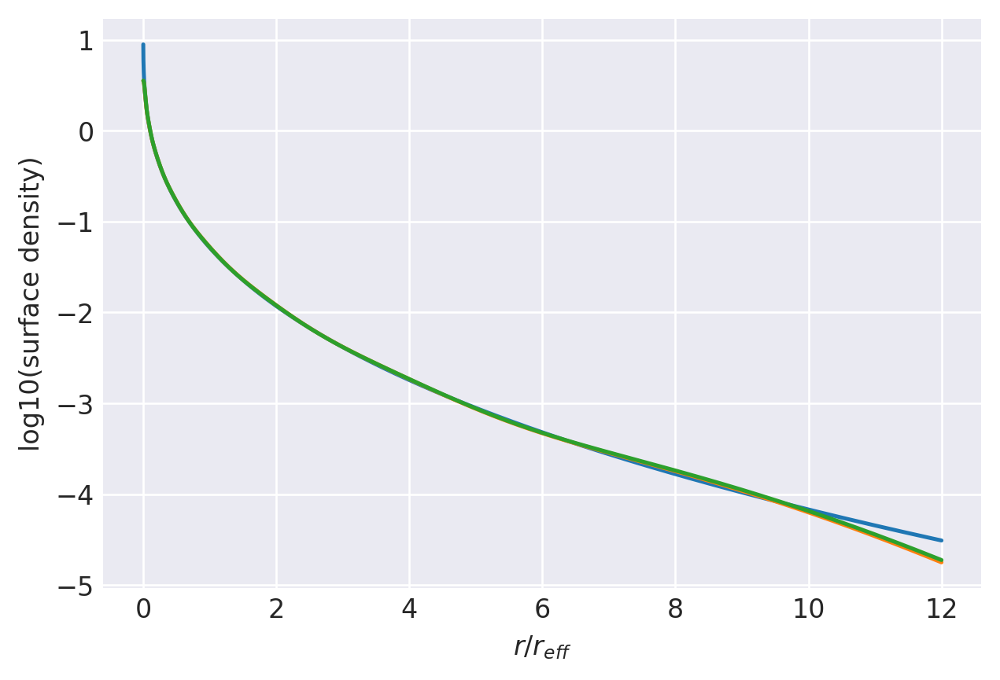

n=2.8985: (
    normalize(np.array([1.2236790454e-01, 2.3276270945e-01, 2.5397157844e-01, 1.9659409689e-01, 1.1643491849e-01, 5.3943378105e-02, 1.9155512439e-02, 4.7699016625e-03])),
    np.array([4.9533602640e+00, 2.2537560322e+00, 1.1352152489e+00, 5.8538709286e-01, 2.9871536355e-01, 1.4656089364e-01, 6.6500404412e-02, 2.5792903003e-02]),
),
[30, 24000]
0.9900139183930329 0.9979064652789907
prev.  chisq = -7.948958707910771
ws, re: (array([0.1223679 , 0.23276271, 0.25397158, 0.1965941 , 0.11643492,
       0.05394338, 0.01915551, 0.0047699 ]), array([4.95336026, 2.25375603, 1.13521525, 0.58538709, 0.29871536,
       0.14656089, 0.0665004 , 0.0257929 ]))
         Current function value: -8.266029
         Iterations: 20
         Function evaluations: 1406
         Gradient evaluations: 82
-8.266028732057583 [-1.96493291 -1.02584559 -0.44284564 -0.00280226  0.38510889  0.79244836
  1.36508772  0.69826512  0.35524426  0.05687806 -0.23102863 -0.52314809
 -0.83179105 -1.17337856 -1.5804682

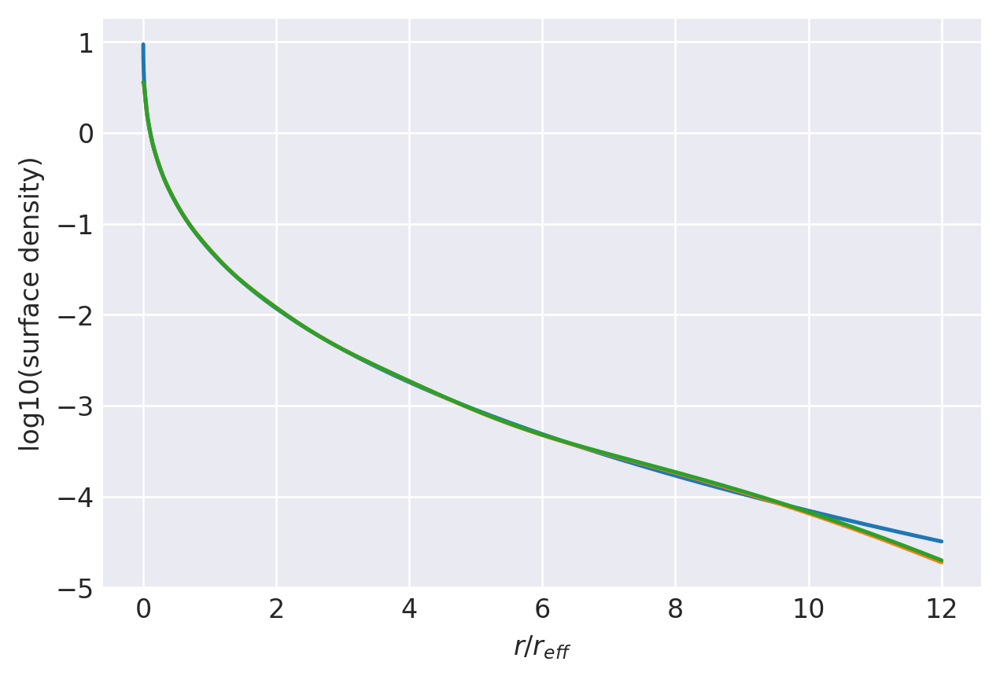

n=2.9356: (
    normalize(np.array([1.2293418470e-01, 2.3144917404e-01, 2.5247685829e-01, 1.9629447139e-01, 1.1714357244e-01, 5.4863234079e-02, 1.9785989036e-02, 5.0525160396e-03])),
    np.array([4.9918912504e+00, 2.2659183852e+00, 1.1399296790e+00, 5.8745061992e-01, 2.9981399991e-01, 1.4730210511e-01, 6.7084384178e-02, 2.6274335197e-02]),
),
[32, 24000]
0.9895049580723098 0.9977609875657741
prev.  chisq = -7.951863033985934
ws, re: (array([0.12293418, 0.23144917, 0.25247686, 0.19629447, 0.11714357,
       0.05486323, 0.01978599, 0.00505252]), array([4.99189125, 2.26591839, 1.13992968, 0.58745062, 0.299814  ,
       0.14730211, 0.06708438, 0.02627434]))
         Current function value: -8.271943
         Iterations: 22
         Function evaluations: 1831
         Gradient evaluations: 107
-8.271943313895344 [-1.9596417  -1.03267183 -0.45449172 -0.01735279  0.36791234  0.77201129
  1.34032487  0.70159609  0.3575729   0.0586933  -0.22946451 -0.52150021
 -0.82953472 -1.16952209 -1.572488

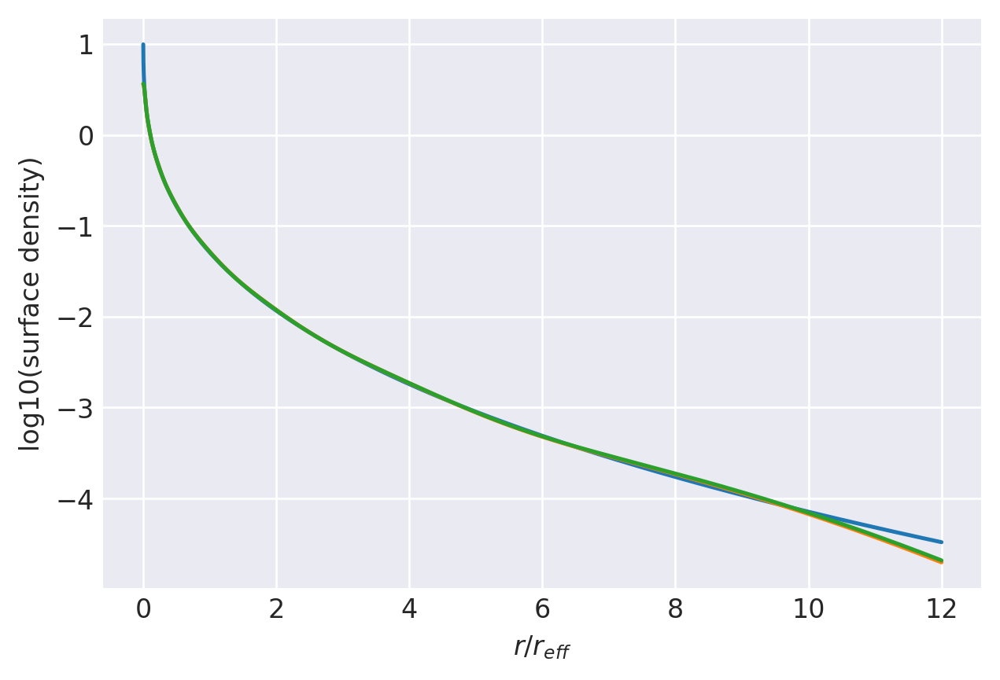

n=2.9732: (
    normalize(np.array([1.2350582877e-01, 2.3013795617e-01, 2.5097582126e-01, 1.9597500193e-01, 1.1783949972e-01, 5.5787466348e-02, 2.0430520231e-02, 5.3479055812e-03])),
    np.array([5.0303254842e+00, 2.2781005997e+00, 1.1447042513e+00, 5.8957016007e-01, 3.0095377473e-01, 1.4806938735e-01, 6.7682736131e-02, 2.6761556644e-02]),
),
[34, 24000]
0.989136215414153 0.9976091380157938
prev.  chisq = -8.092430291454152
ws, re: (array([0.12350583, 0.23013796, 0.25097582, 0.195975  , 0.1178395 ,
       0.05578747, 0.02043052, 0.00534791]), array([5.03032548, 2.2781006 , 1.14470425, 0.58957016, 0.30095377,
       0.14806939, 0.06768274, 0.02676156]))
         Current function value: -8.282734
         Iterations: 20
         Function evaluations: 1321
         Gradient evaluations: 77
-8.282733944142175 [-1.95801493 -1.03981131 -0.46512956 -0.03019894  0.35289327  0.75421639
  1.31884218  0.7042724   0.35977322  0.06076878 -0.22730896 -0.51897687
 -0.82617382 -1.16442948 -1.563431  

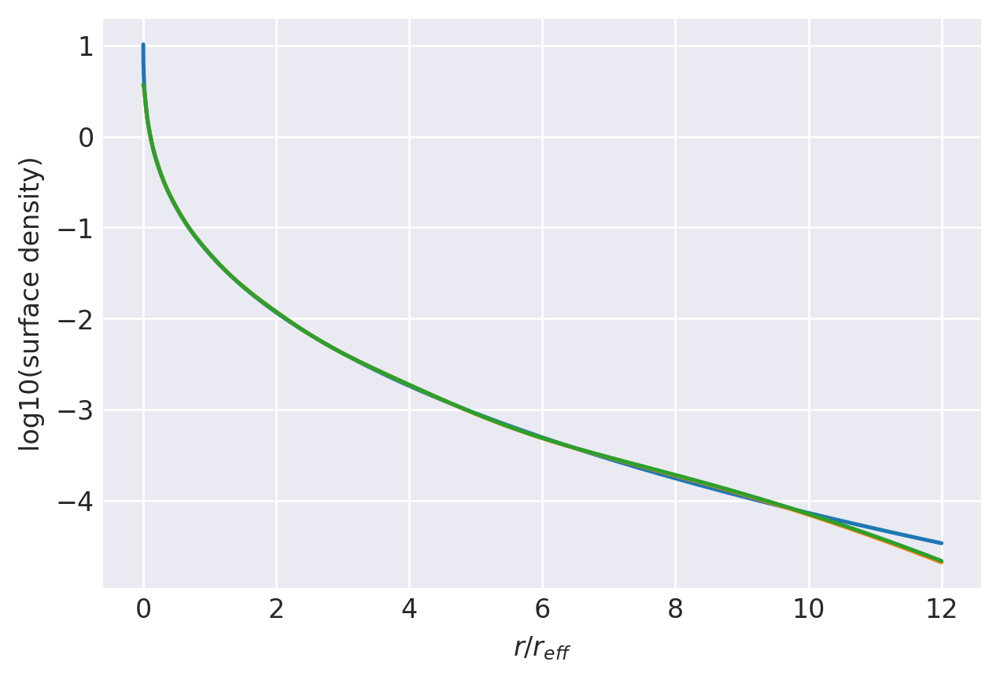

n=3.0: (
    normalize(np.array([1.2368203840e-01, 2.2888233678e-01, 2.4976101917e-01, 1.9583519262e-01, 1.1854412501e-01, 5.6648853384e-02, 2.1023744125e-02, 5.6226905121e-03])),
    np.array([5.0614202438e+00, 2.2896717313e+00, 1.1501878688e+00, 5.9250366523e-01, 3.0270746190e-01, 1.4921970665e-01, 6.8481067360e-02, 2.7325555377e-02]),
),
[37, 24000]
0.9884368353921136 0.9974869118096346
prev.  chisq = -7.831476577508502
ws, re: (array([0.12367623, 0.22887391, 0.24975709, 0.1958376 , 0.11854974,
       0.05665412, 0.02102706, 0.00562425]), array([5.06152259, 2.28974679, 1.15024049, 0.59253925, 0.30273091,
       0.14923473, 0.06849035, 0.02733085]))
         Current function value: -8.295307
         Iterations: 23
         Function evaluations: 1372
         Gradient evaluations: 80
-8.295306827770329 [-1.95243571 -1.05016135 -0.48181338 -0.05073267  0.32882067  0.7259011
  1.28524253  0.7087307   0.36313734  0.0636732  -0.2245222  -0.51584999
 -0.82197858 -1.15780638 -1.55107595]
0

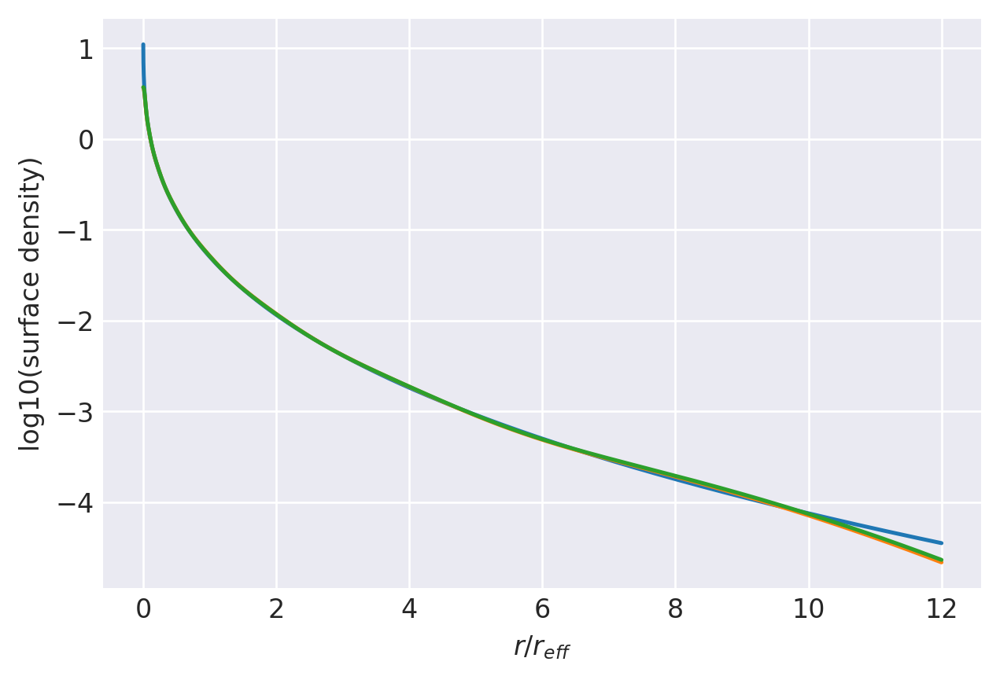

n=3.0499: (
    normalize(np.array([1.2428801201e-01, 2.2697939587e-01, 2.4770168136e-01, 1.9543020416e-01, 1.1955113652e-01, 5.7989248684e-02, 2.1980796004e-02, 6.0795253882e-03])),
    np.array([5.1136464873e+00, 2.3074767608e+00, 1.1579057226e+00, 5.9631783497e-01, 3.0489479667e-01, 1.5066813850e-01, 6.9533425064e-02, 2.8114090972e-02]),
),
[39, 24000]
0.9878790302415087 0.997266796178247
prev.  chisq = -7.969706549299342
ws, re: (array([0.12428801, 0.2269794 , 0.24770168, 0.1954302 , 0.11955114,
       0.05798925, 0.0219808 , 0.00607953]), array([5.11364649, 2.30747676, 1.15790572, 0.59631783, 0.3048948 ,
       0.15066814, 0.06953343, 0.02811409]))
Optimization terminated successfully.
         Current function value: -8.301851
         Iterations: 25
         Function evaluations: 714
         Gradient evaluations: 42
-8.30185114877919 [-1.94696572 -1.05686442 -0.49334553 -0.06513353  0.31190425  0.70612569
  1.26213932  0.71193317  0.36540809  0.0654947  -0.22290428 -0.51411598


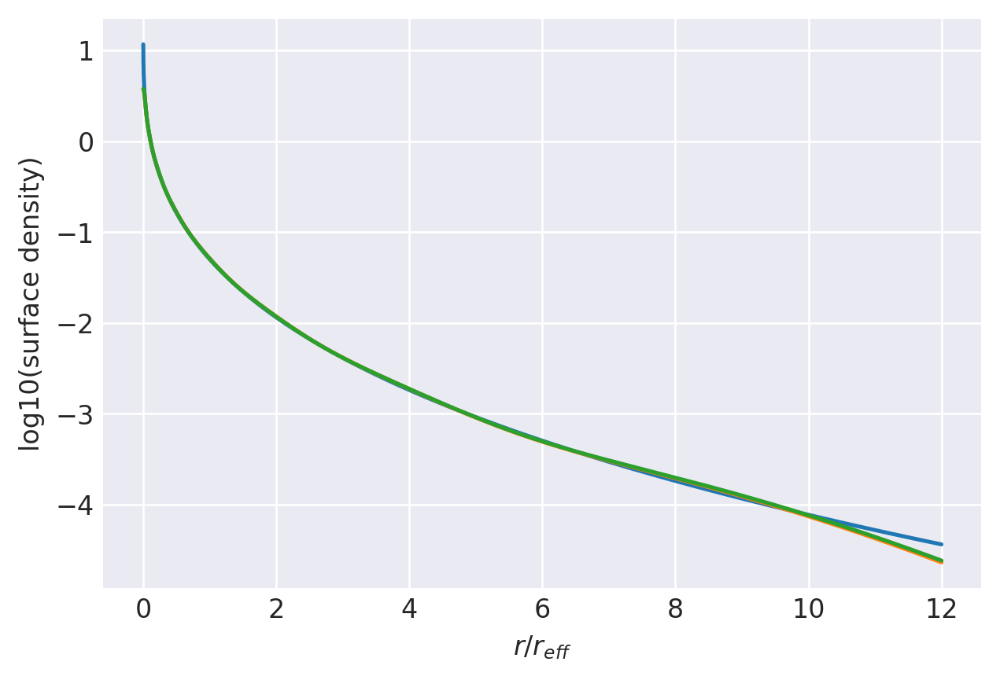

n=3.0889: (
    normalize(np.array([1.2488459293e-01, 2.2570024746e-01, 2.4619702991e-01, 1.9504562960e-01, 1.2018839273e-01, 5.8909276491e-02, 2.2660753369e-02, 6.4140775125e-03])),
    np.array([5.1514936731e+00, 2.3195732489e+00, 1.1627723503e+00, 5.9854349508e-01, 3.0611458435e-01, 1.5148540737e-01, 7.0157446271e-02, 2.8608659150e-02]),
),
[41, 24000]
0.9873029903566853 0.9970958301143862
prev.  chisq = -7.97267416565039
ws, re: (array([0.12488459, 0.22570025, 0.24619703, 0.19504563, 0.12018839,
       0.05890928, 0.02266075, 0.00641408]), array([5.15149367, 2.31957325, 1.16277235, 0.5985435 , 0.30611458,
       0.15148541, 0.07015745, 0.02860866]))
         Current function value: -8.308557
         Iterations: 21
         Function evaluations: 1372
         Gradient evaluations: 80
-8.308556866580401 [-1.9414167  -1.06352138 -0.50484236 -0.07949311  0.29506654  0.6865378
  1.23948595  0.71509954  0.36765878  0.06731151 -0.2212802  -0.51236937
 -0.81726844 -1.15005735 -1.53605599]

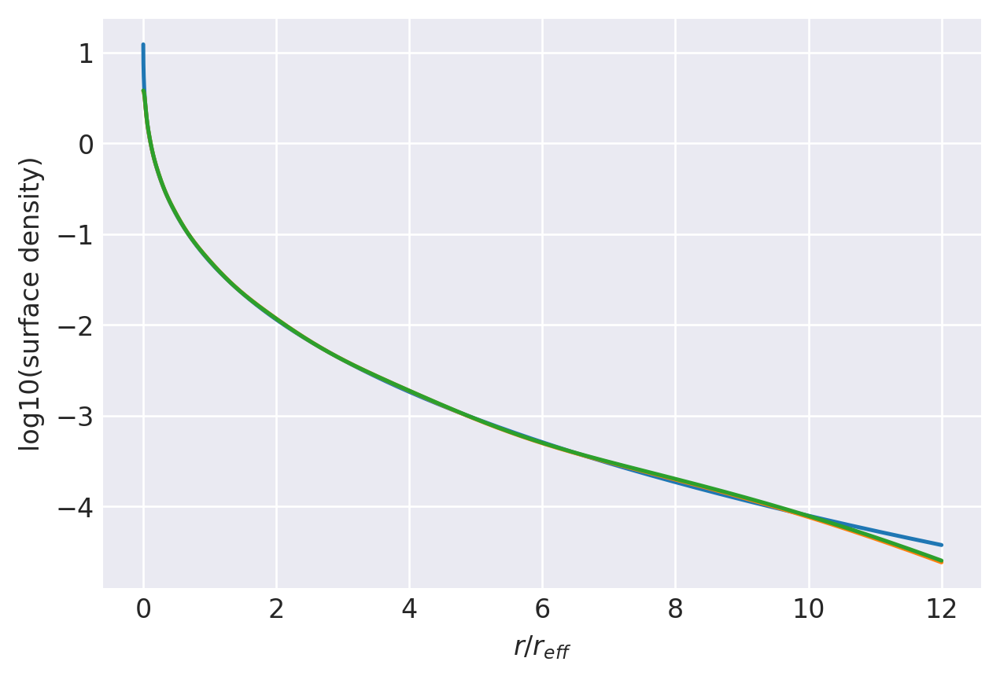

n=3.1285: (
    normalize(np.array([1.2549229955e-01, 2.2443111168e-01, 2.4469102068e-01, 1.9464068407e-01, 1.2080656509e-01, 5.9826637039e-02, 2.3350842194e-02, 6.7608397113e-03])),
    np.array([5.1891896398e+00, 2.3316254369e+00, 1.1676468429e+00, 6.0078598961e-01, 3.0734816700e-01, 1.5231110202e-01, 7.0785230098e-02, 2.9103418693e-02]),
),
[44, 24000]
0.9867101377492103 0.9969183903975917
prev.  chisq = -7.98484550627746
ws, re: (array([0.1254923 , 0.22443111, 0.24469102, 0.19464068, 0.12080657,
       0.05982664, 0.02335084, 0.00676084]), array([5.18918964, 2.33162544, 1.16764684, 0.60078599, 0.30734817,
       0.1523111 , 0.07078523, 0.02910342]))
         Current function value: -8.325819
         Iterations: 21
         Function evaluations: 1644
         Gradient evaluations: 96
-8.325818559600448 [-1.93904093 -1.07379132 -0.520137   -0.0978783   0.2738179   0.66197543
  1.21124322  0.71878016  0.3707976   0.07040352 -0.21796674 -0.50844761
 -0.81210924 -1.14250547 -1.52348203

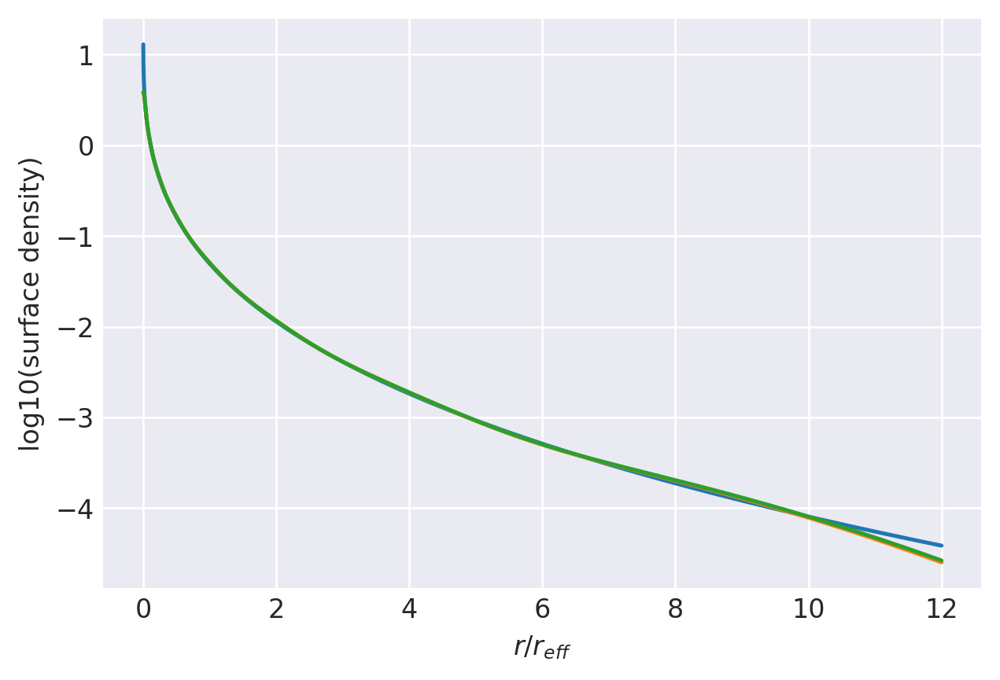

n=3.1686: (
    normalize(np.array([1.2575325780e-01, 2.2265556282e-01, 2.4292635315e-01, 1.9434053427e-01, 1.2174261735e-01, 6.1076501222e-02, 2.4275329895e-02, 7.2298434906e-03])),
    np.array([5.2333546130e+00, 2.3485380628e+00, 1.1759897024e+00, 6.0538724244e-01, 3.1013614553e-01, 1.5413126943e-01, 7.2026867523e-02, 2.9958355610e-02]),
),
[46, 24000]
0.9861004947854435 0.9967134669876684
prev.  chisq = -7.987782049282597
ws, re: (array([0.12575326, 0.22265556, 0.24292635, 0.19434053, 0.12174262,
       0.0610765 , 0.02427533, 0.00722984]), array([5.23335461, 2.34853806, 1.1759897 , 0.60538724, 0.31013615,
       0.15413127, 0.07202687, 0.02995836]))
Optimization terminated successfully.
         Current function value: -8.332791
         Iterations: 24
         Function evaluations: 663
         Gradient evaluations: 39
-8.332790685569123 [-1.93332072 -1.08028135 -0.53146131 -0.11202896  0.25729669  0.64296838
  1.18975197  0.72185378  0.37299148  0.07219632 -0.21634539 -0.5066952

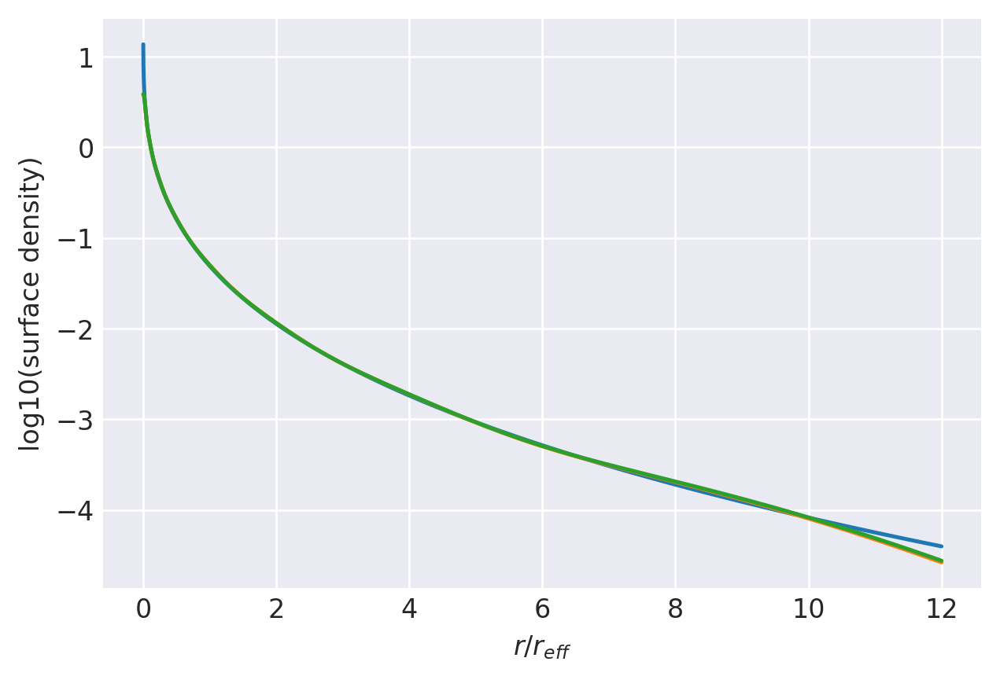

n=3.2092: (
    normalize(np.array([1.2638348251e-01, 2.2142053231e-01, 2.4142738242e-01, 1.9389182378e-01, 1.2231235301e-01, 6.1979809204e-02, 2.4982518186e-02, 7.6020985704e-03])),
    np.array([5.2705237713e+00, 2.3604319165e+00, 1.1808543061e+00, 6.0765155538e-01, 3.1139008174e-01, 1.5496868523e-01, 7.2658477969e-02, 3.0450989490e-02]),
),
[48, 24000]
0.9854787066049464 0.9965233913392979
prev.  chisq = -7.996439519171277
ws, re: (array([0.12638348, 0.22142053, 0.24142738, 0.19389182, 0.12231235,
       0.06197981, 0.02498252, 0.0076021 ]), array([5.27052377, 2.36043192, 1.18085431, 0.60765156, 0.31139008,
       0.15496869, 0.07265848, 0.03045099]))
         Current function value: -8.340033
         Iterations: 22
         Function evaluations: 1287
         Gradient evaluations: 75
-8.340032939219267 [-1.92765283 -1.08672358 -0.54269566 -0.12605329  0.24095573  0.62425895
  1.16878421  0.72487159  0.37515944  0.07398798 -0.21470687 -0.50491363
 -0.80737166 -1.13491257 -1.5094122

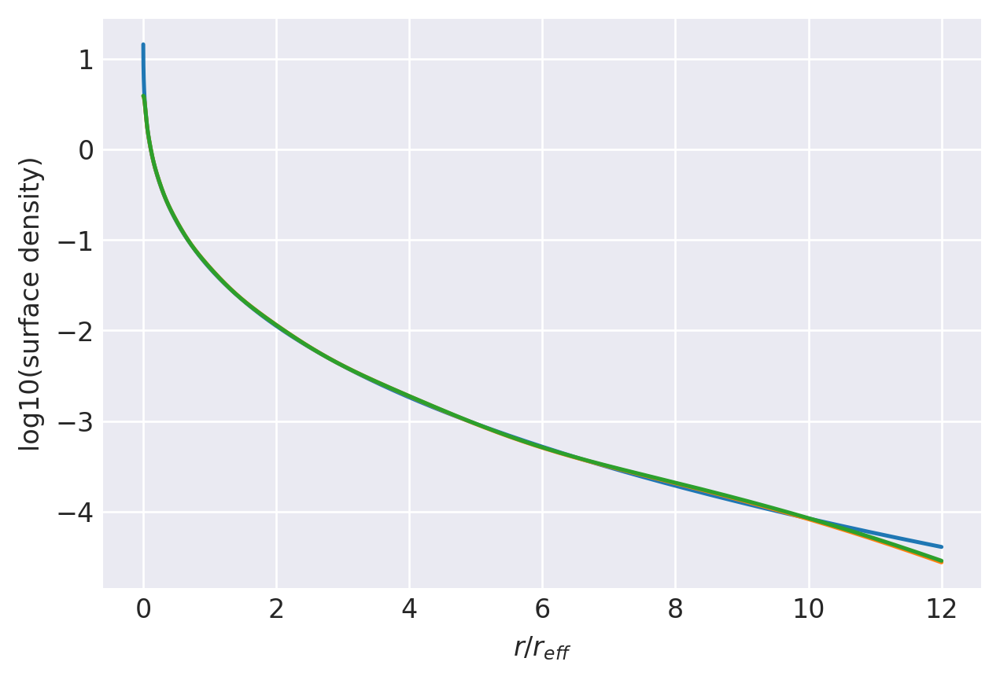

n=3.25: (
    normalize(np.array([1.2701060417e-01, 2.2019913652e-01, 2.3994006212e-01, 1.9343201753e-01, 1.2286302528e-01, 6.2875418673e-02, 2.5695118634e-02, 7.9846170721e-03])),
    np.array([5.3072750214e+00, 2.3722444636e+00, 1.1857359413e+00, 6.0994845127e-01, 3.1267011371e-01, 1.5582184315e-01, 7.3297207276e-02, 3.0944804287e-02]),
),
[51, 24000]
0.9848310158628358 0.9963284954281031
prev.  chisq = -8.00255732258757
ws, re: (array([0.1270106 , 0.22019914, 0.23994006, 0.19343202, 0.12286303,
       0.06287542, 0.02569512, 0.00798462]), array([5.30727502, 2.37224446, 1.18573594, 0.60994845, 0.31267011,
       0.15582184, 0.07329721, 0.0309448 ]))
         Current function value: -8.357226
         Iterations: 23
         Function evaluations: 1440
         Gradient evaluations: 84
-8.357225887395122 [-1.924717   -1.09652913 -0.55754748 -0.14393022  0.22043046  0.60091505
  1.14278203  0.72839997  0.37817528  0.07698654 -0.21147723 -0.50109238
 -0.80237621 -1.12770146 -1.4977571 ]


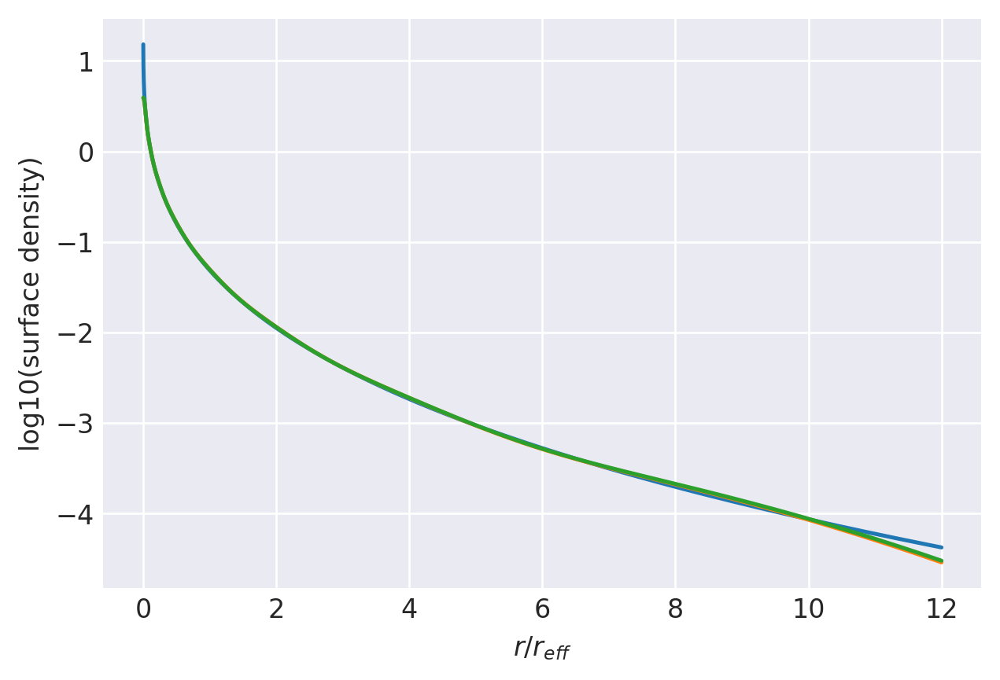

n=3.2919: (
    normalize(np.array([1.2733648229e-01, 2.1850691216e-01, 2.3818830817e-01, 1.9304233249e-01, 1.2369839778e-01, 6.4087674935e-02, 2.6642716860e-02, 8.4971753106e-03])),
    np.array([5.3505690278e+00, 2.3887751929e+00, 1.1939511087e+00, 6.1450124512e-01, 3.1543335755e-01, 1.5762452301e-01, 7.4524409464e-02, 3.1786513956e-02]),
),
[53, 24000]
0.9841697345981918 0.9961027077644254
prev.  chisq = -8.008568554303501
ws, re: (array([0.12733648, 0.21850691, 0.23818831, 0.19304233, 0.1236984 ,
       0.06408767, 0.02664272, 0.00849718]), array([5.35056903, 2.38877519, 1.19395111, 0.61450125, 0.31543336,
       0.15762452, 0.07452441, 0.03178651]))
         Current function value: -8.364583
         Iterations: 22
         Function evaluations: 1338
         Gradient evaluations: 78
-8.364583433987727 [-1.91879108 -1.10278501 -0.56861887 -0.15776834  0.20437216  0.58270917
  1.12280017  0.73134254  0.38028578  0.07874038 -0.20986675 -0.49934121
 -0.80004392 -1.12402356 -1.4911415

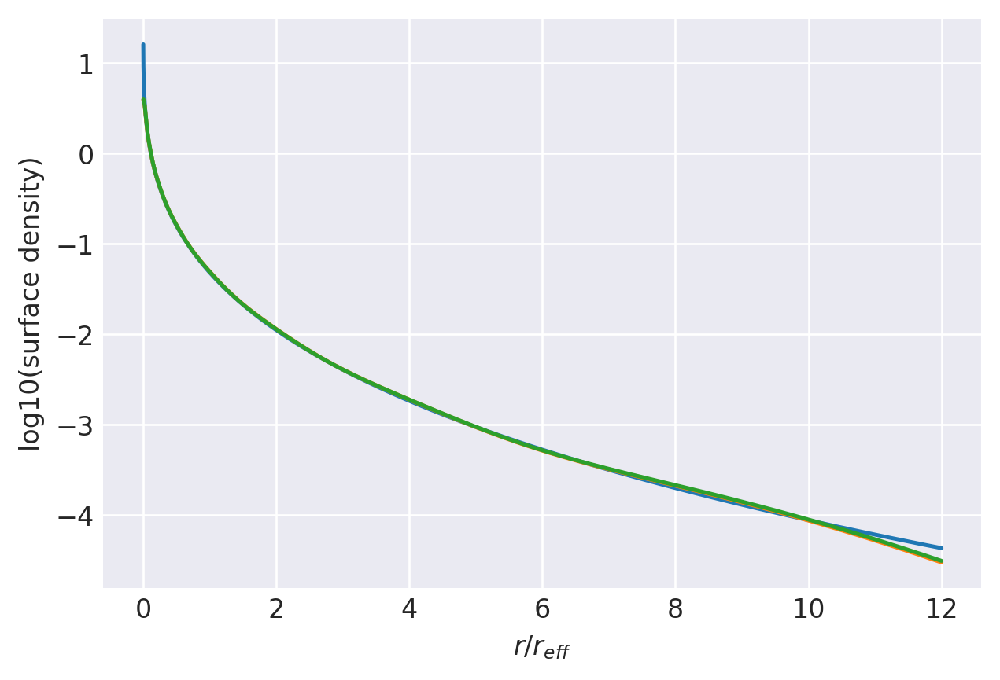

n=3.3341: (
    normalize(np.array([1.2799643719e-01, 2.1731935917e-01, 2.3670472353e-01, 1.9253786842e-01, 1.2419937761e-01, 6.4966184608e-02, 2.7370560432e-02, 8.9054890445e-03])),
    np.array([5.3869449565e+00, 2.4004119651e+00, 1.1987824572e+00, 6.1678421393e-01, 3.1670782412e-01, 1.5847329059e-01, 7.5158212398e-02, 3.2274417877e-02]),
),
[55, 24000]
0.9834918858904704 0.995894280344107
prev.  chisq = -8.014613682729157
ws, re: (array([0.12799644, 0.21731936, 0.23670472, 0.19253787, 0.12419938,
       0.06496618, 0.02737056, 0.00890549]), array([5.38694496, 2.40041197, 1.19878246, 0.61678421, 0.31670782,
       0.15847329, 0.07515821, 0.03227442]))
Optimization terminated successfully.
         Current function value: -8.372106
         Iterations: 23
         Function evaluations: 612
         Gradient evaluations: 36
-8.372105783037483 [-1.91284473 -1.1089694  -0.57959753 -0.17149908  0.18846285  0.56475869
  1.10323497  0.73424377  0.38237026  0.08048102 -0.20826052 -0.49758931

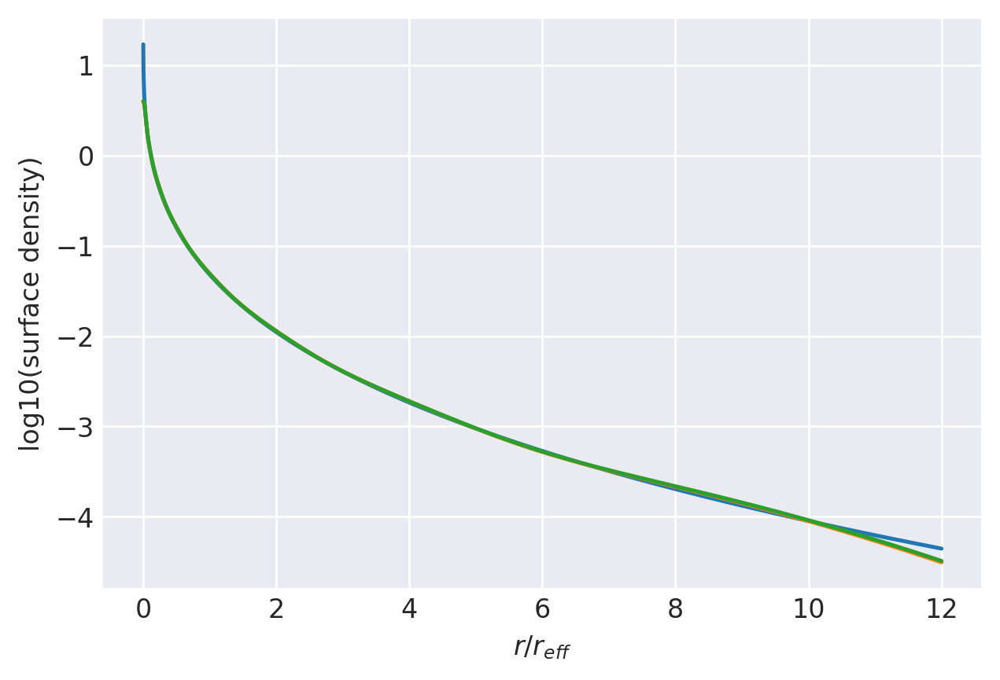

n=3.3768: (
    normalize(np.array([1.2866159921e-01, 2.1614688232e-01, 2.3523027000e-01, 1.9201888477e-01, 1.2467917363e-01, 6.5835745541e-02, 2.8102986218e-02, 9.3244583032e-03])),
    np.array([5.4230520760e+00, 2.4119608692e+00, 1.2035967823e+00, 6.1906960554e-01, 3.1798796705e-01, 1.5932524183e-01, 7.5792493503e-02, 3.2761070349e-02]),
),
[58, 24000]
0.9827975786570701 0.9956801690074724
prev.  chisq = -8.028853768379236
ws, re: (array([0.1286616 , 0.21614688, 0.23523027, 0.19201888, 0.12467917,
       0.06583575, 0.02810299, 0.00932446]), array([5.42305208, 2.41196087, 1.20359678, 0.61906961, 0.31798797,
       0.15932524, 0.07579249, 0.03276107]))
Optimization terminated successfully.
         Current function value: -8.389396
         Iterations: 24
         Function evaluations: 612
         Gradient evaluations: 36
-8.389395943373664 [-1.90957994 -1.11832886 -0.59394374 -0.18876299  0.1687731   0.54270907
  1.07935523  0.73760208  0.38526056  0.08339364 -0.20509851 -0.4938447

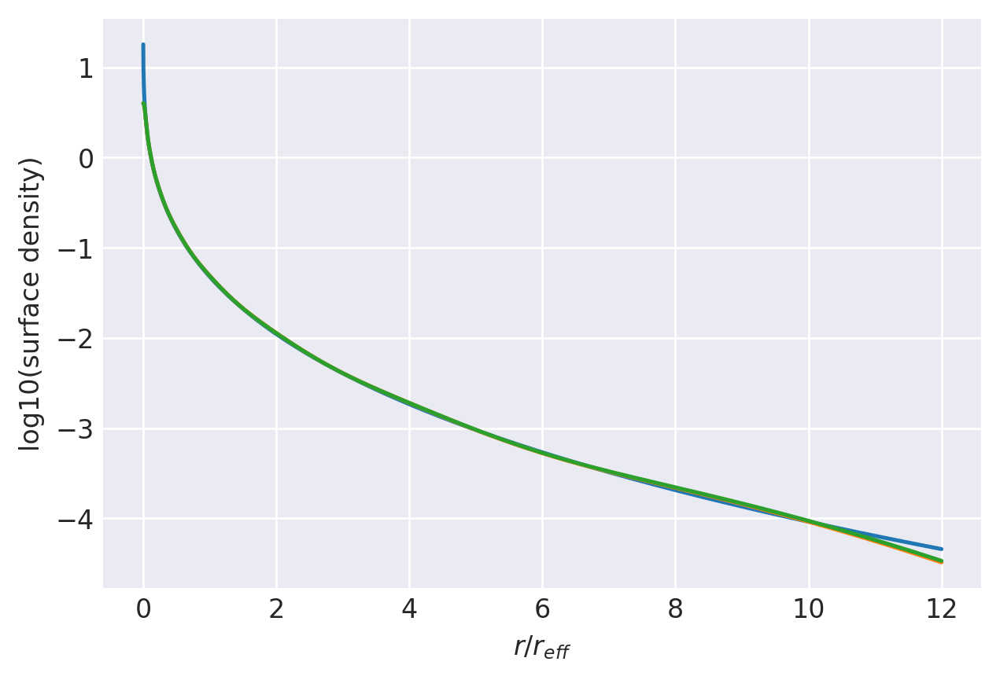

n=3.42: (
    normalize(np.array([1.2902805054e-01, 2.1453902575e-01, 2.3351320573e-01, 1.9156101126e-01, 1.2541802907e-01, 6.7001375408e-02, 2.9063202822e-02, 9.8760994217e-03])),
    np.array([5.4651499014e+00, 2.4280664044e+00, 1.2116959163e+00, 6.2359337095e-01, 3.2074158263e-01, 1.6111931880e-01, 7.7009246231e-02, 3.3591009013e-02]),
),
[60, 24000]
0.9820853017231163 0.9954362311548114
prev.  chisq = -8.032104369797908
ws, re: (array([0.12902805, 0.21453903, 0.23351321, 0.19156101, 0.12541803,
       0.06700138, 0.0290632 , 0.0098761 ]), array([5.4651499 , 2.4280664 , 1.21169592, 0.62359337, 0.32074158,
       0.16111932, 0.07700925, 0.03359101]))
         Current function value: -8.397122
         Iterations: 25
         Function evaluations: 1746
         Gradient evaluations: 102
-8.39712204048484 [-1.90350978 -1.12433876 -0.60472336 -0.2022454   0.15321638  0.52531976
  1.06074736  0.74041693  0.38728644  0.08510209 -0.20350898 -0.4921071
 -0.79055571 -1.10990375 -1.46758813]


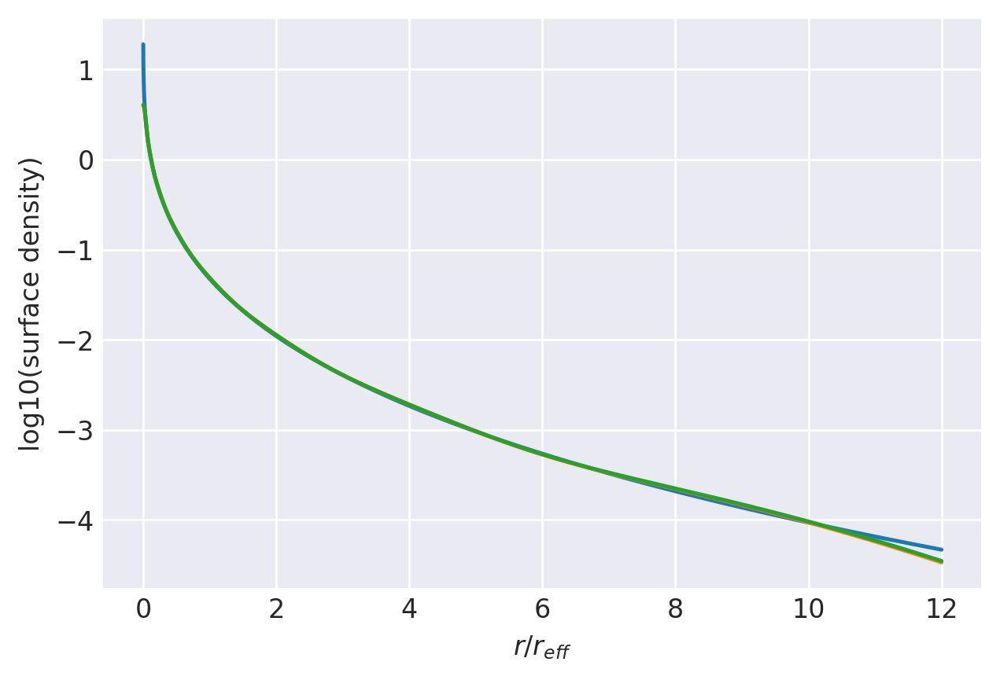

n=3.4638: (
    normalize(np.array([1.2971175144e-01, 2.1340109685e-01, 2.3205445759e-01, 1.9100915108e-01, 1.2585069068e-01, 6.7849153549e-02, 2.9805221271e-02, 1.0318477543e-02])),
    np.array([5.5006869582e+00, 2.4394191885e+00, 1.2164719178e+00, 6.2587992317e-01, 3.2202745177e-01, 1.6197362082e-01, 7.7641916389e-02, 3.4073117319e-02]),
),
[62, 24000]
0.9814905865621665 0.9952102598514759
prev.  chisq = -8.131825754818461
ws, re: (array([0.12971175, 0.2134011 , 0.23205446, 0.19100915, 0.12585069,
       0.06784915, 0.02980522, 0.01031848]), array([5.50068696, 2.43941919, 1.21647192, 0.62587992, 0.32202745,
       0.16197362, 0.07764192, 0.03407312]))
         Current function value: -8.406980
         Iterations: 22
         Function evaluations: 1576
         Gradient evaluations: 92
-8.406980114293239 [-1.89947183 -1.13034109 -0.61468789 -0.21446753  0.139236    0.50978
  1.04421414  0.74286499  0.38921903  0.08691096 -0.20165741 -0.48997852
 -0.78778213 -1.10585831 -1.46104557]


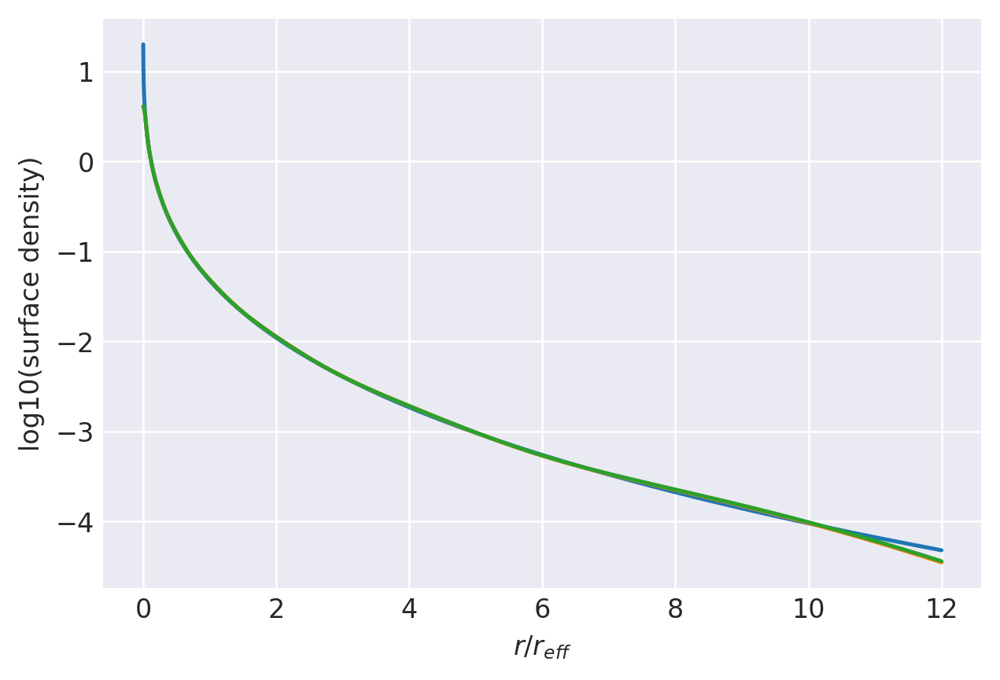

n=3.5: (
    normalize(np.array([1.3016826459e-01, 2.1232432558e-01, 2.3077889993e-01, 1.9057170043e-01, 1.2628553254e-01, 6.8642618597e-02, 3.0495284596e-02, 1.0733373732e-02])),
    np.array([5.5317811787e+00, 2.4502987254e+00, 1.2215492029e+00, 6.2855399011e-01, 3.2360965857e-01, 1.6301135939e-01, 7.8368528425e-02, 3.4590307876e-02]),
),
[65, 24000]
0.980608869008555 0.9950123122041042
prev.  chisq = -7.961963389975162
ws, re: (array([0.13016826, 0.21232433, 0.2307789 , 0.1905717 , 0.12628553,
       0.06864262, 0.03049528, 0.01073337]), array([5.53178118, 2.45029873, 1.2215492 , 0.62855399, 0.32360966,
       0.16301136, 0.07836853, 0.03459031]))
         Current function value: -8.422274
         Iterations: 21
         Function evaluations: 1780
         Gradient evaluations: 104
-8.422273825801483 [-1.89378462 -1.13921035 -0.62929816 -0.23233306  0.11886574  0.48725126
  1.02043686  0.74640648  0.39205953  0.08961945 -0.19884433 -0.4867243
 -0.78355743 -1.09976672 -1.45136295]
0

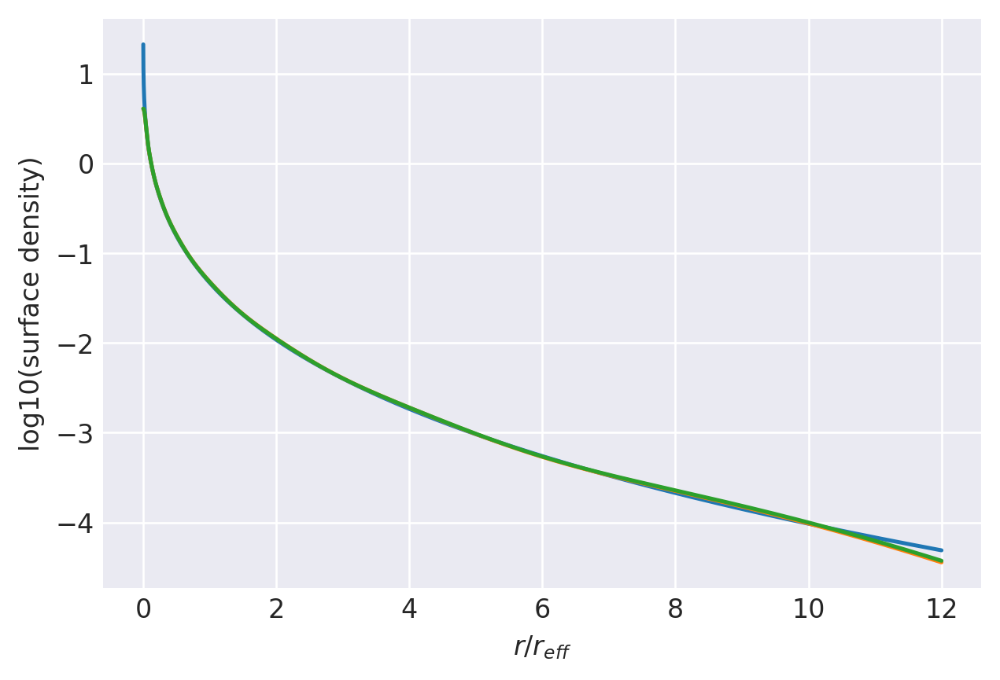

n=3.5531: (
    normalize(np.array([1.3081355100e-01, 2.1074761577e-01, 2.2891922896e-01, 1.8992351936e-01, 1.2690961251e-01, 6.9804614033e-02, 3.1520639610e-02, 1.1361218753e-02])),
    np.array([5.5770749140e+00, 2.4663773779e+00, 1.2291912268e+00, 6.3263857600e-01, 3.2604361167e-01, 1.6460482672e-01, 7.9475501922e-02, 3.5370162417e-02]),
),
[67, 24000]
0.9798449718409473 0.9947159839327305
prev.  chisq = -8.057282259891654
ws, re: (array([0.13081355, 0.21074762, 0.22891923, 0.18992352, 0.12690961,
       0.06980461, 0.03152064, 0.01136122]), array([5.57707491, 2.46637738, 1.22919123, 0.63263858, 0.32604361,
       0.16460483, 0.0794755 , 0.03537016]))
         Current function value: -8.430337
         Iterations: 23
         Function evaluations: 1610
         Gradient evaluations: 94
-8.430336927356167 [-1.8876061  -1.1449915  -0.63980094 -0.24546445  0.10380521  0.4706289
  1.00306926  0.74910138  0.39400476  0.09128505 -0.19727432 -0.48500096
 -0.781297   -1.09633159 -1.44555422

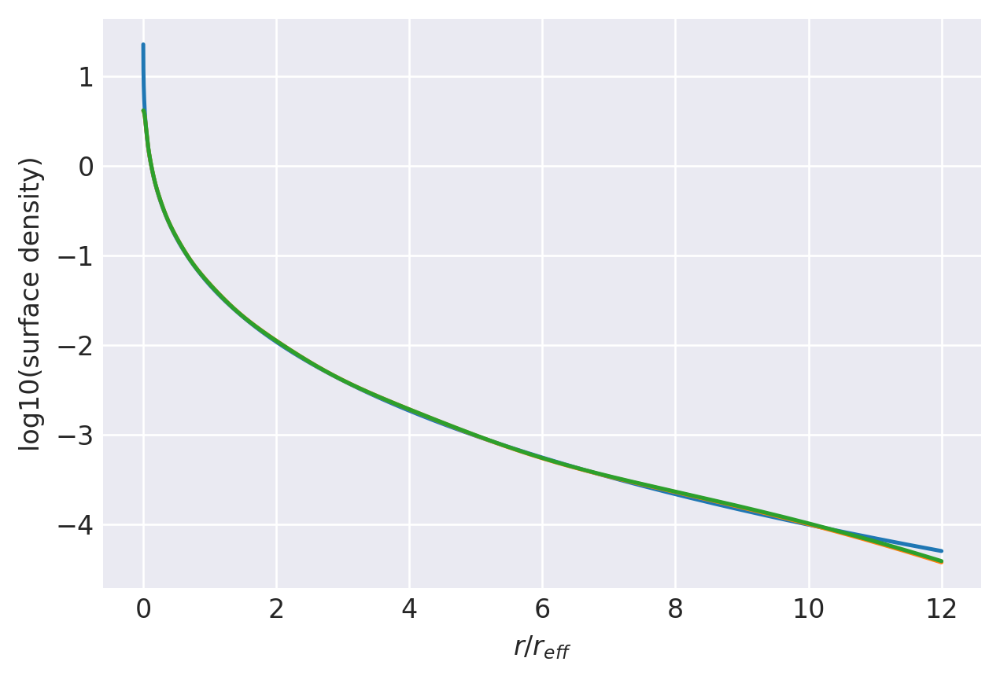

n=3.5986: (
    normalize(np.array([1.3151766132e-01, 2.0965606176e-01, 2.2748713931e-01, 1.8933207227e-01, 1.2727829754e-01, 7.0619296406e-02, 3.2273206570e-02, 1.1836264825e-02])),
    np.array([5.6117895850e+00, 2.4774492059e+00, 1.2339144389e+00, 6.3492975906e-01, 3.2733996944e-01, 1.6546380107e-01, 8.0106621192e-02, 3.5846419312e-02]),
),
[69, 24000]
0.9790635858713985 0.9944730493519828
prev.  chisq = -8.064094514618365
ws, re: (array([0.13151766, 0.20965606, 0.22748714, 0.18933207, 0.1272783 ,
       0.0706193 , 0.03227321, 0.01183626]), array([5.61178958, 2.47744921, 1.23391444, 0.63492976, 0.32733997,
       0.1654638 , 0.08010662, 0.03584642]))
         Current function value: -8.438530
         Iterations: 21
         Function evaluations: 1848
         Gradient evaluations: 108
-8.438530245555734 [-1.88142044 -1.15070834 -0.65021228 -0.25848788  0.08888836  0.45423468
  0.98603191  0.75176144  0.39592701  0.09293725 -0.19571169 -0.4832823
 -0.77904658 -1.09292786 -1.4398414

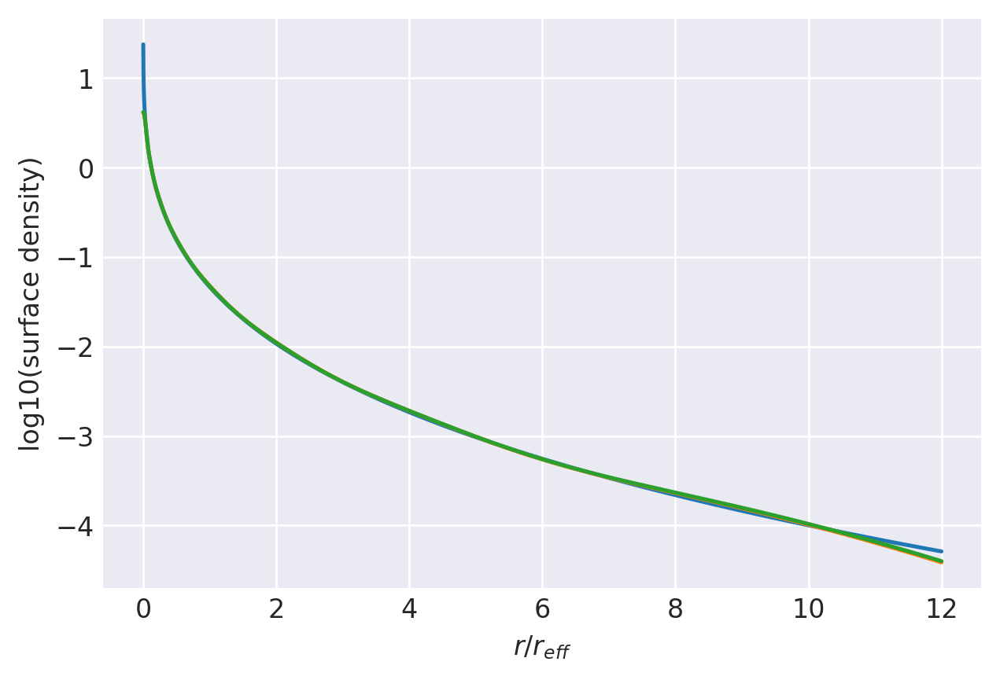

n=3.6447: (
    normalize(np.array([1.3222580377e-01, 2.0857796798e-01, 2.2606587608e-01, 1.8873025150e-01, 1.2762755793e-01, 7.1423411331e-02, 3.3027928362e-02, 1.2321203059e-02])),
    np.array([5.6462673455e+00, 2.4884390403e+00, 1.2386176037e+00, 6.3721840849e-01, 3.2863793760e-01, 1.6632342573e-01, 8.0736912620e-02, 3.6321059310e-02]),
),
[72, 24000]
0.9782648648572565 0.9942246587890402
prev.  chisq = -8.079297388175279
ws, re: (array([0.1322258 , 0.20857797, 0.22606588, 0.18873025, 0.12762756,
       0.07142341, 0.03302793, 0.0123212 ]), array([5.64626735, 2.48843904, 1.2386176 , 0.63721841, 0.32863794,
       0.16632343, 0.08073691, 0.03632106]))
Optimization terminated successfully.
         Current function value: -8.455834
         Iterations: 24
         Function evaluations: 561
         Gradient evaluations: 33
-8.455833862003628 [-1.87748877 -1.15921231 -0.66360961 -0.27462642  0.07069854  0.43440927
  0.96556243  0.75483587  0.39858433  0.09566736 -0.19271662 -0.4797359

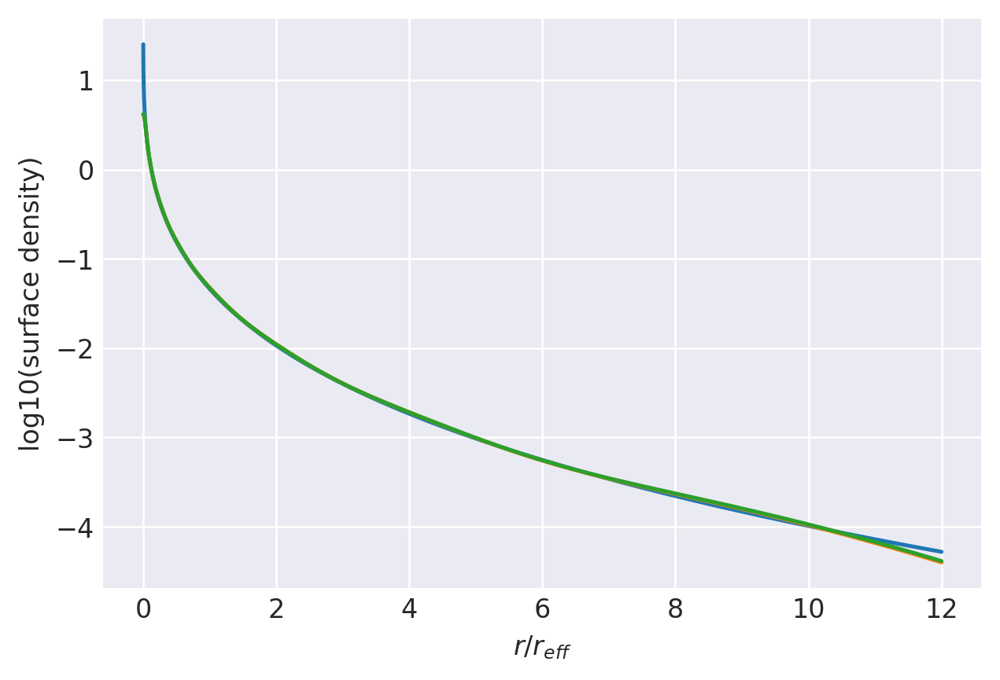

n=3.6914: (
    normalize(np.array([1.3267758456e-01, 2.0712564957e-01, 2.2442017772e-01, 1.8815598473e-01, 1.2818508342e-01, 7.2488530455e-02, 3.4000611299e-02, 1.2946378238e-02])),
    np.array([5.6863799027e+00, 2.5037117586e+00, 1.2464284794e+00, 6.4162810931e-01, 3.3133251485e-01, 1.6807680423e-01, 8.1921371278e-02, 3.7124418056e-02]),
),
[74, 24000]
0.9774489786460335 0.9939441400305746
prev.  chisq = -8.084175995235103
ws, re: (array([0.13267758, 0.20712565, 0.22442018, 0.18815598, 0.12818508,
       0.07248853, 0.03400061, 0.01294638]), array([5.6863799 , 2.50371176, 1.24642848, 0.64162811, 0.33133251,
       0.1680768 , 0.08192137, 0.03712442]))
         Current function value: -8.464211
         Iterations: 23
         Function evaluations: 1134
         Gradient evaluations: 66
-8.464211416578246 [-1.87123914 -1.16476662 -0.67381752 -0.28739471  0.05612892  0.41852459
  0.94929933  0.7574194   0.4004526   0.09728761 -0.19117312 -0.47803512
 -0.77227572 -1.08328692 -1.4248732

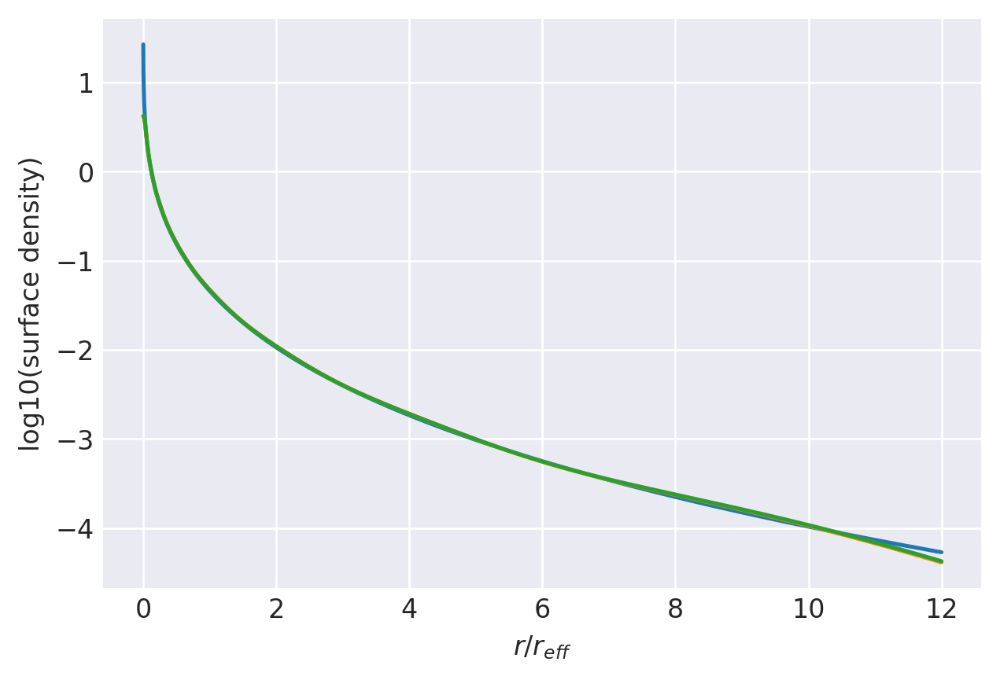

n=3.7387: (
    normalize(np.array([1.3339840897e-01, 2.0607980360e-01, 2.2302026803e-01, 1.8753144114e-01, 1.2849175596e-01, 7.3267238041e-02, 3.4758950112e-02, 1.3452134142e-02])),
    np.array([5.7203078318e+00, 2.5145055450e+00, 1.2510872959e+00, 6.4391253102e-01, 3.3263265568e-01, 1.6893680760e-01, 8.2549240519e-02, 3.7594715517e-02]),
),
[76, 24000]
0.9766161124970832 0.9936848278485211
prev.  chisq = -8.09193597961702
ws, re: (array([0.13339841, 0.2060798 , 0.22302027, 0.18753144, 0.12849176,
       0.07326724, 0.03475895, 0.01345213]), array([5.72030783, 2.51450554, 1.2510873 , 0.64391253, 0.33263266,
       0.16893681, 0.08254924, 0.03759472]))
         Current function value: -8.472717
         Iterations: 22
         Function evaluations: 1610
         Gradient evaluations: 94
-8.47271736822691 [-1.86499605 -1.17026585 -0.68394511 -0.3000592   0.04170183  0.40285181
  0.93334874  0.75996847  0.40229885  0.09889735 -0.18963255 -0.47633416
 -0.77006324 -1.0799942  -1.41948763]

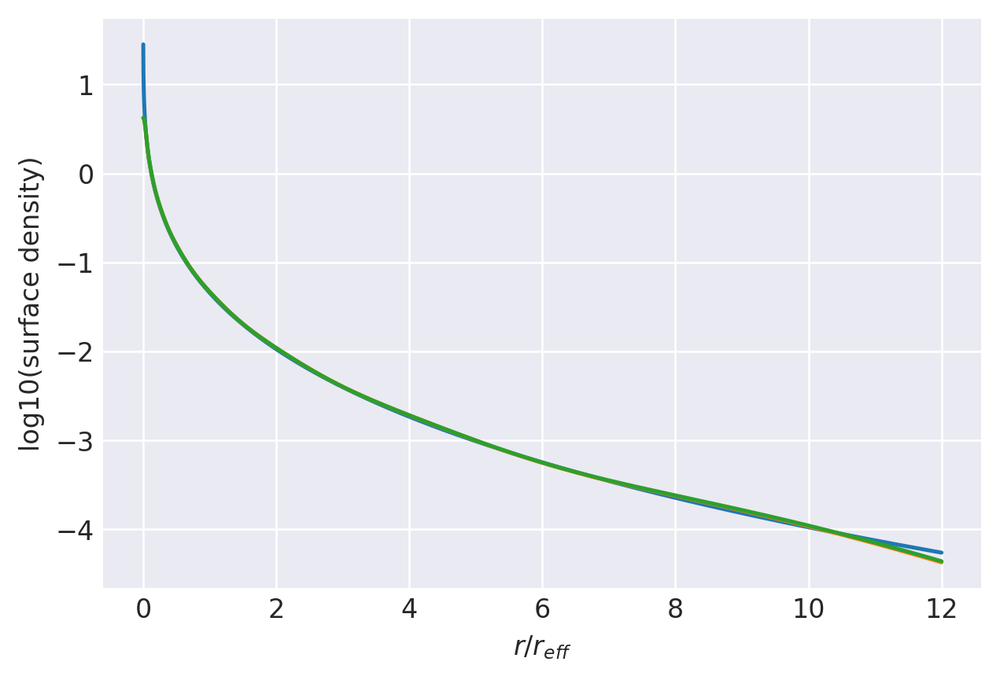

n=3.7866: (
    normalize(np.array([1.3412178418e-01, 2.0504596525e-01, 2.2163082144e-01, 1.8689909833e-01, 1.2878115121e-01, 7.4035216067e-02, 3.5518757046e-02, 1.3967206474e-02])),
    np.array([5.7539816090e+00, 2.5252178208e+00, 1.2557331372e+00, 6.4620073826e-01, 3.3393800120e-01, 1.6979963927e-01, 8.3177488082e-02, 3.8063820243e-02]),
),
[79, 24000]
0.9757664663823715 0.9934204705568389
prev.  chisq = -8.108171779817878
ws, re: (array([0.13412178, 0.20504597, 0.22163082, 0.1868991 , 0.12878115,
       0.07403522, 0.03551876, 0.01396721]), array([5.75398161, 2.52521782, 1.25573314, 0.64620074, 0.333938  ,
       0.16979964, 0.08317749, 0.03806382]))
         Current function value: -8.490060
         Iterations: 21
         Function evaluations: 1644
         Gradient evaluations: 96
-8.49005992848005 [-1.86085089 -1.17840219 -0.69691374 -0.31566609  0.02422527  0.38403817
  0.91431413  0.76291513  0.40485434  0.10155284 -0.18670121 -0.47286463
 -0.76563513 -1.07391667 -1.4105404 

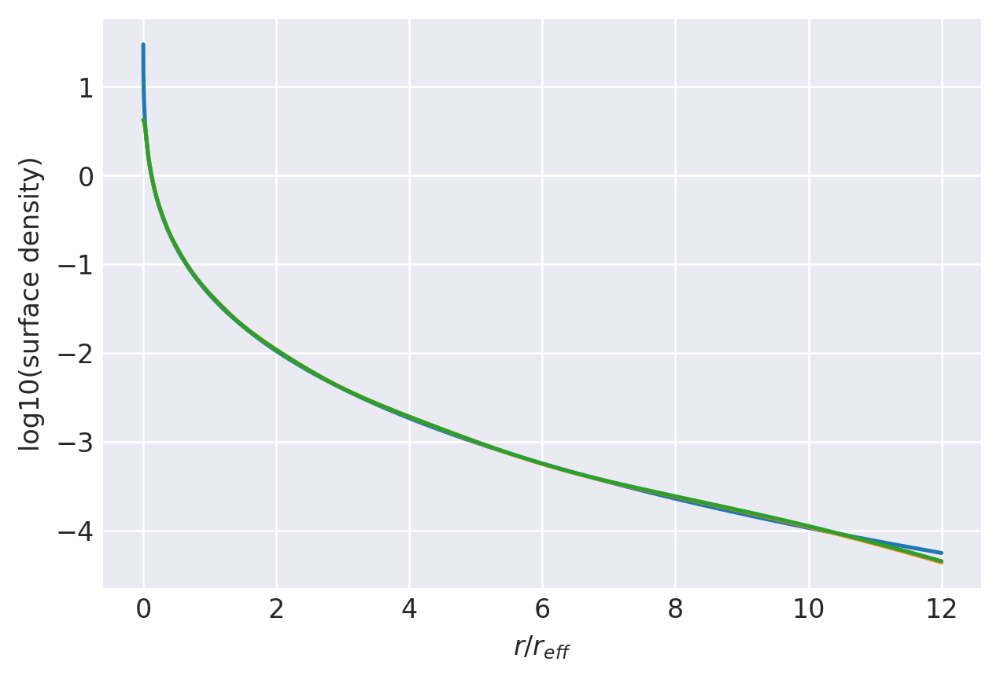

n=3.8351: (
    normalize(np.array([1.3460390431e-01, 2.0366197801e-01, 2.2002450686e-01, 1.8628321788e-01, 1.2926006384e-01, 7.5049623156e-02, 3.6491304263e-02, 1.4625401683e-02])),
    np.array([5.7931547698e+00, 2.5401206480e+00, 1.2634348228e+00, 6.5057712547e-01, 3.3661647319e-01, 1.7153978813e-01, 8.4349658956e-02, 3.8856134685e-02]),
),
[81, 24000]
0.9749002542704273 0.9931229664231866
prev.  chisq = -8.113882586803646
ws, re: (array([0.1346039 , 0.20366198, 0.22002451, 0.18628322, 0.12926006,
       0.07504962, 0.0364913 , 0.0146254 ]), array([5.79315477, 2.54012065, 1.26343482, 0.65057713, 0.33661647,
       0.17153979, 0.08434966, 0.03885613]))
         Current function value: -8.498751
         Iterations: 22
         Function evaluations: 1185
         Gradient evaluations: 69
-8.49875133308504 [-1.85457162 -1.18372712 -0.70681077 -0.32805219  0.01015869  0.36887004
  0.89907436  0.7653895   0.40664553  0.10312552 -0.18518728 -0.47118929
 -0.76346355 -1.07071362 -1.40537786

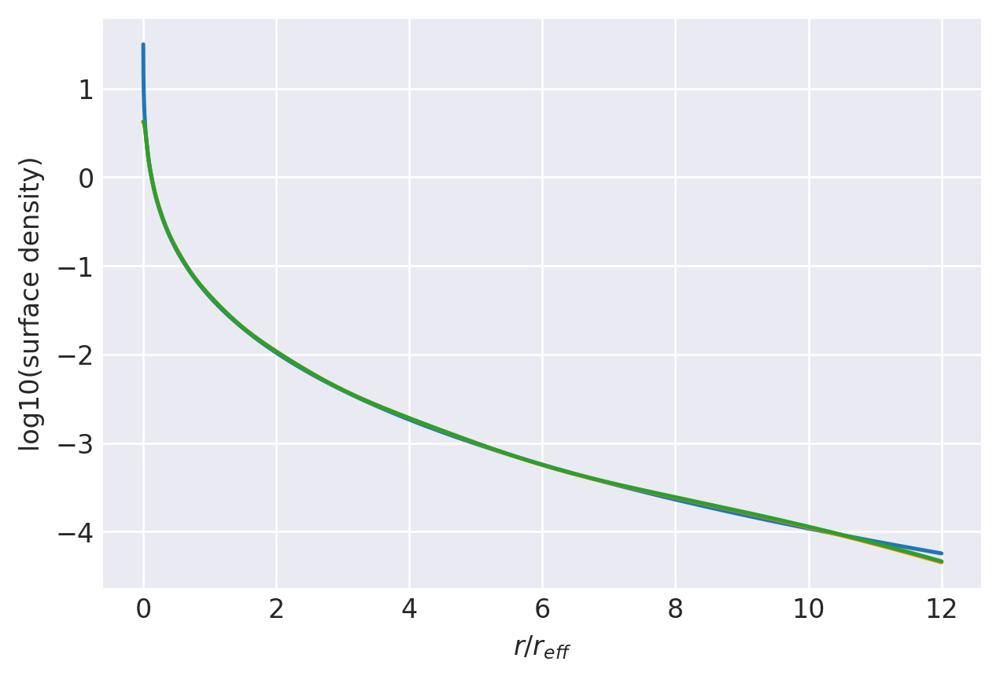

n=3.8842: (
    normalize(np.array([1.3533702971e-01, 2.0266205126e-01, 2.1866150286e-01, 1.8563269939e-01, 1.2950784355e-01, 7.5789367869e-02, 3.7250540544e-02, 1.5158964816e-02])),
    np.array([5.8262552007e+00, 2.5506186627e+00, 1.2680182839e+00, 6.5284896618e-01, 3.3791752114e-01, 1.7239967629e-01, 8.4974062843e-02, 3.9320781435e-02]),
),
[83, 24000]
0.9740159221038814 0.9928485272436366
prev.  chisq = -8.121517069215072
ws, re: (array([0.13533703, 0.20266205, 0.2186615 , 0.1856327 , 0.12950784,
       0.07578937, 0.03725054, 0.01515896]), array([5.8262552 , 2.55061866, 1.26801828, 0.65284897, 0.33791752,
       0.17239968, 0.08497406, 0.03932078]))
Optimization terminated successfully.
         Current function value: -8.507551
         Iterations: 23
         Function evaluations: 629
         Gradient evaluations: 37
-8.507551413837124 [-1.84830397 -1.18901804 -0.71665596 -0.3403588  -0.00378666  0.35388552
  0.88410135  0.7678359   0.40842064  0.10469425 -0.18366938 -0.4695077

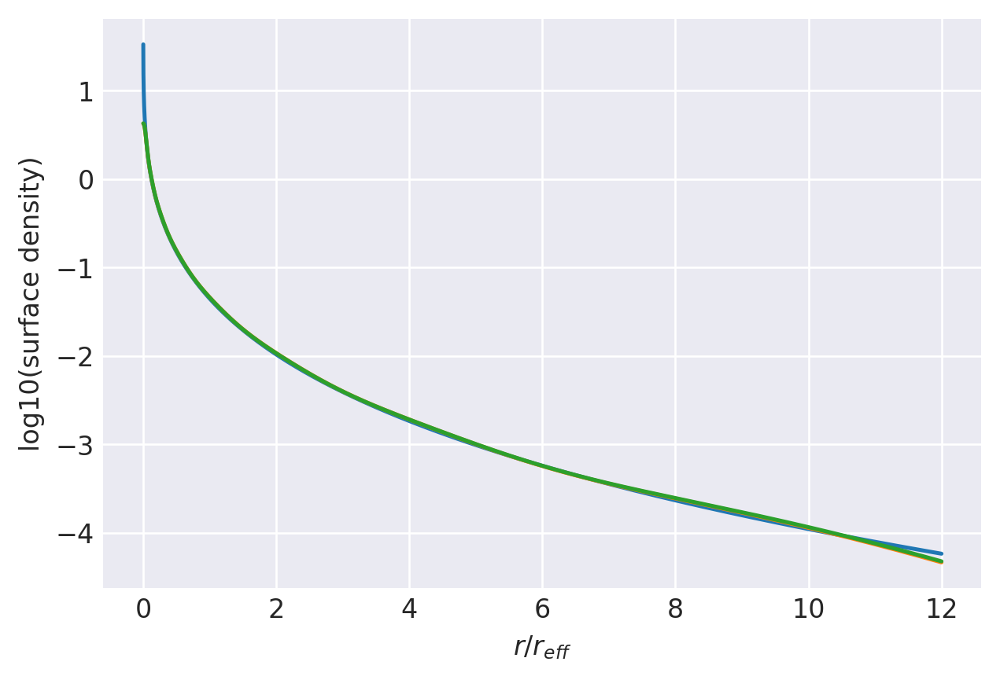

n=3.934: (
    normalize(np.array([1.3607215315e-01, 2.0167065554e-01, 2.1730631112e-01, 1.8497601363e-01, 1.2974132436e-01, 7.6519953644e-02, 3.8011570389e-02, 1.5702018164e-02])),
    np.array([5.8591672667e+00, 2.5610652165e+00, 1.2726068331e+00, 6.5513472252e-01, 3.3922844740e-01, 1.7326447046e-01, 8.5599813763e-02, 3.9784644711e-02]),
),
[86, 24000]
0.9728357135388462 0.9925688684333165
prev.  chisq = -7.984374645558908
ws, re: (array([0.13607215, 0.20167066, 0.21730631, 0.18497601, 0.12974132,
       0.07651995, 0.03801157, 0.01570202]), array([5.85916727, 2.56106522, 1.27260683, 0.65513472, 0.33922845,
       0.17326447, 0.08559981, 0.03978464]))
         Current function value: -8.522504
         Iterations: 21
         Function evaluations: 1338
         Gradient evaluations: 78
-8.522504473301947 [-1.84088126 -1.1968224  -0.73045501 -0.35738047 -0.02293897  0.33342442
  0.86378451  0.77114248  0.41097874  0.10712058 -0.18117301 -0.46665475
 -0.75763652 -1.0623644  -1.39241414

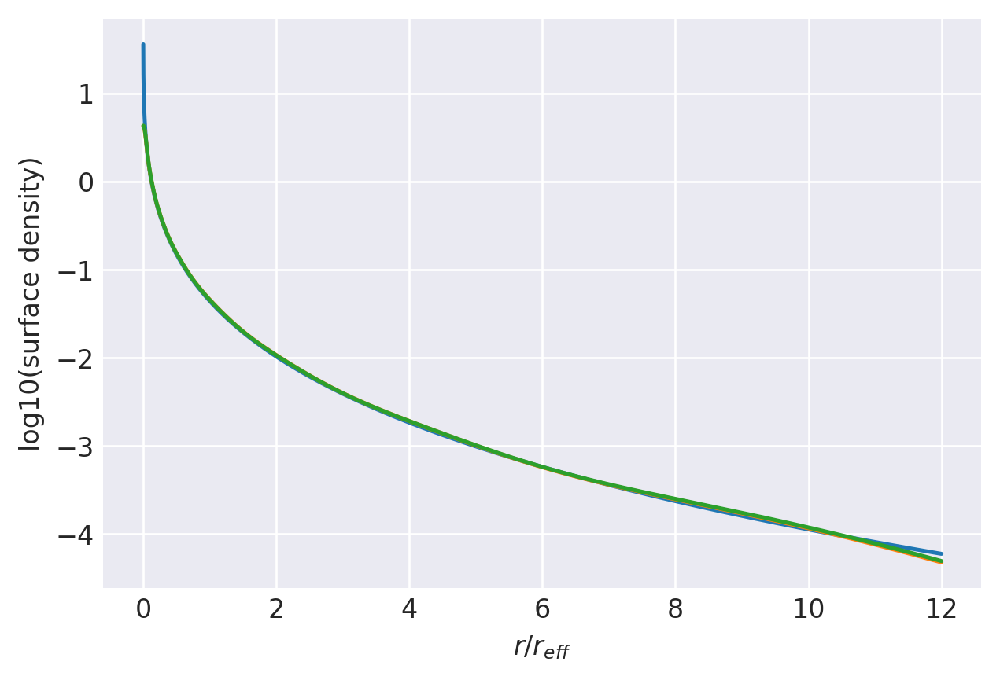

n=4.0: (
    normalize(np.array([1.3694710039e-01, 2.0026363685e-01, 2.1546940075e-01, 1.8411409448e-01, 1.3009353257e-01, 7.7550170771e-02, 3.9085175186e-02, 1.6476889008e-02])),
    np.array([5.9039474596e+00, 2.5761950499e+00, 1.2797365614e+00, 6.5891135101e-01, 3.4146425325e-01, 1.7472839096e-01, 8.6623475263e-02, 4.0512203337e-02]),
),
[89, 24000]
0.9719359419959794 0.992185132507814
prev.  chisq = -8.165157017935654
ws, re: (array([0.1369471 , 0.20026364, 0.2154694 , 0.18411409, 0.13009353,
       0.07755017, 0.03908518, 0.01647689]), array([5.90394746, 2.57619505, 1.27973656, 0.65891135, 0.34146425,
       0.17472839, 0.08662348, 0.0405122 ]))
         Current function value: -8.540102
         Iterations: 21
         Function evaluations: 1491
         Gradient evaluations: 87
-8.540102362703577 [-1.83672143 -1.20441824 -0.74267182 -0.37205762 -0.0392409   0.31615431
  0.84675374  0.77387923  0.4133809   0.10967004 -0.17832227 -0.4632706
 -0.75334763 -1.05657433 -1.38412223]
0.

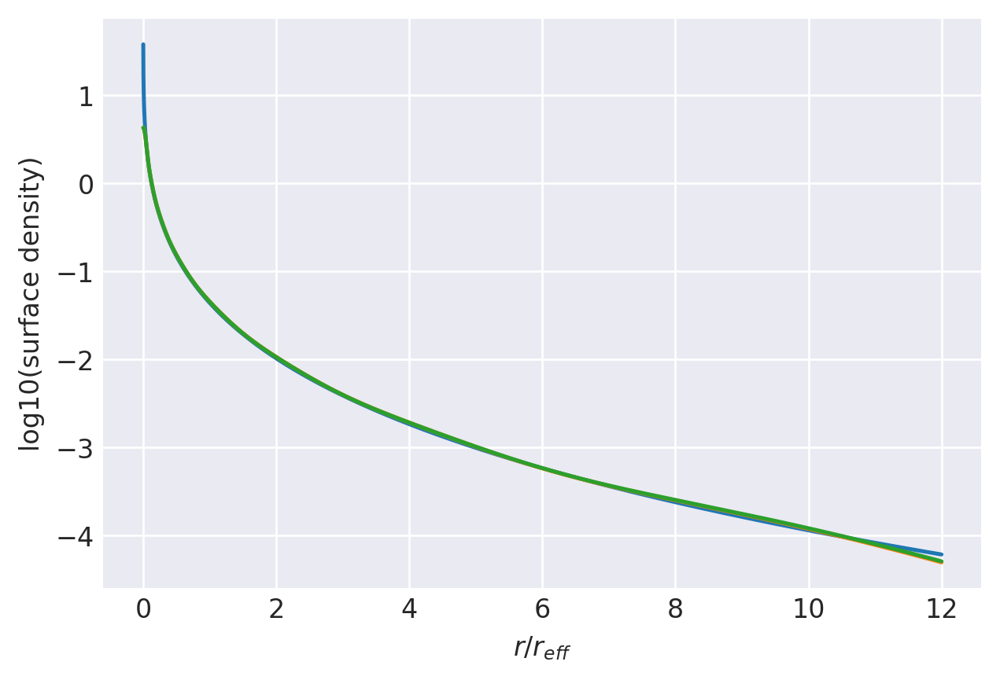

n=4.05: (
    normalize(np.array([1.3743950476e-01, 1.9898422617e-01, 2.1395037097e-01, 1.8346711521e-01, 1.3046864904e-01, 7.8481374567e-02, 4.0039593851e-02, 1.7169165422e-02])),
    np.array([5.9412691724e+00, 2.5904839075e+00, 1.2872711569e+00, 6.6325072090e-01, 3.4413544123e-01, 1.7646247656e-01, 8.7786083530e-02, 4.1293126645e-02]),
),
[91, 24000]
0.9710317334965136 0.9918706355676142
prev.  chisq = -8.177838984580056
ws, re: (array([0.1374395 , 0.19898423, 0.21395037, 0.18346712, 0.13046865,
       0.07848137, 0.04003959, 0.01716917]), array([5.94126917, 2.59048391, 1.28727116, 0.66325072, 0.34413544,
       0.17646248, 0.08778608, 0.04129313]))
         Current function value: -8.549470
         Iterations: 22
         Function evaluations: 1287
         Gradient evaluations: 75
-8.549469768264057 [-1.8308141  -1.20947165 -0.75204198 -0.38372267 -0.05236523  0.30221627
  0.83308649  0.77616079  0.41506752  0.11121095 -0.17678852 -0.46155086
 -0.75114503 -1.0534243  -1.3792611 ]

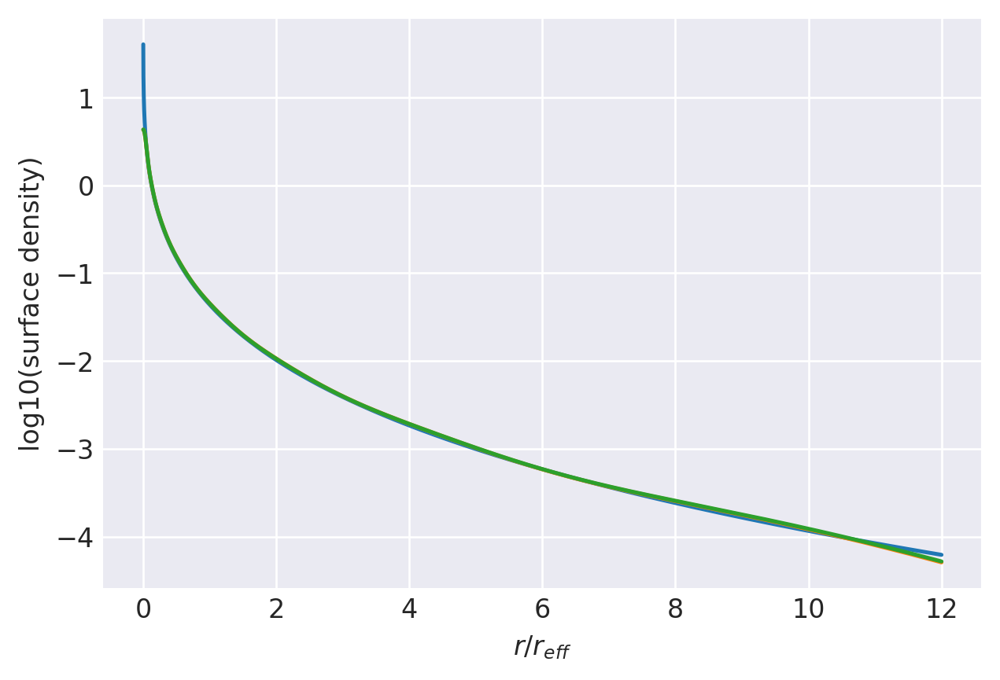

n=4.1: (
    normalize(np.array([1.3814131915e-01, 1.9805042716e-01, 2.1266858195e-01, 1.8281503598e-01, 1.3065039974e-01, 7.9160512254e-02, 4.0784484191e-02, 1.7729239569e-02])),
    np.array([5.9725637488e+00, 2.6005638338e+00, 1.2918465979e+00, 6.6559718348e-01, 3.4550086819e-01, 1.7735970924e-01, 8.8425129083e-02, 4.1757924234e-02]),
),
[93, 24000]
0.9701234808353916 0.9915840172460544
prev.  chisq = -8.193392140700997
ws, re: (array([0.13814132, 0.19805043, 0.21266858, 0.18281504, 0.1306504 ,
       0.07916051, 0.04078448, 0.01772924]), array([5.97256375, 2.60056383, 1.2918466 , 0.66559718, 0.34550087,
       0.17735971, 0.08842513, 0.04175792]))
         Current function value: -8.559017
         Iterations: 21
         Function evaluations: 1661
         Gradient evaluations: 97
-8.5590170564736 [-1.8250418  -1.21446546 -0.76127472 -0.39520219 -0.06525747  0.28857397
  0.81976256  0.77839697  0.41673176  0.11274571 -0.17524881 -0.45981815
 -0.74893102 -1.05027854 -1.37444743]
0.

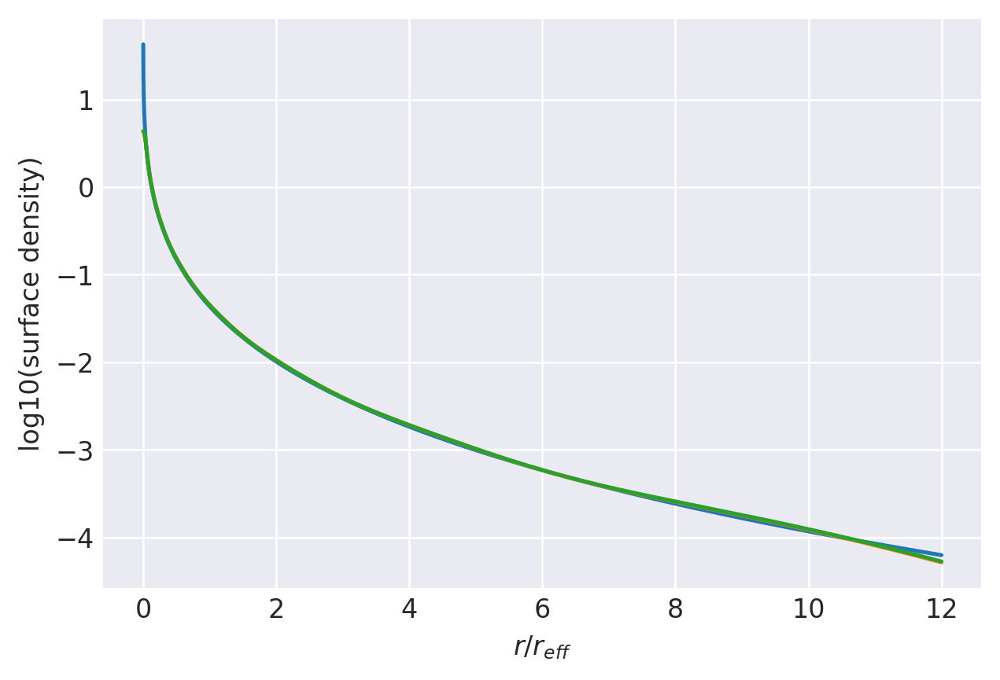

n=4.15: (
    normalize(np.array([1.3882999623e-01, 1.9713205616e-01, 2.1140947850e-01, 1.8216739252e-01, 1.3081970225e-01, 7.9825570057e-02, 4.1523290028e-02, 1.8292514263e-02])),
    np.array([6.0033957235e+00, 2.6105484564e+00, 1.2964199751e+00, 6.6796112562e-01, 3.4688206829e-01, 1.7826618959e-01, 8.9067950104e-02, 4.2223338235e-02]),
),
[95, 24000]
0.9692115606886255 0.9912960728964483
prev.  chisq = -8.209017839745254
ws, re: (array([0.13883   , 0.19713206, 0.21140948, 0.18216739, 0.1308197 ,
       0.07982557, 0.04152329, 0.01829251]), array([6.00339572, 2.61054846, 1.29641998, 0.66796113, 0.34688207,
       0.17826619, 0.08906795, 0.04222334]))
         Current function value: -8.568733
         Iterations: 21
         Function evaluations: 1559
         Gradient evaluations: 91
-8.568732904641308 [-1.81939415 -1.21940574 -0.77038357 -0.40651007 -0.07793083  0.27520107
  0.80676555  0.78058878  0.41837381  0.11427608 -0.17370025 -0.458069
 -0.7467006  -1.04713039 -1.36967635]
0

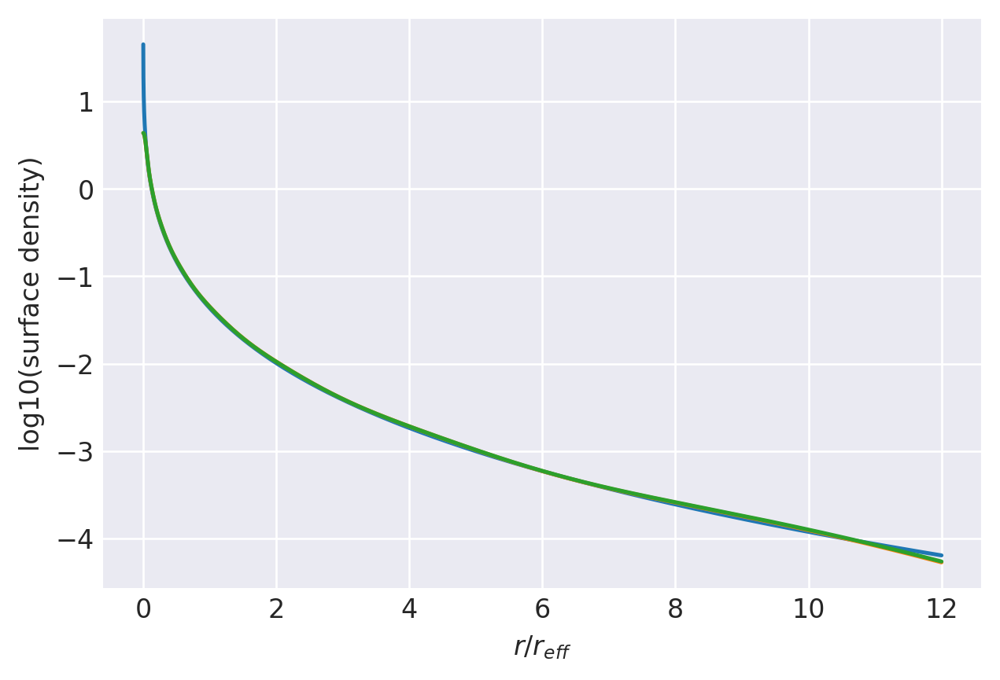

n=4.2: (
    normalize(np.array([1.3950658612e-01, 1.9622781819e-01, 2.1017106965e-01, 1.8152393997e-01, 1.3097756596e-01, 8.0477127567e-02, 4.2256740284e-02, 1.8859152272e-02])),
    np.array([6.0337703820e+00, 2.6204375407e+00, 1.3009963488e+00, 6.7034711996e-01, 3.4828197221e-01, 1.7918406963e-01, 8.9715939716e-02, 4.2689753775e-02]),
),
[97, 24000]
0.9682963340864905 0.9910069601675771
prev.  chisq = -8.224708865105391
ws, re: (array([0.13950659, 0.19622782, 0.21017107, 0.18152394, 0.13097757,
       0.08047713, 0.04225674, 0.01885915]), array([6.03377038, 2.62043754, 1.30099635, 0.67034712, 0.34828197,
       0.17918407, 0.08971594, 0.04268975]))
         Current function value: -8.578607
         Iterations: 21
         Function evaluations: 1117
         Gradient evaluations: 65
-8.578606669397432 [-1.81386854 -1.22428993 -0.77936566 -0.41764472 -0.09038592  0.26209782
  0.79408663  0.78273792  0.41999436  0.11580113 -0.17214499 -0.45630643
 -0.74445771 -1.04398409 -1.36494931]


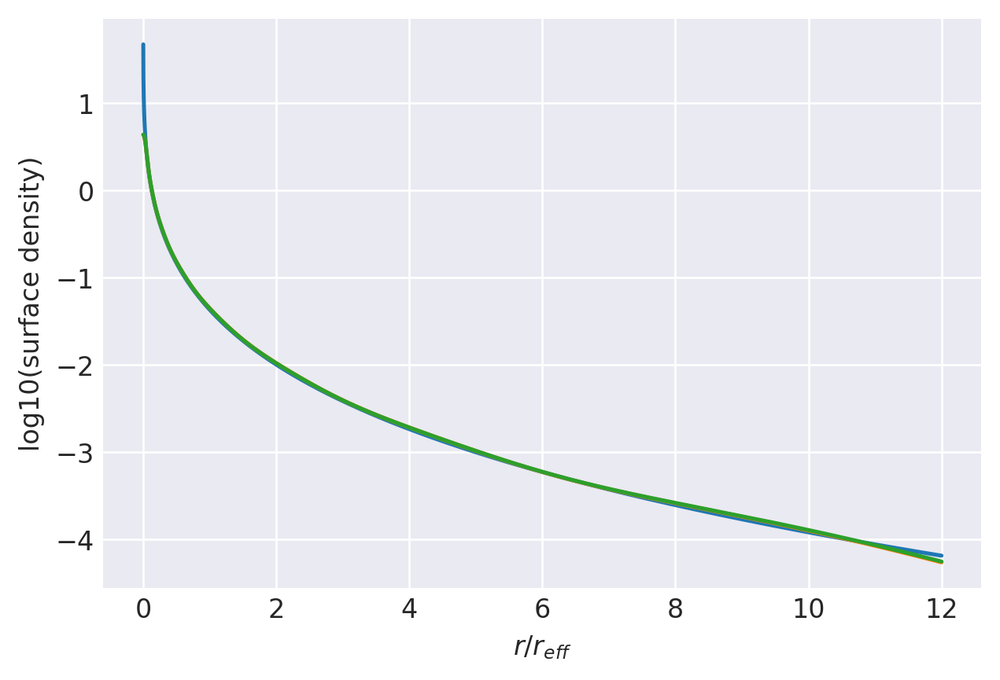

n=4.25: (
    normalize(np.array([1.4017122740e-01, 1.9533795046e-01, 2.0895353597e-01, 1.8088496665e-01, 1.3112420572e-01, 8.1115188128e-02, 4.2984289685e-02, 1.9428635998e-02])),
    np.array([6.0637029897e+00, 2.6302338315e+00, 1.3055729160e+00, 6.7275202416e-01, 3.4969833584e-01, 1.8011185298e-01, 9.0368258830e-02, 4.3156944632e-02]),
),
[100, 24000]
0.9673781468920812 0.9907168017482993
prev.  chisq = -8.24891780759786
ws, re: (array([0.14017123, 0.19533795, 0.20895354, 0.18088497, 0.13112421,
       0.08111519, 0.04298429, 0.01942864]), array([6.06370299, 2.63023383, 1.30557292, 0.67275202, 0.34969834,
       0.18011185, 0.09036826, 0.04315694]))
         Current function value: -8.596649
         Iterations: 23
         Function evaluations: 1627
         Gradient evaluations: 95
-8.596649327765583 [-1.81006688 -1.23134501 -0.79068294 -0.43116341 -0.10525227  0.24661181
  0.77919665  0.78522339  0.42223849  0.11826442 -0.16933417 -0.45295048
 -0.7402386  -1.03840241 -1.35720767]

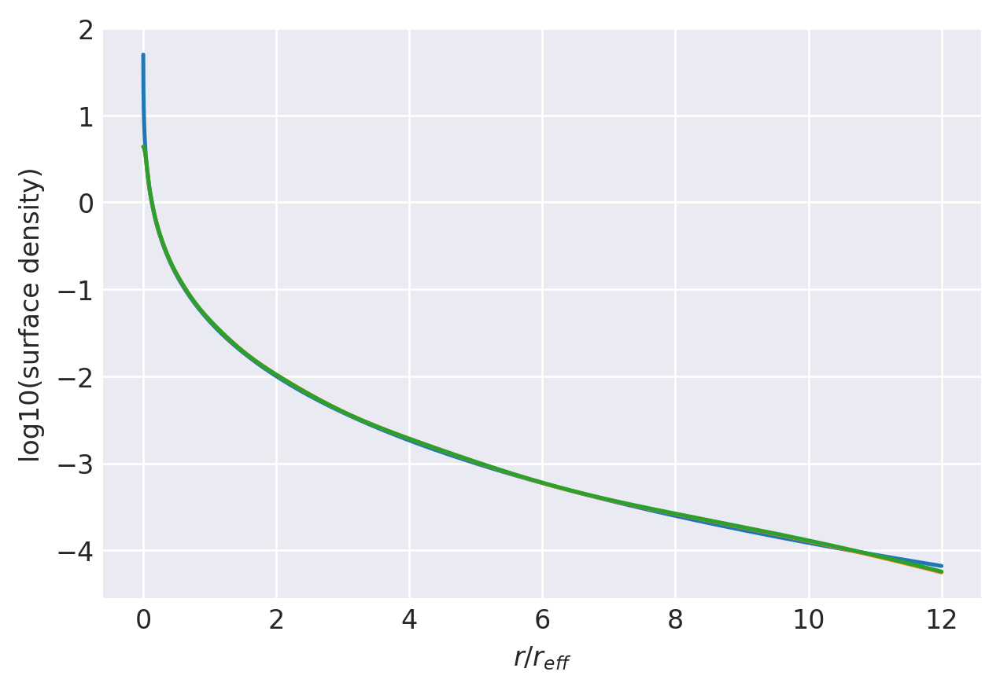

n=4.3: (
    normalize(np.array([1.4063004265e-01, 1.9417129368e-01, 2.0755664940e-01, 1.8024164582e-01, 1.3140766034e-01, 8.1951893613e-02, 4.3900423228e-02, 2.0140391261e-02])),
    np.array([6.0985050124e+00, 2.6438602450e+00, 1.3129990707e+00, 6.7712028743e-01, 3.5241104884e-01, 1.8187014046e-01, 9.1537193370e-02, 4.3933148878e-02]),
),
[102, 24000]
0.9664573302820763 0.9903941619247731
prev.  chisq = -8.261901513908713
ws, re: (array([0.14063004, 0.19417129, 0.20755665, 0.18024165, 0.13140766,
       0.08195189, 0.04390042, 0.02014039]), array([6.09850501, 2.64386025, 1.31299907, 0.67712029, 0.35241105,
       0.18187014, 0.09153719, 0.04393315]))
         Current function value: -8.606754
         Iterations: 21
         Function evaluations: 1746
         Gradient evaluations: 102
-8.606753702047998 [-1.80473101 -1.23607222 -0.79937345 -0.44191099 -0.11722173  0.23409526
  0.76718881  0.78728662  0.42380958  0.1197676  -0.16778132 -0.45118321
 -0.73800072 -1.03529805 -1.35261616

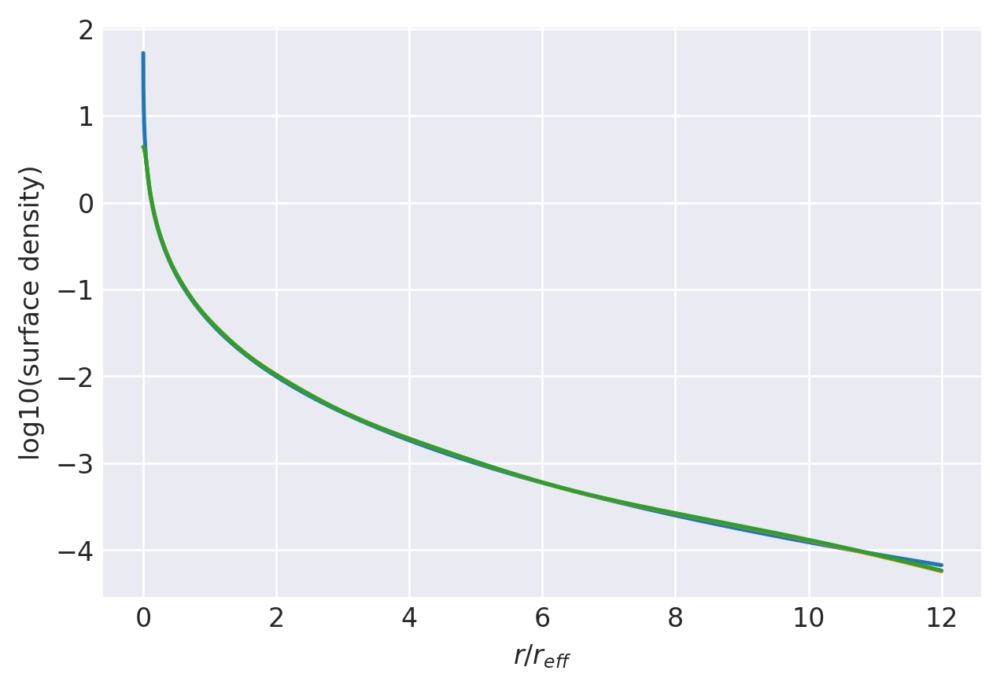

n=4.35: (
    normalize(np.array([1.4127613791e-01, 1.9331626970e-01, 2.0638252545e-01, 1.7960995091e-01, 1.3152854061e-01, 8.2558865236e-02, 4.4613107558e-02, 2.0714602629e-02])),
    np.array([6.1275466314e+00, 2.6534418776e+00, 1.3175514965e+00, 6.7954571272e-01, 3.5384803887e-01, 1.8280972020e-01, 9.2193848990e-02, 4.4400088457e-02]),
),
[104, 24000]
0.9655342012270172 0.9901019721318188
prev.  chisq = -8.277758366899358
ws, re: (array([0.14127614, 0.19331627, 0.20638253, 0.17960995, 0.13152854,
       0.08255887, 0.04461311, 0.0207146 ]), array([6.12754663, 2.65344188, 1.3175515 , 0.67954571, 0.35384804,
       0.18280972, 0.09219385, 0.04440009]))
         Current function value: -8.616988
         Iterations: 21
         Function evaluations: 1592
         Gradient evaluations: 93
-8.616988469713718 [-1.79950706 -1.24074803 -0.80794562 -0.45249992 -0.12899855  0.22181817
  0.75546749  0.78931185  0.42536168  0.12126645 -0.16622202 -0.44940251
 -0.73574921 -1.03219349 -1.34806358

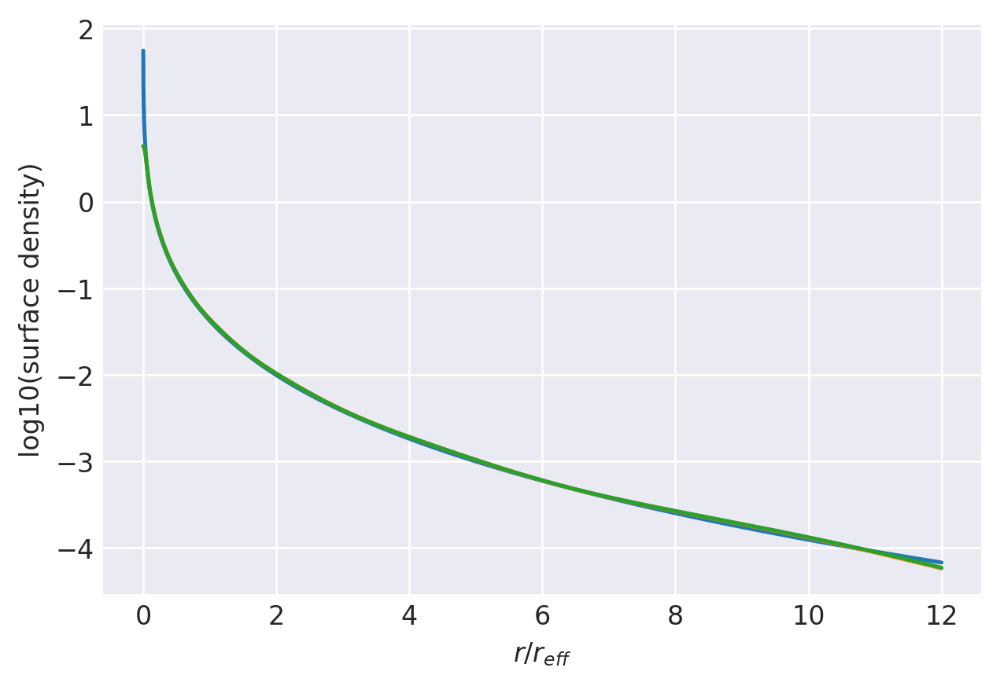

n=4.4: (
    normalize(np.array([1.4191108091e-01, 1.9247432817e-01, 2.0522791147e-01, 1.7898294225e-01, 1.3163926377e-01, 8.3153470661e-02, 4.5320052670e-02, 2.1290950107e-02])),
    np.array([6.1561876051e+00, 2.6629418326e+00, 1.3221065389e+00, 6.8198995559e-01, 3.5530187053e-01, 1.8375991837e-01, 9.2855259694e-02, 4.4867969482e-02]),
),
[106, 24000]
0.9646090629688167 0.9898090561970282
prev.  chisq = -8.293661910066326
ws, re: (array([0.14191108, 0.19247433, 0.20522791, 0.17898294, 0.13163926,
       0.08315347, 0.04532005, 0.02129095]), array([6.15618761, 2.66294183, 1.32210654, 0.68198996, 0.35530187,
       0.18375992, 0.09285526, 0.04486797]))
         Current function value: -8.627345
         Iterations: 21
         Function evaluations: 1491
         Gradient evaluations: 87
-8.627345270834343 [-1.79439101 -1.24536757 -0.81639618 -0.46292538 -0.14057291  0.20978537
  0.74402368  0.79130011  0.42689462  0.12275932 -0.16465906 -0.4476131
 -0.73349079 -1.02909533 -1.34355301]


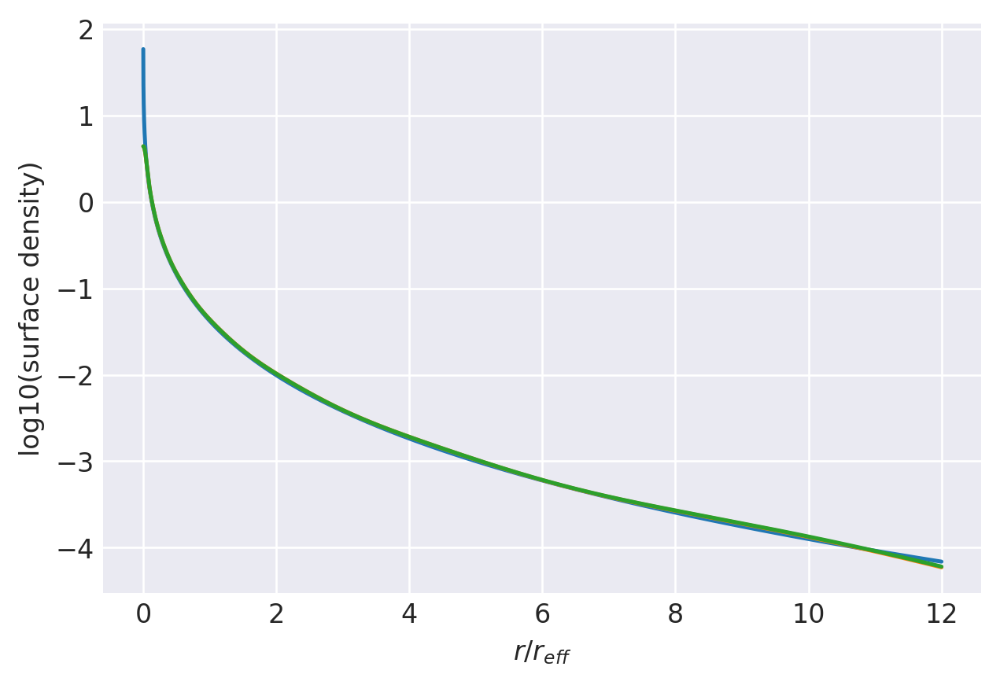

n=4.45: (
    normalize(np.array([1.4253521569e-01, 1.9164600728e-01, 2.0409288793e-01, 1.7836105059e-01, 1.3174043098e-01, 8.3735312884e-02, 4.6020326633e-02, 2.1868768030e-02])),
    np.array([6.1844361756e+00, 2.6723578935e+00, 1.3266590243e+00, 6.8444875649e-01, 3.5676882766e-01, 1.8471799718e-01, 9.3520037749e-02, 4.5336396183e-02]),
),
[108, 24000]
0.9636822054935538 0.9895155376471049
prev.  chisq = -8.30959648561702
ws, re: (array([0.14253522, 0.19164601, 0.20409289, 0.17836105, 0.13174043,
       0.08373531, 0.04602033, 0.02186877]), array([6.18443618, 2.67235789, 1.32665902, 0.68444876, 0.35676883,
       0.184718  , 0.09352004, 0.0453364 ]))
         Current function value: -8.637816
         Iterations: 23
         Function evaluations: 817
         Gradient evaluations: 48
-8.63781622558108 [-1.78937708 -1.24993052 -0.82472768 -0.47319071 -0.15194925  0.19798953
  0.73284718  0.7932522   0.42840837  0.12424584 -0.163093   -0.44581578
 -0.73122625 -1.02600393 -1.33908366]
0

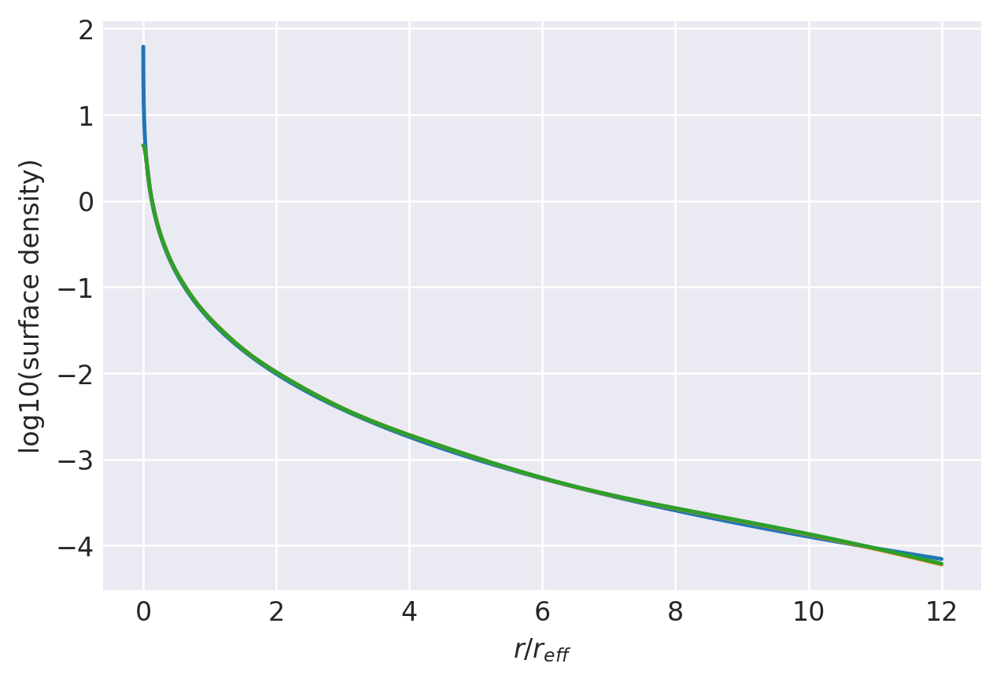

n=4.5: (
    normalize(np.array([1.4314911194e-01, 1.9083111773e-01, 2.0297686990e-01, 1.7774426074e-01, 1.3183239565e-01, 8.4304582286e-02, 4.6713844304e-02, 2.2447817442e-02])),
    np.array([6.2122968365e+00, 2.6816887224e+00, 1.3312077455e+00, 6.8692132558e-01, 3.5824836903e-01, 1.8568368595e-01, 9.4188107662e-02, 4.5805364407e-02]),
),
[110, 24000]
0.9627539059979556 0.9892215478216109
prev.  chisq = -8.325557354927748
ws, re: (array([0.14314911, 0.19083112, 0.20297687, 0.17774426, 0.1318324 ,
       0.08430458, 0.04671384, 0.02244782]), array([6.21229684, 2.68168872, 1.33120775, 0.68692133, 0.35824837,
       0.18568369, 0.09418811, 0.04580536]))
         Current function value: -8.648394
         Iterations: 22
         Function evaluations: 1746
         Gradient evaluations: 102
-8.648393902142713 [-1.78446661 -1.25444243 -0.83294219 -0.48329959 -0.1631321   0.18642912
  0.72193297  0.79517036  0.42990523  0.12572769 -0.16152303 -0.44401002
 -0.72895585 -1.02292022 -1.33465503

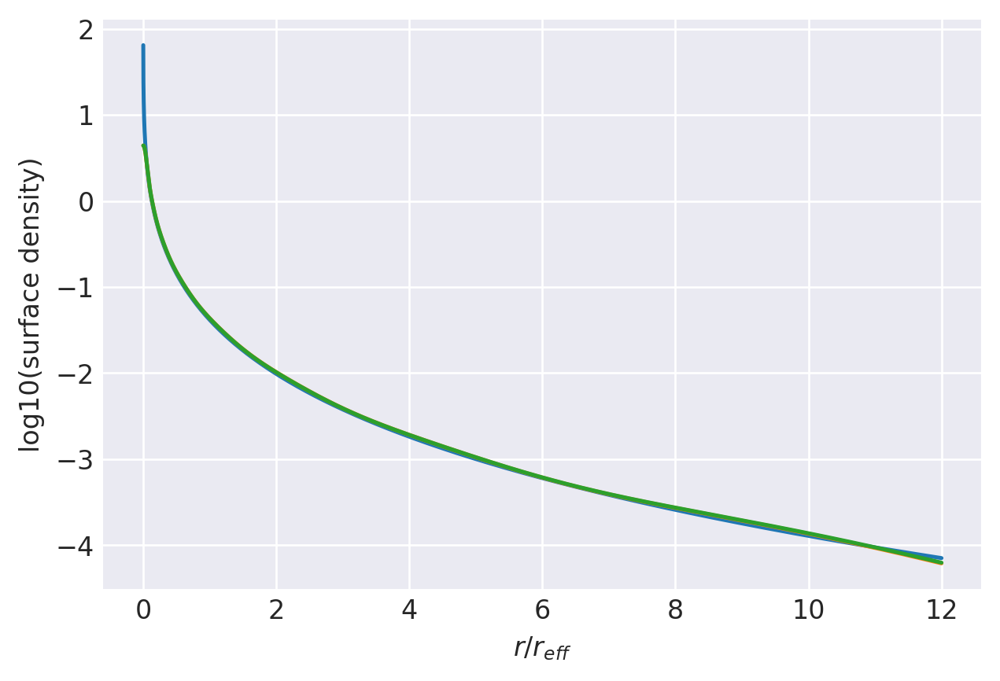

n=4.55: (
    normalize(np.array([1.4375247357e-01, 1.9002879414e-01, 2.0187981109e-01, 1.7713289096e-01, 1.3191579104e-01, 8.4861885438e-02, 4.7400572989e-02, 2.3027780780e-02])),
    np.array([6.2397955765e+00, 2.6909475208e+00, 1.3357577159e+00, 6.8940904135e-01, 3.5974103450e-01, 1.8665694400e-01, 9.4859269505e-02, 4.6274845222e-02]),
),
[112, 24000]
0.9618244293482081 0.9889270806533339
prev.  chisq = -8.341543857360385
ws, re: (array([0.14375247, 0.19002879, 0.20187981, 0.17713289, 0.13191579,
       0.08486189, 0.04740057, 0.02302778]), array([6.23979558, 2.69094752, 1.33575772, 0.68940904, 0.35974103,
       0.18665694, 0.09485927, 0.04627485]))
         Current function value: -8.659071
         Iterations: 22
         Function evaluations: 681
         Gradient evaluations: 40
-8.659071283837964 [-1.77964266 -1.25888692 -0.84103851 -0.49325003 -0.17412207  0.17508674
  0.71126397  0.7970526   0.4313803   0.12719938 -0.15995405 -0.44220129
 -0.72668338 -1.01984517 -1.33026752]

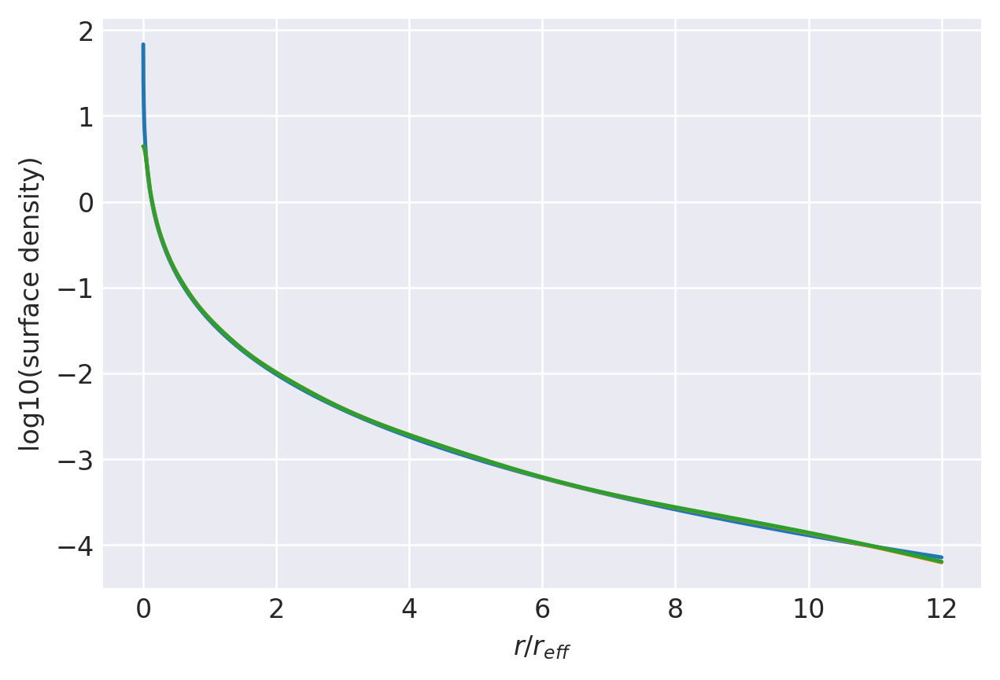

n=4.6: (
    normalize(np.array([1.4434726407e-01, 1.8924091822e-01, 2.0080061437e-01, 1.7652635766e-01, 1.3199010761e-01, 8.5406157681e-02, 4.8080125047e-02, 2.3608455343e-02])),
    np.array([6.2668976804e+00, 2.7001028174e+00, 1.3402918635e+00, 6.9190417294e-01, 3.6124239088e-01, 1.8763619437e-01, 9.5533311273e-02, 4.6744711397e-02]),
),
[114, 24000]
0.9608940285300022 0.9886324989262377
prev.  chisq = -8.35753384113209
ws, re: (array([0.14434726, 0.18924092, 0.20080061, 0.17652636, 0.13199011,
       0.08540616, 0.04808013, 0.02360846]), array([6.26689768, 2.70010282, 1.34029186, 0.69190417, 0.36124239,
       0.18763619, 0.09553331, 0.04674471]))
         Current function value: -8.669842
         Iterations: 21
         Function evaluations: 1576
         Gradient evaluations: 92
-8.669841750747658 [-1.77491553 -1.26328043 -0.84902063 -0.50304888 -0.18492585  0.16396883
  0.7008414   0.79890308  0.43283933  0.12866612 -0.15838231 -0.44038587
 -0.72440706 -1.01677936 -1.32591993]


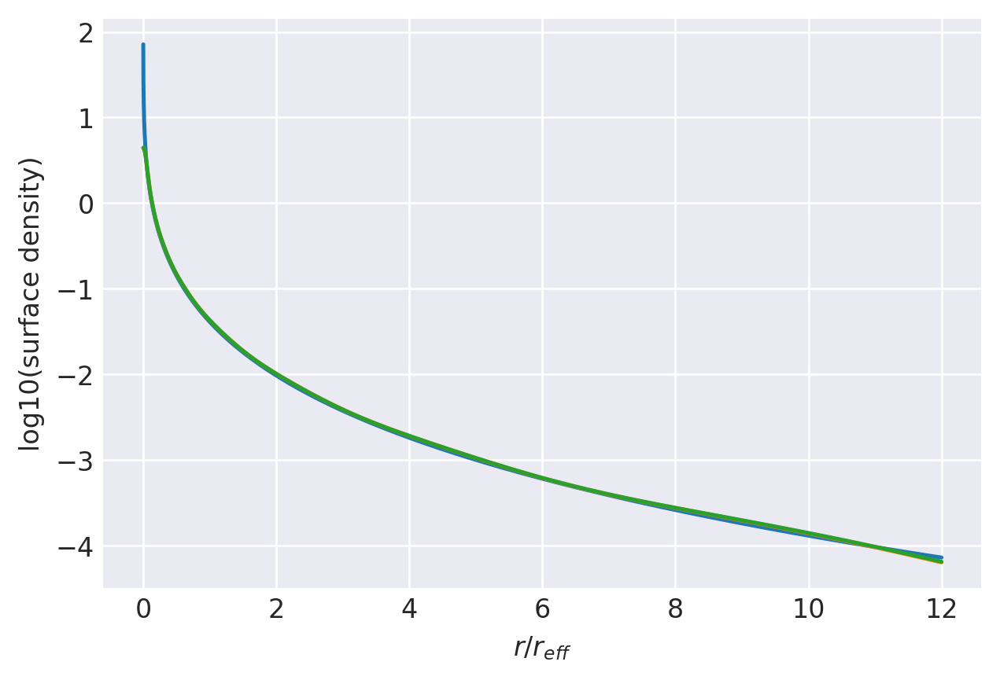

n=4.65: (
    normalize(np.array([1.4493209962e-01, 1.8846526130e-01, 1.9973970968e-01, 1.7592536106e-01, 1.3205651551e-01, 8.5938858771e-02, 4.8752687460e-02, 2.4189506595e-02])),
    np.array([6.2936571746e+00, 2.7091891886e+00, 1.3448260611e+00, 6.9441276088e-01, 3.6275560157e-01, 1.8862225705e-01, 9.6210094782e-02, 4.7215008544e-02]),
),
[116, 24000]
0.959962945088921 0.9883376067561964
prev.  chisq = -8.37353976221658
ws, re: (array([0.1449321 , 0.18846526, 0.19973971, 0.17592536, 0.13205652,
       0.08593886, 0.04875269, 0.02418951]), array([6.29365717, 2.70918919, 1.34482606, 0.69441276, 0.3627556 ,
       0.18862226, 0.09621009, 0.04721501]))
         Current function value: -8.680699
         Iterations: 20
         Function evaluations: 1422
         Gradient evaluations: 83
-8.680699046718171 [-1.77027745 -1.26761727 -0.85688898 -0.51269701 -0.19554635  0.15306606
  0.69065441  0.80072174  0.43428087  0.13012589 -0.15680986 -0.43856612
 -0.72212871 -1.0137235  -1.321612  ]


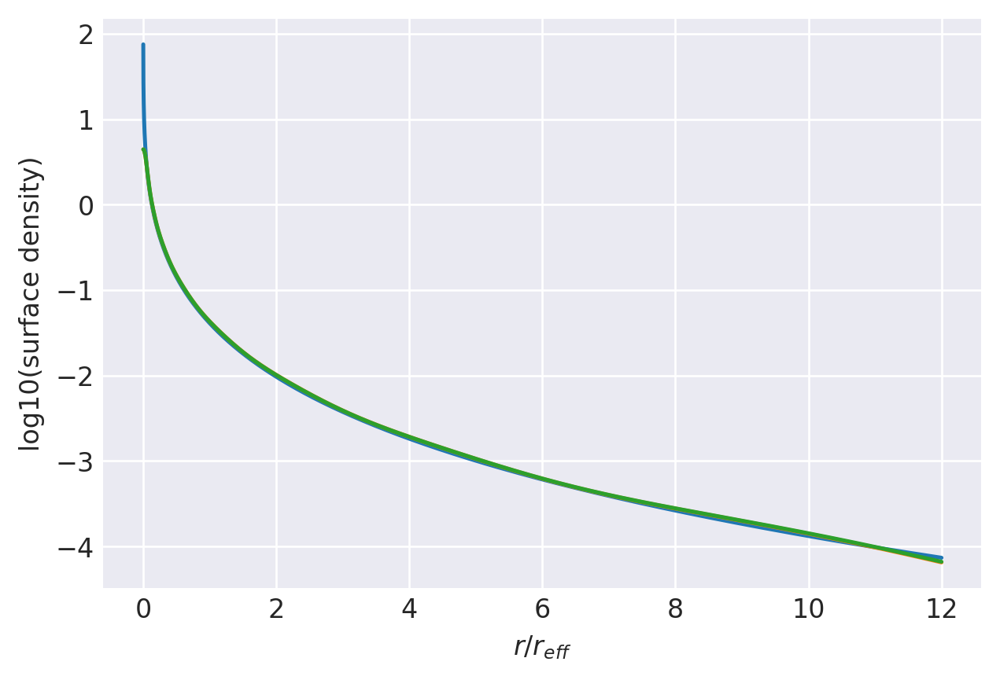

n=4.7: (
    normalize(np.array([1.4550782913e-01, 1.8770237251e-01, 1.9869651560e-01, 1.7532972000e-01, 1.3211500208e-01, 8.6459766553e-02, 4.9418082274e-02, 2.4770711849e-02])),
    np.array([6.3200678213e+00, 2.7181966089e+00, 1.3493539676e+00, 6.9693157531e-01, 3.6427878302e-01, 1.8961438874e-01, 9.6889453185e-02, 4.7685681810e-02]),
),
[118, 24000]
0.9590314095604598 0.9880425762340662
prev.  chisq = -8.389552984725649
ws, re: (array([0.14550783, 0.18770237, 0.19869652, 0.17532972, 0.132115  ,
       0.08645977, 0.04941808, 0.02477071]), array([6.32006782, 2.71819661, 1.34935397, 0.69693158, 0.36427878,
       0.18961439, 0.09688945, 0.04768568]))
Optimization terminated successfully.
         Current function value: -8.691637
         Iterations: 21
         Function evaluations: 646
         Gradient evaluations: 38
-8.691637260783022 [-1.7657254  -1.27189813 -0.86464493 -0.52219654 -0.20598658  0.1423736
  0.68069683  0.80250956  0.43570538  0.13157871 -0.15523715 -0.43674287
 

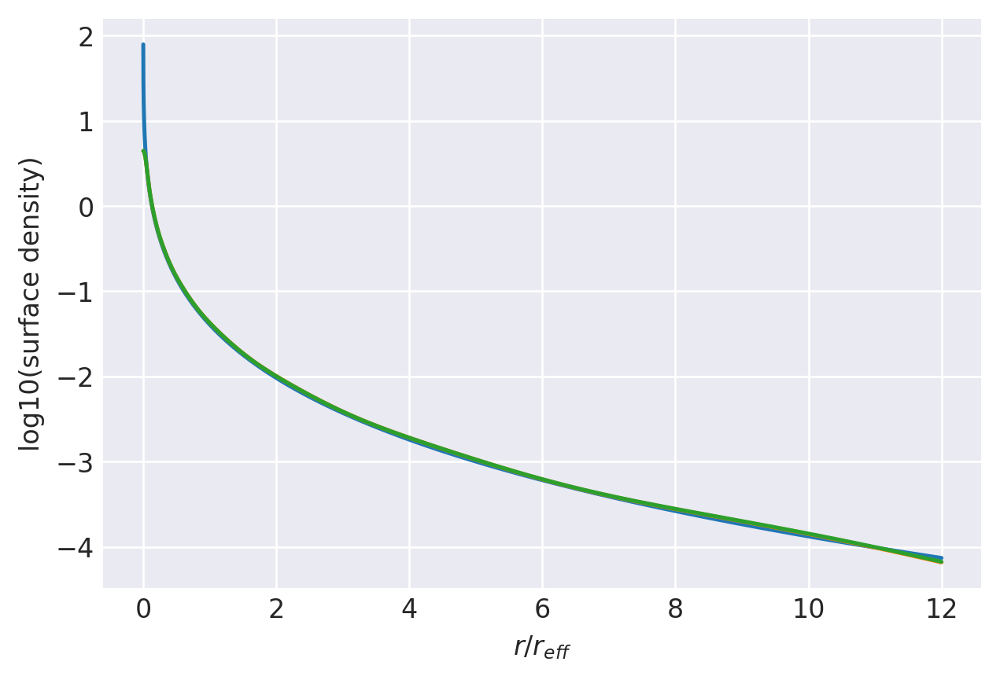

n=4.75: (
    normalize(np.array([1.4607472338e-01, 1.8695199240e-01, 1.9767073904e-01, 1.7473952448e-01, 1.3216591235e-01, 8.6969075322e-02, 5.0076233986e-02, 2.5351799056e-02])),
    np.array([6.3461387605e+00, 2.7271270965e+00, 1.3538754350e+00, 6.9945994087e-01, 3.6581130849e-01, 1.9061220814e-01, 9.7571198164e-02, 4.8156655154e-02]),
),
[120, 24000]
0.9580996418891259 0.9877474757039697
prev.  chisq = -8.405564528690821
ws, re: (array([0.14607472, 0.18695199, 0.19767074, 0.17473952, 0.13216591,
       0.08696908, 0.05007623, 0.0253518 ]), array([6.34613876, 2.7271271 , 1.35387544, 0.69945994, 0.36581131,
       0.19061221, 0.0975712 , 0.04815666]))
Optimization terminated successfully.
         Current function value: -8.702651
         Iterations: 21
         Function evaluations: 612
         Gradient evaluations: 36
-8.70265080513869 [-1.76125633 -1.27612283 -0.87229036 -0.53155042 -0.21625047  0.13188581
  0.67096047  0.80426742  0.43711312  0.13302439 -0.1536646  -0.43491665


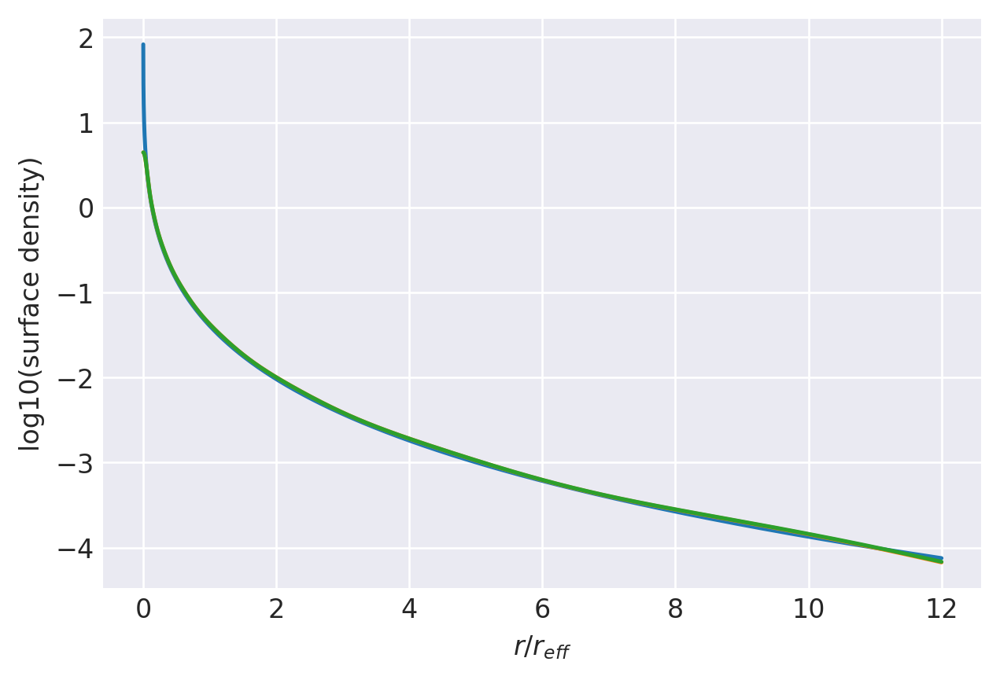

n=4.8: (
    normalize(np.array([1.4663306270e-01, 1.8621398966e-01, 1.9666197817e-01, 1.7415474984e-01, 1.3220954079e-01, 8.7467004128e-02, 5.0727101268e-02, 2.5932573434e-02])),
    np.array([6.3718775442e+00, 2.7359812710e+00, 1.3583897346e+00, 7.0199724035e-01, 3.6735279247e-01, 1.9161549216e-01, 9.8255252369e-02, 4.8627945118e-02]),
),
[122, 24000]
0.9571678518362058 0.9874523798485764
prev.  chisq = -8.421574028408756
ws, re: (array([0.14663306, 0.18621399, 0.19666198, 0.17415475, 0.13220954,
       0.087467  , 0.0507271 , 0.02593257]), array([6.37187754, 2.73598127, 1.35838973, 0.70199724, 0.36735279,
       0.19161549, 0.09825525, 0.04862795]))
         Current function value: -8.713734
         Iterations: 21
         Function evaluations: 1644
         Gradient evaluations: 96
-8.713734395517516 [-1.75686781 -1.28029201 -0.87982669 -0.54076157 -0.22634167  0.12159756
  0.66143816  0.8059963   0.4385046   0.13446297 -0.15209247 -0.43308794
 -0.71528953 -1.00462134 -1.30892257]

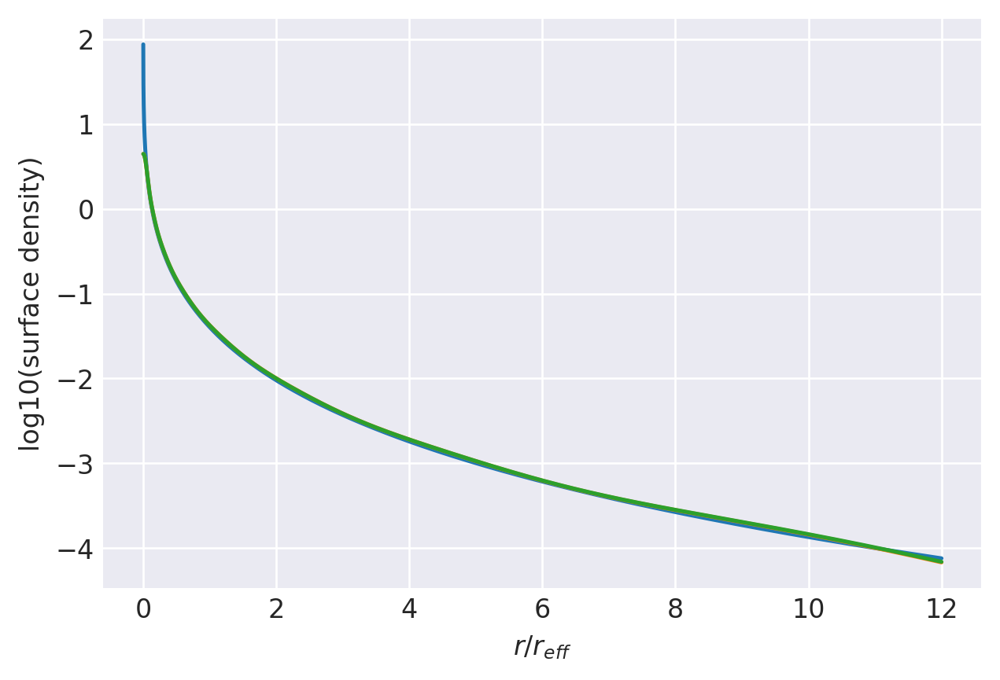

n=4.85: (
    normalize(np.array([1.4718305876e-01, 1.8548812951e-01, 1.9566994657e-01, 1.7357538619e-01, 1.3224620421e-01, 8.7953786617e-02, 5.1370654158e-02, 2.6512833994e-02])),
    np.array([6.3972938359e+00, 2.7447614366e+00, 1.3628968054e+00, 7.0454303445e-01, 3.6890289526e-01, 1.9262403383e-01, 9.8941538633e-02, 4.9099540972e-02]),
),
[123, 24000]
0.9562362393759125 0.987157341219323
prev.  chisq = -8.427987316714034
ws, re: (array([0.14718306, 0.18548813, 0.19566995, 0.17357539, 0.1322462 ,
       0.08795379, 0.05137065, 0.02651283]), array([6.39729384, 2.74476144, 1.36289681, 0.70454303, 0.3689029 ,
       0.19262403, 0.09894154, 0.04909954]))
         Current function value: -8.717482
         Iterations: 20
         Function evaluations: 1593
         Gradient evaluations: 93
-8.717482405309052 [-1.75135968 -1.28260157 -0.88521524 -0.54772977 -0.2341572   0.11355395
  0.65399046  0.80736538  0.43931274  0.13505243 -0.15164079 -0.43266808
 -0.7147452  -1.00372686 -1.30735359]

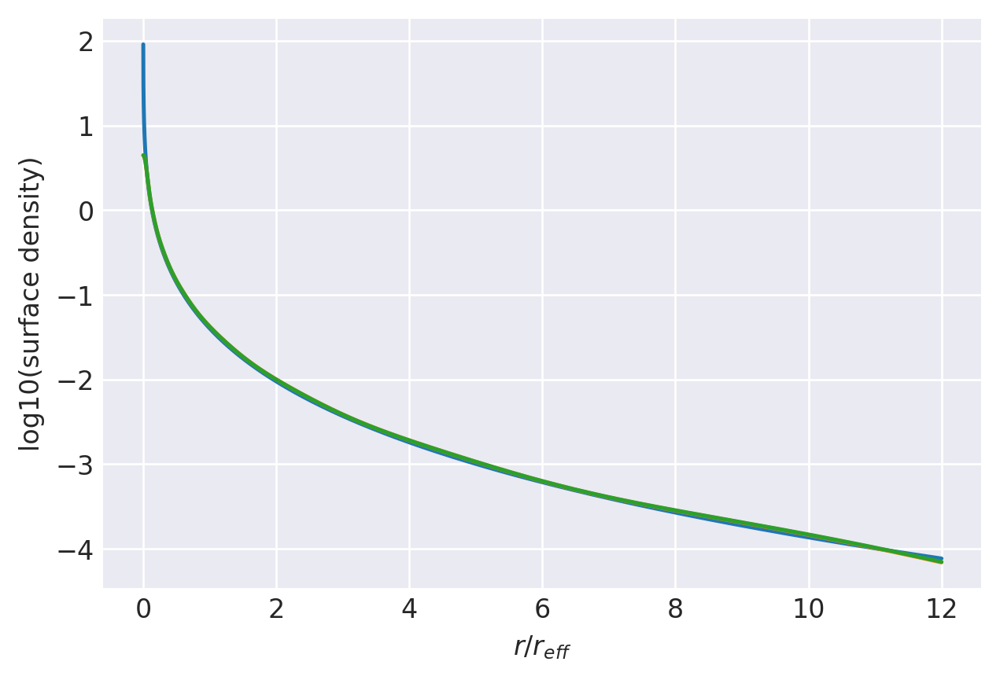

n=4.9: (
    normalize(np.array([1.4787578477e-01, 1.8500273201e-01, 1.9486499743e-01, 1.7303065857e-01, 1.3217604168e-01, 8.8262094229e-02, 5.1835142265e-02, 2.6952549049e-02])),
    np.array([6.4174926090e+00, 2.7498736510e+00, 1.3647478957e+00, 7.0527616211e-01, 3.6925970629e-01, 1.9286561074e-01, 9.9145529778e-02, 4.9277244190e-02]),
),
[125, 24000]
0.9553049950797066 0.9868975739480714
prev.  chisq = -8.447808049307643
ws, re: (array([0.14787578, 0.18500273, 0.194865  , 0.17303066, 0.13217604,
       0.08826209, 0.05183514, 0.02695255]), array([6.41749261, 2.74987365, 1.3647479 , 0.70527616, 0.36925971,
       0.19286561, 0.09914553, 0.04927724]))
         Current function value: -8.728738
         Iterations: 21
         Function evaluations: 1661
         Gradient evaluations: 97
-8.728738446963272 [-1.74715126 -1.28669034 -0.89256811 -0.55669298 -0.24394861  0.1036109
  0.6448364   0.80904174  0.44067801  0.13648391 -0.15006143 -0.43082419
 -0.71245127 -1.00070551 -1.30320458]


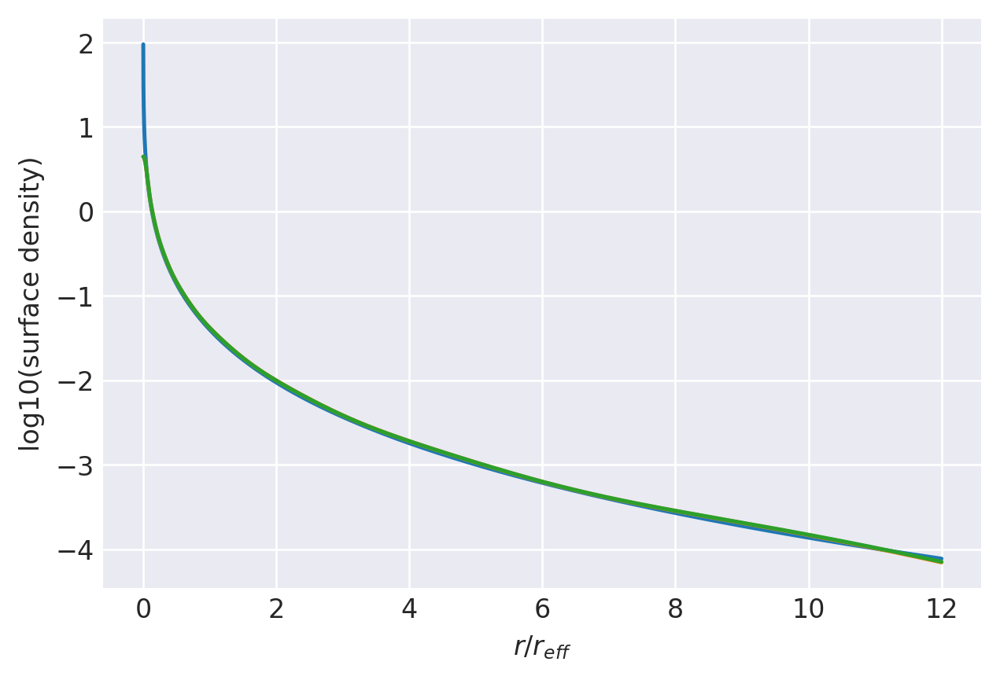

n=4.95: (
    normalize(np.array([1.4840686810e-01, 1.8429627763e-01, 1.9390321581e-01, 1.7246344990e-01, 1.3220269725e-01, 8.8730341727e-02, 5.2465803900e-02, 2.7531345691e-02])),
    np.array([6.4423117526e+00, 2.7585318801e+00, 1.3692536528e+00, 7.0784565392e-01, 3.7083081157e-01, 1.9388701866e-01, 9.9837682060e-02, 4.9750267331e-02]),
),
[127, 24000]
0.9543743004887094 0.9866031148955325
prev.  chisq = -8.463782078826453
ws, re: (array([0.14840687, 0.18429628, 0.19390322, 0.17246345, 0.1322027 ,
       0.08873034, 0.0524658 , 0.02753135]), array([6.44231175, 2.75853188, 1.36925365, 0.70784565, 0.37083081,
       0.19388702, 0.09983768, 0.04975027]))
         Current function value: -8.740050
         Iterations: 21
         Function evaluations: 1729
         Gradient evaluations: 101
-8.740049663004214 [-1.74301477 -1.29072349 -0.89981586 -0.5655192  -0.25357616  0.09385494
  0.63588023  0.81069145  0.44202782  0.13790787 -0.14848389 -0.42897994
 -0.71015982 -0.99769744 -1.2990933

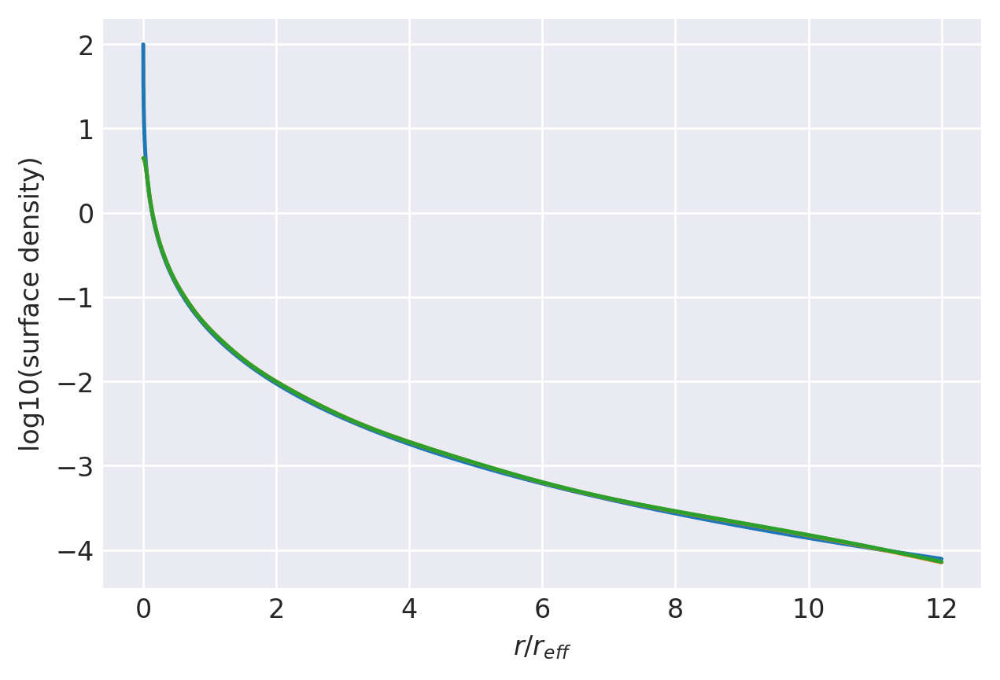

n=5.0: (
    normalize(np.array([1.4893040718e-01, 1.8360156508e-01, 1.9295722327e-01, 1.7190168791e-01, 1.3222308080e-01, 8.9187978707e-02, 5.3089042683e-02, 2.8109014380e-02])),
    np.array([6.4668301219e+00, 2.7671189253e+00, 1.3737505350e+00, 7.1042151625e-01, 3.7240890404e-01, 1.9491271849e-01, 1.0053159257e-01, 5.0223457245e-02]),
),
[129, 24000]
0.9534443284741596 0.9863088798666658
prev.  chisq = -8.479738526030417
ws, re: (array([0.14893041, 0.18360157, 0.19295722, 0.17190169, 0.13222308,
       0.08918798, 0.05308904, 0.02810901]), array([6.46683012, 2.76711893, 1.37375053, 0.71042152, 0.3724089 ,
       0.19491272, 0.10053159, 0.05022346]))
Optimization terminated successfully.
         Current function value: -8.751412
         Iterations: 22
         Function evaluations: 578
         Gradient evaluations: 34
-8.751411822414125 [-1.73894745 -1.29470138 -0.90695978 -0.57421065 -0.26304325  0.08428131
  0.62711582  0.81231517  0.4433624   0.13932419 -0.14690862 -0.42713594


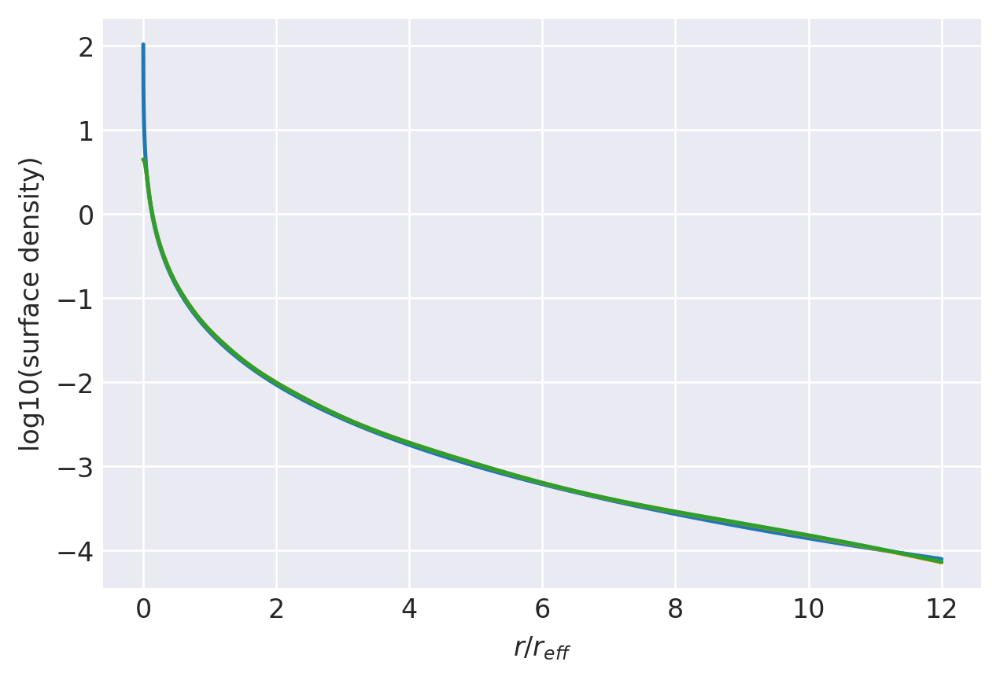

n=5.05: (
    normalize(np.array([1.4944667722e-01, 1.8291839601e-01, 1.9202673455e-01, 1.7134536994e-01, 1.3223741709e-01, 8.9635190072e-02, 5.3704841970e-02, 2.8685373143e-02])),
    np.array([6.4910531952e+00, 2.7756352970e+00, 1.3782379012e+00, 7.1300303203e-01, 3.7399350710e-01, 1.9594246055e-01, 1.0122715926e-01, 5.0696793576e-02]),
),
[131, 24000]
0.9525152435859581 0.9860149296500139
prev.  chisq = -8.495674133190663
ws, re: (array([0.14944668, 0.1829184 , 0.19202673, 0.17134537, 0.13223742,
       0.08963519, 0.05370484, 0.02868537]), array([6.4910532 , 2.7756353 , 1.3782379 , 0.71300303, 0.37399351,
       0.19594246, 0.10122716, 0.05069679]))
         Current function value: -8.762821
         Iterations: 21
         Function evaluations: 1712
         Gradient evaluations: 100
-8.762820918149512 [-1.73494708 -1.29862506 -0.91400159 -0.58276983 -0.27235342  0.07488527
  0.61853744  0.81391361  0.44468214  0.14073297 -0.14533577 -0.42529247
 -0.70558642 -0.9917221  -1.2909822

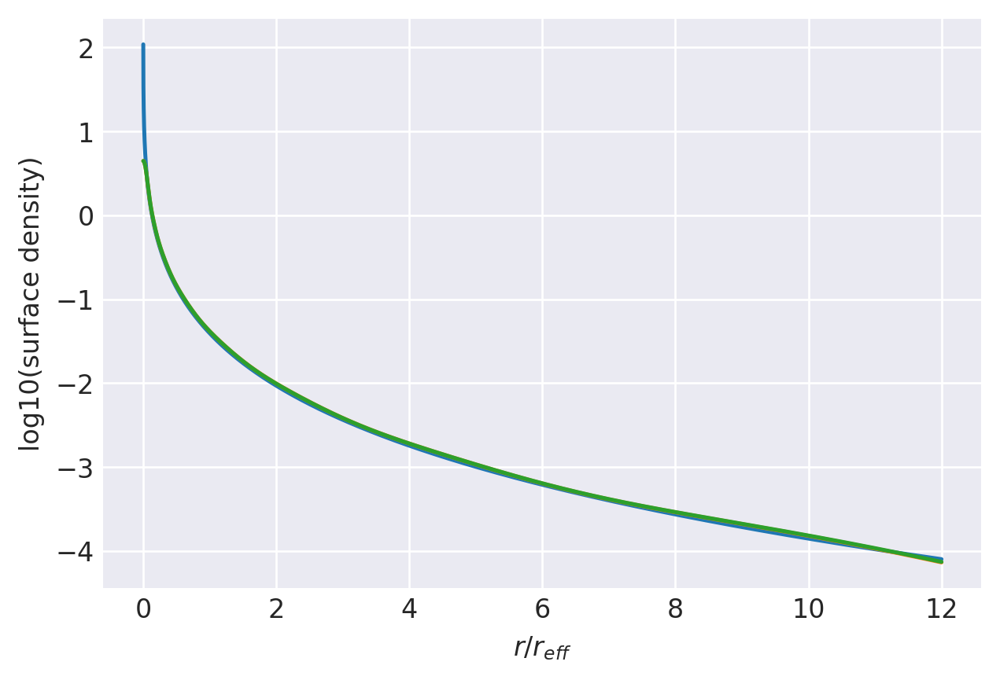

n=5.1: (
    normalize(np.array([1.4995588720e-01, 1.8224648988e-01, 1.9111144970e-01, 1.7079451308e-01, 1.3224596599e-01, 9.0072205091e-02, 5.4313227022e-02, 2.9260262037e-02])),
    np.array([6.5149877749e+00, 2.7840827366e+00, 1.3827159415e+00, 7.1558994388e-01, 3.7558438513e-01, 1.9697611841e-01, 1.0192433813e-01, 5.1170274304e-02]),
),
[133, 24000]
0.9515872023893971 0.9857213116989634
prev.  chisq = -8.511585613440165
ws, re: (array([0.14995589, 0.18224649, 0.19111145, 0.17079451, 0.13224597,
       0.09007221, 0.05431323, 0.02926026]), array([6.51498777, 2.78408274, 1.38271594, 0.71558994, 0.37558439,
       0.19697612, 0.10192434, 0.05117027]))
         Current function value: -8.774273
         Iterations: 21
         Function evaluations: 1542
         Gradient evaluations: 90
-8.774273152999877 [-1.73101135 -1.30249309 -0.92094212 -0.59119841 -0.28150867  0.06566367
  0.61013969  0.81548746  0.44598705  0.14213369 -0.1437661  -0.42345053
 -0.70330592 -0.98875585 -1.28698158]

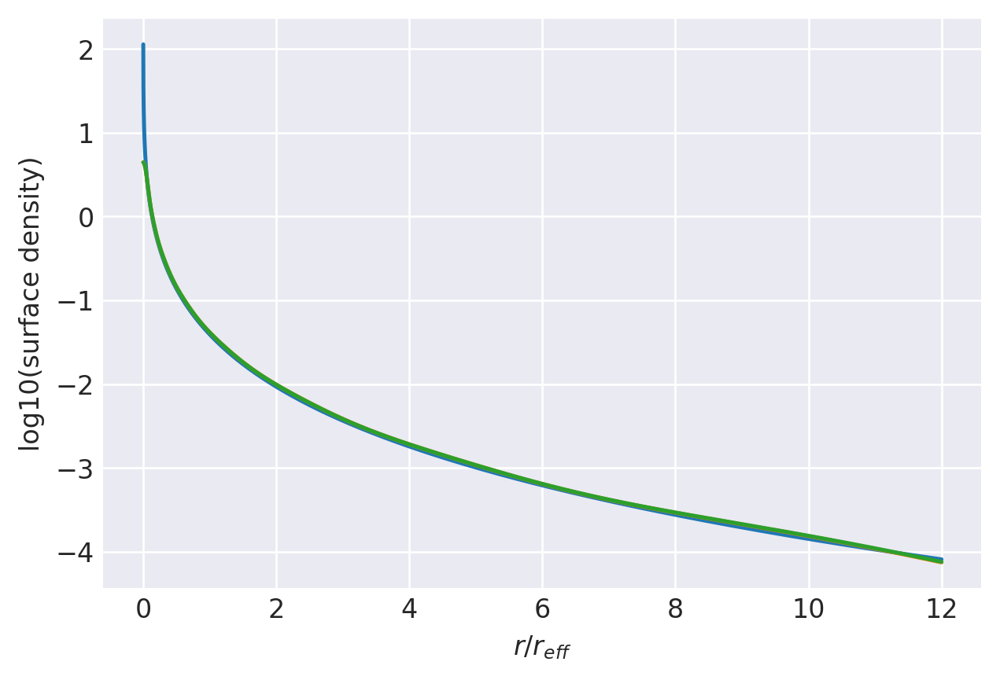

n=5.15: (
    normalize(np.array([1.5045826231e-01, 1.8158592107e-01, 1.9021108561e-01, 1.7024907885e-01, 1.3224894267e-01, 9.0499157163e-02, 5.4914097519e-02, 2.9833454806e-02])),
    np.array([6.5386405092e+00, 2.7924605817e+00, 1.3871827851e+00, 7.1818098001e-01, 3.7718070380e-01, 1.9801317081e-01, 1.0262286927e-01, 5.1643827102e-02]),
),
[134, 24000]
0.9506603537901954 0.9854280675256115
prev.  chisq = -8.51790435740021
ws, re: (array([0.15045826, 0.18158592, 0.19021109, 0.17024908, 0.13224894,
       0.09049916, 0.0549141 , 0.02983345]), array([6.53864051, 2.79246058, 1.38718279, 0.71818098, 0.3771807 ,
       0.19801317, 0.10262287, 0.05164383]))
         Current function value: -8.778607
         Iterations: 20
         Function evaluations: 1542
         Gradient evaluations: 90
-8.778606954465841 [-1.7260944  -1.30466916 -0.92590908 -0.59757336 -0.2886004   0.05844715
  0.60355804  0.81672326  0.44674073  0.14272547 -0.14326714 -0.4229537
 -0.70267588 -0.98779925 -1.28542963]


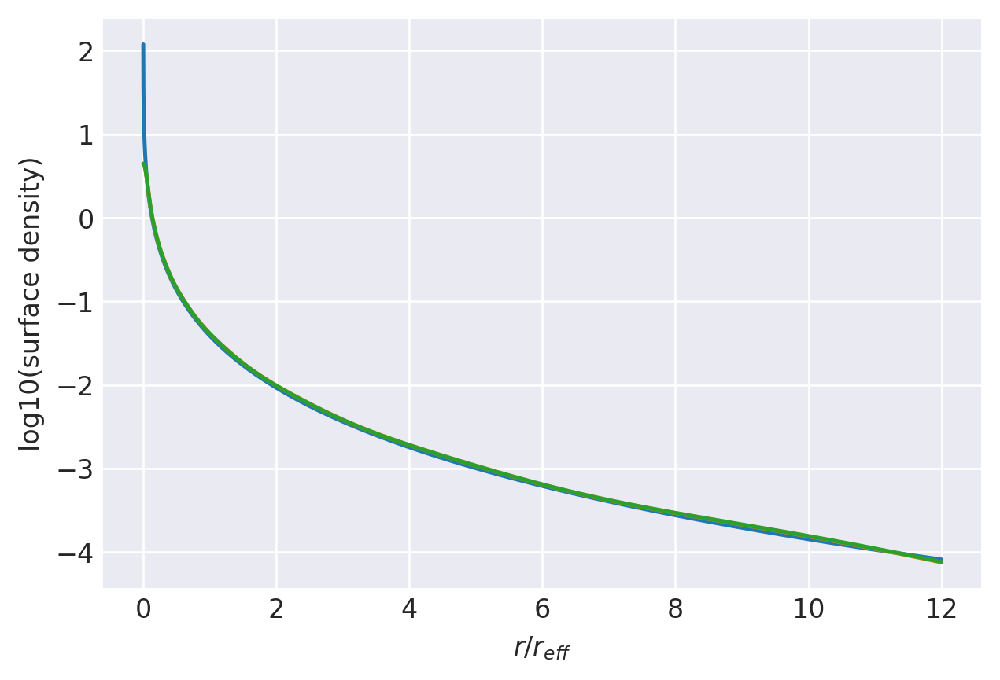

n=5.2: (
    normalize(np.array([1.5108783039e-01, 1.8114109431e-01, 1.8948365541e-01, 1.6974375886e-01, 1.3216361208e-01, 9.0766518895e-02, 5.5346570808e-02, 3.0266959244e-02])),
    np.array([6.5572729654e+00, 2.7973108806e+00, 1.3890742745e+00, 7.1900656403e-01, 3.7761244691e-01, 1.9830064325e-01, 1.0284916031e-01, 5.1828707061e-02]),
),
[136, 24000]
0.9497348393480227 0.985171920742421
prev.  chisq = -8.537539549651198
ws, re: (array([0.15108783, 0.18114109, 0.18948366, 0.16974376, 0.13216361,
       0.09076652, 0.05534657, 0.03026696]), array([6.55727297, 2.79731088, 1.38907427, 0.71900656, 0.37761245,
       0.19830064, 0.10284916, 0.05182871]))
         Current function value: -8.790179
         Iterations: 21
         Function evaluations: 1168
         Gradient evaluations: 68
-8.790178709194995 [-1.72230627 -1.30845745 -0.93267969 -0.60577832 -0.29748913  0.04952512
  0.59547035  0.81825282  0.44802252  0.14411782 -0.14169472 -0.42110323
 -0.70038885 -0.98484048 -1.2814705 ]


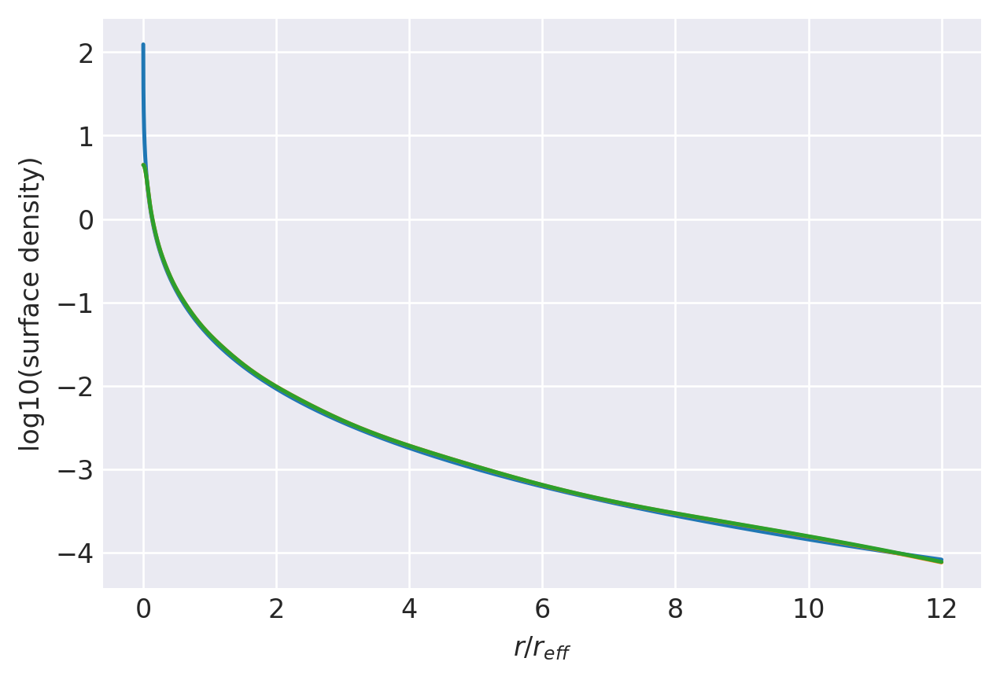

n=5.25: (
    normalize(np.array([1.5157434023e-01, 1.8049838719e-01, 1.8861022513e-01, 1.6920985580e-01, 1.3215881634e-01, 9.1176966088e-02, 5.5934525971e-02, 3.0836883244e-02])),
    np.array([6.5804079016e+00, 2.8055790877e+00, 1.3935348204e+00, 7.2161454794e-01, 3.7922483454e-01, 1.9934766477e-01, 1.0355224469e-01, 5.2303348888e-02]),
),
[138, 24000]
0.9488107935787129 0.9848797694673113
prev.  chisq = -8.553367475057254
ws, re: (array([0.15157434, 0.18049839, 0.18861023, 0.16920986, 0.13215882,
       0.09117697, 0.05593453, 0.03083688]), array([6.5804079 , 2.80557909, 1.39353482, 0.72161455, 0.37922483,
       0.19934766, 0.10355224, 0.05230335]))
Optimization terminated successfully.
         Current function value: -8.801783
         Iterations: 22
         Function evaluations: 595
         Gradient evaluations: 35
-8.801782748910506 [-1.71857645 -1.31219257 -0.93935414 -0.61385867 -0.30623195  0.04076584
  0.58754931  0.81975973  0.44929049  0.14550246 -0.14012589 -0.41925524

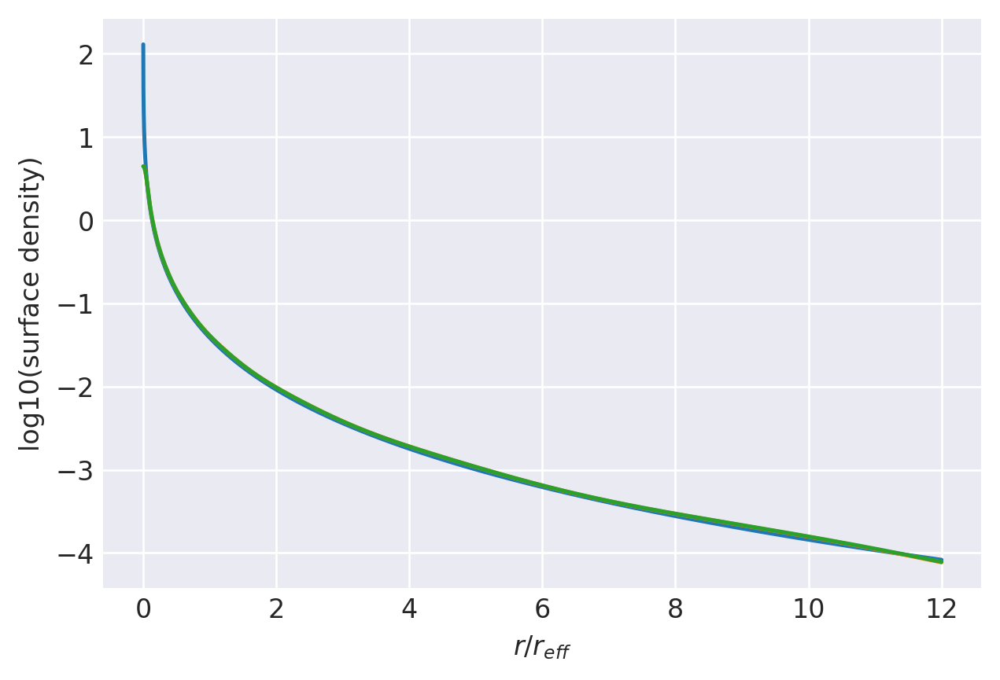

n=5.3: (
    normalize(np.array([1.5205461702e-01, 1.7986632663e-01, 1.8775080586e-01, 1.6868142788e-01, 1.3214907986e-01, 9.1577962112e-02, 5.6515067618e-02, 3.1404713015e-02])),
    np.array([6.6032802197e+00, 2.8137822840e+00, 1.3979848181e+00, 7.2422599713e-01, 3.8084193154e-01, 2.0039765363e-01, 1.0425649022e-01, 5.2778009299e-02]),
),
[140, 24000]
0.9478883442453993 0.9845880937135602
prev.  chisq = -8.569159108646478
ws, re: (array([0.15205462, 0.17986633, 0.18775081, 0.16868143, 0.13214908,
       0.09157796, 0.05651507, 0.03140471]), array([6.60328022, 2.81378228, 1.39798482, 0.724226  , 0.38084193,
       0.20039765, 0.10425649, 0.05277801]))
         Current function value: -8.813416
         Iterations: 22
         Function evaluations: 1525
         Gradient evaluations: 89
-8.813416018196316 [-1.71490303 -1.31587437 -0.94593323 -0.62181699 -0.31483225  0.03216554
  0.57979026  0.82124456  0.45054483  0.14687912 -0.13856108 -0.41741013
 -0.69583179 -0.97896864 -1.27365853]

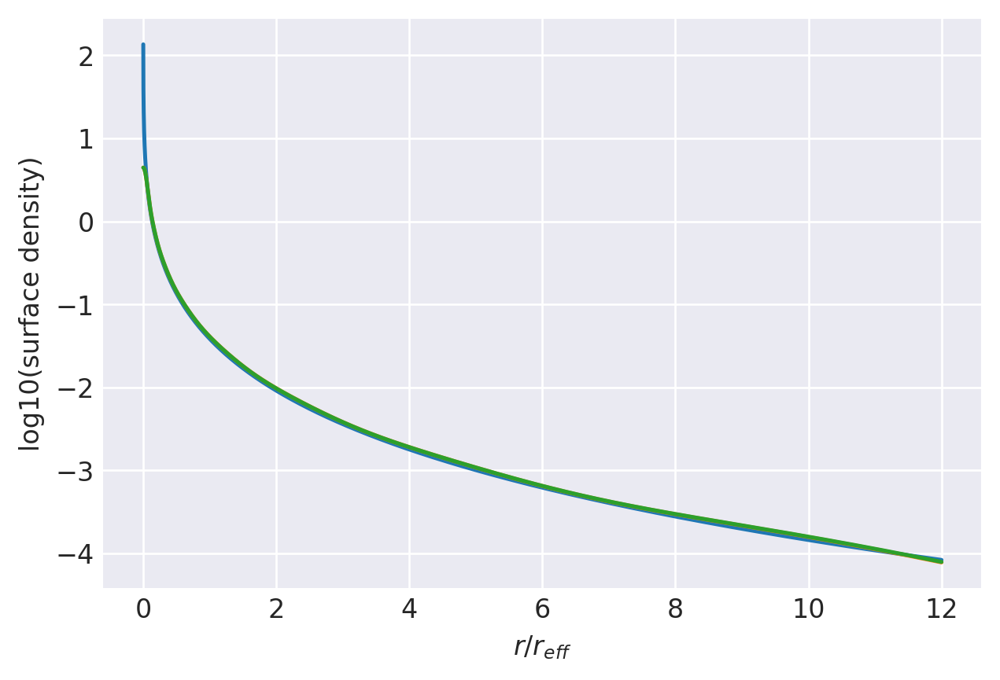

n=5.35: (
    normalize(np.array([1.5252885137e-01, 1.7924481658e-01, 1.8690518818e-01, 1.6815835823e-01, 1.3213455371e-01, 9.1969708145e-02, 5.7088218744e-02, 3.1970305039e-02])),
    np.array([6.6258952196e+00, 2.8219208452e+00, 1.4024232940e+00, 7.2684017409e-01, 3.8246339234e-01, 2.0145043338e-01, 1.0496182129e-01, 5.3252680313e-02]),
),
[141, 24000]
0.9469676126388213 0.9842969308974701
prev.  chisq = -8.575392045981273
ws, re: (array([0.15252885, 0.17924482, 0.18690519, 0.16815836, 0.13213455,
       0.09196971, 0.05708822, 0.03197031]), array([6.62589522, 2.82192085, 1.40242329, 0.72684017, 0.38246339,
       0.20145043, 0.10496182, 0.05325268]))
         Current function value: -8.818061
         Iterations: 21
         Function evaluations: 1711
         Gradient evaluations: 100
-8.818061059676836 [-1.7103271  -1.31796193 -0.9506403  -0.62783312 -0.32149105  0.02543379
  0.57370503  0.82240338  0.45126629  0.14747006 -0.13803797 -0.41687286
 -0.6951571  -0.97798135 -1.2721197

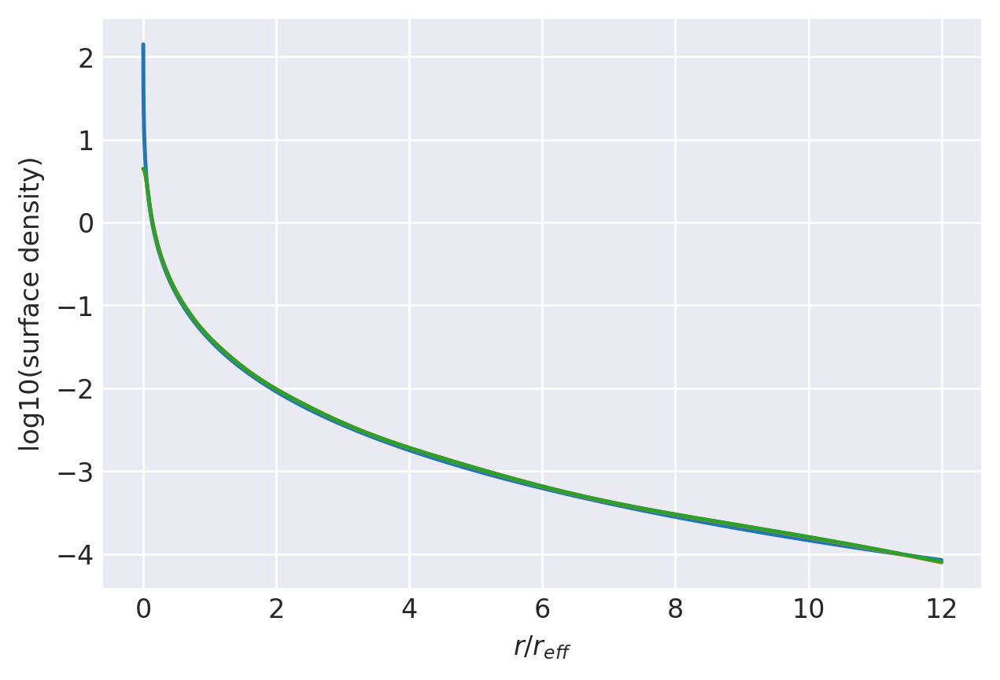

n=5.4: (
    normalize(np.array([1.5312129380e-01, 1.7882485359e-01, 1.8622406652e-01, 1.6767774567e-01, 1.3204200155e-01, 9.2212894297e-02, 5.7499800422e-02, 3.2397344152e-02])),
    np.array([6.6435984787e+00, 2.8266125726e+00, 1.4043328669e+00, 7.2771617751e-01, 3.8293683423e-01, 2.0176363988e-01, 1.0520070466e-01, 5.3441699780e-02]),
),
[143, 24000]
0.9460487138470621 0.984044008924593
prev.  chisq = -8.594839781267899
ws, re: (array([0.15312129, 0.17882485, 0.18622407, 0.16767775, 0.132042  ,
       0.09221289, 0.0574998 , 0.03239734]), array([6.64359848, 2.82661257, 1.40433287, 0.72771618, 0.38293683,
       0.20176364, 0.1052007 , 0.0534417 ]))
         Current function value: -8.829786
         Iterations: 21
         Function evaluations: 1303
         Gradient evaluations: 76
-8.829786217845186 [-1.70678301 -1.32156493 -0.95705876 -0.63558131 -0.32984349  0.01710757
  0.5662242   0.82384836  0.45249908  0.14883771 -0.13647286 -0.41502306
 -0.69287939 -0.97506407 -1.26827252]


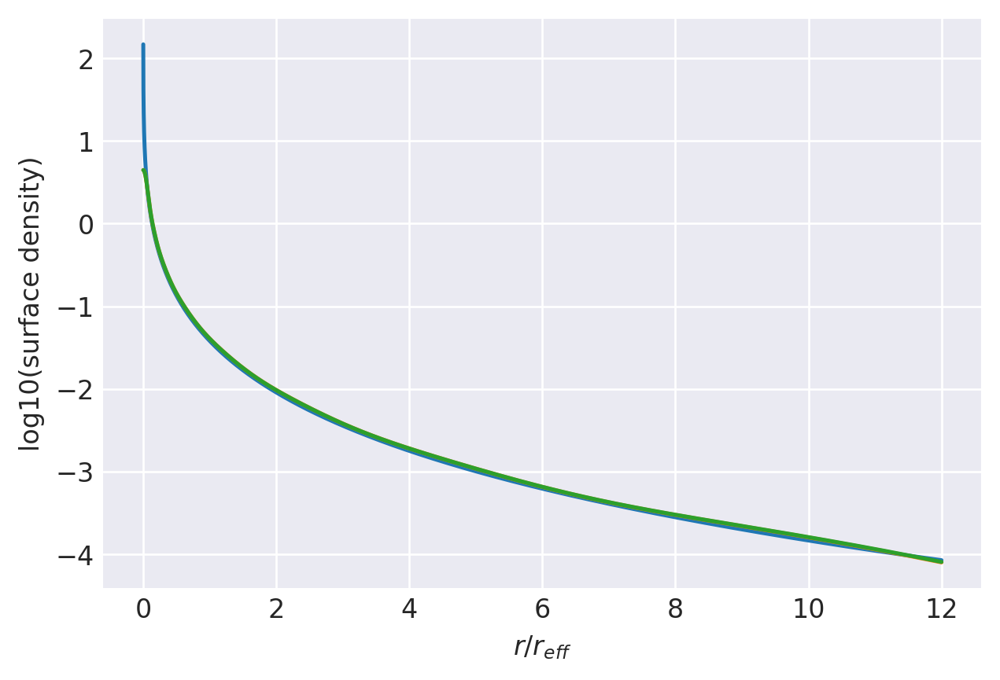

n=5.45: (
    normalize(np.array([1.5358143976e-01, 1.7822023923e-01, 1.8540329531e-01, 1.6716588171e-01, 1.3202094969e-01, 9.2589350309e-02, 5.8060144426e-02, 3.2958699564e-02])),
    np.array([6.6657398728e+00, 2.8346476330e+00, 1.4087622690e+00, 7.3034345739e-01, 3.8457135871e-01, 2.0282459229e-01, 1.0590974583e-01, 5.3917218099e-02]),
),
[145, 24000]
0.9451317570150136 0.9837541757110936
prev.  chisq = -8.61052149777219
ws, re: (array([0.15358144, 0.17822024, 0.1854033 , 0.16716588, 0.13202095,
       0.09258935, 0.05806014, 0.0329587 ]), array([6.66573987, 2.83464763, 1.40876227, 0.73034346, 0.38457136,
       0.20282459, 0.10590975, 0.05391722]))
         Current function value: -8.841532
         Iterations: 21
         Function evaluations: 1338
         Gradient evaluations: 78
-8.841531767891796 [-1.70328926 -1.32511603 -0.96338564 -0.64321338 -0.33806094  0.00892974
  0.55889297  0.82527273  0.45371884  0.15019726 -0.13491246 -0.41317725
 -0.69060874 -0.97216273 -1.26445939]

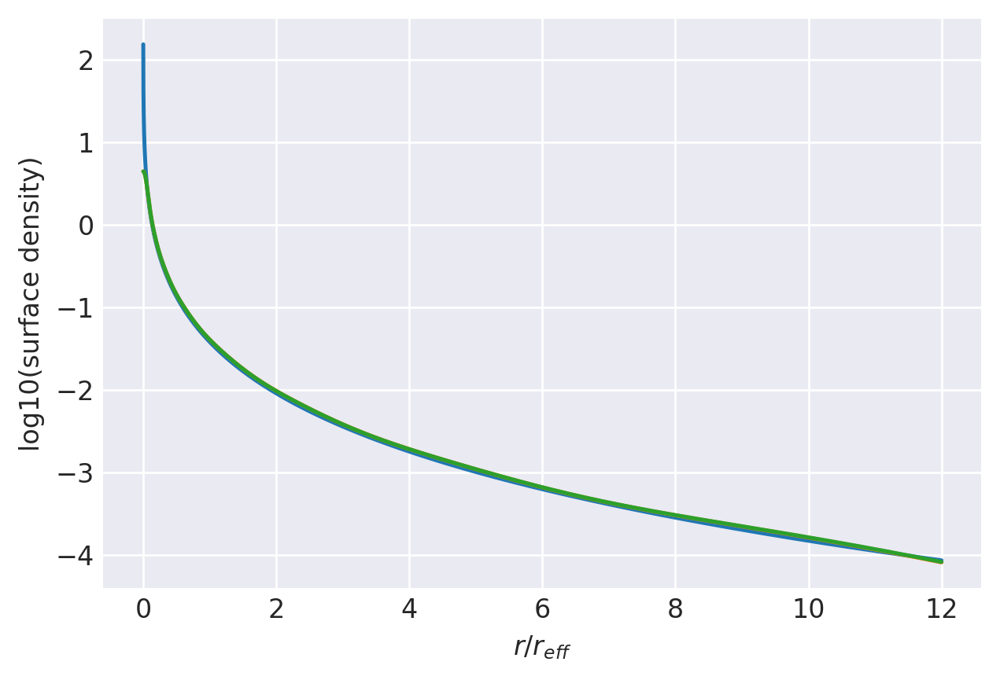

n=5.5: (
    normalize(np.array([1.5403615657e-01, 1.7762565618e-01, 1.8459557299e-01, 1.6665925302e-01, 1.3199564410e-01, 9.2957052182e-02, 5.8613193419e-02, 3.3517471530e-02])),
    np.array([6.6876376222e+00, 2.8426201990e+00, 1.4131792827e+00, 7.3297225753e-01, 3.8620932308e-01, 2.0388781062e-01, 1.0661965494e-01, 5.4392699543e-02]),
),
[146, 24000]
0.9442168455938236 0.98346495677472
prev.  chisq = -8.616683761695771
ws, re: (array([0.15403616, 0.17762566, 0.18459557, 0.16665925, 0.13199564,
       0.09295705, 0.05861319, 0.03351747]), array([6.68763762, 2.8426202 , 1.41317928, 0.73297226, 0.38620932,
       0.20388781, 0.10661965, 0.0543927 ]))
Optimization terminated successfully.
         Current function value: -8.846378
         Iterations: 26
         Function evaluations: 646
         Gradient evaluations: 38
-8.846377735499932 [-1.69894813 -1.32713898 -0.96791087 -0.64897862 -0.34442048  0.00253051
  0.55314219  0.82637972  0.45441848  0.15078714 -0.13437389 -0.41261379
 -

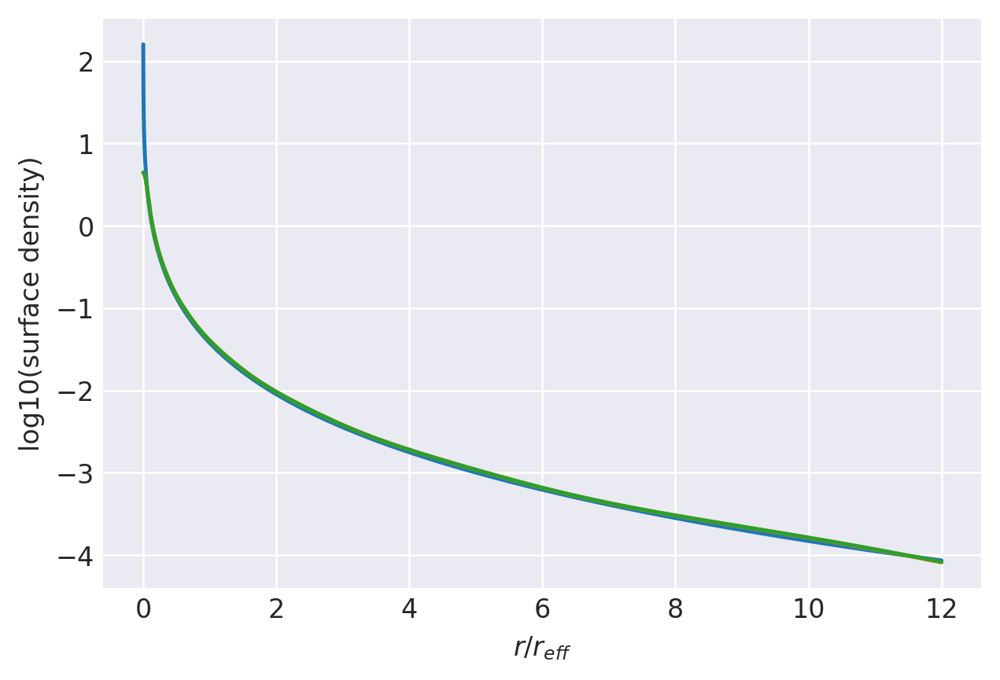

n=5.55: (
    normalize(np.array([1.5460269517e-01, 1.7722317759e-01, 1.8394640283e-01, 1.6619651369e-01, 1.3189902125e-01, 9.3183846940e-02, 5.9009584008e-02, 3.3938758520e-02])),
    np.array([6.7047056313e+00, 2.8472033093e+00, 1.4151000240e+00, 7.3388179399e-01, 3.8671071567e-01, 2.0421831939e-01, 1.0686702515e-01, 5.4584545449e-02]),
),
[148, 24000]
0.9433040775806638 0.9832147166311803
prev.  chisq = -8.635963046425763
ws, re: (array([0.1546027 , 0.17722318, 0.1839464 , 0.16619651, 0.13189902,
       0.09318385, 0.05900958, 0.03393876]), array([6.70470563, 2.84720331, 1.41510002, 0.73388179, 0.38671072,
       0.20421832, 0.10686703, 0.05458455]))
         Current function value: -8.858198
         Iterations: 22
         Function evaluations: 1661
         Gradient evaluations: 97
-8.858197541264564 [-1.69557215 -1.33061188 -0.97408358 -0.65641047 -0.35240378 -0.00539041
  0.54606832  0.82776731  0.45561785  0.15213728 -0.13281476 -0.41076561
 -0.68763512 -0.96826793 -1.25915807

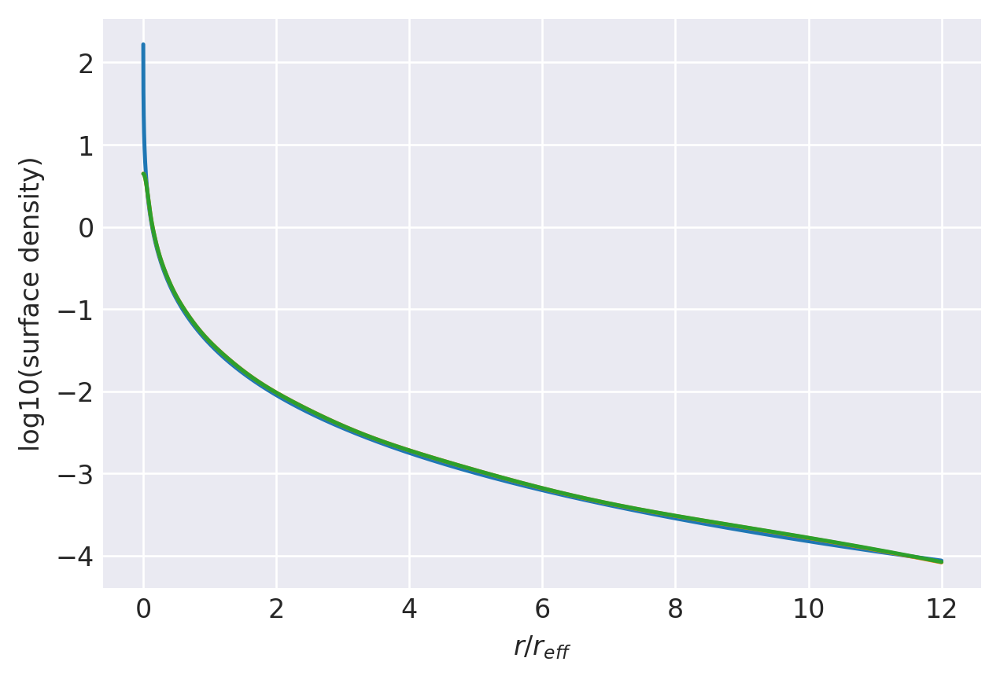

n=5.6: (
    normalize(np.array([1.5504445301e-01, 1.7664486193e-01, 1.8316210915e-01, 1.6570075472e-01, 1.3186794308e-01, 9.3537156529e-02, 5.9550007813e-02, 3.4492713772e-02])),
    np.array([6.7261618345e+00, 2.8550771414e+00, 1.4195061473e+00, 7.3652118718e-01, 3.8835990482e-01, 2.0528862371e-01, 1.0758013100e-01, 5.5060725960e-02]),
),
[150, 24000]
0.9423935457490752 0.982926940210177
prev.  chisq = -8.651520690408828
ws, re: (array([0.15504445, 0.17664486, 0.18316211, 0.16570075, 0.13186794,
       0.09353716, 0.05955001, 0.03449271]), array([6.72616183, 2.85507714, 1.41950615, 0.73652119, 0.3883599 ,
       0.20528862, 0.10758013, 0.05506073]))
Optimization terminated successfully.
         Current function value: -8.870030
         Iterations: 24
         Function evaluations: 612
         Gradient evaluations: 36
-8.870030154929191 [-1.69224145 -1.33403396 -0.98016824 -0.66373159 -0.36025945 -0.01317219
  0.53913299  0.82913571  0.45680474  0.15347917 -0.13126104 -0.40892242
 

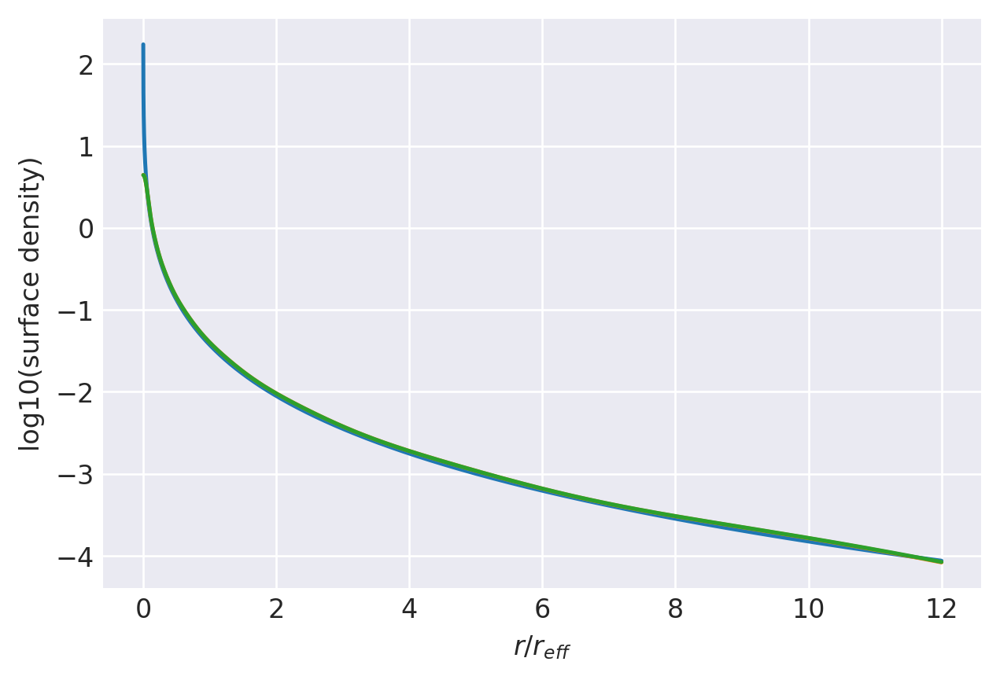

n=5.65: (
    normalize(np.array([1.5548129491e-01, 1.7607613982e-01, 1.8239017051e-01, 1.6521011337e-01, 1.3183305414e-01, 9.3882206189e-02, 6.0083245037e-02, 3.5043776023e-02])),
    np.array([6.7473883550e+00, 2.8628905379e+00, 1.4238989423e+00, 7.3916085110e-01, 3.9001164796e-01, 2.0636069009e-01, 1.0829387537e-01, 5.5536811428e-02]),
),
[151, 24000]
0.9414853378702125 0.9826398490739163
prev.  chisq = -8.657611924237523
ws, re: (array([0.15548129, 0.17607614, 0.18239017, 0.16521011, 0.13183305,
       0.09388221, 0.06008325, 0.03504378]), array([6.74738836, 2.86289054, 1.42389894, 0.73916085, 0.39001165,
       0.20636069, 0.10829388, 0.05553681]))
         Current function value: -8.875050
         Iterations: 22
         Function evaluations: 1338
         Gradient evaluations: 78
-8.875050498938206 [-1.68811405 -1.33599284 -0.98451901 -0.66925824 -0.3663359  -0.01926033
  0.53369226  0.83019446  0.45748375  0.15406726 -0.13070935 -0.40833643
 -0.68464516 -0.96437449 -1.25390148

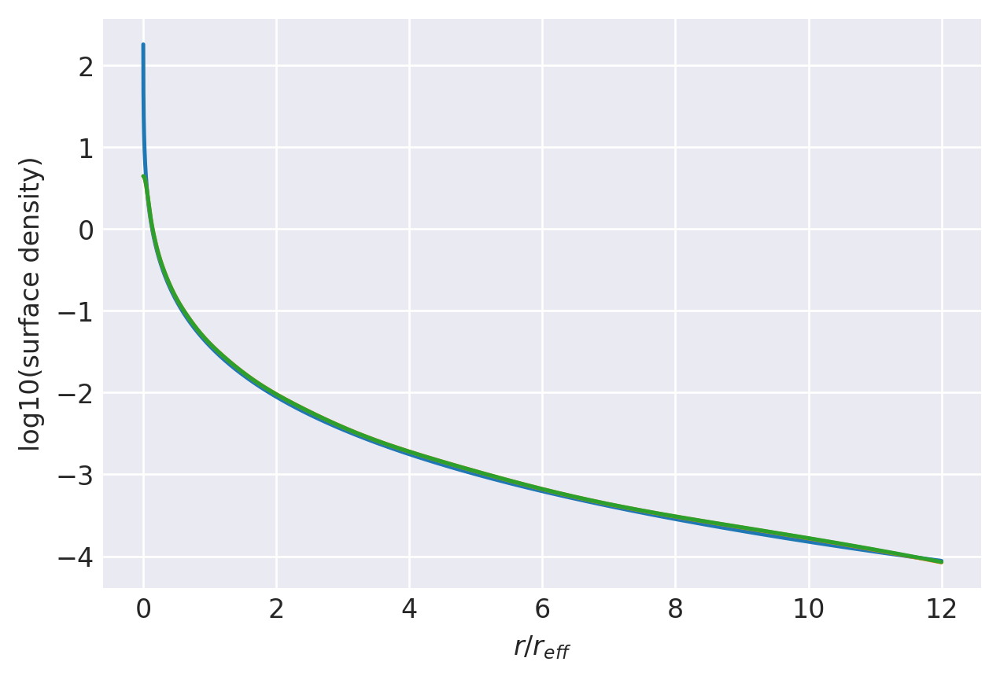

n=5.7: (
    normalize(np.array([1.5602402215e-01, 1.7569031595e-01, 1.8177104973e-01, 1.6476447528e-01, 1.3173309469e-01, 9.4093601554e-02, 6.0464751904e-02, 3.5458688740e-02])),
    np.array([6.7638577215e+00, 2.8673700532e+00, 1.4258283889e+00, 7.4010042203e-01, 3.9053824448e-01, 2.0670683390e-01, 1.0854892099e-01, 5.5731215856e-02]),
),
[153, 24000]
0.9405795369252788 0.9823924676183969
prev.  chisq = -8.67670396583586
ws, re: (array([0.15602402, 0.17569032, 0.18177105, 0.16476448, 0.13173309,
       0.0940936 , 0.06046475, 0.03545869]), array([6.76385772, 2.86737005, 1.42582839, 0.74010042, 0.39053824,
       0.20670683, 0.10854892, 0.05573122]))
         Current function value: -8.886942
         Iterations: 22
         Function evaluations: 1899
         Gradient evaluations: 111
-8.886942078915657 [-1.68489065 -1.33933801 -0.9904561  -0.67638884 -0.37397043 -0.02680155
  0.52699515  0.83152878  0.45865131  0.15539949 -0.12915813 -0.40649276
 -0.68238561 -0.9615171  -1.25020266]

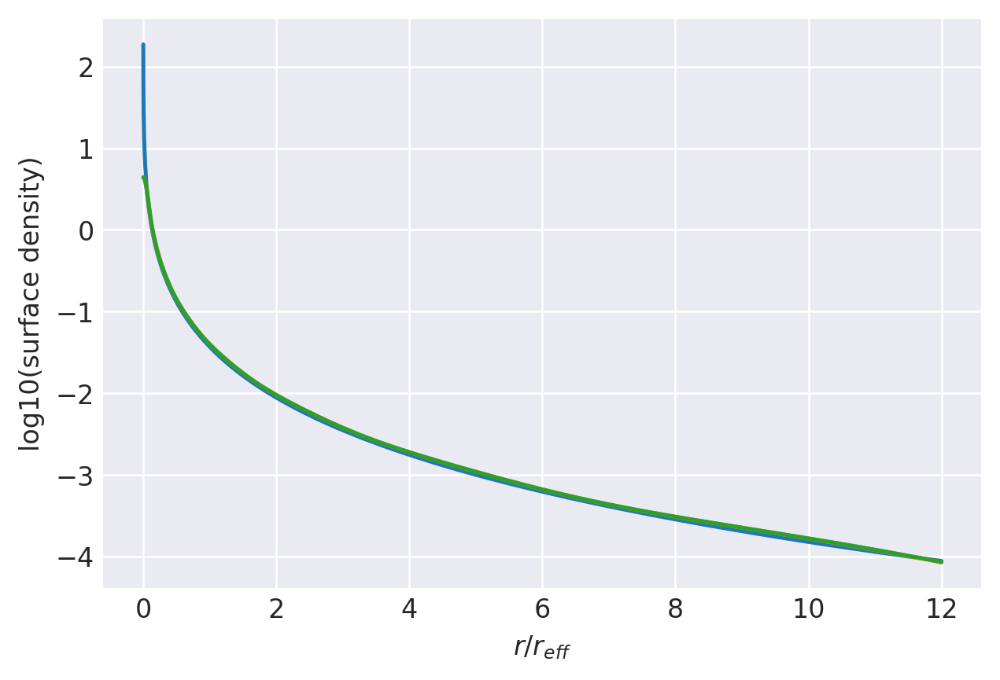

n=5.75: (
    normalize(np.array([1.5644895111e-01, 1.7513717816e-01, 1.8102118084e-01, 1.6428435785e-01, 1.3169313242e-01, 9.4425120522e-02, 6.0985616608e-02, 3.6004462494e-02])),
    np.array([6.7846707643e+00, 2.8750891342e+00, 1.4302089362e+00, 7.4274865381e-01, 3.9219968454e-01, 2.0778509582e-01, 1.0926545994e-01, 5.6207897757e-02]),
),
[154, 24000]
0.9396762213094526 0.9821069137442727
prev.  chisq = -8.682744841606079
ws, re: (array([0.15644895, 0.17513718, 0.18102118, 0.16428436, 0.13169313,
       0.09442512, 0.06098562, 0.03600446]), array([6.78467076, 2.87508913, 1.43020894, 0.74274865, 0.39219968,
       0.2077851 , 0.10926546, 0.0562079 ]))
         Current function value: -8.892070
         Iterations: 20
         Function evaluations: 1337
         Gradient evaluations: 78
-8.89207010926007 [-1.6809001  -1.34125906 -0.99469925 -0.68176935 -0.37987119 -0.03269819
  0.5217427   0.83255779  0.45931782  0.15598678 -0.12859777 -0.40589208
 -0.68164194 -0.96048499 -1.24868996]

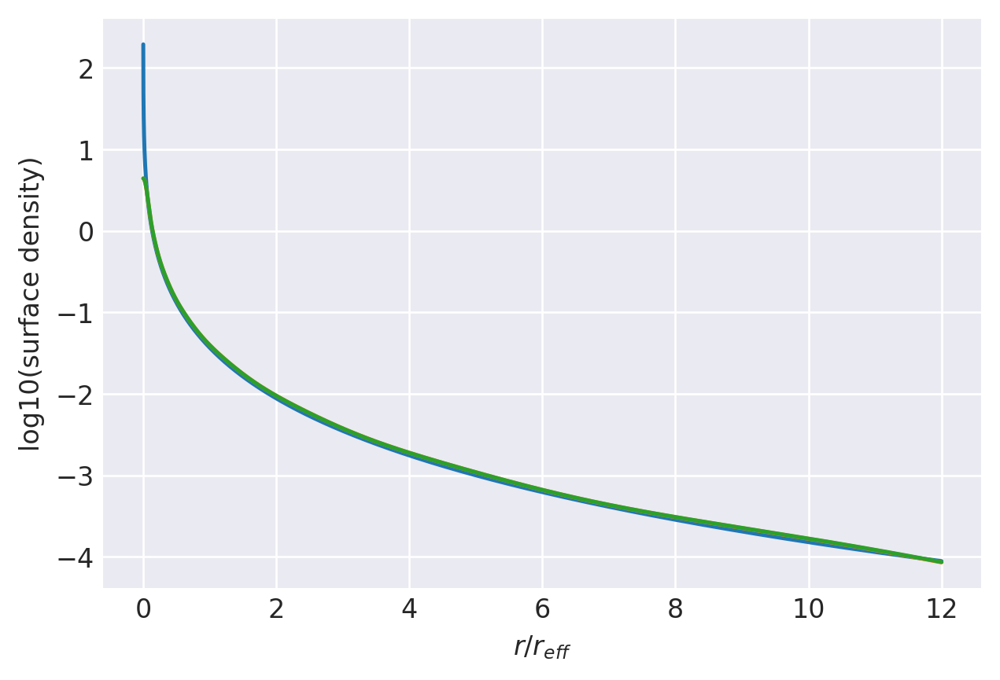

n=5.8: (
    normalize(np.array([1.5697631729e-01, 1.7476140846e-01, 1.8042071569e-01, 1.6384964454e-01, 1.3159189647e-01, 9.4627365618e-02, 6.1357733872e-02, 3.6414918051e-02])),
    np.array([6.8007653656e+00, 2.8795048699e+00, 1.4321443042e+00, 7.4370762188e-01, 3.9274251425e-01, 2.0814120269e-01, 1.0952544023e-01, 5.6404017685e-02]),
),
[156, 24000]
0.9387754650275972 0.9818615859627645
prev.  chisq = -8.701712837977961
ws, re: (array([0.15697632, 0.17476141, 0.18042072, 0.16384964, 0.1315919 ,
       0.09462737, 0.06135773, 0.03641492]), array([6.80076537, 2.87950487, 1.4321443 , 0.74370762, 0.39274251,
       0.2081412 , 0.10952544, 0.05640402]))
         Current function value: -8.904011
         Iterations: 23
         Function evaluations: 1678
         Gradient evaluations: 98
-8.904011381071612 [-1.67777571 -1.3445278  -1.00049147 -0.68871344 -0.38729283 -0.04000841
  0.51527405  0.83385894  0.46046617  0.15730866 -0.12705057 -0.40404996
 -0.67938686 -0.95764377 -1.24503204]

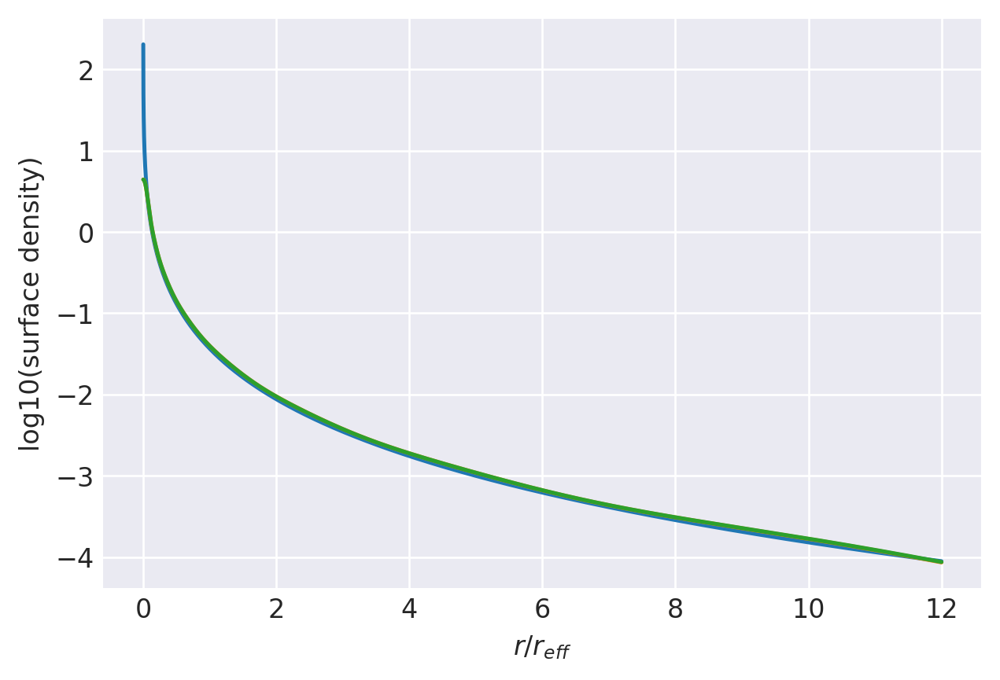

n=5.85: (
    normalize(np.array([1.5739022615e-01, 1.7422343068e-01, 1.7969219487e-01, 1.6337990362e-01, 1.3154705001e-01, 9.4945776540e-02, 6.1866360171e-02, 3.6955057961e-02])),
    np.array([6.8211710081e+00, 2.8871288624e+00, 1.4365100224e+00, 7.4636184241e-01, 3.9441192685e-01, 2.0922478862e-01, 1.1024432130e-01, 5.6881096885e-02]),
),
[157, 24000]
0.9378773378820429 0.9815777179119339
prev.  chisq = -8.707695772614773
ws, re: (array([0.15739023, 0.17422343, 0.17969219, 0.1633799 , 0.13154705,
       0.09494578, 0.06186636, 0.03695506]), array([6.82117101, 2.88712886, 1.43651002, 0.74636184, 0.39441193,
       0.20922479, 0.11024432, 0.0568811 ]))
         Current function value: -8.909238
         Iterations: 21
         Function evaluations: 1523
         Gradient evaluations: 89
-8.909237570624716 [-1.67391452 -1.34640964 -1.00462944 -0.69395019 -0.39302561 -0.04572242
  0.51020074  0.83485964  0.46112056  0.1578947  -0.12648289 -0.40343638
 -0.67862893 -0.95660235 -1.24352459

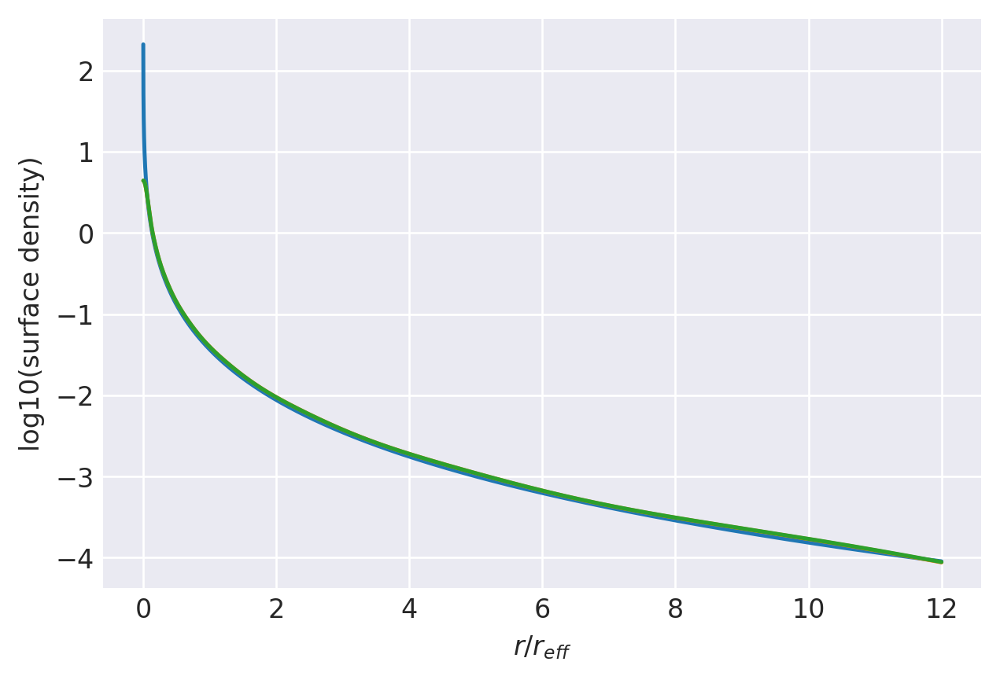

n=5.9: (
    normalize(np.array([1.5790296976e-01, 1.7385764451e-01, 1.7910966823e-01, 1.6295596744e-01, 1.3144448516e-01, 9.5139146782e-02, 6.2229236912e-02, 3.7360881205e-02])),
    np.array([6.8369064228e+00, 2.8914824132e+00, 1.4384497624e+00, 7.4733808490e-01, 3.9496955108e-01, 2.0959024738e-01, 1.1050900082e-01, 5.7078875859e-02]),
),
[159, 24000]
0.9369819056527391 0.9813344786026514
prev.  chisq = -8.726528789840224
ws, re: (array([0.15790297, 0.17385764, 0.17910967, 0.16295597, 0.13144449,
       0.09513915, 0.06222924, 0.03736088]), array([6.83690642, 2.89148241, 1.43844976, 0.74733808, 0.39496955,
       0.20959025, 0.110509  , 0.05707888]))
         Current function value: -8.921220
         Iterations: 21
         Function evaluations: 1610
         Gradient evaluations: 94
-8.92122007372474 [-1.67088454 -1.34960587 -1.01028566 -0.70071479 -0.40024324 -0.05281272
  0.50394945  0.83612958  0.46225104  0.15920747 -0.1249387  -0.40159524
 -0.67637794 -0.95377668 -1.23990628]


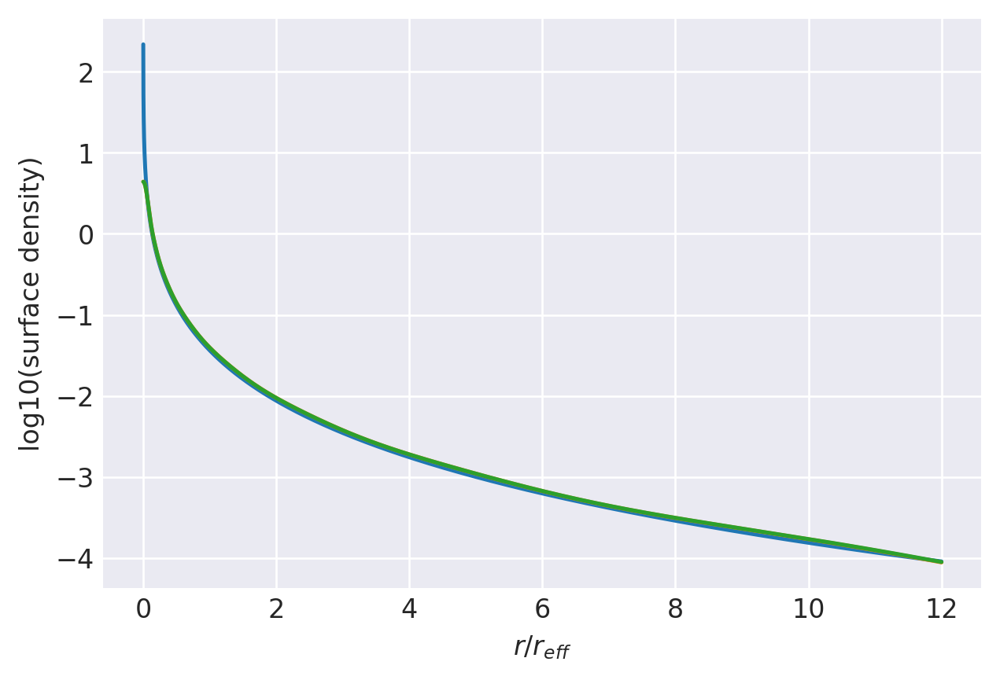

n=5.95: (
    normalize(np.array([1.5830628284e-01, 1.7333403922e-01, 1.7840120614e-01, 1.6249657343e-01, 1.3139536393e-01, 9.5445167028e-02, 6.2726053960e-02, 3.7895313461e-02])),
    np.array([6.8569277780e+00, 2.8990188290e+00, 1.4428044356e+00, 7.5000006238e-01, 3.9664753279e-01, 2.1067939312e-01, 1.1123035490e-01, 5.7556412573e-02]),
),
[160, 24000]
0.9360892302700337 0.9810522785524004
prev.  chisq = -8.7324561425038
ws, re: (array([0.15830628, 0.17333404, 0.17840121, 0.16249657, 0.13139536,
       0.09544517, 0.06272605, 0.03789531]), array([6.85692778, 2.89901883, 1.44280444, 0.75000006, 0.39664753,
       0.21067939, 0.11123035, 0.05755641]))
         Current function value: -8.926536
         Iterations: 21
         Function evaluations: 1626
         Gradient evaluations: 95
-8.926535654080263 [-1.66714487 -1.35144663 -1.01431749 -0.70581288 -0.40581123 -0.05834895
  0.49904726  0.83710313  0.46289339  0.15979101 -0.12436562 -0.40097126
 -0.67560894 -0.95272935 -1.23840674]


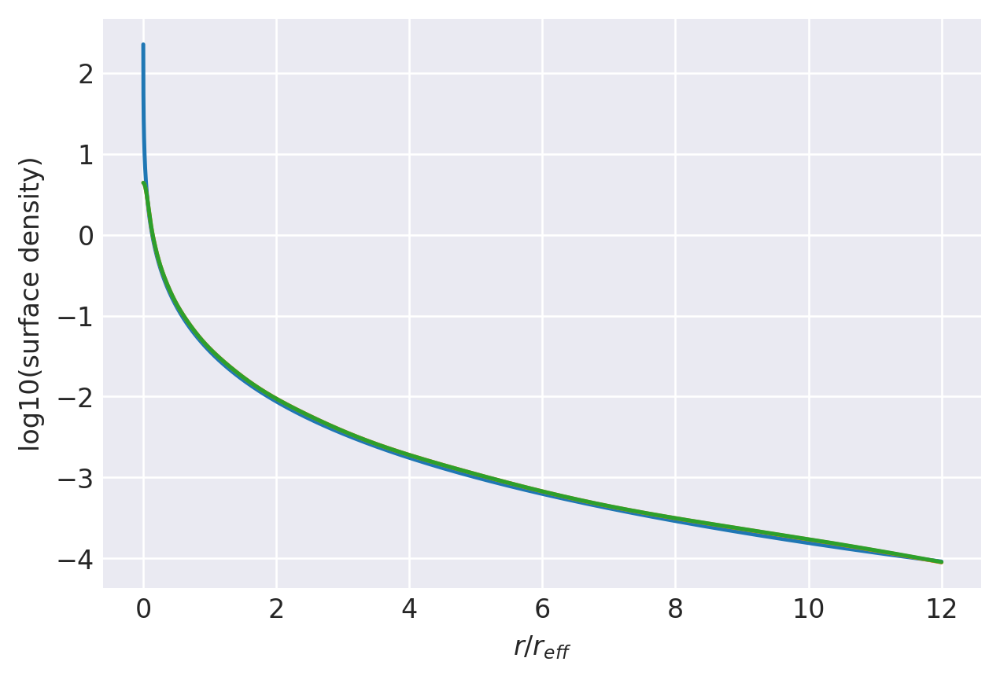

n=6.0: (
    normalize(np.array([1.5880521368e-01, 1.7297821995e-01, 1.7783632507e-01, 1.6208278191e-01, 1.3129171313e-01, 9.5629918791e-02, 6.3079629293e-02, 3.8296198180e-02])),
    np.array([6.8723161958e+00, 2.9033098640e+00, 1.4447443522e+00, 7.5099038564e-01, 3.9721783682e-01, 2.1105277388e-01, 1.1149891664e-01, 5.7755487715e-02]),
),
[160, 24000]
0.9351993699803799 0.9808111693813795
prev.  chisq = -8.731472084546148
ws, re: (array([0.15880521, 0.17297822, 0.17783633, 0.16208278, 0.13129171,
       0.09562992, 0.06307963, 0.0382962 ]), array([6.8723162 , 2.90330986, 1.44474435, 0.75099039, 0.39721784,
       0.21105277, 0.11149892, 0.05775549]))
         Current function value: -8.925223
         Iterations: 22
         Function evaluations: 1576
         Gradient evaluations: 92
-8.925223455597047 [-1.66273201 -1.35197649 -1.0167759  -0.70928382 -0.40978463 -0.06238608
  0.49544936  0.83778326  0.46305379  0.15965427 -0.12475294 -0.40155133
 -0.67630369 -0.95343643 -1.23899462]

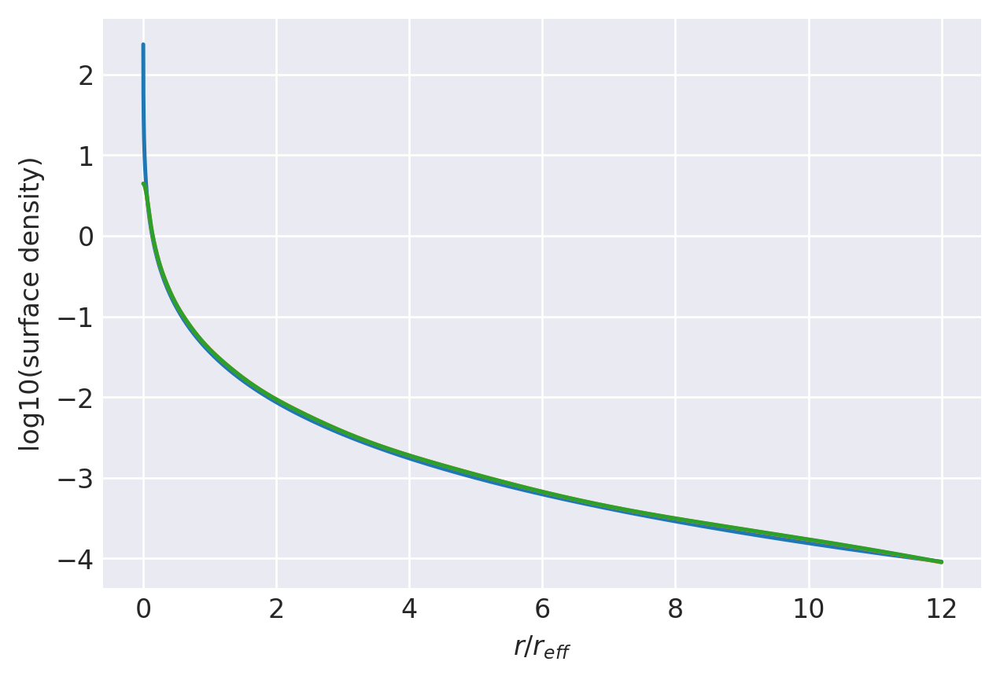

n=6.05: (
    normalize(np.array([1.5939559775e-01, 1.7278407263e-01, 1.7741040478e-01, 1.6171615928e-01, 1.3113690204e-01, 9.5698231024e-02, 6.3293866242e-02, 3.8564766241e-02])),
    np.array([6.8830870746e+00, 2.9043823509e+00, 1.4442895579e+00, 7.5032092675e-01, 3.9668764320e-01, 2.1071541506e-01, 1.1131753335e-01, 5.7677360642e-02]),
),
[160, 24000]
0.934312379505222 0.9806121212913215
prev.  chisq = -8.734965935724873
ws, re: (array([0.1593956 , 0.17278407, 0.1774104 , 0.16171616, 0.1311369 ,
       0.09569823, 0.06329387, 0.03856477]), array([6.88308707, 2.90438235, 1.44428956, 0.75032093, 0.39668764,
       0.21071542, 0.11131753, 0.05767736]))
         Current function value: -8.923961
         Iterations: 21
         Function evaluations: 1218
         Gradient evaluations: 71
-8.923961101559641 [-1.65840596 -1.35251855 -1.01921365 -0.71271544 -0.41370987 -0.06636953
  0.49190412  0.83845298  0.46321272  0.15952156 -0.12513254 -0.40212087
 -0.67698599 -0.95413078 -1.23957179]

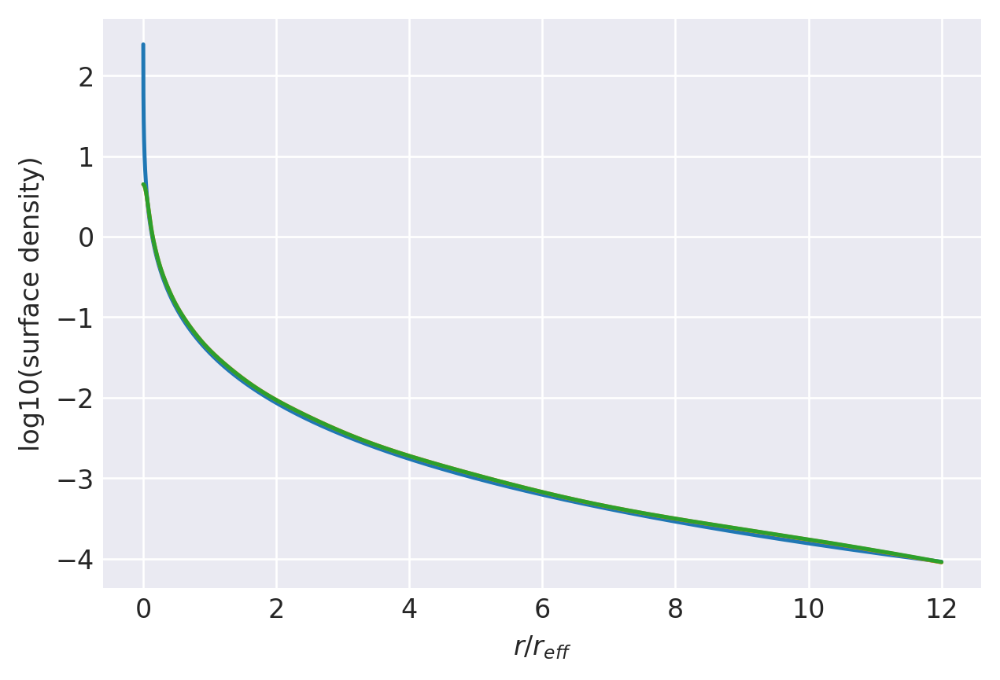

n=6.1: (
    normalize(np.array([1.5997609374e-01, 1.7259040825e-01, 1.7699041544e-01, 1.6135533493e-01, 1.3098445878e-01, 9.5765845080e-02, 6.3506001321e-02, 3.8831442459e-02])),
    np.array([6.8937094968e+00, 2.9054453777e+00, 1.4438482832e+00, 7.4966538550e-01, 3.9616776297e-01, 2.1038462988e-01, 1.1113970107e-01, 5.7600759349e-02]),
),
[160, 24000]
0.9334283101933241 0.9804148657590189
prev.  chisq = -8.738362861294522
ws, re: (array([0.15997609, 0.17259041, 0.17699042, 0.16135533, 0.13098446,
       0.09576585, 0.063506  , 0.03883144]), array([6.8937095 , 2.90544538, 1.44384828, 0.74966539, 0.39616776,
       0.21038463, 0.1111397 , 0.05760076]))
         Current function value: -8.922747
         Iterations: 23
         Function evaluations: 1202
         Gradient evaluations: 70
-8.92274713406223 [-1.65414834 -1.35305035 -1.02161549 -0.7160997  -0.41757805 -0.07029821
  0.48840619  0.83910783  0.46336246  0.15938242 -0.12551478 -0.40269002
 -0.67766579 -0.95482099 -1.2401445 ]


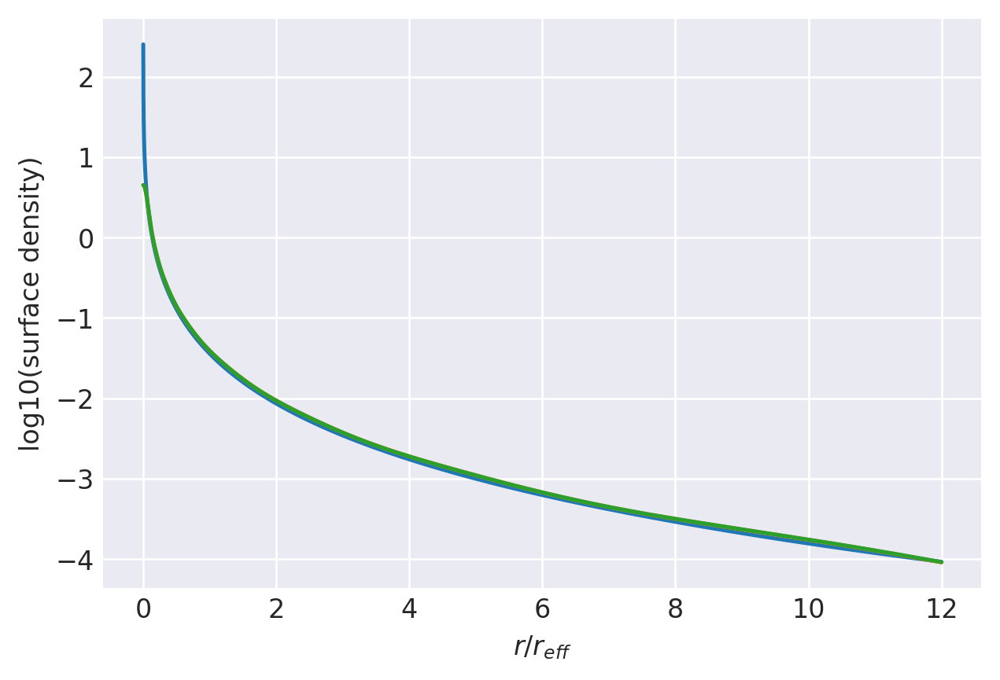

n=6.15: (
    normalize(np.array([1.6054907710e-01, 1.7239981886e-01, 1.7657699373e-01, 1.6099931987e-01, 1.3083326873e-01, 9.5831162046e-02, 6.3714756590e-02, 3.9095603066e-02])),
    np.array([6.9041120896e+00, 2.9064473470e+00, 1.4433857740e+00, 7.4900586575e-01, 3.9564891406e-01, 2.1005557501e-01, 1.1096320980e-01, 5.7524850510e-02]),
),
[160, 24000]
0.9325472101668009 0.9802200194670541
prev.  chisq = -8.741699222449991
ws, re: (array([0.16054908, 0.17239982, 0.17657699, 0.16099932, 0.13083327,
       0.09583116, 0.06371476, 0.0390956 ]), array([6.90411209, 2.90644735, 1.44338577, 0.74900587, 0.39564891,
       0.21005558, 0.11096321, 0.05752485]))
         Current function value: -8.921580
         Iterations: 22
         Function evaluations: 1287
         Gradient evaluations: 75
-8.921580162780156 [-1.6499736  -1.35359316 -1.02399723 -0.71944729 -0.42140195 -0.07417573
  0.48495933  0.83975316  0.46351104  0.15924729 -0.12588939 -0.40324854
 -0.67833296 -0.95549845 -1.2407067 

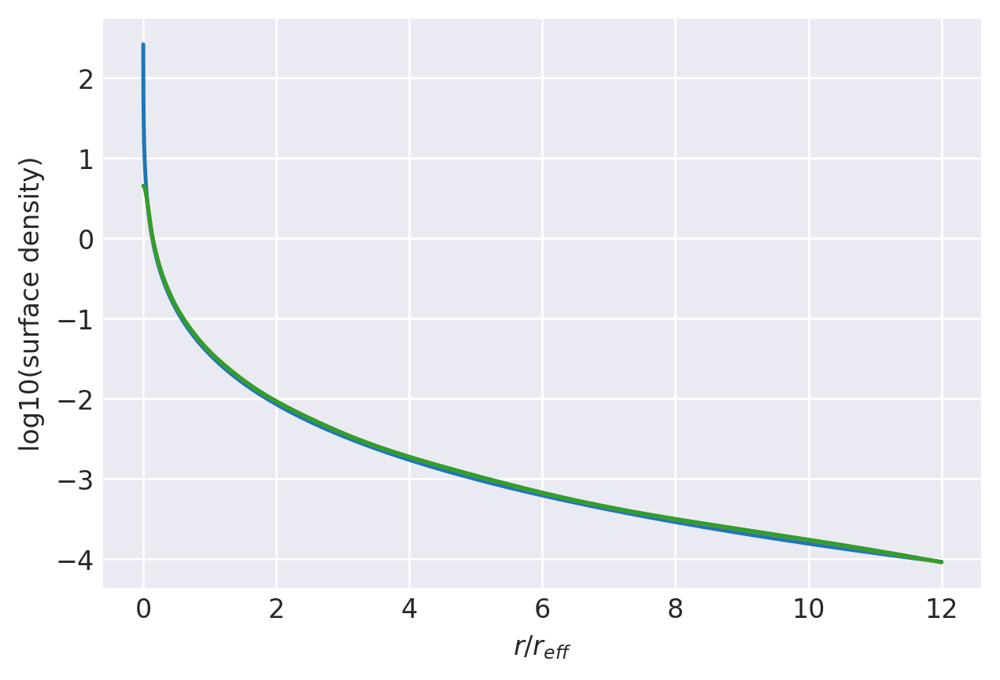

n=6.2: (
    normalize(np.array([1.6111251741e-01, 1.7220980414e-01, 1.7616925702e-01, 1.6064872055e-01, 1.3068425360e-01, 9.5895920088e-02, 6.3921585515e-02, 3.9357941685e-02])),
    np.array([6.9143786380e+00, 2.9074418623e+00, 1.4429367361e+00, 7.4836007803e-01, 3.9514041887e-01, 2.0973312872e-01, 1.1079025219e-01, 5.7450432616e-02]),
),
[160, 24000]
0.9316691244610893 0.9800268828797822
prev.  chisq = -8.744943676076716
ws, re: (array([0.16111252, 0.1722098 , 0.17616926, 0.16064872, 0.13068425,
       0.09589592, 0.06392159, 0.03935794]), array([6.91437864, 2.90744186, 1.44293674, 0.74836008, 0.39514042,
       0.20973313, 0.11079025, 0.05745043]))
         Current function value: -8.920459
         Iterations: 24
         Function evaluations: 1644
         Gradient evaluations: 96
-8.92045883494759 [-1.64587417 -1.35413957 -1.02635417 -0.72275545 -0.42517793 -0.078002
  0.48156084  0.8403874   0.46365587  0.15911268 -0.1262599  -0.40380013
 -0.6789913  -0.95616648 -1.24126072]
0.

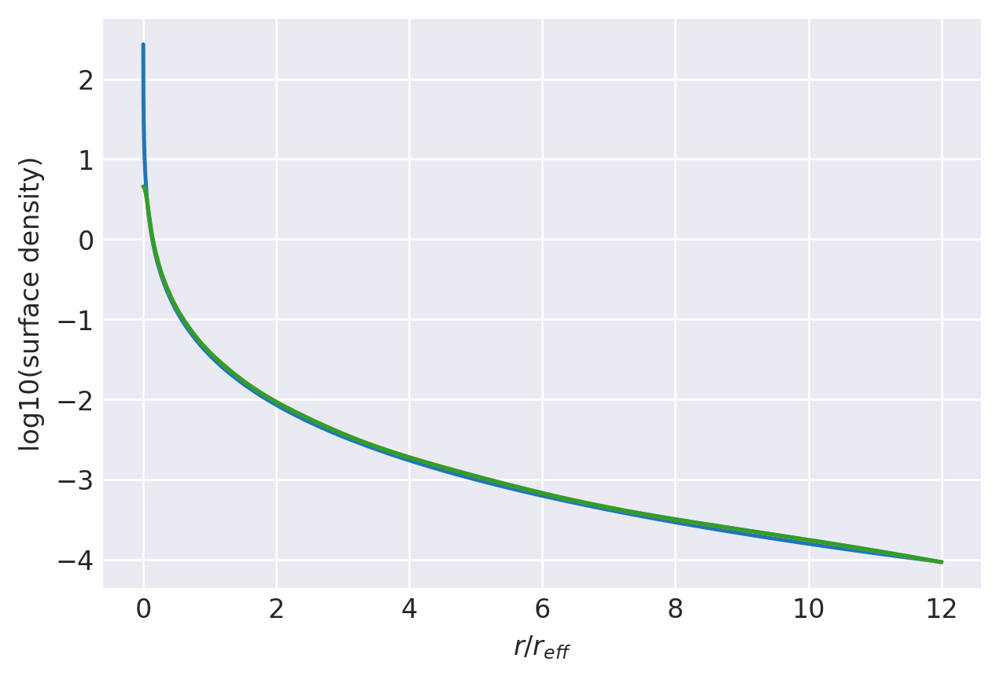

n=6.25: (
    normalize(np.array([1.6166734733e-01, 1.7202118758e-01, 1.7576732438e-01, 1.6030320406e-01, 1.3053710318e-01, 9.5959565440e-02, 6.4126031103e-02, 3.9618236920e-02])),
    np.array([6.9244836718e+00, 2.9084116340e+00, 1.4424895480e+00, 7.4772189075e-01, 3.9463888435e-01, 2.0941544071e-01, 1.1061996530e-01, 5.7377190439e-02]),
),
[160, 24000]
0.9307940951591035 0.9798356963771383
prev.  chisq = -8.748109074133037
ws, re: (array([0.16166735, 0.17202119, 0.17576732, 0.1603032 , 0.1305371 ,
       0.09595957, 0.06412603, 0.03961824]), array([6.92448367, 2.90841163, 1.44248955, 0.74772189, 0.39463888,
       0.20941544, 0.11061997, 0.05737719]))
         Current function value: -8.919382
         Iterations: 23
         Function evaluations: 1491
         Gradient evaluations: 87
-8.919381848784107 [-1.64184913 -1.35469406 -1.02869043 -0.72602398 -0.42890808 -0.08177746
  0.47821297  0.84101099  0.46379792  0.15898035 -0.12662484 -0.40434368
 -0.67963978 -0.95682457 -1.24180644

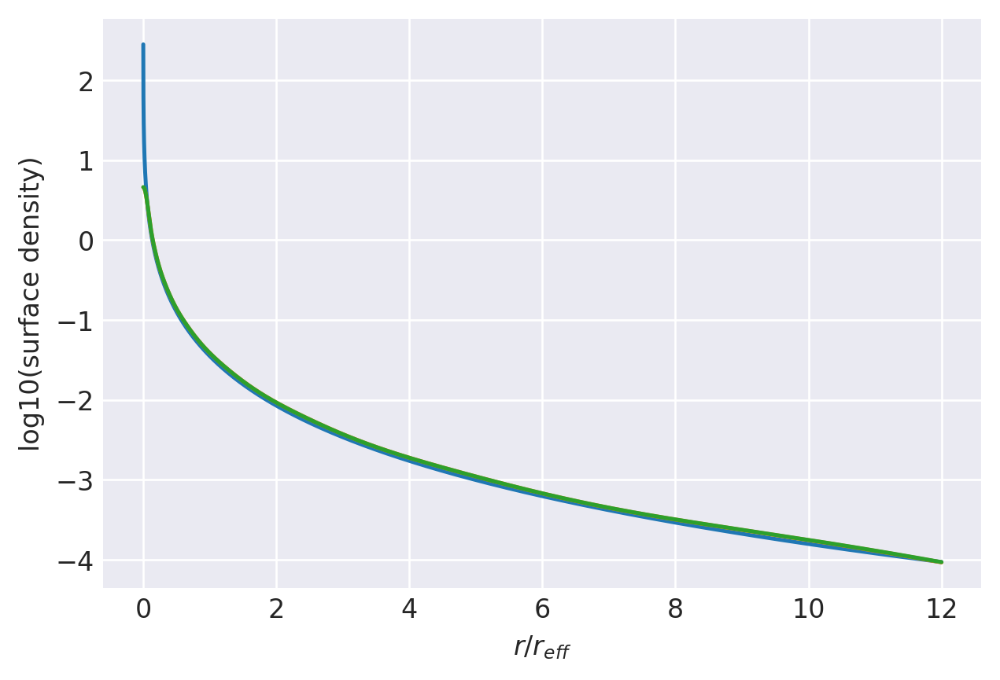

n=6.3: (
    normalize(np.array([1.6221360762e-01, 1.7183334920e-01, 1.7537078997e-01, 1.5996309766e-01, 1.3039193090e-01, 9.6022373759e-02, 6.4328343365e-02, 3.9876507521e-02])),
    np.array([6.9344335765e+00, 2.9093630458e+00, 1.4420501149e+00, 7.4709385141e-01, 3.9414526861e-01, 2.0910297790e-01, 1.1045247049e-01, 5.7305137553e-02]),
),


In [8]:
# Fit for n>1. It works well enough up to n=2
# For n>2, the steep cusp requires components to migrate in further and further, degrading the quality of the fit at R/Re > 4
# Since we aren't convinced that real galaxies are that cuspy, we skip fitting a small fraction of the interior profile
# The arbitrary fraction I picked (linearly scaling from 0 to 0.08)
def funcrangefitn(radii, n):
    nbins = len(radii)
    facn = np.max([0, np.min([1, (np.log10(n)-np.log10(2.5))/np.log10(2.4)])])
    # np.int(np.floor(nbins*(1-facn/3.)))
    ranges = [np.int(np.ceil(facn*nbins*2./300.)), nbins]
    print(ranges)
    return range(ranges[0], ranges[1])

nvals = [
    (
        np.array([
            1.0208, 1.0339, 1.0471, 1.0605, 1.0741, 1.0879, 1.1   , 1.1159,
            1.1302, 1.1447, 1.1593, 1.1742, 1.1892, 1.2   , 1.2199, 1.2355,
            1.2513, 1.2674, 1.2836, 1.3   , 1.3167, 1.3335, 1.3506, 1.3679,
            1.3854, 1.4   , 1.4212, 1.4394, 1.4578, 1.4765, 1.5, 1.5145,
            1.5339, 1.5536, 1.5735, 1.6   , 1.6141, 1.6347, 1.6557, 1.6769,
            1.7   , 1.7201, 1.7421, 1.7644, 1.787 , 1.8   , 1.8331, 1.8566,
            1.8804, 1.9   , 1.9289, 1.9536, 1.9786, 2.00
        ]),
        (
            normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01,
                                6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
            np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01,
                      2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
        ),
    )
]
fitweights(nvals, rmid, areasq, funcrangefit=funcrangefitn)

nvals = [
    (
        np.array(
            [2.0296, 2.0556, 2.0819, 2.1  , 2.1356, 2.1629, 2.2    , 2.2187,
             2.2471, 2.2759, 2.3   , 2.3346, 2.3645, 2.4  , 2.4254, 2.4565,
             2.488 , 2.5]),
        (
            normalize(np.array([ 8.6786769683e-02, 2.4176453099e-01, 2.8779186939e-01, 2.1343443685e-01,
                                1.1231134945e-01, 4.3640638991e-02, 1.2176475895e-02, 2.0939287582e-03])),
            np.array([ 4.1155063160e+00, 2.1020886021e+00, 1.1526642463e+00, 6.3789997527e-01,
                      3.4521695030e-01, 1.7714420272e-01, 8.2108746458e-02, 3.0415333466e-02]),
        ),
    )
]

fitweights(nvals, rmid, areasq, funcrangefit=funcrangefitn)

nvals = [
    (
        np.array(
            [2.5, 2.5198, 2.5521, 2.5848, 2.6179, 2.6514, 2.6854, 2.7198, 2.7546,
             2.7899, 2.8257, 2.8618, 2.8985, 2.9356, 2.9732, 3.0 ]),
        (
            normalize(np.array([ 1.0465547867e-01, 2.4008597270e-01, 2.7239208886e-01, 2.0519591023e-01,
                                1.1342203380e-01, 4.7217736561e-02, 1.4312226030e-02, 2.7185531542e-03])),
            np.array([ 4.7894696441e+00, 2.2273298579e+00, 1.1419220697e+00, 5.9651385580e-01,
                      3.0620378278e-01, 1.4938227518e-01, 6.5825097965e-02, 2.3094019025e-02]),
        ),
    )
]

fitweights(nvals, rmid, areasq, funcrangefit=funcrangefitn)

nvals = [
    (
        np.array(
            [3.0499, 3.0889,
            3.1285, 3.1686, 3.2092, 3.25  , 3.2919, 3.3341, 3.3768, 3.42  ,
            3.4638, 3.5   , 3.5531, 3.5986, 3.6447, 3.6914, 3.7387, 3.7866,
            3.8351, 3.8842, 3.934 , 4.0   , 4.05, 4.10, 4.15,
            4.20, 4.25, 4.30, 4.35, 4.40, 4.45, 4.50, 4.55, 4.60,
            4.65, 4.70, 4.75, 4.80, 4.85, 4.90, 4.95, 5.00, 5.05,
            5.10, 5.15, 5.20, 5.25, 5.30, 5.35, 5.40, 5.45, 5.50,
            5.55, 5.60, 5.65, 5.70, 5.75, 5.80, 5.85, 5.90, 5.95,
            6.00, 6.05, 6.10, 6.15, 6.20, 6.25, 6.3]),
        (
            normalize(np.array([ 1.2367623181e-01, 2.2887390775e-01, 2.4975709188e-01, 1.9583759885e-01,
                                1.1854973966e-01, 5.6654116755e-02, 2.1027058753e-02, 5.6242545506e-03])),
            np.array([ 5.0615225936e+00, 2.2897467891e+00, 1.1502404897e+00, 5.9253925462e-01,
                      3.0273090838e-01, 1.4923473371e-01, 6.8490353260e-02, 2.7330846945e-02]),
        ),
    )
]

fitweights(nvals, rmid, areasq, funcrangefit=funcrangefitn)

## The graveyard of failed ideas

These are best-fit weights from the unsuccesful attempts - keeping both the weights and sizes free and either dropping components manually or keeping N=8 fixed and hoping for the best. We'll plot these up later along with the more successful fixed size below n=1 approach.

In [9]:
# Test out various spline weighting methods
# This first one is S-M-R-T I mean S-M-A-R-T
weightvarssmrtrev = {
    1.0: (
        normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
        np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
    ),
    0.95: (
        normalize(np.array([8.1403269909e-02, 3.2580644822e-01, 3.4058504404e-01, 1.7513222856e-01, 5.9192552167e-02, 1.4829085839e-02, 2.7394820156e-03, 3.1188925295e-04])),
        np.array([2.0580646746e+00, 1.4290161052e+00, 9.7686981214e-01, 6.4569266618e-01, 4.0748443014e-01, 2.4091847021e-01, 1.2844509011e-01, 5.5475573206e-02]),
    ),
    0.9: (
        normalize(np.array([8.3272428552e-02, 3.3761909938e-01, 3.4261897732e-01, 1.6737529882e-01, 5.3685032163e-02, 1.2877296215e-02, 2.2983216755e-03, 2.5354586925e-04])),
        np.array([1.9527835416e+00, 1.3873099285e+00, 9.6414763955e-01, 6.4496927062e-01, 4.1081182437e-01, 2.4485938373e-01, 1.3161541508e-01, 5.7397686985e-02]),
    ),
    0.85: (
        normalize(np.array([8.8648139071e-02, 3.5515361752e-01, 3.4150494943e-01, 1.5534344140e-01, 4.6674515325e-02, 1.0649023584e-02, 1.8309459995e-03, 1.9536767345e-04])),
        np.array([1.8404078380e+00, 1.3380994716e+00, 9.4543542703e-01, 6.3983409725e-01, 4.1113219993e-01, 2.4697493906e-01, 1.3384622629e-01, 5.8963889270e-02]),
    ),
    0.8: (
        normalize(np.array([9.5687123517e-02, 3.7600373993e-01, 3.3791793777e-01, 1.4102874894e-01, 3.9315698812e-02, 8.4969058837e-03, 1.4050252856e-03, 1.4481985933e-04])),
        np.array([1.7282573092e+00, 1.2882067554e+00, 9.2633448695e-01, 6.3439449883e-01, 4.1120486913e-01, 2.4896361205e-01, 1.3607248303e-01, 6.0593077676e-02]),
    ),
    0.75: (
        normalize(np.array([1.0845562525e-01, 4.0294151495e-01, 3.2729844440e-01, 1.2246687144e-01, 3.1333936150e-02, 6.3893051250e-03, 1.0137209694e-03, 1.0058171985e-04])),
        np.array([1.6116987996e+00, 1.2333069456e+00, 9.0359039048e-01, 6.2645430811e-01, 4.0957694795e-01, 2.5288574221e-01, 1.3272691536e-01, 6.1993912159e-02]),
    ),
    0.7: (
        normalize(np.array([1.1584759935e-01, 4.4925832966e-01, 3.1925666847e-01, 9.4161947089e-02, 1.8473365773e-02, 2.7452558180e-03, 2.5683384766e-04, 0])),
        np.array([1.5085840400e+00, 1.1827064676e+00, 8.7020346704e-01, 5.9083650141e-01, 3.6842090584e-01, 2.0622530253e-01, 9.4309343285e-02, 6.3000000000e-02]),
    ),
    0.65: (
        normalize(np.array([2.6183027504e-01, 5.1131393105e-01, 1.8810590649e-01, 3.3865510527e-02, 4.4969433749e-03, 3.8743351832e-04, 0, 0])),
        np.array([1.3289631973e+00, 1.0385774455e+00, 7.3841834696e-01, 4.7109549871e-01, 2.6719483672e-01, 1.2384372936e-01, 3.0000000000e-02, -1]),
    ),
    0.60: (
        normalize(np.array([4.1546178873e-01, 4.7896375027e-01, 9.4459324448e-02, 1.0342408068e-02, 7.7272848509e-04, 0, 0, 0])),
        np.array([1.2056568803e+00, 9.5376794968e-01, 6.5169818599e-01, 3.7969948423e-01, 1.7909375620e-01, 4.0e-2, -1, -1]),
    ),
    #0.58: (
    #    normalize(np.array([4.5627440940e-01, 4.5801419853e-01, 7.7273178826e-02, 7.8676616590e-03, 5.7055159001e-04, 0, 0, 0])),
    #    np.array([1.1683467566e+00, 9.4363227290e-01, 6.5093086112e-01, 3.8085301923e-01, 1.8069824796e-01, -1, -1, -1]),
    #),
    0.56: (
        normalize(np.array([5.1383520859e-01, 4.2259270295e-01, 5.7812648759e-02, 5.3832054183e-03, 3.7623428159e-04, 0, 0, 0])),
        np.array([1.1295299365e+00, 9.3257427802e-01, 6.4722357532e-01, 3.7870305436e-01, 1.8038588490e-01, -1, -1, -1]),
    ),
    0.55: (
        normalize(np.array([5.5214529709e-01, 3.9529450455e-01, 4.7928536367e-02, 4.3319689703e-03, 2.9969302520e-04, 0, 0, 0])),
        np.array([1.1094018518e+00, 9.2705543556e-01, 6.4619989426e-01, 3.7926137736e-01, 1.8130968040e-01, -1, -1, -1]),
    ),
    0.54: (
        normalize(np.array([5.9919829101e-01, 3.5948801370e-01, 3.7771361281e-02, 3.3145069862e-03, 2.2782702383e-04, 0, 0, 0])),
        np.array([1.0888531764e+00, 9.2149653125e-01, 6.4439708848e-01, 3.7928399702e-01, 1.8209937478e-01, -1, -1, -1]),
    ),
    0.535: (
        normalize(np.array([6.3126439025e-01, 3.3392767586e-01, 3.1879935445e-02, 2.7407850764e-03, 1.8721337590e-04, 0, 0, 0])),
        np.array([1.0779584267e+00, 9.1705503997e-01, 6.4002041507e-01, 3.7627159296e-01, 1.8081161389e-01, -1, -1, -1]),
    ),
    0.515: (
        normalize(np.array([8.4097559276e-01, 1.5169627279e-01, 6.9714772900e-03, 3.5665715873e-04, 0, 0, 0, 0])),
        np.array([1.0309116597e+00, 8.7408078966e-01, 5.5036185175e-01, 2.6808638784e-01, 1.60e-01, -1, -1, -1]),
    ),
    0.507: (
        normalize(np.array([9.4662548327e-01, 5.2171305034e-02, 1.2032116992e-03, 0, 0, 0, 0, 0])),
        np.array([1.0122615136e+00, 8.2195507899e-01, 4.2112943705e-01, 1.5e-1, -1, -1, -1, -1]),
    ),
    0.501: (
        normalize(np.array([9.9645469317e-01, 3.5453068336e-03, 0, 0, 0, 0, 0, 0])),
        np.array([1.0012334877e+00, 7.1605157116e-01, 3.2e-1, -1, -1, -1, -1, -1]),
    ),
}
weightvarssmrt = {key: weightvarssmrtrev[key] for key in list(weightvarssmrtrev.keys())[::-1]}

weightvarslinrev = {
    1.0: (
        normalize(np.array([7.7900190678e-02, 3.1264016273e-01, 3.3937178782e-01, 1.8392530470e-01, 6.5418042323e-02, 1.7095071454e-02, 3.2661231097e-03, 3.8331719642e-04])),
        np.array([2.1704566125e+00, 1.4767913255e+00, 9.9494464239e-01, 6.5054022453e-01, 4.0699848261e-01, 2.3877605265e-01, 1.2631552536e-01, 5.4058147753e-02])
    ),
    0.995: (
        normalize(np.array([7.8446183932e-02, 3.1406434947e-01, 3.3932384870e-01, 1.8296223981e-01, 6.4764639051e-02, 1.6854415782e-02, 3.2090104756e-03, 3.7531277364e-04])),
        np.array([2.1583165776e+00, 1.4713798133e+00, 9.9276532523e-01, 6.4986444561e-01, 4.0693622906e-01, 2.3891710322e-01, 1.2647686885e-01, 5.4168977602e-02]),
    ),
    0.99: (
        normalize(np.array([7.8748882011e-02, 3.1527662000e-01, 3.3948179457e-01, 1.8216089349e-01, 6.4173199336e-02, 1.6633815653e-02, 3.1566703056e-03, 3.6812463680e-04])),
        np.array([2.1471476039e+00, 1.4667048040e+00, 9.9104503426e-01, 6.4944861490e-01, 4.0703634466e-01, 2.3916382111e-01, 1.2670689594e-01, 5.4317404722e-02]),
    ),
    0.985: (
        normalize(np.array([7.8994186452e-02, 3.1641620349e-01, 3.3968469926e-01, 1.8140525885e-01, 6.3605998603e-02, 1.6424599579e-02, 3.1076505756e-03, 3.6140318626e-04])),
        np.array([2.1362142657e+00, 1.4622314919e+00, 9.8948045158e-01, 6.4914027013e-01, 4.0722153691e-01, 2.3947910549e-01, 1.2698412679e-01, 5.4487684484e-02]),
    ),
    0.98: (
        normalize(np.array([7.8389101272e-02, 3.1638765311e-01, 3.4043547772e-01, 1.8156010509e-01, 6.3463387972e-02, 1.6329208096e-02, 3.0783508966e-03, 3.5671584639e-04])),
        np.array([2.1282781338e+00, 1.4604809912e+00, 9.9010354726e-01, 6.5040118063e-01, 4.0839544944e-01, 2.4033837843e-01, 1.2751651151e-01, 5.4759268657e-02]),
    ),
    0.975: (
        normalize(np.array([7.8492259575e-02, 3.1733990238e-01, 3.4064424822e-01, 1.8096336632e-01, 6.3017149586e-02, 1.6156519811e-02, 3.0357224100e-03, 3.5083170430e-04])),
        np.array([2.1178361862e+00, 1.4564466460e+00, 9.8896894906e-01, 6.5051832346e-01, 4.0890150279e-01, 2.4083944712e-01, 1.2788064118e-01, 5.4971854773e-02]),
    ),
    0.97: (
        normalize(np.array([7.8803523011e-02, 3.1858245887e-01, 3.4085154814e-01, 1.8013538246e-01, 6.2376851464e-02, 1.5922265126e-02, 2.9838701624e-03, 3.4410076591e-04])),
        np.array([2.1066586105e+00, 1.4517852082e+00, 9.8724682936e-01, 6.5003217856e-01, 4.0891261440e-01, 2.4105316221e-01, 1.2812638619e-01, 5.5135777007e-02]),
    ),
    0.965: (
        normalize(np.array([7.9652906813e-02, 3.2064939074e-01, 3.4068122966e-01, 1.7869038231e-01, 6.1466919163e-02, 1.5610725907e-02, 2.9134649523e-03, 3.3498045458e-04])),
        np.array([2.0937412212e+00, 1.4454149529e+00, 9.8410731982e-01, 6.4852336195e-01, 4.0824832753e-01, 2.4081266904e-01, 1.2808520606e-01, 5.5176596936e-02]),
    ),
    0.96: (
        normalize(np.array([8.0576453325e-02, 3.2290280030e-01, 3.4043969613e-01, 1.7709543098e-01, 6.0518663358e-02, 1.5295811356e-02, 2.8452778659e-03, 3.2586667691e-04])),
        np.array([2.0807024304e+00, 1.4388256059e+00, 9.8071976898e-01, 6.4685562505e-01, 4.0752304916e-01, 2.4056824190e-01, 1.2805531444e-01, 5.5198631668e-02]),
    ),
    0.955: (
        normalize(np.array([8.1040966768e-02, 3.2441065469e-01, 3.4047060583e-01, 1.7607117085e-01, 5.9838132967e-02, 1.5058095207e-02, 2.7915913744e-03, 3.1878231861e-04])),
        np.array([2.0692003931e+00, 1.4337627137e+00, 9.7867808047e-01, 6.4620077939e-01, 4.0746271722e-01, 2.4072384138e-01, 1.2824200177e-01, 5.5335703966e-02]),
    ),
    0.95: (
        normalize(np.array([8.1450263763e-02, 3.2585428363e-01, 3.4053884485e-01, 1.7509555332e-01, 5.9182670718e-02, 1.4827402200e-02, 2.7392015200e-03, 3.1177999432e-04])),
        np.array([2.0579132805e+00, 1.4288880244e+00, 9.7678450884e-01, 6.4564909129e-01, 4.0746517450e-01, 2.4090898319e-01, 1.2843833062e-01, 5.5469238331e-02]),
    ),
    0.945: (
        normalize(np.array([8.0838455136e-02, 3.2567038291e-01, 3.4122816179e-01, 1.7534334294e-01, 5.9123091044e-02, 1.4767026054e-02, 2.7206010931e-03, 3.0893902196e-04])),
        np.array([2.0497666873e+00, 1.4271898496e+00, 9.7773166817e-01, 6.4732448277e-01, 4.0900680557e-01, 2.4205144694e-01, 1.2917105921e-01, 5.5858036130e-02]),
    ),
    0.94: (
        normalize(np.array([8.1026477351e-02, 3.2706329786e-01, 3.4151639944e-01, 1.7442331104e-01, 5.8463968941e-02, 1.4536816076e-02, 2.6680176172e-03, 3.0171168430e-04])),
        np.array([2.0392493702e+00, 1.4227973744e+00, 9.7605089889e-01, 6.4682602711e-01, 4.0901861837e-01, 2.4223611781e-01, 1.2935204729e-01, 5.5949712693e-02]),
    ),
    0.935: (
        normalize(np.array([8.2608793996e-02, 3.3016404617e-01, 3.4076708635e-01, 1.7218633093e-01, 5.7242376406e-02, 1.4152019485e-02, 2.5875593775e-03, 2.9178728688e-04])),
        np.array([2.0244694038e+00, 1.4145791883e+00, 9.7135282044e-01, 6.4417273119e-01, 4.0759862723e-01, 2.4155666697e-01, 1.2909300116e-01, 5.5910480934e-02]),
    ),
    0.9299999999999999: (
        normalize(np.array([8.3195200740e-02, 3.3186613072e-01, 3.4067638530e-01, 1.7101447113e-01, 5.6519105162e-02, 1.3909585516e-02, 2.5342509203e-03, 2.8487050914e-04])),
        np.array([2.0127911244e+00, 1.4093031664e+00, 9.6914649332e-01, 6.4340574832e-01, 4.0746787463e-01, 2.4166861403e-01, 1.2925452558e-01, 5.6035845282e-02]),
    ),
    0.925: (
        normalize(np.array([8.3674366070e-02, 3.3343562431e-01, 3.4065668849e-01, 1.6994391231e-01, 5.5845486169e-02, 1.3681528262e-02, 2.4840295930e-03, 2.7836479423e-04])),
        np.array([2.0014717439e+00, 1.4043554573e+00, 9.6720954231e-01, 6.4283853473e-01, 4.0746985897e-01, 2.4185994865e-01, 1.2946278551e-01, 5.6177545404e-02]),
    ),
    0.92: (
        normalize(np.array([8.4165170299e-02, 3.3507866152e-01, 3.4065328789e-01, 1.6882186325e-01, 5.5135004238e-02, 1.3442598166e-02, 2.4317766077e-03, 2.7163802453e-04])),
        np.array([1.9901688387e+00, 1.3993713671e+00, 9.6518979512e-01, 6.4215937706e-01, 4.0736856138e-01, 2.4197991939e-01, 1.2962814970e-01, 5.6303836333e-02]),
    ),
    0.915: (
        normalize(np.array([8.4685608679e-02, 3.3672835499e-01, 3.4059929447e-01, 1.6769223015e-01, 5.4437392947e-02, 1.3210544167e-02, 2.3813860072e-03, 2.6518858475e-04])),
        np.array([1.9788118069e+00, 1.3943611333e+00, 9.6319000742e-01, 6.4152969589e-01, 4.0731950121e-01, 2.4214060131e-01, 1.2982060137e-01, 5.6443069751e-02]),
    ),
    0.91: (
        normalize(np.array([8.4639795367e-02, 3.3751957246e-01, 3.4094265997e-01, 1.6721122181e-01, 5.4031664252e-02, 1.3051095694e-02, 2.3436897899e-03, 2.6030065902e-04])),
        np.array([1.9689949080e+00, 1.3909543026e+00, 9.6264069091e-01, 6.4202882897e-01, 4.0801749857e-01, 2.4272153789e-01, 1.3023886593e-01, 5.6700605787e-02]),
    ),
    0.905: (
        normalize(np.array([8.4882545997e-02, 3.3878250060e-01, 3.4107015969e-01, 1.6636706402e-01, 5.3473424762e-02, 1.2866379497e-02, 2.3030523605e-03, 2.5487306717e-04])),
        np.array([1.9584251136e+00, 1.3867269131e+00, 9.6135347483e-01, 6.4197487051e-01, 4.0840315874e-01, 2.4318356990e-01, 1.3059144846e-01, 5.6891288900e-02]),
    ),
    0.9: (
        normalize(np.array([8.5703533382e-02, 3.4065334348e-01, 3.4071270247e-01, 1.6506861300e-01, 5.2737930095e-02, 1.2623183173e-02, 2.2521101669e-03, 2.4858423528e-04])),
        np.array([1.9463115926e+00, 1.3811188552e+00, 9.5902935245e-01, 6.4120347915e-01, 4.0826152697e-01, 2.4327469001e-01, 1.3077386669e-01, 5.7023439004e-02]),
    ),
    0.895: (
        normalize(np.array([8.5458154254e-02, 3.4153725291e-01, 3.4124730054e-01, 1.6453481556e-01, 5.2292052730e-02, 1.2469800331e-02, 2.2166215828e-03, 2.4400209405e-04])),
        np.array([1.9371074385e+00, 1.3780162566e+00, 9.5852602244e-01, 6.4165221702e-01, 4.0896715012e-01, 2.4393075545e-01, 1.3122716473e-01, 5.7305327980e-02]),
    ),
    0.89: (
        normalize(np.array([8.6398784406e-02, 3.4354757875e-01, 3.4081871559e-01, 1.6310825490e-01, 5.1494849325e-02, 1.2226535299e-02, 2.1673987021e-03, 2.3788303682e-04])),
        np.array([1.9247374598e+00, 1.3721958904e+00, 9.5601456385e-01, 6.4070862543e-01, 4.0874741589e-01, 2.4404815862e-01, 1.3142123383e-01, 5.7439206885e-02]),
    ),
    0.885: (
        normalize(np.array([8.8084974452e-02, 3.4687678583e-01, 3.3974234955e-01, 1.6072365430e-01, 5.0357826877e-02, 1.1888425292e-02, 2.0968676722e-03, 2.2911603232e-04])),
        np.array([1.9107495015e+00, 1.3643739615e+00, 9.5155870963e-01, 6.3829809118e-01, 4.0754280841e-01, 2.4344962793e-01, 1.3115645104e-01, 5.7368724912e-02]),
    ),
    0.88: (
        normalize(np.array([8.8899905864e-02, 3.4930941617e-01, 3.3957451456e-01, 1.5902835784e-01, 4.9358164198e-02, 1.1574903093e-02, 2.0334713070e-03, 2.2126697580e-04])),
        np.array([1.8990323184e+00, 1.3586626362e+00, 9.4861408841e-01, 6.3663635565e-01, 4.0661138462e-01, 2.4301837033e-01, 1.3101853050e-01, 5.7351171024e-02]),
    ),
    0.875: (
        normalize(np.array([8.9719526602e-02, 3.5142926885e-01, 3.3921099318e-01, 1.5755096538e-01, 4.8559828433e-02, 1.1330575413e-02, 1.9836112558e-03, 2.1523089106e-04])),
        np.array([1.8873053597e+00, 1.3531714076e+00, 9.4618475353e-01, 6.3567468065e-01, 4.0634035820e-01, 2.4305266056e-01, 1.3115573412e-01, 5.7474898327e-02]),
    ),
    0.87: (
        normalize(np.array([9.0173794580e-02, 3.5305626695e-01, 3.3914329330e-01, 1.5644596456e-01, 4.7908336833e-02, 1.1122835888e-02, 1.9397900348e-03, 2.0971785200e-04])),
        np.array([1.8764623457e+00, 1.3486015892e+00, 9.4458175513e-01, 6.3533351247e-01, 4.0647054491e-01, 2.4331649981e-01, 1.3139635997e-01, 5.7635706855e-02]),
    ),
    0.865: (
        normalize(np.array([8.6135308911e-02, 3.4858939943e-01, 3.4264283849e-01, 1.5992557051e-01, 4.9119505662e-02, 1.1392673784e-02, 1.9814855129e-03, 2.1321770362e-04])),
        np.array([1.8758334412e+00, 1.3547119339e+00, 9.5267476966e-01, 6.4264507752e-01, 4.1193154065e-01, 2.4691539506e-01, 1.3345768182e-01, 5.8584360956e-02]),
    ),
    0.86: (
        normalize(np.array([9.1893982144e-02, 3.5743875849e-01, 3.3828758883e-01, 1.5339871037e-01, 4.6304149921e-02, 1.0638030221e-02, 1.8410136879e-03, 1.9776634136e-04])),
        np.array([1.8530985676e+00, 1.3376427022e+00, 9.3973559093e-01, 6.3340721094e-01, 4.0590116707e-01, 2.4333669448e-01, 1.3162266643e-01, 5.7855812756e-02]),
    ),
    0.855: (
        normalize(np.array([9.2992277469e-02, 3.5990991331e-01, 3.3765530445e-01, 1.5165710017e-01, 4.5423400347e-02, 1.0380318861e-02, 1.7900320433e-03, 1.9165335213e-04])),
        np.array([1.8409946339e+00, 1.3317269709e+00, 9.3692247592e-01, 6.3212525545e-01, 4.0539697018e-01, 2.4322591877e-01, 1.3167801519e-01, 5.7938070264e-02]),
    ),
    0.85: (
        normalize(np.array([9.3551835240e-02, 3.6171683549e-01, 3.3744731541e-01, 1.5042598438e-01, 4.4748981349e-02, 1.0174434506e-02, 1.7480670208e-03, 1.8654660696e-04])),
        np.array([1.8300927975e+00, 1.3270479040e+00, 9.3522659525e-01, 6.3172135114e-01, 4.0549331641e-01, 2.4347813221e-01, 1.3192705300e-01, 5.8109063390e-02]),
    ),
    0.845: (
        normalize(np.array([9.4731750777e-02, 3.6430995164e-01, 3.3671645683e-01, 1.4860049245e-01, 4.3850047871e-02, 9.9143886126e-03, 1.6965107346e-03, 1.8040108880e-04])),
        np.array([1.8179649453e+00, 1.3210617641e+00, 9.3233135201e-01, 6.3036021469e-01, 4.0491744109e-01, 2.4330219140e-01, 1.3193142574e-01, 5.8170286599e-02]),
    ),
    0.84: (
        normalize(np.array([9.5122647908e-02, 3.6533678581e-01, 3.3650928403e-01, 1.4793759852e-01, 4.3467857962e-02, 9.7821189569e-03, 1.6671110371e-03, 1.7659578290e-04])),
        np.array([1.8073505429e+00, 1.3171197157e+00, 9.3177524383e-01, 6.3114866788e-01, 4.0590965353e-01, 2.4408859743e-01, 1.3246051055e-01, 5.8456787024e-02]),
    ),
    0.835: (
        normalize(np.array([9.5834782385e-02, 3.6784648875e-01, 3.3617520517e-01, 1.4619396832e-01, 4.2608433822e-02, 9.5481482517e-03, 1.6218085387e-03, 1.7116476116e-04])),
        np.array([1.7963746527e+00, 1.3119553355e+00, 9.2929714792e-01, 6.2999245689e-01, 4.0554924245e-01, 2.4412492521e-01, 1.3258996701e-01, 5.8571667602e-02]),
    ),
    0.83: (
        normalize(np.array([9.3706282998e-02, 3.6637423180e-01, 3.3834636264e-01, 1.4744646464e-01, 4.2804929506e-02, 9.5404052669e-03, 1.6118076187e-03, 1.6951553096e-04])),
        np.array([1.7907364945e+00, 1.3129369052e+00, 9.3280845738e-01, 6.3356034322e-01, 4.0822237963e-01, 2.4587028939e-01, 1.3362304702e-01, 5.9102911016e-02]),
    ),
    0.825: (
        normalize(np.array([9.2297001446e-02, 3.6600259905e-01, 3.3965641123e-01, 1.4787374741e-01, 4.2861561834e-02, 9.5321025595e-03, 1.6078065254e-03, 1.6876994152e-04])),
        np.array([1.7836886015e+00, 1.3122326759e+00, 9.3479476154e-01, 6.3631626251e-01, 4.1077176020e-01, 2.4777027641e-01, 1.3485972685e-01, 5.9731274619e-02]),
    ),
    0.8200000000000001: (
        normalize(np.array([9.3180282626e-02, 3.6811763616e-01, 3.3933878373e-01, 1.4640937999e-01, 4.1985647417e-02, 9.2541190957e-03, 1.5524119878e-03, 1.6173899923e-04])),
        np.array([1.7721042746e+00, 1.3070260264e+00, 9.3269249807e-01, 6.3532651585e-01, 4.1011161742e-01, 2.4738161812e-01, 1.3467701941e-01, 5.9650583683e-02]),
    ),
    0.815: (
        normalize(np.array([9.2986075986e-02, 3.6919597096e-01, 3.3957384478e-01, 1.4574471404e-01, 4.1643377952e-02, 9.1611137100e-03, 1.5347666747e-03, 1.6013589318e-04])),
        np.array([1.7626653685e+00, 1.3038273322e+00, 9.3249831233e-01, 6.3641114918e-01, 4.1155769995e-01, 2.4866489868e-01, 1.3561269169e-01, 6.0234252436e-02]),
    ),
    0.81: (
        normalize(np.array([9.3496877139e-02, 3.7079293837e-01, 3.3957644974e-01, 1.4461870966e-01, 4.0937308901e-02, 8.9361642321e-03, 1.4873009162e-03, 1.5425104311e-04])),
        np.array([1.7517805029e+00, 1.2994513277e+00, 9.3122215357e-01, 6.3615002551e-01, 4.1150826647e-01, 2.4866762093e-01, 1.3563143012e-01, 6.0257185067e-02]),
    ),
    0.8049999999999999: (
        normalize(np.array([9.4984175915e-02, 3.7382216017e-01, 3.3840867268e-01, 1.4250803643e-01, 4.0003714523e-02, 8.6838919522e-03, 1.4403409377e-03, 1.4900740270e-04])),
        np.array([1.7392869304e+00, 1.2930701017e+00, 9.2809677491e-01, 6.3472324524e-01, 4.1093966321e-01, 2.4853669358e-01, 1.3569676159e-01, 6.0362472446e-02]),
    ),
    0.8: (
        normalize(np.array([9.6836231121e-02, 3.7727681530e-01, 3.3682465858e-01, 1.4006704302e-01, 3.9017221139e-02, 8.4382063067e-03, 1.3958748554e-03, 1.4394968957e-04])),
        np.array([1.7263009193e+00, 1.2860935640e+00, 9.2442985663e-01, 6.3297037972e-01, 4.1032016071e-01, 2.4846492746e-01, 1.3580925809e-01, 6.0469131878e-02]),
    ),
    0.7949999999999999: (
        normalize(np.array([9.6701851660e-02, 3.7775593288e-01, 3.3721708716e-01, 1.3976531441e-01, 3.8716800257e-02, 8.3292769666e-03, 1.3729452437e-03, 1.4079142677e-04])),
        np.array([1.7165705709e+00, 1.2831981659e+00, 9.2490568253e-01, 6.3448077191e-01, 4.1175214370e-01, 2.4955174559e-01, 1.3652280891e-01, 6.0815609139e-02]),
    ),
    0.79: (
        normalize(np.array([9.6935742693e-02, 3.8045640176e-01, 3.3722974477e-01, 1.3803394867e-01, 3.7810059483e-02, 8.0746496081e-03, 1.3236059537e-03, 1.3584706299e-04])),
        np.array([1.7065860305e+00, 1.2787605978e+00, 9.2284976810e-01, 6.3336961499e-01, 4.1113759178e-01, 2.4928138733e-01, 1.3650620880e-01, 6.0972080268e-02]),
    ),
    0.785: (
        normalize(np.array([9.8498746886e-02, 3.8397960921e-01, 3.3599209206e-01, 1.3557464608e-01, 3.6753358837e-02, 7.7979178628e-03, 1.2737371447e-03, 1.2989192005e-04])),
        np.array([1.6943194094e+00, 1.2723379825e+00, 9.1935853572e-01, 6.3139622447e-01, 4.1009020341e-01, 2.4881406498e-01, 1.3633519253e-01, 6.0914160065e-02]),
    ),
    0.78: (
        normalize(np.array([9.7821878405e-02, 3.8379400176e-01, 3.3679316026e-01, 1.3578414590e-01, 3.6676404160e-02, 7.7432750138e-03, 1.2593888443e-03, 1.2774566208e-04])),
        np.array([1.6854023618e+00, 1.2704105395e+00, 9.2093649291e-01, 6.3399037683e-01, 4.1236890687e-01, 2.5041696980e-01, 1.3732200474e-01, 6.1389492454e-02]),
    ),
    0.775: (
        normalize(np.array([1.0085612617e-01, 3.8937597206e-01, 3.3402467920e-01, 1.3186996130e-01, 3.5171840923e-02, 7.3846843034e-03, 1.1958130782e-03, 1.2092296433e-04])),
        np.array([1.6711170558e+00, 1.2614102360e+00, 9.1478180751e-01, 6.2982178360e-01, 4.0987334369e-01, 2.4909551333e-01, 1.3668994631e-01, 6.1202392107e-02]),
    ),
    0.77: (
        normalize(np.array([1.0561164616e-01, 3.9432164079e-01, 3.2950201626e-01, 1.2824303600e-01, 3.3974147657e-02, 7.0893418712e-03, 1.1425345644e-03, 1.1563669175e-04])),
        np.array([1.6542660376e+00, 1.2508896293e+00, 9.0869515378e-01, 6.2670916526e-01, 4.0832326551e-01, 2.4828112562e-01, 1.3638748080e-01, 6.1174564404e-02]),
    ),
    0.765: (
        normalize(np.array([1.0356477902e-01, 3.9373390958e-01, 3.3172951533e-01, 1.2882909079e-01, 3.3872408453e-02, 7.0278507492e-03, 1.1289414713e-03, 1.1350460368e-04])),
        np.array([1.6474329143e+00, 1.2507804749e+00, 9.1137921434e-01, 6.2961070542e-01, 4.1056892504e-01, 2.4990318044e-01, 1.3739842554e-01, 6.1686401767e-02]),
    ),
    0.76: (
        normalize(np.array([1.0645891953e-01, 3.9790545178e-01, 3.2879949786e-01, 1.2590321348e-01, 3.2909050804e-02, 6.8186084872e-03, 1.0953246246e-03, 1.0993343910e-04])),
        np.array([1.6337355608e+00, 1.2429618207e+00, 9.0713841819e-01, 6.2773067633e-01, 4.1012586135e-01, 2.5010775541e-01, 1.3775887552e-01, 6.1986363244e-02]),
    ),
    0.755: (
        normalize(np.array([1.1165850374e-01, 4.0436610200e-01, 3.2389888747e-01, 1.2122762703e-01, 3.1291071025e-02, 6.4283046031e-03, 1.0266843152e-03, 1.0281982391e-04])),
        np.array([1.6172771202e+00, 1.2318818288e+00, 8.9941757207e-01, 6.2251999495e-01, 4.0679578857e-01, 2.4806595746e-01, 1.3670966135e-01, 6.1560345274e-02]),
    ),
    0.75: (
        normalize(np.array([1.1814600743e-01, 4.1250195292e-01, 3.1797300530e-01, 1.1529044862e-01, 2.9135074884e-02, 5.9212684740e-03, 9.3900666303e-04, 9.3235710220e-05])),
        np.array([1.5998572704e+00, 1.2191174793e+00, 8.8927075077e-01, 6.1449033889e-01, 4.0101199477e-01, 2.4443134582e-01, 1.3465365850e-01, 6.0605648890e-02]),
    ),
    0.745: (
        normalize(np.array([1.1220380065e-01, 4.0879299668e-01, 3.2389516490e-01, 1.1823883585e-01, 2.9771745251e-02, 6.0414430167e-03, 9.6049324377e-04, 9.5520400903e-05])),
        np.array([1.5974477477e+00, 1.2243329845e+00, 8.9722086673e-01, 6.2170854804e-01, 4.0655297986e-01, 2.4842485027e-01, 1.3726235224e-01, 6.1955367300e-02]),
    ),
    0.74: (
        normalize(np.array([1.0889321001e-01, 4.0682854520e-01, 3.2697244650e-01, 1.1993211972e-01, 3.0204361829e-02, 6.1072944966e-03, 9.6639292841e-04, 9.5629307263e-05])),
        np.array([1.5917384390e+00, 1.2258961440e+00, 9.0225800890e-01, 6.2737817919e-01, 4.1122927710e-01, 2.5160891993e-01, 1.3914638347e-01, 6.2855471404e-02]),
    ),
    0.735: (
        normalize(np.array([1.1059812198e-01, 4.1173500978e-01, 3.2541817231e-01, 1.1671848026e-01, 2.8799618698e-02, 5.7423239070e-03, 8.9987822051e-04, 8.8394840593e-05])),
        np.array([1.5802113148e+00, 1.2195354207e+00, 8.9797199025e-01, 6.2373147834e-01, 4.0816955796e-01, 2.4944619049e-01, 1.3786899064e-01, 6.2318660498e-02]),
    ),
    0.73: (
        normalize(np.array([1.0752992118e-01, 4.0995297373e-01, 3.2840263257e-01, 1.1822869594e-01, 2.9114420408e-02, 5.7807099738e-03, 9.0232262678e-04, 8.8323567377e-05])),
        np.array([1.5739483568e+00, 1.2206058678e+00, 9.0265800120e-01, 6.2904653840e-01, 4.1250680451e-01, 2.5242779324e-01, 1.3969035455e-01, 6.3226806799e-02]),
    ),
    0.725: (
        normalize(np.array([1.1724715070e-01, 4.1703470264e-01, 3.1925553681e-01, 1.1261889175e-01, 2.7494773760e-02, 5.4249787086e-03, 8.4190333184e-04, 8.2062305080e-05])),
        np.array([1.5528381162e+00, 1.2056768135e+00, 8.9290373420e-01, 6.2319598472e-01, 4.0903309515e-01, 2.5037933312e-01, 1.3859794849e-01, 6.2788228313e-02]),
    ),
    0.72: (
        normalize(np.array([1.1480505853e-01, 4.1910670741e-01, 3.2105449407e-01, 1.1174507134e-01, 2.7042127952e-02, 5.3364568378e-03, 8.2958466412e-04, 8.0499187063e-05])),
        np.array([1.5461383952e+00, 1.2046239181e+00, 8.9376979342e-01, 6.2446781488e-01, 4.1062102819e-01, 2.5200099947e-01, 1.3977738002e-01, 6.3400552105e-02]),
    ),
    0.715: (
        normalize(np.array([1.1913759597e-01, 4.2199448941e-01, 3.1686310296e-01, 1.0950159467e-01, 2.6432143660e-02, 5.1918842924e-03, 8.0186441486e-04, 7.7324621190e-05])),
        np.array([1.5316480903e+00, 1.1968723096e+00, 8.9081859415e-01, 6.2430759694e-01, 4.1132030866e-01, 2.5260980269e-01, 1.4014972277e-01, 6.3635264754e-02]),
    ),
    0.71: (
        normalize(np.array([1.2301766942e-01, 4.2820896393e-01, 3.1287069411e-01, 1.0528500320e-01, 2.4968196974e-02, 4.8354291996e-03, 7.4181036586e-04, 7.2232802591e-05])),
        np.array([1.5183545428e+00, 1.1885630512e+00, 8.8479628683e-01, 6.1959695114e-01, 4.0776068481e-01, 2.5016169561e-01, 1.3900549496e-01, 6.3386651622e-02]),
    ),
    0.7050000000000001: (
        normalize(np.array([1.1886006954e-01, 4.2499223904e-01, 3.1709538718e-01, 1.0759839326e-01, 2.5601787660e-02, 5.0056392285e-03, 7.7234369868e-04, 7.4140385326e-05])),
        np.array([1.5124200602e+00, 1.1909233935e+00, 8.9156263955e-01, 6.2727144441e-01, 4.1473984317e-01, 2.5572401186e-01, 1.4235320956e-01, 6.4805197004e-02]),
    ),
    0.7: (
        normalize(np.array([1.1646435020e-01, 4.2739124945e-01, 3.1922751878e-01, 1.0653680383e-01, 2.4816881868e-02, 4.7669777519e-03, 7.2686739303e-04, 6.9350722705e-05])),
        np.array([1.5052384522e+00, 1.1895849021e+00, 8.9211604870e-01, 6.2729710480e-01, 4.1395531956e-01, 2.5476146085e-01, 1.4180217436e-01, 6.4647551382e-02]),
    ),
    0.6950000000000001: (
        normalize(np.array([1.2076486484e-01, 4.3023678247e-01, 3.1458863276e-01, 1.0441083045e-01, 2.4479913142e-02, 4.7298126230e-03, 7.2047513089e-04, 6.8688591910e-05])),
        np.array([1.4911963653e+00, 1.1821964262e+00, 8.8974702402e-01, 6.2845456631e-01, 4.1662660699e-01, 2.5721844957e-01, 1.4339831189e-01, 6.5541865144e-02]),
    ),
    0.69: (
        normalize(np.array([1.3370275577e-01, 4.4333808357e-01, 3.0162427747e-01, 9.4924949088e-02, 2.1603363948e-02, 4.1194724570e-03, 6.2736993586e-04, 5.9727764463e-05])),
        np.array([1.4706442737e+00, 1.1645040148e+00, 8.7345015979e-01, 6.1438878319e-01, 4.0606497740e-01, 2.5050182785e-01, 1.3987649033e-01, 6.3973681257e-02]),
    ),
    0.685: (
        normalize(np.array([1.4475669191e-01, 4.4998283778e-01, 2.9073404439e-01, 8.9558126281e-02, 2.0413810149e-02, 3.9058975922e-03, 5.9242093508e-04, 5.6170968999e-05])),
        np.array([1.4523694996e+00, 1.1511061295e+00, 8.6425746374e-01, 6.0947149707e-01, 4.0414630986e-01, 2.4979987587e-01, 1.3955541299e-01, 6.3889998948e-02]),
    ),
    0.6799999999999999: (
        normalize(np.array([1.5135298180e-01, 4.5561124322e-01, 2.8431935229e-01, 8.5329040228e-02, 1.9155659270e-02, 3.6325150210e-03, 5.4763699943e-04, 5.1571165466e-05])),
        np.array([1.4382655084e+00, 1.1420373387e+00, 8.5791225496e-01, 6.0483631462e-01, 4.0090423760e-01, 2.4775856520e-01, 1.3843647123e-01, 6.3410095798e-02]),
    ),
    0.675: (
        normalize(np.array([1.5815734405e-01, 4.6224715644e-01, 2.7792358163e-01, 8.0369279922e-02, 1.7509702882e-02, 3.2598261942e-03, 4.8739230734e-04, 4.5716577938e-05])),
        np.array([1.4244504780e+00, 1.1328129503e+00, 8.5024704865e-01, 5.9746993907e-01, 3.9456949250e-01, 2.4334081839e-01, 1.3595208520e-01, 6.2371587062e-02]),
    ),
    0.6699999999999999: (
        normalize(np.array([1.5669123798e-01, 4.6191371491e-01, 2.7848418315e-01, 8.1054706650e-02, 1.7922729259e-02, 3.3792997502e-03, 5.0673585309e-04, 4.7392447440e-05])),
        np.array([1.4161043348e+00, 1.1320174713e+00, 8.5443799944e-01, 6.0442800413e-01, 4.0192196089e-01, 2.4912214160e-01, 1.3955315128e-01, 6.4113201571e-02]),
    ),
    0.665: (
        normalize(np.array([1.6029394514e-01, 4.6560413158e-01, 2.7480330078e-01, 7.8469939247e-02, 1.7127428265e-02, 3.1850378132e-03, 4.7246793586e-04, 4.3749225933e-05])),
        np.array([1.4045397100e+00, 1.1263290047e+00, 8.5176579080e-01, 6.0294156609e-01, 4.0075980161e-01, 2.4806856288e-01, 1.3888896103e-01, 6.3778967964e-02]),
    ),
    0.6599999999999999: (
        normalize(np.array([1.7495836805e-01, 4.7534109054e-01, 2.6102004180e-01, 7.0510818366e-02, 1.4951464412e-02, 2.7677139481e-03, 4.1226717645e-04, 3.8235707351e-05])),
        np.array([1.3867724247e+00, 1.1112226979e+00, 8.3709524056e-01, 5.8962362730e-01, 3.9091719053e-01, 2.4221228746e-01, 1.3588840170e-01, 6.2558069060e-02]),
    ),
    0.655: (
        normalize(np.array([1.8766812192e-01, 4.8135804450e-01, 2.4908006190e-01, 6.5104345546e-02, 1.3791485910e-02, 2.5770768931e-03, 3.8518073847e-04, 3.5682594341e-05])),
        np.array([1.3708458689e+00, 1.0990480345e+00, 8.2715391196e-01, 5.8296331500e-01, 3.8776358262e-01, 2.4108486299e-01, 1.3554294495e-01, 6.2495947057e-02]),
    ),
    0.6499999999999999: (
        normalize(np.array([1.8904227379e-01, 4.8301238206e-01, 2.4758578905e-01, 6.4170961711e-02, 1.3408699996e-02, 2.4059721654e-03, 3.4293697420e-04, 3.0984249648e-05])),
        np.array([1.3611523811e+00, 1.0961942930e+00, 8.2803881014e-01, 5.8453553420e-01, 3.8748850016e-01, 2.3862558896e-01, 1.3304789179e-01, 6.1208927233e-02]),
    ),
    0.645: (
        normalize(np.array([1.7562561222e-01, 4.8140200997e-01, 2.5940621535e-01, 6.7207503046e-02, 1.3555064535e-02, 2.4193972614e-03, 3.5200419818e-04, 3.2193417439e-05])),
        np.array([1.3588750576e+00, 1.1040545756e+00, 8.4020028233e-01, 5.9361612695e-01, 3.9286963910e-01, 2.4317688974e-01, 1.3659170400e-01, 6.3163704103e-02]),
    ),
    0.64: (
        normalize(np.array([1.8361782533e-01, 4.7763548067e-01, 2.5210474898e-01, 6.8362623268e-02, 1.4970657458e-02, 2.8356199883e-03, 4.3232708650e-04, 4.0717214946e-05])),
        np.array([1.3451562707e+00, 1.0981021589e+00, 8.4399903395e-01, 6.0791852711e-01, 4.1132427036e-01, 2.5902070436e-01, 1.4762918606e-01, 6.8897509695e-02]),
    ),
    0.635: (
        normalize(np.array([2.0005758689e-01, 4.8931672805e-01, 2.3660018029e-01, 5.8995604244e-02, 1.2351636499e-02, 2.3044625462e-03, 3.4257920264e-04, 3.1222270929e-05])),
        np.array([1.3288308689e+00, 1.0831551962e+00, 8.2627450627e-01, 5.8898613059e-01, 3.9587199430e-01, 2.4817298783e-01, 1.4047300986e-01, 6.5180692745e-02]),
    ),
    0.63: (
        normalize(np.array([2.0944952182e-01, 4.9248247874e-01, 2.2867083136e-01, 5.5558532653e-02, 1.1449409063e-02, 2.0721851062e-03, 2.9116465766e-04, 2.5876603852e-05])),
        np.array([1.3157695420e+00, 1.0752946874e+00, 8.2103533120e-01, 5.8492796113e-01, 3.9188230429e-01, 2.4354327968e-01, 1.3627403340e-01, 6.2798080276e-02]),
    ),
    0.625: (
        normalize(np.array([2.2741791941e-01, 4.8999399115e-01, 2.1226530573e-01, 5.4095020415e-02, 1.3209836568e-02, 2.6099173419e-03, 3.7518616918e-04, 3.2823215881e-05])),
        np.array([1.2995000814e+00, 1.0638585462e+00, 8.1843999086e-01, 6.0000944516e-01, 4.1678619575e-01, 2.6382359156e-01, 1.4864247125e-01, 6.8737843402e-02]),
    ),
    0.62: (
        normalize(np.array([2.2422639120e-01, 4.8539303256e-01, 2.1385696357e-01, 5.8778369625e-02, 1.4576111163e-02, 2.7492279588e-03, 3.8599544195e-04, 3.3908482469e-05])),
        np.array([1.2916009028e+00, 1.0657623621e+00, 8.3091529303e-01, 6.1894825069e-01, 4.3013981845e-01, 2.7103385323e-01, 1.5263101984e-01, 7.1099389623e-02]),
    ),
    0.615: (
        normalize(np.array([2.3108093338e-01, 4.7810545177e-01, 2.1008481168e-01, 6.2632650496e-02, 1.4997701850e-02, 2.6867509909e-03, 3.7822783638e-04, 3.3471988915e-05])),
        np.array([1.2798298794e+00, 1.0624749020e+00, 8.3910507419e-01, 6.3168835071e-01, 4.3615409083e-01, 2.7381844881e-01, 1.5505013054e-01, 7.2322125174e-02]),
    ),
    0.61: (
        normalize(np.array([2.4604796254e-01, 4.7815448567e-01, 1.9517392496e-01, 6.1286437591e-02, 1.6000558642e-02, 2.9009197390e-03, 4.0005739938e-04, 3.5653467776e-05])),
        np.array([1.2659442814e+00, 1.0531009082e+00, 8.3644923299e-01, 6.4219947336e-01, 4.5008602954e-01, 2.8351110386e-01, 1.6059943274e-01, 7.5235853648e-02]),
    ),
    0.605: (
        normalize(np.array([2.6281236766e-01, 4.9132045688e-01, 1.7626348173e-01, 4.9874698510e-02, 1.6214652743e-02, 3.0537201464e-03, 4.2313135345e-04, 3.7490972470e-05])),
        np.array([1.2525271923e+00, 1.0402720620e+00, 8.1694834458e-01, 6.3834068326e-01, 4.6073083728e-01, 2.9250348756e-01, 1.6634022849e-01, 7.8052916563e-02]),
    ),
    0.6: (
        normalize(np.array([2.8393316813e-01, 4.8792278362e-01, 1.5744314284e-01, 5.1133192474e-02, 1.6289617552e-02, 2.8644997963e-03, 3.8127307631e-04, 3.2322507218e-05])),
        np.array([1.2378199346e+00, 1.0292297064e+00, 8.1370700944e-01, 6.4879515676e-01, 4.6372874806e-01, 2.9155881505e-01, 1.6443448874e-01, 7.6673924623e-02]),
    ),
    0.595: (
        normalize(np.array([3.0199462531e-01, 4.8138051293e-01, 1.4890473808e-01, 5.0018652463e-02, 1.4702487053e-02, 2.6108116737e-03, 3.5755850769e-04, 3.0613989431e-05])),
        np.array([1.2243148198e+00, 1.0212079714e+00, 8.1239070462e-01, 6.4635569363e-01, 4.6000865059e-01, 2.9112882266e-01, 1.6538067515e-01, 7.6923900568e-02]),
    ),
    0.59: (
        normalize(np.array([3.2871789270e-01, 4.9048875688e-01, 1.3004477925e-01, 3.6191910085e-02, 1.2229285345e-02, 2.0336728328e-03, 2.7075560802e-04, 2.2947295738e-05])),
        np.array([1.2100052095e+00, 1.0053333777e+00, 7.8121312037e-01, 6.2301326025e-01, 4.4449148841e-01, 2.7753546360e-01, 1.5710520808e-01, 7.3640656307e-02]),
    ),
    0.585: (
        normalize(np.array([3.4013581408e-01, 4.8977345468e-01, 1.2779397935e-01, 2.9647016961e-02, 1.0522460269e-02, 1.8607598317e-03, 2.4590408702e-04, 2.0610738068e-05])),
        np.array([1.1991207906e+00, 1.0004004691e+00, 7.7360121855e-01, 6.0678805355e-01, 4.4003326059e-01, 2.7696320140e-01, 1.5664925173e-01, 7.3249625392e-02]),
    ),
    0.5800000000000001: (
        normalize(np.array([3.3385313948e-01, 4.8836746715e-01, 1.3389047802e-01, 3.3002223537e-02, 9.0758135360e-03, 1.5807542299e-03, 2.1235426889e-04, 1.7769780516e-05])),
        np.array([1.1919119646e+00, 1.0047669468e+00, 7.8874796642e-01, 6.0897784130e-01, 4.3155184414e-01, 2.7206498486e-01, 1.5441399214e-01, 7.2117212556e-02]),
    ),
    0.575: (
        normalize(np.array([3.2602366368e-01, 4.9585761227e-01, 1.4252613452e-01, 2.8233104752e-02, 6.0251995917e-03, 1.1463979887e-03, 1.7232594512e-04, 1.5561245690e-05])),
        np.array([1.1848487123e+00, 1.0078896616e+00, 7.8835181902e-01, 5.7947359997e-01, 4.0344939331e-01, 2.6013780070e-01, 1.5121460789e-01, 7.2423723616e-02]),
    ),
    0.5700000000000001: (
        normalize(np.array([3.0855602769e-01, 5.0977893694e-01, 1.4983882748e-01, 2.6326402831e-02, 4.6275387777e-03, 7.6884538229e-04, 9.6574225018e-05, 6.8466740416e-06])),
        np.array([1.1795319553e+00, 1.0134584355e+00, 7.9348478801e-01, 5.6713593082e-01, 3.8003814616e-01, 2.3610690140e-01, 1.3063611458e-01, 5.9726480610e-02]),
    ),
    0.565: (
        normalize(np.array([3.2983648855e-01, 5.0874911883e-01, 1.3638838720e-01, 2.1407639185e-02, 3.5531033708e-04, 2.8243308132e-03, 4.0578197212e-04, 3.2943117025e-05])),
        np.array([1.1666008941e+00, 1.0047760418e+00, 7.8049162863e-01, 5.4205819960e-01, 3.6014812541e-01, 3.4288927925e-01, 1.9728679278e-01, 9.3252446339e-02]),
    ),
    0.56: (
        normalize(np.array([3.9655821838e-01, 4.8201384245e-01, 1.0384715374e-01, 1.5085718848e-02, 2.1782638592e-03, 8.4615203855e-05, 2.1497558451e-04, 1.7211930637e-05])),
        np.array([1.1468670458e+00, 9.8136880184e-01, 7.4830927350e-01, 5.1191262993e-01, 3.2297658600e-01, 2.2273117852e-01, 1.7424212510e-01, 7.9693945263e-02]),
    ),
    0.5549999999999999: (
        normalize(np.array([4.1196974546e-01, 4.7484977471e-01, 9.6816290168e-02, 1.2431662955e-02, 2.0102243670e-03, 1.6779962389e-03, 2.2625408069e-04, 1.8052022619e-05])),
        np.array([1.1359446966e+00, 9.7800420829e-01, 7.4897283425e-01, 5.2308456314e-01, 4.4528922686e-01, 3.1288105225e-01, 1.8058600005e-01, 8.4471863141e-02]),
    ),
    0.55: (
        normalize(np.array([4.1121792013e-01, 4.6991195001e-01, 1.0001786726e-01, 3.2717868717e-03, 1.2723756532e-02, 2.5145020013e-03, 3.1517174128e-04, 2.7045460025e-05])),
        np.array([1.1269468595e+00, 9.8212341020e-01, 7.7042883854e-01, 5.5694720876e-01, 5.4423680890e-01, 3.5276591319e-01, 2.0293403978e-01, 9.9290272210e-02]),
    ),
    0.5449999999999999: (
        normalize(np.array([4.2002838114e-01, 4.5839697243e-01, 9.6621403879e-02, 5.0410780842e-03, 1.5567377745e-02, 3.7993322579e-03, 5.0281205634e-04, 4.2642408650e-05])),
        np.array([1.1167184521e+00, 9.8306858569e-01, 7.9480562565e-01, 6.0818352078e-01, 5.9866433030e-01, 4.0230218210e-01, 2.3683070211e-01, 1.1496778060e-01]),
    ),
    0.54: (
        normalize(np.array([4.0441549209e-01, 4.6348318374e-01, 1.0925467614e-01, 1.0873077018e-02, 6.5959220509e-03, 4.3125622395e-03, 9.7968435501e-04, 8.5402367630e-05])),
        np.array([1.1084816664e+00, 9.9143989678e-01, 8.1112330368e-01, 6.1387506641e-01, 6.0445738286e-01, 4.5693552120e-01, 2.9130795523e-01, 1.4260301829e-01]),
    ),
    0.5349999999999999: (
        normalize(np.array([4.2775030688e-01, 4.8458151722e-01, 1.0963061420e-03, 7.6847055994e-02, 4.8936103335e-04, 8.2722677487e-03, 8.9484143450e-04, 6.8343548463e-05])),
        np.array([1.0979895357e+00, 9.7954053649e-01, 7.7724854439e-01, 7.5839596795e-01, 6.5937117150e-01, 4.9907625936e-01, 2.9179423421e-01, 1.4090696154e-01]),
    ),
    0.53: (
        normalize(np.array([4.6107178342e-01, 4.6089339478e-01, 6.8832203189e-02, 6.2555852186e-03, 2.0824989186e-04, 2.0513657397e-03, 6.3662280643e-04, 5.0794953729e-05])),
        np.array([1.0848974972e+00, 9.7553237685e-01, 7.6418366421e-01, 5.3961631242e-01, 5.3394538568e-01, 4.4393026459e-01, 2.8290944854e-01, 1.3693210857e-01]),
    ),
    0.5249999999999999: (
        normalize(np.array([3.9431394793e-01, 4.8104874804e-01, 1.1027464394e-01, 4.1356054835e-04, 9.2374887254e-03, 3.4447603456e-03, 1.1794894490e-03, 8.7361020486e-05])),
        np.array([1.0772622264e+00, 9.9931347530e-01, 8.3640807252e-01, 7.2761377902e-01, 5.9644494405e-01, 5.4673552091e-01, 3.4124605778e-01, 1.6583790204e-01]),
    ),
    0.52: (
        normalize(np.array([4.5759471564e-01, 3.8574671880e-01, 1.3472168895e-01, 1.1402330390e-02, 6.9236428750e-04, 8.8333978234e-03, 9.4519503110e-04, 6.3589068518e-05])),
        np.array([1.0594218074e+00, 1.0034708866e+00, 8.7938407336e-01, 7.3975830049e-01, 6.8581740463e-01, 5.7592255948e-01, 3.4101979773e-01, 1.6310855531e-01]),
    ),
    0.515: (
        normalize(np.array([3.8164114824e-01, 4.6060781616e-01, 1.4286375466e-01, 1.0268909355e-02, 1.6057685658e-04, 3.6732550151e-03, 7.3177970279e-04, 5.2760013845e-05])),
        np.array([1.0497206631e+00, 1.0118579668e+00, 8.9207182177e-01, 6.7907487156e-01, 6.2254971298e-01, 5.5480724208e-01, 3.4831360398e-01, 1.6880476680e-01]),
    ),
    0.51: (
        normalize(np.array([4.3264815660e-04, 4.5035401475e-01, 1.5000233020e-01, 3.6347091893e-01, 2.4067315231e-02, 1.0176229430e-02, 1.4054656989e-03, 9.1077601888e-05])),
        np.array([1.1262811428e+00, 1.0418956199e+00, 9.8607040420e-01, 9.8345954249e-01, 8.1138123326e-01, 6.9727025294e-01, 4.3994277657e-01, 2.1571009938e-01]),
    ),
    0.505: (
        normalize(np.array([4.8008570267e-01, 1.6509099731e-01, 9.6198776306e-03, 3.3530709402e-01, 9.2358831290e-03, 1.8609628767e-04, 4.4957707680e-04, 2.4771870771e-05])),
        np.array([1.0219944166e+00, 1.0215800163e+00, 1.0107068690e+00, 9.7019203892e-01, 7.0999950053e-01, 5.3672238445e-01, 3.9844360267e-01, 1.8944260866e-01]),
    ),
}
weightvarslin = {key: weightvarslinrev[key] for key in list(weightvarslinrev.keys())[::-1]}

## Verifying the smoothness of the interpolation of the weights/sizes

This section verifies that the first presented attempt worked reasonably well, whereas the alternatives immediately above do not. Actually, the free weights/size splines are not pathological, but the size control points create curves with too many inflection points that turn out to 

Note that the gradual increase in the masked region for n>2.5 introducess a kink in the curves right at n=2.5; a smoother parameterization of the fit exclusion region could avoid this.

Lastly, it's worth noting that not every control point was used for the final set in MultiProFit; some were excluded to 

/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: divide by zero encountered in log10
  app.launch_new_instance()
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:18: RuntimeWarning: invalid value encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in log10


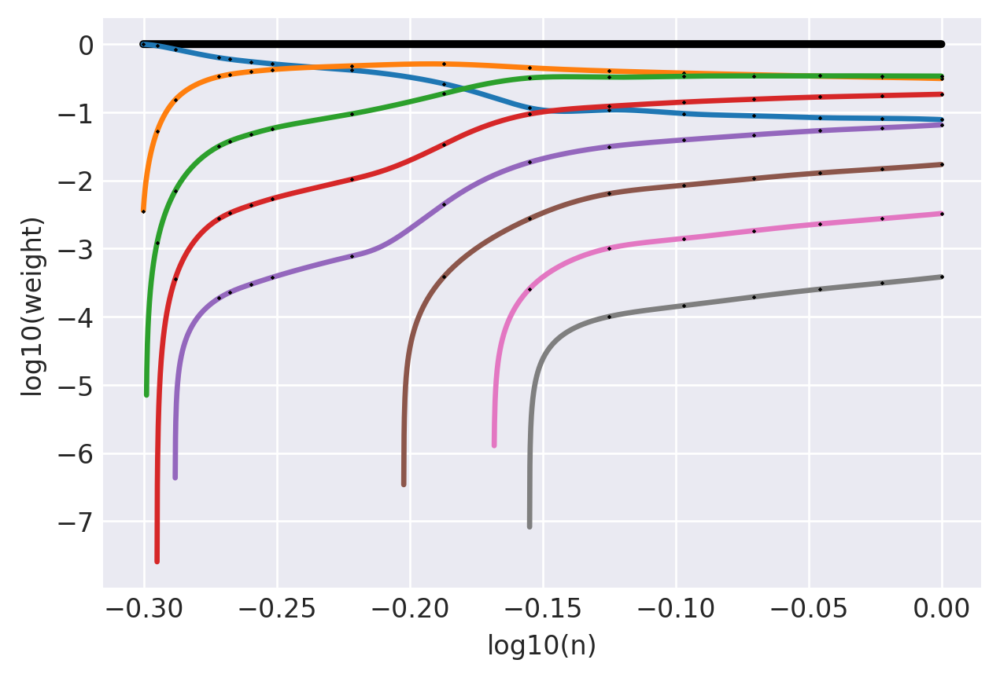

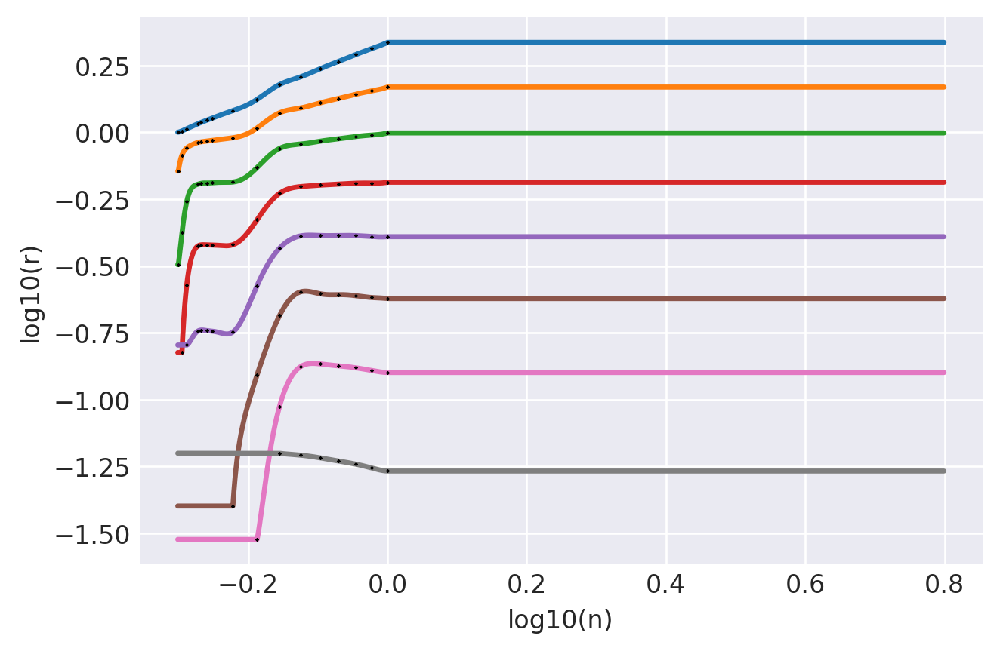

/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:41: RuntimeWarning: divide by zero encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:41: RuntimeWarning: invalid value encountered in log10
/software/lsstsw/stack_20181012/python/miniconda3-4.5.4/envs/lsst-scipipe/lib/python3.6/site-packages/ipykernel_launcher.py:42: RuntimeWarning: divide by zero encountered in log10


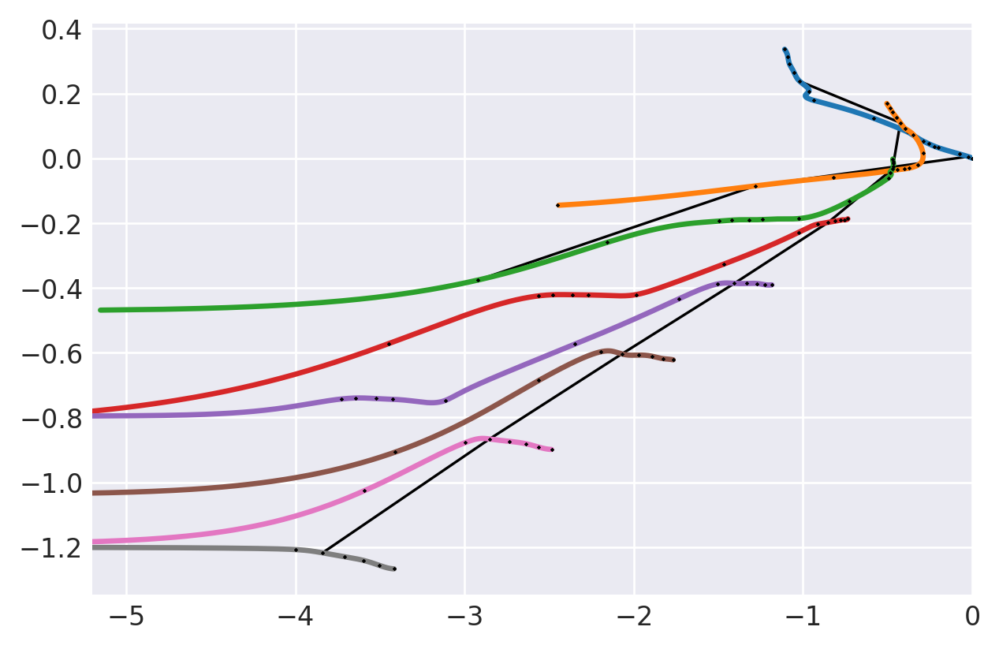

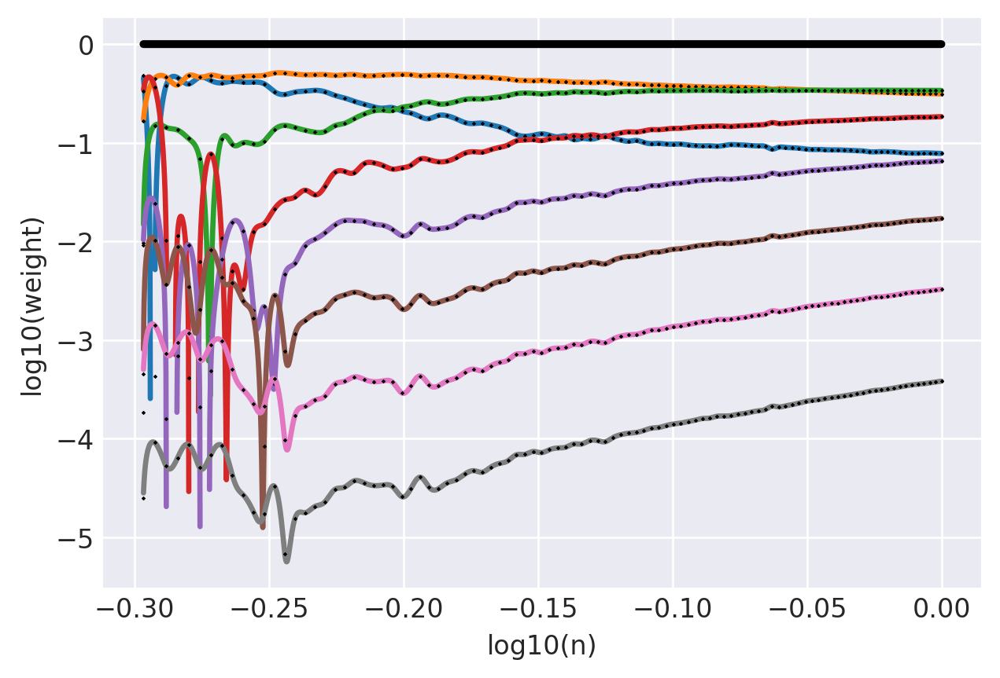

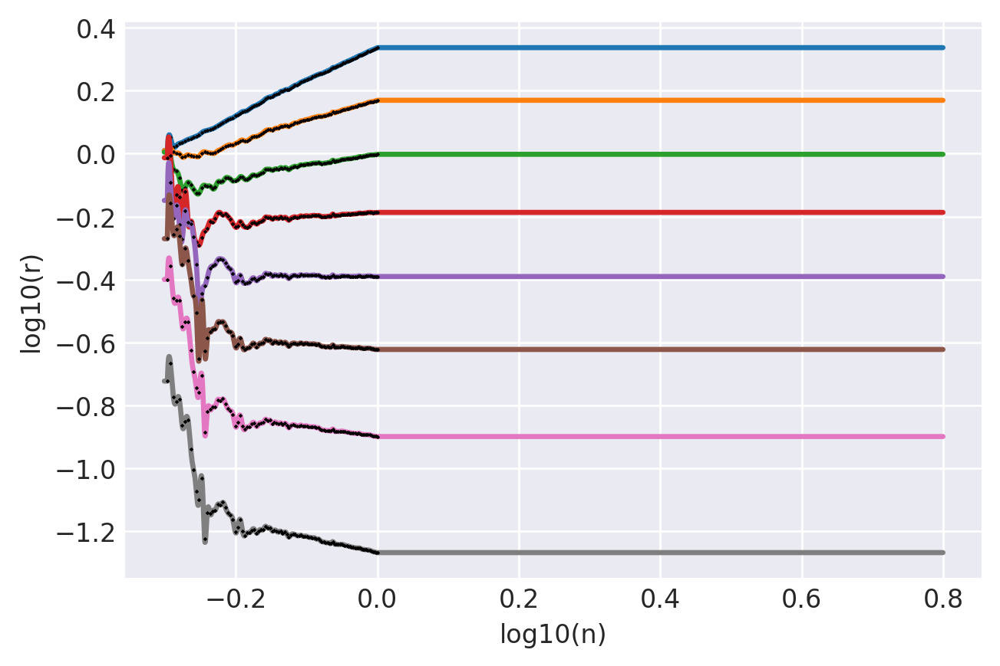

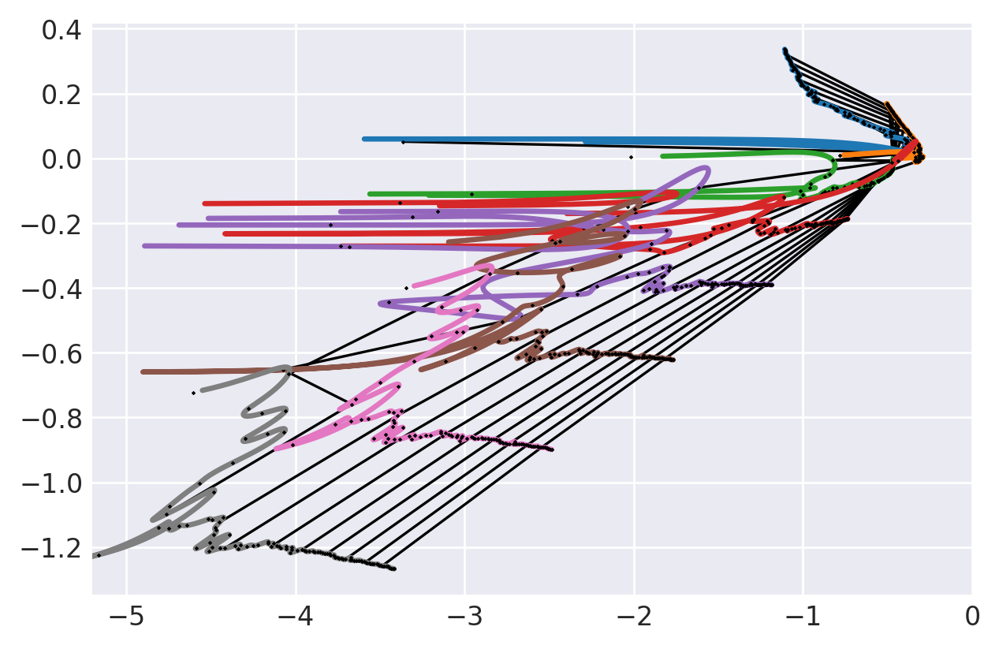

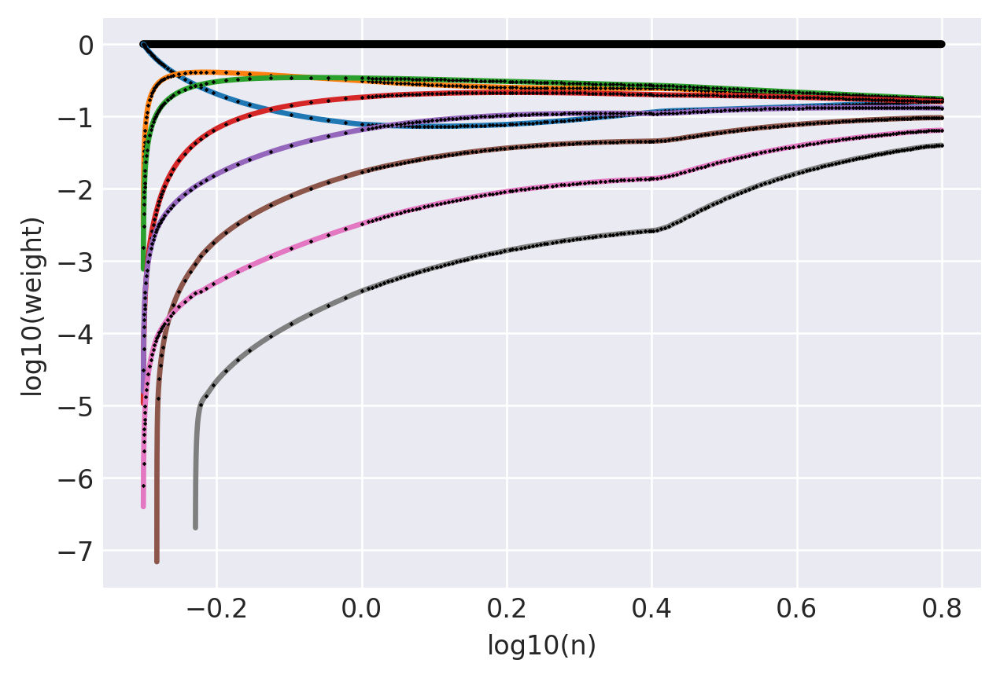

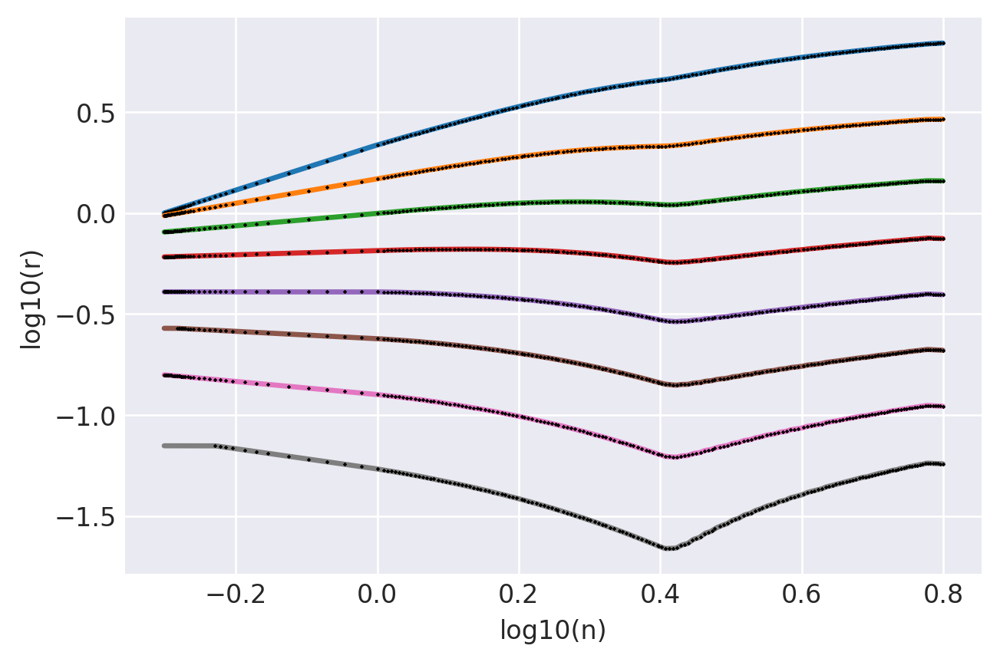

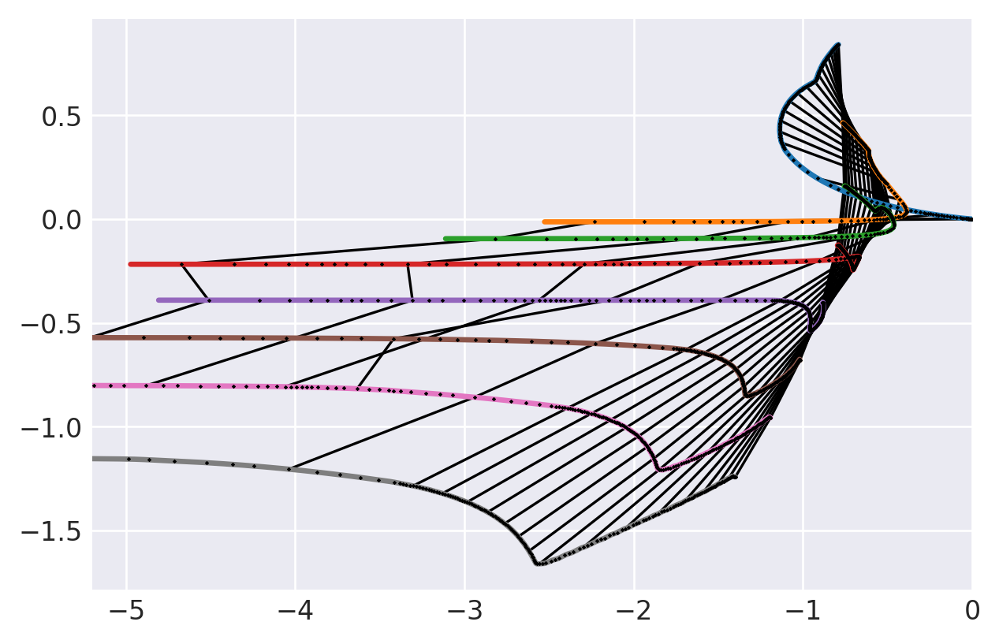

In [10]:
import multiprofit.util as mpfutil

# Plot the resulting splines, demonstrating the superiority of the final adopted approach

order = 8
profilesersic = mpfutil.getcomponents('sersic', [''], [], {'nser': [0.5], 're': [1.0], 'ang': [0], 'axrat': [1]})[0]
paramssersic = profilesersic.getparameters(fixed=False)
for weightvars in weightvarssmrt, weightvarslin, None:
    mgsersic = mpfobj.MultiGaussianApproximationProfile([mpfobj.FluxParameter('', '', 1.0, '', None)], parameters=paramssersic, weightvars=weightvars)
    if weightvars is None:
        weightvars = mpfobj.MultiGaussianApproximationProfile.weights['sersic'][order]
    nsers = np.linspace(np.log10(0.5), np.log10(6.3), 10000)
    weightsplines = mgsersic.weightsplines
    sigmasplines = mgsersic.sigmasplines
    weightsums = [np.sum(np.array([weightsplines[i](nserlog) for i in range(order)])) for nserlog in nsers]
    plt.plot(nsers, np.log10(weightsums), 'k-', linewidth=3)
    for i in range(order):
        plt.plot(nsers, np.log10(weightsplines[i](nsers)), linewidth=2)
        plt.plot(weightsplines[i]._data[0], np.log10(weightsplines[i]._data[1]), 'kx', markersize=0.8)

    plt.xlabel('log10(n)')
    plt.ylabel('log10(weight)')
    plt.show()

    for i in range(order):
        plt.plot(nsers, np.log10(sigmasplines[i](nsers)), linewidth=2)
        plt.plot(sigmasplines[i]._data[0], np.log10(sigmasplines[i]._data[1]), 'kx', markersize=0.8)
    plt.xlabel('log10(n)')
    plt.ylabel('log10(r)')
    plt.show()

    weightvalues = np.array(list(weightvars.values()))
    for idxn, nser in enumerate(list(weightvars.keys())):
        if idxn % 10 == 1:
            nser = np.log10(nser)
            x = np.array([weightsplines[i](nser) for i in range(order) if weightvalues[idxn][0][i] > 0])
            y = np.array([sigmasplines[i](nser) for i in range(order) if weightvalues[idxn][0][i] > 0])
            plt.plot(np.log10(x), np.log10(y), 'k-', linewidth=1)
    
    for i in range(order):
        plt.plot(np.log10(weightsplines[i](nsers)), np.log10(sigmasplines[i](nsers)), linewidth=2)
        plt.plot(np.log10(weightsplines[i]._data[1]), np.log10(sigmasplines[i]._data[1]), 'kx', markersize=0.8)

    plt.xlim([-5.2, 0])

    plt.show()

### How well does the interpolation work far away from the spline control points?

This is TBD. At the least, the COSMOS analysis shows that it's not terribly bad. On the other hand, you could argue that the Sersic profile isn't physically motivated anyways, so it's not worth worrying too much about reproducing it to arbitrarily small tolerances, except insofar as adding more components minimizes the amplitude of the wiggles in the MGA profile.